In [1]:
import pandas as pd
import numpy as np
from graphein.protein.config import ProteinGraphConfig
from graphein.protein.graphs import construct_graph
from graphein.protein.edges.distance import (add_peptide_bonds,
                                             add_hydrogen_bond_interactions,
                                             add_disulfide_interactions,
                                             add_ionic_interactions,
                                             add_aromatic_interactions,
                                             add_aromatic_sulphur_interactions,
                                             add_cation_pi_interactions,
                                             add_distance_threshold
                                            )
from graphein.protein.features.nodes import (
    amino_acid_one_hot,
    expasy_protein_scale,
    hydrogen_bond_acceptor,
    hydrogen_bond_donor,
    meiler_embedding
)
from graphein.protein.features.nodes.geometry import add_sidechain_vector, add_beta_carbon_vector, add_sequence_neighbour_vector
import torch
from torch_geometric.utils import from_networkx
from torch_geometric.data import Data
import torch_geometric
from torch_geometric.loader import DataLoader
import torch
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
from torch_geometric.data import DataLoader
from sklearn.metrics import f1_score, accuracy_score
import pickle
import random
import warnings
import os
import h5py
import g2papi
from functools import partial

[03/07/25 10:03:20] WARNING  To use the Graphein submodule                                         ]8;id=61146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/features/sequence/embeddings.py\embeddings.py]8;;\:]8;id=353752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/features/sequence/embeddings.py#45\45]8;;\
                             graphein.protein.features.sequence.embeddings, you need to install:                   
                             biovec                                                                                
                             To do so, use the following command: pip install biovec                               
                             Alternatively, you can install graphein with the extras:                              
                                                                                                                   
                             pip install graphein[extras]                                                          

[03/07/25 10:03:25] WARNING  To use the Graphein submodule graphein.protein.visualisation, you  ]8;id=180209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/visualisation.py\visualisation.py]8;;\:]8;id=83782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/visualisation.py#36\36]8;;\
                             need to install: pytorch3d                                                            
                             pytorch3d cannot be installed via pip                                                 

                    WARNING  To use the Graphein submodule graphein.protein.meshes, you need to        ]8;id=93068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/meshes.py\meshes.py]8;;\:]8;id=795889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/meshes.py#30\30]8;;\
                             install: pytorch3d                                                                    
                             To do so, use the following command: pip install pytorch3d                            

In [2]:
def seed_everything(seed=0):
    random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    np.random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

seed_everything()
warnings.filterwarnings("ignore")

In [3]:
af_db_path = "/work/gr-fe/databases/alpha_fold/human/"
prefix = "AF-"
suffix = "-F1-model_v4.pdb"

In [4]:
# define edge and annotation functions

edge_funcs = {"edge_construction_functions": [add_peptide_bonds,
                                              add_aromatic_interactions,
                                              add_hydrogen_bond_interactions,
                                              add_disulfide_interactions,
                                              add_ionic_interactions,
                                              add_aromatic_sulphur_interactions,
                                              add_cation_pi_interactions,
                                              partial(add_distance_threshold, threshold=5, long_interaction_threshold=5)]}


all_node_metadata = {"node_metadata_functions" : [amino_acid_one_hot,
                                                 expasy_protein_scale,
                                                 hydrogen_bond_acceptor,
                                                 hydrogen_bond_donor,
                                                 meiler_embedding]}

config = ProteinGraphConfig(**{**edge_funcs, **all_node_metadata}) 

In [5]:
# read ground_truth dataframe

df = pd.read_csv("../data/DN_LOF_GOF_truth.tsv", sep="\t")
df

,HGNC,DN,LOF,GOF,UniprotEntry
0,AARS1,1,0,0,P49588
1,ABCA1,1,0,0,O95477
2,ACD,1,0,0,Q96AP0
3,ACTA1,1,0,0,P68133
4,ACTB,1,1,1,P60709
...,...,...,...,...,...
1271,ZFPM2,0,1,0,Q8WW38
1272,ZIC2,0,1,0,O95409
1273,ZMYM2,0,1,0,Q9UBW7
1274,ZMYND11,0,1,0,Q15326


In [6]:
# extract labels and uniprot ids

all_uniprot_ids = [] 
all_hgnc = []
all_labels = [] 

for index, row in df.iterrows():
    all_uniprot_ids.append(row["UniprotEntry"])
    all_hgnc.append(row["HGNC"])
    all_labels.append([row["DN"], row["LOF"], row["GOF"]])

In [7]:
# read extra features from describeProt

describe_prot = pd.read_csv("../data/describePROT_clean.tsv", sep="\t")
describe_prot_featnames = describe_prot.columns[(describe_prot.columns != "seqlength") & (describe_prot.columns != "UniprotEntry") & (describe_prot.columns != "SignalP_score")] #SignalP_score doesnt match the protein length
describe_prot

,UniprotEntry,ASAquick_normscore,DFLpredScore,DRNApredDNAscore,DRNApredRNAscore,DisoDNAscore,DisoPROscore,DisoRNAscore,MMseq2_conservation_score,MoRFchibiScore,PSIPRED_helix,PSIPRED_strand,SCRIBERscore,SignalP_score,flDPnn_score,seqlength,PTMbinary
0,A0A024R1R8,"0.747,0.578,0.611,0.572,0.581,0.494,0.366,0.52...","0.026,0.021,0.022,0.020,0.018,0.019,0.023,0.02...","0.036,0.092,0.094,0.123,0.070,0.081,0.080,0.09...","0.441,0.247,0.219,0.259,0.200,0.280,0.291,0.30...","0.478,0.444,0.516,0.472,0.430,0.489,0.541,0.50...","0.582,0.621,0.632,0.638,0.652,0.622,0.609,0.61...","0.034,0.029,0.024,0.024,0.024,0.024,0.023,0.01...","3.69,2.85,2.55,2.69,2.60,2.57,2.57,2.76,2.52,2...","0.835,0.839,0.848,0.862,0.859,0.859,0.871,0.89...","0,8,28,32,41,46,59,78,73,92,78,50,60,20,61,93,...","0,1,1,2,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...","0.949,0.884,0.764,0.823,0.763,0.447,0.292,0.25...","0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.00...","0.96,0.94,0.93,0.92,0.89,0.89,0.93,0.90,0.84,0...",64,"0,1,1,0,0,0,0,5,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,..."
1,A0A024RBG1,"0.695,0.392,0.521,0.209,0.444,0.421,0.455,0.40...","0.024,0.032,0.040,0.038,0.043,0.055,0.059,0.07...","0.099,0.090,0.134,0.082,0.236,0.132,0.199,0.36...","0.081,0.078,0.067,0.048,0.060,0.059,0.057,0.06...","0.172,0.142,0.135,0.145,0.110,0.116,0.094,0.12...","0.505,0.495,0.473,0.483,0.483,0.486,0.484,0.49...","0.060,0.057,0.055,0.053,0.056,0.048,0.046,0.05...","3.69,3.68,2.81,2.84,2.81,3.23,3.09,3.37,2.97,2...","0.653,0.663,0.677,0.673,0.675,0.673,0.669,0.66...","0,3,2,2,1,3,7,5,4,10,4,2,2,22,49,57,78,80,67,3...","0,4,7,8,3,3,3,7,19,24,39,27,9,4,1,1,2,4,11,32,...","0.278,0.234,0.214,0.239,0.288,0.276,0.251,0.29...","0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.00...","0.35,0.38,0.42,0.46,0.45,0.45,0.45,0.42,0.38,0...",181,"0,0,6,0,6,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,8,..."
2,A0A075B6H5,"0.694,0.501,0.365,0.286,0.237,0.290,0.280,0.20...","0.068,0.082,0.084,0.107,0.138,0.158,0.191,0.22...","0.181,0.109,0.309,0.136,0.190,0.342,0.386,0.13...","0.052,0.044,0.032,0.030,0.031,0.034,0.034,0.03...","0.060,0.069,0.076,0.081,0.088,0.086,0.095,0.10...","0.481,0.501,0.490,0.473,0.473,0.476,0.468,0.42...","0.038,0.030,0.037,0.030,0.031,0.035,0.030,0.03...","3.68,2.88,2.96,2.74,2.61,2.96,2.96,2.19,3.23,2...","0.500,0.485,0.511,0.541,0.541,0.546,0.550,0.55...","0,1,1,2,3,3,2,3,4,10,16,7,1,2,3,70,77,95,94,94...","0,30,59,73,82,77,55,16,10,7,3,2,2,3,3,1,1,1,1,...","0.377,0.330,0.265,0.216,0.230,0.296,0.278,0.22...","0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.00...","0.33,0.32,0.33,0.28,0.33,0.30,0.35,0.38,0.40,0...",130,"0,0,2,0,0,2,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,..."
3,A0A075B6H7,"0.721,0.579,0.358,0.389,0.238,0.276,0.085,0.08...","0.047,0.046,0.043,0.040,0.038,0.043,0.040,0.04...","0.152,0.203,0.157,0.115,0.130,0.130,0.099,0.09...","0.066,0.065,0.062,0.062,0.063,0.063,0.060,0.06...","0.072,0.077,0.081,0.048,0.052,0.053,0.054,0.05...","0.430,0.428,0.410,0.434,0.466,0.439,0.434,0.43...","0.042,0.027,0.018,0.022,0.020,0.024,0.023,0.01...","3.69,1.81,1.94,3.06,2.10,3.33,1.73,2.16,2.10,2...","0.546,0.539,0.545,0.549,0.559,0.571,0.587,0.58...","0,24,67,83,94,99,99,100,100,100,99,96,83,62,3,...","0,2,1,2,1,0,0,0,0,0,0,0,1,1,0,2,3,7,11,24,44,4...","0.146,0.148,0.107,0.170,0.141,0.178,0.136,0.17...","0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.00...","0.14,0.13,0.12,0.07,0.10,0.07,0.08,0.08,0.11,0...",116,"0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,..."
4,A0A075B6H8,"0.649,0.510,0.364,0.481,0.218,0.241,0.259,0.37...","0.060,0.054,0.067,0.061,0.056,0.052,0.048,0.05...","0.431,0.393,0.548,0.570,0.354,0.274,0.292,0.26...","0.038,0.038,0.040,0.037,0.036,0.036,0.036,0.03...","0.174,0.172,0.171,0.169,0.168,0.105,0.107,0.10...","0.252,0.282,0.286,0.287,0.311,0.357,0.381,0.35...","0.105,0.088,0.059,0.047,0.048,0.056,0.047,0.05...","3.68,2.92,3.67,2.93,1.84,3.23,2.11,3.35,2.04,2...","0.459,0.468,0.512,0.522,0.529,0.530,0.536,0.53...","0,10,29,48,82,91,97,99,99,99,99,100,99,99,95,8...","0,1,3,3,1,1,0,0,0,0,0,0,0,0,0,

In [8]:
uniprot = pd.read_csv("../data/uniprot_all_human_proteins_annotated.txt", sep="\t")
uniprot_features = ['ACT_SITE', 'BINDING', 'DNA_BIND',
                   'TOPO_DOM', 'TRANSMEM',
                   'DISULFID',  'PROPEP', 'SIGNAL', 'TRANSIT',
                   'STRAND', 'HELIX',
                   'COILED', 'COMPBIAS', 'DOMAIN', 'REGION', 'REPEAT', 'ZN_FING']

# Initialize a new DataFrame to store the output
uniprot_clean = pd.DataFrame()
uniprot_clean['Entry'] = uniprot['Entry']  # Copy 'Entry' column Length
uniprot_clean['Length'] = uniprot['Length'] 

# Iterate over each feature and assign the correct value to the output
for feature in uniprot_features:
    actual_or_pred_col = f'actual_or_pred_{feature}'
    actual_annotation_col = f'annotation_actual_{feature}'
    pred_annotation_col = f'annotation_pred_{feature}'
    
    # Use `np.where` to conditionally select the 'actual' or 'pred' annotation
    uniprot_clean[feature] = uniprot.apply(
        lambda row: row[actual_annotation_col] if row[actual_or_pred_col] == 'actual' else row[pred_annotation_col], 
        axis=1
    )

# Display the resulting DataFrame
uniprot_clean

,Entry,Length,ACT_SITE,BINDING,DNA_BIND,TOPO_DOM,TRANSMEM,DISULFID,PROPEP,SIGNAL,TRANSIT,STRAND,HELIX,COILED,COMPBIAS,DOMAIN,REGION,REPEAT,ZN_FING
0,A0A087X1C5,515,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,1100000000000000000000011111111111111111111111...,0011111111111111111111100000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,1111111111111111111111000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000001...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000011...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...
1,A0A0B4J2F0,54,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,1111000000000000000000000111111111111111111111...,0000111111111111111111111000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,1111111111111111111110000000000000000000000000...,1100000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000001111111111111111111111111111111111111000...,0000000000000000000000000011111111111111111111...,0000000000000000000000000000000000000000000011...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000011111110000000000...,0000000000000001000000000000000000000000000000...,0000000000000000000000000000000000000000000000...
2,A0A0B4J2F2,783,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000011111111100000...,0000000000000000000000000000000000000000000000...,1111111111111111111111111111111111111111111111...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000011111111100011111111...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000011111111111111111111...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...
3,A0A0C5B5G6,16,0000000000000000,0000000000000000,0000000000000000,1111111111111111,0000000000000000,0000000000000000,0000000000000000,0000000000000000,0000000000000000,0000000011100000,0000000000000000,0000000000000000,0000000000000000,0000000000000000,0000000000000000,0000000000000000,0000000000000000
4,A0A0K2S4Q6,201,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000001111111111111111111111...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000001000...,0000000000000000000000000000000000000000000000...,1111111111111111111111110000000000000000000000...,1111111111111110000010000000000000000000000000...,0000000000000000000000000000111111000011111110...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000001111111111111111111111...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...,0000000000000000000000000000000000000000000000...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2

In [9]:
# conservation
phylop = pd.read_csv("../data/proteins_phylop_perresidue.tsv.gz", sep="\t")
phylop_features = ['phyloP100way_vertebrate', 'phyloP30way_mammalian']
phylop

,Entry,phyloP100way_vertebrate,phyloP30way_mammalian
0,A0A075B759,"1.6,0.1,1.2,1.4,-0.1,3.1,1.5,2.3,0.7,-0.4,-1.7...","0.3,0.3,-0.5,-1.5,-0.8,-0.3,-0.1,0,-0.1,-0.1,-..."
1,A0A075B767,"1.8,1.8,1.8,1.8,1.8,1.8,1.8,1.8,1.8,1.8,1.8,1....","0.3,0.3,0.3,0.3,0.3,0.3,0.3,0.3,0.3,0.3,0.3,0...."
2,A0A087WTH1,"3.1,2.4,2.8,1.8,4.1,2.7,2.2,1.8,2.3,0.3,1.9,1....","1.2,0.6,1.2,0.9,1.2,1.3,1.1,0.7,0.9,-0.1,1.1,0..."
3,A0A087WUV0,"0.6,0.8,-0.4,-0.9,0.5,0.6,2.5,-0.1,0.5,0.9,1.3...","0.9,0.7,0.8,-0.2,0.5,1,0.6,0,0.4,0.1,0.1,0.9,0..."
4,A0A087WV53,"3,2.3,3.1,0.9,1.7,0.6,0.1,2.1,2.1,0.2,-0.4,1,0...","1,0.9,0.7,0.9,0.9,0.9,0.1,0.8,0.7,0.5,0.3,0.5,..."
...,...,...,...
18174,Q9Y6Z7,"4.4,4.4,4.4,4.4,4.4,4.4,4.4,4.4,4.4,4.4,4.4,4....","1.2,1.2,1.2,1.2,1.2,1.2,1.2,1.2,1.2,1.2,1.2,1...."
18175,U3KPV4,"3.7,2.2,2.9,0.6,2.7,2.7,0.1,-0.4,7.4,2.8,0.4,2...","0.3,0.8,1,0.7,1.1,1.1,-0.1,0.4,1.2,1.1,-0.1,0...."
18176,W5XKT8,"1.1,1.2,-0.2,-0.2,-0.6,-0.9,-1.9,-0.9,-0.2,0.3...","1.2,0.6,-0.2,-0.7,-0.3,-0.7,0.2,-0.4,-0.7,-0.8..."
18177,X6R8D5,"-0.9,0.5,0.5,-0.3,1.2,-1.6,0.3,0.2,0.2,0.2,0,0...","0.3,-0.4,0.3,-0.2,0.8,-0.1,1.1,0.1,0.3,0.1,0.2..."


In [10]:
# read protein (graph) features
archs_df = pd.read_csv("../data/archs_protein_embeds.tsv.gz", sep="\t")
go_df = pd.read_csv("../data/go_protein_embeds.tsv.gz", sep="\t")
string_df = pd.read_csv("../data/string_protein_embeds.tsv.gz", sep="\t")
gnomad_df = pd.read_csv("../data/gnomadv4_constraints.tsv.gz", sep="\t")

In [11]:
'''
# creat PyG objects
all_pyg_graphs = []
all_graphein_features = ["amino_acid_one_hot", "expasy", 'hbond_acceptors', 'hbond_donors', 'meiler', 'sidechain_vector', 'c_beta_vector', 'sequence_neighbour_vector_n_to_c']  # AAonehot 20, expasy = 61, hbond_acceptors=1, hbond_donors=1, meiler=7, sidechain_vector=3, c_beta_vector=3, sequence_neighbour_vector_n_to_c=3

counter = 1
for uniprot_id, hgnc, label in zip(all_uniprot_ids, all_hgnc, all_labels):

    # remove those that are not in the describe_prot database
    if uniprot_id not in describe_prot["UniprotEntry"].values:
        continue
        
    # construct a networkx graph from AlphaFold predictions
    g = construct_graph(config=config, path=(af_db_path + prefix + uniprot_id + suffix))

    add_sidechain_vector(g)
    add_beta_carbon_vector(g)
    add_sequence_neighbour_vector(g)
    
    # convert to PyG object
    g2 = from_networkx(g)
    
    # add graphein features
    g2.x = g2[all_graphein_features[0]] 
    for feature in all_graphein_features[1:]:
        g2.x = torch.cat((g2.x, g2[feature]), dim=1)

    # add describe_prot features
    for feature in describe_prot_featnames:
        try:
            temp_feature = describe_prot[describe_prot["UniprotEntry"] == uniprot_id][feature].values[0]
            temp_num_list = [float(num) for num in temp_feature.split(',')]
            temp_num_tensor = torch.tensor(temp_num_list).reshape(-1, 1)
            g2.x = torch.cat((g2.x, temp_num_tensor), dim=1)
        except:
            g2.x = torch.cat((g2.x, torch.full((len(g2.residue_name), 1), float('nan'))), dim=1)

    # add uniprot features
    for feature in uniprot_features:
        try:
            temp_feature = uniprot_clean[uniprot_clean["Entry"] == uniprot_id][feature].values[0]
            temp_num_list = [int(char) for char in temp_feature]
            temp_num_tensor = torch.tensor(temp_num_list).reshape(-1, 1)
            g2.x = torch.cat((g2.x, temp_num_tensor), dim=1)
        except:
            g2.x = torch.cat((g2.x, torch.full((len(g2.residue_name), 1), float('nan'))), dim=1)

    # add phylop features
    for feature in phylop_features:
        try:
            temp_feature = phylop[phylop["Entry"] == uniprot_id][feature].values[0]
            temp_num_list = [float(num) for num in temp_feature.split(',')]
            temp_num_tensor = torch.tensor(temp_num_list).reshape(-1, 1)
            g2.x = torch.cat((g2.x, temp_num_tensor), dim=1)
        except:
            g2.x = torch.cat((g2.x, torch.full((len(g2.residue_name), 1), float('nan'))), dim=1)
    
    # add protT5 embeddings
    with h5py.File('../data/protT5_per_residue.h5', 'r') as f:
        embeds = f[uniprot_id][:]  
    
    try:
        g2.x = torch.cat((g2.x, torch.from_numpy(embeds)), dim=1)
    except:
        g2.x = torch.cat((g2.x, torch.full((len(g2.residue_name), 1024), float('nan'))), dim=1)
    

    # add protein (graph) features
    try:
        archs_embed = torch.tensor(archs_df[archs_df["uniprot_ids"] == uniprot_id].values[0][1:].tolist())
    except:
        archs_embed = torch.full((256,), float('nan'))

    try:
        go_embed = torch.tensor(go_df[go_df["uniprot_ids"] == uniprot_id].values[0][1:].tolist())
    except:
        go_embed = torch.full((256,), float('nan'))

    try:
        string_embed = torch.tensor(string_df[string_df["uniprot_ids"] == uniprot_id].values[0][1:].tolist())
    except:
        string_embed = torch.full((256,), float('nan'))

    try:
        gnomad_constraints = torch.tensor(gnomad_df[gnomad_df["uniprot_ids"] == uniprot_id].values[0][1:].tolist())
    except:
        gnomad_constraints = torch.full((6,), float('nan'))

    g2.u = torch.tensor([])
    g2.u = torch.cat((g2.u, archs_embed, go_embed, string_embed, gnomad_constraints))

    # add label
    g2.y = label

    all_pyg_graphs.append(g2)
    print(f"finished {counter} proteins")
    counter += 1
'''

'\n# creat PyG objects\nall_pyg_graphs = []\nall_graphein_features = ["amino_acid_one_hot", "expasy", \'hbond_acceptors\', \'hbond_donors\', \'meiler\', \'sidechain_vector\', \'c_beta_vector\', \'sequence_neighbour_vector_n_to_c\']  # AAonehot 20, expasy = 61, hbond_acceptors=1, hbond_donors=1, meiler=7, sidechain_vector=3, c_beta_vector=3, sequence_neighbour_vector_n_to_c=3\n\ncounter = 1\nfor uniprot_id, hgnc, label in zip(all_uniprot_ids, all_hgnc, all_labels):\n\n    # remove those that are not in the describe_prot database\n    if uniprot_id not in describe_prot["UniprotEntry"].values:\n        continue\n        \n    # construct a networkx graph from AlphaFold predictions\n    g = construct_graph(config=config, path=(af_db_path + prefix + uniprot_id + suffix))\n\n    add_sidechain_vector(g)\n    add_beta_carbon_vector(g)\n    add_sequence_neighbour_vector(g)\n    \n    # convert to PyG object\n    g2 = from_networkx(g)\n    \n    # add graphein features\n    g2.x = g2[all_graphei

In [12]:
'''# create a simple version of all pyg graphs

all_pyg_graphs_simple = []

for pyg in all_pyg_graphs:
    
    simple_pyg = Data(
        x=pyg.x,               # Node features
        y=pyg.y,               # Labels
        batch=pyg.batch,       # Batch information
        edge_index=pyg.edge_index,  # Edge connections
        name = pyg.name,
        u=pyg.u,
        coords=pyg.coords
    )

    all_pyg_graphs_simple.append(simple_pyg)
'''

'# create a simple version of all pyg graphs\n\nall_pyg_graphs_simple = []\n\nfor pyg in all_pyg_graphs:\n    \n    simple_pyg = Data(\n        x=pyg.x,               # Node features\n        y=pyg.y,               # Labels\n        batch=pyg.batch,       # Batch information\n        edge_index=pyg.edge_index,  # Edge connections\n        name = pyg.name,\n        u=pyg.u,\n        coords=pyg.coords\n    )\n\n    all_pyg_graphs_simple.append(simple_pyg)\n'

In [13]:
# save all_pyg_graphs and all_pyg_graphs_simple
'''
with open('../res/pyg_graphs/all_pyg_graphs_simple.pkl', 'wb') as f:
    pickle.dump(all_pyg_graphs_simple, f)

with open('../res/pyg_graphs/all_pyg_graphs.pkl', 'wb') as f:
    pickle.dump(all_pyg_graphs, f)
'''

"\nwith open('../res/pyg_graphs/all_pyg_graphs_simple.pkl', 'wb') as f:\n    pickle.dump(all_pyg_graphs_simple, f)\n\nwith open('../res/pyg_graphs/all_pyg_graphs.pkl', 'wb') as f:\n    pickle.dump(all_pyg_graphs, f)\n"

In [14]:
# load all_pyg_graphs_simple

with open('../res/pyg_graphs/with_distance_edgs/all_pyg_graphs_simple.pkl', 'rb') as file:
    all_pyg_graphs_simple = pickle.load(file)

In [15]:
# remove protLM features

for graph in all_pyg_graphs_simple:
    # Ensure that the number of columns is greater than 1024
    if graph.x.size(1) > 1024:
        graph.x = graph.x[:, :-1024] 

### replace graph features

In [16]:
def clean_uniprot_ids_features(df):
    df_split = df.assign(uniprot_ids=df['uniprot_ids'].str.split('|'))

    # Explode the lists into multiple rows
    df_exploded = df_split.explode('uniprot_ids')

    return df_exploded

In [17]:
# read features
describe_prot_perprot = clean_uniprot_ids_features(pd.read_csv("../data/describe_prot.tsv.gz", sep="\t"))
describe_prot_perprot

,uniprot_ids,flDPnn_disorder,PSIPRED_helix,PSIPRED_strand,PSIPRED_coil,MMseq2_low_conservation,MMseq2_high_conservation,MMseq2_median,SignalP,DFLpred_linker,ASAquick_buried,DisoRDPbind_RNA,DisoRDPbind_DNA,DisoRDPbind_PRO,MoRFchibi_morf,DRNApred_RNA,DRNApred_DNA,SCRIBER_PRO,PTM_content
0,A0A024R1R8,1.000,0.594,0.000,0.406,0.02,0.08,2.705,0.0,0.000,0.000,0.00,0.406,0.000,0.656,0.266,0.00,0.078,0.109
1,A0A024RBG1,0.271,0.271,0.188,0.541,0.01,0.13,2.810,0.0,0.116,0.265,0.00,0.000,0.000,0.000,0.000,0.00,0.000,0.072
2,A0A075B6H5,0.131,0.238,0.308,0.454,0.02,0.12,2.610,1.0,0.062,0.131,0.00,0.000,0.000,0.000,0.000,0.00,0.000,0.054
3,A0A075B6H7,0.000,0.164,0.328,0.508,0.02,0.15,2.580,1.0,0.259,0.207,0.00,0.000,0.000,0.000,0.000,0.05,0.000,0.147
4,A0A075B6H8,0.000,0.265,0.222,0.513,0.00,0.17,2.750,1.0,0.068,0.282,0.00,0.000,0.000,0.000,0.000,0.20,0.000,0.068
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20531,V9GZ13,0.540,0.800,0.000,0.200,0.02,0.22,2.695,0.0,0.000,0.000,0.12,0.000,0.000,1.000,0.000,0.54,0.440,0.080
20532,W5XKT8,0.000,0.556,0.133,0.311,0.06,0.11,2.370,0.0,0.006,0.312,0.00,0.000,0.000,0.000,0.000,0.01,0.000,0.034
20533,W6CW81,0.212,0.513,0.062,0.425,0.00,0.09,2.680,0.0,0.133,0.133,0.00,0.000,0.000,0.000,0.000,0.12,0.000,0.124
20534,X5D2U9,0.041,0.316,0.312,0.372,0.00,0.14,2.785,1.0,0.011,0.233,0.00,0.000,0.000,0.000,0.000,0.00,0.000,0.045


In [18]:
shet_features = clean_uniprot_ids_features(pd.read_csv("../data/shet_selected_features.tsv.gz", sep="\t"))
shet_features

,uniprot_ids,CDS_GC,UTR3_length,UTR3_GC,transcript_length,num_exons,transcript_GC,UTR5_length,UTR5_GC,CDS_length,...,Extracellular,GolgiApparatus,LysosomeOrVacuole,Mitochondrion,Nucleus,Peroxisome,Plastid,MembraneBound,Soluble,UNEECON_G
0,O43657,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.098656
1,Q9H2S6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.182126
2,O60762,0.412516,262.0,0.255725,23663.0,9.0,0.398301,9.0,0.666667,0.888,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.255389
3,Q8IZE3,0.450411,4082.0,0.376286,44266.0,13.0,0.400330,159.0,0.622642,2.229,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.149153
4,Q9NSG2,0.420765,1093.0,0.354986,59041.0,25.0,0.370725,356.0,0.426966,2.562,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.099038
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17902,Q14184,0.620662,4652.0,0.568573,38862.0,9.0,0.564459,171.0,0.877193,1.239,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,NaN
17903,Q8WU43,0.384058,835.0,0.398802,9963.0,4.0,0.423065,516.0,0.507752,0.276,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.134916
17904,Q13224,0.540965,25446.0,0.418180,444266.0,14.0,0.405633,708.0,0.477401,4.455,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.676874
17905,Q9Y675,0.532407,371.0,0.342318,13423.0,3.0,0.415108,63.0,0.682540,0.216,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.191191


In [19]:
features_DnGofLofPaper = clean_uniprot_ids_features(pd.read_csv("../data/features_DnGofLofPaper.tsv.gz", sep="\t"))
features_DnGofLofPaper

,uniprot_ids,dn_ds,abundance,exp_var,betweenness,median_scriber,n_paralogs,max_id,shet,nc_gerp,membrane_propensity,efx_raw,efx_abs,aco,pi,strand_pct,helix_pct,pct_buried,plddt,ct
0,P04217,0.281393,1703.000,27771.571936,0.000053,0.0990,25.0,0.243542,0.000502,-1.041153,0.059434,-2.200350,-4.119574,22.958808,5.473445,0.462626,0.000000,0.440404,86.520343,0
1,Q9NQ94,0.262739,3.880,403.367145,0.000186,0.0830,36.0,0.487805,0.016500,2.137678,0.517310,-4.807986,-10.895981,12.649005,9.083333,0.188552,0.208754,0.276094,69.012778,0
2,P01023,NaN,1764.000,76530.887282,0.000131,0.0630,8.0,0.717096,0.010068,0.702367,0.401971,-2.007261,-4.003098,52.662712,6.253608,0.391452,0.140434,0.518318,82.030149,0
3,A8K2U0,0.336245,4.560,6760.359221,0.000035,0.0590,8.0,0.351444,0.000361,-0.090234,0.056678,-1.956738,-3.768817,52.418667,5.491150,0.392022,0.145805,0.521320,80.948177,0
4,U3KPV4,0.406874,0.000,0.008581,0.000018,0.1300,3.0,0.338235,0.001066,-0.382439,0.124294,-2.870083,-4.546424,27.784167,10.955319,0.147059,0.352941,0.517647,90.760618,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20360,Q6WRX3,0.598997,0.322,0.497987,0.000015,0.0925,2.0,0.000000,0.000405,-0.437928,0.063729,-2.799698,-4.661322,13.115206,9.033270,0.044796,0.525692,0.519104,90.445138,0
20361,Q9C0D3,0.066092,0.816,152.357502,0.000068,0.1180,2.0,0.596774,0.154437,0.774037,0.049745,-3.132392,-5.204659,12.288397,6.596195,0.048387,0.534946,0.537634,92.442863,1
20362,Q15942,0.083230,239.000,12614.114609,0.000123,0.1260,1.0,0.000000,0.008041,0.406220,-0.027150,-4.641151,-11.855881,17.309842,6.371462,0.080420,0.103147,0.131119,62.941014,0
20363,O43149,0.181384,3.640,19.334703,0.000114,0.0180,0.0,0.000000,0.057000,0.009405,0.026494,-1.638749,-4.060054,25.580570,5.582886,0.104357,0.441067,0.410672,75.916846,0


In [20]:
domino_features = clean_uniprot_ids_features(pd.read_csv("../data/domino_features.tsv.gz", sep="\t"))
domino_features

,uniprot_ids,phylop_5utr,ExAC_don_to_syn,mRNA_halflife_10
0,P04217,-0.065900,0.010870,0
1,Q9NQ94,0.354861,0.000000,0
2,P01023,0.115622,0.009524,1
3,A8K2U0,0.133771,0.069959,0
4,U3KPV4,0.136512,0.038461,0
...,...,...,...,...
17373,Q6WRX3,0.024796,0.057143,0
17374,Q9C0D3,0.842005,0.000000,0
17375,Q15942,0.436891,0.009091,0
17376,O43149,0.665234,0.009960,0


In [21]:
gnomadv4_constraints = clean_uniprot_ids_features(pd.read_csv("../data/gnomadv4_constraints.tsv.gz", sep="\t"))
gnomadv4_constraints

,uniprot_ids,lof.pLI,lof.pNull,lof.pRec,lof.oe_ci.upper,mis.z_score,syn.z_score
0,P04217,1.770600e-16,0.842950,0.15705,1.340,-0.86092,-0.635490
1,Q9NQ94,7.656000e-10,0.001961,0.99804,0.825,1.23730,0.017838
2,P01023,9.756800e-20,0.000010,0.99999,0.765,2.75870,1.836200
3,A8K2U0,1.712700e-40,0.101100,0.89890,0.953,1.65710,0.951210
4,U3KPV4,1.016900e-06,0.424980,0.57502,1.529,-4.07990,-3.997000
...,...,...,...,...,...,...,...
17886,A0A1B0GTJ6,1.332200e-03,0.332020,0.66665,1.843,-0.12558,-0.270880
17887,X6R8R1,8.079800e-01,0.012984,0.17903,0.679,2.33740,2.093100
17888,A0A1W2PQ72,7.549600e-07,0.107530,0.89247,1.089,1.58890,0.390280
17889,A0A494BZU4,NaN,NaN,NaN,NaN,-0.03599,1.104800


In [22]:
# Merge all feature dataframes on 'uniprot_ids'
merged_features = describe_prot_perprot.set_index('uniprot_ids')
merged_features = merged_features.join(shet_features.set_index('uniprot_ids'), how='outer')
merged_features = merged_features.join(features_DnGofLofPaper.set_index('uniprot_ids'), how='outer')
merged_features = merged_features.join(domino_features.set_index('uniprot_ids'), how='outer')
merged_features = merged_features.join(gnomadv4_constraints.set_index('uniprot_ids'), how='outer')
merged_features = merged_features.drop('betweenness', axis=1) #this comes from PPI so no need
merged_features

,flDPnn_disorder,PSIPRED_helix,PSIPRED_strand,PSIPRED_coil,MMseq2_low_conservation,MMseq2_high_conservation,MMseq2_median,SignalP,DFLpred_linker,ASAquick_buried,...,ct,phylop_5utr,ExAC_don_to_syn,mRNA_halflife_10,lof.pLI,lof.pNull,lof.pRec,lof.oe_ci.upper,mis.z_score,syn.z_score
uniprot_ids,,,,,,,,,,,,,,,,,,,,,
A0A024R1R8,1.000,0.594,0.000,0.406,0.02,0.08,2.705,0.0,0.000,0.000,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A0A024RBG1,0.271,0.271,0.188,0.541,0.01,0.13,2.810,0.0,0.116,0.265,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A0A024RCN7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A0A075B6H5,0.131,0.238,0.308,0.454,0.02,0.12,2.610,1.0,0.062,0.131,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A0A075B6H7,0.000,0.164,0.328,0.508,0.02,0.15,2.580,1.0,0.259,0.207,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
W5XKT8,0.000,0.556,0.133,0.311,0.06,0.11,2.370,0.0,0.006,0.312,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
W6CW81,0.212,0.513,0.062,0.425,0.00,0.09,2.680,0.0,0.133,0.133,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
X5D2U9,0.041,0.316,0.312,0.372,0.00,0.14,2.785,1.0,0.011,0.233,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [23]:
protein_structure_and_function = {
    'PSIPRED_helix': 'Prediction of helical secondary structures.',
    'PSIPRED_strand': 'Prediction of beta-strand secondary structures.',
    'ASAquick_buried': 'Prediction of buried surface area (solvent accessibility).',
    'flDPnn_disorder': 'Prediction of intrinsically disordered regions.',
    'MoRFchibi_morf': 'Prediction of molecular recognition features (MoRFs).',
    'DFLpred_linker': 'Prediction of disordered flexible linker residues.',
    'DisoRDPbind_RNA': 'Prediction of RNA-binding disordered regions.',
    'DisoRDPbind_DNA': 'Prediction of DNA-binding disordered regions.',
    'DisoRDPbind_PRO': 'Prediction of protein-binding disordered regions.',
    'DRNApred_RNA': 'Prediction of RNA-binding residues.',
    'DRNApred_DNA': 'Prediction of DNA-binding residues.',
    'SignalP': 'Prediction of signal peptides.',
    'SCRIBER_PRO': 'Prediction of protein-binding residues.',
    'PTM_content': 'Prediction of post-translational modification sites.',
    'membrane_propensity': 'Propensity for membrane association.',
    'Plastid': 'Localization to plastid.',
    'CellMembrane': 'Localization to cell membrane.',
    'Cytoplasm': 'Localization to cytoplasm.',
    'EndoplasmicReticulum': 'Localization to endoplasmic reticulum.',
    'Extracellular': 'Localization to extracellular space.',
    'GolgiApparatus': 'Localization to Golgi apparatus.',
    'LysosomeOrVacuole': 'Localization to lysosome or vacuole.',
    'Mitochondrion': 'Localization to mitochondrion.',
    'Nucleus': 'Localization to nucleus.',
    'Peroxisome': 'Localization to peroxisome.',
    'MembraneBound': 'Membrane-bound proteins.',
    'aco': 'Absolute contact order of the protein structure.',
    'pct_buried': 'Fraction of buried residues in protein structure.',
    'plddt': 'Mean pLDDT confidence score of predicted structures.',
    'pi': 'Protein isoelectric point.',
    'ct': 'Cotranslational assembly annotations.',
    'efx_abs': 'Median ratio of ESM-1v and absolute FoldX ΔΔG for missense mutations.',
    'efx_raw': 'Median ratio of ESM-1v and raw FoldX ΔΔG for missense mutations.',
    'median_scriber': 'Median SCRIBER score for residues with more than 5% relative solvent accessible surface area.'
}

evolutionary_conservation_and_variation = {
    'MMseq2_low_conservation': 'Low conservation from MMseqs.',
    'MMseq2_high_conservation': 'High conservation from MMseqs.',
    'phastCons7way_mean': 'Mean conservation score across 7 species.',
    'phastCons7way_max': '95th percentile conservation score across 7 species.',
    'phastCons17way_max': '95th percentile conservation score across 17 species.',
    'phastCons100way_max': '95th percentile conservation score across 100 species.',
    'fracCdsPhylopAm': 'Fraction of coding sequences constrained in 240 mammals.',
    'dn_ds': 'Human-macaque dN/dS ratio of nonsynonymous to synonymous substitutions.',
    'UNEECON_G': 'Evolutionary pressure score (UNEECON).',
    'n_paralogs': 'Number of paralogous proteins.',
    'max_id': 'Maximum sequence identity to paralogs.',
    'nc_gerp': 'GERP++ score for non-coding regions.',
    'phylop_5utr': 'Evolutionary conservation of 5\' UTR.',
    'ExAC_don_to_syn': 'Donor to synonymous mutation ratio from ExAC.',
    'lof.pLI': 'Probability of being loss-of-function intolerant.',
    'lof.pNull': 'Null hypothesis for loss-of-function.',
    'lof.pRec': 'Probability of intolerance to homozygous but not heterozygous loss-of-function variants.',
    'lof.oe_ci.upper': 'Upper confidence interval for loss-of-function over-expected score.',
    'shet': 'Selection coefficient related to heterozygosity.',
    'mis.z_score': 'Z-score for missense variation constraint.',
    'syn.z_score': 'Z-score for synonymous variation constraint.'
}


transcripts_expression_regulation = {
    'abundance': 'Protein abundance (from PaxDB).',
    'exp_var': 'RNA expression variance across tissues.',
    'tau': 'Tissue specificity of gene expression (0, broadly expressed to 1, tissue specific).',
    'TF': 'Indicates if the gene is a transcription factor.',
    'EDS': 'Enhancer domain score.',
    'ABC_count1': 'Number of biosamples with an active ABC enhancer.',
    'ABC_count2': 'Total number of ABC enhancers across all biosamples.',
    'ABC_count3': 'Total number of ABC enhancers after union of enhancer domains.',
    'ABC_length_per_type': 'Average ABC enhancer length per active cell type.',
    'Roadmap_count1': 'Number of biosamples with an active Roadmap enhancer.',
    'Roadmap_count2': 'Total number of Roadmap enhancers across all biosamples.',
    'Roadmap_count3': 'Total number of Roadmap enhancers after union of enhancer domains.',
    'promoter_count': 'Number of promoters.',
    'mRNA_halflife_10': 'mRNA half-life in hours.',
    'CDS_GC': 'GC content of the coding sequence.',
    'UTR3_length': 'Length of 3\' UTR.',
    'UTR3_GC': 'GC content of 3\' UTR.',
    'UTR5_length': 'Length of 5\' UTR.',
    'UTR5_GC': 'GC content of 5\' UTR.',
    'transcript_length': 'Total transcript length.',
    'Transcript_count': 'Number of transcripts.',
    'num_exons': 'Number of exons.',
    'connectedness': 'Overall connectedness in coexpression networks.'
}

selected_columns = list(protein_structure_and_function.keys()) +list(evolutionary_conservation_and_variation.keys()) + list(transcripts_expression_regulation.keys()) 
merged_features = merged_features[selected_columns]
merged_features

,PSIPRED_helix,PSIPRED_strand,ASAquick_buried,flDPnn_disorder,MoRFchibi_morf,DFLpred_linker,DisoRDPbind_RNA,DisoRDPbind_DNA,DisoRDPbind_PRO,DRNApred_RNA,...,mRNA_halflife_10,CDS_GC,UTR3_length,UTR3_GC,UTR5_length,UTR5_GC,transcript_length,Transcript_count,num_exons,connectedness
uniprot_ids,,,,,,,,,,,,,,,,,,,,,
A0A024R1R8,0.594,0.000,0.000,1.000,0.656,0.000,0.0,0.406,0.000,0.266,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A0A024RBG1,0.271,0.188,0.265,0.271,0.000,0.116,0.0,0.000,0.000,0.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A0A024RCN7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A0A075B6H5,0.238,0.308,0.131,0.131,0.000,0.062,0.0,0.000,0.000,0.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A0A075B6H7,0.164,0.328,0.207,0.000,0.000,0.259,0.0,0.000,0.000,0.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
W5XKT8,0.556,0.133,0.312,0.000,0.000,0.006,0.0,0.000,0.000,0.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
W6CW81,0.513,0.062,0.133,0.212,0.000,0.133,0.0,0.000,0.000,0.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
X5D2U9,0.316,0.312,0.233,0.041,0.000,0.011,0.0,0.000,0.000,0.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
import re
import torch_geometric

# Function to extract the uniprot_id from the graph's name
def extract_uniprot_id(graph_name):
    # Use regex to extract the uniprot_id, which is between the first dash and the second dash
    match = re.search(r'AF-(\w+)-F1', graph_name)
    if match:
        return match.group(1)
    else:
        return None

# Iterate through all graphs
for graph in all_pyg_graphs_simple:
    # Extract the uniprot_id from the graph's name
    uniprot_id = extract_uniprot_id(graph.name)
    
    if uniprot_id in merged_features.index:
        # Get the corresponding row of protein features from the DataFrame
        protein_features = merged_features.loc[uniprot_id].values
        
        # Convert the features to a tensor (if needed, depending on your pipeline)
        protein_features_tensor = torch.tensor(protein_features, dtype=torch.float)
        
        # Assign the features to graph.u
        graph.u = protein_features_tensor
    else:
        print(f"Protein {uniprot_id} not found in the DataFrame")



### Train test split + Normalization + Imputation

In [25]:
# squeeze graph freatures from 1*1*L to L
for graph in all_pyg_graphs_simple:
    graph.u = torch.squeeze(graph.u)

In [26]:
prot_clusters = pd.read_csv("../data/mmseqs2_humanSwisprotClusters_seqSim20_coverage20.tsv",
                            sep="\t",
                           names = ["cluster_rep", "Entry"])

prot_clusters['cluster_id'] = prot_clusters['cluster_rep'] + "_famlity"
prot_clusters.drop("cluster_rep", axis=1, inplace=True)
prot_clusters = prot_clusters[prot_clusters['Entry'].isin(all_uniprot_ids)]

prot_clusters, prot_clusters['cluster_id'].value_counts()

(        Entry      cluster_id
 11     P29474  Q9UHB4_famlity
 15     Q9UHB7  Q9UHB7_famlity
 18     P51826  Q9UHB7_famlity
 33     P0DPK4  Q9UHF1_famlity
 36     Q9NR61  Q9UHF1_famlity
 ...       ...             ...
 20114  P15884  Q99081_famlity
 20115  P15923  Q99081_famlity
 20124  O00358  B8ZZ34_famlity
 20155  Q9Y287  O43736_famlity
 20159  P39905  O60542_famlity
 
 [1276 rows x 2 columns],
 Q9NRH2_famlity    30
 O43316_famlity    24
 Q96KB5_famlity    21
 O95180_famlity    17
 P51787_famlity    16
                   ..
 Q9P0K8_famlity     1
 Q14642_famlity     1
 Q14738_famlity     1
 Q9UBR2_famlity     1
 P62847_famlity     1
 Name: cluster_id, Length: 667, dtype: int64)

In [27]:
from tqdm import tqdm

def split_data(df, percent):

    # Get a unique list of protein families
    unique_families = df['cluster_id'].unique().tolist()
    np.random.shuffle(unique_families)  # Shuffle the list to randomize the order of families

    test_data = []
    test_families = []
    total_entries = len(df)
    total_families = len(unique_families)

    # Set up tqdm progress bar
    with tqdm(total=total_families) as pbar:
        for family in unique_families:
            # Separate out all proteins in the current family into the test data
            family_data = df[df['cluster_id'] == family]
            test_data.append(family_data)

            # Update the list of test families
            test_families.append(family)

            # Remove the current family data from the original DataFrame
            df = df[df['cluster_id'] != family]

            # Calculate the percentage of test data and the percentage of families in the test data
            percent_test_data = sum(len(data) for data in test_data) / total_entries * 100
            percent_test_families = len(test_families) / total_families * 100

            # Update tqdm progress bar with readout of percentages
            pbar.set_description(f'% df2 Data: {percent_test_data:.2f}% | % df2 Families: {percent_test_families:.2f}%')
            pbar.update(1)

            # Check if the 20% threshold for test data is crossed
            if percent_test_data >= percent:
                break

    # Concatenate the list of test data DataFrames into a single DataFrame
    test_df = pd.concat(test_data, ignore_index=True)

    print(f"nrow df1: {len(df)}")
    print(f"nrow df2: {len(test_df)}")

    return df, test_df  # Return the remaining data and the test data

train_df, test_df = split_data(prot_clusters, percent = 20)
val_df, test_df = split_data(test_df, percent = 50)

% df2 Data: 20.06% | % df2 Families: 16.49%:  16%|█████▎                          | 110/667 [00:00<00:00, 963.95it/s]


nrow df1: 1020
nrow df2: 256


% df2 Data: 50.00% | % df2 Families: 47.27%:  47%|███████████████▏                | 52/110 [00:00<00:00, 1293.45it/s]

nrow df1: 128
nrow df2: 128


In [28]:
train_list = []
test_list = []
val_list = []

for graph in all_pyg_graphs_simple:
    if graph.name.split("-")[1] in test_df.Entry.tolist():
        test_list.append(graph)
    elif graph.name.split("-")[1] in val_df.Entry.tolist():
        val_list.append(graph)
    else:
        train_list.append(graph)

In [29]:
from collections import defaultdict

def count_label_occurrences(graphs):
    # Create a dictionary to store the count of each unique label tuple
    label_count = defaultdict(int)
    
    # Iterate over the list of graphs
    for graph in graphs:
        # Convert the label list to a tuple (as tuples are hashable and can be used as dict keys)
        label_tuple = tuple(graph.y)
        # Increment the count of this label
        label_count[label_tuple] += 1
    
    return dict(label_count)

print(f"train:\n {count_label_occurrences(train_list)}\n")
print(f"test:\n {count_label_occurrences(test_list)}\n")
print(f"val:\n {count_label_occurrences(val_list)}\n")

train:
 {(1, 0, 0): 180, (1, 1, 1): 59, (1, 1, 0): 98, (1, 0, 1): 90, (0, 0, 1): 203, (0, 1, 1): 77, (0, 1, 0): 303}

test:
 {(1, 0, 0): 39, (1, 0, 1): 13, (1, 1, 1): 11, (1, 1, 0): 9, (0, 0, 1): 23, (0, 1, 1): 3, (0, 1, 0): 30}

val:
 {(1, 0, 0): 29, (1, 1, 0): 6, (1, 1, 1): 8, (1, 0, 1): 12, (0, 0, 1): 24, (0, 1, 1): 9, (0, 1, 0): 38}



In [30]:
def impute_and_normalize(graph_list):
    for graph in graph_list:
        # Get node features (x)
        x = graph.x

        # Step 1: Imputation (replace NaNs in non-one-hot columns using median)
        col_median = torch.nanmedian(x, dim=0).values  # Calculate column median, ignoring NaNs

        # Identify one-hot encoded columns (assuming values are exactly 0 or 1)
        onehot_mask = torch.all((x == 0) | (x == 1), dim=0)

        # Impute only non-one-hot columns
        non_onehot_mask = ~onehot_mask
        x[:, non_onehot_mask] = torch.where(torch.isnan(x[:, non_onehot_mask]), col_median[non_onehot_mask], x[:, non_onehot_mask])

        # Step 2: Normalization (only normalize non-one-hot columns)
        max_values = torch.max(x[:, non_onehot_mask], dim=0).values  # Find max of each non-one-hot column
        max_values[max_values == 0] = 1  # Avoid division by zero
        x[:, non_onehot_mask] = x[:, non_onehot_mask] / max_values  # Normalize non-one-hot columns

        # Assign the updated node features back to the graph
        graph.x = x
    
    return graph_list


train_list2= impute_and_normalize(train_list.copy())
val_list2 = impute_and_normalize(val_list.copy())
test_list2 = impute_and_normalize(test_list.copy())

In [31]:
def compute_global_min_max_median(graphs):
    ### Node features
    # Concatenate features of all graphs along the node dimension
    all_features = torch.cat([data.x for data in graphs], dim=0)
    
    # Mask NaN values by creating a boolean mask
    nan_mask = torch.isnan(all_features)
    
    # Replace NaN values with a very large number for min and very small for max
    all_features_min = all_features.clone()
    all_features_max = all_features.clone()
    
    all_features_min[nan_mask] = float('inf')  # Use infinity for min
    all_features_max[nan_mask] = -float('inf')  # Use negative infinity for max
    
    # Compute global min, max and median ignoring NaNs
    global_min_node = torch.min(all_features_min, dim=0, keepdim=True)[0]
    global_max_node = torch.max(all_features_max, dim=0, keepdim=True)[0]
    
    # For median, use nan-to-num to replace NaNs with a large number temporarily, then calculate the median
    all_features_median = torch.nan_to_num(all_features, nan=0)
    global_median_node = torch.median(all_features_median, dim=0, keepdim=True)[0]

    ### graph features
    # Concatenate features of all graphs along the node dimension
    all_features = torch.stack([torch.squeeze(data.u) for data in graphs])
    
    # Mask NaN values by creating a boolean mask
    nan_mask = torch.isnan(all_features)
    
    # Replace NaN values with a very large number for min and very small for max
    all_features_min = all_features.clone()
    all_features_max = all_features.clone()
    
    all_features_min[nan_mask] = float('inf')  # Use infinity for min
    all_features_max[nan_mask] = -float('inf')  # Use negative infinity for max
    
    # Compute global min, max and median ignoring NaNs
    global_min_graph = torch.min(all_features_min, dim=0, keepdim=True)[0]
    global_max_graph = torch.max(all_features_max, dim=0, keepdim=True)[0]
    
    # For median, use nan-to-num to replace NaNs with a large number temporarily, then calculate the median
    all_features_median = torch.nan_to_num(all_features, nan=0)
    global_median_graph = torch.median(all_features_median, dim=0, keepdim=True)[0]
    return global_min_node, global_max_node, global_median_node, global_min_graph, global_max_graph, global_median_graph 


def replace_nan_with_median(graphs, global_median_node, global_mdeian_graph):
    # Replace NaN values with the median for each graph
    for data in graphs:
        # Replace NaN values in node feature matrix with the global median
        data.x = torch.where(torch.isnan(data.x), global_median_node, data.x)

        data.u = torch.where(torch.isnan(data.u), global_median_graph, data.u)
        
    return graphs


def min_max_normalize_features_global(graphs, global_min_node, global_max_node, global_min_graph, global_max_graph):

    global_range_node = global_max_node - global_min_node + 1e-9  # To avoid division by zero
    global_range_graph = global_max_graph - global_min_graph + 1e-9  # To avoid division by zero
    
    # Normalize each graph's features using the global min and max
    for data in graphs:
        data.x = (data.x - global_min_node) / global_range_node
        data.u = (data.u - global_min_graph) / global_range_graph
        
    return graphs

# Compute global min and max based on train list
global_min_node, global_max_node, global_median_node, global_min_graph, global_max_graph, global_median_graph = compute_global_min_max_median(train_list2.copy())

# replace NaN
train_list_norm = replace_nan_with_median(train_list2.copy(), global_median_node, global_median_graph)
test_list_norm = replace_nan_with_median(test_list2.copy(), global_median_node, global_median_graph)
val_list_norm = replace_nan_with_median(val_list2.copy(), global_median_node, global_median_graph)


### feature selection

In [32]:
# keep names for features 

temp_g = construct_graph(config=config, path=(af_db_path + prefix + "P49588" + suffix))

# AA onehot 20
all_feature_names = ["aa"+str(i) for i in range(20)]

# expasy 61
for n, d in temp_g.nodes(data=True):
    all_feature_names += d["expasy"].index.values.tolist()
    break

# hbond acceptor and donor
all_feature_names += ["hbond_acc", "hbond_donor"]

# meiler
all_feature_names += ["meiler"+str(i) for i in range(7)]

# sidechain_vector
all_feature_names += ["sidechain_vector"+str(i) for i in range(3)]

# c_beta_vector
all_feature_names += ["c_beta_vector"+str(i) for i in range(3)]

# sequence_neighbour_vector_n_to_c
all_feature_names += ["sequence_neighbour_vector_n_to_c"+str(i) for i in range(3)]

# describeProt
all_feature_names += describe_prot_featnames.tolist()

# UniProt
all_feature_names += uniprot_features

# Phylop
all_feature_names += phylop_features

# protLM embeddings 
#all_feature_names += ["protLM"+str(i) for i in range(1024)]

all_feature_names

Output()

[03/07/25 10:04:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=271493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=536110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 968 total nodes                                                 ]8;id=318046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=499748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    DEBUG    Reading Expasy protein scales from:                                   ]8;id=146039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/features/nodes/amino_acid.py\amino_acid.py]8;;\:]8;id=295528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/features/nodes/amino_acid.py#40\40]8;;\
                             /work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages                 
                             /graphein/protein/features/nodes/amino_acid_properties.csv                            

                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=325213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 404 hbond interactions.                                         ]8;id=346236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=495077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=331556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=500181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=464197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7862 ionic interactions.                                        ]8;id=844132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=963080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/07/25 10:04:23] INFO     Found: 3446 distance edges                                             ]8;id=880899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 362 distance edges. (3084            removed by LIN)             ]8;id=1198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

['aa0',
 'aa1',
 'aa2',
 'aa3',
 'aa4',
 'aa5',
 'aa6',
 'aa7',
 'aa8',
 'aa9',
 'aa10',
 'aa11',
 'aa12',
 'aa13',
 'aa14',
 'aa15',
 'aa16',
 'aa17',
 'aa18',
 'aa19',
 'pka_cooh_alpha',
 'pka_nh3',
 'pka_rgroup',
 'isoelectric_points',
 'molecularweight',
 'numbercodons',
 'bulkiness',
 'polarityzimmerman',
 'polaritygrantham',
 'refractivity',
 'recognitionfactors',
 'hphob_eisenberg',
 'hphob_sweet',
 'hphob_woods',
 'hphob_doolittle',
 'hphob_manavalan',
 'hphob_leo',
 'hphob_black',
 'hphob_breese',
 'hphob_fauchere',
 'hphob_guy',
 'hphob_janin',
 'hphob_miyazawa',
 'hphob_argos',
 'hphob_roseman',
 'hphob_tanford',
 'hphob_wolfenden',
 'hphob_welling',
 'hphob_wilson',
 'hphob_parker',
 'hphob_ph3_4',
 'hphob_ph7_5',
 'hphob_mobility',
 'hplchfba',
 'hplctfa',
 'transmembranetendency',
 'hplc2_1',
 'hplc7_4',
 'buriedresidues',
 'accessibleresidues',
 'hphob_chothia',
 'hphob_rose',
 'ratioside',
 'averageburied',
 'averageflexibility',
 'alpha_helixfasman',
 'beta_sheetfasman

In [33]:
import torch
import pandas as pd
import numpy as np
from sklearn.feature_selection import VarianceThreshold

# Step 1: Concatenate all graph features
# Assuming `all_feature_names` corresponds to columns in the node feature matrix `x`
def concatenate_graph_features(graphs):
    feature_list = []
    for graph in graphs:
        feature_list.append(graph.x)
    return torch.cat(feature_list, dim=0)

# Assuming `graphs` is the list of Data objects
concatenated_features = concatenate_graph_features(train_list_norm)

# sample 5k amino acids
concatenated_features = concatenated_features[torch.randperm(concatenated_features.size(0))[:5000]]

# Convert to pandas DataFrame for easier manipulation
df_features = pd.DataFrame(concatenated_features.numpy(), columns=all_feature_names)

# Step 2: Remove features with low variance (except for binary features)
# Identify binary features (one-hot encoded)
#binary_columns = df_features.columns[df_features.nunique() == 2]
binary_columns = ["aa"+str(i) for i in range(20)] + uniprot_features
non_binary_columns = df_features.columns.difference(binary_columns)

# Apply variance thresholding on non-binary features
selector = VarianceThreshold(threshold=0.01)
filtered_features = selector.fit_transform(df_features[non_binary_columns])

# Keep the selected features
selected_features = non_binary_columns[selector.get_support()]

# Combine back with binary columns that were not filtered
df_filtered = pd.concat([df_features[binary_columns], df_features[selected_features]], axis=1)

# Step 3: Remove highly correlated features
# Compute correlation matrix
corr_matrix = df_filtered.corr().abs()

# Identify highly correlated features (correlation > 0.8)
upper_tri = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))

# Select columns to drop based on the correlation threshold
to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.8) and (column not in binary_columns)]

# Drop the highly correlated features
df_final = df_filtered.drop(columns=to_drop)

# Step 4: Update all_feature_names
all_feature_names_filtered = df_final.columns.tolist()

all_feature_names_filtered  # Updated feature names


['aa0',
 'aa1',
 'aa2',
 'aa3',
 'aa4',
 'aa5',
 'aa6',
 'aa7',
 'aa8',
 'aa9',
 'aa10',
 'aa11',
 'aa12',
 'aa13',
 'aa14',
 'aa15',
 'aa16',
 'aa17',
 'aa18',
 'aa19',
 'ACT_SITE',
 'BINDING',
 'DNA_BIND',
 'TOPO_DOM',
 'TRANSMEM',
 'DISULFID',
 'PROPEP',
 'SIGNAL',
 'TRANSIT',
 'STRAND',
 'HELIX',
 'COILED',
 'COMPBIAS',
 'DOMAIN',
 'REGION',
 'REPEAT',
 'ZN_FING',
 'ASAquick_normscore',
 'DFLpredScore',
 'DRNApredDNAscore',
 'DRNApredRNAscore',
 'DisoDNAscore',
 'DisoPROscore',
 'DisoRNAscore',
 'MMseq2_conservation_score',
 'MoRFchibiScore',
 'PSIPRED_helix',
 'PSIPRED_strand',
 'SCRIBERscore',
 'a_a_composition',
 'accessibleresidues',
 'alpha_helixfasman',
 'antiparallelbeta_strand',
 'averageburied',
 'averageflexibility',
 'beta_turnfasman',
 'bulkiness',
 'buriedresidues',
 'c_beta_vector0',
 'c_beta_vector1',
 'c_beta_vector2',
 'flDPnn_score',
 'hbond_acc',
 'hbond_donor',
 'hphob_argos',
 'hphob_welling',
 'isoelectric_points',
 'numbercodons',
 'ratioside',
 'relativemuta

In [34]:
selected_feat_indexes = [all_feature_names.index(item) for item in all_feature_names_filtered]

selected_feat_indexes

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 78,
 59,
 65,
 76,
 63,
 64,
 67,
 26,
 58,
 93,
 94,
 95,
 111,
 81,
 82,
 43,
 47,
 23,
 25,
 62,
 80,
 96,
 97,
 98]

In [35]:
for i in range(len(train_list_norm)):
    train_list_norm[i].x = train_list_norm[i].x[:, selected_feat_indexes]

for i in range(len(test_list_norm)):
    test_list_norm[i].x = test_list_norm[i].x[:, selected_feat_indexes]

for i in range(len(val_list_norm)):
    val_list_norm[i].x = val_list_norm[i].x[:, selected_feat_indexes]


### Define a GNN

In [36]:
batch_size=32
train_loader = DataLoader(train_list_norm, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_list_norm, batch_size=batch_size, shuffle=False)
val_loader = DataLoader(val_list_norm, batch_size=batch_size, shuffle=False)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cpu')

In [37]:
from torch.nn import Sequential, Linear, BatchNorm1d, ReLU
from torch_geometric.nn import GINConv, GATv2Conv, GCNConv, global_add_pool, global_max_pool
import torch
import torch.nn.functional as F


class GNN(torch.nn.Module):
    """GNN model for multi-label classification"""
    def __init__(self, arch, dim_in, dim_h, dim_out, dim_graph_feature, n_layer=2, heads=1, use_graph_feat=False, dropout_p=0.3):
        super(GNN, self).__init__()
        # Store the initialization arguments
        self.args = (arch, dim_in, dim_h, dim_out, dim_graph_feature, n_layer, heads, use_graph_feat, dropout_p)
        self.use_graph_feat = use_graph_feat
        self.dropout_p = dropout_p
        self.n_layer = n_layer
        self.heads = heads

        # Initialize hidden_dims: divide hidden dimensions by 2 after each layer
        hidden_dims = [dim_h]  # Start with the input hidden dimension
        for i in range(1, n_layer):
            hidden_dims.append(hidden_dims[-1] // 2)  # Divide by 2 progressively

        if arch == "GCN":
            self.convs = torch.nn.ModuleList([GCNConv(dim_in if i == 0 else hidden_dims[i-1], hidden_dims[i]) for i in range(n_layer)])

        elif arch == "GAT":
            self.convs = torch.nn.ModuleList([
                GATv2Conv(dim_in if i == 0 else hidden_dims[i-1] * heads, hidden_dims[i], heads=heads, concat=True)
                for i in range(n_layer)
            ])

        elif arch == "GIN":
            self.convs = torch.nn.ModuleList([
                GINConv(
                    Sequential(Linear(dim_in if i == 0 else hidden_dims[i-1], hidden_dims[i]),
                               BatchNorm1d(hidden_dims[i]), ReLU(),
                               Linear(hidden_dims[i], hidden_dims[i]), ReLU())
                )
                for i in range(n_layer)
            ])

        # Calculate total input dimension for lin1 based on the number of layers and heads (if applicable)
        if arch == "GAT":
            total_dim = sum([dim * heads for dim in hidden_dims])
        else:
            total_dim = sum(hidden_dims)

        if self.use_graph_feat:
            total_dim += dim_graph_feature  # Include graph features if applicable

        self.lin1 = Linear(total_dim, dim_out)  # Adjusted lin1 to match the total dimension

    def forward(self, x, edge_index, batch, graph_features):
        # x, edge_index, batch, graph_features = data.x, data.edge_index, data.batch, data.u

        h_list = []
        h = x
        for conv in self.convs:
            h = conv(h, edge_index)
            h = F.dropout(h, p=self.dropout_p, training=self.training)
            h_list.append(global_max_pool(h, batch))

        # Concatenate graph embeddings from each layer
        h = torch.cat(h_list, dim=1)

        if self.use_graph_feat:
            # Concatenate graph-level features to the pooled graph embeddings
            graph_features = graph_features.reshape(h.shape[0], -1)
            h = torch.cat((h, graph_features), dim=1)

        # Fully connected layers for classification
        h = self.lin1(h)

        return h  # Returning raw logits for BCEWithLogitsLoss


In [38]:
from sklearn.metrics import (
    f1_score,
    accuracy_score,
    matthews_corrcoef,
    precision_score,
    recall_score,
    roc_auc_score
)

def calculate_metrics(logits, target, threshold=0.5):
    # Convert logits to probabilities using sigmoid
    probs = torch.sigmoid(logits)
    
    # Convert probabilities to binary predictions (threshold 0.5)
    pred = (probs > threshold).float()  # Binary predictions
    pred_np = pred.cpu().numpy()
    target_np = target.cpu().numpy()

    # F1 Score
    f1_per_class = f1_score(target_np, pred_np, average=None, zero_division=0) # (Per class)
    f1_micro = f1_score(target_np, pred_np, average='micro', zero_division=0)
    f1_macro = f1_score(target_np, pred_np, average='macro', zero_division=0) 
    
    # Precision and Recall
    precision_per_class = precision_score(target_np, pred_np, average=None, zero_division=0)
    precision_micro = precision_score(target_np, pred_np, average='micro', zero_division=0)
    precision_macro = precision_score(target_np, pred_np, average='macro', zero_division=0) 
    
    recall_per_class = recall_score(target_np, pred_np, average=None, zero_division=0)
    recall_micro = recall_score(target_np, pred_np, average='micro', zero_division=0)
    recall_macro = recall_score(target_np, pred_np, average='macro', zero_division=0) 

    # Matthews Correlation Coefficient (MCC) per class
    class_mccs = []
    for i in range(target_np.shape[1]):  # Iterate over each class (column in multi-label)
        class_mcc = matthews_corrcoef(target_np[:, i], pred_np[:, i])
        class_mccs.append(class_mcc)
        
    # MCC for the entire dataset (flattened)
    mcc_overall = matthews_corrcoef(target_np.ravel(), pred_np.ravel())
    
    return {
        'f1_per_class': f1_per_class,
        'f1_micro': f1_micro,
        'f1_macro': f1_macro,
        'precision_per_class': precision_per_class,
        'precision_micro': precision_micro,
        'precision_macro': precision_macro,
        'recall_per_class': recall_per_class,
        'recall_micro': recall_micro,
        'recall_macro': recall_macro,
        'mcc_per_class': class_mccs,
        'mcc_overall': mcc_overall
    }

In [39]:
num_classes = 3  # Number of classes in the multi-label setting

# Initialize counters for positive and negative labels
positive_counts = torch.zeros(num_classes)
negative_counts = torch.zeros(num_classes)

# Loop through each graph and count positives and negatives
for graph in train_list_norm:
    label = torch.tensor(graph.y)  # Assume graph.y is a tensor of shape [3] for the label [1, 1, 0]
    
    positive_counts += (label == 1).float()  # Count positives (1s)
    negative_counts += (label == 0).float()  # Count negatives (0s)

# Calculate the pos_weight for each class
pos_weight = negative_counts / positive_counts
pos_weight = pos_weight.to(torch.float32)
pos_weight

tensor([1.3653, 0.8808, 1.3543])

In [40]:
def train(model, optimizer, train_loader, val_loader, model_arch, scheduler=None, epochs=100, patience=5):
    best_val_loss = float('inf')  # Initialize best validation loss as infinity
    best_model_wts = None  # Variable to store the best model weights
    patience_counter = 0  # Counter for early stopping
    
    for epoch in range(epochs):
        # Train phase
        model.train()
        total_train_loss = 0
        all_train_preds = []
        all_train_targets = []
        
        for data in train_loader:
            data = data.to(device)
            
            # Ensure input features are in float32
            data.x = data.x.float()
            
            # If data.y is a list, convert it to a tensor, then cast to float32
            if isinstance(data.y, list):
                data.y = torch.tensor(data.y, dtype=torch.float32).to(device)
            else:
                data.y = data.y.float()  # Otherwise, cast directly
            
            optimizer.zero_grad()
            out = model(data.x, data.edge_index, data.batch, data.u)
            loss = criterion(out, data.y)  # Multi-label target
            loss.backward()
            total_train_loss += loss.item()
            optimizer.step()
            
            all_train_preds.append(out.detach())
            all_train_targets.append(data.y)
        
        all_train_preds = torch.cat(all_train_preds, dim=0)
        all_train_targets = torch.cat(all_train_targets, dim=0)
        
        # Calculate metrics for train
        train_metrics = calculate_metrics(all_train_preds, all_train_targets)
        avg_train_loss = total_train_loss / len(train_loader)
        
        # Evaluate on validation set
        val_loss, val_metrics = evaluate(model, val_loader, model_arch)

        print(f'Epoch {epoch+1}, Train Loss: {avg_train_loss:.3f}, Train metrics: {train_metrics}')
        print(f'            Val Loss:   {val_loss:.3f}, Val F1:   {val_metrics}')
        print('*****')
        
        # Check if validation loss has improved
        if val_loss < best_val_loss:
            print(f'Validation loss decreased ({best_val_loss:.4f} -> {val_loss:.4f}). Saving model...')
            best_val_loss = val_loss
            # Save both model state and arguments used to create it
            best_model_wts = {
                'state_dict': model.state_dict(),
                'args': model.args  # Save initialization arguments
            }
            patience_counter = 0  # Reset patience counter when improvement occurs
        else:
            patience_counter += 1
            print(f'No improvement for {patience_counter} epochs.')

        # Early stopping: stop if no improvement for 'patience' number of epochs
        if patience_counter >= patience:
            print(f'Early stopping triggered after {patience_counter} epochs without improvement.')
            break

        # Step the learning rate scheduler (if provided)
        if scheduler:
            scheduler.step(val_loss)
            print(f"Learning rate adjusted: {scheduler.get_last_lr()}")
    
    # Load the best model weights at the end of training
    if best_model_wts is not None:
        # Step 1: Create a new instance of the same model class with saved args
        copied_model = model.__class__(*best_model_wts['args'])  # Use saved args
        
        # Step 2: Load the state_dict of the original model into the copied model
        copied_model.load_state_dict(best_model_wts['state_dict'])

        # Step 3: Move the copied model to the same device as the original model (if you're using GPU)
        copied_model = copied_model.to(next(model.parameters()).device)
    
    return copied_model


# Evaluation loop remains the same
def evaluate(model, loader, model_arch, threshold=0.5):
    model.eval()
    total_loss = 0
    all_preds = []
    all_targets = []
    
    with torch.no_grad():
        for data in loader:
            data = data.to(device)
            
            # Ensure input features are in float32
            data.x = data.x.float()
            
            # If data.y is a list, convert it to a tensor, then cast to float32
            if isinstance(data.y, list):
                data.y = torch.tensor(data.y, dtype=torch.float32).to(device)
            else:
                data.y = data.y.float()  # Otherwise, cast directly

            out = model(data.x, data.edge_index, data.batch, data.u)
            loss = criterion(out, data.y)
            total_loss += loss.item()
            
            all_preds.append(out)
            all_targets.append(data.y)
    
    all_preds = torch.cat(all_preds, dim=0)
    all_targets = torch.cat(all_targets, dim=0)
    
    # Calculate metrics for validation
    metrics = calculate_metrics(all_preds, all_targets, threshold)
    
    return total_loss / len(loader), metrics


### Hyperparameter tuning

In [41]:
from itertools import product

# Set up training parameters
input_dim = train_list_norm[0].x.shape[1]  # Adjust this based on your feature size
output_dim = 3  # Number of labels
graph_features_dim = train_list_norm[0].u.shape[1]
N_LAYER = 1
WD = 5e-4
DROPOUT = 0.3
HEADS = 1
N_EPOCHS = 100
FACTOR = 0.5
PATIENCE = 5
MIN_LR = 1e-5

# Define search space
hidden_channels_list = [128, 64, 32, 16, 8]
learning_rates = np.logspace(np.log10(5e-4), np.log10(1e-2), num=5)  # Logarithmic scale


# Store results
tuning_results = []

for hidden_channels, lr, model_name in product(hidden_channels_list, learning_rates, ['GCN', 'GAT', 'GIN']):
    print(f"\nTraining with hidden_channels={hidden_channels}, LR={lr:.6f}")

    model = GNN(model_name, input_dim, hidden_channels, output_dim, graph_features_dim,
                n_layer=N_LAYER, use_graph_feat=False, dropout_p=DROPOUT).to(device)

    optimizer = torch.optim.AdamW(model.parameters(), lr=lr, weight_decay=WD)

    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=FACTOR, patience=PATIENCE, min_lr=MIN_LR)

    criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)
    
    trained_model = train(model, optimizer, train_loader, val_loader, model_arch=model_name, epochs=N_EPOCHS)

    val_loss, val_metrics = evaluate(trained_model, val_loader, model_arch=model_name)
    
    # Store results
    tuning_results.append({
        "model": model_name,
        "hidden_channels": hidden_channels,
        "learning_rate": lr,
        "val_loss": val_loss,
        "precision_val_macro": val_metrics['precision_macro'],
        "recall_val_macro": val_metrics['recall_macro'],
        "f1_val_macro": val_metrics['f1_macro'],
        "mcc_val_macro": val_metrics['mcc_overall']
    })

# Convert results to DataFrame and save
tuning_df = pd.DataFrame(tuning_results)
tuning_df.to_csv("../res/trained_models/DN_LOF_GOF/hyperparameter_tuning_results_withDistanceEdges.csv", index=False)

# Display results
tuning_df


Training with hidden_channels=128, LR=0.000500
Epoch 1, Train Loss: 0.754, Train metrics: {'f1_per_class': array([0.39048811, 0.58030169, 0.52543786]), 'f1_micro': 0.51072, 'f1_macro': 0.4987425536389421, 'precision_per_class': array([0.41935484, 0.55423729, 0.40909091]), 'precision_micro': 0.4607390300230947, 'precision_macro': 0.46089434531205997, 'recall_per_class': array([0.36533958, 0.60893855, 0.73426573]), 'recall_micro': 0.5728643216080402, 'recall_macro': 0.5695146200687001, 'mcc_per_class': [-0.005282445189727001, 0.05357114199479464, -0.05675179371990414], 'mcc_overall': 0.0023249022222729307}
            Val Loss:   0.749, Val F1:   {'f1_per_class': array([0.3373494 , 0.61904762, 0.12698413]), 'f1_micro': 0.41911764705882354, 'f1_macro': 0.3611270478740358, 'precision_per_class': array([0.5, 0.6, 0.4]), 'precision_micro': 0.5533980582524272, 'precision_macro': 0.5, 'recall_per_class': array([0.25454545, 0.63934426, 0.0754717 ]), 'recall_micro': 0.33727810650887574, 'recall

,model,hidden_channels,learning_rate,val_loss,precision_val_macro,recall_val_macro,f1_val_macro,mcc_val_macro
0,GCN,128,0.000500,0.718520,0.537932,0.680730,0.592593,0.208897
1,GAT,128,0.000500,0.717618,0.601044,0.494810,0.516110,0.214963
2,GIN,128,0.000500,0.744909,0.525923,0.657672,0.571762,0.170567
3,GCN,128,0.001057,0.725078,0.552458,0.583084,0.542111,0.194664
4,GAT,128,0.001057,0.714093,0.555804,0.628610,0.584497,0.215726
...,...,...,...,...,...,...,...,...
70,GAT,8,0.004729,0.712592,0.550602,0.484993,0.504581,0.188581
71,GIN,8,0.004729,0.736670,0.515070,0.651600,0.542382,0.076821
72,GCN,8,0.010000,0.748854,0.351815,0.481287,0.394861,0.124416
73,GAT,8,0.010000,0.761448,0.536207,0.675292,0.484834,0.083153


In [47]:
gcn_chosen_lr = 0.002236
gcn_chosen_hidden_dim = 16

gat_chosen_lr = 0.004729
gat_chosen_hidden_dim = 16

gin_chosen_lr = 0.000500
gin_chosen_hidden_dim = 64

input_dim = train_list_norm[0].x.shape[1]  # Adjust this based on your feature size
output_dim = 3  # Number of labels
graph_features_dim = train_list_norm[0].u.shape[1]
N_LAYER = 1
WD = 5e-4
DROPOUT = 0.3
HEADS = 1
N_EPOCHS = 100
FACTOR = 0.5
PATIENCE = 5
MIN_LR = 1e-5

In [48]:
model = GNN("GCN", input_dim, gcn_chosen_hidden_dim, output_dim, graph_features_dim,
                n_layer=N_LAYER, use_graph_feat=False, dropout_p=DROPOUT).to(device)

optimizer = torch.optim.AdamW(model.parameters(), lr=gcn_chosen_lr, weight_decay=WD)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=FACTOR, patience=PATIENCE, min_lr=MIN_LR)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

trained_gcn = train(model, optimizer, train_loader, val_loader, model_arch="GCN", epochs=N_EPOCHS)

test_loss, test_metrics = evaluate(trained_gcn, test_loader, model_arch="GCN")

test_loss, test_metrics

Epoch 1, Train Loss: 0.762, Train metrics: {'f1_per_class': array([0.49427481, 0.44602851, 0.44320713]), 'f1_micro': 0.462431693989071, 'f1_macro': 0.4611701497824566, 'precision_per_class': array([0.41706924, 0.49213483, 0.42430704]), 'precision_micro': 0.44104234527687297, 'precision_macro': 0.44450370362140285, 'recall_per_class': array([0.60655738, 0.40782123, 0.46386946]), 'recall_micro': 0.48600143575017946, 'recall_macro': 0.49274935665630787, 'mcc_per_class': [-0.014586467359170173, -0.07033761962572155, -0.0008390361813435931], 'mcc_overall': -0.038007554564630085}
            Val Loss:   0.749, Val F1:   {'f1_per_class': array([0.58333333, 0.58385093, 0.49557522]), 'f1_micro': 0.5598086124401914, 'f1_macro': 0.5542531620830967, 'precision_per_class': array([0.47191011, 0.47      , 0.46666667]), 'precision_micro': 0.46987951807228917, 'precision_macro': 0.46952559300873914, 'recall_per_class': array([0.76363636, 0.7704918 , 0.52830189]), 'recall_micro': 0.6923076923076923, 're

(0.7035888135433197,
 {'f1_per_class': array([0.71428571, 0.59615385, 0.57142857]),
  'f1_micro': 0.6432432432432432,
  'f1_macro': 0.6272893772893773,
  'precision_per_class': array([0.625     , 0.60784314, 0.58333333]),
  'precision_micro': 0.6102564102564103,
  'precision_macro': 0.6053921568627452,
  'recall_per_class': array([0.83333333, 0.58490566, 0.56      ]),
  'recall_micro': 0.68,
  'recall_macro': 0.659412997903564,
  'mcc_per_class': [0.21821789023599236,
   0.3201780154218377,
   0.3059523453200475],
  'mcc_overall': 0.3151595839024467})

In [49]:
model = GNN("GAT", input_dim, gat_chosen_hidden_dim, output_dim, graph_features_dim,
                n_layer=N_LAYER, use_graph_feat=False, dropout_p=DROPOUT).to(device)

optimizer = torch.optim.AdamW(model.parameters(), lr=gat_chosen_lr, weight_decay=WD)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=FACTOR, patience=PATIENCE, min_lr=MIN_LR)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

trained_gat = train(model, optimizer, train_loader, val_loader, model_arch="GAT", epochs=N_EPOCHS)

test_loss, test_metrics = evaluate(trained_gat, test_loader, model_arch="GAT")

test_loss, test_metrics

Epoch 1, Train Loss: 0.765, Train metrics: {'f1_per_class': array([0.43201754, 0.47058824, 0.46758767]), 'f1_micro': 0.4572032405776682, 'f1_macro': 0.456731150614132, 'precision_per_class': array([0.40618557, 0.51670379, 0.4296875 ]), 'precision_micro': 0.4488243430152144, 'precision_macro': 0.450858951067282, 'recall_per_class': array([0.46135831, 0.4320298 , 0.51282051]), 'recall_micro': 0.46590093323761667, 'recall_macro': 0.4687362072653766, 'mcc_per_class': [-0.03227190732831313, -0.026855874592516996, 0.010123118155415837], 'mcc_overall': -0.020918904765331956}
            Val Loss:   0.754, Val F1:   {'f1_per_class': array([0.        , 0.36363636, 0.59217877]), 'f1_micro': 0.42857142857142855, 'f1_macro': 0.3186050448620281, 'precision_per_class': array([0.        , 0.59259259, 0.42063492]), 'precision_micro': 0.45098039215686275, 'precision_macro': 0.3377425044091711, 'recall_per_class': array([0.        , 0.26229508, 1.        ]), 'recall_micro': 0.40828402366863903, 'recall_

(0.7442216873168945,
 {'f1_per_class': array([0.70520231, 0.59060403, 0.4742268 ]),
  'f1_micro': 0.6109785202863962,
  'f1_macro': 0.5900110477026924,
  'precision_per_class': array([0.6039604 , 0.45833333, 0.4893617 ]),
  'precision_micro': 0.5245901639344263,
  'precision_macro': 0.5172184771668656,
  'recall_per_class': array([0.84722222, 0.83018868, 0.46      ]),
  'recall_micro': 0.7314285714285714,
  'recall_macro': 0.7124703004891684,
  'mcc_per_class': [0.16164488217462486,
   0.1556753058085142,
   0.15415680583612706],
  'mcc_overall': 0.18253378539332468})

In [50]:
model = GNN("GIN", input_dim, gin_chosen_hidden_dim, output_dim, graph_features_dim,
                n_layer=N_LAYER, use_graph_feat=False, dropout_p=DROPOUT).to(device)

optimizer = torch.optim.AdamW(model.parameters(), lr=gin_chosen_lr, weight_decay=WD)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=FACTOR, patience=PATIENCE, min_lr=MIN_LR)

criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

trained_gin = train(model, optimizer, train_loader, val_loader, model_arch="GIN", epochs=N_EPOCHS)

test_loss, test_metrics = evaluate(trained_gin, test_loader, model_arch="GIN")

test_loss, test_metrics

Epoch 1, Train Loss: 0.758, Train metrics: {'f1_per_class': array([0.49056604, 0.54288597, 0.50503018]), 'f1_micro': 0.5135135135135135, 'f1_macro': 0.5128273975287477, 'precision_per_class': array([0.46624473, 0.59251101, 0.44424779]), 'precision_micro': 0.49631614199598123, 'precision_macro': 0.501001175521625, 'recall_per_class': array([0.5175644 , 0.5009311 , 0.58508159]), 'recall_micro': 0.5319454414931802, 'recall_macro': 0.5345256955294504, 'mcc_per_class': [0.08275496067709501, 0.11015307393597078, 0.04444051447147457], 'mcc_overall': 0.07234048250414699}
            Val Loss:   0.748, Val F1:   {'f1_per_class': array([0.5034965 , 0.55813953, 0.55172414]), 'f1_micro': 0.5371702637889688, 'f1_macro': 0.5377867254370863, 'precision_per_class': array([0.40909091, 0.52941176, 0.43478261]), 'precision_micro': 0.45161290322580644, 'precision_macro': 0.4577617608308145, 'recall_per_class': array([0.65454545, 0.59016393, 0.75471698]), 'recall_micro': 0.6627218934911243, 'recall_macro':

(0.7233011871576309,
 {'f1_per_class': array([0.62857143, 0.609375  , 0.56198347]),
  'f1_micro': 0.6015424164524421,
  'f1_macro': 0.5999766332152695,
  'precision_per_class': array([0.64705882, 0.52      , 0.47887324]),
  'precision_micro': 0.5467289719626168,
  'precision_macro': 0.5486440209886772,
  'recall_per_class': array([0.61111111, 0.73584906, 0.68      ]),
  'recall_micro': 0.6685714285714286,
  'recall_macro': 0.675653389238295,
  'mcc_per_class': [0.1814627428602745,
   0.2558490566037736,
   0.20187171034749232],
  'mcc_overall': 0.2050038163976403})

In [51]:
'''
# save models
torch.save(trained_gcn.state_dict(), '../res/trained_models/DN_LOF_GOF/trained_gcn.pth')
torch.save(trained_gat.state_dict(), '../res/trained_models/DN_LOF_GOF/trained_gat.pth')
torch.save(trained_gin.state_dict(), '../res/trained_models/DN_LOF_GOF/trained_gin.pth')
'''

### extract predictions

In [318]:
# selected model
chosen_hidden_dim = 16
selected_model = GNN("GCN", dim_in=train_list_norm[0].x.shape[1], dim_out=3 , dim_graph_feature=train_list_norm[0].u.shape[1], dim_h=chosen_hidden_dim, n_layer=1, use_graph_feat=False, heads=1).to(device)
selected_model.load_state_dict(torch.load('../res/trained_models/DN_LOF_GOF/trained_gcn.pth'))
selected_model.eval()

GNN(
  (convs): ModuleList(
    (0): GCNConv(73, 16)
  )
  (lin1): Linear(in_features=16, out_features=3, bias=True)
)

In [ ]:
DN_graph_list = []
LOF_graph_list = []
GOF_graph_list = []

for graph in (test_list_norm): 
    
    with torch.no_grad():
        logits = selected_model(x=graph.x.float(), edge_index=graph.edge_index, batch=graph.batch, graph_features=graph.u)

    logits[logits>=0]=1
    logits[logits<0]=0

    if torch.all(torch.tensor(graph.y) == logits):
        
        if graph.y == [1, 0, 0]:
            DN_graph_list.append(graph)

        if graph.y == [0, 1, 0]:
            LOF_graph_list.append(graph)

        if graph.y == [0, 0, 1]:
            GOF_graph_list.append(graph)


len(DN_graph_list), len(LOF_graph_list), len(GOF_graph_list)

### Explain

In [320]:
from torch_geometric.explain import Explainer, GNNExplainer, CaptumExplainer


explainer = Explainer(
    model=selected_model,
    algorithm=CaptumExplainer('IntegratedGradients'),
    explanation_type='model',
    model_config=dict(
        mode='multiclass_classification',
        task_level='graph',
        return_type='raw',
    ),
    node_mask_type='attributes',
    edge_mask_type=None,

)

In [321]:
DN_feat_explain_score = torch.zeros(DN_graph_list[0].x.shape[1])
LOF_feat_explain_score = torch.zeros(DN_graph_list[0].x.shape[1])
GOF_feat_explain_score = torch.zeros(DN_graph_list[0].x.shape[1])

for graph in DN_graph_list:
    explanation = explainer(x=graph.x.float(), edge_index=graph.edge_index, batch=graph.batch, graph_features=graph.u, target=0)
    DN_feat_explain_score +=  explanation.node_mask.mean(dim=0) #explanation.node_mask.sum(dim=0) / explanation.node_mask.shape[0] #normalize by protein length

for graph in LOF_graph_list:
    explanation = explainer(x=graph.x.float(), edge_index=graph.edge_index, batch=graph.batch, graph_features=graph.u, target=1)
    LOF_feat_explain_score += explanation.node_mask.mean(dim=0) #explanation.node_mask.sum(dim=0) / explanation.node_mask.shape[0]

for graph in GOF_graph_list:
    explanation = explainer(x=graph.x.float(), edge_index=graph.edge_index, batch=graph.batch, graph_features=graph.u, target=2)
    GOF_feat_explain_score += explanation.node_mask.mean(dim=0) #explanation.node_mask.sum(dim=0) / explanation.node_mask.shape[0]

In [337]:
all_feature_names_filtered_clear = [
 "Alanine", "Cysteine", "Aspartic acid", "Glutamic acid", "Phenylalanine",
    "Glycine", "Histidine", "Isoleucine", "Lysine", "Leucine", "Methionine",
    "Asparagine", "Proline", "Glutamine", "Arginine", "Serine", "Threonine",
    "Valine", "Tryptophan", "Tyrosine",
 'Active site (UniProt)',
 'Binding site (UniProt)',
 'DNA binding region (UniProt)',
 'Topological domain (UniProt)',
 'Transmembrane region (UniProt)',
 'Disulfide bond (UniProt)',
 'Propeptide region (UniProt)',
 'Signal peptide (UniProt)',
 'Transit peptide (UniProt)',
 'Beta strand (UniProt)',
 'Helix (UniProt)',
 'Coiled coil region (UniProt)',
 'Composition bias (UniProt)',
 'Functional domain (UniProt)',
 'Region of interest (UniProt)',
 'Repeat region (UniProt)',
 'Zinc finger motif (UniProt)',
 'Accessible surface area score (ASAquick)',
 'Disordered flexible linker score (DFLpred)',
 'DNA-binding residue (DRNApred)',
 'RNA-binding residue (DRNApred)',
 'DNA-binding disordered residue (DisoRDPbind)',
 'Protein-binding disordered residue (DisoRDPbind)',
 'RNA-binding disordered residue (DisoRDPbind)',
 'MMseq2 conservation score',
 'Molecular recognition features (MoRFchibiScore)',
 'Helical secondary structure probability (PSIPRED)',
 'Strand secondary structure probability (PSIPRED)',
 'Protein-binding residues (SCRIBER)',
 'Amino acid composition',
 'Solvent-accessible residues ',
 'Alpha helix probability (Fasman)',
 'Antiparallel beta strand probability',
 'Average buried residues',
 'Average flexibility',
 'Beta turn probability (Fasman)',
 'Bulkiness score',
 'Buried residues count',
 'Beta-carbon vector X',
 'Beta-carbon vector Y',
 'Beta-carbon vector Z',
 'Disorder score (flDPnn)',
 'Hydrogen bond acceptor',
 'Hydrogen bond donor',
 'Hydrophobicity  score (Argos)',
 'Hydrophobicity score (Welling)',
 'Isoelectric point',
 'Number Of codons',
 'Side chain ratio',
 'Relative mutability',
 'Sequence neighbour vector X',
 'Sequence Neighbour vector Y',
 'Sequence Neighbour vector Z'
]


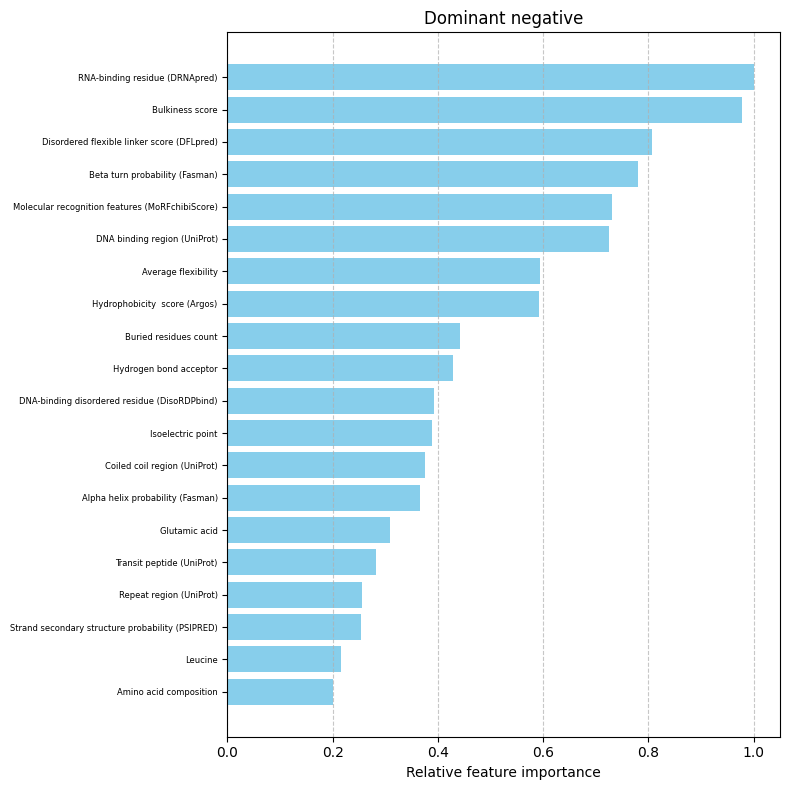

In [338]:
import matplotlib.pyplot as plt
import numpy as np

# Example lists (replace with your actual data)
names = all_feature_names_filtered_clear
values = DN_feat_explain_score.detach().numpy()

# Normalize the values by dividing by the maximum value
max_value = max(values)
normalized_values = [(v) / max_value for v in values]

# Sort the data by the normalized values
sorted_indices = np.argsort(normalized_values)
sorted_names = [names[i] for i in sorted_indices]
sorted_values = [normalized_values[i] for i in sorted_indices]

# Plotting
plt.figure(figsize=(8, 8))
plt.barh(sorted_names[-20:], sorted_values[-20:], color='skyblue')
plt.xlabel('Relative feature importance')
plt.title('Dominant negative')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.tick_params(axis='y', labelsize=6) 

# Ensure high quality plot for publication
plt.tight_layout()
plt.savefig('../res/plots/DN_featire_importance.png', dpi=300)
plt.show()


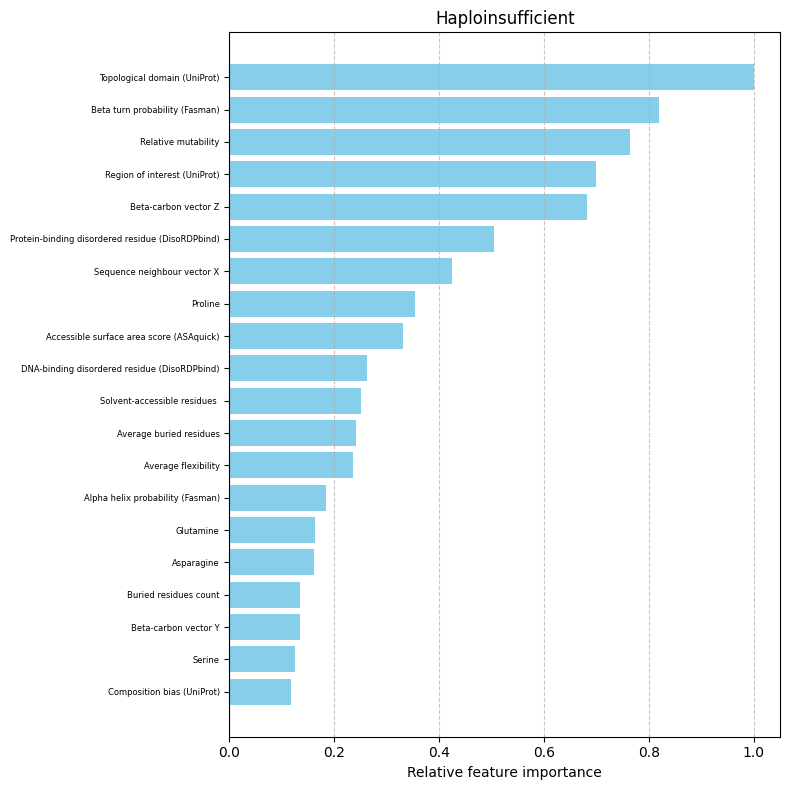

In [339]:
import matplotlib.pyplot as plt
import numpy as np

# Example lists (replace with your actual data)
names = all_feature_names_filtered_clear
values = LOF_feat_explain_score.detach().numpy()

# Normalize the values by dividing by the maximum value
max_value = max((values))
normalized_values = [(v) / max_value for v in values]

# Sort the data by the normalized values
sorted_indices = np.argsort(normalized_values)
sorted_names = [names[i] for i in sorted_indices]
sorted_values = [normalized_values[i] for i in sorted_indices]

# Plotting
plt.figure(figsize=(8, 8))
plt.barh(sorted_names[-20:], sorted_values[-20:], color='skyblue')
plt.xlabel('Relative feature importance')
plt.title('Haploinsufficient')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.tick_params(axis='y', labelsize=6) 

# Ensure high quality plot for publication
plt.tight_layout()
plt.savefig('../res/plots/HI_featire_importance.png', dpi=300)
plt.show()


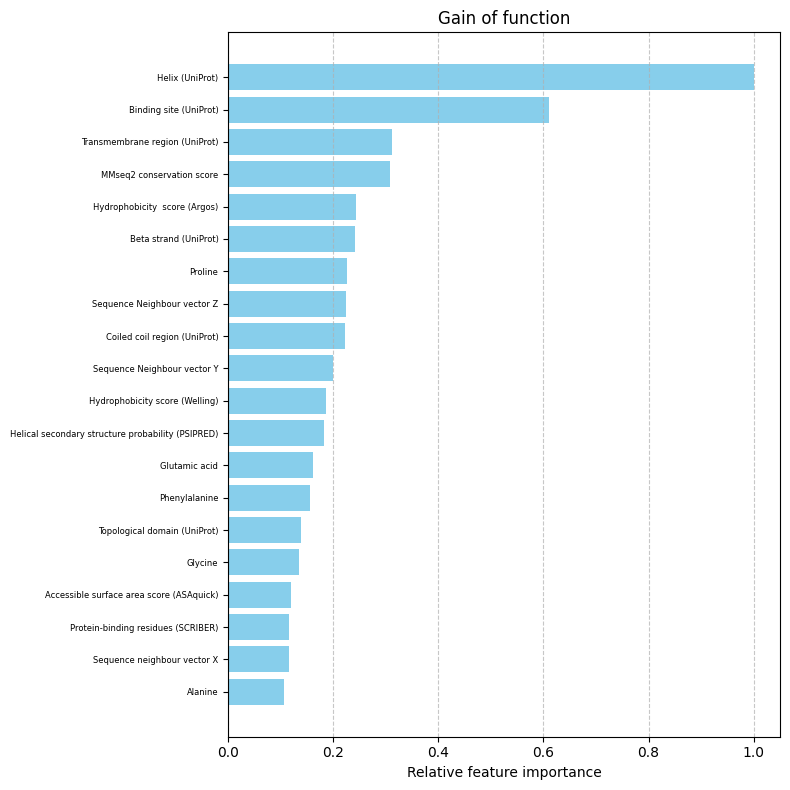

In [340]:
import matplotlib.pyplot as plt
import numpy as np

# Example lists (replace with your actual data)
names = all_feature_names_filtered_clear
values = GOF_feat_explain_score.detach().numpy()

# Normalize the values by dividing by the maximum value
max_value = max((values))
normalized_values = [(v) / max_value for v in values]
#normalized_values = values

# Sort the data by the normalized values
sorted_indices = np.argsort(normalized_values)
sorted_names = [names[i] for i in sorted_indices]
sorted_values = [normalized_values[i] for i in sorted_indices]

# Plotting
plt.figure(figsize=(8, 8))
plt.barh(sorted_names[-20:], sorted_values[-20:], color='skyblue')
plt.xlabel('Relative feature importance')
plt.title('Gain of function')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.tick_params(axis='y', labelsize=6) 

# Ensure high quality plot for publication
plt.tight_layout()
plt.savefig('../res/plots/GOF_featire_importance.png', dpi=300)
plt.show()


### all AD prediction

In [64]:
MOI_preds = pd.read_csv("../res/data/all_probs_df.tsv", sep="\t")
MOI_preds

,Unnamed: 0,pAD,pAR,UniprotEntry
0,0,0.703749,0.350514,Q14315
1,1,0.742918,0.266489,P45985
2,2,0.311728,0.763883,Q92629
3,3,0.244281,0.804688,Q13326
4,4,0.426574,0.653394,Q9NP98
...,...,...,...,...
16472,17241,0.077601,0.449132,A0A286YF01
16473,17244,0.047710,0.698571,A0A1B0GVY4
16474,17245,0.047710,0.698571,A0A2R8YCJ5
16475,17246,0.582237,0.136542,Q96RD0


In [65]:
MOI_preds_AD = MOI_preds[MOI_preds['pAD'] >= 0.5]
MOI_preds_AD

,Unnamed: 0,pAD,pAR,UniprotEntry
0,0,0.703749,0.350514,Q14315
1,1,0.742918,0.266489,P45985
5,5,0.820457,0.174333,Q9NZV8
6,6,0.734287,0.261110,Q86SQ0
11,11,0.631109,0.407307,Q9UMS6
...,...,...,...,...
16457,17222,0.625447,0.109282,C9JLW8
16459,17224,0.650841,0.335310,Q8N8J6
16460,17228,0.870609,0.184133,Q8WZ84
16475,17246,0.582237,0.136542,Q96RD0


In [66]:
MOI_preds_AD['pDN'] = np.nan
MOI_preds_AD['pLOF'] = np.nan
MOI_preds_AD['pGOF'] = np.nan
MOI_preds_AD

,Unnamed: 0,pAD,pAR,UniprotEntry,pDN,pLOF,pGOF
0,0,0.703749,0.350514,Q14315,NaN,NaN,NaN
1,1,0.742918,0.266489,P45985,NaN,NaN,NaN
5,5,0.820457,0.174333,Q9NZV8,NaN,NaN,NaN
6,6,0.734287,0.261110,Q86SQ0,NaN,NaN,NaN
11,11,0.631109,0.407307,Q9UMS6,NaN,NaN,NaN
...,...,...,...,...,...,...,...
16457,17222,0.625447,0.109282,C9JLW8,NaN,NaN,NaN
16459,17224,0.650841,0.335310,Q8N8J6,NaN,NaN,NaN
16460,17228,0.870609,0.184133,Q8WZ84,NaN,NaN,NaN
16475,17246,0.582237,0.136542,Q96RD0,NaN,NaN,NaN


In [ ]:
'''
# creat PyG objects
all_pyg_graphs_simple_AD = []
all_graphein_features = ["amino_acid_one_hot", "expasy", 'hbond_acceptors', 'hbond_donors', 'meiler', 'sidechain_vector', 'c_beta_vector', 'sequence_neighbour_vector_n_to_c']  # AAonehot 20, expasy = 61, hbond_acceptors=1, hbond_donors=1, meiler=7, sidechain_vector=3, c_beta_vector=3, sequence_neighbour_vector_n_to_c=3

counter = 1
for uniprot_id in MOI_preds_AD['UniprotEntry'].values.tolist():

    # remove those that are not in the describe_prot database
    if uniprot_id not in describe_prot["UniprotEntry"].values:
        continue
        
    # construct a networkx graph from AlphaFold predictions
    try:
        g = construct_graph(config=config, path=(af_db_path + prefix + uniprot_id + suffix))
    except:
        continue

    add_sidechain_vector(g)
    add_beta_carbon_vector(g)
    add_sequence_neighbour_vector(g)
    
    # convert to PyG object
    g2 = from_networkx(g)

    
    # add graphein features
    g2.x = g2[all_graphein_features[0]] 
    for feature in all_graphein_features[1:]:
        g2.x = torch.cat((g2.x, g2[feature]), dim=1)

    # add describe_prot features
    for feature in describe_prot_featnames:
        try:
            temp_feature = describe_prot[describe_prot["UniprotEntry"] == uniprot_id][feature].values[0]
            temp_num_list = [float(num) for num in temp_feature.split(',')]
            temp_num_tensor = torch.tensor(temp_num_list).reshape(-1, 1)
            g2.x = torch.cat((g2.x, temp_num_tensor), dim=1)
        except:
            g2.x = torch.cat((g2.x, torch.full((len(g2.residue_name), 1), float('nan'))), dim=1)

    # add uniprot features
    for feature in uniprot_features:
        try:
            temp_feature = uniprot_clean[uniprot_clean["Entry"] == uniprot_id][feature].values[0]
            temp_num_list = [int(char) for char in temp_feature]
            temp_num_tensor = torch.tensor(temp_num_list).reshape(-1, 1)
            g2.x = torch.cat((g2.x, temp_num_tensor), dim=1)
        except:
            g2.x = torch.cat((g2.x, torch.full((len(g2.residue_name), 1), float('nan'))), dim=1)

    # add phylop features
    for feature in phylop_features:
        try:
            temp_feature = phylop[phylop["Entry"] == uniprot_id][feature].values[0]
            temp_num_list = [float(num) for num in temp_feature.split(',')]
            temp_num_tensor = torch.tensor(temp_num_list).reshape(-1, 1)
            g2.x = torch.cat((g2.x, temp_num_tensor), dim=1)
        except:
            g2.x = torch.cat((g2.x, torch.full((len(g2.residue_name), 1), float('nan'))), dim=1)


    simple_g2 = Data(
        x=g2.x,               # Node features          
        batch=g2.batch,       # Batch information
        edge_index=g2.edge_index,  # Edge connections
        name = g2.name,
        coords=g2.coords
    )
    
    all_pyg_graphs_simple_AD.append(simple_g2)
    print(f"finished {counter} proteins")
    counter += 1

    if counter % 1000 == 0:
        with open('../res/pyg_graphs/with_distance_edgs/all_pyg_graphs_simple_AD.pkl', 'wb') as f:
            pickle.dump(all_pyg_graphs_simple_AD, f)

with open('../res/pyg_graphs/with_distance_edgs/all_pyg_graphs_simple_AD.pkl', 'wb') as f:
    pickle.dump(all_pyg_graphs_simple_AD, f)
    '''

Output()

[03/06/25 14:48:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=255759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=765752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=200348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=961564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:48:57] INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=149416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 519 hbond interactions.                                         ]8;id=335601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 45 hbond interactions.                                          ]8;id=316089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=348914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=854030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9580 ionic interactions.                                        ]8;id=632485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5004 distance edges                                             ]8;id=625252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=836695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 756 distance edges. (4248            removed by LIN)             ]8;id=304432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:49:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=642539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=688557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 399 total nodes                                                 ]8;id=711693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=794405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=40518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 190 hbond interactions.                                         ]8;id=869647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=550055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=225654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:49:04] INFO     Found 2776 ionic interactions.                                        ]8;id=439797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1 proteins


                    INFO     Found: 1341 distance edges                                             ]8;id=672343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 86 distance edges. (1255            removed by LIN)              ]8;id=340079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:49:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=351556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=886128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 630 total nodes                                                 ]8;id=284203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=122824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2 proteins


                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=178763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 242 hbond interactions.                                         ]8;id=821159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=856812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=601742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=631421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=713649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3799 ionic interactions.                                        ]8;id=197678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2050 distance edges                                             ]8;id=95978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (1986            removed by LIN)              ]8;id=22687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:49:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=220805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=762477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1253 total nodes                                                ]8;id=23889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=570672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=272545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 597 hbond interactions.                                         ]8;id=367309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=41291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=625459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=272769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6140 ionic interactions.                                        ]8;id=946134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=963098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4021 distance edges                                             ]8;id=213295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:49:08] INFO     Added 62 distance edges. (3959            removed by LIN)              ]8;id=886491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=169821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:49:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=625781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=966177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1093 total nodes                                                ]8;id=494535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=714374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=533305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=962080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 422 hbond interactions.                                         ]8;id=878351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=13040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=47916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4207 ionic interactions.                                        ]8;id=999428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=505232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3415 distance edges                                             ]8;id=376649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (3359            removed by LIN)              ]8;id=651246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=138773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:49:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=434548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=869167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

[03/06/25 14:49:18] DEBUG    Detected 542 total nodes                                                 ]8;id=201651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=732517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=668361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 275 hbond interactions.                                         ]8;id=595749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 5 proteins


                    INFO     Found 31 hbond interactions.                                          ]8;id=735921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3979 ionic interactions.                                        ]8;id=165346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1878 distance edges                                             ]8;id=588675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=633316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 200 distance edges. (1678            removed by LIN)             ]8;id=518607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:49:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=848346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=862684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 324 total nodes                                                 ]8;id=575209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=663841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=15444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 104 hbond interactions.                                         ]8;id=3557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=862696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=708587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=124679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2172 ionic interactions.                                        ]8;id=293583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=721986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 6 proteins


                    INFO     Found: 1076 distance edges                                             ]8;id=967594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (988            removed by LIN)               ]8;id=958273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=474982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:49:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=268947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=139901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 175 total nodes                                                 ]8;id=676269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=363911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=892589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 80 hbond interactions.                                          ]8;id=272283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=595033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=637111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1262 ionic interactions.                                        ]8;id=480944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 567 distance edges                                              ]8;id=186948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=217940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (537            removed by LIN)               ]8;id=145182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 7 proteins


Output()

[03/06/25 14:49:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=385038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=753401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=37397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=43204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=303595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=378438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 511 hbond interactions.                                         ]8;id=120477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=501287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=322835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=317373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=422753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10446 ionic interactions.                                       ]8;id=113929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4816 distance edges                                             ]8;id=353454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=881693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:49:22] INFO     Added 420 distance edges. (4396            removed by LIN)             ]8;id=502358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:49:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=316568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=351358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 158 total nodes                                                 ]8;id=964363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=174646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=669912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=91144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 66 hbond interactions.                                          ]8;id=786295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=231796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=412937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=583505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=512353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1201 ionic interactions.                                        ]8;id=443587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 562 distance edges                                              ]8;id=814848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=174672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (498            removed by LIN)               ]8;id=66959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=861909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 9 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=946875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=551357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 353 total nodes                                                 ]8;id=124686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=521233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=44146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 136 hbond interactions.                                         ]8;id=109712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=207586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=867158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=591296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2137 ionic interactions.                                        ]8;id=546547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=519470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 10 proteins


                    INFO     Found: 1133 distance edges                                             ]8;id=874023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=522653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (1099            removed by LIN)              ]8;id=211803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=569176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:49:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=356746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=739868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 724 total nodes                                                 ]8;id=337457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=37191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=631857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=822258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 328 hbond interactions.                                         ]8;id=308682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=753015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=838803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=88754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=69577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5446 ionic interactions.                                        ]8;id=795762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:49:30] INFO     Found: 2432 distance edges                                             ]8;id=839537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (2276            removed by LIN)             ]8;id=529530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=400799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:49:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=601748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=95050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 466 total nodes                                                 ]8;id=794659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=629294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=791274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=216116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 181 hbond interactions.                                         ]8;id=438137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=636936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=21476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=688898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 12 proteins


                    INFO     Found 2987 ionic interactions.                                        ]8;id=317133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1490 distance edges                                             ]8;id=517482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (1466            removed by LIN)              ]8;id=810004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:49:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=171751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=672121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 217 total nodes                                                 ]8;id=764884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=870255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=504711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 102 hbond interactions.                                         ]8;id=631207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=752026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=849649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=405466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1580 ionic interactions.                                        ]8;id=158720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 13 proteins


                    INFO     Found: 765 distance edges                                              ]8;id=660567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 110 distance edges. (655            removed by LIN)              ]8;id=363507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:49:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=514137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=116388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1215 total nodes                                                ]8;id=489882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=644172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=130362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 472 hbond interactions.                                         ]8;id=890378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 58 hbond interactions.                                          ]8;id=961426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 disulfide interactions.                                      ]8;id=544218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=902228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3835 distance edges                                             ]8;id=373873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:49:35] INFO     Added 118 distance edges. (3717            removed by LIN)             ]8;id=979673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=41922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:49:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=990677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=545325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1130 total nodes                                                ]8;id=226470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=240810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:49:40] INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=931945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=657905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 448 hbond interactions.                                         ]8;id=440518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=446662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=981209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3642 distance edges                                             ]8;id=452026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 162 distance edges. (3480            removed by LIN)             ]8;id=906030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 16 proteins


[03/06/25 14:49:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=73745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=127274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2382 total nodes                                                ]8;id=364776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=186549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=383571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 831 hbond interactions.                                         ]8;id=3389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=944666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=722958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:49:46] INFO     Found 10133 ionic interactions.                                       ]8;id=148779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 7500 distance edges                                             ]8;id=741847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 196 distance edges. (7304            removed by LIN)             ]8;id=351286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=580076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=666805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 365 total nodes                                                 ]8;id=107563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=559129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=941280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=154063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 123 hbond interactions.                                         ]8;id=331236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=305198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=138657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2076 ionic interactions.                                        ]8;id=76767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=138433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 17 proteins


                    INFO     Found: 1221 distance edges                                             ]8;id=776867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (1141            removed by LIN)              ]8;id=667907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=371787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=387193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=667989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 480 total nodes                                                 ]8;id=428475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=8836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=462733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=213899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 201 hbond interactions.                                         ]8;id=95479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=117606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=736727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 18 proteins


                    INFO     Found 3602 ionic interactions.                                        ]8;id=442189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1626 distance edges                                             ]8;id=982625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 134 distance edges. (1492            removed by LIN)             ]8;id=668261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=90701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=1932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=870500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1290 total nodes                                                ]8;id=8154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=229359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 202 aromatic-aromatic interactions                              ]8;id=315788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=571692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 580 hbond interactions.                                         ]8;id=787850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=494335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=243649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=22669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10081 ionic interactions.                                       ]8;id=265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=269039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:50:06] INFO     Found: 4424 distance edges                                             ]8;id=744451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 462 distance edges. (3962            removed by LIN)             ]8;id=371009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=297162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=205553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=624332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 377 total nodes                                                 ]8;id=275237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=320448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=901202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=261144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 185 hbond interactions.                                         ]8;id=71400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=434981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=140950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=601863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=110421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2352 ionic interactions.                                        ]8;id=816369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 20 proteins


[03/06/25 14:50:12] INFO     Found: 1323 distance edges                                             ]8;id=389865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 182 distance edges. (1141            removed by LIN)             ]8;id=730890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=146311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=586796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 537 total nodes                                                 ]8;id=495625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=778405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=728441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 225 hbond interactions.                                         ]8;id=465548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=930438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=409957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 21 proteins


[03/06/25 14:50:13] INFO     Found 3783 ionic interactions.                                        ]8;id=720262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=909230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1825 distance edges                                             ]8;id=969533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=701505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (1669            removed by LIN)             ]8;id=121794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=733673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=306736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 588 total nodes                                                 ]8;id=788124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=600677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=483283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 249 hbond interactions.                                         ]8;id=442194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=469019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 22 proteins


                    INFO     Found 15 disulfide interactions.                                      ]8;id=135500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=219011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3423 ionic interactions.                                        ]8;id=827680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1904 distance edges                                             ]8;id=765233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=230853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 92 distance edges. (1812            removed by LIN)              ]8;id=214191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=615021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=34895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=245397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 304 total nodes                                                 ]8;id=381272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=59758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=244385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 106 hbond interactions.                                         ]8;id=911048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=925841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=370221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=730653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1836 ionic interactions.                                        ]8;id=770091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=979450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 23 proteins


                    INFO     Found: 1054 distance edges                                             ]8;id=267127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 136 distance edges. (918            removed by LIN)              ]8;id=44286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=45935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=303887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=686426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 748 total nodes                                                 ]8;id=448522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=713560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 106 aromatic-aromatic interactions                              ]8;id=966149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=231706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 325 hbond interactions.                                         ]8;id=107310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=338615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=561933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=30229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5467 ionic interactions.                                        ]8;id=219772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2528 distance edges                                             ]8;id=211415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 210 distance edges. (2318            removed by LIN)             ]8;id=327399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=360647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=914332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 481 total nodes                                                 ]8;id=979562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=578786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:50:20] INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=759803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 210 hbond interactions.                                         ]8;id=517558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=252858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=927206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=963886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3682 ionic interactions.                                        ]8;id=857744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=447674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1621 distance edges                                             ]8;id=413632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=41263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 140 distance edges. (1481            removed by LIN)             ]8;id=134307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=881285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=335121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=455966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 481 total nodes                                                 ]8;id=639717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=567358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=815230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 162 hbond interactions.                                         ]8;id=665170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=273665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=644739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=434802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 26 proteins


                    INFO     Found 2502 ionic interactions.                                        ]8;id=691662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1523 distance edges                                             ]8;id=900827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (1475            removed by LIN)              ]8;id=123988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=751356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=737656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

[03/06/25 14:50:23] DEBUG    Detected 1114 total nodes                                                ]8;id=775809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=872205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=322456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 485 hbond interactions.                                         ]8;id=503599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=16251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=665652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=26514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5315 ionic interactions.                                        ]8;id=162784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3516 distance edges                                             ]8;id=216535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=819403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (3436            removed by LIN)              ]8;id=804524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=729492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=855820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=245041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 520 total nodes                                                 ]8;id=619737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=138979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:50:28] INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=113260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 200 hbond interactions.                                         ]8;id=376034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=512962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=582507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=684472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=848546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 28 proteins


                    INFO     Found 3033 ionic interactions.                                        ]8;id=738432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1662 distance edges                                             ]8;id=421374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=737588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (1640            removed by LIN)              ]8;id=305899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=330466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=761748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 572 total nodes                                                 ]8;id=462626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=700902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=272741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=360890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 29 proteins


                    INFO     Found 186 hbond interactions.                                         ]8;id=373668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=601455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=158561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=370587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=25757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:50:30] INFO     Found: 1804 distance edges                                             ]8;id=696228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=443183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (1788            removed by LIN)              ]8;id=470775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=680605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=344785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 794 total nodes                                                 ]8;id=401256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=10101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=557146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 333 hbond interactions.                                         ]8;id=795959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=409258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=179637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 disulfide interactions.                                      ]8;id=911058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=694132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5575 ionic interactions.                                        ]8;id=155365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2786 distance edges                                             ]8;id=860522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=184836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 14:50:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=588679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=176490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 418 total nodes                                                 ]8;id=906666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=626920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=744601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 147 hbond interactions.                                         ]8;id=356778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=656161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=375773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2347 ionic interactions.                                        ]8;id=532087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=373093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 31 proteins


                    INFO     Found: 1364 distance edges                                             ]8;id=354047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=282947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (1280            removed by LIN)              ]8;id=15502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=325859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=491695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=36625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 427 total nodes                                                 ]8;id=275195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=979464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=756429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=125845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 208 hbond interactions.                                         ]8;id=21688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=286313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=713444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=719439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 32 proteins


                    INFO     Found 3289 ionic interactions.                                        ]8;id=356809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1411 distance edges                                             ]8;id=593534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=345445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 92 distance edges. (1319            removed by LIN)              ]8;id=614618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=370520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=170447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1336 total nodes                                                ]8;id=346720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=887322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:50:37] INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=856014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=53744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 536 hbond interactions.                                         ]8;id=380835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=820809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=826634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=147596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7373 ionic interactions.                                        ]8;id=357927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4368 distance edges                                             ]8;id=954105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 230 distance edges. (4138            removed by LIN)             ]8;id=270112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=981548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=444469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1608 total nodes                                                ]8;id=555252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=178109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 34 proteins


                    INFO     Found: 116 aromatic-aromatic interactions                              ]8;id=607845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 685 hbond interactions.                                         ]8;id=569820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 80 hbond interactions.                                          ]8;id=326524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=752791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:50:44] INFO     Found 10462 ionic interactions.                                       ]8;id=581498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=333373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5232 distance edges                                             ]8;id=452666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 166 distance edges. (5066            removed by LIN)             ]8;id=536180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=162878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=819491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=590647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 409 total nodes                                                 ]8;id=38135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=588878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=837263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 199 hbond interactions.                                         ]8;id=379817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=554796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=661554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=371692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=766424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 35 proteins


                    INFO     Found 3066 ionic interactions.                                        ]8;id=287805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1423 distance edges                                             ]8;id=81709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:50:53] INFO     Added 186 distance edges. (1237            removed by LIN)             ]8;id=471496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=739237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=105299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 619 total nodes                                                 ]8;id=68398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=973064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 36 proteins


[03/06/25 14:50:54] INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=285058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 291 hbond interactions.                                         ]8;id=373464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=516442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=417226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3823 ionic interactions.                                        ]8;id=705771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2053 distance edges                                             ]8;id=610993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 114 distance edges. (1939            removed by LIN)             ]8;id=591832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=745000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:50:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=417430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=496736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1512 total nodes                                                ]8;id=85440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=593409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=72743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=200040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 606 hbond interactions.                                         ]8;id=493986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=45214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 96 hbond interactions.                                          ]8;id=991216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=26622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=801879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8766 ionic interactions.                                        ]8;id=624598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=154653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:50:57] INFO     Found: 4972 distance edges                                             ]8;id=62755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 240 distance edges. (4732            removed by LIN)             ]8;id=504252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=48982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=765260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 903 total nodes                                                 ]8;id=581903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=724763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=995810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 364 hbond interactions.                                         ]8;id=86821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=211397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=839071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=266214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=820331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6146 ionic interactions.                                        ]8;id=954200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=162737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3021 distance edges                                             ]8;id=160242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=40476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 220 distance edges. (2801            removed by LIN)             ]8;id=537104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=35437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=992732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=75123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 424 total nodes                                                 ]8;id=640567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=250317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:51:08] INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=743996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 189 hbond interactions.                                         ]8;id=808998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=542817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=360062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=109032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 39 proteins


                    INFO     Found 3294 ionic interactions.                                        ]8;id=352119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1412 distance edges                                             ]8;id=903307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (1324            removed by LIN)              ]8;id=23829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=928973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=636986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 456 total nodes                                                 ]8;id=65052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=732788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=54768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 197 hbond interactions.                                         ]8;id=375268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=963011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=56629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=462114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=793213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=268255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 40 proteins


                    INFO     Found 2077 ionic interactions.                                        ]8;id=842809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=475673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1434 distance edges                                             ]8;id=841381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (1386            removed by LIN)              ]8;id=374980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=100983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=185689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=423376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 464 total nodes                                                 ]8;id=14309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=338483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=914004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 236 hbond interactions.                                         ]8;id=54236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=561631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=900147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=970425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=100367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 41 proteins


                    INFO     Found 3413 ionic interactions.                                        ]8;id=103269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=494280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1536 distance edges                                             ]8;id=655917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 94 distance edges. (1442            removed by LIN)              ]8;id=354094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=164480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=168357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=183096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1374 total nodes                                                ]8;id=712860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=254365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:51:12] INFO     Found: 132 aromatic-aromatic interactions                              ]8;id=344216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=991532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 589 hbond interactions.                                         ]8;id=711399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=417442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=295254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=171569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4554 distance edges                                             ]8;id=170017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=975491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:51:13] INFO     Added 204 distance edges. (4350            removed by LIN)             ]8;id=753367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=864116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=339029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 360 total nodes                                                 ]8;id=814868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=970517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=816133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=160591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 161 hbond interactions.                                         ]8;id=27726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=349095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=745752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=535038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2967 ionic interactions.                                        ]8;id=427565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 43 proteins


                    INFO     Found: 1190 distance edges                                             ]8;id=939214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 14:51:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=965128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=609616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 626 total nodes                                                 ]8;id=928031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=552165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 44 proteins


                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=641313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=817464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 304 hbond interactions.                                         ]8;id=42261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=656515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=151212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=748133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3755 ionic interactions.                                        ]8;id=766511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2072 distance edges                                             ]8;id=747839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=483064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 118 distance edges. (1954            removed by LIN)             ]8;id=357035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=497401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=906589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=297491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 606 total nodes                                                 ]8;id=386172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=362199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 45 proteins


                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=495639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=660885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 258 hbond interactions.                                         ]8;id=919746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=310423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=452159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=36596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3668 ionic interactions.                                        ]8;id=763233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1948 distance edges                                             ]8;id=642912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=374303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (1878            removed by LIN)              ]8;id=417749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 46 proteins


[03/06/25 14:51:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=713895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=81605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 462 total nodes                                                 ]8;id=580823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=145018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=239336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 198 hbond interactions.                                         ]8;id=374314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=751249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=958533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2868 ionic interactions.                                        ]8;id=274484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1484 distance edges                                             ]8;id=347906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (1452            removed by LIN)              ]8;id=775735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=779908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=959262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=396955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 947 total nodes                                                 ]8;id=536395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=321030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=716635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=161495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 338 hbond interactions.                                         ]8;id=664851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=730696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=817136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=675597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=632429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5199 ionic interactions.                                        ]8;id=767473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:51:26] INFO     Found: 3085 distance edges                                             ]8;id=37770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=10995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 166 distance edges. (2919            removed by LIN)             ]8;id=757557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=387023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=612633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 360 total nodes                                                 ]8;id=851535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=813410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=578426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=867425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 170 hbond interactions.                                         ]8;id=532668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=965544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=674456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=637800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=692740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2961 ionic interactions.                                        ]8;id=424691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 48 proteins


                    INFO     Found: 1216 distance edges                                             ]8;id=407076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=179657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 14:51:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=616788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=424870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 401 total nodes                                                 ]8;id=477652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=41005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=873631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=532152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 170 hbond interactions.                                         ]8;id=495639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=167289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=317145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=150616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=479116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1992 ionic interactions.                                        ]8;id=593620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 49 proteins


                    INFO     Found: 1275 distance edges                                             ]8;id=505719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (1227            removed by LIN)              ]8;id=376924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=851300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=59463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=862976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 480 total nodes                                                 ]8;id=208145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=7397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=733780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 231 hbond interactions.                                         ]8;id=112244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=976474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=817914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=253429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 50 proteins


                    INFO     Found 3570 ionic interactions.                                        ]8;id=235527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=9407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1612 distance edges                                             ]8;id=971523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 14:51:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=795013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=152543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 954 total nodes                                                 ]8;id=778450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=813950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 51 proteins


[03/06/25 14:51:33] INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=376614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=296640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 310 hbond interactions.                                         ]8;id=816375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=125262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=493846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=960350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4893 ionic interactions.                                        ]8;id=804597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3094 distance edges                                             ]8;id=503030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (2966            removed by LIN)             ]8;id=360726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=354518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=523559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 467 total nodes                                                 ]8;id=407599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=487397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=868744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 204 hbond interactions.                                         ]8;id=326322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=1720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=96359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=995935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 52 proteins


                    INFO     Found 3251 ionic interactions.                                        ]8;id=808836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=42400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:51:37] INFO     Found: 1551 distance edges                                             ]8;id=760668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (1449            removed by LIN)             ]8;id=732586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=8485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=401260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 379 total nodes                                                 ]8;id=861411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=634016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 53 proteins


                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=85526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 169 hbond interactions.                                         ]8;id=545490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=940088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=563013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=435604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=400481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3029 ionic interactions.                                        ]8;id=220309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=399764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1287 distance edges                                             ]8;id=29939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (1185            removed by LIN)             ]8;id=353711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=710073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=542146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=96522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 859 total nodes                                                 ]8;id=108514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=286126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=809617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 320 hbond interactions.                                         ]8;id=692088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=335058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=126187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=586781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=130597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4148 ionic interactions.                                        ]8;id=476999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2759 distance edges                                             ]8;id=395556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (2689            removed by LIN)              ]8;id=861904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=503894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=812877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 543 total nodes                                                 ]8;id=758554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=931164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=812920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 210 hbond interactions.                                         ]8;id=500414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=498173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=377463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=156036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 2735 ionic interactions.                                        ]8;id=314471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1787 distance edges                                             ]8;id=992159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1787            removed by LIN)               ]8;id=912298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=491363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=409258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 201 total nodes                                                 ]8;id=201380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=175648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=840806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 73 hbond interactions.                                          ]8;id=870115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=544431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=610999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=455125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1231 ionic interactions.                                        ]8;id=517413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 56 proteins


                    INFO     Found: 677 distance edges                                              ]8;id=627115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=462819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (617            removed by LIN)               ]8;id=633306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=45657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 592 total nodes                                                 ]8;id=916619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=706954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=114351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 57 proteins


                    INFO     Found 283 hbond interactions.                                         ]8;id=677094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=664865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=517398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=884199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=373852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3698 ionic interactions.                                        ]8;id=695450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=332951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:51:45] INFO     Found: 1962 distance edges                                             ]8;id=230449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 154 distance edges. (1808            removed by LIN)             ]8;id=413197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=935459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=385746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 367 total nodes                                                 ]8;id=217393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=91821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=916359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 156 hbond interactions.                                         ]8;id=4341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=701249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=513497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=82086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2919 ionic interactions.                                        ]8;id=213863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 58 proteins


                    INFO     Found: 1235 distance edges                                             ]8;id=87779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (1145            removed by LIN)              ]8;id=643683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=385364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=160830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 847 total nodes                                                 ]8;id=468873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=291983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:51:48] INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=402717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 284 hbond interactions.                                         ]8;id=864176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=162304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=330863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=66373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4433 ionic interactions.                                        ]8;id=764582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2749 distance edges                                             ]8;id=696688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 122 distance edges. (2627            removed by LIN)             ]8;id=32633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=124681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=659890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=285206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 393 total nodes                                                 ]8;id=305795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=391895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:51:51] INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=781246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 165 hbond interactions.                                         ]8;id=540427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=859310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=23019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=144355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=360755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2894 ionic interactions.                                        ]8;id=829063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 60 proteins


                    INFO     Found: 1301 distance edges                                             ]8;id=545994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (1219            removed by LIN)              ]8;id=36342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=545496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 61 proteins


[03/06/25 14:51:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=101518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=584884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1241 total nodes                                                ]8;id=727380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=695585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=732306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 445 hbond interactions.                                         ]8;id=755770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=226563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=588353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8004 ionic interactions.                                        ]8;id=692361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4383 distance edges                                             ]8;id=820027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:51:53] INFO     Added 628 distance edges. (3755            removed by LIN)             ]8;id=14806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:51:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=288678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=211192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 418 total nodes                                                 ]8;id=470904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=93227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=429051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 191 hbond interactions.                                         ]8;id=182593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=310972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=732674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=669445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 62 proteins


                    INFO     Found 3071 ionic interactions.                                        ]8;id=328323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=332319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1444 distance edges                                             ]8;id=821326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=742876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 14:51:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=407491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=438929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 372 total nodes                                                 ]8;id=996989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=327940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=932587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=470613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 150 hbond interactions.                                         ]8;id=177771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=500506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=103202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2537 ionic interactions.                                        ]8;id=15932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 63 proteins


                    INFO     Found: 1210 distance edges                                             ]8;id=130610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (1146            removed by LIN)              ]8;id=423851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=61189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=172210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 710 total nodes                                                 ]8;id=374656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=212298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=315452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 238 hbond interactions.                                         ]8;id=570603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=756830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=437644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=164462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3474 ionic interactions.                                        ]8;id=873745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=609663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2276 distance edges                                             ]8;id=549469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 118 distance edges. (2158            removed by LIN)             ]8;id=833630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=828356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=948781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 479 total nodes                                                 ]8;id=175961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=399524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 65 proteins


                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=559119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=551689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

[03/06/25 14:52:03] INFO     Found 227 hbond interactions.                                         ]8;id=90136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=558690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=85712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=472261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3635 ionic interactions.                                        ]8;id=415545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1617 distance edges                                             ]8;id=165376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 130 distance edges. (1487            removed by LIN)             ]8;id=47548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=70291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=726791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 419 total nodes                                                 ]8;id=815745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=940565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=657326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=922889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 193 hbond interactions.                                         ]8;id=154912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=311797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=526123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=23595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 66 proteins


                    INFO     Found 2970 ionic interactions.                                        ]8;id=896981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1411 distance edges                                             ]8;id=316061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 86 distance edges. (1325            removed by LIN)              ]8;id=983105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=894607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=668844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1620 total nodes                                                ]8;id=420763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=729325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 67 proteins


[03/06/25 14:52:06] INFO     Found: 120 aromatic-aromatic interactions                              ]8;id=854463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 627 hbond interactions.                                         ]8;id=452275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 106 hbond interactions.                                         ]8;id=147078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 65 disulfide interactions.                                      ]8;id=557561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10138 ionic interactions.                                       ]8;id=678919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=498971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5870 distance edges                                             ]8;id=316304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=478368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:52:07] INFO     Added 880 distance edges. (4990            removed by LIN)             ]8;id=827806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=72112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=19166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1321 total nodes                                                ]8;id=268806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=832471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:52:15] INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=227103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 514 hbond interactions.                                         ]8;id=951283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=693410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=9448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=960992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7418 ionic interactions.                                        ]8;id=862013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=247607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4319 distance edges                                             ]8;id=380924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 228 distance edges. (4091            removed by LIN)             ]8;id=820057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=14966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=622722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 437 total nodes                                                 ]8;id=218748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=912895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=193436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 164 hbond interactions.                                         ]8;id=641455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=986265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=56788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 69 proteins


                    INFO     Found 2623 ionic interactions.                                        ]8;id=679102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1437 distance edges                                             ]8;id=439689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=325383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 86 distance edges. (1351            removed by LIN)              ]8;id=970949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=355600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=144886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 743 total nodes                                                 ]8;id=509656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=504626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=939328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=677340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 307 hbond interactions.                                         ]8;id=167330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=941665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=749548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=166772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=636986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:52:23] INFO     Found 4482 ionic interactions.                                        ]8;id=719602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=688788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2373 distance edges                                             ]8;id=117886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=612919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (2325            removed by LIN)              ]8;id=783030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=505704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=717829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=801474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 218 total nodes                                                 ]8;id=116013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=666143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=840764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 67 hbond interactions.                                          ]8;id=813215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=403767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=662614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1406 ionic interactions.                                        ]8;id=675180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 732 distance edges                                              ]8;id=432454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (678            removed by LIN)               ]8;id=628183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=820003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 71 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=737515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=311637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 892 total nodes                                                 ]8;id=572884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=57439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:52:26] INFO     Found: 118 aromatic-aromatic interactions                              ]8;id=568747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 382 hbond interactions.                                         ]8;id=675536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=217384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=604557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=422721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7181 ionic interactions.                                        ]8;id=54054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2962 distance edges                                             ]8;id=10752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (2898            removed by LIN)              ]8;id=873083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=999576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=348357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 894 total nodes                                                 ]8;id=878244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=152421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 106 aromatic-aromatic interactions                              ]8;id=90320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=391136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 366 hbond interactions.                                         ]8;id=715438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=84799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=330855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=568547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=503353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7207 ionic interactions.                                        ]8;id=950482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:52:30] INFO     Found: 2980 distance edges                                             ]8;id=916965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (2914            removed by LIN)              ]8;id=150128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=163466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=121508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=696524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 727 total nodes                                                 ]8;id=317412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=369343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=500130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 262 hbond interactions.                                         ]8;id=702204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=243579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=814957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=819621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3542 ionic interactions.                                        ]8;id=261902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2303 distance edges                                             ]8;id=456350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 14:52:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=41679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=988267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 521 total nodes                                                 ]8;id=509655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=506610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=439446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 221 hbond interactions.                                         ]8;id=686136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=686273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=360982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=716615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=760890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 75 proteins


                    INFO     Found 4046 ionic interactions.                                        ]8;id=503564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=551465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:52:36] INFO     Found: 1831 distance edges                                             ]8;id=403984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=729120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 174 distance edges. (1657            removed by LIN)             ]8;id=507191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=653343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=628913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 911 total nodes                                                 ]8;id=463135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=330561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 76 proteins


                    INFO     Found: 118 aromatic-aromatic interactions                              ]8;id=806825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 394 hbond interactions.                                         ]8;id=450398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=410456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=252306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=907930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=972837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7268 ionic interactions.                                        ]8;id=249735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=628438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:52:38] INFO     Found: 3031 distance edges                                             ]8;id=337698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 58 distance edges. (2973            removed by LIN)              ]8;id=577127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=181377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=120313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=937088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 436 total nodes                                                 ]8;id=725435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=190339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=744396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=841115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 179 hbond interactions.                                         ]8;id=220504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=371142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=45431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 77 proteins


                    INFO     Found 2332 ionic interactions.                                        ]8;id=888040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=584286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1398 distance edges                                             ]8;id=301744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (1390            removed by LIN)               ]8;id=889713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=730931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=404087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 119 total nodes                                                 ]8;id=935907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=61573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=644862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=755186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 60 hbond interactions.                                          ]8;id=942755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=435019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=231088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=828771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=658661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 825 ionic interactions.                                         ]8;id=692175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 425 distance edges                                              ]8;id=625602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=100417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (361            removed by LIN)               ]8;id=43253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 78 proteins


Output()

finished 79 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=327249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=95922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 390 total nodes                                                 ]8;id=744262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=134629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=972063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 178 hbond interactions.                                         ]8;id=207446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=619051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=239402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1910 ionic interactions.                                        ]8;id=770097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=646143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:52:43] INFO     Found: 1248 distance edges                                             ]8;id=941844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (1212            removed by LIN)              ]8;id=208535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=690477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=503046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 357 total nodes                                                 ]8;id=777306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=284008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=647966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=893764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 115 hbond interactions.                                         ]8;id=628229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=772264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=863934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=217193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=438511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:52:44] INFO     Found 2063 ionic interactions.                                        ]8;id=527770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=334229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 80 proteins


                    INFO     Found: 1199 distance edges                                             ]8;id=478806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (1131            removed by LIN)              ]8;id=986312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=741859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=197913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 256 total nodes                                                 ]8;id=369754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=564811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=579202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 107 hbond interactions.                                         ]8;id=618656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=952607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=145206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=151184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=443081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1776 ionic interactions.                                        ]8;id=204558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 81 proteins


                    INFO     Found: 842 distance edges                                              ]8;id=277936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (826            removed by LIN)               ]8;id=361049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=402607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=576274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 270 total nodes                                                 ]8;id=567369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=596882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=646657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=465224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 135 hbond interactions.                                         ]8;id=220342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=561308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=785821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1784 ionic interactions.                                        ]8;id=252403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 82 proteins


                    INFO     Found: 896 distance edges                                              ]8;id=930642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (872            removed by LIN)               ]8;id=229107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=104479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=538133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 227 total nodes                                                 ]8;id=604846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=545044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=414080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 107 hbond interactions.                                         ]8;id=839333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=494234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=30279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=736158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1662 ionic interactions.                                        ]8;id=543107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 745 distance edges                                              ]8;id=248094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=475782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (727            removed by LIN)               ]8;id=876535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=755654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=982550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 221 total nodes                                                 ]8;id=919899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=703442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:52:47] INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=520452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 85 hbond interactions.                                          ]8;id=241274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=251732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=898495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=542323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 781 ionic interactions.                                         ]8;id=152660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 711 distance edges                                              ]8;id=759885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=79256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (711            removed by LIN)                ]8;id=200927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 84 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=682649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=760906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 796 total nodes                                                 ]8;id=149656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=462292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 114 aromatic-aromatic interactions                              ]8;id=162594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 366 hbond interactions.                                         ]8;id=366921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=162891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=450249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=277740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=165441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6421 ionic interactions.                                        ]8;id=444404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:52:48] INFO     Found: 2782 distance edges                                             ]8;id=786488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=493036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 320 distance edges. (2462            removed by LIN)             ]8;id=678834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=545705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=44801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 865 total nodes                                                 ]8;id=843097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=617973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 124 aromatic-aromatic interactions                              ]8;id=772931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 385 hbond interactions.                                         ]8;id=394652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=862422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=609404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=167623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6571 ionic interactions.                                        ]8;id=13796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:52:51] INFO     Found: 3017 distance edges                                             ]8;id=804165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 330 distance edges. (2687            removed by LIN)             ]8;id=889435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=800277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=185925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=71212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 351 total nodes                                                 ]8;id=653220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=490559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:52:54] INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=440242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 140 hbond interactions.                                         ]8;id=473441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=427602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=253615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2893 ionic interactions.                                        ]8;id=150990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 87 proteins


                    INFO     Found: 1177 distance edges                                             ]8;id=335207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (1089            removed by LIN)              ]8;id=606329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=750496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=597145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 499 total nodes                                                 ]8;id=210169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=312726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:52:55] INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=282778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 205 hbond interactions.                                         ]8;id=812613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=321153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=27539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=814466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 88 proteins


                    INFO     Found 3750 ionic interactions.                                        ]8;id=444458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1719 distance edges                                             ]8;id=542698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 160 distance edges. (1559            removed by LIN)             ]8;id=112173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=508346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=922968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 666 total nodes                                                 ]8;id=139156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=638243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 89 proteins


                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=180341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 260 hbond interactions.                                         ]8;id=742915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=741302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=32718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=965116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4230 ionic interactions.                                        ]8;id=133710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=672108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:52:57] INFO     Found: 2244 distance edges                                             ]8;id=756044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 180 distance edges. (2064            removed by LIN)             ]8;id=878538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=371235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:52:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=382343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=612450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 724 total nodes                                                 ]8;id=474826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=137382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:52:59] INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=550397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=900449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 300 hbond interactions.                                         ]8;id=248977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=60071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=708116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=316012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4769 ionic interactions.                                        ]8;id=710702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=353765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2444 distance edges                                             ]8;id=355785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 232 distance edges. (2212            removed by LIN)             ]8;id=254553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:53:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=274231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=572374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 250 total nodes                                                 ]8;id=15575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=108269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=217814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=327648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 115 hbond interactions.                                         ]8;id=315871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=302712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=116668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1841 ionic interactions.                                        ]8;id=487840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 91 proteins


                    INFO     Found: 822 distance edges                                              ]8;id=461223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (802            removed by LIN)               ]8;id=396899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:53:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=660948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=805861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 478 total nodes                                                 ]8;id=402486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=240676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=586937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 187 hbond interactions.                                         ]8;id=845403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=245058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=297051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=659433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=894357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 92 proteins


                    INFO     Found 3696 ionic interactions.                                        ]8;id=780728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=752698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1654 distance edges                                             ]8;id=813067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 162 distance edges. (1492            removed by LIN)             ]8;id=484729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:53:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=652108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=826675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 190 total nodes                                                 ]8;id=259202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=22035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=858313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=945010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 92 hbond interactions.                                          ]8;id=997489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=34521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=999769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1432 ionic interactions.                                        ]8;id=594647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=213940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 622 distance edges                                              ]8;id=92016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=754019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (600            removed by LIN)               ]8;id=580859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 94 proteins


[03/06/25 14:53:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=448867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=23929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 558 total nodes                                                 ]8;id=359378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=775150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=309503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 243 hbond interactions.                                         ]8;id=840867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=297324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=67322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=674607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4038 ionic interactions.                                        ]8;id=798503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1910 distance edges                                             ]8;id=419998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 172 distance edges. (1738            removed by LIN)             ]8;id=302547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:53:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=864583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=452499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1102 total nodes                                                ]8;id=937599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=804558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 150 aromatic-aromatic interactions                              ]8;id=316644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 506 hbond interactions.                                         ]8;id=857619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=363499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=39070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=69022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=714831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8459 ionic interactions.                                        ]8;id=25204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3758 distance edges                                             ]8;id=934190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=521258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:53:07] INFO     Added 368 distance edges. (3390            removed by LIN)             ]8;id=185776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=988989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:53:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=187681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=10393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 439 total nodes                                                 ]8;id=712058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=458496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=416129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 191 hbond interactions.                                         ]8;id=502095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=122390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=836696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 96 proteins


                    INFO     Found 1859 ionic interactions.                                        ]8;id=859658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1353 distance edges                                             ]8;id=62759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1351            removed by LIN)               ]8;id=230430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=975206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:53:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=574826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=972542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 247 total nodes                                                 ]8;id=444542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=42406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=386764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 129 hbond interactions.                                         ]8;id=34703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=910038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=177461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=146017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1997 ionic interactions.                                        ]8;id=834238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=106560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 97 proteins


                    INFO     Found: 831 distance edges                                              ]8;id=814876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=693150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (805            removed by LIN)               ]8;id=979841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:53:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=752481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=901354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 245 total nodes                                                 ]8;id=176216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=566080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=765322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 120 hbond interactions.                                         ]8;id=656961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=260167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=389823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=554307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1958 ionic interactions.                                        ]8;id=599641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 98 proteins


                    INFO     Found: 821 distance edges                                              ]8;id=593481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (795            removed by LIN)               ]8;id=891096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=370044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=529956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1210 total nodes                                                ]8;id=150075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=270326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:53:14] INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=684177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 592 hbond interactions.                                         ]8;id=513332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 141 hbond interactions.                                         ]8;id=273415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 110 disulfide interactions.                                     ]8;id=962066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=688428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8195 ionic interactions.                                        ]8;id=209825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4196 distance edges                                             ]8;id=151635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 460 distance edges. (3736            removed by LIN)             ]8;id=121361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=647582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:53:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=838077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=418793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1382 total nodes                                                ]8;id=973706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=406701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 100 proteins


                    INFO     Found: 136 aromatic-aromatic interactions                              ]8;id=348136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 646 hbond interactions.                                         ]8;id=563175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 117 hbond interactions.                                         ]8;id=274656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 83 disulfide interactions.                                      ]8;id=351195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:53:20] INFO     Found 9728 ionic interactions.                                        ]8;id=279620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4818 distance edges                                             ]8;id=816884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 14:53:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=521585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=208925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 906 total nodes                                                 ]8;id=77542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=427830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=44702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 395 hbond interactions.                                         ]8;id=166392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=345398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=611371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=575283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=674170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=569480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:53:27] INFO     Found 4857 ionic interactions.                                        ]8;id=475929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2892 distance edges                                             ]8;id=649150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 94 distance edges. (2798            removed by LIN)              ]8;id=808853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:53:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=503205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=911665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 583 total nodes                                                 ]8;id=769449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=904007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=760133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=932017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 102 proteins


                    INFO     Found 207 hbond interactions.                                         ]8;id=801316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=197334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=411361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=169605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2999 ionic interactions.                                        ]8;id=466336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=867476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1885 distance edges                                             ]8;id=225103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (1783            removed by LIN)             ]8;id=952680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:53:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=193549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=103541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1292 total nodes                                                ]8;id=269073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=546947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 103 proteins


                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=564634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=763677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 548 hbond interactions.                                         ]8;id=262989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=298736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=982816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=677540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5149 ionic interactions.                                        ]8;id=442370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=285477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:53:33] INFO     Found: 4088 distance edges                                             ]8;id=757459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=38011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 142 distance edges. (3946            removed by LIN)             ]8;id=998368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=837115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:53:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=30740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=516759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 870 total nodes                                                 ]8;id=559443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=366666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=582887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=780235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 264 hbond interactions.                                         ]8;id=606248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=636659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=373027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=229852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4473 ionic interactions.                                        ]8;id=659425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=134967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2770 distance edges                                             ]8;id=461611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (2708            removed by LIN)              ]8;id=886382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:53:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=758517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=839382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1544 total nodes                                                ]8;id=967175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=535498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 105 proteins


[03/06/25 14:53:42] INFO     Found: 104 aromatic-aromatic interactions                              ]8;id=681729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 553 hbond interactions.                                         ]8;id=136038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 69 hbond interactions.                                          ]8;id=356479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 disulfide interactions.                                      ]8;id=81760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=601535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9715 ionic interactions.                                        ]8;id=489112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5138 distance edges                                             ]8;id=317159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=374076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:53:43] INFO     Added 326 distance edges. (4812            removed by LIN)             ]8;id=957178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:53:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=105569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=654568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1234 total nodes                                                ]8;id=323327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=608299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 92 aromatic-aromatic interactions                               ]8;id=689070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 512 hbond interactions.                                         ]8;id=224341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=509928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=152489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=450063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9033 ionic interactions.                                        ]8;id=658578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:53:51] INFO     Found: 4132 distance edges                                             ]8;id=143499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 266 distance edges. (3866            removed by LIN)             ]8;id=849762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=471726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:53:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=133748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=739134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 536 total nodes                                                 ]8;id=161846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=101605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=764591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=333499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 220 hbond interactions.                                         ]8;id=171101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=285538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=122299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=117913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 107 proteins


                    INFO     Found 9 disulfide interactions.                                       ]8;id=324731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3799 ionic interactions.                                        ]8;id=198414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1830 distance edges                                             ]8;id=178001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 162 distance edges. (1668            removed by LIN)             ]8;id=83214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:53:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=739405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=110906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 785 total nodes                                                 ]8;id=410066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=486394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=147488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 266 hbond interactions.                                         ]8;id=125552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=294976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=85813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=894842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2885 ionic interactions.                                        ]8;id=422534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=945919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2413 distance edges                                             ]8;id=279791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (2373            removed by LIN)              ]8;id=847789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:54:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=960595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=169703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1185 total nodes                                                ]8;id=668248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=545386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:54:01] INFO     Found: 104 aromatic-aromatic interactions                              ]8;id=708560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=771345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 493 hbond interactions.                                         ]8;id=875311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 58 hbond interactions.                                          ]8;id=827027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=316968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=366102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8873 ionic interactions.                                        ]8;id=68346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3975 distance edges                                             ]8;id=104366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=378241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 270 distance edges. (3705            removed by LIN)             ]8;id=140488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:54:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=692394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=520702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 781 total nodes                                                 ]8;id=898141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=504568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=283057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 229 hbond interactions.                                         ]8;id=651941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=961375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=575074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=182446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2403 distance edges                                             ]8;id=394041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (2359            removed by LIN)              ]8;id=354303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:54:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=756997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=773517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1265 total nodes                                                ]8;id=845287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=146596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 174 aromatic-aromatic interactions                              ]8;id=19636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=893774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 601 hbond interactions.                                         ]8;id=57631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=336735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=803131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=767518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10412 ionic interactions.                                       ]8;id=680972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:54:10] INFO     Found: 4377 distance edges                                             ]8;id=939503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 440 distance edges. (3937            removed by LIN)             ]8;id=625304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=772638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:54:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=467584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=773751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 972 total nodes                                                 ]8;id=210938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=66490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=955702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=934922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 378 hbond interactions.                                         ]8;id=925922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=309181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=549095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 disulfide interactions.                                      ]8;id=541470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6841 ionic interactions.                                        ]8;id=348213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=420833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:54:16] INFO     Found: 3386 distance edges                                             ]8;id=938355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 384 distance edges. (3002            removed by LIN)             ]8;id=224454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=881563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:54:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=313289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=422751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1216 total nodes                                                ]8;id=898009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=973650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 100 aromatic-aromatic interactions                              ]8;id=187579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=500509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 539 hbond interactions.                                         ]8;id=986619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=970177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=283829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=896278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:54:20] INFO     Found 9263 ionic interactions.                                        ]8;id=982370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4064 distance edges                                             ]8;id=984474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 260 distance edges. (3804            removed by LIN)             ]8;id=94236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:54:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=985311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=620002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 508 total nodes                                                 ]8;id=677472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=376545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=512010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 190 hbond interactions.                                         ]8;id=213034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=636731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=465557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=632340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=880607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=100189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 114 proteins


                    INFO     Found 2313 ionic interactions.                                        ]8;id=752115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1600 distance edges                                             ]8;id=289014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 46 distance edges. (1554            removed by LIN)              ]8;id=745005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=352355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:54:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=415559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=12077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1721 total nodes                                                ]8;id=927607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=260286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 115 proteins


                    INFO     Found: 142 aromatic-aromatic interactions                              ]8;id=617811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 656 hbond interactions.                                         ]8;id=517147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=311361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=61940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=289494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10900 ionic interactions.                                       ]8;id=650499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:54:28] INFO     Found: 6017 distance edges                                             ]8;id=584904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 382 distance edges. (5635            removed by LIN)             ]8;id=885647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:54:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=858954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=284987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1095 total nodes                                                ]8;id=900373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=24929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=116699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=138228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 517 hbond interactions.                                         ]8;id=312292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=636289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 71 hbond interactions.                                          ]8;id=7253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=638594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=846728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:54:38] INFO     Found: 3683 distance edges                                             ]8;id=906605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 274 distance edges. (3409            removed by LIN)             ]8;id=854616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:54:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=951409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=440567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1175 total nodes                                                ]8;id=978268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=588887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 150 aromatic-aromatic interactions                              ]8;id=86435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=97432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 526 hbond interactions.                                         ]8;id=948252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=752466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 71 hbond interactions.                                          ]8;id=29054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=372292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9107 ionic interactions.                                        ]8;id=785945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:54:43] INFO     Found: 3971 distance edges                                             ]8;id=454547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 14:54:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=625033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=765156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 310 total nodes                                                 ]8;id=850989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=353314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=839716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 113 hbond interactions.                                         ]8;id=209404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=396343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=161846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=653127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=867917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1813 ionic interactions.                                        ]8;id=699457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=998654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 118 proteins


                    INFO     Found: 1044 distance edges                                             ]8;id=194836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (946            removed by LIN)               ]8;id=709464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=339753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=778456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 164 total nodes                                                 ]8;id=832718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=102899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=167349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=916489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=63835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=623090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=197243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 582 ionic interactions.                                         ]8;id=208956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 498 distance edges                                              ]8;id=91900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (496            removed by LIN)                ]8;id=829059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 119 proteins


Output()

[03/06/25 14:54:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=324850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=937796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 673 total nodes                                                 ]8;id=318549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=12771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 120 proteins


                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=344689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=293556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 242 hbond interactions.                                         ]8;id=105326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=758398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=858068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3606 ionic interactions.                                        ]8;id=451571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2155 distance edges                                             ]8;id=184030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=723509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (2107            removed by LIN)              ]8;id=679362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=814188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:54:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=95307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=133550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 147 total nodes                                                 ]8;id=769661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=230562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=907885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=42878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 69 hbond interactions.                                          ]8;id=179473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=660695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=850981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=373578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1165 ionic interactions.                                        ]8;id=435367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=516367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 527 distance edges                                              ]8;id=868437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (465            removed by LIN)               ]8;id=595494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 121 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=307927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=794139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 291 total nodes                                                 ]8;id=832884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=150873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=289102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 120 hbond interactions.                                         ]8;id=115879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=521866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=429942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1521 ionic interactions.                                        ]8;id=464059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=926576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 122 proteins


                    INFO     Found: 915 distance edges                                              ]8;id=963609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (885            removed by LIN)               ]8;id=226308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=537934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:54:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=764251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=82041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 564 total nodes                                                 ]8;id=173246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=318066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=649245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 222 hbond interactions.                                         ]8;id=573034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=384232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=466352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=699464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 123 proteins


                    INFO     Found 2442 ionic interactions.                                        ]8;id=903300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:54:53] INFO     Found: 1846 distance edges                                             ]8;id=617972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=279190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1846            removed by LIN)               ]8;id=728110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:54:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=308101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=60956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 495 total nodes                                                 ]8;id=298496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=204221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=871136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 184 hbond interactions.                                         ]8;id=560917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=409650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=560624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=454790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 124 proteins


                    INFO     Found 2416 ionic interactions.                                        ]8;id=743650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1559 distance edges                                             ]8;id=942477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (1547            removed by LIN)              ]8;id=370065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:54:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=767200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=888066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 564 total nodes                                                 ]8;id=182420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=509648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=960958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 125 proteins


                    INFO     Found 216 hbond interactions.                                         ]8;id=252230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:54:56] INFO     Found 13 hbond interactions.                                          ]8;id=447195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=281610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=108314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2421 ionic interactions.                                        ]8;id=368302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1814 distance edges                                             ]8;id=483296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=420530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1814            removed by LIN)               ]8;id=639308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:54:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=430620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=723483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 147 total nodes                                                 ]8;id=186134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=71452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=242498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 74 hbond interactions.                                          ]8;id=657401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=32641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=549210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1167 ionic interactions.                                        ]8;id=170975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 529 distance edges                                              ]8;id=561303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (467            removed by LIN)               ]8;id=535573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 126 proteins


Output()

[03/06/25 14:54:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=627237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=627927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 411 total nodes                                                 ]8;id=797769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=690286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=107850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 163 hbond interactions.                                         ]8;id=107155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=108975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=771971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=731989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 2060 ionic interactions.                                        ]8;id=924122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=646181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 127 proteins


                    INFO     Found: 1313 distance edges                                             ]8;id=970023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1311            removed by LIN)               ]8;id=230440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:54:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=820756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=780989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 439 total nodes                                                 ]8;id=869155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=472027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=101556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=460586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 197 hbond interactions.                                         ]8;id=351035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=266575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=336899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=379617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 128 proteins


                    INFO     Found 2176 ionic interactions.                                        ]8;id=211124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=18265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1441 distance edges                                             ]8;id=323172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (1435            removed by LIN)               ]8;id=896121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 129 proteins


[03/06/25 14:55:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=150340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=97229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1081 total nodes                                                ]8;id=958172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=583352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=379020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=254199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 486 hbond interactions.                                         ]8;id=700120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=659353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=663460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3417 distance edges                                             ]8;id=174800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (3357            removed by LIN)              ]8;id=387773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=237157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=520503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 564 total nodes                                                 ]8;id=392734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=772180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=806852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=732596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 220 hbond interactions.                                         ]8;id=867911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=777055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 130 proteins


                    INFO     Found 5 disulfide interactions.                                       ]8;id=43550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2412 ionic interactions.                                        ]8;id=761821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1854 distance edges                                             ]8;id=471766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1854            removed by LIN)               ]8;id=666800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=549524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=547489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=220969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 95 total nodes                                                  ]8;id=308177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=705488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=52735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=411729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=126848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=861061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=729944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 670 ionic interactions.                                         ]8;id=960660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=615686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 319 distance edges                                              ]8;id=79939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (289            removed by LIN)               ]8;id=7154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 131 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=873178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=617450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 149 total nodes                                                 ]8;id=705831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=700213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=18958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=325190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=698294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=950932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=287671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=898913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=966594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1074 ionic interactions.                                        ]8;id=632724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 493 distance edges                                              ]8;id=15619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (481            removed by LIN)               ]8;id=986956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 132 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=727157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=95598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 798 total nodes                                                 ]8;id=853366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=365610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=993485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 367 hbond interactions.                                         ]8;id=577948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=87067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=813233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:55:08] INFO     Found 3318 ionic interactions.                                        ]8;id=59794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2442 distance edges                                             ]8;id=926264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (2440            removed by LIN)               ]8;id=334732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=969690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=335388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=78754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 158 total nodes                                                 ]8;id=847650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=470644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 134 proteins


                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=942617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 102 hbond interactions.                                         ]8;id=1916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 hbond interactions.                                          ]8;id=119030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=830520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=397263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1067 ionic interactions.                                        ]8;id=38480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 530 distance edges                                              ]8;id=262191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 46 distance edges. (484            removed by LIN)               ]8;id=729342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=277172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=109779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 246 total nodes                                                 ]8;id=443660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=550042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=298735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 115 hbond interactions.                                         ]8;id=354914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=545187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=711223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1195 ionic interactions.                                        ]8;id=921012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 135 proteins


                    INFO     Found: 760 distance edges                                              ]8;id=255704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (754            removed by LIN)                ]8;id=156964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=837077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=566937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=517880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1077 total nodes                                                ]8;id=180319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=40227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:55:12] INFO     Found: 128 aromatic-aromatic interactions                              ]8;id=890337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 400 hbond interactions.                                         ]8;id=240136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=410061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=803593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=713156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=346139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=937991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8363 ionic interactions.                                        ]8;id=833029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3621 distance edges                                             ]8;id=162449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 160 distance edges. (3461            removed by LIN)             ]8;id=427240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=816526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=590879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 394 total nodes                                                 ]8;id=963997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=10481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=358983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=90471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 173 hbond interactions.                                         ]8;id=382999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=67858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=603095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=549841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 137 proteins


                    INFO     Found 3026 ionic interactions.                                        ]8;id=530139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1330 distance edges                                             ]8;id=611038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=586767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (1250            removed by LIN)              ]8;id=173534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=193905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=414143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 245 total nodes                                                 ]8;id=156987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=272047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=469363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 117 hbond interactions.                                         ]8;id=281095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=434134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=216981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=623486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=447647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1577 ionic interactions.                                        ]8;id=256091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 138 proteins


                    INFO     Found: 799 distance edges                                              ]8;id=462513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (743            removed by LIN)               ]8;id=881937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=209007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=451805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 363 total nodes                                                 ]8;id=240417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=423581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=989443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 111 hbond interactions.                                         ]8;id=424721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=64010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=870706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=335976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=166890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 2074 ionic interactions.                                        ]8;id=131849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=267903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 139 proteins


                    INFO     Found: 1217 distance edges                                             ]8;id=808011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=328843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (1169            removed by LIN)              ]8;id=792574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=515037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=729490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 461 total nodes                                                 ]8;id=16284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=904687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=237624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 230 hbond interactions.                                         ]8;id=638707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=993106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=808309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 140 proteins


                    INFO     Found 3174 ionic interactions.                                        ]8;id=693984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1543 distance edges                                             ]8;id=935997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (1445            removed by LIN)              ]8;id=752781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=415472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=689357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 852 total nodes                                                 ]8;id=836289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=149427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:55:21] INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=743961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=627602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 309 hbond interactions.                                         ]8;id=847125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=976166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=520710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=951831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6020 ionic interactions.                                        ]8;id=306673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=723715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2978 distance edges                                             ]8;id=283423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 246 distance edges. (2732            removed by LIN)             ]8;id=136714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=621778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=837972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 529 total nodes                                                 ]8;id=980007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=264643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=64048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 207 hbond interactions.                                         ]8;id=113090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=588343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=581655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=983098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 142 proteins


                    INFO     Found 4194 ionic interactions.                                        ]8;id=358067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=763998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1773 distance edges                                             ]8;id=333046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=933254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (1711            removed by LIN)              ]8;id=125118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=621379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=914794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 285 total nodes                                                 ]8;id=360538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=931025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=9704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 103 hbond interactions.                                         ]8;id=29552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=964074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=565258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1281 ionic interactions.                                        ]8;id=647827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 143 proteins


[03/06/25 14:55:26] INFO     Found: 971 distance edges                                              ]8;id=581894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 114 distance edges. (857            removed by LIN)              ]8;id=87046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=964157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=923056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=431711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 727 total nodes                                                 ]8;id=431573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=217250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=760849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 310 hbond interactions.                                         ]8;id=969053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=889448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=11960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5914 ionic interactions.                                        ]8;id=225642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:55:27] INFO     Found: 2453 distance edges                                             ]8;id=380588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 126 distance edges. (2327            removed by LIN)             ]8;id=263432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=593646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=53640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 191 total nodes                                                 ]8;id=278310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=453198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=104773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=343751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 98 hbond interactions.                                          ]8;id=102590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=598269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=950469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 874 ionic interactions.                                         ]8;id=41515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=749101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 581 distance edges                                              ]8;id=573685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (577            removed by LIN)                ]8;id=228039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 145 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=750864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=309711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 259 total nodes                                                 ]8;id=987503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=680873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=199872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 130 hbond interactions.                                         ]8;id=224387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=274883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=567983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2040 ionic interactions.                                        ]8;id=947898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=362047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 146 proteins


                    INFO     Found: 845 distance edges                                              ]8;id=7760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (823            removed by LIN)               ]8;id=414680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=377829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=854647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 657 total nodes                                                 ]8;id=788365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=26520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 147 proteins


                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=829360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=22995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 275 hbond interactions.                                         ]8;id=653486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=944130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=833766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=772225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4614 ionic interactions.                                        ]8;id=65519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2085 distance edges                                             ]8;id=696263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=124255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:55:31] INFO     Added 26 distance edges. (2059            removed by LIN)              ]8;id=14594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=874797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=600661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 434 total nodes                                                 ]8;id=620825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=609180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=113561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 247 hbond interactions.                                         ]8;id=250721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=272542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=511738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 148 proteins


                    INFO     Found 1860 ionic interactions.                                        ]8;id=412947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=724640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1382 distance edges                                             ]8;id=258210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:55:33] INFO     Added 2 distance edges. (1380            removed by LIN)               ]8;id=455085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=638122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=851679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 418 total nodes                                                 ]8;id=731211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=696444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:55:34] INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=777612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 206 hbond interactions.                                         ]8;id=321616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=625362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=671062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 149 proteins


                    INFO     Found: 1322 distance edges                                             ]8;id=969633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1308            removed by LIN)              ]8;id=536067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=455441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=337921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=779370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 341 total nodes                                                 ]8;id=884124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=100102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=254282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 116 hbond interactions.                                         ]8;id=223170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=256674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=905094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=69388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2077 ionic interactions.                                        ]8;id=712660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=101440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 150 proteins


                    INFO     Found: 1107 distance edges                                             ]8;id=549548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1093            removed by LIN)              ]8;id=412128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=63364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=436145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 145 total nodes                                                 ]8;id=843391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=756605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=496455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=693308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=951354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=90397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=248081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=445876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 902 ionic interactions.                                         ]8;id=967515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 475 distance edges                                              ]8;id=154213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=650380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (447            removed by LIN)               ]8;id=938471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 151 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=763694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=551651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 378 total nodes                                                 ]8;id=645855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=808306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=685609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=902128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 162 hbond interactions.                                         ]8;id=96072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=919234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=395340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2583 ionic interactions.                                        ]8;id=173760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 152 proteins


                    INFO     Found: 1254 distance edges                                             ]8;id=568665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=540770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (1236            removed by LIN)              ]8;id=807015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=968179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=419269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 156 total nodes                                                 ]8;id=626368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=62257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=90831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=930320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 95 hbond interactions.                                          ]8;id=876324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=841263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=24030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=501254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=181756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=38980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1051 ionic interactions.                                        ]8;id=168246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=451133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 522 distance edges                                              ]8;id=970182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (480            removed by LIN)               ]8;id=634603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 153 proteins


Output()

[03/06/25 14:55:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=241178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=24917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 165 total nodes                                                 ]8;id=791682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=387516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 154 proteins


                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=999989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 91 hbond interactions.                                          ]8;id=347089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=562788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=119158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=172434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 960 ionic interactions.                                         ]8;id=759614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 543 distance edges                                              ]8;id=917024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (503            removed by LIN)               ]8;id=976859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=977393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=116507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 269 total nodes                                                 ]8;id=481769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=828631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=477774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 121 hbond interactions.                                         ]8;id=193580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=446416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=594160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=465040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1063 ionic interactions.                                        ]8;id=839449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 155 proteins


                    INFO     Found: 821 distance edges                                              ]8;id=702592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=691182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (819            removed by LIN)                ]8;id=466085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=143076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=580728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 998 total nodes                                                 ]8;id=972354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=297529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 126 aromatic-aromatic interactions                              ]8;id=538398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 376 hbond interactions.                                         ]8;id=137795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=38576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=217076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=457533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=577219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5888 ionic interactions.                                        ]8;id=174601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=708817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:55:40] INFO     Found: 3206 distance edges                                             ]8;id=916874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 112 distance edges. (3094            removed by LIN)             ]8;id=371351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=225427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=696741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 263 total nodes                                                 ]8;id=393944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=291989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=793117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=247976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 111 hbond interactions.                                         ]8;id=819552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=168491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=82189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1919 ionic interactions.                                        ]8;id=787171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 157 proteins


                    INFO     Found: 897 distance edges                                              ]8;id=846872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=934813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 78 distance edges. (819            removed by LIN)               ]8;id=213948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=706449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=841801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 215 total nodes                                                 ]8;id=480043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=381422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=833283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=106043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 98 hbond interactions.                                          ]8;id=200130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=325332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=3080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=913849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1524 ionic interactions.                                        ]8;id=585075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=709927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 701 distance edges                                              ]8;id=987647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (661            removed by LIN)               ]8;id=77556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=335621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=999944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 483 total nodes                                                 ]8;id=804986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=642089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=747824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 212 hbond interactions.                                         ]8;id=165293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=700543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=687959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 159 proteins


[03/06/25 14:55:45] INFO     Found 3790 ionic interactions.                                        ]8;id=489577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1629 distance edges                                             ]8;id=649406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 146 distance edges. (1483            removed by LIN)             ]8;id=965917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=151760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=816074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 389 total nodes                                                 ]8;id=67491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=269596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=142025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=697529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 165 hbond interactions.                                         ]8;id=185823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=765066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=765313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=996400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=477976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1613 ionic interactions.                                        ]8;id=190104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 160 proteins


                    INFO     Found: 1223 distance edges                                             ]8;id=455921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (1199            removed by LIN)              ]8;id=955914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:55:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=683593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=96055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 342 total nodes                                                 ]8;id=220073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=122739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 161 proteins


                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=497172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 146 hbond interactions.                                         ]8;id=996511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=853254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=565753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2363 ionic interactions.                                        ]8;id=512295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1114 distance edges                                             ]8;id=917291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=691011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1100            removed by LIN)              ]8;id=668007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 162 proteins


[03/06/25 14:55:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=276965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=822607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2663 total nodes                                                ]8;id=978474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=105296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:55:49] INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=760289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=333863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1248 hbond interactions.                                        ]8;id=210383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=841137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=650867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=313438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=549074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 8401 distance edges                                             ]8;id=533244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=266613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 142 distance edges. (8259            removed by LIN)             ]8;id=417604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:56:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=51626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=428322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 515 total nodes                                                 ]8;id=285155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=976354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=983500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=330685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 202 hbond interactions.                                         ]8;id=982800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=343451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=117502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=681711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 163 proteins


                    INFO     Found 3107 ionic interactions.                                        ]8;id=60416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1693 distance edges                                             ]8;id=284302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=945488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (1603            removed by LIN)              ]8;id=713981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:56:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=123706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=388290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 604 total nodes                                                 ]8;id=962204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=383370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 164 proteins


                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=987459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=837958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 235 hbond interactions.                                         ]8;id=7428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 hbond interactions.                                          ]8;id=79398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=169622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=184521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2972 ionic interactions.                                        ]8;id=580136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1922 distance edges                                             ]8;id=812435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=397333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (1898            removed by LIN)              ]8;id=484301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=621265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:56:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=106788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=957978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 190 total nodes                                                 ]8;id=368589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=909906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=730970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 91 hbond interactions.                                          ]8;id=833138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=928881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=678551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=442638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 863 ionic interactions.                                         ]8;id=391487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=980677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 586 distance edges                                              ]8;id=586491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=928540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:56:14] INFO     Added 16 distance edges. (570            removed by LIN)               ]8;id=701948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 165 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=394971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=879285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 147 total nodes                                                 ]8;id=353409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=847425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=950019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 68 hbond interactions.                                          ]8;id=648293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=484052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=435416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=303192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=337907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1159 ionic interactions.                                        ]8;id=710533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 531 distance edges                                              ]8;id=566749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=660290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (471            removed by LIN)               ]8;id=976150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 166 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=341276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=697312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 390 total nodes                                                 ]8;id=303585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=380466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=459184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 164 hbond interactions.                                         ]8;id=641301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=241662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=248834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=79737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=833698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2404 ionic interactions.                                        ]8;id=7667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=311451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 167 proteins


                    INFO     Found: 1280 distance edges                                             ]8;id=10111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:56:15] INFO     Added 48 distance edges. (1232            removed by LIN)              ]8;id=430681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:56:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=576266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=938926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 67 total nodes                                                  ]8;id=498889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=562820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=392923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=24297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=7264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=114122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=965673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=891262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 355 ionic interactions.                                         ]8;id=600369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 213 distance edges                                              ]8;id=33119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (213            removed by LIN)                ]8;id=186073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 168 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=529864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=804237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=923586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=508267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=788040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 597 hbond interactions.                                         ]8;id=639378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 108 hbond interactions.                                         ]8;id=178429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 disulfide interactions.                                      ]8;id=42568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6544 ionic interactions.                                        ]8;id=445057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:56:17] INFO     Found: 4434 distance edges                                             ]8;id=768502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 110 distance edges. (4324            removed by LIN)             ]8;id=509508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=246852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:56:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=658049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=994658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 594 total nodes                                                 ]8;id=920614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=203729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 170 proteins


                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=559457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 239 hbond interactions.                                         ]8;id=966426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=652541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=402184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=860844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3070 ionic interactions.                                        ]8;id=993955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=895273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1912 distance edges                                             ]8;id=927753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (1812            removed by LIN)             ]8;id=894257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:56:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=372976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=857651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 782 total nodes                                                 ]8;id=7417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=218487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 100 aromatic-aromatic interactions                              ]8;id=96961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=332125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 347 hbond interactions.                                         ]8;id=438827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=213265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=682040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=660443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=699278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4487 ionic interactions.                                        ]8;id=665871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2510 distance edges                                             ]8;id=89769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:56:26] INFO     Added 104 distance edges. (2406            removed by LIN)             ]8;id=811608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=455632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:56:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=854791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=163929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 773 total nodes                                                 ]8;id=7316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=788470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=69606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 308 hbond interactions.                                         ]8;id=280686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=207115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=658864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=142471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5764 ionic interactions.                                        ]8;id=310218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2589 distance edges                                             ]8;id=186095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:56:29] INFO     Added 142 distance edges. (2447            removed by LIN)             ]8;id=439862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=684014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:56:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=359391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=936099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 644 total nodes                                                 ]8;id=656260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=51353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 173 proteins


                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=663068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=460098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 260 hbond interactions.                                         ]8;id=784796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=900797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=310004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=686773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=678138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2444 ionic interactions.                                        ]8;id=468609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=677521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2070 distance edges                                             ]8;id=567991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (2070            removed by LIN)               ]8;id=943159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=24093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:56:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=528384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=642450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 520 total nodes                                                 ]8;id=61811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=319995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=634453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=564428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 193 hbond interactions.                                         ]8;id=530032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=334219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=356266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=810264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 174 proteins


                    INFO     Found 2379 ionic interactions.                                        ]8;id=683125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=839019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1680 distance edges                                             ]8;id=505595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=285614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 14:56:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=210881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=987281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 175 proteins


[03/06/25 14:56:35] DEBUG    Detected 1828 total nodes                                                ]8;id=803808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=283909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 130 aromatic-aromatic interactions                              ]8;id=599211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 923 hbond interactions.                                         ]8;id=403111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 45 hbond interactions.                                          ]8;id=632897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=509735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=723005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10829 ionic interactions.                                       ]8;id=779972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=100116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:56:36] INFO     Found: 5928 distance edges                                             ]8;id=30447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 178 distance edges. (5750            removed by LIN)             ]8;id=304338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:56:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=709510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=586582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 638 total nodes                                                 ]8;id=114499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=950115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 176 proteins


                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=124012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=561079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 256 hbond interactions.                                         ]8;id=498160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=552403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=714735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2466 ionic interactions.                                        ]8;id=269979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=46900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2134 distance edges                                             ]8;id=686610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=530080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (2134            removed by LIN)               ]8;id=586284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:56:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=732993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=777258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 535 total nodes                                                 ]8;id=761862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=492851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=843080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 188 hbond interactions.                                         ]8;id=617783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=901982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=353361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=224803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 177 proteins


                    INFO     Found 2412 ionic interactions.                                        ]8;id=939060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=699450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1759 distance edges                                             ]8;id=567252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1759            removed by LIN)               ]8;id=928316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=758008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:56:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=481644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=158340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 292 total nodes                                                 ]8;id=473581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=189697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=930077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=316082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 132 hbond interactions.                                         ]8;id=621263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=719444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=744532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=846781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1551 ionic interactions.                                        ]8;id=366675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 178 proteins


                    INFO     Found: 912 distance edges                                              ]8;id=829282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (910            removed by LIN)                ]8;id=538283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=621879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=490405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 163 total nodes                                                 ]8;id=502536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=124228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=840244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=588013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 71 hbond interactions.                                          ]8;id=957244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=107697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=953305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=814081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=325714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1169 ionic interactions.                                        ]8;id=500738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 537 distance edges                                              ]8;id=992322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (511            removed by LIN)               ]8;id=390718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 179 proteins


Output()

finished 180 proteins


[03/06/25 14:56:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=214145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=479422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=603234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=331697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=167423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=503546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 774 hbond interactions.                                         ]8;id=519521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=544575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=127311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:56:52] INFO     Found 7723 ionic interactions.                                        ]8;id=22527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=169062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4816 distance edges                                             ]8;id=904031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (4808            removed by LIN)               ]8;id=479282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:56:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=110371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=109163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 380 total nodes                                                 ]8;id=648804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=83123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:56:59] INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=266786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 112 hbond interactions.                                         ]8;id=153264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=324200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=591995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=137110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1748 ionic interactions.                                        ]8;id=345331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 181 proteins


                    INFO     Found: 1214 distance edges                                             ]8;id=132945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (1162            removed by LIN)              ]8;id=397579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=20117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=295223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 377 total nodes                                                 ]8;id=35547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=156939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=80310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 167 hbond interactions.                                         ]8;id=397012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=722833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=705180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=448042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:57:00] INFO     Found 3061 ionic interactions.                                        ]8;id=33703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 182 proteins


                    INFO     Found: 1355 distance edges                                             ]8;id=461027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 150 distance edges. (1205            removed by LIN)             ]8;id=7837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=873132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=787956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 888 total nodes                                                 ]8;id=531016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=290017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:57:01] INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=384590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 314 hbond interactions.                                         ]8;id=331221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=18491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=92786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=111357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=561229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3990 ionic interactions.                                        ]8;id=843038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=195895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2860 distance edges                                             ]8;id=918430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 180 distance edges. (2680            removed by LIN)             ]8;id=575125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 184 proteins


[03/06/25 14:57:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=874248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=612502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2157 total nodes                                                ]8;id=748341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=786471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=139649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=986974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 765 hbond interactions.                                         ]8;id=953337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=50621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:57:05] INFO     Found 8 disulfide interactions.                                       ]8;id=523483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=926401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8088 ionic interactions.                                        ]8;id=87762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6985 distance edges                                             ]8;id=529608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:57:06] INFO     Added 310 distance edges. (6675            removed by LIN)             ]8;id=521140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:57:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=906692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=380096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 781 total nodes                                                 ]8;id=429765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=676128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=957558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=621057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 264 hbond interactions.                                         ]8;id=968274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=386398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=908966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=237321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5675 ionic interactions.                                        ]8;id=52293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2539 distance edges                                             ]8;id=486540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=44063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (2471            removed by LIN)              ]8;id=881085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:57:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=514472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=799733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 524 total nodes                                                 ]8;id=993511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=966324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=990455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 238 hbond interactions.                                         ]8;id=236200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=747016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=215994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=987130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=304443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2546 ionic interactions.                                        ]8;id=283284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=697763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1654 distance edges                                             ]8;id=944658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (1606            removed by LIN)              ]8;id=156611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=89907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:57:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=77537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=968387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1675 total nodes                                                ]8;id=847686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=616625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 187 proteins


[03/06/25 14:57:24] INFO     Found: 154 aromatic-aromatic interactions                              ]8;id=659328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 676 hbond interactions.                                         ]8;id=827686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 74 hbond interactions.                                          ]8;id=706479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 disulfide interactions.                                      ]8;id=423790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13400 ionic interactions.                                       ]8;id=373231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:57:25] INFO     Found: 5665 distance edges                                             ]8;id=199486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 270 distance edges. (5395            removed by LIN)             ]8;id=929955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=807766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:57:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=313418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=159069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1356 total nodes                                                ]8;id=858490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=270231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:57:34] INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=186375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 585 hbond interactions.                                         ]8;id=874149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 81 hbond interactions.                                          ]8;id=344307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=311410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 disulfide interactions.                                      ]8;id=810964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9073 ionic interactions.                                        ]8;id=276627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=35185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4642 distance edges                                             ]8;id=938073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 494 distance edges. (4148            removed by LIN)             ]8;id=321973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:57:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=922609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=396186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1242 total nodes                                                ]8;id=437252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=206704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:57:41] INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=711740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 518 hbond interactions.                                         ]8;id=682327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=991118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=736239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=812775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4687 ionic interactions.                                        ]8;id=772791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3864 distance edges                                             ]8;id=616225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 112 distance edges. (3752            removed by LIN)             ]8;id=33089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=979121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:57:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=823128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=245352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 255 total nodes                                                 ]8;id=986562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=336306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=309925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=755562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 126 hbond interactions.                                         ]8;id=324563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=496084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=565856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2085 ionic interactions.                                        ]8;id=252091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 190 proteins


                    INFO     Found: 859 distance edges                                              ]8;id=297305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (831            removed by LIN)               ]8;id=149489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:57:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=165795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=242260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 968 total nodes                                                 ]8;id=689712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=476004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=272128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=626555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 360 hbond interactions.                                         ]8;id=37892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=85031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=783797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=336559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6022 ionic interactions.                                        ]8;id=109202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3240 distance edges                                             ]8;id=924667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 238 distance edges. (3002            removed by LIN)             ]8;id=242495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=325035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 192 proteins


[03/06/25 14:57:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=796146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=942612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2468 total nodes                                                ]8;id=303435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=406193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1026 hbond interactions.                                        ]8;id=138891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=758327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=302138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:57:52] INFO     Found 11549 ionic interactions.                                       ]8;id=510007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:57:53] INFO     Found: 7834 distance edges                                             ]8;id=929079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 332 distance edges. (7502            removed by LIN)             ]8;id=711610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:58:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=125633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=839314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 551 total nodes                                                 ]8;id=162483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=293267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 193 proteins


                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=309359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 195 hbond interactions.                                         ]8;id=501459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=799836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=451363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=680199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=321858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3025 ionic interactions.                                        ]8;id=453499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1817 distance edges                                             ]8;id=936623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:58:11] INFO     Added 148 distance edges. (1669            removed by LIN)             ]8;id=780522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:58:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=49320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=432572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 746 total nodes                                                 ]8;id=29126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=16023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=72195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 371 hbond interactions.                                         ]8;id=742876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=313774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 113 hbond interactions.                                         ]8;id=426648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=772987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 disulfide interactions.                                      ]8;id=965929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4822 ionic interactions.                                        ]8;id=631879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=464952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2450 distance edges                                             ]8;id=863930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 134 distance edges. (2316            removed by LIN)             ]8;id=596954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:58:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=650110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=885444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 605 total nodes                                                 ]8;id=560696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=260369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 195 proteins


                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=712275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 249 hbond interactions.                                         ]8;id=70897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=154377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=142983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=133261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=841804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2922 ionic interactions.                                        ]8;id=357727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=716510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1911 distance edges                                             ]8;id=246259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1897            removed by LIN)              ]8;id=204380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:58:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=413841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=491552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 504 total nodes                                                 ]8;id=572863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=402970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=126797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 185 hbond interactions.                                         ]8;id=651283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=102323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=519034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 196 proteins


                    INFO     Found 2103 ionic interactions.                                        ]8;id=551868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1560 distance edges                                             ]8;id=195837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (1538            removed by LIN)              ]8;id=814190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:58:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=352246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=338751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 198 total nodes                                                 ]8;id=930728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=77456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=648024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=452210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=160786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=558622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=253794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 818 ionic interactions.                                         ]8;id=322127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 614 distance edges                                              ]8;id=500401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (614            removed by LIN)                ]8;id=346221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 197 proteins


Output()

[03/06/25 14:58:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=86241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=81637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 805 total nodes                                                 ]8;id=872441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=141112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=316889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=619960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 325 hbond interactions.                                         ]8;id=629997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=686793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=225202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3159 ionic interactions.                                        ]8;id=924193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2543 distance edges                                             ]8;id=84684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 14:58:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=307285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=666996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 776 total nodes                                                 ]8;id=992199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=850112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 108 aromatic-aromatic interactions                              ]8;id=18247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 340 hbond interactions.                                         ]8;id=444227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=151933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=554540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=134977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=466845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6334 ionic interactions.                                        ]8;id=526158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2562 distance edges                                             ]8;id=636826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (2480            removed by LIN)              ]8;id=436917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:58:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=865934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=935809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 350 total nodes                                                 ]8;id=725378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=151506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=948265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=891102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 112 hbond interactions.                                         ]8;id=915876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=153036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=699092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=988386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1833 ionic interactions.                                        ]8;id=120786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 200 proteins


[03/06/25 14:58:25] INFO     Found: 1108 distance edges                                             ]8;id=161345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (1100            removed by LIN)               ]8;id=428173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=85967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=675177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=832866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 351 total nodes                                                 ]8;id=54607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=78460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:58:26] INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=37830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 142 hbond interactions.                                         ]8;id=999211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=446688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=98041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1341 ionic interactions.                                        ]8;id=541354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=475820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 201 proteins


                    INFO     Added 0 distance edges. (1075            removed by LIN)               ]8;id=992702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=976661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=216980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=923458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1290 total nodes                                                ]8;id=528797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=547835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:58:27] INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=347299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 474 hbond interactions.                                         ]8;id=728553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=4423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=721355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=738953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=322045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5799 ionic interactions.                                        ]8;id=754646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4078 distance edges                                             ]8;id=262310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 124 distance edges. (3954            removed by LIN)             ]8;id=974679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:58:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=308995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=842746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1798 total nodes                                                ]8;id=501469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=649630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 203 proteins


                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=224126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=213713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 727 hbond interactions.                                         ]8;id=226470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=227915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=35073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=567101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8632 ionic interactions.                                        ]8;id=135954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:58:34] INFO     Found: 5700 distance edges                                             ]8;id=685780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=69992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (5544            removed by LIN)             ]8;id=49174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=124862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:58:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=643984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=319891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 517 total nodes                                                 ]8;id=636649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=762212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=845563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 213 hbond interactions.                                         ]8;id=277085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=913492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=879659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=412449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=946982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 204 proteins


                    INFO     Found 2241 ionic interactions.                                        ]8;id=577523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=151973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1619 distance edges                                             ]8;id=35480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=311421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (1577            removed by LIN)              ]8;id=471787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:58:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=282871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=927038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 349 total nodes                                                 ]8;id=943928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=478319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=569650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 143 hbond interactions.                                         ]8;id=127997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=684008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=770536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=20771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1650 ionic interactions.                                        ]8;id=752077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=426871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 205 proteins


                    INFO     Found: 1117 distance edges                                             ]8;id=345434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (1075            removed by LIN)              ]8;id=944283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:58:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=408249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=637810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 710 total nodes                                                 ]8;id=658819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=131142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 206 proteins


                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=332927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=910580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 297 hbond interactions.                                         ]8;id=876638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 82 hbond interactions.                                          ]8;id=374409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=688994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4692 ionic interactions.                                        ]8;id=265647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:58:47] INFO     Found: 2402 distance edges                                             ]8;id=666989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=182265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 212 distance edges. (2190            removed by LIN)             ]8;id=579497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=797017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:58:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=269998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=145985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 894 total nodes                                                 ]8;id=326105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=456273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=2869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=521952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 368 hbond interactions.                                         ]8;id=830424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=540088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=322435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=379829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=767764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4691 ionic interactions.                                        ]8;id=637859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2864 distance edges                                             ]8;id=327751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 110 distance edges. (2754            removed by LIN)             ]8;id=653220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:58:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=115644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=434761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 317 total nodes                                                 ]8;id=350334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=743084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=355994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=88163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 100 hbond interactions.                                         ]8;id=870221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=925155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=638570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2111 ionic interactions.                                        ]8;id=656416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=933666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 208 proteins


                    INFO     Found: 1049 distance edges                                             ]8;id=145157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (1011            removed by LIN)              ]8;id=379360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:58:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=995288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=728496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 160 total nodes                                                 ]8;id=161012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=986431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=96103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 84 hbond interactions.                                          ]8;id=441062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=569611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=422936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=285373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 838 ionic interactions.                                         ]8;id=743972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 500 distance edges                                              ]8;id=738291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (498            removed by LIN)                ]8;id=392061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=286914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 209 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=871022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=790250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 605 total nodes                                                 ]8;id=103149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=305599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 210 proteins


                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=487513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=765989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 300 hbond interactions.                                         ]8;id=882477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=198603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=143109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=828080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4442 ionic interactions.                                        ]8;id=299630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=693412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:58:54] INFO     Found: 2071 distance edges                                             ]8;id=658307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=934008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 202 distance edges. (1869            removed by LIN)             ]8;id=15574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:58:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=465049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=931830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 228 total nodes                                                 ]8;id=703483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=734829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=86298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=36988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 100 hbond interactions.                                         ]8;id=236145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=288988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=90301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=434248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:58:56] INFO     Found 1041 ionic interactions.                                        ]8;id=473003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=328545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 712 distance edges                                              ]8;id=120334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (712            removed by LIN)                ]8;id=445184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=462665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 211 proteins


Output()

finished 212 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=878907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=674086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2376 total nodes                                                ]8;id=148606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=802850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:58:57] INFO     Found: 258 aromatic-aromatic interactions                              ]8;id=884672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=588310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 869 hbond interactions.                                         ]8;id=721764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 125 hbond interactions.                                         ]8;id=177630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=101536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 disulfide interactions.                                      ]8;id=997580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18171 ionic interactions.                                       ]8;id=912331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=724460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:58:58] INFO     Found: 7758 distance edges                                             ]8;id=287730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=962470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (7602            removed by LIN)             ]8;id=958588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:59:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=584030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=20863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 469 total nodes                                                 ]8;id=597232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=117570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=400486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 221 hbond interactions.                                         ]8;id=236348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=18915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=313006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=41114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 213 proteins


[03/06/25 14:59:15] INFO     Found 2904 ionic interactions.                                        ]8;id=891247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1487 distance edges                                             ]8;id=146958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=449302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (1467            removed by LIN)              ]8;id=439030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:59:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=605428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=842895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 108 total nodes                                                 ]8;id=659143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=187976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=102176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=819185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=116921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=4493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=333412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 631 ionic interactions.                                         ]8;id=509809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 348 distance edges                                              ]8;id=717798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (332            removed by LIN)               ]8;id=997119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 214 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=1205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=204935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 81 total nodes                                                  ]8;id=52064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=927547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=206069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=447352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=167604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=737894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=526894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=965576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=174140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 538 ionic interactions.                                         ]8;id=56266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 289 distance edges                                              ]8;id=596392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (253            removed by LIN)               ]8;id=639328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 215 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=890141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=946107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 900 total nodes                                                 ]8;id=861043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=871279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:59:17] INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=168052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 301 hbond interactions.                                         ]8;id=378161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=304413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=216734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=524983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5553 ionic interactions.                                        ]8;id=89958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=10770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2990 distance edges                                             ]8;id=552022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 194 distance edges. (2796            removed by LIN)             ]8;id=953158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:59:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=797915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=939884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 217 proteins


                    DEBUG    Detected 1859 total nodes                                                ]8;id=917735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=555914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 130 aromatic-aromatic interactions                              ]8;id=735605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=309942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 717 hbond interactions.                                         ]8;id=780079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 96 hbond interactions.                                          ]8;id=599010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=88558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=535242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:59:21] INFO     Found 13164 ionic interactions.                                       ]8;id=772337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6037 distance edges                                             ]8;id=137432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:59:22] INFO     Added 136 distance edges. (5901            removed by LIN)             ]8;id=952323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:59:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=240119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=496084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=913777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=845816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=533446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 676 hbond interactions.                                         ]8;id=392785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 67 hbond interactions.                                          ]8;id=928999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=422431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7589 ionic interactions.                                        ]8;id=616150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 14:59:33] INFO     Found: 4484 distance edges                                             ]8;id=40977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (4444            removed by LIN)              ]8;id=560829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:59:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=93543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=550145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 906 total nodes                                                 ]8;id=936010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=172598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=428997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 395 hbond interactions.                                         ]8;id=747680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 hbond interactions.                                          ]8;id=370168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=311390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7198 ionic interactions.                                        ]8;id=980876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2990 distance edges                                             ]8;id=689092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=657483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 14:59:40] INFO     Added 66 distance edges. (2924            removed by LIN)              ]8;id=788339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:59:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=880445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=43699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 862 total nodes                                                 ]8;id=699933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=634087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 14:59:43] INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=304378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 327 hbond interactions.                                         ]8;id=988463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=219170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=554661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=134231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3860 ionic interactions.                                        ]8;id=505796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2744 distance edges                                             ]8;id=21751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=627421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (2688            removed by LIN)              ]8;id=873221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:59:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=400905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=221250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 557 total nodes                                                 ]8;id=552403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=567038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=867920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 221 proteins


                    INFO     Found 274 hbond interactions.                                         ]8;id=508424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 100 hbond interactions.                                         ]8;id=983531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 disulfide interactions.                                      ]8;id=63591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3957 ionic interactions.                                        ]8;id=768123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=941258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1819 distance edges                                             ]8;id=810493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=284758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (1751            removed by LIN)              ]8;id=350405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=839470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:59:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=201609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=241925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 331 total nodes                                                 ]8;id=508230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=875084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=206621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 144 hbond interactions.                                         ]8;id=96010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=182071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=29947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=103589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=519085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 2043 ionic interactions.                                        ]8;id=411489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=336894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 222 proteins


                    INFO     Found: 1087 distance edges                                             ]8;id=663988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (1023            removed by LIN)              ]8;id=548083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:59:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=710583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=342222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 622 total nodes                                                 ]8;id=357158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=808342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=692200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 221 hbond interactions.                                         ]8;id=495076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=804945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=774041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=625026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3180 ionic interactions.                                        ]8;id=459817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2000 distance edges                                             ]8;id=858334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=195893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 14:59:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=681598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=9302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 825 total nodes                                                 ]8;id=258659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=45529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=196598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 340 hbond interactions.                                         ]8;id=375820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=932972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=393861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=369331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=879311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4575 ionic interactions.                                        ]8;id=318741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=694234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2713 distance edges                                             ]8;id=913823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 184 distance edges. (2529            removed by LIN)             ]8;id=927756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=373993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:59:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=610376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=497050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 353 total nodes                                                 ]8;id=257875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=885835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=157387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=963602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 157 hbond interactions.                                         ]8;id=960616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=699207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=114431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=591320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1621 ionic interactions.                                        ]8;id=543903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=741318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 225 proteins


                    INFO     Found: 1147 distance edges                                             ]8;id=630160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=233749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (1077            removed by LIN)              ]8;id=249111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=265754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:59:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=745250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=546163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 580 total nodes                                                 ]8;id=360628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=256496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=898549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 226 proteins


                    INFO     Found 249 hbond interactions.                                         ]8;id=696367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=678623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=561839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=89600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2862 ionic interactions.                                        ]8;id=154864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1826 distance edges                                             ]8;id=886123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (1776            removed by LIN)              ]8;id=281519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:59:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=987384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 646 total nodes                                                 ]8;id=626814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=254978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 227 proteins


                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=53391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 272 hbond interactions.                                         ]8;id=594128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=925464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=964273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=32342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=637701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3582 ionic interactions.                                        ]8;id=720226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=703453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2096 distance edges                                             ]8;id=919352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 94 distance edges. (2002            removed by LIN)              ]8;id=443222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 14:59:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=709872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=325926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 487 total nodes                                                 ]8;id=138958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=450142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=182674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 200 hbond interactions.                                         ]8;id=561302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=386204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=689326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=984591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=813997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 228 proteins


                    INFO     Found 3261 ionic interactions.                                        ]8;id=288063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1579 distance edges                                             ]8;id=854141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=946980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (1511            removed by LIN)              ]8;id=888716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:00:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=864076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=797680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 355 total nodes                                                 ]8;id=696158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=180563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=680282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 151 hbond interactions.                                         ]8;id=785675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=639099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=146114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1593 ionic interactions.                                        ]8;id=532786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=167964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 229 proteins


[03/06/25 15:00:01] INFO     Found: 1143 distance edges                                             ]8;id=380051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=494829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (1077            removed by LIN)              ]8;id=184172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=774507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=680827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=513042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 832 total nodes                                                 ]8;id=686742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=762417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=587061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 293 hbond interactions.                                         ]8;id=982911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=817967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=387933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:00:02] INFO     Found 5882 ionic interactions.                                        ]8;id=625756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2830 distance edges                                             ]8;id=127193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:00:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=148412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=880667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=998335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=265550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=59341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 596 hbond interactions.                                         ]8;id=906061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=232185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 hbond interactions.                                          ]8;id=448874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=476806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4306 distance edges                                             ]8;id=639337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=709760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (4252            removed by LIN)              ]8;id=220411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 232 proteins


[03/06/25 15:00:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=397265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=521915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2446 total nodes                                                ]8;id=37582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=619778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=274953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1019 hbond interactions.                                        ]8;id=891154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 106 hbond interactions.                                         ]8;id=772177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 disulfide interactions.                                      ]8;id=653316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:00:13] INFO     Found 8825 ionic interactions.                                        ]8;id=335942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 7618 distance edges                                             ]8;id=466143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:00:14] INFO     Added 206 distance edges. (7412            removed by LIN)             ]8;id=306672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 233 proteins


[03/06/25 15:00:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=842639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=670958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2058 total nodes                                                ]8;id=895262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=131979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 216 aromatic-aromatic interactions                              ]8;id=799358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 910 hbond interactions.                                         ]8;id=661288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=823152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 disulfide interactions.                                      ]8;id=678829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=583972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:00:32] INFO     Found 15321 ionic interactions.                                       ]8;id=427976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:00:33] INFO     Found: 7018 distance edges                                             ]8;id=46904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 404 distance edges. (6614            removed by LIN)             ]8;id=99013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:00:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=41454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=933267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1151 total nodes                                                ]8;id=859644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=572929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 160 aromatic-aromatic interactions                              ]8;id=505234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 508 hbond interactions.                                         ]8;id=499070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=443665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=917878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=287203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=672558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:00:46] INFO     Found 9951 ionic interactions.                                        ]8;id=563383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=887408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4045 distance edges                                             ]8;id=255110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 368 distance edges. (3677            removed by LIN)             ]8;id=13786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:00:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=151993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=702641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 338 total nodes                                                 ]8;id=798452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=624851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=701144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=729605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 119 hbond interactions.                                         ]8;id=492050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=177911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=261844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=648856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1759 ionic interactions.                                        ]8;id=349729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 235 proteins


                    INFO     Found: 1066 distance edges                                             ]8;id=854925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1066            removed by LIN)               ]8;id=683385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=721699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:00:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=992778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=728322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 979 total nodes                                                 ]8;id=320652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=11196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:00:52] INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=306590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=646154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 470 hbond interactions.                                         ]8;id=629123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=367725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=926588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=609981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5894 ionic interactions.                                        ]8;id=62195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=835234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3205 distance edges                                             ]8;id=350183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 174 distance edges. (3031            removed by LIN)             ]8;id=281600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=151795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:00:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=950146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=675471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

[03/06/25 15:00:56] DEBUG    Detected 1375 total nodes                                                ]8;id=572165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=356529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 237 proteins


                    INFO     Found: 122 aromatic-aromatic interactions                              ]8;id=403369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 638 hbond interactions.                                         ]8;id=463328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=273207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 69 hbond interactions.                                          ]8;id=514159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=984838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=950076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=397184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9447 ionic interactions.                                        ]8;id=188317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:00:57] INFO     Found: 4659 distance edges                                             ]8;id=424756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 400 distance edges. (4259            removed by LIN)             ]8;id=639170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=166349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:01:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=304873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=645731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 650 total nodes                                                 ]8;id=815092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=312929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 238 proteins


                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=181748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=518086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 269 hbond interactions.                                         ]8;id=452632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=258866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=830656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=401715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4454 ionic interactions.                                        ]8;id=439606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=825417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2180 distance edges                                             ]8;id=480427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=186661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:01:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=669112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=636707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 725 total nodes                                                 ]8;id=735350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=820898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 82 aromatic-aromatic interactions                               ]8;id=439526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=754363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 329 hbond interactions.                                         ]8;id=980851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=215139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=514352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=532420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4841 ionic interactions.                                        ]8;id=790348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2437 distance edges                                             ]8;id=798847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:01:06] INFO     Added 150 distance edges. (2287            removed by LIN)             ]8;id=810479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=820100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:01:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=43946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=597338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1097 total nodes                                                ]8;id=393620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=174045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=42248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=269354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 459 hbond interactions.                                         ]8;id=892005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 66 hbond interactions.                                          ]8;id=67722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=19072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4577 ionic interactions.                                        ]8;id=953809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3429 distance edges                                             ]8;id=347856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (3379            removed by LIN)              ]8;id=361742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=322828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:01:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=922928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=214792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 241 proteins


                    DEBUG    Detected 1804 total nodes                                                ]8;id=263566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=122268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:01:13] INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=737907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=500610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 881 hbond interactions.                                         ]8;id=969818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=628767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=664228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=620028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9459 ionic interactions.                                        ]8;id=902103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:01:14] INFO     Found: 5804 distance edges                                             ]8;id=570326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=400989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 266 distance edges. (5538            removed by LIN)             ]8;id=606174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=301545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:01:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=103949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=362982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 661 total nodes                                                 ]8;id=874682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=198530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=544795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 309 hbond interactions.                                         ]8;id=790447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=664221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=89404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=925356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2113 distance edges                                             ]8;id=1812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=151972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (2031            removed by LIN)              ]8;id=673776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:01:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=113367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=105552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 628 total nodes                                                 ]8;id=656763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=188117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 243 proteins


                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=738890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=509440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 260 hbond interactions.                                         ]8;id=453017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=350843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=941189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=114687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3499 ionic interactions.                                        ]8;id=916177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2022 distance edges                                             ]8;id=776087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (1932            removed by LIN)              ]8;id=191450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:01:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=998158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=36442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 236 total nodes                                                 ]8;id=247582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=600246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=708324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 105 hbond interactions.                                         ]8;id=979404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=962562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=722699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=48689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1571 ionic interactions.                                        ]8;id=357920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 244 proteins


                    INFO     Found: 786 distance edges                                              ]8;id=965867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (722            removed by LIN)               ]8;id=489270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:01:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=652569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=990263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 412 total nodes                                                 ]8;id=230593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=810559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=923790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=910414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 153 hbond interactions.                                         ]8;id=462470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=643891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=703948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=832285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1705 ionic interactions.                                        ]8;id=726562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 245 proteins


                    INFO     Found: 1308 distance edges                                             ]8;id=501990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1306            removed by LIN)               ]8;id=922922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:01:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=750325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=23206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1298 total nodes                                                ]8;id=817820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=4824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 104 aromatic-aromatic interactions                              ]8;id=771083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 563 hbond interactions.                                         ]8;id=754686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=767922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 60 hbond interactions.                                          ]8;id=745510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=23422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8081 ionic interactions.                                        ]8;id=919429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:01:31] INFO     Found: 4288 distance edges                                             ]8;id=203350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 132 distance edges. (4156            removed by LIN)             ]8;id=925352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 247 proteins


[03/06/25 15:01:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=417418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=190797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1499 total nodes                                                ]8;id=571867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=775786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:01:37] INFO     Found: 82 aromatic-aromatic interactions                               ]8;id=432854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 673 hbond interactions.                                         ]8;id=864487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=775046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=9653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=814732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8737 ionic interactions.                                        ]8;id=409084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4859 distance edges                                             ]8;id=847523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=970348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 176 distance edges. (4683            removed by LIN)             ]8;id=28319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 248 proteins


[03/06/25 15:01:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=322805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=921279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 713 total nodes                                                 ]8;id=295530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=132843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=521608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 272 hbond interactions.                                         ]8;id=519047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=940642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=690115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=577801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=731381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2189 distance edges                                             ]8;id=444688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (2185            removed by LIN)               ]8;id=319023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=823630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:01:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=224407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=272117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 412 total nodes                                                 ]8;id=879200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=599061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=720683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=267458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 189 hbond interactions.                                         ]8;id=216440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=817335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=142517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=233279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 249 proteins


                    INFO     Found 1635 ionic interactions.                                        ]8;id=891926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1262 distance edges                                             ]8;id=744241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (1246            removed by LIN)              ]8;id=31851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=374216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:01:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=392879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=448552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 739 total nodes                                                 ]8;id=760382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=816186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 100 aromatic-aromatic interactions                              ]8;id=887851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 313 hbond interactions.                                         ]8;id=769297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=393821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=522662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4205 ionic interactions.                                        ]8;id=834252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=163616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2395 distance edges                                             ]8;id=256958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 126 distance edges. (2269            removed by LIN)             ]8;id=951217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:01:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=487610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=626051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1166 total nodes                                                ]8;id=64491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=544524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=369512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 539 hbond interactions.                                         ]8;id=596669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 69 hbond interactions.                                          ]8;id=265084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 disulfide interactions.                                      ]8;id=455668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=64122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6502 ionic interactions.                                        ]8;id=850924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=217254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3718 distance edges                                             ]8;id=880193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 120 distance edges. (3598            removed by LIN)             ]8;id=481659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=711298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:01:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=136905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=156767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 513 total nodes                                                 ]8;id=77028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=898298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=29919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 186 hbond interactions.                                         ]8;id=695738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=574807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=74115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=793951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=324189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 252 proteins


                    INFO     Found 2178 ionic interactions.                                        ]8;id=978802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1597 distance edges                                             ]8;id=970857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (1555            removed by LIN)              ]8;id=881757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:01:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=563319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=394926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 431 total nodes                                                 ]8;id=16538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=975249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:01:58] INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=511942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=712251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 186 hbond interactions.                                         ]8;id=250561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=975902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=933810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 253 proteins


                    INFO     Found 1999 ionic interactions.                                        ]8;id=913437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1321 distance edges                                             ]8;id=450581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1311            removed by LIN)              ]8;id=251656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:01:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=506988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=411076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1274 total nodes                                                ]8;id=742862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=306933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 140 aromatic-aromatic interactions                              ]8;id=5674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 597 hbond interactions.                                         ]8;id=489743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 104 hbond interactions.                                         ]8;id=936581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 disulfide interactions.                                      ]8;id=472991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=691312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9776 ionic interactions.                                        ]8;id=709707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=284785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:02:00] INFO     Found: 4294 distance edges                                             ]8;id=882241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 358 distance edges. (3936            removed by LIN)             ]8;id=833188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=895271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=554175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=922110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 582 total nodes                                                 ]8;id=673817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=649184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 255 proteins


                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=467547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=470144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 251 hbond interactions.                                         ]8;id=266027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=959490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=932796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2399 ionic interactions.                                        ]8;id=738870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1818 distance edges                                             ]8;id=905310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (1806            removed by LIN)              ]8;id=314848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=712332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=781120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1118 total nodes                                                ]8;id=260051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=384219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=44186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 434 hbond interactions.                                         ]8;id=194752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=363460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=836609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=722012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7052 ionic interactions.                                        ]8;id=376638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=184682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:02:08] INFO     Found: 3644 distance edges                                             ]8;id=783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=279044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 142 distance edges. (3502            removed by LIN)             ]8;id=788540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=591240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=890398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 305 total nodes                                                 ]8;id=506787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=963960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=451723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 124 hbond interactions.                                         ]8;id=263512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=297592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=733749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=49231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=548811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1433 ionic interactions.                                        ]8;id=753168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 257 proteins


                    INFO     Found: 989 distance edges                                              ]8;id=688948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=22698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (923            removed by LIN)               ]8;id=859878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=618882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=649333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 378 total nodes                                                 ]8;id=462748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=961376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=296262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=625947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 169 hbond interactions.                                         ]8;id=906796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=267587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=248459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=557414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=240908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1613 ionic interactions.                                        ]8;id=124176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=924825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 258 proteins


                    INFO     Found: 1210 distance edges                                             ]8;id=98166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=161182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (1144            removed by LIN)              ]8;id=848619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=508049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=404890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 346 total nodes                                                 ]8;id=25829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=558095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=346005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=716769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 141 hbond interactions.                                         ]8;id=177987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=109177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=900730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=896152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1404 ionic interactions.                                        ]8;id=277053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 259 proteins


                    INFO     Found: 1118 distance edges                                             ]8;id=710327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (1058            removed by LIN)              ]8;id=501663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=76582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=881682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 747 total nodes                                                 ]8;id=593386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=264366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=800820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 314 hbond interactions.                                         ]8;id=219733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=890859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=479462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=822192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=127662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4565 ionic interactions.                                        ]8;id=118278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2477 distance edges                                             ]8;id=327958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 180 distance edges. (2297            removed by LIN)             ]8;id=730833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=749235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=892116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=48225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 420 total nodes                                                 ]8;id=839629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=520008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=855973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=772503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 183 hbond interactions.                                         ]8;id=723152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=912436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=274903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=197064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=962361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 261 proteins


                    INFO     Found 1861 ionic interactions.                                        ]8;id=982443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1332 distance edges                                             ]8;id=217800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=991134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (1266            removed by LIN)              ]8;id=842556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=409417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=911809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 238 total nodes                                                 ]8;id=725287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=79416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=652198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 122 hbond interactions.                                         ]8;id=280728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=720700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=329242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=993377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1645 ionic interactions.                                        ]8;id=949023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=720397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 262 proteins


                    INFO     Found: 792 distance edges                                              ]8;id=425772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (726            removed by LIN)               ]8;id=80761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=745988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=780930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1074 total nodes                                                ]8;id=830189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=657737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:02:20] INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=976598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 436 hbond interactions.                                         ]8;id=6556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=20115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=401964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=801515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5778 ionic interactions.                                        ]8;id=95324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3412 distance edges                                             ]8;id=247692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=852895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 76 distance edges. (3336            removed by LIN)              ]8;id=690653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=771707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=829015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=220010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 532 total nodes                                                 ]8;id=564933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=355786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=699107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=749916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 178 hbond interactions.                                         ]8;id=397468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=622430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=863189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=421837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 264 proteins


                    INFO     Found 2089 ionic interactions.                                        ]8;id=811839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1674 distance edges                                             ]8;id=678907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=588946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (1636            removed by LIN)              ]8;id=851393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=338203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=186460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1003 total nodes                                                ]8;id=332870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=955629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 118 aromatic-aromatic interactions                              ]8;id=191669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 371 hbond interactions.                                         ]8;id=393475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=619906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=588756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=778295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7996 ionic interactions.                                        ]8;id=616192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3491 distance edges                                             ]8;id=352783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=619612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 352 distance edges. (3139            removed by LIN)             ]8;id=999327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=708462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=379483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 895 total nodes                                                 ]8;id=342021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=540656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=988950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 353 hbond interactions.                                         ]8;id=659992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=461188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=76817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=561861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3384 ionic interactions.                                        ]8;id=615628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=125642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2769 distance edges                                             ]8;id=58668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:02:31] INFO     Added 42 distance edges. (2727            removed by LIN)              ]8;id=903451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=100800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=604674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=868271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 663 total nodes                                                 ]8;id=140479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=273192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 267 proteins


                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=291178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=256259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 220 hbond interactions.                                         ]8;id=3536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=517345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=343384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=826041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2574 ionic interactions.                                        ]8;id=314448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=147245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2049 distance edges                                             ]8;id=90658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (2031            removed by LIN)              ]8;id=852687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=709150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=308431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 305 total nodes                                                 ]8;id=28128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=883674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=333436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 135 hbond interactions.                                         ]8;id=697450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=622851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=598221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2638 ionic interactions.                                        ]8;id=916040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=894278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 268 proteins


                    INFO     Found: 1111 distance edges                                             ]8;id=110065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:02:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=169314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=542450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 756 total nodes                                                 ]8;id=932059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=204588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=833093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 301 hbond interactions.                                         ]8;id=43417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=581948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=19765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5827 ionic interactions.                                        ]8;id=299511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=677839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2540 distance edges                                             ]8;id=24522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=435846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 144 distance edges. (2396            removed by LIN)             ]8;id=234650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=608165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=400017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 716 total nodes                                                 ]8;id=128391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=468768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:02:40] INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=845980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 260 hbond interactions.                                         ]8;id=306999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=684794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=521389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=160554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5612 ionic interactions.                                        ]8;id=273642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2434 distance edges                                             ]8;id=534514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 148 distance edges. (2286            removed by LIN)             ]8;id=251064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=386234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=111115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 745 total nodes                                                 ]8;id=69595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=973327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=90770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 306 hbond interactions.                                         ]8;id=358027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=621560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=942863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=118234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=878740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5617 ionic interactions.                                        ]8;id=656437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=195071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2489 distance edges                                             ]8;id=354650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:02:43] INFO     Added 130 distance edges. (2359            removed by LIN)             ]8;id=299889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=819185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=127303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 500 total nodes                                                 ]8;id=217094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=193919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=137125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 148 hbond interactions.                                         ]8;id=482723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=703031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=284205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 272 proteins


                    INFO     Found 2620 ionic interactions.                                        ]8;id=753685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1596 distance edges                                             ]8;id=88526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (1546            removed by LIN)              ]8;id=436748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=197712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:02:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=44529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=330688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 491 total nodes                                                 ]8;id=601780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=758985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=59058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 243 hbond interactions.                                         ]8;id=422746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=631970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=205393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=338984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 273 proteins


                    INFO     Found 2436 ionic interactions.                                        ]8;id=155109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1557 distance edges                                             ]8;id=763874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:02:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=440492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=875121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1139 total nodes                                                ]8;id=434109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=92763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=5899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=241157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 503 hbond interactions.                                         ]8;id=715121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 45 hbond interactions.                                          ]8;id=395826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=653186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6841 ionic interactions.                                        ]8;id=18088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3649 distance edges                                             ]8;id=290347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 114 distance edges. (3535            removed by LIN)             ]8;id=208069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=80874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 275 proteins


[03/06/25 15:02:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=563914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=552168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2542 total nodes                                                ]8;id=734873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=553956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=239818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 936 hbond interactions.                                         ]8;id=502661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 84 hbond interactions.                                          ]8;id=658995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 disulfide interactions.                                      ]8;id=249263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=817708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:02:54] INFO     Found 13345 ionic interactions.                                       ]8;id=570706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:02:55] INFO     Found: 8260 distance edges                                             ]8;id=40363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=58987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:03:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=4645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=458311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1586 total nodes                                                ]8;id=518437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=613506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 276 proteins


                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=291034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 579 hbond interactions.                                         ]8;id=298310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 73 hbond interactions.                                          ]8;id=190171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=392878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:03:14] INFO     Found 5730 ionic interactions.                                        ]8;id=978897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=988325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4918 distance edges                                             ]8;id=837226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (4834            removed by LIN)              ]8;id=399053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=605992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:03:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=802117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=230149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1053 total nodes                                                ]8;id=986456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=433221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:03:22] INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=693116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 431 hbond interactions.                                         ]8;id=104419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 hbond interactions.                                          ]8;id=503988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=168368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=894350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8381 ionic interactions.                                        ]8;id=216949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3723 distance edges                                             ]8;id=942012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 316 distance edges. (3407            removed by LIN)             ]8;id=197905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:03:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=601841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=948654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 708 total nodes                                                 ]8;id=428426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=800297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=553350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=127323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 306 hbond interactions.                                         ]8;id=726870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 70 hbond interactions.                                          ]8;id=367623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=721885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4836 ionic interactions.                                        ]8;id=152348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2328 distance edges                                             ]8;id=56261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:03:27] INFO     Added 134 distance edges. (2194            removed by LIN)             ]8;id=77062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=810887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:03:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=70941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=398643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1575 total nodes                                                ]8;id=852942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=758866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 279 proteins


                    INFO     Found: 100 aromatic-aromatic interactions                              ]8;id=120421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 696 hbond interactions.                                         ]8;id=639580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=40614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=928194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=409173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12370 ionic interactions.                                       ]8;id=391202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=494103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:03:30] INFO     Found: 5249 distance edges                                             ]8;id=912734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 126 distance edges. (5123            removed by LIN)             ]8;id=185329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:03:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=100155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=719730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 882 total nodes                                                 ]8;id=469123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=914430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=7987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 326 hbond interactions.                                         ]8;id=826260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 82 hbond interactions.                                          ]8;id=695753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=500872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5394 ionic interactions.                                        ]8;id=805790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2898 distance edges                                             ]8;id=288640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 108 distance edges. (2790            removed by LIN)             ]8;id=283355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:03:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=494393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=415833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 845 total nodes                                                 ]8;id=395917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=697815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 104 aromatic-aromatic interactions                              ]8;id=781386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 389 hbond interactions.                                         ]8;id=495854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=70865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=433435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=323495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6650 ionic interactions.                                        ]8;id=60082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:03:42] INFO     Found: 2911 distance edges                                             ]8;id=201208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 246 distance edges. (2665            removed by LIN)             ]8;id=951339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:03:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=884398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=289587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 140 total nodes                                                 ]8;id=669886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=825773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:03:45] INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=728496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=173754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=184935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=10993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=749713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 580 ionic interactions.                                         ]8;id=380799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 450 distance edges                                              ]8;id=367226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=683393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (450            removed by LIN)                ]8;id=112908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 282 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=782166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=715676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 651 total nodes                                                 ]8;id=138810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=887066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 283 proteins


                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=585114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 271 hbond interactions.                                         ]8;id=684491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=509495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=510682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=872309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3755 ionic interactions.                                        ]8;id=206048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2085 distance edges                                             ]8;id=658231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (1987            removed by LIN)              ]8;id=770960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=282242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:03:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=111193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=2060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 377 total nodes                                                 ]8;id=291646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=441540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=231187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=605966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 149 hbond interactions.                                         ]8;id=682670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=284980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=415384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=425343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2410 ionic interactions.                                        ]8;id=611388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=748134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 284 proteins


                    INFO     Found: 1233 distance edges                                             ]8;id=980366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (1171            removed by LIN)              ]8;id=350735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 285 proteins


[03/06/25 15:03:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=250133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=199366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1030 total nodes                                                ]8;id=4088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=707765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=777898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 475 hbond interactions.                                         ]8;id=87189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=85503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=902558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:03:49] INFO     Found 5024 ionic interactions.                                        ]8;id=957163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3300 distance edges                                             ]8;id=365532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (3246            removed by LIN)              ]8;id=36986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:03:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=693249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=768606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 282 total nodes                                                 ]8;id=544534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=518962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=28959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=933463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 100 hbond interactions.                                         ]8;id=378966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=483169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=811410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=820011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1975 ionic interactions.                                        ]8;id=484821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 286 proteins


[03/06/25 15:03:53] INFO     Found: 952 distance edges                                              ]8;id=69252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=922386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (868            removed by LIN)               ]8;id=28877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 287 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=992389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=53894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 708 total nodes                                                 ]8;id=612039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=873224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=892600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 264 hbond interactions.                                         ]8;id=36273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=130924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=128128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=107342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:03:54] INFO     Found 4295 ionic interactions.                                        ]8;id=480213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2284 distance edges                                             ]8;id=625308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 120 distance edges. (2164            removed by LIN)             ]8;id=730730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:03:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=114870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=130315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1588 total nodes                                                ]8;id=259982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=626017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=806742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=86599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 672 hbond interactions.                                         ]8;id=642689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=330867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=134476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 disulfide interactions.                                      ]8;id=52144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6753 ionic interactions.                                        ]8;id=607632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:03:57] INFO     Found: 5004 distance edges                                             ]8;id=343819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (4952            removed by LIN)              ]8;id=970366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=930653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=980347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 453 total nodes                                                 ]8;id=292222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=364178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=279733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=612510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 161 hbond interactions.                                         ]8;id=333649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=499711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=713722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=271999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 289 proteins


                    INFO     Found 2758 ionic interactions.                                        ]8;id=513441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1485 distance edges                                             ]8;id=498189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (1385            removed by LIN)             ]8;id=258923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=408004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=203008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 407 total nodes                                                 ]8;id=100779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=185081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=296692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=176672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 152 hbond interactions.                                         ]8;id=773867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=976701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=845450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2290 ionic interactions.                                        ]8;id=334884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=322285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1351 distance edges                                             ]8;id=431667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (1249            removed by LIN)             ]8;id=33945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=122861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=950160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=327808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 426 total nodes                                                 ]8;id=644924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=602771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=740475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 198 hbond interactions.                                         ]8;id=241986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=327319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=289309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=302086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=581677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2451 ionic interactions.                                        ]8;id=535356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 291 proteins


[03/06/25 15:04:08] INFO     Found: 1416 distance edges                                             ]8;id=213512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 112 distance edges. (1304            removed by LIN)             ]8;id=908220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=515574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=793185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 239 total nodes                                                 ]8;id=917410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=837495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=680015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 117 hbond interactions.                                         ]8;id=646773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:04:09] INFO     Found 13 hbond interactions.                                          ]8;id=205819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=685350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1775 ionic interactions.                                        ]8;id=819709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 292 proteins


                    INFO     Found: 855 distance edges                                              ]8;id=711538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 112 distance edges. (743            removed by LIN)              ]8;id=107182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=334860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=352208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1198 total nodes                                                ]8;id=134404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=651220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:04:10] INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=677526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=688822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 463 hbond interactions.                                         ]8;id=37441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=601743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=437530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=674287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5953 ionic interactions.                                        ]8;id=881817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=79499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3772 distance edges                                             ]8;id=776644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 118 distance edges. (3654            removed by LIN)             ]8;id=112863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=177516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=793864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=274889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1318 total nodes                                                ]8;id=178917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=89701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 108 aromatic-aromatic interactions                              ]8;id=18269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 518 hbond interactions.                                         ]8;id=982987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 79 hbond interactions.                                          ]8;id=998972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=118075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8297 ionic interactions.                                        ]8;id=391804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=951420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:04:16] INFO     Found: 4394 distance edges                                             ]8;id=797696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=736932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 378 distance edges. (4016            removed by LIN)             ]8;id=427958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=893606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=748500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=536241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1210 total nodes                                                ]8;id=217163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=370506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:04:22] INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=363815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 573 hbond interactions.                                         ]8;id=713062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=686079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=69224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=38294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5083 ionic interactions.                                        ]8;id=931114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3784 distance edges                                             ]8;id=102542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=362953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:04:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=834667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=182818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 323 total nodes                                                 ]8;id=143439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=585453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=194494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=413020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 145 hbond interactions.                                         ]8;id=281135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=659026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=938277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2583 ionic interactions.                                        ]8;id=152502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=964751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 296 proteins


                    INFO     Found: 1171 distance edges                                             ]8;id=463155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 164 distance edges. (1007            removed by LIN)             ]8;id=214740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=280540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=453805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 601 total nodes                                                 ]8;id=249291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=267799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=836234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=145401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 297 proteins


                    INFO     Found 242 hbond interactions.                                         ]8;id=259272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=29381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=990908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=33091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=35822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3787 ionic interactions.                                        ]8;id=885872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2001 distance edges                                             ]8;id=677395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=797412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 130 distance edges. (1871            removed by LIN)             ]8;id=885819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=844222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=226713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 400 total nodes                                                 ]8;id=536066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=736339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=855254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 164 hbond interactions.                                         ]8;id=86562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=827498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=133504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2947 ionic interactions.                                        ]8;id=738093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=692364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 298 proteins


                    INFO     Found: 1296 distance edges                                             ]8;id=63820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=998454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (1278            removed by LIN)              ]8;id=144042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=958540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=535232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=327763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 572 total nodes                                                 ]8;id=602004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=642603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=495709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 299 proteins


                    INFO     Found 194 hbond interactions.                                         ]8;id=786827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=20754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 77 hbond interactions.                                          ]8;id=541096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=612591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=939646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2689 ionic interactions.                                        ]8;id=279541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1806 distance edges                                             ]8;id=83076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 46 distance edges. (1760            removed by LIN)              ]8;id=780308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=383093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=664833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 421 total nodes                                                 ]8;id=375884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=803016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=787899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=50358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 216 hbond interactions.                                         ]8;id=626653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 108 hbond interactions.                                         ]8;id=228228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 disulfide interactions.                                      ]8;id=201694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 300 proteins


                    INFO     Found 2965 ionic interactions.                                        ]8;id=603335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=363210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1425 distance edges                                             ]8;id=403921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 120 distance edges. (1305            removed by LIN)             ]8;id=1968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=824402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=910813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 503 total nodes                                                 ]8;id=988798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=238014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=484531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=923298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 142 hbond interactions.                                         ]8;id=903303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=854094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=361795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=71123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 301 proteins


                    INFO     Found 2900 ionic interactions.                                        ]8;id=138477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1593 distance edges                                             ]8;id=356569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (1541            removed by LIN)              ]8;id=999177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=533375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=744828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1190 total nodes                                                ]8;id=790577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=91301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=43410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 383 hbond interactions.                                         ]8;id=398701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=113429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=371473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=422099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=541160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=944815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4193 ionic interactions.                                        ]8;id=936440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=643403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3694 distance edges                                             ]8;id=797797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (3672            removed by LIN)              ]8;id=354378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=301092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=620116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 903 total nodes                                                 ]8;id=752544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=246094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=257823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 318 hbond interactions.                                         ]8;id=270887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=775012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=237365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4212 ionic interactions.                                        ]8;id=47899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2853 distance edges                                             ]8;id=515596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:04:42] INFO     Added 94 distance edges. (2759            removed by LIN)              ]8;id=438864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=372275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=361241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=844371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 256 total nodes                                                 ]8;id=228129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=281846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=39762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=390562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=97590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=348365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=383103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 923 ionic interactions.                                         ]8;id=340581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 778 distance edges                                              ]8;id=209531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=598570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 304 proteins


                    INFO     Added 6 distance edges. (772            removed by LIN)                ]8;id=352699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=271729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=432937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=899491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 228 total nodes                                                 ]8;id=141259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=518572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=544477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 103 hbond interactions.                                         ]8;id=770837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=891398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=426086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1540 ionic interactions.                                        ]8;id=194697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 305 proteins


                    INFO     Found: 776 distance edges                                              ]8;id=588070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (708            removed by LIN)               ]8;id=643639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=825486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=417529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=760135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1447 total nodes                                                ]8;id=694734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=22494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=192871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=449751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 580 hbond interactions.                                         ]8;id=407905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=70539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=891361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=953906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8828 ionic interactions.                                        ]8;id=618519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:04:47] INFO     Found: 4955 distance edges                                             ]8;id=178609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=498877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:04:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=239485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=719258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 181 total nodes                                                 ]8;id=688494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=835909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=660463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=613060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 77 hbond interactions.                                          ]8;id=815299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=334883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=44634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=97582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1359 ionic interactions.                                        ]8;id=142641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:04:54] INFO     Found: 621 distance edges                                              ]8;id=838002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=699346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (561            removed by LIN)               ]8;id=153724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=72061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 307 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=488761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=51680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 191 total nodes                                                 ]8;id=435733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=43252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=597321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 74 hbond interactions.                                          ]8;id=594792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=754088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=144579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=948148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1460 ionic interactions.                                        ]8;id=314107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=13867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 659 distance edges                                              ]8;id=121941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 308 proteins


                    INFO     Added 60 distance edges. (599            removed by LIN)               ]8;id=207084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=397344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=224319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=302231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 462 total nodes                                                 ]8;id=825073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=217787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:04:55] INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=714481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=147713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 195 hbond interactions.                                         ]8;id=683626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=124932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=249843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=836832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=851300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=964231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 309 proteins


                    INFO     Found 3656 ionic interactions.                                        ]8;id=369126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=643943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1676 distance edges                                             ]8;id=532176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 258 distance edges. (1418            removed by LIN)             ]8;id=377810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=220840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=283933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 245 total nodes                                                 ]8;id=123418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=943929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=11505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=674195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 118 hbond interactions.                                         ]8;id=861758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=286590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=329066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=221793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1974 ionic interactions.                                        ]8;id=842457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 310 proteins


                    INFO     Found: 821 distance edges                                              ]8;id=306949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (795            removed by LIN)               ]8;id=62384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=400147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=732914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 586 total nodes                                                 ]8;id=583683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=229750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 311 proteins


                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=207033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 230 hbond interactions.                                         ]8;id=479889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=96855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=586125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=127318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=100385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3346 ionic interactions.                                        ]8;id=573797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=451593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1958 distance edges                                             ]8;id=740001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (1878            removed by LIN)              ]8;id=425833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:04:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=570195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=430435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 609 total nodes                                                 ]8;id=974969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=685916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 312 proteins


[03/06/25 15:04:59] INFO     Found: 82 aromatic-aromatic interactions                               ]8;id=198549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 271 hbond interactions.                                         ]8;id=323363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=828897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=578556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=48437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4267 ionic interactions.                                        ]8;id=888075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2055 distance edges                                             ]8;id=666289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=562527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 154 distance edges. (1901            removed by LIN)             ]8;id=81034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=988449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=748806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 140 total nodes                                                 ]8;id=857247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=839786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=658572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=710940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 67 hbond interactions.                                          ]8;id=805238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=868902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=63071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=615931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1016 ionic interactions.                                        ]8;id=525601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 480 distance edges                                              ]8;id=285406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:05:01] INFO     Added 44 distance edges. (436            removed by LIN)               ]8;id=519460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=142491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 313 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=683036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=906730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 908 total nodes                                                 ]8;id=292494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=913816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 314 proteins


                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=539319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 357 hbond interactions.                                         ]8;id=615823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=307169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=720705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7088 ionic interactions.                                        ]8;id=365761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=765299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:05:02] INFO     Found: 3078 distance edges                                             ]8;id=199831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 144 distance edges. (2934            removed by LIN)             ]8;id=229634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=156571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=889501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 835 total nodes                                                 ]8;id=992873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=170869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:05:05] INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=75976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 313 hbond interactions.                                         ]8;id=26006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=177709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 99 hbond interactions.                                          ]8;id=576734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=16580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4303 ionic interactions.                                        ]8;id=58555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2687 distance edges                                             ]8;id=599864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=701227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 96 distance edges. (2591            removed by LIN)              ]8;id=77143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=752318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=525253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=746771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 707 total nodes                                                 ]8;id=852185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=712961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=584566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 228 hbond interactions.                                         ]8;id=350521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=887368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=911768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3022 ionic interactions.                                        ]8;id=505174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2253 distance edges                                             ]8;id=316268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (2183            removed by LIN)              ]8;id=821560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=38370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=903221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=300382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 531 total nodes                                                 ]8;id=894244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=477654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=94602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 199 hbond interactions.                                         ]8;id=74604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=527891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=549928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=704082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 317 proteins


                    INFO     Found 3399 ionic interactions.                                        ]8;id=16365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1761 distance edges                                             ]8;id=196189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 142 distance edges. (1619            removed by LIN)             ]8;id=42668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=626526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=432419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=536761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 216 total nodes                                                 ]8;id=802061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=542003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=595146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=332458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=151831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=185418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=884667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1528 ionic interactions.                                        ]8;id=251318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=46058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 318 proteins


                    INFO     Found: 734 distance edges                                              ]8;id=660498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=9183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 74 distance edges. (660            removed by LIN)               ]8;id=94471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=191231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=275816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 589 total nodes                                                 ]8;id=864439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=973228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=87226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=101295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 196 hbond interactions.                                         ]8;id=586967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 319 proteins


                    INFO     Found 37 hbond interactions.                                          ]8;id=260521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=645477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 3025 ionic interactions.                                        ]8;id=344278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=625313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1991 distance edges                                             ]8;id=489366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=46863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:05:13] INFO     Added 42 distance edges. (1949            removed by LIN)              ]8;id=81271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=361665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=715697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 646 total nodes                                                 ]8;id=298173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=120376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 320 proteins


                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=694908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 279 hbond interactions.                                         ]8;id=813361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=209200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=779967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=228196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5047 ionic interactions.                                        ]8;id=838988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2274 distance edges                                             ]8;id=490417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 232 distance edges. (2042            removed by LIN)             ]8;id=321928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=191085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=175689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 443 total nodes                                                 ]8;id=310704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=570981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=154919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 178 hbond interactions.                                         ]8;id=517140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=347052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=201363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 321 proteins


                    INFO     Found 1863 ionic interactions.                                        ]8;id=488008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1393 distance edges                                             ]8;id=414265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=374005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:05:17] INFO     Added 34 distance edges. (1359            removed by LIN)              ]8;id=211054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=162226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=403334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 915 total nodes                                                 ]8;id=127524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=80807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=398763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=319061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 445 hbond interactions.                                         ]8;id=839610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=569286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=518282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=602310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3530 ionic interactions.                                        ]8;id=743080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2869 distance edges                                             ]8;id=728299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (2825            removed by LIN)              ]8;id=128351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=162732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=876598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 508 total nodes                                                 ]8;id=54860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=756365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=82155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=652209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 196 hbond interactions.                                         ]8;id=185740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=245440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=865666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 323 proteins


                    INFO     Found 3787 ionic interactions.                                        ]8;id=256901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1734 distance edges                                             ]8;id=306742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:05:22] INFO     Added 166 distance edges. (1568            removed by LIN)             ]8;id=218608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=491840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=996223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 168 total nodes                                                 ]8;id=20518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=84467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=564436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=745735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 72 hbond interactions.                                          ]8;id=754870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=343981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=873027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=500377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=755923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=420256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1358 ionic interactions.                                        ]8;id=389103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 552 distance edges                                              ]8;id=383948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (518            removed by LIN)               ]8;id=77423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 324 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=241284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=994166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 330 total nodes                                                 ]8;id=948795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=746492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=172020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 154 hbond interactions.                                         ]8;id=250235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=197109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=528943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=986801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=100596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2657 ionic interactions.                                        ]8;id=604399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=852001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 325 proteins


                    INFO     Found: 1194 distance edges                                             ]8;id=487138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=20617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:05:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=221476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=369184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 375 total nodes                                                 ]8;id=826770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=75180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 326 proteins


                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=86625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 164 hbond interactions.                                         ]8;id=238534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=492799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=852853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=914825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3051 ionic interactions.                                        ]8;id=133851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=692362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1343 distance edges                                             ]8;id=817572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=730657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:05:25] INFO     Added 148 distance edges. (1195            removed by LIN)             ]8;id=595601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=170465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=452750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 166 total nodes                                                 ]8;id=557461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=497628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=356991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=543939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 84 hbond interactions.                                          ]8;id=6068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=856521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=1565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=835929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=571662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1311 ionic interactions.                                        ]8;id=297432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=730693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 570 distance edges                                              ]8;id=278493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (510            removed by LIN)               ]8;id=572701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 327 proteins


Output()

[03/06/25 15:05:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=623778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=614474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 551 total nodes                                                 ]8;id=206703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=842886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=802306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 199 hbond interactions.                                         ]8;id=314958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=409787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=162400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 328 proteins


                    INFO     Found 2466 ionic interactions.                                        ]8;id=814373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=449958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1729 distance edges                                             ]8;id=298225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (1697            removed by LIN)              ]8;id=849423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=67344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=355605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=595192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 895 total nodes                                                 ]8;id=379393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=849584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:05:28] INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=424497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 326 hbond interactions.                                         ]8;id=44772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=449123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=924086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=526876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=709285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5083 ionic interactions.                                        ]8;id=2806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2961 distance edges                                             ]8;id=469160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 218 distance edges. (2743            removed by LIN)             ]8;id=410591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=104498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=121142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 416 total nodes                                                 ]8;id=862706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=240663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=930260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 170 hbond interactions.                                         ]8;id=654446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=279264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=282384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=398902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=256244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2295 ionic interactions.                                        ]8;id=809821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 330 proteins


                    INFO     Found: 1332 distance edges                                             ]8;id=276157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1332            removed by LIN)               ]8;id=599620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=561859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=454223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=342026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 337 total nodes                                                 ]8;id=35952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=450877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=774952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 172 hbond interactions.                                         ]8;id=10346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=881620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=988033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2576 ionic interactions.                                        ]8;id=257323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=318351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 331 proteins


                    INFO     Found: 1135 distance edges                                             ]8;id=413884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (1063            removed by LIN)              ]8;id=12816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=780137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=281501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=608594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 208 total nodes                                                 ]8;id=687122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=168725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=315168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=650381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 104 hbond interactions.                                         ]8;id=839420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=753644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=351161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=483993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=454360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1419 ionic interactions.                                        ]8;id=971529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 332 proteins


                    INFO     Found: 716 distance edges                                              ]8;id=199773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 74 distance edges. (642            removed by LIN)               ]8;id=438553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 333 proteins


[03/06/25 15:05:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=495779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=166375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1960 total nodes                                                ]8;id=494894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=777948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=426375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 792 hbond interactions.                                         ]8;id=563383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=377978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 72 hbond interactions.                                          ]8;id=169016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=461627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:05:35] INFO     Found 13836 ionic interactions.                                       ]8;id=386696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 7646 distance edges                                             ]8;id=109982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=613207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:05:36] INFO     Added 204 distance edges. (7442            removed by LIN)             ]8;id=439432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=577664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=193892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=415417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 248 total nodes                                                 ]8;id=439862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=153859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=422269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 121 hbond interactions.                                         ]8;id=333324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=706076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=410493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=133699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1772 ionic interactions.                                        ]8;id=171874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=712236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 334 proteins


                    INFO     Found: 822 distance edges                                              ]8;id=858051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=686035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (768            removed by LIN)               ]8;id=189814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=320778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=771144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=902014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=161078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:05:48] INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=170944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 506 hbond interactions.                                         ]8;id=362470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=601126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=133317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=622916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4387 ionic interactions.                                        ]8;id=195015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4278 distance edges                                             ]8;id=262498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=164384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (4214            removed by LIN)              ]8;id=504381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=532030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=824770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 346 total nodes                                                 ]8;id=444874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=649658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=561563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 165 hbond interactions.                                         ]8;id=904654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=264417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=811248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:05:55] INFO     Found 2988 ionic interactions.                                        ]8;id=382716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=45804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 336 proteins


                    INFO     Found: 1166 distance edges                                             ]8;id=166045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (1116            removed by LIN)              ]8;id=335824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=272200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=828130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=544088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 110 total nodes                                                 ]8;id=256884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=623584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=76627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=271441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=820536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=780473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=619069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=491083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=101778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 725 ionic interactions.                                         ]8;id=497606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 386 distance edges                                              ]8;id=853380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (330            removed by LIN)               ]8;id=788444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 337 proteins


Output()

[03/06/25 15:05:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=557687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=7649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 123 total nodes                                                 ]8;id=635689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=555278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=526228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=63534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=612692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 755 ionic interactions.                                         ]8;id=26290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=545468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 393 distance edges                                              ]8;id=168414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (391            removed by LIN)                ]8;id=486573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 338 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=434707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=922873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 732 total nodes                                                 ]8;id=426308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=334616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=617290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 339 hbond interactions.                                         ]8;id=666153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=575835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=160344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=621487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=233035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:05:57] INFO     Found 5544 ionic interactions.                                        ]8;id=524648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=737917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2438 distance edges                                             ]8;id=531766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 166 distance edges. (2272            removed by LIN)             ]8;id=952400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:05:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=624168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=980830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 444 total nodes                                                 ]8;id=903649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=453713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=979030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=167347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 169 hbond interactions.                                         ]8;id=363843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=684232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=712993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=848546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 340 proteins


                    INFO     Found 3641 ionic interactions.                                        ]8;id=555788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1588 distance edges                                             ]8;id=302065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 180 distance edges. (1408            removed by LIN)             ]8;id=634652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=532661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 341 proteins


[03/06/25 15:06:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=940640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=448671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 529 total nodes                                                 ]8;id=823894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=240760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=148377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=246779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 158 hbond interactions.                                         ]8;id=809734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=583921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=475079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=699138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=925264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 3860 ionic interactions.                                        ]8;id=96406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:06:01] INFO     Found: 1827 distance edges                                             ]8;id=421182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=299810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 182 distance edges. (1645            removed by LIN)             ]8;id=62157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:06:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=261682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=780143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 456 total nodes                                                 ]8;id=711692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=416344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=265132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 176 hbond interactions.                                         ]8;id=953566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=966136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=767303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=823392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 342 proteins


                    INFO     Found 3232 ionic interactions.                                        ]8;id=18712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1562 distance edges                                             ]8;id=648597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 144 distance edges. (1418            removed by LIN)             ]8;id=509908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=540864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:06:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=372681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=390971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 192 total nodes                                                 ]8;id=386471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=36058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=341426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=228047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 80 hbond interactions.                                          ]8;id=703100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=160240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=144078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1357 ionic interactions.                                        ]8;id=418473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=652318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 664 distance edges                                              ]8;id=15195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (592            removed by LIN)               ]8;id=428422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=674625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 343 proteins


Output()

[03/06/25 15:06:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=678305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=691667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 128 total nodes                                                 ]8;id=392432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=324433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=68277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=60851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=87798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=153252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=926784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 854 ionic interactions.                                         ]8;id=39636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 426 distance edges                                              ]8;id=1616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=148578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (392            removed by LIN)               ]8;id=346148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 344 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=770052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=340305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 317 total nodes                                                 ]8;id=865388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=534034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 345 proteins


                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=614122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 97 hbond interactions.                                          ]8;id=135577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=425480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=430085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2014 ionic interactions.                                        ]8;id=426986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1039 distance edges                                             ]8;id=135958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (983            removed by LIN)               ]8;id=817837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:06:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=765256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=989668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 205 total nodes                                                 ]8;id=326905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=151544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=238130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 106 hbond interactions.                                         ]8;id=78234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=979426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=528332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=259418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1482 ionic interactions.                                        ]8;id=496060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=449187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 699 distance edges                                              ]8;id=698512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=980470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (635            removed by LIN)               ]8;id=3312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=844783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=641258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=294045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 450 total nodes                                                 ]8;id=233297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=19609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:06:06] INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=320088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 179 hbond interactions.                                         ]8;id=941804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=40700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=879414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=59594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=14473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 347 proteins


                    INFO     Found 3730 ionic interactions.                                        ]8;id=231241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1616 distance edges                                             ]8;id=374042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 190 distance edges. (1426            removed by LIN)             ]8;id=599262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:06:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=135892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=664208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 463 total nodes                                                 ]8;id=716129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=244535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=952953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 168 hbond interactions.                                         ]8;id=514343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=495680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=445763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=666423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=184031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 348 proteins


                    INFO     Found 3273 ionic interactions.                                        ]8;id=516790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1583 distance edges                                             ]8;id=118506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:06:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=265234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=740365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 403 total nodes                                                 ]8;id=773692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=338540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=408664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 188 hbond interactions.                                         ]8;id=514734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=415062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=97286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=529251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=352369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 349 proteins


                    INFO     Found 2932 ionic interactions.                                        ]8;id=391792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=332150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:06:09] INFO     Found: 1399 distance edges                                             ]8;id=662333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 162 distance edges. (1237            removed by LIN)             ]8;id=699338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=346557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=164452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

[03/06/25 15:06:10] DEBUG    Detected 840 total nodes                                                 ]8;id=639376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=351409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=961517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 369 hbond interactions.                                         ]8;id=733714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=893304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=11535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=41107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=608862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6389 ionic interactions.                                        ]8;id=540092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2888 distance edges                                             ]8;id=252598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=247037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 246 distance edges. (2642            removed by LIN)             ]8;id=124314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:06:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=835516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=277263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 212 total nodes                                                 ]8;id=448248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=368327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=277389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 83 hbond interactions.                                          ]8;id=890787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=443597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=563240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=571896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=926775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 351 proteins


                    INFO     Found: 740 distance edges                                              ]8;id=520452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=173306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 86 distance edges. (654            removed by LIN)               ]8;id=707390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=352028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=808272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=635535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 631 total nodes                                                 ]8;id=159151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=245730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 352 proteins


                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=73240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 228 hbond interactions.                                         ]8;id=516234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=735447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=868099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=631021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=927563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:06:14] INFO     Found 4780 ionic interactions.                                        ]8;id=271010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2151 distance edges                                             ]8;id=660944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 160 distance edges. (1991            removed by LIN)             ]8;id=590733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=119896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:06:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=154175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=572214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 125 total nodes                                                 ]8;id=806103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=596947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=216219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 58 hbond interactions.                                          ]8;id=678513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=74241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=868911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=848625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 856 ionic interactions.                                         ]8;id=655379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 419 distance edges                                              ]8;id=24156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=396361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (383            removed by LIN)               ]8;id=927005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 353 proteins


Output()

[03/06/25 15:06:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=806489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=210102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 105 total nodes                                                 ]8;id=591410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=494240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=394006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=316275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=380058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=18672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=849223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=336285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 683 ionic interactions.                                         ]8;id=104978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=744187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 347 distance edges                                              ]8;id=890627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (335            removed by LIN)               ]8;id=257171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=299355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 354 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=348562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=418597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 445 total nodes                                                 ]8;id=585452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=886776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 82 aromatic-aromatic interactions                               ]8;id=67808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 172 hbond interactions.                                         ]8;id=192812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=557723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=477379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=830916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=900337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 355 proteins


                    INFO     Found 3686 ionic interactions.                                        ]8;id=603234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1597 distance edges                                             ]8;id=262158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 192 distance edges. (1405            removed by LIN)             ]8;id=544499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=254127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:06:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=871990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=276350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1224 total nodes                                                ]8;id=684013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=843446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 146 aromatic-aromatic interactions                              ]8;id=106986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 528 hbond interactions.                                         ]8;id=44438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=965663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=586635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=11585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=945793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9379 ionic interactions.                                        ]8;id=617369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=598185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4206 distance edges                                             ]8;id=640833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:06:19] INFO     Added 394 distance edges. (3812            removed by LIN)             ]8;id=51974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=530432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:06:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=306690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=48159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 545 total nodes                                                 ]8;id=968260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=780301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:06:24] INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=306273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 225 hbond interactions.                                         ]8;id=804345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=834248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=455887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=302467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 357 proteins


                    INFO     Found 4261 ionic interactions.                                        ]8;id=483368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=686577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1859 distance edges                                             ]8;id=511601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 154 distance edges. (1705            removed by LIN)             ]8;id=315621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:06:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=193324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=115798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 944 total nodes                                                 ]8;id=201609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=837322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 152 aromatic-aromatic interactions                              ]8;id=537259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 399 hbond interactions.                                         ]8;id=182446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=886211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=28584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7909 ionic interactions.                                        ]8;id=606737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:06:26] INFO     Found: 3384 distance edges                                             ]8;id=186554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 446 distance edges. (2938            removed by LIN)             ]8;id=462813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=763619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:06:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=655000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=588457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 623 total nodes                                                 ]8;id=379303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=779607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=382097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 268 hbond interactions.                                         ]8;id=797823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=763688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=788852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=748201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=591265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=245052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3651 ionic interactions.                                        ]8;id=401555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:06:30] INFO     Found: 2055 distance edges                                             ]8;id=692731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 120 distance edges. (1935            removed by LIN)             ]8;id=317637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=100706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:06:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=412813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=743072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 203 total nodes                                                 ]8;id=21144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=419822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=410070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=373191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 84 hbond interactions.                                          ]8;id=464391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=8139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=282784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=509220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1386 ionic interactions.                                        ]8;id=229439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 697 distance edges                                              ]8;id=14251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 360 proteins


                    INFO     Added 48 distance edges. (649            removed by LIN)               ]8;id=432956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:06:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=220532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=321154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 119 total nodes                                                 ]8;id=372520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=505470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=353454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=973322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=471628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=175155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=147467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 747 ionic interactions.                                         ]8;id=734468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 395 distance edges                                              ]8;id=119419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=247652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (359            removed by LIN)               ]8;id=654674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=701515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 361 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=897752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=127567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 803 total nodes                                                 ]8;id=895690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=343407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=870476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 346 hbond interactions.                                         ]8;id=722231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=687010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=709345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=693611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5811 ionic interactions.                                        ]8;id=822264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:06:33] INFO     Found: 2669 distance edges                                             ]8;id=851510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 166 distance edges. (2503            removed by LIN)             ]8;id=888048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:06:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=343369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=946913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 475 total nodes                                                 ]8;id=154712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=691913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=213128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 196 hbond interactions.                                         ]8;id=590026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=272267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=87196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=394234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=385706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 363 proteins


                    INFO     Found 3154 ionic interactions.                                        ]8;id=107645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1697 distance edges                                             ]8;id=607143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=664994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:06:36] INFO     Added 198 distance edges. (1499            removed by LIN)             ]8;id=580708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 364 proteins


[03/06/25 15:06:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=445980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=175677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2602 total nodes                                                ]8;id=157874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=647745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 166 aromatic-aromatic interactions                              ]8;id=369382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1030 hbond interactions.                                        ]8;id=602036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 75 hbond interactions.                                          ]8;id=16088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 disulfide interactions.                                      ]8;id=633516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:06:38] INFO     Found 18081 ionic interactions.                                       ]8;id=777941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=271032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:06:39] INFO     Found: 9502 distance edges                                             ]8;id=462820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 1582 distance edges. (7920            removed by LIN)            ]8;id=212771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:06:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=802859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=5861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=361145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=531998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 120 aromatic-aromatic interactions                              ]8;id=361674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 509 hbond interactions.                                         ]8;id=398232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=196909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=417634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=912259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=909053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10630 ionic interactions.                                       ]8;id=911312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=288808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:06:59] INFO     Found: 4664 distance edges                                             ]8;id=955227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (4562            removed by LIN)             ]8;id=115941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:07:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=232232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=186037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 364 total nodes                                                 ]8;id=956916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=627545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=369336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 146 hbond interactions.                                         ]8;id=644573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=957532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=451149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=68932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2988 ionic interactions.                                        ]8;id=545822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 366 proteins


                    INFO     Found: 1300 distance edges                                             ]8;id=96493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=422762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:07:06] INFO     Added 156 distance edges. (1144            removed by LIN)             ]8;id=769988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=703112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=28194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 463 total nodes                                                 ]8;id=757644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=721376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=598310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 183 hbond interactions.                                         ]8;id=58016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=349211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=476615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 367 proteins


                    INFO     Found 3685 ionic interactions.                                        ]8;id=220929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:07:07] INFO     Found: 1673 distance edges                                             ]8;id=424257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 254 distance edges. (1419            removed by LIN)             ]8;id=68322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=328035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:07:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=918865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=585023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1599 total nodes                                                ]8;id=245456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=832602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 368 proteins


                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=562240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 554 hbond interactions.                                         ]8;id=849687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=533248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=684406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=200845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:07:09] INFO     Found 8239 ionic interactions.                                        ]8;id=770607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5067 distance edges                                             ]8;id=567031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=382889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (5027            removed by LIN)              ]8;id=94821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:07:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=301817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=419506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 277 total nodes                                                 ]8;id=489071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=631916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=592025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 151 hbond interactions.                                         ]8;id=839869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=949564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=273692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=768534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=963432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1983 ionic interactions.                                        ]8;id=547768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 369 proteins


                    INFO     Found: 955 distance edges                                              ]8;id=139149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=813447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 78 distance edges. (877            removed by LIN)               ]8;id=273841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=174211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=975150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1410 total nodes                                                ]8;id=625104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=290986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:07:18] INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=136920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=40867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 455 hbond interactions.                                         ]8;id=589482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=974387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=233920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7698 ionic interactions.                                        ]8;id=829104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5300 distance edges                                             ]8;id=646464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:07:19] INFO     Added 618 distance edges. (4682            removed by LIN)             ]8;id=267279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:07:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=398572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=598077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 971 total nodes                                                 ]8;id=812621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=967947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 140 aromatic-aromatic interactions                              ]8;id=120506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 357 hbond interactions.                                         ]8;id=905471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=136666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=230491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3259 distance edges                                             ]8;id=898603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:07:26] INFO     Added 84 distance edges. (3175            removed by LIN)              ]8;id=322537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:07:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=697394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=716183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 335 total nodes                                                 ]8;id=943303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=707894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=920144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 152 hbond interactions.                                         ]8;id=502502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=303629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=462978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=413931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=49865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2574 ionic interactions.                                        ]8;id=502573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 372 proteins


                    INFO     Found: 1199 distance edges                                             ]8;id=303365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 164 distance edges. (1035            removed by LIN)             ]8;id=376601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:07:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=690971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=512616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 876 total nodes                                                 ]8;id=574301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=104415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=427576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 348 hbond interactions.                                         ]8;id=632737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=678762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=903486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7574 ionic interactions.                                        ]8;id=823692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2960 distance edges                                             ]8;id=885953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=988670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 126 distance edges. (2834            removed by LIN)             ]8;id=419217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:07:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=143049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 999 total nodes                                                 ]8;id=674950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=581494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=971792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 355 hbond interactions.                                         ]8;id=993787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=460404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=460538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=644349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:07:34] INFO     Found 7061 ionic interactions.                                        ]8;id=846129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3433 distance edges                                             ]8;id=970948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=337195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 266 distance edges. (3167            removed by LIN)             ]8;id=768716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:07:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=233643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=337967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 463 total nodes                                                 ]8;id=592319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=901247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:07:38] INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=745070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=612437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 183 hbond interactions.                                         ]8;id=940798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=692071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=730432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=97207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 375 proteins


                    INFO     Found 2361 ionic interactions.                                        ]8;id=766659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1491 distance edges                                             ]8;id=188876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (1409            removed by LIN)              ]8;id=346993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=187785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:07:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=268712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=869902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1217 total nodes                                                ]8;id=772533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=760451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 110 aromatic-aromatic interactions                              ]8;id=938252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=35219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 476 hbond interactions.                                         ]8;id=181138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=148122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 45 hbond interactions.                                          ]8;id=666973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=211702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=192099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=166550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10066 ionic interactions.                                       ]8;id=292660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:07:40] INFO     Found: 4401 distance edges                                             ]8;id=195864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 680 distance edges. (3721            removed by LIN)             ]8;id=525534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:07:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=671851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=115209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 376 total nodes                                                 ]8;id=261728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=163886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=665733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 165 hbond interactions.                                         ]8;id=682907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=166108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=890554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=908351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=554326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3041 ionic interactions.                                        ]8;id=963169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 377 proteins


                    INFO     Found: 1346 distance edges                                             ]8;id=407470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=586489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 148 distance edges. (1198            removed by LIN)             ]8;id=303866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:07:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=407440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=316921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=53504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=108269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 378 proteins


                    INFO     Found: 150 aromatic-aromatic interactions                              ]8;id=656007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=24240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 549 hbond interactions.                                         ]8;id=233563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 80 hbond interactions.                                          ]8;id=723583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 disulfide interactions.                                      ]8;id=865081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11566 ionic interactions.                                       ]8;id=539057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=371000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:07:47] INFO     Found: 4622 distance edges                                             ]8;id=342345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=501349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (4520            removed by LIN)             ]8;id=880576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=79224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:07:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=272721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=752599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 573 total nodes                                                 ]8;id=368450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=544392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=109967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 215 hbond interactions.                                         ]8;id=599690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=878887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 379 proteins


                    INFO     Found 3 disulfide interactions.                                       ]8;id=439740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4183 ionic interactions.                                        ]8;id=375201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=46865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:07:54] INFO     Found: 2025 distance edges                                             ]8;id=710731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=174664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 208 distance edges. (1817            removed by LIN)             ]8;id=342725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:07:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=779294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=977561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 288 total nodes                                                 ]8;id=522692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=118149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=655723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=564810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 134 hbond interactions.                                         ]8;id=590447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=625148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=791554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=822987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=970449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1594 ionic interactions.                                        ]8;id=351821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 380 proteins


                    INFO     Found: 920 distance edges                                              ]8;id=390976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=752277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (878            removed by LIN)               ]8;id=825836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:07:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=70679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=554032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1134 total nodes                                                ]8;id=384066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=758650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=145410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=683038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 449 hbond interactions.                                         ]8;id=900530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=44134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=16145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=368560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9081 ionic interactions.                                        ]8;id=850445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=825752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:07:57] INFO     Found: 3728 distance edges                                             ]8;id=279980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=32113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 104 distance edges. (3624            removed by LIN)             ]8;id=910405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:08:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=352745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=980284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 126 total nodes                                                 ]8;id=551132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=152037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=859643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=479918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=628914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=756058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=296163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=648372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 674 ionic interactions.                                         ]8;id=638941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 400 distance edges                                              ]8;id=390808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (394            removed by LIN)                ]8;id=439822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=386419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 382 proteins


Output()

[03/06/25 15:08:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=342613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=104081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1328 total nodes                                                ]8;id=478455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=878646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 116 aromatic-aromatic interactions                              ]8;id=142705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 456 hbond interactions.                                         ]8;id=109743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=183868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=113557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=727095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9665 ionic interactions.                                        ]8;id=620425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=426921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4364 distance edges                                             ]8;id=3358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=477876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (4274            removed by LIN)              ]8;id=32197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:08:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=598564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=435407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 614 total nodes                                                 ]8;id=528428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=57753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=972111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=162135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 274 hbond interactions.                                         ]8;id=710261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=781763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=164389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=471686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=176114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4180 ionic interactions.                                        ]8;id=31464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2030 distance edges                                             ]8;id=177853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:08:09] INFO     Added 140 distance edges. (1890            removed by LIN)             ]8;id=119289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:08:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=152428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=716520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=988825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=764503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 134 aromatic-aromatic interactions                              ]8;id=524271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 555 hbond interactions.                                         ]8;id=186314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=931332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=27855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:08:11] INFO     Found 10695 ionic interactions.                                       ]8;id=416599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4702 distance edges                                             ]8;id=391250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 96 distance edges. (4606            removed by LIN)              ]8;id=489973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=233632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:08:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=200863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=391659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 806 total nodes                                                 ]8;id=253244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=542246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=911526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=709626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 334 hbond interactions.                                         ]8;id=642127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=372403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=963198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=284116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=851355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6008 ionic interactions.                                        ]8;id=269448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=211847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2732 distance edges                                             ]8;id=367570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 214 distance edges. (2518            removed by LIN)             ]8;id=544673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=173592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:08:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=530112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=499551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1657 total nodes                                                ]8;id=247428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=230498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 387 proteins


                    INFO     Found: 120 aromatic-aromatic interactions                              ]8;id=774392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 684 hbond interactions.                                         ]8;id=373936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=161597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=745488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=415265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12780 ionic interactions.                                       ]8;id=924199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:08:22] INFO     Found: 5507 distance edges                                             ]8;id=622854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 134 distance edges. (5373            removed by LIN)             ]8;id=273427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=246717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 388 proteins


[03/06/25 15:08:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=497848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=867979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 165 total nodes                                                 ]8;id=646799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=137036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:08:31] INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=200492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 67 hbond interactions.                                          ]8;id=584720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=927620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=928824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=477532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1212 ionic interactions.                                        ]8;id=942997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 605 distance edges                                              ]8;id=878399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 96 distance edges. (509            removed by LIN)               ]8;id=631922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=972041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=110550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1270 total nodes                                                ]8;id=335745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=547782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 100 aromatic-aromatic interactions                              ]8;id=484435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 498 hbond interactions.                                         ]8;id=878532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=759798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 58 hbond interactions.                                          ]8;id=461414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=627394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9727 ionic interactions.                                        ]8;id=407035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=530459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:08:32] INFO     Found: 4340 distance edges                                             ]8;id=874578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 356 distance edges. (3984            removed by LIN)             ]8;id=959601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=471553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 390 proteins


[03/06/25 15:08:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=615899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=866812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 339 total nodes                                                 ]8;id=852407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=636859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=675871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 215 hbond interactions.                                         ]8;id=712883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=389875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=428629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=710581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2818 ionic interactions.                                        ]8;id=533568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1135 distance edges                                             ]8;id=385806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=265174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (1091            removed by LIN)              ]8;id=402240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=748372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 391 proteins


[03/06/25 15:08:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=354097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=323078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2335 total nodes                                                ]8;id=157969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=453351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:08:39] INFO     Found: 346 aromatic-aromatic interactions                              ]8;id=191369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 982 hbond interactions.                                         ]8;id=705245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 87 hbond interactions.                                          ]8;id=717349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=325330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=313410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=135499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:08:40] INFO     Found 18787 ionic interactions.                                       ]8;id=210547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=74381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:08:41] INFO     Found: 7775 distance edges                                             ]8;id=929821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 422 distance edges. (7353            removed by LIN)             ]8;id=568105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=881453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 392 proteins


[03/06/25 15:08:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=17361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=493375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 685 total nodes                                                 ]8;id=472354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=168876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=457828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=426863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 229 hbond interactions.                                         ]8;id=704920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=330866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=928900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=969982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 5193 ionic interactions.                                        ]8;id=267436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=166991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2507 distance edges                                             ]8;id=238798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=151979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 354 distance edges. (2153            removed by LIN)             ]8;id=304877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:08:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=159912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=53466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 406 total nodes                                                 ]8;id=350817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=105206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=882046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 174 hbond interactions.                                         ]8;id=60925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=130080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=509754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 393 proteins


                    INFO     Found 3438 ionic interactions.                                        ]8;id=311700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1392 distance edges                                             ]8;id=651527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 138 distance edges. (1254            removed by LIN)             ]8;id=21839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=920834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=186123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 427 total nodes                                                 ]8;id=277543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=871949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=484916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 185 hbond interactions.                                         ]8;id=355334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=353165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=393968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 394 proteins


                    INFO     Found 2668 ionic interactions.                                        ]8;id=349194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=220462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1419 distance edges                                             ]8;id=865382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (1319            removed by LIN)             ]8;id=793848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=254487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=1069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=238342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 445 total nodes                                                 ]8;id=355280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=686149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:09:02] INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=893842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=272895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 167 hbond interactions.                                         ]8;id=922789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=394394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=582808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=445840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=18035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3686 ionic interactions.                                        ]8;id=692298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1599 distance edges                                             ]8;id=250525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 190 distance edges. (1409            removed by LIN)             ]8;id=606384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=476155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=767338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 194 total nodes                                                 ]8;id=41576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=880460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=531150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=84732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=190797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=595001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1438 ionic interactions.                                        ]8;id=566785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=565849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 644 distance edges                                              ]8;id=975746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=148290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (596            removed by LIN)               ]8;id=800917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=530932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 396 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=402658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=941549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 157 total nodes                                                 ]8;id=369494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=496968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=544077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 75 hbond interactions.                                          ]8;id=187186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=591882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=289307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 829 ionic interactions.                                         ]8;id=478171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 503 distance edges                                              ]8;id=768872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (483            removed by LIN)               ]8;id=580224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 397 proteins


Output()

[03/06/25 15:09:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=876937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=927942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 858 total nodes                                                 ]8;id=219347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=725718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=211163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=247849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 371 hbond interactions.                                         ]8;id=372545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=839788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=870195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=780033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6409 ionic interactions.                                        ]8;id=723493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=678971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2916 distance edges                                             ]8;id=67097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 230 distance edges. (2686            removed by LIN)             ]8;id=890368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=472219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=35338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 586 total nodes                                                 ]8;id=579996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=295054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=852277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 399 proteins


                    INFO     Found 244 hbond interactions.                                         ]8;id=73846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=710769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=595337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=569155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=347800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=284370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4664 ionic interactions.                                        ]8;id=480260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:09:08] INFO     Found: 1982 distance edges                                             ]8;id=326932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 108 distance edges. (1874            removed by LIN)             ]8;id=172451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=577811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=159044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 119 total nodes                                                 ]8;id=669178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=418744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=101601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=126186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=622723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=624573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 632 ionic interactions.                                         ]8;id=575526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 399 distance edges                                              ]8;id=690748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (359            removed by LIN)               ]8;id=12653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 400 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=647143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=423453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 129 total nodes                                                 ]8;id=40613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=632052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=299892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 71 hbond interactions.                                          ]8;id=85262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=577044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=993929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=688102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 699 ionic interactions.                                         ]8;id=128933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 411 distance edges                                              ]8;id=845634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=891884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (409            removed by LIN)                ]8;id=624378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 401 proteins


Output()

[03/06/25 15:09:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=441282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=96951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 307 total nodes                                                 ]8;id=173269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=348620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=286537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 134 hbond interactions.                                         ]8;id=595974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=256808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=788559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=364145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=261577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2061 ionic interactions.                                        ]8;id=504577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=837543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 402 proteins


                    INFO     Found: 1037 distance edges                                             ]8;id=590973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=200249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (949            removed by LIN)               ]8;id=669584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=153244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=495340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 505 total nodes                                                 ]8;id=30305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=216031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 88 aromatic-aromatic interactions                               ]8;id=643280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 214 hbond interactions.                                         ]8;id=670965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=465195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=438996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=250024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=247882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3754 ionic interactions.                                        ]8;id=73201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=900288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1713 distance edges                                             ]8;id=8613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=730291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 148 distance edges. (1565            removed by LIN)             ]8;id=887110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=399133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=205264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=536923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 531 total nodes                                                 ]8;id=672024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=564848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=592983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=658028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 213 hbond interactions.                                         ]8;id=709143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=40166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=478548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=88722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 404 proteins


                    INFO     Found 4191 ionic interactions.                                        ]8;id=881309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=177825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:09:13] INFO     Found: 1817 distance edges                                             ]8;id=324461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=609785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 152 distance edges. (1665            removed by LIN)             ]8;id=330440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=191610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=36100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 418 total nodes                                                 ]8;id=965719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=817432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=518739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 185 hbond interactions.                                         ]8;id=305684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=837836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=294190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=752097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3286 ionic interactions.                                        ]8;id=851197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 405 proteins


                    INFO     Found: 1478 distance edges                                             ]8;id=691344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 178 distance edges. (1300            removed by LIN)             ]8;id=875216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=187201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 406 proteins


[03/06/25 15:09:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=435753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=144989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2136 total nodes                                                ]8;id=430074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=259591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:09:16] INFO     Found: 194 aromatic-aromatic interactions                              ]8;id=939920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=86797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 892 hbond interactions.                                         ]8;id=151517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=628531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 90 hbond interactions.                                          ]8;id=195696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=807086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=2253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:09:17] INFO     Found 17648 ionic interactions.                                       ]8;id=213952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=215477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 7412 distance edges                                             ]8;id=667567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=744945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:09:18] INFO     Added 536 distance edges. (6876            removed by LIN)             ]8;id=97715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=604843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=532077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 445 total nodes                                                 ]8;id=854398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=328024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=590363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=571671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 216 hbond interactions.                                         ]8;id=873656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=588642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=876573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=961178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=55781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 407 proteins


                    INFO     Found 3752 ionic interactions.                                        ]8;id=503409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1589 distance edges                                             ]8;id=568542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=80176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 202 distance edges. (1387            removed by LIN)             ]8;id=49736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 408 proteins


[03/06/25 15:09:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=438888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=511669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 437 total nodes                                                 ]8;id=470202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=147718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 120 aromatic-aromatic interactions                              ]8;id=558301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=110199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 168 hbond interactions.                                         ]8;id=26757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=948024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=713778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=924156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=186349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3280 ionic interactions.                                        ]8;id=704798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=737387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:09:33] INFO     Found: 1479 distance edges                                             ]8;id=340428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 104 distance edges. (1375            removed by LIN)             ]8;id=596286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=220498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=915139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=805219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 710 total nodes                                                 ]8;id=15527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=5422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 409 proteins


                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=829343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 291 hbond interactions.                                         ]8;id=250706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=770029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=755139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 3386 ionic interactions.                                        ]8;id=506327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=352543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2298 distance edges                                             ]8;id=879667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 122 distance edges. (2176            removed by LIN)             ]8;id=329869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=284484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=973965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=17248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 910 total nodes                                                 ]8;id=126129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=984434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 410 proteins


                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=632816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 364 hbond interactions.                                         ]8;id=983277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=593579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=34682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=893450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6866 ionic interactions.                                        ]8;id=329380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=161440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:09:37] INFO     Found: 3174 distance edges                                             ]8;id=526904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=148655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 354 distance edges. (2820            removed by LIN)             ]8;id=92935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=530807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=716614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 729 total nodes                                                 ]8;id=935371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=632092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=253603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 306 hbond interactions.                                         ]8;id=714561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=933548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=391958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=457279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=569637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4507 ionic interactions.                                        ]8;id=601407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2385 distance edges                                             ]8;id=114083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 138 distance edges. (2247            removed by LIN)             ]8;id=226550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=494363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=51099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 847 total nodes                                                 ]8;id=784749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=897510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=140487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 405 hbond interactions.                                         ]8;id=9875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=934660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:09:43] INFO     Found 9 disulfide interactions.                                       ]8;id=33426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4094 ionic interactions.                                        ]8;id=656862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2679 distance edges                                             ]8;id=66524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 78 distance edges. (2601            removed by LIN)              ]8;id=117856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=617548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=643291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 539 total nodes                                                 ]8;id=773070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=123898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:09:46] INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=698403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 212 hbond interactions.                                         ]8;id=757778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=844084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=673075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=946261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 413 proteins


                    INFO     Found 4269 ionic interactions.                                        ]8;id=845030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1841 distance edges                                             ]8;id=898064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 152 distance edges. (1689            removed by LIN)             ]8;id=865243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=448285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=262339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 151 total nodes                                                 ]8;id=24768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=676901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=151404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 60 hbond interactions.                                          ]8;id=218038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=676124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=346478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 890 ionic interactions.                                         ]8;id=581933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=113052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 414 proteins


                    INFO     Found: 523 distance edges                                              ]8;id=584087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (457            removed by LIN)               ]8;id=699639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=318326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=133381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=43076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 125 total nodes                                                 ]8;id=593711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=346724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=913596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=631677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=711676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=65557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=545380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=571458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 658 ionic interactions.                                         ]8;id=670348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 403 distance edges                                              ]8;id=790717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=512030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (385            removed by LIN)               ]8;id=9758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 415 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=33749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=27358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 814 total nodes                                                 ]8;id=891001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=287247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 98 aromatic-aromatic interactions                               ]8;id=817620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=913405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 347 hbond interactions.                                         ]8;id=221112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=678464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=747409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=723272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=69329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5278 ionic interactions.                                        ]8;id=802801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2738 distance edges                                             ]8;id=749746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:09:49] INFO     Added 238 distance edges. (2500            removed by LIN)             ]8;id=317800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=940113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=743124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=115279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1220 total nodes                                                ]8;id=586548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=296711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=99451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 542 hbond interactions.                                         ]8;id=346352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=779536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=254602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=793115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:09:52] INFO     Found 7369 ionic interactions.                                        ]8;id=193943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=660000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4054 distance edges                                             ]8;id=699943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=712790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 224 distance edges. (3830            removed by LIN)             ]8;id=856696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=979621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:09:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=629516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=56506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 740 total nodes                                                 ]8;id=807306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=788795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=518709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=699944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 307 hbond interactions.                                         ]8;id=445883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=737376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=446583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5792 ionic interactions.                                        ]8;id=26496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2616 distance edges                                             ]8;id=345167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=26304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 308 distance edges. (2308            removed by LIN)             ]8;id=516729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:10:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=653215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=29830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 158 total nodes                                                 ]8;id=782770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=294282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=520080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 75 hbond interactions.                                          ]8;id=228908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=957533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=366219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1083 ionic interactions.                                        ]8;id=27565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 528 distance edges                                              ]8;id=993838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=577709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (478            removed by LIN)               ]8;id=656462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 419 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=530305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=740437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 217 total nodes                                                 ]8;id=24680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=820408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=321105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 102 hbond interactions.                                         ]8;id=315522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=513295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=897115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1649 ionic interactions.                                        ]8;id=598650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=45627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 737 distance edges                                              ]8;id=525229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (675            removed by LIN)               ]8;id=682913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 420 proteins


Output()

[03/06/25 15:10:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=436237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=750176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 919 total nodes                                                 ]8;id=959664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=820550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 136 aromatic-aromatic interactions                              ]8;id=649008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 380 hbond interactions.                                         ]8;id=5130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=530287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=873253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7758 ionic interactions.                                        ]8;id=575344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3203 distance edges                                             ]8;id=277467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 316 distance edges. (2887            removed by LIN)             ]8;id=452245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:10:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=131190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=723748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 526 total nodes                                                 ]8;id=801247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=484713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:10:05] INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=523334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 422 proteins


                    INFO     Found 239 hbond interactions.                                         ]8;id=624694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=731225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=772690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=836005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=344241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=758414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1598 ionic interactions.                                        ]8;id=641446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=38958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1660 distance edges                                             ]8;id=30282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=735079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:10:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=97913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=818540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1042 total nodes                                                ]8;id=387252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=799334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=706254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=267883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 415 hbond interactions.                                         ]8;id=830377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=861481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 67 hbond interactions.                                          ]8;id=426046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=800886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 disulfide interactions.                                      ]8;id=783736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:10:07] INFO     Found: 3606 distance edges                                             ]8;id=159947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=110443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 302 distance edges. (3304            removed by LIN)             ]8;id=121850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:10:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=90470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=199970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 543 total nodes                                                 ]8;id=838903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=592039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=183492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=647008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 196 hbond interactions.                                         ]8;id=207213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=16572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 424 proteins


                    INFO     Found 27 hbond interactions.                                          ]8;id=590939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=497933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=478726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4286 ionic interactions.                                        ]8;id=74172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1855 distance edges                                             ]8;id=165521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (1699            removed by LIN)             ]8;id=26349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:10:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=216525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=97023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 184 total nodes                                                 ]8;id=713469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=957289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=125224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 84 hbond interactions.                                          ]8;id=272643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=609542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=727877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=560236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1325 ionic interactions.                                        ]8;id=618265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 604 distance edges                                              ]8;id=652920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (566            removed by LIN)               ]8;id=777642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 425 proteins


Output()

[03/06/25 15:10:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=716462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=774420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1268 total nodes                                                ]8;id=393677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=807206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=158415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=749880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 482 hbond interactions.                                         ]8;id=379952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=994195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=187878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=562493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:10:14] INFO     Found 8253 ionic interactions.                                        ]8;id=57687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4224 distance edges                                             ]8;id=751349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 272 distance edges. (3952            removed by LIN)             ]8;id=502421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:10:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=640068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=453740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 216 total nodes                                                 ]8;id=161504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=50222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=565469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=497448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 81 hbond interactions.                                          ]8;id=421086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=55995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=211440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1465 ionic interactions.                                        ]8;id=346564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 742 distance edges                                              ]8;id=153323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 78 distance edges. (664            removed by LIN)               ]8;id=347402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=963841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 427 proteins


Output()

finished 428 proteins


[03/06/25 15:10:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=222073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=286722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1976 total nodes                                                ]8;id=38357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=416217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 96 aromatic-aromatic interactions                               ]8;id=598578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 801 hbond interactions.                                         ]8;id=127951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=691941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 58 hbond interactions.                                          ]8;id=259948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=820379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=382007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:10:21] INFO     Found 14087 ionic interactions.                                       ]8;id=290061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=44677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 7662 distance edges                                             ]8;id=708298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:10:22] INFO     Added 204 distance edges. (7458            removed by LIN)             ]8;id=569325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:10:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=493309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=510030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 219 total nodes                                                 ]8;id=347899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=209473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=665218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 92 hbond interactions.                                          ]8;id=493505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=309439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1 hbond interactions.                                           ]8;id=139076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=913556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=137513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=721277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 903 ionic interactions.                                         ]8;id=77284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 697 distance edges                                              ]8;id=762727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (681            removed by LIN)               ]8;id=211731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=867862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 429 proteins


Output()

[03/06/25 15:10:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=446955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=875287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 140 total nodes                                                 ]8;id=613620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=917504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=216876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=112123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=846581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=830627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 896 ionic interactions.                                         ]8;id=195635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 484 distance edges                                              ]8;id=768307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (422            removed by LIN)               ]8;id=769603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 430 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=860032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=628330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1278 total nodes                                                ]8;id=972848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=643351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 170 aromatic-aromatic interactions                              ]8;id=71203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 564 hbond interactions.                                         ]8;id=625377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 77 hbond interactions.                                          ]8;id=914231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 disulfide interactions.                                      ]8;id=904742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=246547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10662 ionic interactions.                                       ]8;id=223497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:10:35] INFO     Found: 4244 distance edges                                             ]8;id=919069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (4116            removed by LIN)             ]8;id=189837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=13205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:10:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=585837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=371716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 300 total nodes                                                 ]8;id=995670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=935406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:10:41] INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=853604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 145 hbond interactions.                                         ]8;id=897529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=955552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=728543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=586512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2268 ionic interactions.                                        ]8;id=441242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 432 proteins


                    INFO     Found: 1012 distance edges                                             ]8;id=80106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=265713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (940            removed by LIN)               ]8;id=143853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=293008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=847145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=319767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 56 total nodes                                                  ]8;id=806618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=98942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=202030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=665372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=892557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=856676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=674351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 290 ionic interactions.                                         ]8;id=378978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 180 distance edges                                              ]8;id=407099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (168            removed by LIN)               ]8;id=253711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=934843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 433 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=568703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=300812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 207 total nodes                                                 ]8;id=506614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=900711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:10:42] INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=595822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 92 hbond interactions.                                          ]8;id=711852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=161218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=3175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=807648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=55331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=26288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1557 ionic interactions.                                        ]8;id=878910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 434 proteins


                    INFO     Found: 703 distance edges                                              ]8;id=436704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (631            removed by LIN)               ]8;id=86192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=672870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=168513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=668730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 84 total nodes                                                  ]8;id=786524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=174364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=758480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=190730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=483510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=260478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 525 ionic interactions.                                         ]8;id=333118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=934209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 276 distance edges                                              ]8;id=29587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (254            removed by LIN)               ]8;id=672127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=343573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 435 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=257809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=361072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1430 total nodes                                                ]8;id=651499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=306938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 436 proteins


[03/06/25 15:10:43] INFO     Found: 128 aromatic-aromatic interactions                              ]8;id=636197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=765398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 593 hbond interactions.                                         ]8;id=510658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=471797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=754112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 disulfide interactions.                                      ]8;id=907463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11385 ionic interactions.                                       ]8;id=793912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:10:44] INFO     Found: 4922 distance edges                                             ]8;id=695128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 380 distance edges. (4542            removed by LIN)             ]8;id=403072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:10:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=635191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=714510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 165 total nodes                                                 ]8;id=525269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=348382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=18988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=214777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=791998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=426343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=373908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 910 ionic interactions.                                         ]8;id=719457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=638661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 527 distance edges                                              ]8;id=929857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=800305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (499            removed by LIN)               ]8;id=784075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 437 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=166644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=310407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 180 total nodes                                                 ]8;id=26667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=978322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 438 proteins


[03/06/25 15:10:51] INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=61670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 71 hbond interactions.                                          ]8;id=339087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=763102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=284438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=74938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=546354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1365 ionic interactions.                                        ]8;id=278984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 618 distance edges                                              ]8;id=142028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (556            removed by LIN)               ]8;id=323795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=41345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=510422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=32724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 293 total nodes                                                 ]8;id=912683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=808870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=622135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 103 hbond interactions.                                         ]8;id=941203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=808816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=380688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1720 ionic interactions.                                        ]8;id=948573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=352885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 439 proteins


                    INFO     Found: 991 distance edges                                              ]8;id=479642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=200017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 92 distance edges. (899            removed by LIN)               ]8;id=27074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:10:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=588448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=851086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 213 total nodes                                                 ]8;id=423457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=955757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=637664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 87 hbond interactions.                                          ]8;id=872320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1 hbond interactions.                                           ]8;id=350626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=901125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=40440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 893 ionic interactions.                                         ]8;id=906619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 667 distance edges                                              ]8;id=505495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=44932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (651            removed by LIN)               ]8;id=402308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 440 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=404141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=152925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 159 total nodes                                                 ]8;id=865870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=188766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=133417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 72 hbond interactions.                                          ]8;id=13654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=64113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=598400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 689 ionic interactions.                                         ]8;id=757957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 493 distance edges                                              ]8;id=584607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (491            removed by LIN)                ]8;id=615834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 441 proteins


Output()

[03/06/25 15:10:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=836444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=702662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 656 total nodes                                                 ]8;id=965011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=887216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 442 proteins


                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=937498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 262 hbond interactions.                                         ]8;id=996828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=647400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=451106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=35166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=795442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2087 ionic interactions.                                        ]8;id=624087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=325318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2030 distance edges                                             ]8;id=355837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (1974            removed by LIN)              ]8;id=280386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=591215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:10:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=421900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=193744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 446 total nodes                                                 ]8;id=751558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=37431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 82 aromatic-aromatic interactions                               ]8;id=64363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 177 hbond interactions.                                         ]8;id=264029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=138684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=865717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=338889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 443 proteins


                    INFO     Found 3690 ionic interactions.                                        ]8;id=345016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1598 distance edges                                             ]8;id=319393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 190 distance edges. (1408            removed by LIN)             ]8;id=282750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:10:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=344309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=234518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 107 total nodes                                                 ]8;id=474182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=130385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=219141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=151669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1 hbond interactions.                                           ]8;id=900940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=724239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 306 ionic interactions.                                         ]8;id=212859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 319 distance edges                                              ]8;id=643218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (319            removed by LIN)                ]8;id=11792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 444 proteins


Output()

[03/06/25 15:10:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=832578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=464284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 601 total nodes                                                 ]8;id=719926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=47061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=343924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 445 proteins


                    INFO     Found 207 hbond interactions.                                         ]8;id=928493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=651813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=498873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=657104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 3144 ionic interactions.                                        ]8;id=283074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=41766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2085 distance edges                                             ]8;id=965013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (2013            removed by LIN)              ]8;id=666981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=970470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:10:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=47806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=416972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 572 total nodes                                                 ]8;id=530845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=196918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:10:59] INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=558805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=85729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 240 hbond interactions.                                         ]8;id=782494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=525233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=549499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4333 ionic interactions.                                        ]8;id=508211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2014 distance edges                                             ]8;id=106535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 254 distance edges. (1760            removed by LIN)             ]8;id=932791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:11:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=800918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=894854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 651 total nodes                                                 ]8;id=39595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=39653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 447 proteins


                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=322463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 298 hbond interactions.                                         ]8;id=23118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=24304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=272238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=360736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=701171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:11:01] INFO     Found 3280 ionic interactions.                                        ]8;id=236518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=313931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2043 distance edges                                             ]8;id=551463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (2029            removed by LIN)              ]8;id=107182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=322195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:11:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=672036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=243671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 201 total nodes                                                 ]8;id=960608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=894045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=366547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=80746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=106341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=366562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1327 ionic interactions.                                        ]8;id=575071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=713405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 653 distance edges                                              ]8;id=698189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 448 proteins


[03/06/25 15:11:03] INFO     Added 20 distance edges. (633            removed by LIN)               ]8;id=477625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=509199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=887118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=524691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 521 total nodes                                                 ]8;id=348386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=916019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 449 proteins


                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=193510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 201 hbond interactions.                                         ]8;id=573526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=439928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=334249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2767 ionic interactions.                                        ]8;id=529070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1665 distance edges                                             ]8;id=274003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (1611            removed by LIN)              ]8;id=776652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:11:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=30449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=792629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1410 total nodes                                                ]8;id=731689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=112457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 112 aromatic-aromatic interactions                              ]8;id=9203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 518 hbond interactions.                                         ]8;id=50571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 99 hbond interactions.                                          ]8;id=920826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 disulfide interactions.                                      ]8;id=490756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=893869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8124 ionic interactions.                                        ]8;id=883555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4492 distance edges                                             ]8;id=669412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:11:06] INFO     Added 156 distance edges. (4336            removed by LIN)             ]8;id=340177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:11:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=848714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=375535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 397 total nodes                                                 ]8;id=493319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=200974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=61724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 134 hbond interactions.                                         ]8;id=875491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=932070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=787214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=413827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=550474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1519 ionic interactions.                                        ]8;id=680537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 451 proteins


                    INFO     Found: 1237 distance edges                                             ]8;id=32339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=810941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (1195            removed by LIN)              ]8;id=165274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:11:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=88069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=655297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 197 total nodes                                                 ]8;id=383010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=292556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=941787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=923623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 68 hbond interactions.                                          ]8;id=187922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=391008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=631417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=708299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=512597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 962 ionic interactions.                                         ]8;id=706077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 617 distance edges                                              ]8;id=179846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=311715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (617            removed by LIN)                ]8;id=760164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 452 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=671344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=150418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 557 total nodes                                                 ]8;id=372360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=442197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:11:14] INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=175753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=828570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 247 hbond interactions.                                         ]8;id=678102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=179516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=234532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 453 proteins


                    INFO     Found 4383 ionic interactions.                                        ]8;id=735646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1969 distance edges                                             ]8;id=111485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=605164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:11:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=204276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=609434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 327 total nodes                                                 ]8;id=219815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=8538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=395681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 99 hbond interactions.                                          ]8;id=808961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=652929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=822268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=338716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1540 ionic interactions.                                        ]8;id=68748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=711492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 454 proteins


                    INFO     Found: 1025 distance edges                                             ]8;id=706227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=605294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:11:16] INFO     Added 32 distance edges. (993            removed by LIN)               ]8;id=248633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=794669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=576437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1663 total nodes                                                ]8;id=642343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=600843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 455 proteins


[03/06/25 15:11:17] INFO     Found: 136 aromatic-aromatic interactions                              ]8;id=25989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 754 hbond interactions.                                         ]8;id=906431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=414177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 disulfide interactions.                                      ]8;id=820115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=557413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13599 ionic interactions.                                       ]8;id=25485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:11:18] INFO     Found: 5841 distance edges                                             ]8;id=9183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 744 distance edges. (5097            removed by LIN)             ]8;id=219010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:11:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=240096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=45331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 589 total nodes                                                 ]8;id=798202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=267124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=141625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 222 hbond interactions.                                         ]8;id=5512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=380249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 456 proteins


                    INFO     Found 18 hbond interactions.                                          ]8;id=550781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=206421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1826 ionic interactions.                                        ]8;id=326909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1791 distance edges                                             ]8;id=487792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (1787            removed by LIN)               ]8;id=550743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=625181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:11:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=537544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=125501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 347 total nodes                                                 ]8;id=952156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=528768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=292553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 152 hbond interactions.                                         ]8;id=201572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=262210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=964308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=184137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1962 ionic interactions.                                        ]8;id=45206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 457 proteins


                    INFO     Found: 1085 distance edges                                             ]8;id=232087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=377461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (1077            removed by LIN)               ]8;id=187957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:11:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=905802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=848542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 442 total nodes                                                 ]8;id=438609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=803467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=944000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 95 hbond interactions.                                          ]8;id=843888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=588051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=862603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=297634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1456 ionic interactions.                                        ]8;id=951397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=633068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 458 proteins


                    INFO     Found: 1374 distance edges                                             ]8;id=877014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1374            removed by LIN)               ]8;id=92236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 459 proteins


[03/06/25 15:11:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=357343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=402842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2696 total nodes                                                ]8;id=27506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=93274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:11:31] INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=850228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1249 hbond interactions.                                        ]8;id=555808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=933588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 254 hbond interactions.                                         ]8;id=508096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 101 disulfide interactions.                                     ]8;id=215505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 8652 distance edges                                             ]8;id=235160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:11:33] INFO     Added 456 distance edges. (8196            removed by LIN)             ]8;id=343793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:11:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=210573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=487801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 983 total nodes                                                 ]8;id=568065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=219213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=261475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 330 hbond interactions.                                         ]8;id=236076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=352973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=657718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=703160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=139545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3992 ionic interactions.                                        ]8;id=191278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3039 distance edges                                             ]8;id=246212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=373360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (3011            removed by LIN)              ]8;id=719031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:11:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=858049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=320908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 385 total nodes                                                 ]8;id=905586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=645720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=593894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=569856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 140 hbond interactions.                                         ]8;id=220728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=608744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=800448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1700 ionic interactions.                                        ]8;id=294531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 461 proteins


                    INFO     Found: 1211 distance edges                                             ]8;id=17370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (1179            removed by LIN)              ]8;id=324764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:11:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=636156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=903720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 335 total nodes                                                 ]8;id=350165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=581781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=887425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 169 hbond interactions.                                         ]8;id=163560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=584319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 disulfide interactions.                                      ]8;id=496788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=519372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2086 ionic interactions.                                        ]8;id=18533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=518603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 462 proteins


                    INFO     Found: 1095 distance edges                                             ]8;id=111080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 58 distance edges. (1037            removed by LIN)              ]8;id=734828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:11:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=533066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=42051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 721 total nodes                                                 ]8;id=194822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=763501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=807864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 307 hbond interactions.                                         ]8;id=441853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=553599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=993682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4392 ionic interactions.                                        ]8;id=554534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=53872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2321 distance edges                                             ]8;id=399596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (2231            removed by LIN)              ]8;id=133847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=101762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 464 proteins


[03/06/25 15:12:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=961800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=552334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2564 total nodes                                                ]8;id=753553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=303322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 134 aromatic-aromatic interactions                              ]8;id=666073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 855 hbond interactions.                                         ]8;id=128328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=288388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=563953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=117101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:12:03] INFO     Found 16976 ionic interactions.                                       ]8;id=866207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:12:04] INFO     Found: 8486 distance edges                                             ]8;id=364768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 140 distance edges. (8346            removed by LIN)             ]8;id=982155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:12:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=369283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=162820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 467 total nodes                                                 ]8;id=22607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=870512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=997254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 177 hbond interactions.                                         ]8;id=296880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=169069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=910669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 465 proteins


                    INFO     Found 3163 ionic interactions.                                        ]8;id=471547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:12:23] INFO     Found: 1565 distance edges                                             ]8;id=49925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=754648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 132 distance edges. (1433            removed by LIN)             ]8;id=444380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:12:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=640711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=956170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1591 total nodes                                                ]8;id=329048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=639641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 466 proteins


                    INFO     Found: 124 aromatic-aromatic interactions                              ]8;id=574045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 693 hbond interactions.                                         ]8;id=332113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 hbond interactions.                                          ]8;id=99088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=738670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:12:25] INFO     Found 9107 ionic interactions.                                        ]8;id=820639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5091 distance edges                                             ]8;id=189077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 190 distance edges. (4901            removed by LIN)             ]8;id=360829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:12:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=108242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=656074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 303 total nodes                                                 ]8;id=469631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=467260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=141859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 120 hbond interactions.                                         ]8;id=71704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=396034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=293979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=524004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=846981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1850 ionic interactions.                                        ]8;id=165425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 467 proteins


                    INFO     Found: 1049 distance edges                                             ]8;id=797846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 134 distance edges. (915            removed by LIN)              ]8;id=674527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=72058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:12:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=373250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=787541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 425 total nodes                                                 ]8;id=590418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=206077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=720266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 169 hbond interactions.                                         ]8;id=636068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=980725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=340519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=173010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=768622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 468 proteins


                    INFO     Found 3019 ionic interactions.                                        ]8;id=543900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1435 distance edges                                             ]8;id=896929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=895589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 122 distance edges. (1313            removed by LIN)             ]8;id=300316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:12:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=552330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=632888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 218 total nodes                                                 ]8;id=679489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=975539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=702447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=44420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=911008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=393626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1459 ionic interactions.                                        ]8;id=113219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=64138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 752 distance edges                                              ]8;id=723500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 469 proteins


                    INFO     Added 80 distance edges. (672            removed by LIN)               ]8;id=770761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:12:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=48408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=938395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1018 total nodes                                                ]8;id=225871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=885517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 96 aromatic-aromatic interactions                               ]8;id=656424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 441 hbond interactions.                                         ]8;id=318957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=240904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=615261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=352198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=112679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3678 distance edges                                             ]8;id=349932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=526490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:12:37] INFO     Added 610 distance edges. (3068            removed by LIN)             ]8;id=927037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=139012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 471 proteins


[03/06/25 15:12:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=329482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=996833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2005 total nodes                                                ]8;id=106681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=778737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:12:41] INFO     Found: 260 aromatic-aromatic interactions                              ]8;id=795248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 888 hbond interactions.                                         ]8;id=531933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 123 hbond interactions.                                         ]8;id=218707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 disulfide interactions.                                      ]8;id=631504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=771538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13528 ionic interactions.                                       ]8;id=325086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:12:42] INFO     Found: 6621 distance edges                                             ]8;id=966592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=335397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 172 distance edges. (6449            removed by LIN)             ]8;id=115359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=748647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:12:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=104586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=10861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 511 total nodes                                                 ]8;id=19768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=616405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=747846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 184 hbond interactions.                                         ]8;id=130667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=613914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=851591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 472 proteins


                    INFO     Found 10 disulfide interactions.                                      ]8;id=776200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=184686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3352 ionic interactions.                                        ]8;id=167036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=166406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1665 distance edges                                             ]8;id=623699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=113843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (1615            removed by LIN)              ]8;id=295237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:12:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=638981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=210765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 525 total nodes                                                 ]8;id=96167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=735324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:12:56] INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=429571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=70894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 173 hbond interactions.                                         ]8;id=172972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=727660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=568375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 473 proteins


                    INFO     Found 2471 ionic interactions.                                        ]8;id=766526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=988539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1653 distance edges                                             ]8;id=990091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (1637            removed by LIN)              ]8;id=481487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=474674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:12:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=575853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=816878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 770 total nodes                                                 ]8;id=556431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=729897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=438484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 317 hbond interactions.                                         ]8;id=638849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=401333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=556849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=944178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=412603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=475055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6007 ionic interactions.                                        ]8;id=684096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=847217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2560 distance edges                                             ]8;id=409222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=232916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (2432            removed by LIN)             ]8;id=536042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=176465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=299102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=986612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 770 total nodes                                                 ]8;id=431866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=384135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=492006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 298 hbond interactions.                                         ]8;id=79741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=479344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=564355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=797529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=815206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4578 ionic interactions.                                        ]8;id=259409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2468 distance edges                                             ]8;id=266795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:13:01] INFO     Added 86 distance edges. (2382            removed by LIN)              ]8;id=619192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=665296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=420020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 505 total nodes                                                 ]8;id=77101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=97357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=856104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=333613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 179 hbond interactions.                                         ]8;id=558222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=733047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=540873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 476 proteins


                    INFO     Found 2080 ionic interactions.                                        ]8;id=754849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=557695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1571 distance edges                                             ]8;id=733439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=700479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1561            removed by LIN)              ]8;id=74417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=357136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=772792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 482 total nodes                                                 ]8;id=828489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=419246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=342218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=849286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 211 hbond interactions.                                         ]8;id=662697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=949385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=379875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=420860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 477 proteins


                    INFO     Found 3156 ionic interactions.                                        ]8;id=280963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=329241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:13:05] INFO     Found: 1570 distance edges                                             ]8;id=160935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=686022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 96 distance edges. (1474            removed by LIN)              ]8;id=68363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=464840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=501502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=53166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 281 total nodes                                                 ]8;id=685306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=588481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=876265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=166652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 111 hbond interactions.                                         ]8;id=694585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=922542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=535534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=139153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1610 ionic interactions.                                        ]8;id=246210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 478 proteins


                    INFO     Found: 941 distance edges                                              ]8;id=38171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=615392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (861            removed by LIN)               ]8;id=715578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=584868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=68355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=331610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 193 total nodes                                                 ]8;id=714721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=910340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=920460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 92 hbond interactions.                                          ]8;id=229354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=817552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=875348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=474457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=884321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1477 ionic interactions.                                        ]8;id=547210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:13:07] INFO     Found: 661 distance edges                                              ]8;id=184594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (601            removed by LIN)               ]8;id=323930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=227761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=480197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 331 total nodes                                                 ]8;id=25973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=553883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=319783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 108 hbond interactions.                                         ]8;id=456189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=818619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=307337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1317 ionic interactions.                                        ]8;id=263663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=135175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 480 proteins


                    INFO     Found: 1027 distance edges                                             ]8;id=257409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1027            removed by LIN)               ]8;id=450855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=349961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=2428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 262 total nodes                                                 ]8;id=733872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=937640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 481 proteins


                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=933737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 93 hbond interactions.                                          ]8;id=470711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=273826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=736597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=935504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=471459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1227 ionic interactions.                                        ]8;id=476343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 828 distance edges                                              ]8;id=386148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=322811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (800            removed by LIN)               ]8;id=762321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=221098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=54135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 455 total nodes                                                 ]8;id=50873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=84384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=137898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=382042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 196 hbond interactions.                                         ]8;id=660330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=344479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=763691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=79697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 482 proteins


                    INFO     Found 2397 ionic interactions.                                        ]8;id=220266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=716979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1453 distance edges                                             ]8;id=150273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (1435            removed by LIN)              ]8;id=90542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=18404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=427137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 347 total nodes                                                 ]8;id=190672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=237912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=108005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 92 hbond interactions.                                          ]8;id=345038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=584719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=930973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1338 ionic interactions.                                        ]8;id=579587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 483 proteins


                    INFO     Found: 1081 distance edges                                             ]8;id=791992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1081            removed by LIN)               ]8;id=477657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=768671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=177142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 711 total nodes                                                 ]8;id=480208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=500829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=262751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 268 hbond interactions.                                         ]8;id=912731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=368148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=673130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=709708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2295 distance edges                                             ]8;id=516989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 136 distance edges. (2159            removed by LIN)             ]8;id=276787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=875538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=441642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 393 total nodes                                                 ]8;id=948397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=623021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=212541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 161 hbond interactions.                                         ]8;id=185015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=266348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=991159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=497915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=759614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2226 ionic interactions.                                        ]8;id=225208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 485 proteins


[03/06/25 15:13:14] INFO     Found: 1287 distance edges                                             ]8;id=583679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (1197            removed by LIN)              ]8;id=870232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=879567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=64824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=553367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 665 total nodes                                                 ]8;id=298870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=53652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 486 proteins


[03/06/25 15:13:15] INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=520973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 325 hbond interactions.                                         ]8;id=41339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=176336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=766347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=689256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3520 ionic interactions.                                        ]8;id=288891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=397355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2129 distance edges                                             ]8;id=257441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (2031            removed by LIN)              ]8;id=960217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 487 proteins


[03/06/25 15:13:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=927704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=127206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 367 total nodes                                                 ]8;id=923937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=531479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=318618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 157 hbond interactions.                                         ]8;id=613547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=803436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=127576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2563 ionic interactions.                                        ]8;id=719204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=532828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1247 distance edges                                             ]8;id=29429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (1145            removed by LIN)             ]8;id=638467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=619534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=337633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 598 total nodes                                                 ]8;id=190823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=732554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=374539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 488 proteins


                    INFO     Found 227 hbond interactions.                                         ]8;id=753438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=162013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=745439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=543540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=704210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3381 ionic interactions.                                        ]8;id=359702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1892 distance edges                                             ]8;id=417872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=692077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (1860            removed by LIN)              ]8;id=318911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=770001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=477944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 358 total nodes                                                 ]8;id=982940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=229196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=526731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 101 hbond interactions.                                         ]8;id=578176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=646426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=973332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=429229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1329 ionic interactions.                                        ]8;id=451217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 489 proteins


                    INFO     Found: 1110 distance edges                                             ]8;id=498820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1110            removed by LIN)               ]8;id=828487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=486520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=838513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 747 total nodes                                                 ]8;id=593232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=588660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=354694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=583435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 307 hbond interactions.                                         ]8;id=92051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=675457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=731899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=140830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4321 ionic interactions.                                        ]8;id=964198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2439 distance edges                                             ]8;id=399511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 126 distance edges. (2313            removed by LIN)             ]8;id=317349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=672030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=98276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 143 total nodes                                                 ]8;id=560919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=780557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=50752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=248511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=952751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1 hbond interactions.                                           ]8;id=574294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=195317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 728 ionic interactions.                                         ]8;id=230534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 449 distance edges                                              ]8;id=137619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (437            removed by LIN)               ]8;id=691907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=902926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 491 proteins


Output()

[03/06/25 15:13:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=237923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=290870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1011 total nodes                                                ]8;id=998386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=919231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=292873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=301374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 359 hbond interactions.                                         ]8;id=35312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=950005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=712072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5523 ionic interactions.                                        ]8;id=127887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3295 distance edges                                             ]8;id=628864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 168 distance edges. (3127            removed by LIN)             ]8;id=241695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=14130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=983754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 621 total nodes                                                 ]8;id=941288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=224523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 493 proteins


                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=805756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 274 hbond interactions.                                         ]8;id=643979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=865449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=904737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=744868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3673 ionic interactions.                                        ]8;id=653638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2013 distance edges                                             ]8;id=604072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 106 distance edges. (1907            removed by LIN)             ]8;id=915144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=900458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=256208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=913237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 625 total nodes                                                 ]8;id=69888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=834312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 494 proteins


                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=692915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 262 hbond interactions.                                         ]8;id=606558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=712076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=609687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3303 ionic interactions.                                        ]8;id=129017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2023 distance edges                                             ]8;id=916588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=286331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (1921            removed by LIN)             ]8;id=646270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=14410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=777393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=465843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 496 total nodes                                                 ]8;id=267367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=22805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=58850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 214 hbond interactions.                                         ]8;id=68720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=798280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=855731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=940054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 495 proteins


                    INFO     Found 3398 ionic interactions.                                        ]8;id=11906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=494700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1702 distance edges                                             ]8;id=928842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 198 distance edges. (1504            removed by LIN)             ]8;id=857878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=64026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=951850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=655606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 198 total nodes                                                 ]8;id=931756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=630382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=201178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 83 hbond interactions.                                          ]8;id=611527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=360754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=608861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=343186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 752 ionic interactions.                                         ]8;id=33372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=378216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:13:34] INFO     Found: 608 distance edges                                              ]8;id=460438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=127063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (604            removed by LIN)                ]8;id=639184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 496 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=555914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=417821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 522 total nodes                                                 ]8;id=648840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=682973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=223131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 234 hbond interactions.                                         ]8;id=219064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=304107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=61446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=42798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=253823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=127000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 497 proteins


                    INFO     Found 3283 ionic interactions.                                        ]8;id=692234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1746 distance edges                                             ]8;id=956253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 132 distance edges. (1614            removed by LIN)             ]8;id=960835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=998110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=177944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 902 total nodes                                                 ]8;id=215478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=118723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=621988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=319917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 292 hbond interactions.                                         ]8;id=22766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=330477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=217494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=650759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3919 ionic interactions.                                        ]8;id=851258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2872 distance edges                                             ]8;id=813539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 148 distance edges. (2724            removed by LIN)             ]8;id=68069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=386365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=845489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 390 total nodes                                                 ]8;id=27634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=855097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=152957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 173 hbond interactions.                                         ]8;id=167751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=371356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=162753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=90894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 3258 ionic interactions.                                        ]8;id=851616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 499 proteins


                    INFO     Found: 1370 distance edges                                             ]8;id=354119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (1214            removed by LIN)             ]8;id=442325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=989649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=636597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 156 total nodes                                                 ]8;id=219178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=658279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=64023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=952632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=46012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=571390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=531133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=951604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=336917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found: 534 distance edges                                              ]8;id=374767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (504            removed by LIN)               ]8;id=627336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=194472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=437317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 758 total nodes                                                 ]8;id=591555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=974241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 501 proteins


                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=584992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 268 hbond interactions.                                         ]8;id=759787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=747026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=742292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=669881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=119325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2230 ionic interactions.                                        ]8;id=847495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=909885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2306 distance edges                                             ]8;id=902972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=309399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (2286            removed by LIN)              ]8;id=705239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=223361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=330707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 525 total nodes                                                 ]8;id=489997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=737185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=164692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 212 hbond interactions.                                         ]8;id=758689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=522300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=199016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=22897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=405617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=674931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 502 proteins


                    INFO     Found 3330 ionic interactions.                                        ]8;id=106597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:13:44] INFO     Found: 1715 distance edges                                             ]8;id=173750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 104 distance edges. (1611            removed by LIN)             ]8;id=835419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=577335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=568001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=842467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 233 total nodes                                                 ]8;id=976188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=216593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=647907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 90 hbond interactions.                                          ]8;id=218257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=213189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=52329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=586763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=36058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1517 ionic interactions.                                        ]8;id=894928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=895646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 503 proteins


                    INFO     Found: 743 distance edges                                              ]8;id=520469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (735            removed by LIN)                ]8;id=51364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=755432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=622937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=283458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 758 total nodes                                                 ]8;id=995544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=226108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=512137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=38352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 331 hbond interactions.                                         ]8;id=778188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=524999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=892814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=526773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3800 ionic interactions.                                        ]8;id=18815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=625371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2448 distance edges                                             ]8;id=820997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=89076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 114 distance edges. (2334            removed by LIN)             ]8;id=368942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=24980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=721744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 591 total nodes                                                 ]8;id=76581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=722156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 505 proteins


                    INFO     Found: 90 aromatic-aromatic interactions                               ]8;id=179745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=836924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 231 hbond interactions.                                         ]8;id=748226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=498430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=216881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 disulfide interactions.                                      ]8;id=530835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2900 ionic interactions.                                        ]8;id=583217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=969780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:13:49] INFO     Found: 1881 distance edges                                             ]8;id=59715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (1825            removed by LIN)              ]8;id=556295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=664529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=858192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=465520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 136 total nodes                                                 ]8;id=749751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=12184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=699882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=913167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=166783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=595644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=470423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 733 ionic interactions.                                         ]8;id=251166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=785586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 428 distance edges                                              ]8;id=59977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (428            removed by LIN)                ]8;id=95364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=609556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 506 proteins


Output()

[03/06/25 15:13:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=474389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=223140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 556 total nodes                                                 ]8;id=996189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=102331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 90 aromatic-aromatic interactions                               ]8;id=593302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 507 proteins


                    INFO     Found 230 hbond interactions.                                         ]8;id=816444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=106946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=156244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4010 ionic interactions.                                        ]8;id=467931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1880 distance edges                                             ]8;id=622798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (1724            removed by LIN)             ]8;id=938052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=555593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=791016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 239 total nodes                                                 ]8;id=66109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=811240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=799069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 83 hbond interactions.                                          ]8;id=964783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=659301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=88175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1563 ionic interactions.                                        ]8;id=368858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 508 proteins


[03/06/25 15:13:53] INFO     Found: 759 distance edges                                              ]8;id=693098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (753            removed by LIN)                ]8;id=911732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=211510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=643790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=254735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 204 total nodes                                                 ]8;id=401364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=603482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=946616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 94 hbond interactions.                                          ]8;id=425435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=855985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=70118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=934512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=753206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1447 ionic interactions.                                        ]8;id=560713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=554079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 708 distance edges                                              ]8;id=902364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (620            removed by LIN)               ]8;id=544115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=333057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 509 proteins


Output()

[03/06/25 15:13:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=234160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=235753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 270 total nodes                                                 ]8;id=648421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=623623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=673272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 101 hbond interactions.                                         ]8;id=217038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=397991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=925840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=286993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=826192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1220 ionic interactions.                                        ]8;id=639546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 848 distance edges                                              ]8;id=77779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (826            removed by LIN)               ]8;id=733686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=989217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=165892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 509 total nodes                                                 ]8;id=486360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=189346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:13:55] INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=751638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 193 hbond interactions.                                         ]8;id=770540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=288893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 511 proteins


                    INFO     Found 22 hbond interactions.                                          ]8;id=745137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=710587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=859329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=113921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3756 ionic interactions.                                        ]8;id=654462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=325204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1749 distance edges                                             ]8;id=524834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=38097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 160 distance edges. (1589            removed by LIN)             ]8;id=279783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=129738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=26827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 640 total nodes                                                 ]8;id=167344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=106146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 512 proteins


                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=562296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=514755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 242 hbond interactions.                                         ]8;id=89662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=62186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=165743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2944 ionic interactions.                                        ]8;id=857573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2012 distance edges                                             ]8;id=962028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (1992            removed by LIN)              ]8;id=772617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:13:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=247144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=766230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 380 total nodes                                                 ]8;id=178512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=535338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=700351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 143 hbond interactions.                                         ]8;id=929057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=478055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=200159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=401736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1395 ionic interactions.                                        ]8;id=817875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 513 proteins


                    INFO     Found: 1164 distance edges                                             ]8;id=706029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:13:59] INFO     Added 0 distance edges. (1164            removed by LIN)               ]8;id=688654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=593261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=178303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 407 total nodes                                                 ]8;id=325036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=903885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=439111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 162 hbond interactions.                                         ]8;id=864395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=543809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=516314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=962763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=625055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1767 ionic interactions.                                        ]8;id=778324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=394089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 514 proteins


[03/06/25 15:14:00] INFO     Found: 1267 distance edges                                             ]8;id=585795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=923407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (1245            removed by LIN)              ]8;id=21844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=269394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=756697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=754413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 248 total nodes                                                 ]8;id=870143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=108639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=91379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 110 hbond interactions.                                         ]8;id=942326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=391313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=932245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1931 ionic interactions.                                        ]8;id=47575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 515 proteins


[03/06/25 15:14:01] INFO     Found: 820 distance edges                                              ]8;id=24573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (794            removed by LIN)               ]8;id=457997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=737604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=287301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 777 total nodes                                                 ]8;id=542236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=222899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=524079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 349 hbond interactions.                                         ]8;id=754849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=734116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=329004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=873497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=470638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4079 ionic interactions.                                        ]8;id=201819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=179119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2469 distance edges                                             ]8;id=446032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=179608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:14:02] INFO     Added 34 distance edges. (2435            removed by LIN)              ]8;id=397852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:14:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=894772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=751668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 595 total nodes                                                 ]8;id=291655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=960266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 517 proteins


                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=821350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 257 hbond interactions.                                         ]8;id=591085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 66 hbond interactions.                                          ]8;id=181992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=33041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3408 ionic interactions.                                        ]8;id=481801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=177758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1901 distance edges                                             ]8;id=544881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=434842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (1863            removed by LIN)              ]8;id=182729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=656637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:14:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=989233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=981373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 455 total nodes                                                 ]8;id=165926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=125292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=557609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=332278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 215 hbond interactions.                                         ]8;id=509593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=9476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 disulfide interactions.                                      ]8;id=201390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 518 proteins


                    INFO     Found 2473 ionic interactions.                                        ]8;id=731319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1513 distance edges                                             ]8;id=554445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (1443            removed by LIN)              ]8;id=603402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:14:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=342826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=575887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 529 total nodes                                                 ]8;id=528329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=916735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=152311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 218 hbond interactions.                                         ]8;id=578733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=800161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=723947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 519 proteins


                    INFO     Found 5 disulfide interactions.                                       ]8;id=476205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:14:08] INFO     Found 2476 ionic interactions.                                        ]8;id=913861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1685 distance edges                                             ]8;id=93706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (1663            removed by LIN)              ]8;id=402385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:14:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=168136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=927084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1097 total nodes                                                ]8;id=740496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=727245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 88 aromatic-aromatic interactions                               ]8;id=226990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=296985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 489 hbond interactions.                                         ]8;id=298395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=598869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 disulfide interactions.                                      ]8;id=492522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7073 ionic interactions.                                        ]8;id=43155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=940938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:14:10] INFO     Found: 3793 distance edges                                             ]8;id=110337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:14:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=993381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=235528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 327 total nodes                                                 ]8;id=25403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=250510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=237235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 104 hbond interactions.                                         ]8;id=210817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=680510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=815801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=745874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1053 ionic interactions.                                        ]8;id=192978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 521 proteins


                    INFO     Found: 983 distance edges                                              ]8;id=258356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (983            removed by LIN)                ]8;id=416909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:14:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=815633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=758275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 189 total nodes                                                 ]8;id=937897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=806069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=747797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 90 hbond interactions.                                          ]8;id=943478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=823476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=35025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=703993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=367803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1424 ionic interactions.                                        ]8;id=903517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 651 distance edges                                              ]8;id=161262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=285932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 522 proteins


                    INFO     Added 62 distance edges. (589            removed by LIN)               ]8;id=721195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=828765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=67090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=301365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 419 total nodes                                                 ]8;id=847745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=795119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=865815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 175 hbond interactions.                                         ]8;id=682839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=539435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=413692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=507968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=139568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 523 proteins


                    INFO     Found 2704 ionic interactions.                                        ]8;id=26406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1391 distance edges                                             ]8;id=651292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 96 distance edges. (1295            removed by LIN)              ]8;id=407118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:14:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=781500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=142633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 400 total nodes                                                 ]8;id=294231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=782962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=128437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 162 hbond interactions.                                         ]8;id=938845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=924831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=271691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=516788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=327051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2909 ionic interactions.                                        ]8;id=502907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 524 proteins


[03/06/25 15:14:17] INFO     Found: 1328 distance edges                                             ]8;id=128538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 86 distance edges. (1242            removed by LIN)              ]8;id=287312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=288506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 525 proteins


[03/06/25 15:14:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=78833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=364695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 689 total nodes                                                 ]8;id=314985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=876289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 116 aromatic-aromatic interactions                              ]8;id=807866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 301 hbond interactions.                                         ]8;id=221238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=345082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=797004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=755365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=22334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5470 ionic interactions.                                        ]8;id=462335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=613561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2331 distance edges                                             ]8;id=849075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 170 distance edges. (2161            removed by LIN)             ]8;id=288724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:14:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=781185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=886079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 443 total nodes                                                 ]8;id=467911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=92266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=84461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=617563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 204 hbond interactions.                                         ]8;id=330209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=814017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=559650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=565089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=134294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=328544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 526 proteins


                    INFO     Found 3529 ionic interactions.                                        ]8;id=726798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1491 distance edges                                             ]8;id=177103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (1451            removed by LIN)              ]8;id=896546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:14:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=86930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=342001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 468 total nodes                                                 ]8;id=792749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=1432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=118189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 213 hbond interactions.                                         ]8;id=734286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=987673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:14:22] INFO     Found 19 disulfide interactions.                                      ]8;id=70189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 527 proteins


                    INFO     Found 3286 ionic interactions.                                        ]8;id=496572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=660886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1554 distance edges                                             ]8;id=349812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 58 distance edges. (1496            removed by LIN)              ]8;id=357082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=807305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:14:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=385997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=992917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 593 total nodes                                                 ]8;id=6938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=314813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=840431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 528 proteins


                    INFO     Found 221 hbond interactions.                                         ]8;id=648709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=82933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=239914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2600 ionic interactions.                                        ]8;id=48807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1861 distance edges                                             ]8;id=686963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=626061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (1855            removed by LIN)               ]8;id=618100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=50373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:14:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=872900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=20537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1164 total nodes                                                ]8;id=100665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=525123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=617105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 419 hbond interactions.                                         ]8;id=976798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=937805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=511130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7613 ionic interactions.                                        ]8;id=874852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3798 distance edges                                             ]8;id=175732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=887175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:14:26] INFO     Added 110 distance edges. (3688            removed by LIN)             ]8;id=76324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:14:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=322940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=686035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 654 total nodes                                                 ]8;id=269089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=921206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 530 proteins


                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=26335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 241 hbond interactions.                                         ]8;id=16652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=788604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=605447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=134136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2127 ionic interactions.                                        ]8;id=782769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=301295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2014 distance edges                                             ]8;id=913060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:14:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=503391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=477292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 317 total nodes                                                 ]8;id=933447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=93749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 531 proteins


                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=48970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 107 hbond interactions.                                         ]8;id=988643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=790869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=385878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2441 ionic interactions.                                        ]8;id=248880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=311477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:14:33] INFO     Found: 1045 distance edges                                             ]8;id=561694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (1033            removed by LIN)              ]8;id=889139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=956742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=529936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 345 total nodes                                                 ]8;id=726995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=540488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=377314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 118 hbond interactions.                                         ]8;id=423708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=350395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=166051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1203 ionic interactions.                                        ]8;id=119944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=268941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 532 proteins


                    INFO     Found: 1061 distance edges                                             ]8;id=298944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1061            removed by LIN)               ]8;id=200023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:14:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=855749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=966999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 179 total nodes                                                 ]8;id=496137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=351893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=926503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=867694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 70 hbond interactions.                                          ]8;id=941041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=213912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=741193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1016 ionic interactions.                                        ]8;id=880576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 563 distance edges                                              ]8;id=792708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (549            removed by LIN)               ]8;id=635687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 533 proteins


Output()

[03/06/25 15:14:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=931896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=580446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 735 total nodes                                                 ]8;id=585193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=484070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 100 aromatic-aromatic interactions                              ]8;id=477918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=913759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 305 hbond interactions.                                         ]8;id=925592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=220651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=172769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=985109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5594 ionic interactions.                                        ]8;id=267200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=736622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2483 distance edges                                             ]8;id=128451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:14:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=354466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=756861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 462 total nodes                                                 ]8;id=254307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=865745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=180708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 196 hbond interactions.                                         ]8;id=949474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=217738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=211786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=988121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 535 proteins


                    INFO     Found 3035 ionic interactions.                                        ]8;id=154796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:14:38] INFO     Found: 1490 distance edges                                             ]8;id=733023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (1448            removed by LIN)              ]8;id=383078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=49003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:14:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=672223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=565630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 902 total nodes                                                 ]8;id=905699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=351746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=66421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=301391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 361 hbond interactions.                                         ]8;id=108113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=345498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=30745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3238 ionic interactions.                                        ]8;id=929835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2778 distance edges                                             ]8;id=218711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (2772            removed by LIN)               ]8;id=214804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=268312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 537 proteins


[03/06/25 15:14:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=817618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=86811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2028 total nodes                                                ]8;id=566844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=166150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:14:43] INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=52820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 771 hbond interactions.                                         ]8;id=51863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=650659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=701908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=166965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=765711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10627 ionic interactions.                                       ]8;id=634414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:14:44] INFO     Found: 7028 distance edges                                             ]8;id=651825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (6990            removed by LIN)              ]8;id=968609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:14:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=18693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=854570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1114 total nodes                                                ]8;id=632620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=933937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 92 aromatic-aromatic interactions                               ]8;id=336548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 488 hbond interactions.                                         ]8;id=144827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 80 hbond interactions.                                          ]8;id=158671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 60 disulfide interactions.                                      ]8;id=380980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=934142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3798 distance edges                                             ]8;id=205557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:14:57] INFO     Added 368 distance edges. (3430            removed by LIN)             ]8;id=244381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:15:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=288248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=47051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 149 total nodes                                                 ]8;id=662784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=30477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=635456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=849333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=999974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=326629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=360038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=41730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 814 ionic interactions.                                         ]8;id=493486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 469 distance edges                                              ]8;id=787427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (461            removed by LIN)                ]8;id=523040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 539 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=634434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=625816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 473 total nodes                                                 ]8;id=194466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=745322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=228463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 217 hbond interactions.                                         ]8;id=828208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=586972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=975555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=503603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=230244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 540 proteins


                    INFO     Found 1729 ionic interactions.                                        ]8;id=103094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=134937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1441 distance edges                                             ]8;id=749681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=79436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:15:02] INFO     Added 8 distance edges. (1433            removed by LIN)               ]8;id=326378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:15:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=595130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=398252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 505 total nodes                                                 ]8;id=860679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=142621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=80890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 170 hbond interactions.                                         ]8;id=499672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=780350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=748048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=279481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=414049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 541 proteins


                    INFO     Found 3406 ionic interactions.                                        ]8;id=228566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1721 distance edges                                             ]8;id=335472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 176 distance edges. (1545            removed by LIN)             ]8;id=853722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:15:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=270173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=116604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 441 total nodes                                                 ]8;id=49985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=185327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=599174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=937042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 199 hbond interactions.                                         ]8;id=561065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=104701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=709668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=570195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 542 proteins


                    INFO     Found 2455 ionic interactions.                                        ]8;id=561865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1429 distance edges                                             ]8;id=193645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (1375            removed by LIN)              ]8;id=103131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 543 proteins


[03/06/25 15:15:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=690632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=808706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1424 total nodes                                                ]8;id=299381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=750973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=97955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=313924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 644 hbond interactions.                                         ]8;id=17821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=944424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=622697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=909105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5967 ionic interactions.                                        ]8;id=663594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4458 distance edges                                             ]8;id=256628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:15:07] INFO     Added 86 distance edges. (4372            removed by LIN)              ]8;id=754681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=950333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:15:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=954961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=340989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 763 total nodes                                                 ]8;id=733746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=254278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=504798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=584448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 315 hbond interactions.                                         ]8;id=633457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=838590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=916073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4631 ionic interactions.                                        ]8;id=5342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=894566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2461 distance edges                                             ]8;id=53809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=371455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (2373            removed by LIN)              ]8;id=512396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=215070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:15:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=686895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=587498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 477 total nodes                                                 ]8;id=570784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=213886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=839995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=965939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 197 hbond interactions.                                         ]8;id=454848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=252858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=251333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 545 proteins


                    INFO     Found 1986 ionic interactions.                                        ]8;id=200678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1479 distance edges                                             ]8;id=875896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (1451            removed by LIN)              ]8;id=399079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:15:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=241971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=927569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 824 total nodes                                                 ]8;id=719751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=937292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=775062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=85753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 315 hbond interactions.                                         ]8;id=84570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=286342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=783919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=265696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=970749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3441 ionic interactions.                                        ]8;id=831532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2604 distance edges                                             ]8;id=903344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (2506            removed by LIN)              ]8;id=779475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:15:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=633726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=278027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 505 total nodes                                                 ]8;id=924344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=284706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=720243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 220 hbond interactions.                                         ]8;id=566463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=391828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=119633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=204966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 547 proteins


                    INFO     Found 3438 ionic interactions.                                        ]8;id=69516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1675 distance edges                                             ]8;id=360253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (1619            removed by LIN)              ]8;id=687787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:15:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=719379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=34699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 912 total nodes                                                 ]8;id=789932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=158707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 82 aromatic-aromatic interactions                               ]8;id=109723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=470318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 394 hbond interactions.                                         ]8;id=735838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 72 hbond interactions.                                          ]8;id=918500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=598152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=640754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6045 ionic interactions.                                        ]8;id=591292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3028 distance edges                                             ]8;id=103671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 218 distance edges. (2810            removed by LIN)             ]8;id=365274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:15:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=63509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=468016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 246 total nodes                                                 ]8;id=974573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=646292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=87871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 118 hbond interactions.                                         ]8;id=494427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=814489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=765501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=363300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1934 ionic interactions.                                        ]8;id=905744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 549 proteins


                    INFO     Found: 826 distance edges                                              ]8;id=85170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (798            removed by LIN)               ]8;id=941591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:15:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=526670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=555552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 168 total nodes                                                 ]8;id=602622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=90655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=323655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=231603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=524296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=801687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=269169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=112270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=451426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 557 ionic interactions.                                         ]8;id=934216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=844086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 514 distance edges                                              ]8;id=538604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (514            removed by LIN)                ]8;id=998523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 550 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=623735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=391919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 551 proteins


                    DEBUG    Detected 1914 total nodes                                                ]8;id=58139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=87601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:15:27] INFO     Found: 106 aromatic-aromatic interactions                              ]8;id=813392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=841239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 795 hbond interactions.                                         ]8;id=202838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 91 hbond interactions.                                          ]8;id=444242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=772368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 disulfide interactions.                                      ]8;id=172610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11814 ionic interactions.                                       ]8;id=487571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=628113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:15:28] INFO     Found: 6622 distance edges                                             ]8;id=792233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:15:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=255161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=837820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1038 total nodes                                                ]8;id=131855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=765450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=645501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=988896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 460 hbond interactions.                                         ]8;id=805910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 67 hbond interactions.                                          ]8;id=656876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=98418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=179333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5496 ionic interactions.                                        ]8;id=756927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:15:40] INFO     Found: 3334 distance edges                                             ]8;id=193448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 136 distance edges. (3198            removed by LIN)             ]8;id=575184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:15:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=999603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=699888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 347 total nodes                                                 ]8;id=817619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=104835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=702911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 121 hbond interactions.                                         ]8;id=453080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=265189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=484688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1203 ionic interactions.                                        ]8;id=907376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=512296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 553 proteins


                    INFO     Found: 1069 distance edges                                             ]8;id=834816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1069            removed by LIN)               ]8;id=981161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=545913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:15:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=913081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=394143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 417 total nodes                                                 ]8;id=887974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=704485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=399096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 153 hbond interactions.                                         ]8;id=616331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=399648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=439671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1722 ionic interactions.                                        ]8;id=265880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 554 proteins


                    INFO     Found: 1299 distance edges                                             ]8;id=187363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1289            removed by LIN)              ]8;id=386915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:15:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=157232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=634137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 440 total nodes                                                 ]8;id=583715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=783564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:15:46] INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=511168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 143 hbond interactions.                                         ]8;id=723541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=376713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=129702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 555 proteins


                    INFO     Found 2999 ionic interactions.                                        ]8;id=571794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=266801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1508 distance edges                                             ]8;id=570970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 138 distance edges. (1370            removed by LIN)             ]8;id=786280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:15:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=717318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=74184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 252 total nodes                                                 ]8;id=491515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=911471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=129059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=947409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=464749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=33117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=898258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=319441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1278 ionic interactions.                                        ]8;id=592541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=70458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 556 proteins


                    INFO     Found: 814 distance edges                                              ]8;id=321265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=22960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (778            removed by LIN)               ]8;id=80467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=26402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=961164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 163 total nodes                                                 ]8;id=554830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=785130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=355768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=13858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=49492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=20430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=885576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 803 ionic interactions.                                         ]8;id=757357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=16161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 505 distance edges                                              ]8;id=175241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (505            removed by LIN)                ]8;id=887657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 557 proteins


Output()

[03/06/25 15:15:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=315976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=499816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 483 total nodes                                                 ]8;id=316779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=122279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=788869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 207 hbond interactions.                                         ]8;id=682046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=119019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=540767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=152961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 558 proteins


                    INFO     Found 2441 ionic interactions.                                        ]8;id=177559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1573 distance edges                                             ]8;id=276867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (1557            removed by LIN)              ]8;id=539350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:15:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=711136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=179206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 127 total nodes                                                 ]8;id=842221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=600031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=945676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=846801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=832471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=885852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=643599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 641 ionic interactions.                                         ]8;id=263857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=435199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 419 distance edges                                              ]8;id=378770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (417            removed by LIN)                ]8;id=540869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 559 proteins


Output()

[03/06/25 15:15:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=968419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=410414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 136 total nodes                                                 ]8;id=41371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=62818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=292111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 50 hbond interactions.                                          ]8;id=759450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=167181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=552896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 712 ionic interactions.                                         ]8;id=215121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 426 distance edges                                              ]8;id=560077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=774096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (426            removed by LIN)                ]8;id=98014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 560 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=435859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=752349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 281 total nodes                                                 ]8;id=343401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=603186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=967747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 96 hbond interactions.                                          ]8;id=554790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=956865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=557730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1095 ionic interactions.                                        ]8;id=814656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 561 proteins


                    INFO     Found: 857 distance edges                                              ]8;id=870368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (857            removed by LIN)                ]8;id=438294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:15:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=842763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=469582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 326 total nodes                                                 ]8;id=548271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=318336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=432059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 120 hbond interactions.                                         ]8;id=402489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=697897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=735572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=257179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=591997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1158 ionic interactions.                                        ]8;id=202391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=475577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 562 proteins


                    INFO     Found: 1006 distance edges                                             ]8;id=27696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=88725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (984            removed by LIN)               ]8;id=331586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=13969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 563 proteins


[03/06/25 15:15:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=127566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=978225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2414 total nodes                                                ]8;id=148744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=125089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 138 aromatic-aromatic interactions                              ]8;id=121487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 919 hbond interactions.                                         ]8;id=784324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 237 hbond interactions.                                         ]8;id=968038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 disulfide interactions.                                      ]8;id=277754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:15:53] INFO     Found 12556 ionic interactions.                                       ]8;id=606665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 7870 distance edges                                             ]8;id=670497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:15:54] INFO     Added 260 distance edges. (7610            removed by LIN)             ]8;id=374132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:16:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=782523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=418167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 564 proteins


                    DEBUG    Detected 1863 total nodes                                                ]8;id=202424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=566889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=223661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=632959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 818 hbond interactions.                                         ]8;id=642374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 86 hbond interactions.                                          ]8;id=694367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 disulfide interactions.                                      ]8;id=225778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5809 distance edges                                             ]8;id=990026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=333017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 120 distance edges. (5689            removed by LIN)             ]8;id=67910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:16:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=716619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=400285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=260410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=474354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 565 proteins


                    INFO     Found: 96 aromatic-aromatic interactions                               ]8;id=216759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 613 hbond interactions.                                         ]8;id=259958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=186658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 66 hbond interactions.                                          ]8;id=713070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=923640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10602 ionic interactions.                                       ]8;id=335519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=617673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:16:23] INFO     Found: 4612 distance edges                                             ]8;id=253902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 216 distance edges. (4396            removed by LIN)             ]8;id=858726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=898786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:16:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=496216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=827050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 450 total nodes                                                 ]8;id=402720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=766420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=865099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=847316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 186 hbond interactions.                                         ]8;id=69799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=610622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=959321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=817820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 566 proteins


                    INFO     Found 3511 ionic interactions.                                        ]8;id=918360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:16:30] INFO     Found: 1580 distance edges                                             ]8;id=430952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=937650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 190 distance edges. (1390            removed by LIN)             ]8;id=151865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:16:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=290652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=333122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 789 total nodes                                                 ]8;id=255151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=803129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=416332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 316 hbond interactions.                                         ]8;id=864738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=505699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=157104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=879870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3733 ionic interactions.                                        ]8;id=879767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=228386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2509 distance edges                                             ]8;id=38277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=325729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 96 distance edges. (2413            removed by LIN)              ]8;id=980500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 568 proteins


[03/06/25 15:16:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=603533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=97980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2442 total nodes                                                ]8;id=857787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=367446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 140 aromatic-aromatic interactions                              ]8;id=32568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 921 hbond interactions.                                         ]8;id=343265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 207 hbond interactions.                                         ]8;id=388615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 disulfide interactions.                                      ]8;id=444148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=678924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:16:35] INFO     Found 12613 ionic interactions.                                       ]8;id=866155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 7872 distance edges                                             ]8;id=602290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:16:36] INFO     Added 218 distance edges. (7654            removed by LIN)             ]8;id=248872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:16:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=408787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=812936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 450 total nodes                                                 ]8;id=955607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=903676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:16:53] INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=369945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=633718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 179 hbond interactions.                                         ]8;id=26148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=514140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=509079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=773664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 569 proteins


                    INFO     Found 2912 ionic interactions.                                        ]8;id=6650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1466 distance edges                                             ]8;id=173644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (1418            removed by LIN)              ]8;id=332555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:16:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=116280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=283590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 324 total nodes                                                 ]8;id=997970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=254666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=326646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 134 hbond interactions.                                         ]8;id=147735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=127915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=802848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=91847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1229 ionic interactions.                                        ]8;id=307936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=352588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 570 proteins


                    INFO     Found: 1034 distance edges                                             ]8;id=379783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (978            removed by LIN)               ]8;id=283732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=955197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:16:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=433378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=644786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 571 proteins


                    DEBUG    Detected 1896 total nodes                                                ]8;id=580411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=287120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 172 aromatic-aromatic interactions                              ]8;id=343103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 857 hbond interactions.                                         ]8;id=892856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 138 hbond interactions.                                         ]8;id=716938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 104 disulfide interactions.                                     ]8;id=904244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:16:56] INFO     Found 14789 ionic interactions.                                       ]8;id=177266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=922177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6646 distance edges                                             ]8;id=508462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:16:57] INFO     Added 712 distance edges. (5934            removed by LIN)             ]8;id=361230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=753017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:17:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=307089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=272612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 545 total nodes                                                 ]8;id=305283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=957682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=927081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=736680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 245 hbond interactions.                                         ]8;id=825343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 572 proteins


                    INFO     Found 24 hbond interactions.                                          ]8;id=474287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=785810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=497947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=494691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3624 ionic interactions.                                        ]8;id=429428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1791 distance edges                                             ]8;id=957945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 106 distance edges. (1685            removed by LIN)             ]8;id=477570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:17:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=995760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=759558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 292 total nodes                                                 ]8;id=498329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=217747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=193996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 122 hbond interactions.                                         ]8;id=966171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=382310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=701338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=950367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1826 ionic interactions.                                        ]8;id=308548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 573 proteins


                    INFO     Found: 950 distance edges                                              ]8;id=937766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (906            removed by LIN)               ]8;id=816498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:17:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=115948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=671831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 766 total nodes                                                 ]8;id=664867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=641236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=69797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 319 hbond interactions.                                         ]8;id=906590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=313519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=397322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=212447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4602 ionic interactions.                                        ]8;id=194319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=40683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2522 distance edges                                             ]8;id=958941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 130 distance edges. (2392            removed by LIN)             ]8;id=346481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:17:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=99668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=804427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 205 total nodes                                                 ]8;id=707261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=958632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:17:13] INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=238336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 68 hbond interactions.                                          ]8;id=380471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=884291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=207778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1080 ionic interactions.                                        ]8;id=243705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 665 distance edges                                              ]8;id=647329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 575 proteins


                    INFO     Added 48 distance edges. (617            removed by LIN)               ]8;id=608772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=873776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=371847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 584 total nodes                                                 ]8;id=557949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=631418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=574921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 218 hbond interactions.                                         ]8;id=245063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 576 proteins


                    INFO     Found 10 hbond interactions.                                          ]8;id=820212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=752062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2156 ionic interactions.                                        ]8;id=799135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=44429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1916 distance edges                                             ]8;id=604704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:17:14] INFO     Added 0 distance edges. (1916            removed by LIN)               ]8;id=310703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:17:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=856577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=523257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 648 total nodes                                                 ]8;id=598611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=249117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 577 proteins


                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=492354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 298 hbond interactions.                                         ]8;id=192669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=879351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=27282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4059 ionic interactions.                                        ]8;id=768604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2114 distance edges                                             ]8;id=815597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=380839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 114 distance edges. (2000            removed by LIN)             ]8;id=451780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 578 proteins


[03/06/25 15:17:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=183852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=267931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2549 total nodes                                                ]8;id=254964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=787143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:17:18] INFO     Found: 208 aromatic-aromatic interactions                              ]8;id=72446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1015 hbond interactions.                                        ]8;id=95640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 136 hbond interactions.                                         ]8;id=176618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=28088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:17:19] INFO     Found 20989 ionic interactions.                                       ]8;id=602374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:17:20] INFO     Found: 8557 distance edges                                             ]8;id=333907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=426745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 252 distance edges. (8305            removed by LIN)             ]8;id=291389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:17:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=596465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=288707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 420 total nodes                                                 ]8;id=14937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=310032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=726984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=36963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 177 hbond interactions.                                         ]8;id=896318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=358189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=256872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=879871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 579 proteins


                    INFO     Found 3128 ionic interactions.                                        ]8;id=619819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1438 distance edges                                             ]8;id=425541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=297559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (1310            removed by LIN)             ]8;id=12198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:17:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=834944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=697461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 706 total nodes                                                 ]8;id=4832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=310884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 580 proteins


[03/06/25 15:17:40] INFO     Found: 92 aromatic-aromatic interactions                               ]8;id=165982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 311 hbond interactions.                                         ]8;id=303808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=712901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 80 hbond interactions.                                          ]8;id=857383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=887779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=68212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=394510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5164 ionic interactions.                                        ]8;id=509508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2404 distance edges                                             ]8;id=549759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=20741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 218 distance edges. (2186            removed by LIN)             ]8;id=453772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=352458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:17:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=7304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=479798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 592 total nodes                                                 ]8;id=322562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=259396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=188438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 581 proteins


                    INFO     Found 248 hbond interactions.                                         ]8;id=234983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=810767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=198440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=570810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=106554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4248 ionic interactions.                                        ]8;id=914047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1990 distance edges                                             ]8;id=574973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=29142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 164 distance edges. (1826            removed by LIN)             ]8;id=895079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=293105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:17:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=858347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=949034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 676 total nodes                                                 ]8;id=133903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=966335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=303733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 309 hbond interactions.                                         ]8;id=443274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=362358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=88527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=129196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2659 ionic interactions.                                        ]8;id=385611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2090 distance edges                                             ]8;id=251368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:17:45] INFO     Added 54 distance edges. (2036            removed by LIN)              ]8;id=122809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:17:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=704381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=656640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 452 total nodes                                                 ]8;id=810180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=656312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=849965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=980398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 195 hbond interactions.                                         ]8;id=567848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=963751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=998675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=32682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=246184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 583 proteins


                    INFO     Found 3672 ionic interactions.                                        ]8;id=866795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:17:47] INFO     Found: 1532 distance edges                                             ]8;id=223039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=708540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 122 distance edges. (1410            removed by LIN)             ]8;id=927658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=969558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:17:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=962535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=527953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 984 total nodes                                                 ]8;id=603531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=578122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=119838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=958574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 438 hbond interactions.                                         ]8;id=753521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=711507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=835144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=724222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=684175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6931 ionic interactions.                                        ]8;id=232923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3254 distance edges                                             ]8;id=556030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=753905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 186 distance edges. (3068            removed by LIN)             ]8;id=358467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:17:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=975060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=97954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 294 total nodes                                                 ]8;id=840916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=334401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=67169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=622170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 153 hbond interactions.                                         ]8;id=533130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=555926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=348875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=377563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1602 ionic interactions.                                        ]8;id=994268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=664324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 585 proteins


                    INFO     Found: 980 distance edges                                              ]8;id=459456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (898            removed by LIN)               ]8;id=447392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:17:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=185803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=522877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 303 total nodes                                                 ]8;id=587123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=928603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=128063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 135 hbond interactions.                                         ]8;id=378147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=497695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=93991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2165 ionic interactions.                                        ]8;id=119932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=400019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 586 proteins


                    INFO     Found: 1029 distance edges                                             ]8;id=616899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (991            removed by LIN)               ]8;id=485404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=281741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=577758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 595 total nodes                                                 ]8;id=611470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=41406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:17:54] INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=612371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 244 hbond interactions.                                         ]8;id=866810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=650238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=662795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=640024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1987 distance edges                                             ]8;id=596851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=516309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (1885            removed by LIN)             ]8;id=315375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=612625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:17:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=373875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=545325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 428 total nodes                                                 ]8;id=254685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=173285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=969617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=371868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 190 hbond interactions.                                         ]8;id=200811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=888204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=596145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 588 proteins


                    INFO     Found 3436 ionic interactions.                                        ]8;id=916916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=522387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1498 distance edges                                             ]8;id=357490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=462571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 168 distance edges. (1330            removed by LIN)             ]8;id=849478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:17:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=219557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=481107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 221 total nodes                                                 ]8;id=766337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=606147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=294759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=755703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 116 hbond interactions.                                         ]8;id=156231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=95934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=372329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=886215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=106150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1051 ionic interactions.                                        ]8;id=400676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=970418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 697 distance edges                                              ]8;id=472031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (697            removed by LIN)                ]8;id=520115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=284666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 589 proteins


Output()

finished 590 proteins


[03/06/25 15:17:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=886458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=343254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2514 total nodes                                                ]8;id=73516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=323856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=54143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=211829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 910 hbond interactions.                                         ]8;id=195099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=601085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=77231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:17:59] INFO     Found 9979 ionic interactions.                                        ]8;id=650580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 7976 distance edges                                             ]8;id=829563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=139146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:18:00] INFO     Added 134 distance edges. (7842            removed by LIN)             ]8;id=88162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:18:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=243279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=388570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 385 total nodes                                                 ]8;id=244929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=421139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=293837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=691221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 172 hbond interactions.                                         ]8;id=393300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=969018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=198847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2715 ionic interactions.                                        ]8;id=361298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 591 proteins


                    INFO     Found: 1265 distance edges                                             ]8;id=459410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (1195            removed by LIN)              ]8;id=560296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=742752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:18:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=506524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=161571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1105 total nodes                                                ]8;id=481710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=364111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 592 proteins


[03/06/25 15:18:19] INFO     Found: 94 aromatic-aromatic interactions                               ]8;id=192168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 413 hbond interactions.                                         ]8;id=960237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=176244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=424941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=871212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5993 ionic interactions.                                        ]8;id=747860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3519 distance edges                                             ]8;id=348875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (3449            removed by LIN)              ]8;id=319487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=45231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:18:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=304946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=260914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 655 total nodes                                                 ]8;id=572100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=386014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 593 proteins


                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=665028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=154346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 277 hbond interactions.                                         ]8;id=492411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=940076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=226640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2299 ionic interactions.                                        ]8;id=293209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=851692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:18:24] INFO     Found: 2001 distance edges                                             ]8;id=122769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1987            removed by LIN)              ]8;id=362267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 594 proteins


[03/06/25 15:18:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=77007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=944683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2555 total nodes                                                ]8;id=24277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=497779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 98 aromatic-aromatic interactions                               ]8;id=781758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1353 hbond interactions.                                        ]8;id=336588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 547 hbond interactions.                                         ]8;id=19876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=271998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 472 disulfide interactions.                                     ]8;id=625781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:18:27] INFO     Found 15008 ionic interactions.                                       ]8;id=560428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 8765 distance edges                                             ]8;id=211880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:18:28] INFO     Added 790 distance edges. (7975            removed by LIN)             ]8;id=923347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:18:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=441578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=196259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1291 total nodes                                                ]8;id=376316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=380978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 92 aromatic-aromatic interactions                               ]8;id=928467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 629 hbond interactions.                                         ]8;id=808341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=166134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 101 hbond interactions.                                         ]8;id=169158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=465608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=163125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:18:47] INFO     Found 7445 ionic interactions.                                        ]8;id=266681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=825413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4271 distance edges                                             ]8;id=215675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 310 distance edges. (3961            removed by LIN)             ]8;id=845187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:18:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=180444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=651631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 483 total nodes                                                 ]8;id=876288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=527243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=225010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 174 hbond interactions.                                         ]8;id=295140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=288460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=571921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=494156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 596 proteins


                    INFO     Found 3079 ionic interactions.                                        ]8;id=287825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:18:53] INFO     Found: 1625 distance edges                                             ]8;id=292378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 122 distance edges. (1503            removed by LIN)             ]8;id=767299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=633039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:18:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=469448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=349567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1616 total nodes                                                ]8;id=245227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=92610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 597 proteins


                    INFO     Found: 134 aromatic-aromatic interactions                              ]8;id=699623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 785 hbond interactions.                                         ]8;id=466730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 112 hbond interactions.                                         ]8;id=958959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 disulfide interactions.                                      ]8;id=374197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=142015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:18:55] INFO     Found 11514 ionic interactions.                                       ]8;id=983737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=142374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5412 distance edges                                             ]8;id=280741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 422 distance edges. (4990            removed by LIN)             ]8;id=535463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 598 proteins


[03/06/25 15:19:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=978164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=985899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 424 total nodes                                                 ]8;id=608341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=46494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=133491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 184 hbond interactions.                                         ]8;id=871086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=141397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=940554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3107 ionic interactions.                                        ]8;id=278499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=36669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:19:04] INFO     Found: 1482 distance edges                                             ]8;id=552817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=377336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 182 distance edges. (1300            removed by LIN)             ]8;id=148842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:19:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=523826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=270043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1319 total nodes                                                ]8;id=441680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=823992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=780478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 615 hbond interactions.                                         ]8;id=157156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=774694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=514593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6901 ionic interactions.                                        ]8;id=257357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=422914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4289 distance edges                                             ]8;id=371089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=335431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:19:06] INFO     Added 216 distance edges. (4073            removed by LIN)             ]8;id=378838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:19:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=900897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=985798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 407 total nodes                                                 ]8;id=118636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=945896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=758782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 170 hbond interactions.                                         ]8;id=519575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 hbond interactions.                                          ]8;id=109338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=31488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 600 proteins


                    INFO     Found 2523 ionic interactions.                                        ]8;id=549732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1311 distance edges                                             ]8;id=990073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=810034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

finished 601 proteins


[03/06/25 15:19:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=644852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=177181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2025 total nodes                                                ]8;id=751249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=726694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:19:13] INFO     Found: 144 aromatic-aromatic interactions                              ]8;id=225456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=138814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 932 hbond interactions.                                         ]8;id=306271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 115 hbond interactions.                                         ]8;id=352406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 59 disulfide interactions.                                      ]8;id=717270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12482 ionic interactions.                                       ]8;id=721289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:19:14] INFO     Found: 6625 distance edges                                             ]8;id=31924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 142 distance edges. (6483            removed by LIN)             ]8;id=430221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:19:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=318767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=257524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 149 total nodes                                                 ]8;id=366786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=270883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=931129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=929227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=486070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=155634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1070 ionic interactions.                                        ]8;id=4181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=195375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 491 distance edges                                              ]8;id=819727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (479            removed by LIN)               ]8;id=842558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 602 proteins


Output()

[03/06/25 15:19:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=569767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=256597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1541 total nodes                                                ]8;id=585738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=221678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 603 proteins


                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=354923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 602 hbond interactions.                                         ]8;id=840793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=10133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=633482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=924805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=217492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5685 ionic interactions.                                        ]8;id=877217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:19:28] INFO     Found: 4751 distance edges                                             ]8;id=334556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 46 distance edges. (4705            removed by LIN)              ]8;id=348833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:19:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=700929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=982376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 309 total nodes                                                 ]8;id=974019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=248332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=2814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 127 hbond interactions.                                         ]8;id=102298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=53510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=285660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=964229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2590 ionic interactions.                                        ]8;id=627859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 604 proteins


                    INFO     Found: 1133 distance edges                                             ]8;id=765796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:19:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=314865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=549570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 605 proteins


                    DEBUG    Detected 1717 total nodes                                                ]8;id=574596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=417147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=725931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=849815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 653 hbond interactions.                                         ]8;id=347442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 69 hbond interactions.                                          ]8;id=957716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=313669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 disulfide interactions.                                      ]8;id=901154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:19:37] INFO     Found 10812 ionic interactions.                                       ]8;id=208573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5819 distance edges                                             ]8;id=586915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 600 distance edges. (5219            removed by LIN)             ]8;id=593443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=373487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:19:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=280832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=316842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 403 total nodes                                                 ]8;id=851621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=709442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 98 aromatic-aromatic interactions                               ]8;id=209036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=748510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 212 hbond interactions.                                         ]8;id=787324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=972046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=491697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=241234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 606 proteins


                    INFO     Found 3140 ionic interactions.                                        ]8;id=599799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1375 distance edges                                             ]8;id=900636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:19:47] INFO     Added 138 distance edges. (1237            removed by LIN)             ]8;id=610285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=647260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=815467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=934979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 963 total nodes                                                 ]8;id=595326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=121085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:19:48] INFO     Found: 120 aromatic-aromatic interactions                              ]8;id=643946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 460 hbond interactions.                                         ]8;id=20329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 60 hbond interactions.                                          ]8;id=591441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 disulfide interactions.                                      ]8;id=977690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6711 ionic interactions.                                        ]8;id=262420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3255 distance edges                                             ]8;id=271646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=80758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 302 distance edges. (2953            removed by LIN)             ]8;id=20086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:19:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=764087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=261014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1708 total nodes                                                ]8;id=32555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=447542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 608 proteins


                    INFO     Found: 122 aromatic-aromatic interactions                              ]8;id=461411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 768 hbond interactions.                                         ]8;id=577108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 69 hbond interactions.                                          ]8;id=713590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 disulfide interactions.                                      ]8;id=965350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11739 ionic interactions.                                       ]8;id=220074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:19:53] INFO     Found: 5578 distance edges                                             ]8;id=65954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=632450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 130 distance edges. (5448            removed by LIN)             ]8;id=647630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:20:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=314215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=370619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 358 total nodes                                                 ]8;id=115342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=764310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=459806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 138 hbond interactions.                                         ]8;id=908164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=257120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=309208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2776 ionic interactions.                                        ]8;id=280704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 609 proteins


                    INFO     Found: 1222 distance edges                                             ]8;id=853597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 76 distance edges. (1146            removed by LIN)              ]8;id=809269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 610 proteins


[03/06/25 15:20:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=316406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=423483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2527 total nodes                                                ]8;id=908738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=518698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:20:04] INFO     Found: 182 aromatic-aromatic interactions                              ]8;id=938949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1069 hbond interactions.                                        ]8;id=992020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 134 hbond interactions.                                         ]8;id=884099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=810106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 disulfide interactions.                                      ]8;id=245232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 8867 distance edges                                             ]8;id=825535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:20:06] INFO     Added 822 distance edges. (8045            removed by LIN)             ]8;id=94707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=197629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:20:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=197209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=742842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 434 total nodes                                                 ]8;id=884813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=437732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=460503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 187 hbond interactions.                                         ]8;id=881018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=774205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=266670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=55806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 611 proteins


                    INFO     Found 3721 ionic interactions.                                        ]8;id=292624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1556 distance edges                                             ]8;id=214159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=683012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 190 distance edges. (1366            removed by LIN)             ]8;id=636107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:20:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=269562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=3879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 340 total nodes                                                 ]8;id=280353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=601087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=544387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=275129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 171 hbond interactions.                                         ]8;id=629466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=513887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=662071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=609514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2643 ionic interactions.                                        ]8;id=949228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 612 proteins


                    INFO     Found: 1212 distance edges                                             ]8;id=130371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 180 distance edges. (1032            removed by LIN)             ]8;id=652391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=173047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:20:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=544840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=14292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 223 total nodes                                                 ]8;id=22846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=649914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=130071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=819273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 84 hbond interactions.                                          ]8;id=658824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=976286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=985804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=296426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=582854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=422638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1840 ionic interactions.                                        ]8;id=362846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 743 distance edges                                              ]8;id=517921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=516048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 613 proteins


Output()

[03/06/25 15:20:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=838731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=87098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 728 total nodes                                                 ]8;id=640413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=628007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=574863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=265473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 277 hbond interactions.                                         ]8;id=823699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=588612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=492464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=783620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2320 distance edges                                             ]8;id=672158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=184050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (2272            removed by LIN)              ]8;id=167827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:20:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=851547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=279388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 466 total nodes                                                 ]8;id=159758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=353551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=205589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 190 hbond interactions.                                         ]8;id=373018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=839352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=322600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=9959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 615 proteins


                    INFO     Found 2534 ionic interactions.                                        ]8;id=793999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1560 distance edges                                             ]8;id=642448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=241257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:20:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=829242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=913984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 679 total nodes                                                 ]8;id=523728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=421368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 616 proteins


[03/06/25 15:20:31] INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=841952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=127481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 268 hbond interactions.                                         ]8;id=175850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=545986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=301044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=509571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2375 distance edges                                             ]8;id=322960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=246842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 248 distance edges. (2127            removed by LIN)             ]8;id=3267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:20:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=946450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=762936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1203 total nodes                                                ]8;id=929303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=911114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 128 aromatic-aromatic interactions                              ]8;id=369529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=311861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 436 hbond interactions.                                         ]8;id=850854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 hbond interactions.                                          ]8;id=569328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=543736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=990800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=386511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9134 ionic interactions.                                        ]8;id=730020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:20:34] INFO     Found: 4185 distance edges                                             ]8;id=195838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=50060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 372 distance edges. (3813            removed by LIN)             ]8;id=71205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:20:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=957960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=788917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 299 total nodes                                                 ]8;id=220062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=183876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=284851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=417121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 112 hbond interactions.                                         ]8;id=733156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=824317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=180202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1984 ionic interactions.                                        ]8;id=149239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 618 proteins


                    INFO     Found: 983 distance edges                                              ]8;id=333204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (935            removed by LIN)               ]8;id=722227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=45940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=285950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 832 total nodes                                                 ]8;id=472335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=547057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:20:40] INFO     Found: 98 aromatic-aromatic interactions                               ]8;id=403505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 333 hbond interactions.                                         ]8;id=9713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=68540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=88336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5582 ionic interactions.                                        ]8;id=708418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2716 distance edges                                             ]8;id=309724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (2618            removed by LIN)              ]8;id=403491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 620 proteins


[03/06/25 15:20:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=934622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=441666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 673 total nodes                                                 ]8;id=782331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=70759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=180304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=652082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 305 hbond interactions.                                         ]8;id=281929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=749655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=449639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=467141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=477305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2337 ionic interactions.                                        ]8;id=313477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2053 distance edges                                             ]8;id=18559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (2037            removed by LIN)              ]8;id=917844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=24438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:20:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=514406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=522257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 709 total nodes                                                 ]8;id=619743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=954099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=861160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 315 hbond interactions.                                         ]8;id=628656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=575580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=727361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4761 ionic interactions.                                        ]8;id=381018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=664149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2385 distance edges                                             ]8;id=480780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=841148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 122 distance edges. (2263            removed by LIN)             ]8;id=443406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:20:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=870254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=866340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 233 total nodes                                                 ]8;id=373760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=278755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 622 proteins


                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=958364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 101 hbond interactions.                                         ]8;id=491786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=210950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=514152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1264 ionic interactions.                                        ]8;id=522102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=964337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:20:48] INFO     Found: 731 distance edges                                              ]8;id=109216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=495503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (725            removed by LIN)                ]8;id=4173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=564570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=309489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 499 total nodes                                                 ]8;id=149284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=434407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=327428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 273 hbond interactions.                                         ]8;id=525275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=47201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=404718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 623 proteins


                    INFO     Found 3472 ionic interactions.                                        ]8;id=470294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1653 distance edges                                             ]8;id=779510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (1555            removed by LIN)              ]8;id=665406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=591942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:20:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=409108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=796548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 236 total nodes                                                 ]8;id=393424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=634636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=730608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 98 hbond interactions.                                          ]8;id=390375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=451295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=865217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=874804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=236425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=14966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1663 ionic interactions.                                        ]8;id=142911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 624 proteins


                    INFO     Found: 812 distance edges                                              ]8;id=568036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=633321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (778            removed by LIN)               ]8;id=158937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=613234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 625 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=549989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=71371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1871 total nodes                                                ]8;id=249953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=124996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:20:51] INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=990912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=285451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 800 hbond interactions.                                         ]8;id=912911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=932839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=437636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=835431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10568 ionic interactions.                                       ]8;id=599731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:20:52] INFO     Found: 6723 distance edges                                             ]8;id=754854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=225797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (6659            removed by LIN)              ]8;id=924807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=796561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=72270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1189 total nodes                                                ]8;id=789393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=507409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:21:03] INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=886259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 486 hbond interactions.                                         ]8;id=720726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=626007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=858581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=428259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6782 ionic interactions.                                        ]8;id=573530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=154754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3793 distance edges                                             ]8;id=82242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (3693            removed by LIN)             ]8;id=250593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=769531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=384682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 956 total nodes                                                 ]8;id=777842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=683542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=480500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=988394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 402 hbond interactions.                                         ]8;id=677042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=657968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 disulfide interactions.                                      ]8;id=786909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6484 ionic interactions.                                        ]8;id=878346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3210 distance edges                                             ]8;id=456391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 286 distance edges. (2924            removed by LIN)             ]8;id=287971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=500908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=909362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 522 total nodes                                                 ]8;id=565479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=823817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=947051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 215 hbond interactions.                                         ]8;id=298095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=366322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=912021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 628 proteins


                    INFO     Found 3500 ionic interactions.                                        ]8;id=288473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1774 distance edges                                             ]8;id=913509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=788607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 140 distance edges. (1634            removed by LIN)             ]8;id=228896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=964986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=159088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 137 total nodes                                                 ]8;id=758904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=670638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=145532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=178588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=275753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=11315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=501123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 604 ionic interactions.                                         ]8;id=924795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=296441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 419 distance edges                                              ]8;id=935952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (419            removed by LIN)                ]8;id=745138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 629 proteins


Output()

[03/06/25 15:21:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=754430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=864842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 299 total nodes                                                 ]8;id=904455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=929500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=369274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=713773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 98 hbond interactions.                                          ]8;id=753219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=628587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=138731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=292426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=377692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2473 ionic interactions.                                        ]8;id=183308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 630 proteins


                    INFO     Found: 987 distance edges                                              ]8;id=876745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (961            removed by LIN)               ]8;id=123785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=397298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 631 proteins


[03/06/25 15:21:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=641087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=110367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 842 total nodes                                                 ]8;id=994055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=894934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=134464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=780737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 383 hbond interactions.                                         ]8;id=800928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=589116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=700639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=188406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4530 ionic interactions.                                        ]8;id=133014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2664 distance edges                                             ]8;id=637308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (2596            removed by LIN)              ]8;id=244865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=35730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=398968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=318799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1068 total nodes                                                ]8;id=663264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=763693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 94 aromatic-aromatic interactions                               ]8;id=399227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=530282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 503 hbond interactions.                                         ]8;id=288389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 75 hbond interactions.                                          ]8;id=455143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 disulfide interactions.                                      ]8;id=482259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=32161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9243 ionic interactions.                                        ]8;id=76456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:21:19] INFO     Found: 3610 distance edges                                             ]8;id=918894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=810445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 266 distance edges. (3344            removed by LIN)             ]8;id=98600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=137710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=657433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 594 total nodes                                                 ]8;id=848305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=838885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=998076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 633 proteins


                    INFO     Found 245 hbond interactions.                                         ]8;id=221839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=450680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=956411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=736329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=733040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3932 ionic interactions.                                        ]8;id=238849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Added 134 distance edges. (1816            removed by LIN)             ]8;id=264473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=625018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=241418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=926009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 257 total nodes                                                 ]8;id=990450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=180140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=857136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=748934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 109 hbond interactions.                                         ]8;id=496637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=650438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=767018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=851458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1012 ionic interactions.                                        ]8;id=786554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=643036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 811 distance edges                                              ]8;id=741044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=352518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (777            removed by LIN)               ]8;id=137539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 635 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=781518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=404573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 547 total nodes                                                 ]8;id=561285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=885415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=148868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=498659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 214 hbond interactions.                                         ]8;id=500804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=97261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=480742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=984726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=121218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:21:26] INFO     Found 3572 ionic interactions.                                        ]8;id=324591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1879 distance edges                                             ]8;id=386205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 176 distance edges. (1703            removed by LIN)             ]8;id=798455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=875127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=509391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 740 total nodes                                                 ]8;id=317377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=629162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=776752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 284 hbond interactions.                                         ]8;id=644928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=280579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=993641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=90538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=449820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5085 ionic interactions.                                        ]8;id=982301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=972066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2438 distance edges                                             ]8;id=665557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=286222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:21:28] INFO     Added 100 distance edges. (2338            removed by LIN)             ]8;id=24178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=194993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=374524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 316 total nodes                                                 ]8;id=552746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=758035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 637 proteins


                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=594640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 81 hbond interactions.                                          ]8;id=811793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=243352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=439519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1179 ionic interactions.                                        ]8;id=166312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 964 distance edges                                              ]8;id=904347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (952            removed by LIN)               ]8;id=321320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=245818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=577375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=796005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 264 total nodes                                                 ]8;id=938819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=105614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=520218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 113 hbond interactions.                                         ]8;id=769916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=614385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=780602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1271 ionic interactions.                                        ]8;id=51022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=267346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 638 proteins


                    INFO     Found: 840 distance edges                                              ]8;id=20251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=438412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=704346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 729 total nodes                                                 ]8;id=519585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=382484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 639 proteins


                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=226880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 285 hbond interactions.                                         ]8;id=941516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=881541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=167113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=142438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5777 ionic interactions.                                        ]8;id=824799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:21:32] INFO     Found: 2477 distance edges                                             ]8;id=172149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (2321            removed by LIN)             ]8;id=759950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=520365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=649805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1038 total nodes                                                ]8;id=245041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=676853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=25849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 362 hbond interactions.                                         ]8;id=368538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=117433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=70197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=397768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5747 ionic interactions.                                        ]8;id=891220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:21:35] INFO     Found: 3370 distance edges                                             ]8;id=216157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 138 distance edges. (3232            removed by LIN)             ]8;id=402028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=938879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=213334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 671 total nodes                                                 ]8;id=119410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=803085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 641 proteins


                    INFO     Found: 104 aromatic-aromatic interactions                              ]8;id=104121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 308 hbond interactions.                                         ]8;id=771681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=233530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=958681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=405463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:21:39] INFO     Found 5126 ionic interactions.                                        ]8;id=422572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2295 distance edges                                             ]8;id=550095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 222 distance edges. (2073            removed by LIN)             ]8;id=346269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=690169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=121484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 406 total nodes                                                 ]8;id=377145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=97028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=212146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 116 hbond interactions.                                         ]8;id=168926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=944370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=730280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=659791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=951253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1290 ionic interactions.                                        ]8;id=714737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 642 proteins


                    INFO     Found: 1232 distance edges                                             ]8;id=79885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (1220            removed by LIN)              ]8;id=670140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=266601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=658101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=272940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1192 total nodes                                                ]8;id=15560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=327686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=687286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 463 hbond interactions.                                         ]8;id=119028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=656593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=14943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=408768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5932 ionic interactions.                                        ]8;id=235909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=49779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3806 distance edges                                             ]8;id=653155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=699248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:21:43] INFO     Added 148 distance edges. (3658            removed by LIN)             ]8;id=449911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=279533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=500271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 688 total nodes                                                 ]8;id=88208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=633989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=704927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 296 hbond interactions.                                         ]8;id=879388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=362127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=712301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=71360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=712930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:21:48] INFO     Found 4391 ionic interactions.                                        ]8;id=260691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2256 distance edges                                             ]8;id=698177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 118 distance edges. (2138            removed by LIN)             ]8;id=434173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=724898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=213040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 222 total nodes                                                 ]8;id=474920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=890962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=485243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=166364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 70 hbond interactions.                                          ]8;id=533014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=473468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=143867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1321 ionic interactions.                                        ]8;id=582751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 756 distance edges                                              ]8;id=999690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=86426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 645 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=814741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=433160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=360909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=476742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 646 proteins


[03/06/25 15:21:51] INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=673413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=878404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 450 hbond interactions.                                         ]8;id=588841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=72202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 136 hbond interactions.                                         ]8;id=244886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 disulfide interactions.                                      ]8;id=817666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5760 ionic interactions.                                        ]8;id=192494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4344 distance edges                                             ]8;id=309055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:21:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=11085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=40039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 382 total nodes                                                 ]8;id=126620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=263470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=332187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=713722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 168 hbond interactions.                                         ]8;id=558571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=966870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=932695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=793670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 647 proteins


                    INFO     Found: 1212 distance edges                                             ]8;id=455952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1202            removed by LIN)              ]8;id=135705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:21:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=868402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=85657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 819 total nodes                                                 ]8;id=4836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=548786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=740078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 425 hbond interactions.                                         ]8;id=528399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=868407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=236528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 3539 ionic interactions.                                        ]8;id=297606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=874056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2525 distance edges                                             ]8;id=425182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:22:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=474402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=461005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 504 total nodes                                                 ]8;id=794566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=957229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:22:02] INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=800372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=800049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 179 hbond interactions.                                         ]8;id=729699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=216138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=31051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=18345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=249747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 649 proteins


                    INFO     Found 3052 ionic interactions.                                        ]8;id=430136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1710 distance edges                                             ]8;id=65555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 178 distance edges. (1532            removed by LIN)             ]8;id=429937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=149708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=555102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 391 total nodes                                                 ]8;id=551068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=188673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=612561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 198 hbond interactions.                                         ]8;id=186717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=322787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=124488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=167132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 650 proteins


                    INFO     Found 3015 ionic interactions.                                        ]8;id=969156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Added 90 distance edges. (1217            removed by LIN)              ]8;id=557559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=144218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=892584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 750 total nodes                                                 ]8;id=625008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=164589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=315897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=151060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 305 hbond interactions.                                         ]8;id=964018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=979063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=618841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=929399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=933289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6035 ionic interactions.                                        ]8;id=961047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=460556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:22:05] INFO     Found: 2512 distance edges                                             ]8;id=557495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (2384            removed by LIN)             ]8;id=825111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=17222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=683056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 372 total nodes                                                 ]8;id=821039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=629751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=727296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 173 hbond interactions.                                         ]8;id=823223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=747467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=172228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1687 ionic interactions.                                        ]8;id=819192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 652 proteins


                    INFO     Found: 1192 distance edges                                             ]8;id=987233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=36391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (1126            removed by LIN)              ]8;id=691685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=46147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=255877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 350 total nodes                                                 ]8;id=52590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=272400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=949452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=207142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 180 hbond interactions.                                         ]8;id=543306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=985685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=87671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2878 ionic interactions.                                        ]8;id=136977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=483370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 653 proteins


                    INFO     Found: 1176 distance edges                                             ]8;id=77515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=507429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (1088            removed by LIN)              ]8;id=526364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=493165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=487936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=140673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 154 total nodes                                                 ]8;id=950646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=308518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=792951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 69 hbond interactions.                                          ]8;id=533722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=417636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=656233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=13640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=535859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 904 ionic interactions.                                         ]8;id=92767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 492 distance edges                                              ]8;id=307789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=823950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (472            removed by LIN)               ]8;id=954326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 654 proteins


Output()

[03/06/25 15:22:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=835940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=54505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1341 total nodes                                                ]8;id=343588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=61181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=110978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 557 hbond interactions.                                         ]8;id=846066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=734759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=651218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5709 ionic interactions.                                        ]8;id=898472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4307 distance edges                                             ]8;id=531704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (4237            removed by LIN)              ]8;id=983227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=720430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=553031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=551137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 724 total nodes                                                 ]8;id=183830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=561112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=589874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=122040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 329 hbond interactions.                                         ]8;id=795482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=447558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=24738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=816852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=911038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5524 ionic interactions.                                        ]8;id=632502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=741253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:22:17] INFO     Found: 2396 distance edges                                             ]8;id=872740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 164 distance edges. (2232            removed by LIN)             ]8;id=88394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=672124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=728297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 457 total nodes                                                 ]8;id=474395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=675063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=108108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 178 hbond interactions.                                         ]8;id=813762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=796167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=18696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=746932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=731647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 657 proteins


                    INFO     Found 1742 ionic interactions.                                        ]8;id=301526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=823207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1397 distance edges                                             ]8;id=513602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1383            removed by LIN)              ]8;id=321480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=567592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=487810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 530 total nodes                                                 ]8;id=598597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=269616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=123861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 242 hbond interactions.                                         ]8;id=966411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=647705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 67 hbond interactions.                                          ]8;id=912541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=930278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=489310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 658 proteins


                    INFO     Found 3288 ionic interactions.                                        ]8;id=898805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1688 distance edges                                             ]8;id=50601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=771117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:22:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=596859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=904463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 627 total nodes                                                 ]8;id=381690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=231024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 659 proteins


                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=409633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 300 hbond interactions.                                         ]8;id=828949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=197051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=545984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=426348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=748262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5092 ionic interactions.                                        ]8;id=453511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2117 distance edges                                             ]8;id=561348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:22:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=673818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=323954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 426 total nodes                                                 ]8;id=207221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=441206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=870992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 164 hbond interactions.                                         ]8;id=823298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=206196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=577581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=490679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=521430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 660 proteins


                    INFO     Found 2553 ionic interactions.                                        ]8;id=822712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1394 distance edges                                             ]8;id=709308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 106 distance edges. (1288            removed by LIN)             ]8;id=312757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=518608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=150247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1528 total nodes                                                ]8;id=799460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=923131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 661 proteins


[03/06/25 15:22:26] INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=123869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 687 hbond interactions.                                         ]8;id=541483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=686183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=744190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=265621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8254 ionic interactions.                                        ]8;id=863904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4950 distance edges                                             ]8;id=841903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 146 distance edges. (4804            removed by LIN)             ]8;id=606176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=703859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=321732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=530002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 382 total nodes                                                 ]8;id=278953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=269263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=988937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 166 hbond interactions.                                         ]8;id=62643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=535007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=265025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=29898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 662 proteins


                    INFO     Found 2835 ionic interactions.                                        ]8;id=402958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1254 distance edges                                             ]8;id=725186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:22:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=955074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=494688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 130 total nodes                                                 ]8;id=948788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=721180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=369424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=722150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=363283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=378728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=7921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 890 ionic interactions.                                         ]8;id=976959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=537362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 426 distance edges                                              ]8;id=551746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=138632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (422            removed by LIN)                ]8;id=389879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 663 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=752166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=788621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 815 total nodes                                                 ]8;id=630701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=928638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=512153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 242 hbond interactions.                                         ]8;id=478214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=940214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=435533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=902787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=195653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3117 ionic interactions.                                        ]8;id=268771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:22:36] INFO     Found: 2515 distance edges                                             ]8;id=92830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (2459            removed by LIN)              ]8;id=689794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=337213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=941803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=419548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 681 total nodes                                                 ]8;id=114369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=955717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 665 proteins


                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=527706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 288 hbond interactions.                                         ]8;id=975383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=375174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=775173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3837 ionic interactions.                                        ]8;id=250069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=836834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:22:39] INFO     Found: 2185 distance edges                                             ]8;id=379578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 92 distance edges. (2093            removed by LIN)              ]8;id=616013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=434270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=900402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 614 total nodes                                                 ]8;id=649296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=54682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 666 proteins


                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=347141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 251 hbond interactions.                                         ]8;id=566354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=428627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=551116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=273748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2706 ionic interactions.                                        ]8;id=418586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1892 distance edges                                             ]8;id=462699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=613765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1890            removed by LIN)               ]8;id=345852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=967615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=432008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 672 total nodes                                                 ]8;id=54861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=920823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 667 proteins


                    INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=347903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 302 hbond interactions.                                         ]8;id=411061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=173620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=983163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=806947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=950303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5067 ionic interactions.                                        ]8;id=637605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2310 distance edges                                             ]8;id=630355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 236 distance edges. (2074            removed by LIN)             ]8;id=742655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=216063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=524742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=621948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 486 total nodes                                                 ]8;id=444146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=394733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=120074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 187 hbond interactions.                                         ]8;id=408125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=497876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=376056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=5779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 668 proteins


                    INFO     Found 2672 ionic interactions.                                        ]8;id=765204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=601143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1594 distance edges                                             ]8;id=240308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

finished 669 proteins


[03/06/25 15:22:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=15746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=621325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 126 total nodes                                                 ]8;id=576991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=969654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:22:47] INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=296795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=698386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=26017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=718802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=8027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=700136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 661 ionic interactions.                                         ]8;id=885443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 398 distance edges                                              ]8;id=574895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (394            removed by LIN)                ]8;id=611259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=631774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=708201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=798361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1100 total nodes                                                ]8;id=423964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=853934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=535173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 534 hbond interactions.                                         ]8;id=521089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=523389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=697367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=806512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4566 ionic interactions.                                        ]8;id=806322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=628352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:22:48] INFO     Found: 3478 distance edges                                             ]8;id=482210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 138 distance edges. (3340            removed by LIN)             ]8;id=938695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=13368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=852229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1261 total nodes                                                ]8;id=957973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=982510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 671 proteins


                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=900246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 558 hbond interactions.                                         ]8;id=629080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 66 hbond interactions.                                          ]8;id=876610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=96971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7256 ionic interactions.                                        ]8;id=40903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:22:53] INFO     Found: 4049 distance edges                                             ]8;id=470909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (3961            removed by LIN)              ]8;id=883368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=823373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=788799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=743764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 390 total nodes                                                 ]8;id=562425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=807538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=292306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 163 hbond interactions.                                         ]8;id=864855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=571870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=257603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=297054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 672 proteins


                    INFO     Found 2778 ionic interactions.                                        ]8;id=657191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1326 distance edges                                             ]8;id=369139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 126 distance edges. (1200            removed by LIN)             ]8;id=412465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=474599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:22:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=966527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=145586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 331 total nodes                                                 ]8;id=211276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=612077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=650868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 104 hbond interactions.                                         ]8;id=523963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=77089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=301702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1158 ionic interactions.                                        ]8;id=999860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=464118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 673 proteins


                    INFO     Found: 1013 distance edges                                             ]8;id=97110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=173921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1013            removed by LIN)               ]8;id=393816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=967590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=102746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 567 total nodes                                                 ]8;id=459435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=874404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=764023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 209 hbond interactions.                                         ]8;id=341290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=251204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=650129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=617591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 674 proteins


                    INFO     Found 2340 ionic interactions.                                        ]8;id=733382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1777 distance edges                                             ]8;id=53638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (1717            removed by LIN)              ]8;id=866447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=654716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=233603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1383 total nodes                                                ]8;id=222451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=288021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 675 proteins


                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=246032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 512 hbond interactions.                                         ]8;id=743324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=530861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=9388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=255766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=501352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:23:03] INFO     Found: 4545 distance edges                                             ]8;id=222801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=928416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 340 distance edges. (4205            removed by LIN)             ]8;id=209576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=384618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=626819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 505 total nodes                                                 ]8;id=921919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=235243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=849192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 187 hbond interactions.                                         ]8;id=399131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=991691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=813151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=991895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=762339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 676 proteins


                    INFO     Found 3261 ionic interactions.                                        ]8;id=633962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=962531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1661 distance edges                                             ]8;id=444540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (1561            removed by LIN)             ]8;id=821626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=740336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=314325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 632 total nodes                                                 ]8;id=940557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=648641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 677 proteins


                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=492876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 231 hbond interactions.                                         ]8;id=403071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=179774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=103576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=5172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:23:11] INFO     Found 3128 ionic interactions.                                        ]8;id=475271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=304216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2036 distance edges                                             ]8;id=140612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 108 distance edges. (1928            removed by LIN)             ]8;id=632776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=576551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=253861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 418 total nodes                                                 ]8;id=104115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=372401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=135131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 155 hbond interactions.                                         ]8;id=866577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=364964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=413331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=576783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 678 proteins


                    INFO     Found 2665 ionic interactions.                                        ]8;id=868299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=887435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:23:13] INFO     Found: 1400 distance edges                                             ]8;id=862372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=313157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:23:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=355200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=678315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=37561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=418557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 106 aromatic-aromatic interactions                              ]8;id=800326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=819558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 485 hbond interactions.                                         ]8;id=4326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=658406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 101 hbond interactions.                                         ]8;id=882599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 81 disulfide interactions.                                      ]8;id=742777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9816 ionic interactions.                                        ]8;id=79660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:23:15] INFO     Found: 4864 distance edges                                             ]8;id=728855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 552 distance edges. (4312            removed by LIN)             ]8;id=863634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=85655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=619716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 371 total nodes                                                 ]8;id=665687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=172778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=310154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 140 hbond interactions.                                         ]8;id=897264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=106599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=196006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=68500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2646 ionic interactions.                                        ]8;id=474361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=816962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 680 proteins


                    INFO     Found: 1275 distance edges                                             ]8;id=108523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 106 distance edges. (1169            removed by LIN)             ]8;id=365353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=354942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=131283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 535 total nodes                                                 ]8;id=249215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=22299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=11326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=130832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 202 hbond interactions.                                         ]8;id=925513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=271150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=466681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=891508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 681 proteins


                    INFO     Found 4083 ionic interactions.                                        ]8;id=450719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1847 distance edges                                             ]8;id=57271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 154 distance edges. (1693            removed by LIN)             ]8;id=979662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=669783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=875849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 718 total nodes                                                 ]8;id=585404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=400429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 682 proteins


                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=840491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 225 hbond interactions.                                         ]8;id=483170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=245940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=591995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=446610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3439 ionic interactions.                                        ]8;id=898316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2258 distance edges                                             ]8;id=232800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (2208            removed by LIN)              ]8;id=168912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 683 proteins


[03/06/25 15:23:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=679689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=989844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2135 total nodes                                                ]8;id=64996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=300510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:23:27] INFO     Found: 152 aromatic-aromatic interactions                              ]8;id=115300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 795 hbond interactions.                                         ]8;id=209402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=101059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 137 hbond interactions.                                         ]8;id=651657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 105 disulfide interactions.                                     ]8;id=956916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15070 ionic interactions.                                       ]8;id=131121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:23:28] INFO     Found: 7403 distance edges                                             ]8;id=598021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=177835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 724 distance edges. (6679            removed by LIN)             ]8;id=718925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=904023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=372355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 521 total nodes                                                 ]8;id=160797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=236129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=629408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 203 hbond interactions.                                         ]8;id=517249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=73720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=609549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=72891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 684 proteins


                    INFO     Found 2316 ionic interactions.                                        ]8;id=773152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1667 distance edges                                             ]8;id=60166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (1597            removed by LIN)              ]8;id=753118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=558251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=543021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 192 total nodes                                                 ]8;id=944637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=797142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=13677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 73 hbond interactions.                                          ]8;id=313949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=666367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=932750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=495020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=434957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1430 ionic interactions.                                        ]8;id=563473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 620 distance edges                                              ]8;id=536168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 685 proteins


                    INFO     Added 4 distance edges. (616            removed by LIN)                ]8;id=534299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=437746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=35739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=603646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 338 total nodes                                                 ]8;id=785014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=381371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=13634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 143 hbond interactions.                                         ]8;id=958554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=143057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=40388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=942914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=232470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1251 ionic interactions.                                        ]8;id=170783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=565628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 686 proteins


                    INFO     Found: 1052 distance edges                                             ]8;id=42425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (1026            removed by LIN)              ]8;id=739812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=993786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=308474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=761928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 490 total nodes                                                 ]8;id=100345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=580980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=955218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 225 hbond interactions.                                         ]8;id=342895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=980630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=497202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=110001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 687 proteins


                    INFO     Found 2399 ionic interactions.                                        ]8;id=813376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:23:45] INFO     Found: 1560 distance edges                                             ]8;id=200159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (1504            removed by LIN)              ]8;id=262488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=77998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=530066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 413 total nodes                                                 ]8;id=517085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=212496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=720346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 157 hbond interactions.                                         ]8;id=885098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=684822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=970995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=714640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 688 proteins


                    INFO     Found 2779 ionic interactions.                                        ]8;id=680210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1343 distance edges                                             ]8;id=114008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=709317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (1317            removed by LIN)              ]8;id=735720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=740248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=74882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 243 total nodes                                                 ]8;id=343214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=683163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=265057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=437305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=549994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=345990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=322569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1530 ionic interactions.                                        ]8;id=568855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 801 distance edges                                              ]8;id=964097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 689 proteins


                    INFO     Added 60 distance edges. (741            removed by LIN)               ]8;id=784062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=962596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=106651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 126 total nodes                                                 ]8;id=798440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=886590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=590016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

[03/06/25 15:23:48] INFO     Found 62 hbond interactions.                                          ]8;id=429097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=273595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=238112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=272853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=531961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=856083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 671 ionic interactions.                                         ]8;id=263584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=694121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 400 distance edges                                              ]8;id=370401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=89992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (394            removed by LIN)                ]8;id=792279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=962490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 690 proteins


Output()

finished 691 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=960086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=476636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 589 total nodes                                                 ]8;id=64253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=829223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=284826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 237 hbond interactions.                                         ]8;id=801269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=267731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=941396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=654850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=45132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5151 ionic interactions.                                        ]8;id=412120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1979 distance edges                                             ]8;id=708048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (1909            removed by LIN)              ]8;id=970987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=492073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=786069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1168 total nodes                                                ]8;id=72951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=668139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 104 aromatic-aromatic interactions                              ]8;id=54120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 455 hbond interactions.                                         ]8;id=221604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=708503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=88484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=767408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=275674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=195112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7564 ionic interactions.                                        ]8;id=721374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=800360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:23:51] INFO     Found: 3840 distance edges                                             ]8;id=482678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=316623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (3712            removed by LIN)             ]8;id=790045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=317650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=345549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=634076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 480 total nodes                                                 ]8;id=994146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=802970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=579434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=615118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 181 hbond interactions.                                         ]8;id=900171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=632282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=827632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=854638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 693 proteins


                    INFO     Found 1719 ionic interactions.                                        ]8;id=86804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:23:56] INFO     Found: 1464 distance edges                                             ]8;id=562480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1450            removed by LIN)              ]8;id=918953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=192617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=975403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 382 total nodes                                                 ]8;id=267410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=615695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=46386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 191 hbond interactions.                                         ]8;id=180652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=510792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=217646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=734475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2988 ionic interactions.                                        ]8;id=156187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=950575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 694 proteins


                    INFO     Found: 1332 distance edges                                             ]8;id=5065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 144 distance edges. (1188            removed by LIN)             ]8;id=266156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=724795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=662644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=928391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 435 total nodes                                                 ]8;id=642413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=294126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=452028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=336708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 199 hbond interactions.                                         ]8;id=75625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=44717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=247724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=414584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 695 proteins


                    INFO     Found 3111 ionic interactions.                                        ]8;id=987087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=160809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1443 distance edges                                             ]8;id=616887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=970399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (1343            removed by LIN)             ]8;id=312612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=256166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:23:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=892933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=875911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 367 total nodes                                                 ]8;id=834473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=101704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=895296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=282442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 131 hbond interactions.                                         ]8;id=346457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=422980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 disulfide interactions.                                      ]8;id=484032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2378 ionic interactions.                                        ]8;id=376632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 696 proteins


                    INFO     Found: 1235 distance edges                                             ]8;id=71888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 112 distance edges. (1123            removed by LIN)             ]8;id=294378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:24:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=982635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=198380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 873 total nodes                                                 ]8;id=525216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=334808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 90 aromatic-aromatic interactions                               ]8;id=890880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=512401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 363 hbond interactions.                                         ]8;id=599950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=411718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=624724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:24:01] INFO     Found 4542 ionic interactions.                                        ]8;id=966770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2765 distance edges                                             ]8;id=470812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (2731            removed by LIN)              ]8;id=136958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:24:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=647793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=16980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 202 total nodes                                                 ]8;id=545528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=842230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=192692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=652554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 85 hbond interactions.                                          ]8;id=893070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=581123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=323871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=167301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 881 ionic interactions.                                         ]8;id=701489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 638 distance edges                                              ]8;id=826220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (638            removed by LIN)                ]8;id=62116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 698 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=65210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=733231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 788 total nodes                                                 ]8;id=768158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=169571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=192623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 374 hbond interactions.                                         ]8;id=880330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=182505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=210002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=772575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=236446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=119564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4627 ionic interactions.                                        ]8;id=144790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:24:05] INFO     Found: 2552 distance edges                                             ]8;id=716040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 118 distance edges. (2434            removed by LIN)             ]8;id=984235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:24:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=317955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=686822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 975 total nodes                                                 ]8;id=557057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=772536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=134122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 423 hbond interactions.                                         ]8;id=376516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=232481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:24:08] INFO     Found 6287 ionic interactions.                                        ]8;id=968052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3259 distance edges                                             ]8;id=13687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 234 distance edges. (3025            removed by LIN)             ]8;id=518982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=101545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:24:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=922061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=467659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 420 total nodes                                                 ]8;id=879287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=97693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=871904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 176 hbond interactions.                                         ]8;id=106108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=645706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=264199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 701 proteins


                    INFO     Found 3128 ionic interactions.                                        ]8;id=95740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1446 distance edges                                             ]8;id=793007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:24:12] INFO     Added 122 distance edges. (1324            removed by LIN)             ]8;id=112343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=743139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=840544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 118 total nodes                                                 ]8;id=138892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=446358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=760651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=494425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=183646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=64102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=448334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=930556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 498 ionic interactions.                                         ]8;id=128404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=90643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 366 distance edges                                              ]8;id=400050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=975900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (352            removed by LIN)               ]8;id=176247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 702 proteins


Output()

[03/06/25 15:24:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=80297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=612731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 736 total nodes                                                 ]8;id=303668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=364700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=37720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=304675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 311 hbond interactions.                                         ]8;id=373471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=245478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=381437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=948405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2348 distance edges                                             ]8;id=148155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:24:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=327415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=61606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 704 proteins


                    DEBUG    Detected 1807 total nodes                                                ]8;id=416708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=682050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 116 aromatic-aromatic interactions                              ]8;id=531203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 739 hbond interactions.                                         ]8;id=132334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 77 hbond interactions.                                          ]8;id=610731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=932522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 disulfide interactions.                                      ]8;id=929009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=867720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12479 ionic interactions.                                       ]8;id=963763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:24:17] INFO     Found: 5859 distance edges                                             ]8;id=378531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 172 distance edges. (5687            removed by LIN)             ]8;id=378784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=684865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:24:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=86231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=987186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 458 total nodes                                                 ]8;id=633170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=435314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=737308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=950064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 146 hbond interactions.                                         ]8;id=134282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=720180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=367028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 705 proteins


                    INFO     Found 2845 ionic interactions.                                        ]8;id=924670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=788601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1548 distance edges                                             ]8;id=740968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 154 distance edges. (1394            removed by LIN)             ]8;id=945140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=758263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:24:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=998113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=40949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 815 total nodes                                                 ]8;id=938459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=951725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 706 proteins


                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=697999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 262 hbond interactions.                                         ]8;id=761129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=188414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=943565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5060 ionic interactions.                                        ]8;id=175941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:24:29] INFO     Found: 2709 distance edges                                             ]8;id=433207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:24:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=280567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=127908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 711 total nodes                                                 ]8;id=858386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=528492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 707 proteins


                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=719404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 215 hbond interactions.                                         ]8;id=290849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=446207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=710147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=367164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3117 ionic interactions.                                        ]8;id=714993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2289 distance edges                                             ]8;id=650387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 96 distance edges. (2193            removed by LIN)              ]8;id=578664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=800541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:24:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=952695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=273534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 489 total nodes                                                 ]8;id=347424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=614352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=275670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 184 hbond interactions.                                         ]8;id=73132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=786506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=966108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 708 proteins


                    INFO     Found 1813 ionic interactions.                                        ]8;id=602755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1487 distance edges                                             ]8;id=864633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1473            removed by LIN)              ]8;id=252531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=495360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:24:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=659730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=566284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 520 total nodes                                                 ]8;id=222254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=965503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=444914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 259 hbond interactions.                                         ]8;id=946462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=570926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=336453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=487021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=705481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 709 proteins


                    INFO     Found 3984 ionic interactions.                                        ]8;id=790127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=652169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1778 distance edges                                             ]8;id=416392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 138 distance edges. (1640            removed by LIN)             ]8;id=611182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=273538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:24:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=774279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=711908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 345 total nodes                                                 ]8;id=49418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=556115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:24:37] INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=504762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 177 hbond interactions.                                         ]8;id=78327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 hbond interactions.                                          ]8;id=470868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 45 disulfide interactions.                                      ]8;id=384496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2292 ionic interactions.                                        ]8;id=819997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=397207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 710 proteins


                    INFO     Found: 1181 distance edges                                             ]8;id=471643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 146 distance edges. (1035            removed by LIN)             ]8;id=298888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=723805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=230045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 298 total nodes                                                 ]8;id=437183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=432888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=784804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 113 hbond interactions.                                         ]8;id=636168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=694933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=660098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=61088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 711 proteins


                    INFO     Found: 1024 distance edges                                             ]8;id=830946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (940            removed by LIN)               ]8;id=253290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=34649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=295556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

[03/06/25 15:24:39] DEBUG    Detected 1278 total nodes                                                ]8;id=96082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=635263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=882530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 448 hbond interactions.                                         ]8;id=145179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=507354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=541356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=891329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=562264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7903 ionic interactions.                                        ]8;id=507555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4454 distance edges                                             ]8;id=421615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 78 distance edges. (4376            removed by LIN)              ]8;id=104764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:24:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=751494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=253704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 277 total nodes                                                 ]8;id=316059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=544158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=555929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=437545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 145 hbond interactions.                                         ]8;id=237708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=976827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=145365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=455694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2043 ionic interactions.                                        ]8;id=701213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 713 proteins


                    INFO     Found: 985 distance edges                                              ]8;id=46760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (857            removed by LIN)              ]8;id=132943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=72838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=101788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=898157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 552 total nodes                                                 ]8;id=186047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=601097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=900696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 198 hbond interactions.                                         ]8;id=686536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=872595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 714 proteins


                    INFO     Found 14 disulfide interactions.                                      ]8;id=234695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:24:46] INFO     Found 3432 ionic interactions.                                        ]8;id=648477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=940288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1810 distance edges                                             ]8;id=267321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=23792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 122 distance edges. (1688            removed by LIN)             ]8;id=156327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:24:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=773438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=946881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 192 total nodes                                                 ]8;id=359797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=169567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=339489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 77 hbond interactions.                                          ]8;id=803062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=177807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=9563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=201593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1461 ionic interactions.                                        ]8;id=664576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=417570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 668 distance edges                                              ]8;id=339624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 715 proteins


                    INFO     Added 64 distance edges. (604            removed by LIN)               ]8;id=777616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=519260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=607954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

[03/06/25 15:24:48] DEBUG    Detected 468 total nodes                                                 ]8;id=223491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=222245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=938463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 213 hbond interactions.                                         ]8;id=320530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=231377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=501483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=179779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=616340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 716 proteins


                    INFO     Found 3541 ionic interactions.                                        ]8;id=891439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=401802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Added 86 distance edges. (1470            removed by LIN)              ]8;id=987214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=470973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:24:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=172210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=832432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 788 total nodes                                                 ]8;id=989948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=260226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=369096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 466 hbond interactions.                                         ]8;id=394118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 132 hbond interactions.                                         ]8;id=847545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 112 disulfide interactions.                                     ]8;id=501012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=522887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5642 ionic interactions.                                        ]8;id=696937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:24:50] INFO     Found: 2728 distance edges                                             ]8;id=936121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=540438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 290 distance edges. (2438            removed by LIN)             ]8;id=909687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=894599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:24:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=459049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=846354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=360492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=511855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=824439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=619157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 533 hbond interactions.                                         ]8;id=984560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=273020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=273797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 disulfide interactions.                                      ]8;id=659027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=53064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4558 distance edges                                             ]8;id=841843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=231001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 114 distance edges. (4444            removed by LIN)             ]8;id=946881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 719 proteins


[03/06/25 15:24:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=512068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=723163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2087 total nodes                                                ]8;id=48516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=665484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:25:00] INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=575957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 845 hbond interactions.                                         ]8;id=144046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 76 hbond interactions.                                          ]8;id=916928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=471670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=812880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:25:01] INFO     Found 9289 ionic interactions.                                        ]8;id=364030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=660340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6571 distance edges                                             ]8;id=168646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=215510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 150 distance edges. (6421            removed by LIN)             ]8;id=249744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:25:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=417214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=996075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1052 total nodes                                                ]8;id=382621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=93659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 90 aromatic-aromatic interactions                               ]8;id=985834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 427 hbond interactions.                                         ]8;id=506227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 hbond interactions.                                          ]8;id=348705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=700951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7312 ionic interactions.                                        ]8;id=320031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3494 distance edges                                             ]8;id=963987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:25:15] INFO     Added 190 distance edges. (3304            removed by LIN)             ]8;id=755751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=40921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:25:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=183665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=25093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 573 total nodes                                                 ]8;id=194147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=193578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=231886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 238 hbond interactions.                                         ]8;id=550219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=932989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 721 proteins


                    INFO     Found 9 disulfide interactions.                                       ]8;id=713230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3873 ionic interactions.                                        ]8;id=488093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1879 distance edges                                             ]8;id=571123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=356259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:25:19] INFO     Added 30 distance edges. (1849            removed by LIN)              ]8;id=195422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=932084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:25:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=219680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=429488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 622 total nodes                                                 ]8;id=899883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=985683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=880167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 243 hbond interactions.                                         ]8;id=329143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=818200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=140260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3879 ionic interactions.                                        ]8;id=282284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=483994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:25:21] INFO     Found: 2034 distance edges                                             ]8;id=74570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:25:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=915324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=851391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 706 total nodes                                                 ]8;id=664468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=180948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 723 proteins


                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=900130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=266754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 318 hbond interactions.                                         ]8;id=424051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=729363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=434157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=527471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:25:23] INFO     Found: 2236 distance edges                                             ]8;id=900735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (2188            removed by LIN)              ]8;id=237531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:25:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=489944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=290834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 784 total nodes                                                 ]8;id=510546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=847759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=214242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=910281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 374 hbond interactions.                                         ]8;id=253629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=584254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=933079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=733707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6184 ionic interactions.                                        ]8;id=722743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2858 distance edges                                             ]8;id=58393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 432 distance edges. (2426            removed by LIN)             ]8;id=647054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:25:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=478929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=209443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 201 total nodes                                                 ]8;id=638796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=280007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=385894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 68 hbond interactions.                                          ]8;id=392779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=673911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=616472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=58521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=636449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1407 ionic interactions.                                        ]8;id=39121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 693 distance edges                                              ]8;id=202647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=58944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 725 proteins


                    INFO     Added 76 distance edges. (617            removed by LIN)               ]8;id=656059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=683115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=496755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 706 total nodes                                                 ]8;id=595314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=108810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 726 proteins


                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=801860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=245445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 328 hbond interactions.                                         ]8;id=129339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=496156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=894788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=249107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5065 ionic interactions.                                        ]8;id=228965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:25:29] INFO     Found: 2378 distance edges                                             ]8;id=47899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 186 distance edges. (2192            removed by LIN)             ]8;id=1784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:25:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=572419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=65238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 531 total nodes                                                 ]8;id=45250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=761348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=278408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=233620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 216 hbond interactions.                                         ]8;id=609117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 727 proteins


                    INFO     Found 31 hbond interactions.                                          ]8;id=360407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=296263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=30144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=652911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4225 ionic interactions.                                        ]8;id=657620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=893733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1759 distance edges                                             ]8;id=34911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=97287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (1693            removed by LIN)              ]8;id=451914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=549039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:25:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=613536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=703870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 165 total nodes                                                 ]8;id=124119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=133830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=957368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=702826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=35354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=454862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=411764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=983169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1269 ionic interactions.                                        ]8;id=379614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 543 distance edges                                              ]8;id=802021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:25:33] INFO     Added 32 distance edges. (511            removed by LIN)               ]8;id=442917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 728 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=328237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=435979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 159 total nodes                                                 ]8;id=104504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=907158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=183127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=507006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=983178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=882812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=720015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=129364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1151 ionic interactions.                                        ]8;id=134375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 527 distance edges                                              ]8;id=605518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=891201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (491            removed by LIN)               ]8;id=555240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 729 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=260345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=116572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 160 total nodes                                                 ]8;id=709284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=830481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=516115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=107146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=299906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=437841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=323857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=45814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=861089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1252 ionic interactions.                                        ]8;id=601723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=245864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 542 distance edges                                              ]8;id=14281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (494            removed by LIN)               ]8;id=957475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=817661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 730 proteins


Output()

[03/06/25 15:25:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=987213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=150170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 334 total nodes                                                 ]8;id=461574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=351478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=179074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=394546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 143 hbond interactions.                                         ]8;id=567351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=33473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=878330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=857779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=265821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2558 ionic interactions.                                        ]8;id=6096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=836087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 731 proteins


                    INFO     Found: 1124 distance edges                                             ]8;id=547350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=946921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (1042            removed by LIN)              ]8;id=187571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=96348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:25:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=735288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=981268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 470 total nodes                                                 ]8;id=75961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=630545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=904768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 209 hbond interactions.                                         ]8;id=891727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 81 hbond interactions.                                          ]8;id=126608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=391458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 732 proteins


                    INFO     Found 3323 ionic interactions.                                        ]8;id=321677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1616 distance edges                                             ]8;id=963809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (1460            removed by LIN)             ]8;id=139927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=394094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:25:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=481046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=415187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 347 total nodes                                                 ]8;id=416468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=275557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=650809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 157 hbond interactions.                                         ]8;id=98683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=462971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=830631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=16395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2614 ionic interactions.                                        ]8;id=566835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 733 proteins


                    INFO     Found: 1167 distance edges                                             ]8;id=636983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=951383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (1087            removed by LIN)              ]8;id=633982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:25:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=741448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=484484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1009 total nodes                                                ]8;id=387727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=288461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=735831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=261713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 417 hbond interactions.                                         ]8;id=423911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=939249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=253295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:25:38] INFO     Found: 3399 distance edges                                             ]8;id=186795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=148140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 188 distance edges. (3211            removed by LIN)             ]8;id=102265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:25:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=523582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=743864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

[03/06/25 15:25:42] DEBUG    Detected 229 total nodes                                                 ]8;id=74425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=465507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=916176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 80 hbond interactions.                                          ]8;id=1361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=895189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=374761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=369274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=154859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1711 ionic interactions.                                        ]8;id=374801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 829 distance edges                                              ]8;id=448697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 735 proteins


                    INFO     Added 112 distance edges. (717            removed by LIN)              ]8;id=804199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=68331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=102338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 632 total nodes                                                 ]8;id=12419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=937517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 736 proteins


                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=393771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=601631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 256 hbond interactions.                                         ]8;id=378691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=632160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=859487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=523095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3798 ionic interactions.                                        ]8;id=682040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=213535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2024 distance edges                                             ]8;id=905692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=187824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (1962            removed by LIN)              ]8;id=127073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=505127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:25:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=750373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=136762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 128 total nodes                                                 ]8;id=8188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=931100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=411890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=130600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=532901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=217894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=51482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 895 ionic interactions.                                         ]8;id=672053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 448 distance edges                                              ]8;id=164222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=874206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 46 distance edges. (402            removed by LIN)               ]8;id=457664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 737 proteins


Output()

[03/06/25 15:25:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=570999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=716518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 365 total nodes                                                 ]8;id=272403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=121943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=132124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 150 hbond interactions.                                         ]8;id=539046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=339588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=237863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3069 ionic interactions.                                        ]8;id=695821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 738 proteins


                    INFO     Found: 1225 distance edges                                             ]8;id=774848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=197748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (1127            removed by LIN)              ]8;id=183193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=274904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:25:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=514272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=210970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 156 total nodes                                                 ]8;id=79571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=196168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=867112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=350414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 84 hbond interactions.                                          ]8;id=961451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=910447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=918518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=272823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 960 ionic interactions.                                         ]8;id=157787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=650297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 528 distance edges                                              ]8;id=321198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (478            removed by LIN)               ]8;id=936789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=767214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 739 proteins


Output()

finished 740 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=24743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=726231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2363 total nodes                                                ]8;id=104820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=544179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:25:47] INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=529335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=874288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 861 hbond interactions.                                         ]8;id=842410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=350812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=544963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=164023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=127333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:25:48] INFO     Found 12597 ionic interactions.                                       ]8;id=211545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 8713 distance edges                                             ]8;id=99523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 118 distance edges. (8595            removed by LIN)             ]8;id=813980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:26:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=978305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=657831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 593 total nodes                                                 ]8;id=195175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=161422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 741 proteins


                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=840940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=178574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 272 hbond interactions.                                         ]8;id=22254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=209345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=327912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4563 ionic interactions.                                        ]8;id=736369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2013 distance edges                                             ]8;id=249421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 188 distance edges. (1825            removed by LIN)             ]8;id=53811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=434143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 742 proteins


[03/06/25 15:26:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=633399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=389278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2364 total nodes                                                ]8;id=325284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=419069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 164 aromatic-aromatic interactions                              ]8;id=678646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1023 hbond interactions.                                        ]8;id=434734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=713104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 79 hbond interactions.                                          ]8;id=730541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=819477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=96151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:26:07] INFO     Found 17156 ionic interactions.                                       ]8;id=186490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:26:08] INFO     Found: 7756 distance edges                                             ]8;id=793840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 152 distance edges. (7604            removed by LIN)             ]8;id=320450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=609178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:26:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=548258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=702777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 595 total nodes                                                 ]8;id=623923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=978025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=585659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=887940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 263 hbond interactions.                                         ]8;id=873287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=550762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:26:25] INFO     Found 7 disulfide interactions.                                       ]8;id=412445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4407 ionic interactions.                                        ]8;id=884826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=46362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2039 distance edges                                             ]8;id=116102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 192 distance edges. (1847            removed by LIN)             ]8;id=767913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:26:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=221610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=75901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 914 total nodes                                                 ]8;id=339633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=477320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=107811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=281683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 367 hbond interactions.                                         ]8;id=746616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=719065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=445026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:26:27] INFO     Found 5500 ionic interactions.                                        ]8;id=649878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2942 distance edges                                             ]8;id=823967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 96 distance edges. (2846            removed by LIN)              ]8;id=843965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:26:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=55901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=52453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 699 total nodes                                                 ]8;id=863910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=200666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=642010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 354 hbond interactions.                                         ]8;id=268582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=200426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=779095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=890180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=301540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 2509 ionic interactions.                                        ]8;id=438996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=250051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2123 distance edges                                             ]8;id=522853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (2111            removed by LIN)              ]8;id=118447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:26:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=54902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=760395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1488 total nodes                                                ]8;id=641772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=313129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:26:33] INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=6383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=549796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 580 hbond interactions.                                         ]8;id=671855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=672475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=643666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=197778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5008 ionic interactions.                                        ]8;id=370275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4548 distance edges                                             ]8;id=750109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (4528            removed by LIN)              ]8;id=845633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:26:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=133102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=618744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 321 total nodes                                                 ]8;id=828753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=214887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=56882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 125 hbond interactions.                                         ]8;id=970150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=455677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=725849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=661483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=422087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1910 ionic interactions.                                        ]8;id=610539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 747 proteins


                    INFO     Found: 1089 distance edges                                             ]8;id=185940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (991            removed by LIN)               ]8;id=700803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=166687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:26:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=701672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=316386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 400 total nodes                                                 ]8;id=321907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=406052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=349971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=928664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 164 hbond interactions.                                         ]8;id=565707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=529866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=221890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3032 ionic interactions.                                        ]8;id=356878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=851259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 748 proteins


                    INFO     Found: 1352 distance edges                                             ]8;id=350800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (1272            removed by LIN)              ]8;id=128704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=79978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:26:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=948584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=266824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 937 total nodes                                                 ]8;id=846600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=228516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=270446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 388 hbond interactions.                                         ]8;id=171835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=674301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=395459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=765861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=356789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:26:43] INFO     Found 7385 ionic interactions.                                        ]8;id=160682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=343349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3099 distance edges                                             ]8;id=781995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (2943            removed by LIN)             ]8;id=463709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=177935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:26:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=402854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=938559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 419 total nodes                                                 ]8;id=362485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=678399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=641118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 136 hbond interactions.                                         ]8;id=307888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=647523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=524478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2647 ionic interactions.                                        ]8;id=567129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=382395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 750 proteins


                    INFO     Found: 1345 distance edges                                             ]8;id=234652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (1325            removed by LIN)              ]8;id=430109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:26:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=372305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=980466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 942 total nodes                                                 ]8;id=237936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=191618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 82 aromatic-aromatic interactions                               ]8;id=881928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 391 hbond interactions.                                         ]8;id=874994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 80 hbond interactions.                                          ]8;id=946946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=851280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=383749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=124431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:26:48] INFO     Found 6200 ionic interactions.                                        ]8;id=758894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3094 distance edges                                             ]8;id=703193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 196 distance edges. (2898            removed by LIN)             ]8;id=383712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:26:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=963101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=878929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1367 total nodes                                                ]8;id=110700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=156904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 134 aromatic-aromatic interactions                              ]8;id=560010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 695 hbond interactions.                                         ]8;id=560641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 123 hbond interactions.                                         ]8;id=369249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=58274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 78 disulfide interactions.                                      ]8;id=801819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=673564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:26:52] INFO     Found 9536 ionic interactions.                                        ]8;id=39833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4785 distance edges                                             ]8;id=468476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 558 distance edges. (4227            removed by LIN)             ]8;id=97378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=708718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:26:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=92012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=904383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 359 total nodes                                                 ]8;id=337889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=557290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=40732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=42892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 147 hbond interactions.                                         ]8;id=58560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=946315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=477083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=315101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2679 ionic interactions.                                        ]8;id=781101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 753 proteins


                    INFO     Found: 1183 distance edges                                             ]8;id=477574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (1161            removed by LIN)              ]8;id=304542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:26:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=846595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=289697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 465 total nodes                                                 ]8;id=327547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=505310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=331800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=583615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 220 hbond interactions.                                         ]8;id=975211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=387061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=707189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 754 proteins


                    INFO     Found 3718 ionic interactions.                                        ]8;id=815828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1549 distance edges                                             ]8;id=424173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=932937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:27:00] INFO     Added 92 distance edges. (1457            removed by LIN)              ]8;id=732520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=176225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=214209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=438677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 479 total nodes                                                 ]8;id=424194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=744080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=119624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=878522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 240 hbond interactions.                                         ]8;id=955402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=748386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=382769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=78415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 755 proteins


                    INFO     Found 3387 ionic interactions.                                        ]8;id=282884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1647 distance edges                                             ]8;id=667803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 152 distance edges. (1495            removed by LIN)             ]8;id=99376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=646370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=40064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=781808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 330 total nodes                                                 ]8;id=830740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=51305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=875499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=96651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 250 hbond interactions.                                         ]8;id=428563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=62179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=377672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=176777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1301 ionic interactions.                                        ]8;id=493327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=779776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 756 proteins


                    INFO     Found: 1022 distance edges                                             ]8;id=718086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (994            removed by LIN)               ]8;id=708437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=479656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=959019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=724314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 972 total nodes                                                 ]8;id=738489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=531641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 124 aromatic-aromatic interactions                              ]8;id=157249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 385 hbond interactions.                                         ]8;id=742969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=990653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=763397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=600750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7889 ionic interactions.                                        ]8;id=617893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=297266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:27:04] INFO     Found: 3364 distance edges                                             ]8;id=744961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=399005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 336 distance edges. (3028            removed by LIN)             ]8;id=451479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=749693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=502787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=454177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 782 total nodes                                                 ]8;id=310486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=607572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 116 aromatic-aromatic interactions                              ]8;id=825214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 323 hbond interactions.                                         ]8;id=830892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=902984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=680129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=94978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5851 ionic interactions.                                        ]8;id=664701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=313293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:27:08] INFO     Found: 2774 distance edges                                             ]8;id=981335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 354 distance edges. (2420            removed by LIN)             ]8;id=85665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=895717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=406473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 550 total nodes                                                 ]8;id=729909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=555431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=347230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 222 hbond interactions.                                         ]8;id=379958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=282118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=730893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=846343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2179 ionic interactions.                                        ]8;id=189460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:27:11] INFO     Found: 1700 distance edges                                             ]8;id=405251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (1662            removed by LIN)              ]8;id=925772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=662244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=150309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=363981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 531 total nodes                                                 ]8;id=612173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=710104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=130116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 221 hbond interactions.                                         ]8;id=933182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=335121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=653057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=43854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=321181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 760 proteins


                    INFO     Found 4230 ionic interactions.                                        ]8;id=935257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1877 distance edges                                             ]8;id=560145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 192 distance edges. (1685            removed by LIN)             ]8;id=43562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=829540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=735884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 809 total nodes                                                 ]8;id=137274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=727980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:27:14] INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=220538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=932917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 340 hbond interactions.                                         ]8;id=21273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=162372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=810775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4896 ionic interactions.                                        ]8;id=196035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2579 distance edges                                             ]8;id=914361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (2539            removed by LIN)              ]8;id=108487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=205459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=600403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 114 total nodes                                                 ]8;id=282309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=80168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=479001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=841012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 45 hbond interactions.                                          ]8;id=417538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=207324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=680722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 790 ionic interactions.                                         ]8;id=615594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 386 distance edges                                              ]8;id=197247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=847141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (362            removed by LIN)               ]8;id=136362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=122309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 762 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=105760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=126644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 414 total nodes                                                 ]8;id=726868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=554249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=900922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 174 hbond interactions.                                         ]8;id=237672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=496095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=282405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2743 ionic interactions.                                        ]8;id=149805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=646809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 763 proteins


                    INFO     Found: 1450 distance edges                                             ]8;id=173090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 206 distance edges. (1244            removed by LIN)             ]8;id=523221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=322077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=790753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 647 total nodes                                                 ]8;id=123088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=428308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 764 proteins


                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=602357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=709410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 270 hbond interactions.                                         ]8;id=91942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=583631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 69 hbond interactions.                                          ]8;id=338506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=318676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4372 ionic interactions.                                        ]8;id=949179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=742285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2183 distance edges                                             ]8;id=121436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:27:19] INFO     Added 174 distance edges. (2009            removed by LIN)             ]8;id=849680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 765 proteins


[03/06/25 15:27:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=331727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=285651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 377 total nodes                                                 ]8;id=761654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=131794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=191877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=59456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 165 hbond interactions.                                         ]8;id=357407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=69497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=466692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3057 ionic interactions.                                        ]8;id=363486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:27:21] INFO     Found: 1345 distance edges                                             ]8;id=773356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 146 distance edges. (1199            removed by LIN)             ]8;id=598934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=283876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=528736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 342 total nodes                                                 ]8;id=202299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=949027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=763886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 138 hbond interactions.                                         ]8;id=833146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=881755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=635564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=134014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:27:22] INFO     Found 2669 ionic interactions.                                        ]8;id=9084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 766 proteins


                    INFO     Found: 1212 distance edges                                             ]8;id=900772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=841277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 178 distance edges. (1034            removed by LIN)             ]8;id=936108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=717111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=383045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 858 total nodes                                                 ]8;id=517342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=441543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=879268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 358 hbond interactions.                                         ]8;id=425169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=247367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=609068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:27:23] INFO     Found 17 disulfide interactions.                                      ]8;id=225498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=233593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7214 ionic interactions.                                        ]8;id=923329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3006 distance edges                                             ]8;id=588728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 328 distance edges. (2678            removed by LIN)             ]8;id=728827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=542931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=945098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 246 total nodes                                                 ]8;id=916930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=845711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=627368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=107721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 122 hbond interactions.                                         ]8;id=700277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=197925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=727049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2008 ionic interactions.                                        ]8;id=743863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 768 proteins


                    INFO     Found: 834 distance edges                                              ]8;id=944125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (808            removed by LIN)               ]8;id=426267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=992839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=810088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 641 total nodes                                                 ]8;id=452498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=576251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 769 proteins


[03/06/25 15:27:27] INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=289666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 261 hbond interactions.                                         ]8;id=16220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=401448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=588323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=637873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=562032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5016 ionic interactions.                                        ]8;id=464419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2255 distance edges                                             ]8;id=837660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=272510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 226 distance edges. (2029            removed by LIN)             ]8;id=878428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=900138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=623502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=447876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 188 total nodes                                                 ]8;id=827983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=17853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=283449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 95 hbond interactions.                                          ]8;id=549528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=238598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=620718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=940133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:27:29] INFO     Found 1242 ionic interactions.                                        ]8;id=743480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 642 distance edges                                              ]8;id=94298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=558645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 770 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=829358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=943694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 303 total nodes                                                 ]8;id=151780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=981576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=439577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 108 hbond interactions.                                         ]8;id=429177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=636992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=368960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2349 ionic interactions.                                        ]8;id=430899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1021 distance edges                                             ]8;id=682676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 74 distance edges. (947            removed by LIN)               ]8;id=375445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=955479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=34040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=648392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 346 total nodes                                                 ]8;id=548215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=920760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=270343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=673136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 135 hbond interactions.                                         ]8;id=570142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=502759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=540083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=583179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2589 ionic interactions.                                        ]8;id=968586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 772 proteins


                    INFO     Found: 1170 distance edges                                             ]8;id=975959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 94 distance edges. (1076            removed by LIN)              ]8;id=741553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=98080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=514094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 920 total nodes                                                 ]8;id=981494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=360920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=462809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 518 hbond interactions.                                         ]8;id=944871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=662790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=40419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=464579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3080 ionic interactions.                                        ]8;id=78780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:27:32] INFO     Found: 2818 distance edges                                             ]8;id=188384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (2814            removed by LIN)               ]8;id=725052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=915246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=49890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 389 total nodes                                                 ]8;id=125332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=484406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=339163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 137 hbond interactions.                                         ]8;id=592862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=619053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=800665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=941568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2749 ionic interactions.                                        ]8;id=635836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 774 proteins


                    INFO     Found: 1267 distance edges                                             ]8;id=962567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=650102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:27:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=480796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=967205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 449 total nodes                                                 ]8;id=391846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=337167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=422590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=923851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 205 hbond interactions.                                         ]8;id=130248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=881196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=698934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=410739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 775 proteins


                    INFO     Found 2285 ionic interactions.                                        ]8;id=523917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=455451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1483 distance edges                                             ]8;id=418553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=617838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (1385            removed by LIN)              ]8;id=178224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=997539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=221305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 342 total nodes                                                 ]8;id=758847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=21551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 88 aromatic-aromatic interactions                               ]8;id=605194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 135 hbond interactions.                                         ]8;id=512252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=529741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=464710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=763850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=507156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2774 ionic interactions.                                        ]8;id=204832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 776 proteins


                    INFO     Found: 1116 distance edges                                             ]8;id=394073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=110889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (1090            removed by LIN)              ]8;id=117961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=838835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=38633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 213 total nodes                                                 ]8;id=511234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=369430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=381222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=434443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 88 hbond interactions.                                          ]8;id=315301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=459155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=748167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 883 ionic interactions.                                         ]8;id=664592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 669 distance edges                                              ]8;id=50138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 777 proteins


                    INFO     Added 16 distance edges. (653            removed by LIN)               ]8;id=732849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=821454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=339860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 376 total nodes                                                 ]8;id=330069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=726717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=232723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 165 hbond interactions.                                         ]8;id=825035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=251210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=615496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=813732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=930479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3050 ionic interactions.                                        ]8;id=728715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 778 proteins


                    INFO     Found: 1346 distance edges                                             ]8;id=520025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=495889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:27:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=455055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=27835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 719 total nodes                                                 ]8;id=782685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=866607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=138391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=752150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 336 hbond interactions.                                         ]8;id=387628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=73384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=613058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=645669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3909 ionic interactions.                                        ]8;id=43041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2301 distance edges                                             ]8;id=791074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (2203            removed by LIN)              ]8;id=247653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=497412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=793316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 521 total nodes                                                 ]8;id=144875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=545568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=276100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=350721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 195 hbond interactions.                                         ]8;id=839536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=179384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=158592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 780 proteins


                    INFO     Found 4236 ionic interactions.                                        ]8;id=839380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=16904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:27:43] INFO     Found: 1737 distance edges                                             ]8;id=604147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=937875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (1683            removed by LIN)              ]8;id=139640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=367681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=453319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 226 total nodes                                                 ]8;id=985499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=768562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=144900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=861835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=782476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=301934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=420715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=928300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=424161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 895 ionic interactions.                                         ]8;id=300187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=946213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 682 distance edges                                              ]8;id=873361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=400378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (682            removed by LIN)                ]8;id=45874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=543818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 781 proteins


Output()

[03/06/25 15:27:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=840742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=670787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 637 total nodes                                                 ]8;id=31746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=633079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 782 proteins


                    INFO     Found: 98 aromatic-aromatic interactions                               ]8;id=879911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 266 hbond interactions.                                         ]8;id=197510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=514831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=265231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=366891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5298 ionic interactions.                                        ]8;id=835041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=581688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2201 distance edges                                             ]8;id=110466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 222 distance edges. (1979            removed by LIN)             ]8;id=336430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=761474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=833397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=480230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 661 total nodes                                                 ]8;id=189509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=923965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 783 proteins


                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=739075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 283 hbond interactions.                                         ]8;id=725935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=934439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=566170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=266953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4504 ionic interactions.                                        ]8;id=335092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2221 distance edges                                             ]8;id=662559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=460666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 178 distance edges. (2043            removed by LIN)             ]8;id=247135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=336503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 784 proteins


[03/06/25 15:27:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=215062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=81237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 135 total nodes                                                 ]8;id=372469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=434709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=472243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=385525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=725351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=582275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 829 ionic interactions.                                         ]8;id=149935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:27:50] INFO     Found: 423 distance edges                                              ]8;id=51703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=730453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (415            removed by LIN)                ]8;id=244139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=868752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=634947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 145 total nodes                                                 ]8;id=70230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=623665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=242432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 79 hbond interactions.                                          ]8;id=143397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=378056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=155798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=976583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1002 ionic interactions.                                        ]8;id=180030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 471 distance edges                                              ]8;id=226460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (443            removed by LIN)               ]8;id=850088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 785 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=426623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=116178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 939 total nodes                                                 ]8;id=634655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=342598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=240527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 373 hbond interactions.                                         ]8;id=243224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=34769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=169765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=801847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:27:51] INFO     Found 7423 ionic interactions.                                        ]8;id=401749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=241430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3111 distance edges                                             ]8;id=156943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=998380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (2955            removed by LIN)             ]8;id=316166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=426460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 787 proteins


[03/06/25 15:27:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=73054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=312428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 654 total nodes                                                 ]8;id=86668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=539977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=300265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 254 hbond interactions.                                         ]8;id=503004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=72140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=708791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=478768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=396086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2314 distance edges                                             ]8;id=103113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=581440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 246 distance edges. (2068            removed by LIN)             ]8;id=314963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=647034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:27:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=554240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=180840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=918228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=511589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found 749 hbond interactions.                                         ]8;id=3258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=373782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=268439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=375456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4907 ionic interactions.                                        ]8;id=943400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=217645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:28:00] INFO     Found: 4288 distance edges                                             ]8;id=560545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (4258            removed by LIN)              ]8;id=762764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:28:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=541663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=759587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 165 total nodes                                                 ]8;id=209284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=553723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=227396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=810587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=993769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=354351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=922891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=337825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1107 ionic interactions.                                        ]8;id=485854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 555 distance edges                                              ]8;id=638486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=881088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (525            removed by LIN)               ]8;id=216460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 789 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=773925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=87844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1087 total nodes                                                ]8;id=599524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=266866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=127373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 420 hbond interactions.                                         ]8;id=933178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=767686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=317264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=834604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=67383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:28:07] INFO     Found 5598 ionic interactions.                                        ]8;id=768811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3499 distance edges                                             ]8;id=355523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 142 distance edges. (3357            removed by LIN)             ]8;id=776982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=39812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:28:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=168336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=951587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 286 total nodes                                                 ]8;id=586923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=303843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=535671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 109 hbond interactions.                                         ]8;id=738874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=777136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=368575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2101 ionic interactions.                                        ]8;id=845284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=852005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 791 proteins


                    INFO     Found: 962 distance edges                                              ]8;id=24074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 78 distance edges. (884            removed by LIN)               ]8;id=355277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=988624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 792 proteins


[03/06/25 15:28:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=593121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=173283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 306 total nodes                                                 ]8;id=595447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=813453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=969095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 156 hbond interactions.                                         ]8;id=585894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=825559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1449 ionic interactions.                                        ]8;id=194170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=319809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 966 distance edges                                              ]8;id=712100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

finished 793 proteins


[03/06/25 15:28:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=567483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=260182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2472 total nodes                                                ]8;id=360494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=489344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:28:15] INFO     Found: 186 aromatic-aromatic interactions                              ]8;id=164364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=471671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1052 hbond interactions.                                        ]8;id=662640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=961241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=572295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=827890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:28:16] INFO     Found 18315 ionic interactions.                                       ]8;id=843631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:28:17] INFO     Found: 8122 distance edges                                             ]8;id=16933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 152 distance edges. (7970            removed by LIN)             ]8;id=783827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:28:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=384451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=414945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 249 total nodes                                                 ]8;id=755621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=196189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=183719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 119 hbond interactions.                                         ]8;id=419715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=507119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=508921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=852707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=265078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1578 ionic interactions.                                        ]8;id=210896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 794 proteins


                    INFO     Found: 845 distance edges                                              ]8;id=250356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (775            removed by LIN)               ]8;id=784741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:28:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=867726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=697807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 330 total nodes                                                 ]8;id=674960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=963871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=773507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 134 hbond interactions.                                         ]8;id=815317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=505770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=258146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1106 distance edges                                             ]8;id=669459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (1036            removed by LIN)              ]8;id=674098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:28:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=97212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=897526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 671 total nodes                                                 ]8;id=114230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=461549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 796 proteins


                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=961578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 354 hbond interactions.                                         ]8;id=675279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=309692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=279870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2944 ionic interactions.                                        ]8;id=552817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2153 distance edges                                             ]8;id=635092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=537997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (2109            removed by LIN)              ]8;id=165183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:28:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=668647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=206061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1462 total nodes                                                ]8;id=246741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=936874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=955962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=53131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 924 hbond interactions.                                         ]8;id=128272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=628833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=787720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:28:39] INFO     Found 5730 ionic interactions.                                        ]8;id=973910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=493702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4526 distance edges                                             ]8;id=778307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 114 distance edges. (4412            removed by LIN)             ]8;id=753057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 798 proteins


[03/06/25 15:28:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=903936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=910615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 148 total nodes                                                 ]8;id=709763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=957134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=248516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=990016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=304311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=302663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=881130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 931 ionic interactions.                                         ]8;id=447741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 474 distance edges                                              ]8;id=278160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

finished 799 proteins


[03/06/25 15:28:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=636343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=229814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 649 total nodes                                                 ]8;id=182198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=673028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=256702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 195 hbond interactions.                                         ]8;id=416474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=549534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=330196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=79268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=192922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2987 ionic interactions.                                        ]8;id=187239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=881250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2087 distance edges                                             ]8;id=387553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=100024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (2037            removed by LIN)              ]8;id=495071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:28:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=802544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=989543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=885062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=927662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:28:51] INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=328102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 613 hbond interactions.                                         ]8;id=909470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 90 hbond interactions.                                          ]8;id=759167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 disulfide interactions.                                      ]8;id=679956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9321 ionic interactions.                                        ]8;id=5864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4612 distance edges                                             ]8;id=472967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 296 distance edges. (4316            removed by LIN)             ]8;id=477669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 801 proteins


[03/06/25 15:28:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=54806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=843526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 461 total nodes                                                 ]8;id=10577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=267107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=857456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 189 hbond interactions.                                         ]8;id=288307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=473372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=580976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3276 ionic interactions.                                        ]8;id=365042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=265010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1511 distance edges                                             ]8;id=622512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=464862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (1459            removed by LIN)              ]8;id=815200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:29:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=256069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=577735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 229 total nodes                                                 ]8;id=316603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=799550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=824710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 83 hbond interactions.                                          ]8;id=76798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=925448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=820575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=512848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=245815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=631948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1134 ionic interactions.                                        ]8;id=36679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 729 distance edges                                              ]8;id=771190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=709274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (729            removed by LIN)                ]8;id=263226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 802 proteins


Output()

[03/06/25 15:29:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=436287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=306223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 216 total nodes                                                 ]8;id=424621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=789515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=629485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=488812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=551053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=422968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1747 ionic interactions.                                        ]8;id=351585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=160114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 803 proteins


                    INFO     Found: 706 distance edges                                              ]8;id=744603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=619887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (690            removed by LIN)               ]8;id=847002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=788739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:29:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=871308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=743189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=271688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=262562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=609191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=38605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 479 hbond interactions.                                         ]8;id=916671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=591991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 82 hbond interactions.                                          ]8;id=948185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=207011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=262714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5082 ionic interactions.                                        ]8;id=398585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4414 distance edges                                             ]8;id=574751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=962654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:29:03] INFO     Added 66 distance edges. (4348            removed by LIN)              ]8;id=857588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:29:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=449205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=609802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 215 total nodes                                                 ]8;id=197435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=358561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=892883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 93 hbond interactions.                                          ]8;id=103242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1 hbond interactions.                                           ]8;id=623350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=722183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 904 ionic interactions.                                         ]8;id=360599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 669 distance edges                                              ]8;id=104123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=470747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (657            removed by LIN)               ]8;id=726618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=166645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 805 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=901120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=564982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 352 total nodes                                                 ]8;id=841348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=236920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=92302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=946007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 141 hbond interactions.                                         ]8;id=558351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=743531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=512110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2607 ionic interactions.                                        ]8;id=744004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 806 proteins


[03/06/25 15:29:10] INFO     Found: 1152 distance edges                                             ]8;id=336201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=846314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=383602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 450 total nodes                                                 ]8;id=511493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=447724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=707320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=64301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 168 hbond interactions.                                         ]8;id=993103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=530528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=10808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=890086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=745337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 807 proteins


                    INFO     Found 3771 ionic interactions.                                        ]8;id=197512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:29:11] INFO     Found: 1582 distance edges                                             ]8;id=538060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 178 distance edges. (1404            removed by LIN)             ]8;id=899039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=923236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:29:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=126027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=628959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 305 total nodes                                                 ]8;id=943729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=444583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=145859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 119 hbond interactions.                                         ]8;id=763981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=309624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=359306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2407 ionic interactions.                                        ]8;id=452840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 808 proteins


                    INFO     Found: 1051 distance edges                                             ]8;id=316266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (961            removed by LIN)               ]8;id=229524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=806924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=328436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 180 total nodes                                                 ]8;id=545687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=752560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:29:13] INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=126572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=631623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 102 hbond interactions.                                         ]8;id=40720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=54923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=521905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=521695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 762 ionic interactions.                                         ]8;id=883213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 566 distance edges                                              ]8;id=522063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=228816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (542            removed by LIN)               ]8;id=797931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 809 proteins


Output()

finished 810 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=831702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=25718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1824 total nodes                                                ]8;id=183460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=507529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:29:14] INFO     Found: 82 aromatic-aromatic interactions                               ]8;id=734769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=963590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 776 hbond interactions.                                         ]8;id=338123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 66 hbond interactions.                                          ]8;id=827807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=664696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=81094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11031 ionic interactions.                                       ]8;id=998957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:29:15] INFO     Found: 6004 distance edges                                             ]8;id=215975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 220 distance edges. (5784            removed by LIN)             ]8;id=329104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=839743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:29:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=175417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=761245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 237 total nodes                                                 ]8;id=722260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=822759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=30044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 92 hbond interactions.                                          ]8;id=378493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=224130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=595775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1314 ionic interactions.                                        ]8;id=947553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 785 distance edges                                              ]8;id=6037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (725            removed by LIN)               ]8;id=411204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=678433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=627327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 286 total nodes                                                 ]8;id=491196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=955546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=808787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 122 hbond interactions.                                         ]8;id=348693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=754453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=575161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=719616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2125 ionic interactions.                                        ]8;id=120507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=251087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 812 proteins


                    INFO     Found: 974 distance edges                                              ]8;id=466121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 86 distance edges. (888            removed by LIN)               ]8;id=841991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=678890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:29:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=99940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=603536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 418 total nodes                                                 ]8;id=777587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=544641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=312093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 155 hbond interactions.                                         ]8;id=331491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=182115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=227853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=182592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 813 proteins


                    INFO     Found 3049 ionic interactions.                                        ]8;id=995106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1368 distance edges                                             ]8;id=440597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (1330            removed by LIN)              ]8;id=194073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=286487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:29:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=818365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=679746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 759 total nodes                                                 ]8;id=55356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=538927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=349790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=233848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 343 hbond interactions.                                         ]8;id=117701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=884425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=254180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=862180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=771982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:29:28] INFO     Found 2883 ionic interactions.                                        ]8;id=264554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=462321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2325 distance edges                                             ]8;id=82499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=712982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (2311            removed by LIN)              ]8;id=319735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:29:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=711926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=338591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 938 total nodes                                                 ]8;id=720883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=849904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=823478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=761899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 396 hbond interactions.                                         ]8;id=487803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=44383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=28976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=284843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3783 ionic interactions.                                        ]8;id=875677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=162455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2946 distance edges                                             ]8;id=342716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:29:31] INFO     Added 10 distance edges. (2936            removed by LIN)              ]8;id=536327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=678033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:29:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=75624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=841515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 928 total nodes                                                 ]8;id=420888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=267168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=130729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 381 hbond interactions.                                         ]8;id=834356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=925555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=800665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 disulfide interactions.                                      ]8;id=9830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=330322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6541 ionic interactions.                                        ]8;id=989278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3148 distance edges                                             ]8;id=163700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=701317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 266 distance edges. (2882            removed by LIN)             ]8;id=564761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=518558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 817 proteins


[03/06/25 15:29:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=835679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=875980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 204 total nodes                                                 ]8;id=700536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=923908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=8340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=498338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=242241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=229323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=333427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=815728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=90953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1354 ionic interactions.                                        ]8;id=256477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 662 distance edges                                              ]8;id=861204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=868388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=506669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 949 total nodes                                                 ]8;id=945121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=278832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=178990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 387 hbond interactions.                                         ]8;id=425155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=186526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=920363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=783008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:29:39] INFO     Found 7386 ionic interactions.                                        ]8;id=765314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=309629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3151 distance edges                                             ]8;id=563361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 152 distance edges. (2999            removed by LIN)             ]8;id=775982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:29:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=790827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=820899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 160 total nodes                                                 ]8;id=14916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=913892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=999089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=909577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 71 hbond interactions.                                          ]8;id=794509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=119443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=621263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=775358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 887 ionic interactions.                                         ]8;id=91663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=617733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 520 distance edges                                              ]8;id=602456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=984265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (484            removed by LIN)               ]8;id=570084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 819 proteins


Output()

[03/06/25 15:29:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=283882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=915327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 851 total nodes                                                 ]8;id=755641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=218110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=377021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 332 hbond interactions.                                         ]8;id=659166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=170349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 disulfide interactions.                                      ]8;id=87507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5461 ionic interactions.                                        ]8;id=406601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2927 distance edges                                             ]8;id=483948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:29:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=272889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=458701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 105 total nodes                                                 ]8;id=951239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=539570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=175213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=807698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=648296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=591275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=124937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 634 ionic interactions.                                         ]8;id=696896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 329 distance edges                                              ]8;id=591577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=59954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (329            removed by LIN)                ]8;id=879712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=475012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 821 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=117291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=669299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 266 total nodes                                                 ]8;id=244589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=640090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=327274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 101 hbond interactions.                                         ]8;id=737538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=163058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=800429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1690 ionic interactions.                                        ]8;id=568939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 822 proteins


                    INFO     Found: 854 distance edges                                              ]8;id=746093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (814            removed by LIN)               ]8;id=156034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:29:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=765856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=452456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 170 total nodes                                                 ]8;id=481974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=248990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=112667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 71 hbond interactions.                                          ]8;id=650203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=77705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=200373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=9309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 933 ionic interactions.                                         ]8;id=252427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 530 distance edges                                              ]8;id=561951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (530            removed by LIN)                ]8;id=120863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=926463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 823 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=292531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=300463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 350 total nodes                                                 ]8;id=578442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=704186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=447055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 124 hbond interactions.                                         ]8;id=176323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=673311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=333017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=128490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2658 ionic interactions.                                        ]8;id=86171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=767731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 824 proteins


[03/06/25 15:29:48] INFO     Found: 1142 distance edges                                             ]8;id=456126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (1112            removed by LIN)              ]8;id=926398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=586365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=985602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=895115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 871 total nodes                                                 ]8;id=7146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=520130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:29:49] INFO     Found: 90 aromatic-aromatic interactions                               ]8;id=151912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=678778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 379 hbond interactions.                                         ]8;id=739834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=436714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=93417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5819 ionic interactions.                                        ]8;id=457908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2833 distance edges                                             ]8;id=12066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (2733            removed by LIN)             ]8;id=298763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:29:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=176875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=452163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 372 total nodes                                                 ]8;id=202151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=442710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=908571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=80151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 146 hbond interactions.                                         ]8;id=765446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=327410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=230941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=470807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=706890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2796 ionic interactions.                                        ]8;id=755553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 826 proteins


                    INFO     Found: 1214 distance edges                                             ]8;id=836228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:29:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=294793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=311095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 444 total nodes                                                 ]8;id=984007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=215087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=647498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 162 hbond interactions.                                         ]8;id=57596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=203675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=98080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 827 proteins


                    INFO     Found 3657 ionic interactions.                                        ]8;id=441917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1602 distance edges                                             ]8;id=364276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=401494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 192 distance edges. (1410            removed by LIN)             ]8;id=893286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:29:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=855194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=446031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 636 total nodes                                                 ]8;id=491521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=270207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=168898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=250075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 261 hbond interactions.                                         ]8;id=337293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=492458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=58551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=742708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3858 ionic interactions.                                        ]8;id=186463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=521417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2096 distance edges                                             ]8;id=271763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 138 distance edges. (1958            removed by LIN)             ]8;id=496979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:29:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=489025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=126831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 780 total nodes                                                 ]8;id=927855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=966496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 92 aromatic-aromatic interactions                               ]8;id=476998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 331 hbond interactions.                                         ]8;id=205391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=724375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=672175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=113597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=410193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6557 ionic interactions.                                        ]8;id=17257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2570 distance edges                                             ]8;id=712178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (2490            removed by LIN)              ]8;id=272775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:30:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=462083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=201879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 248 total nodes                                                 ]8;id=713460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=642052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=79802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=35820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 82 hbond interactions.                                          ]8;id=104682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=246483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=475208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=585505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1206 ionic interactions.                                        ]8;id=976804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 830 proteins


                    INFO     Found: 782 distance edges                                              ]8;id=654586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (782            removed by LIN)                ]8;id=908811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=768853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=575177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=24784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 694 total nodes                                                 ]8;id=279952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=789415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 831 proteins


                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=743422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=318394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 271 hbond interactions.                                         ]8;id=894806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=780236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=149117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=434784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=885442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=269996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3499 ionic interactions.                                        ]8;id=624712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:30:01] INFO     Found: 2184 distance edges                                             ]8;id=701682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=844279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (2170            removed by LIN)              ]8;id=231280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:30:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=145397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=77391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 302 total nodes                                                 ]8;id=4265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=897283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=270071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=755974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 136 hbond interactions.                                         ]8;id=367767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=16687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=154994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=197085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=854598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1742 ionic interactions.                                        ]8;id=45695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 832 proteins


                    INFO     Found: 962 distance edges                                              ]8;id=328859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (948            removed by LIN)               ]8;id=879730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=774089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=910534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 118 total nodes                                                 ]8;id=278022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=578174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=187206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=396016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 66 hbond interactions.                                          ]8;id=545200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=228778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=373471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=438106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=29733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 786 ionic interactions.                                         ]8;id=710164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 410 distance edges                                              ]8;id=427915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=693821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 46 distance edges. (364            removed by LIN)               ]8;id=672178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 833 proteins


Output()

[03/06/25 15:30:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=118328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=438564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 448 total nodes                                                 ]8;id=730774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=497326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 834 proteins


                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=859698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 175 hbond interactions.                                         ]8;id=624175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=851949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=956715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3740 ionic interactions.                                        ]8;id=123195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1578 distance edges                                             ]8;id=377263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=844971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 176 distance edges. (1402            removed by LIN)             ]8;id=464351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:30:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=170959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=422808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 104 total nodes                                                 ]8;id=731950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=306759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=917139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=887952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=396473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=398218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=965037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 763 ionic interactions.                                         ]8;id=885451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 358 distance edges                                              ]8;id=526006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=334533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (332            removed by LIN)               ]8;id=44003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 835 proteins


Output()

[03/06/25 15:30:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=915672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=219160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 730 total nodes                                                 ]8;id=336662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=90776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 836 proteins


                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=616661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 275 hbond interactions.                                         ]8;id=672848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 70 hbond interactions.                                          ]8;id=761996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=178720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=966297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=650793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3016 ionic interactions.                                        ]8;id=248698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2332 distance edges                                             ]8;id=385628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 106 distance edges. (2226            removed by LIN)             ]8;id=293326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:30:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=567508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=717930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 449 total nodes                                                 ]8;id=263285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=33167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=8623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 176 hbond interactions.                                         ]8;id=450914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=84225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=713766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=922887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 837 proteins


                    INFO     Found 3772 ionic interactions.                                        ]8;id=796915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1585 distance edges                                             ]8;id=46344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 180 distance edges. (1405            removed by LIN)             ]8;id=777340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:30:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=855424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=608899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 482 total nodes                                                 ]8;id=529927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=921607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:30:10] INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=456158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 185 hbond interactions.                                         ]8;id=935516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=854593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=954523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=200265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=983511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 838 proteins


                    INFO     Found 2296 ionic interactions.                                        ]8;id=390811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1556 distance edges                                             ]8;id=482191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=539725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 92 distance edges. (1464            removed by LIN)              ]8;id=984013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=625205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:30:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=807287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=183790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1214 total nodes                                                ]8;id=951240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=287111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=923716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 449 hbond interactions.                                         ]8;id=925175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=571367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=973877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=20710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6234 ionic interactions.                                        ]8;id=146732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:30:12] INFO     Found: 3920 distance edges                                             ]8;id=569179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=245543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 76 distance edges. (3844            removed by LIN)              ]8;id=42397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:30:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=659350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=782449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 405 total nodes                                                 ]8;id=684423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=872067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=66170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=519377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 164 hbond interactions.                                         ]8;id=587298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=558068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=862143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 840 proteins


                    INFO     Found 3051 ionic interactions.                                        ]8;id=446277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1417 distance edges                                             ]8;id=911987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 196 distance edges. (1221            removed by LIN)             ]8;id=683259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=207278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:30:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=785233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=377033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 521 total nodes                                                 ]8;id=500099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=161177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=702636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 841 proteins


                    INFO     Found 193 hbond interactions.                                         ]8;id=738456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=188231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=550743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4273 ionic interactions.                                        ]8;id=444450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=922044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1725 distance edges                                             ]8;id=523663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (1669            removed by LIN)              ]8;id=919741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:30:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=355528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=366692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 242 total nodes                                                 ]8;id=490487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=589298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=854661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=981661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=422856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=685974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=324922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 909 ionic interactions.                                         ]8;id=959029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 756 distance edges                                              ]8;id=408547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 842 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=936448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=156255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 699 total nodes                                                 ]8;id=683117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=253674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 843 proteins


[03/06/25 15:30:21] INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=655888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=984377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 291 hbond interactions.                                         ]8;id=621022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=640429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 disulfide interactions.                                      ]8;id=801652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5138 ionic interactions.                                        ]8;id=801769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=540423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2431 distance edges                                             ]8;id=438882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 280 distance edges. (2151            removed by LIN)             ]8;id=589244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:30:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=36556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=66390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 450 total nodes                                                 ]8;id=880727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=703887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 90 aromatic-aromatic interactions                               ]8;id=551257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=377660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 168 hbond interactions.                                         ]8;id=358351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=558570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=814031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=876811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=874978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 844 proteins


                    INFO     Found 3773 ionic interactions.                                        ]8;id=415040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1582 distance edges                                             ]8;id=446702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 174 distance edges. (1408            removed by LIN)             ]8;id=271504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 845 proteins


[03/06/25 15:30:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=984762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=246045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1522 total nodes                                                ]8;id=785065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=873569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=957542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=321869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 596 hbond interactions.                                         ]8;id=170760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=420144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 45 hbond interactions.                                          ]8;id=565236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=207400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8217 ionic interactions.                                        ]8;id=733628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4884 distance edges                                             ]8;id=152949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:30:26] INFO     Added 116 distance edges. (4768            removed by LIN)             ]8;id=369801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:30:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=625032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=594176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 451 total nodes                                                 ]8;id=996156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=869393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:30:34] INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=984787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=983694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 173 hbond interactions.                                         ]8;id=627332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=180060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=422488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=94382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 846 proteins


                    INFO     Found 3744 ionic interactions.                                        ]8;id=178090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1593 distance edges                                             ]8;id=993505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 182 distance edges. (1411            removed by LIN)             ]8;id=354924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:30:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=622701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 795 total nodes                                                 ]8;id=867223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=358245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=884341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=58048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 364 hbond interactions.                                         ]8;id=496494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=420665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=448612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=519680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=443423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=178828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6307 ionic interactions.                                        ]8;id=294559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2751 distance edges                                             ]8;id=932572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:30:36] INFO     Added 224 distance edges. (2527            removed by LIN)             ]8;id=428510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:30:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=985847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=618992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 537 total nodes                                                 ]8;id=804322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=262278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=329004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 848 proteins


                    INFO     Found 216 hbond interactions.                                         ]8;id=516607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=492611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=543776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4226 ionic interactions.                                        ]8;id=725645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1923 distance edges                                             ]8;id=703898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=940038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:30:39] INFO     Added 260 distance edges. (1663            removed by LIN)             ]8;id=961220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:30:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=859596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=94228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 352 total nodes                                                 ]8;id=266954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=137934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 849 proteins


                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=285782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=356645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 137 hbond interactions.                                         ]8;id=142804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=89050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=321755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=539747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=56769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2255 ionic interactions.                                        ]8;id=134273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1144 distance edges                                             ]8;id=163548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (1082            removed by LIN)              ]8;id=251723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=225032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 850 proteins


[03/06/25 15:30:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=779203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=876383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1958 total nodes                                                ]8;id=950361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=274422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=187169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=38365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 903 hbond interactions.                                         ]8;id=790859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=219245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=584956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:30:43] INFO     Found 8629 ionic interactions.                                        ]8;id=105561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6160 distance edges                                             ]8;id=50090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:30:44] INFO     Added 150 distance edges. (6010            removed by LIN)             ]8;id=565816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=986965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:30:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=298361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=316516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 145 total nodes                                                 ]8;id=512739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=723039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=18777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=184577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=426156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=19348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=475980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=246867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 978 ionic interactions.                                         ]8;id=333265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 495 distance edges                                              ]8;id=284636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:30:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=413507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=180843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 262 total nodes                                                 ]8;id=733682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=256631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=142198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 131 hbond interactions.                                         ]8;id=436031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=744351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=18427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=139614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=124971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1710 ionic interactions.                                        ]8;id=118498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=732408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 852 proteins


                    INFO     Found: 874 distance edges                                              ]8;id=851339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (792            removed by LIN)               ]8;id=44370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:30:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=586998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=684517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 615 total nodes                                                 ]8;id=372656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=741344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 853 proteins


                    INFO     Found: 120 aromatic-aromatic interactions                              ]8;id=653667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 250 hbond interactions.                                         ]8;id=699652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=266035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=761833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=163706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=472932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4278 ionic interactions.                                        ]8;id=365024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=723449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2001 distance edges                                             ]8;id=701643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 78 distance edges. (1923            removed by LIN)              ]8;id=769908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=61242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=532541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 537 total nodes                                                 ]8;id=92983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=682814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=331550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 214 hbond interactions.                                         ]8;id=919981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=971893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=90113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 disulfide interactions.                                      ]8;id=368102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=839052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3932 ionic interactions.                                        ]8;id=647915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:31:01] INFO     Found: 1779 distance edges                                             ]8;id=500900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=422939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (1709            removed by LIN)              ]8;id=371155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 855 proteins


[03/06/25 15:31:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=952112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=526880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 215 total nodes                                                 ]8;id=944219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=51791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=461682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

[03/06/25 15:31:04] INFO     Found 88 hbond interactions.                                          ]8;id=810001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=33157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=897671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1210 ionic interactions.                                        ]8;id=894313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 681 distance edges                                              ]8;id=22749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=758346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (653            removed by LIN)               ]8;id=375813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=333554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=476504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 631 total nodes                                                 ]8;id=940912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=133471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=207127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=92398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 260 hbond interactions.                                         ]8;id=785181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=451855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=268888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3855 ionic interactions.                                        ]8;id=708769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=539516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:31:05] INFO     Found: 2091 distance edges                                             ]8;id=176181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=53033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 142 distance edges. (1949            removed by LIN)             ]8;id=986051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 857 proteins


[03/06/25 15:31:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=262354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=542183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1544 total nodes                                                ]8;id=851981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=350388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=467308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 630 hbond interactions.                                         ]8;id=105775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=562028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=288714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=810290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=6919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=434482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8730 ionic interactions.                                        ]8;id=852870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:31:08] INFO     Found: 4992 distance edges                                             ]8;id=107994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 120 distance edges. (4872            removed by LIN)             ]8;id=870214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=919540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=507795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 337 total nodes                                                 ]8;id=223533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=240582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=594796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=944597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

[03/06/25 15:31:17] INFO     Found 166 hbond interactions.                                         ]8;id=205905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=850584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=505043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=900743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 858 proteins


                    INFO     Found 2570 ionic interactions.                                        ]8;id=444410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=909006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1137 distance edges                                             ]8;id=428358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (1067            removed by LIN)              ]8;id=131603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=171529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=46349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 282 total nodes                                                 ]8;id=678343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=235124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=760539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 104 hbond interactions.                                         ]8;id=77097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=73932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=901821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1684 ionic interactions.                                        ]8;id=96684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=674107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 938 distance edges                                              ]8;id=96387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=772293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (882            removed by LIN)               ]8;id=232518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=94641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=478240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 371 total nodes                                                 ]8;id=821662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=788482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=837524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 184 hbond interactions.                                         ]8;id=654819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=992071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 860 proteins


                    INFO     Found 11 disulfide interactions.                                      ]8;id=465088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=674438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2866 ionic interactions.                                        ]8;id=893389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=785786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1301 distance edges                                             ]8;id=292913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 150 distance edges. (1151            removed by LIN)             ]8;id=273996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=101027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=29008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 126 total nodes                                                 ]8;id=130311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=318049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=204085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=723931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=660215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=484999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=538790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=627612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 663 ionic interactions.                                         ]8;id=485159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=522238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 398 distance edges                                              ]8;id=467464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=825434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (392            removed by LIN)                ]8;id=214223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 861 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=892532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=982030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 264 total nodes                                                 ]8;id=432687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=284499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=495024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 130 hbond interactions.                                         ]8;id=633214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=737099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=332830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=651154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:31:21] INFO     Found 1766 ionic interactions.                                        ]8;id=707298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 862 proteins


                    INFO     Found: 892 distance edges                                              ]8;id=525101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=944762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (808            removed by LIN)               ]8;id=795859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=951462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=212871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=414670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 955 total nodes                                                 ]8;id=4620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=409462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:31:22] INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=323040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=816323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 529 hbond interactions.                                         ]8;id=56188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=132869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=401733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=592096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=219087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 3148 ionic interactions.                                        ]8;id=729186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=894303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2911 distance edges                                             ]8;id=717381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (2903            removed by LIN)               ]8;id=719336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=686616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=352243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=337083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 644 total nodes                                                 ]8;id=737741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=135945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=404976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 270 hbond interactions.                                         ]8;id=369420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=641021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=218746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3860 ionic interactions.                                        ]8;id=361885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2120 distance edges                                             ]8;id=382312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:31:27] INFO     Added 138 distance edges. (1982            removed by LIN)             ]8;id=77837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=979226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=996042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 372 total nodes                                                 ]8;id=455959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=563336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:31:29] INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=483457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=29546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 132 hbond interactions.                                         ]8;id=452437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=761992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=454818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 865 proteins


                    INFO     Found 1382 ionic interactions.                                        ]8;id=862941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=163771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1170 distance edges                                             ]8;id=616317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (1118            removed by LIN)              ]8;id=132486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=878075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=587356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=429386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 977 total nodes                                                 ]8;id=600689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=58357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=997434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=507572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 381 hbond interactions.                                         ]8;id=419300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=952276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=834144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7498 ionic interactions.                                        ]8;id=499247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=638001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:31:31] INFO     Found: 3231 distance edges                                             ]8;id=610627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 154 distance edges. (3077            removed by LIN)             ]8;id=12017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=282094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=308954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 115 total nodes                                                 ]8;id=352467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=414391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=982788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=666427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=272610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=975544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=708029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 543 ionic interactions.                                         ]8;id=722204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 361 distance edges                                              ]8;id=846695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (357            removed by LIN)                ]8;id=884638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=135020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 867 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=393189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=480850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 151 total nodes                                                 ]8;id=892174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=301854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 868 proteins


                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=841443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=265342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 73 hbond interactions.                                          ]8;id=404996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=256460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=79921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=271896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1051 ionic interactions.                                        ]8;id=953038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 491 distance edges                                              ]8;id=754392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (475            removed by LIN)               ]8;id=622252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=200971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=335683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=709901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 153 total nodes                                                 ]8;id=199212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=235633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=29476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=963903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=775762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=490111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=906710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1046 ionic interactions.                                        ]8;id=823074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=279222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 483 distance edges                                              ]8;id=966094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (477            removed by LIN)                ]8;id=333593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 869 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=781794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=494284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 408 total nodes                                                 ]8;id=365533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=860755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 870 proteins


                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=626734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 171 hbond interactions.                                         ]8;id=708784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=902670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=273452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=758096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1294 ionic interactions.                                        ]8;id=976559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:31:37] INFO     Found: 1260 distance edges                                             ]8;id=342836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1258            removed by LIN)               ]8;id=628778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=944522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=30029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 449 total nodes                                                 ]8;id=86276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=555552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 871 proteins


                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=446018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=752918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 173 hbond interactions.                                         ]8;id=487943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=730398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=530270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=189328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=716907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3772 ionic interactions.                                        ]8;id=220097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1583 distance edges                                             ]8;id=235367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 178 distance edges. (1405            removed by LIN)             ]8;id=525262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=643393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=471370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=317957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 184 total nodes                                                 ]8;id=680697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=779458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=174736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=678915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 70 hbond interactions.                                          ]8;id=68694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=928289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=178177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 547 ionic interactions.                                         ]8;id=516930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 550 distance edges                                              ]8;id=220437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 872 proteins


                    INFO     Added 0 distance edges. (550            removed by LIN)                ]8;id=920476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=45428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=377395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 130 total nodes                                                 ]8;id=675213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=977233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 873 proteins


                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=334239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=522750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 45 hbond interactions.                                          ]8;id=104484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=772112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1 hbond interactions.                                           ]8;id=31389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=802468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 685 ionic interactions.                                         ]8;id=10664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 410 distance edges                                              ]8;id=820718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (398            removed by LIN)               ]8;id=603162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=572172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=536490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=427279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 611 total nodes                                                 ]8;id=881602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=972174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 874 proteins


                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=510339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 349 hbond interactions.                                         ]8;id=472304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=819869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=794635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=519748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=244932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 2332 ionic interactions.                                        ]8;id=667342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=167226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:31:41] INFO     Found: 1887 distance edges                                             ]8;id=595364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (1853            removed by LIN)              ]8;id=941715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=689184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=814362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 115 total nodes                                                 ]8;id=610045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=774052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=981188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=851716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 60 hbond interactions.                                          ]8;id=778490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=922025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=500313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=771215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 812 ionic interactions.                                         ]8;id=483182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 401 distance edges                                              ]8;id=965710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (363            removed by LIN)               ]8;id=812077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 875 proteins


Output()

[03/06/25 15:31:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=474264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=826842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 488 total nodes                                                 ]8;id=738883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=800322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 82 aromatic-aromatic interactions                               ]8;id=781259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 876 proteins


                    INFO     Found 255 hbond interactions.                                         ]8;id=734423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=225271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=619079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=924586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=887443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3572 ionic interactions.                                        ]8;id=226021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1666 distance edges                                             ]8;id=759508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 150 distance edges. (1516            removed by LIN)             ]8;id=701254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=569568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 877 proteins


[03/06/25 15:31:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=345350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=901802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 666 total nodes                                                 ]8;id=869781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=626118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=797024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=72828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 349 hbond interactions.                                         ]8;id=370787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=200417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=818048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=735128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=780172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2713 ionic interactions.                                        ]8;id=742112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=45478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2094 distance edges                                             ]8;id=488568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (2050            removed by LIN)              ]8;id=719588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=694891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=730780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=946462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 641 total nodes                                                 ]8;id=88262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=829004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=326489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=215420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 267 hbond interactions.                                         ]8;id=64284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=589504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=186801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=196387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2263 distance edges                                             ]8;id=641606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=844528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 230 distance edges. (2033            removed by LIN)             ]8;id=783570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=137823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=319375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 968 total nodes                                                 ]8;id=40628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=628177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:31:50] INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=100295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 431 hbond interactions.                                         ]8;id=266215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=658912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=273864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=68797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5638 ionic interactions.                                        ]8;id=490216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3098 distance edges                                             ]8;id=815144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (3026            removed by LIN)              ]8;id=78200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=771525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=84964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 381 total nodes                                                 ]8;id=61797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=98488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=843018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 122 hbond interactions.                                         ]8;id=727120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=944285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=878544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=482789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=895551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 880 proteins


                    INFO     Found 1466 ionic interactions.                                        ]8;id=445087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1163 distance edges                                             ]8;id=766895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1153            removed by LIN)              ]8;id=675899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=754987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=2001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=811734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 391 total nodes                                                 ]8;id=266971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=57467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=766755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=656965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 160 hbond interactions.                                         ]8;id=300826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=827023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=464805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 881 proteins


                    INFO     Found 5 disulfide interactions.                                       ]8;id=221843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2426 ionic interactions.                                        ]8;id=547866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1307 distance edges                                             ]8;id=741683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (1243            removed by LIN)              ]8;id=550585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=754941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=418077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=652905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 633 total nodes                                                 ]8;id=483697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=929619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=239412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=900321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 277 hbond interactions.                                         ]8;id=142779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=896261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=386262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=613963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3684 ionic interactions.                                        ]8;id=156905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2147 distance edges                                             ]8;id=642003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=225573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 182 distance edges. (1965            removed by LIN)             ]8;id=976984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:31:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=460554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=769654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 929 total nodes                                                 ]8;id=603398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=290639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=265875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=716673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 376 hbond interactions.                                         ]8;id=402497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=540659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=266816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6395 ionic interactions.                                        ]8;id=499783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=844208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:32:00] INFO     Found: 3061 distance edges                                             ]8;id=133291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 96 distance edges. (2965            removed by LIN)              ]8;id=915446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=119871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:32:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=143739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=147621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 419 total nodes                                                 ]8;id=650232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=629591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 884 proteins


                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=991830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=241611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 168 hbond interactions.                                         ]8;id=390683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=955617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=164080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3105 ionic interactions.                                        ]8;id=665408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1441 distance edges                                             ]8;id=703797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 120 distance edges. (1321            removed by LIN)             ]8;id=710363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:32:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=559857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=319206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 415 total nodes                                                 ]8;id=664955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=237782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=148036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 885 proteins


                    INFO     Found 174 hbond interactions.                                         ]8;id=210273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=274670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=913821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=244052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=584665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2292 ionic interactions.                                        ]8;id=780279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1385 distance edges                                             ]8;id=612419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 94 distance edges. (1291            removed by LIN)              ]8;id=143374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:32:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=941471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=684596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 577 total nodes                                                 ]8;id=61660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=603432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=7885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=176194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 195 hbond interactions.                                         ]8;id=122008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 886 proteins


                    INFO     Found 17 hbond interactions.                                          ]8;id=855657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=58652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3935 ionic interactions.                                        ]8;id=192605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:32:07] INFO     Found: 1951 distance edges                                             ]8;id=229747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 152 distance edges. (1799            removed by LIN)             ]8;id=534428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:32:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=728257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=566609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1512 total nodes                                                ]8;id=763623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=232119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:32:09] INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=773769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 695 hbond interactions.                                         ]8;id=406268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=989126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=633972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=182210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6699 ionic interactions.                                        ]8;id=456453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4796 distance edges                                             ]8;id=176975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 120 distance edges. (4676            removed by LIN)             ]8;id=24262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:32:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=691300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=740920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1304 total nodes                                                ]8;id=850174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=657020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=431883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 488 hbond interactions.                                         ]8;id=536294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=39937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=688697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8977 ionic interactions.                                        ]8;id=681896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4258 distance edges                                             ]8;id=655721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:32:18] INFO     Added 78 distance edges. (4180            removed by LIN)              ]8;id=129072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=352666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:32:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=793848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=93424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 151 total nodes                                                 ]8;id=883739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=645236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=190366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=634882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=870054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=273634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=606935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=933272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1024 ionic interactions.                                        ]8;id=774285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 497 distance edges                                              ]8;id=496294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (477            removed by LIN)               ]8;id=436858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=980007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 889 proteins


Output()

[03/06/25 15:32:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=123269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=810078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 895 total nodes                                                 ]8;id=61603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=675854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=177332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=319627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 316 hbond interactions.                                         ]8;id=996942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=38216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=890699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=343244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=693159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4051 ionic interactions.                                        ]8;id=375934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2853 distance edges                                             ]8;id=660024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:32:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=4390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=358357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 175 total nodes                                                 ]8;id=27298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=210587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=741438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=806648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=498836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=582506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=418796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=565739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 617 distance edges                                              ]8;id=589473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=251847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 78 distance edges. (539            removed by LIN)               ]8;id=892004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:32:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=967772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=917127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 196 total nodes                                                 ]8;id=634830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=946433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=165309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=250450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 100 hbond interactions.                                         ]8;id=424689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=90980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=28967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=306453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1299 ionic interactions.                                        ]8;id=164269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=462785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 630 distance edges                                              ]8;id=543227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (624            removed by LIN)                ]8;id=313481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 892 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=474643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=539358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 114 total nodes                                                 ]8;id=829984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=2719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=551911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=144030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=479347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=99119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 563 ionic interactions.                                         ]8;id=168561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=822880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 366 distance edges                                              ]8;id=774438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=572000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (362            removed by LIN)                ]8;id=120771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 893 proteins


Output()

[03/06/25 15:32:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=394575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=700739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 714 total nodes                                                 ]8;id=248787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=450571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 894 proteins


                    INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=604592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=16946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 322 hbond interactions.                                         ]8;id=460841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=881832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=487854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=478987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5733 ionic interactions.                                        ]8;id=197155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2474 distance edges                                             ]8;id=693142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=699467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 250 distance edges. (2224            removed by LIN)             ]8;id=502388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=228126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:32:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=326497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=972147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 427 total nodes                                                 ]8;id=857076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=943401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=745302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 185 hbond interactions.                                         ]8;id=191256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=327125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=26246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=536799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 895 proteins


                    INFO     Found 2957 ionic interactions.                                        ]8;id=641933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1401 distance edges                                             ]8;id=69620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (1361            removed by LIN)              ]8;id=186113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:32:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=82460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=219393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 178 total nodes                                                 ]8;id=232941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=484424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=320746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 69 hbond interactions.                                          ]8;id=9095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=568489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=470875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1143 ionic interactions.                                        ]8;id=128661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 598 distance edges                                              ]8;id=816505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 896 proteins


                    INFO     Added 54 distance edges. (544            removed by LIN)               ]8;id=570264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=421714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=638728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 149 total nodes                                                 ]8;id=597819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=133882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=57651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=310899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=693296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=712036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=354368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1082 ionic interactions.                                        ]8;id=555506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 489 distance edges                                              ]8;id=387409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (477            removed by LIN)               ]8;id=298472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=902510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 897 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=983343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=290955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 389 total nodes                                                 ]8;id=855387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=519693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=112228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 104 hbond interactions.                                         ]8;id=4282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=933941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=129502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=142532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=780377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:32:34] INFO     Found 1846 ionic interactions.                                        ]8;id=564796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=269566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 898 proteins


                    INFO     Found: 1233 distance edges                                             ]8;id=385014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (1179            removed by LIN)              ]8;id=848493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=32032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=179511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 757 total nodes                                                 ]8;id=434388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=326541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:32:35] INFO     Found: 92 aromatic-aromatic interactions                               ]8;id=501456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 305 hbond interactions.                                         ]8;id=83500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=398636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=108181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=151590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5113 ionic interactions.                                        ]8;id=896421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2527 distance edges                                             ]8;id=38712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:32:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=731906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=347726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 959 total nodes                                                 ]8;id=560623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=486830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:32:38] INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=496941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=946349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 385 hbond interactions.                                         ]8;id=533486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=984293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=77310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=873200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5161 ionic interactions.                                        ]8;id=458145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=975187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3101 distance edges                                             ]8;id=955423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 104 distance edges. (2997            removed by LIN)             ]8;id=289725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=176847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:32:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=868251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=849352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 112 total nodes                                                 ]8;id=598773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=413315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=392600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=776552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=723588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=737892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=20558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=125587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 559 ionic interactions.                                         ]8;id=234996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=554418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 340 distance edges                                              ]8;id=472501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (340            removed by LIN)                ]8;id=153107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 901 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=941671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=558414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 531 total nodes                                                 ]8;id=639078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=988112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:32:42] INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=768462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=946508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 241 hbond interactions.                                         ]8;id=934900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=374339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 902 proteins


                    INFO     Found 3 disulfide interactions.                                       ]8;id=243247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2644 ionic interactions.                                        ]8;id=125409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1701 distance edges                                             ]8;id=328831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (1641            removed by LIN)              ]8;id=951384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=571911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:32:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=571397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=489522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 822 total nodes                                                 ]8;id=980374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=112615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=693641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=647634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 368 hbond interactions.                                         ]8;id=251590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=911180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=138553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=892274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=273756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:32:44] INFO     Found 5079 ionic interactions.                                        ]8;id=652682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=219790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2710 distance edges                                             ]8;id=377753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 124 distance edges. (2586            removed by LIN)             ]8;id=109550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:32:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=363616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=505012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 342 total nodes                                                 ]8;id=914111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=705082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=818072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=913231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 158 hbond interactions.                                         ]8;id=266133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=160309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=419979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=328813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=818965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=177860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2827 ionic interactions.                                        ]8;id=113729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 904 proteins


[03/06/25 15:32:47] INFO     Found: 1212 distance edges                                             ]8;id=122229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:32:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=574898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=691633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 620 total nodes                                                 ]8;id=434432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=782770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 905 proteins


                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=82914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=449506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 245 hbond interactions.                                         ]8;id=480592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=744870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=727585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=127171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=500900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3914 ionic interactions.                                        ]8;id=938088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2086 distance edges                                             ]8;id=825652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 170 distance edges. (1916            removed by LIN)             ]8;id=208799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:32:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=997506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=213398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 634 total nodes                                                 ]8;id=398950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=55258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 906 proteins


                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=242742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 223 hbond interactions.                                         ]8;id=158908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=499217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=173350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2187 ionic interactions.                                        ]8;id=110453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1938 distance edges                                             ]8;id=381655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:32:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=47558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=724488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 279 total nodes                                                 ]8;id=521932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=678070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=44279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=328224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=963437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=756032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=599578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=50305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 893 ionic interactions.                                         ]8;id=867250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=14095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 855 distance edges                                              ]8;id=970103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 907 proteins


                    INFO     Added 4 distance edges. (851            removed by LIN)                ]8;id=698544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=345103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=52861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=805789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 327 total nodes                                                 ]8;id=61716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=164352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=364083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 109 hbond interactions.                                         ]8;id=340588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=178116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=800541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=995944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=819396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2100 ionic interactions.                                        ]8;id=40648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=225357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 908 proteins


                    INFO     Found: 1085 distance edges                                             ]8;id=781742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:32:53] INFO     Added 70 distance edges. (1015            removed by LIN)              ]8;id=339121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=150630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=415027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 146 total nodes                                                 ]8;id=84821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=255471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=84281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=13520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=797537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=737653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=797801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=170565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 967 ionic interactions.                                         ]8;id=791312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 510 distance edges                                              ]8;id=188956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (450            removed by LIN)               ]8;id=839683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=228363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 909 proteins


Output()

[03/06/25 15:32:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=429421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=202101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 375 total nodes                                                 ]8;id=494938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=388862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=300599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 157 hbond interactions.                                         ]8;id=24729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=362038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=725519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=694952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3015 ionic interactions.                                        ]8;id=148510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 910 proteins


                    INFO     Found: 1337 distance edges                                             ]8;id=331936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:32:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=693525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=547128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 541 total nodes                                                 ]8;id=964603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=323173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=879817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=124866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 221 hbond interactions.                                         ]8;id=325999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=586049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=162321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=277882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=132881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 911 proteins


                    INFO     Found 4304 ionic interactions.                                        ]8;id=256805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1849 distance edges                                             ]8;id=879332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 158 distance edges. (1691            removed by LIN)             ]8;id=258638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=220452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:32:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=18430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=718307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 445 total nodes                                                 ]8;id=309881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=974819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=827907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 172 hbond interactions.                                         ]8;id=343817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=72223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=167450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=933513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=275599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 912 proteins


[03/06/25 15:32:57] INFO     Found 3680 ionic interactions.                                        ]8;id=899669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1599 distance edges                                             ]8;id=507122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=279727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 188 distance edges. (1411            removed by LIN)             ]8;id=909295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=605559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:32:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=291776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=789216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1239 total nodes                                                ]8;id=610854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=163713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=647138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 524 hbond interactions.                                         ]8;id=146610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=265439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=635333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=387726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7521 ionic interactions.                                        ]8;id=553115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:32:59] INFO     Found: 4201 distance edges                                             ]8;id=496800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 248 distance edges. (3953            removed by LIN)             ]8;id=628106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=737943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=466144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 103 total nodes                                                 ]8;id=389042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=567455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=101958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=160884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=883649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=373981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=70726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=326079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=318407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 535 ionic interactions.                                         ]8;id=319608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 329 distance edges                                              ]8;id=507546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (323            removed by LIN)                ]8;id=28855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 914 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=453287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=466697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 86 total nodes                                                  ]8;id=623318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=715154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=780291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=519077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=67486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=773848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 492 ionic interactions.                                         ]8;id=546290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 298 distance edges                                              ]8;id=483467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=200735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (258            removed by LIN)               ]8;id=320651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 915 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=535356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=448017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 193 total nodes                                                 ]8;id=974012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=9968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=827123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=32557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 113 hbond interactions.                                         ]8;id=93081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=524855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=837123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=445304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=435654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1327 ionic interactions.                                        ]8;id=407126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=612604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 673 distance edges                                              ]8;id=512288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 916 proteins


                    INFO     Added 56 distance edges. (617            removed by LIN)               ]8;id=925833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=386008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=482006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=122806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 194 total nodes                                                 ]8;id=942492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=761013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=803564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=577273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 75 hbond interactions.                                          ]8;id=707870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=401303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=423005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=692395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=594023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1292 ionic interactions.                                        ]8;id=3691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 628 distance edges                                              ]8;id=905296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 917 proteins


                    INFO     Added 24 distance edges. (604            removed by LIN)               ]8;id=879077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=763750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=249293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 143 total nodes                                                 ]8;id=733087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=890139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=799171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=353835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=651992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=293092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=303201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=729191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 892 ionic interactions.                                         ]8;id=196062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 481 distance edges                                              ]8;id=500926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (433            removed by LIN)               ]8;id=528958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=269788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 918 proteins


Output()

[03/06/25 15:33:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=972159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=246648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1140 total nodes                                                ]8;id=999582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=325802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=29416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=748651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 452 hbond interactions.                                         ]8;id=647978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=591971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=834710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=291625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9220 ionic interactions.                                        ]8;id=312973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:33:07] INFO     Found: 4110 distance edges                                             ]8;id=293037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:33:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=781960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=198970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 84 total nodes                                                  ]8;id=450320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=153263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=113747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=803171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=234757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=130419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=83471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 529 ionic interactions.                                         ]8;id=624107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 276 distance edges                                              ]8;id=579413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=591506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (254            removed by LIN)               ]8;id=599699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 920 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=706566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=785122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 541 total nodes                                                 ]8;id=535906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=60399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=454899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=29965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 148 hbond interactions.                                         ]8;id=401937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=797007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=700556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=767485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 921 proteins


                    INFO     Found 8 disulfide interactions.                                       ]8;id=863319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:33:12] INFO     Found 3704 ionic interactions.                                        ]8;id=587238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1837 distance edges                                             ]8;id=706119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 92 distance edges. (1745            removed by LIN)              ]8;id=990832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=400160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=104364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 556 total nodes                                                 ]8;id=425262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=612321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=179206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 242 hbond interactions.                                         ]8;id=964022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=67737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 922 proteins


                    INFO     Found 24 hbond interactions.                                          ]8;id=753461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=229688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4350 ionic interactions.                                        ]8;id=189060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1890 distance edges                                             ]8;id=943109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=622727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 154 distance edges. (1736            removed by LIN)             ]8;id=654838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=335800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=956561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 211 total nodes                                                 ]8;id=540880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=486233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=364408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 94 hbond interactions.                                          ]8;id=402763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=480848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=505002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=888882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1240 ionic interactions.                                        ]8;id=98999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 669 distance edges                                              ]8;id=302600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 923 proteins


                    INFO     Added 18 distance edges. (651            removed by LIN)               ]8;id=412060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=292270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=911251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 397 total nodes                                                 ]8;id=609562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=771865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=42090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 173 hbond interactions.                                         ]8;id=732456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=952333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=515414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=955730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2310 ionic interactions.                                        ]8;id=347578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 924 proteins


                    INFO     Found: 1395 distance edges                                             ]8;id=596094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=933488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:33:16] INFO     Added 164 distance edges. (1231            removed by LIN)             ]8;id=540327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=10460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=607480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=146598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 353 total nodes                                                 ]8;id=82749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=788186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=377003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 103 hbond interactions.                                         ]8;id=555972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=945328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=688170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=507390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1302 ionic interactions.                                        ]8;id=559797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=493424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 925 proteins


                    INFO     Found: 1081 distance edges                                             ]8;id=576187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=122333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1081            removed by LIN)               ]8;id=773807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=579852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=898981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 92 total nodes                                                  ]8;id=346962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=816926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=623431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=817791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=165105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=179522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=725716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 541 ionic interactions.                                         ]8;id=924983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 298 distance edges                                              ]8;id=546760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (278            removed by LIN)               ]8;id=201967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 926 proteins


Output()

[03/06/25 15:33:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=762768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=571164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 548 total nodes                                                 ]8;id=391278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=592967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=402662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 208 hbond interactions.                                         ]8;id=424349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=859387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=233284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 927 proteins


                    INFO     Found 10 disulfide interactions.                                      ]8;id=628271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=471128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4197 ionic interactions.                                        ]8;id=676450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=700464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1866 distance edges                                             ]8;id=240963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=518067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 150 distance edges. (1716            removed by LIN)             ]8;id=577311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=234794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=552904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 596 total nodes                                                 ]8;id=101346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=349731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 928 proteins


                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=515341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 223 hbond interactions.                                         ]8;id=72778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=435081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=523096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=249435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:33:20] INFO     Found 3522 ionic interactions.                                        ]8;id=105242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=493815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1912 distance edges                                             ]8;id=426139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (1832            removed by LIN)              ]8;id=231169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=215707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=147845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 444 total nodes                                                 ]8;id=181811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=827456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=128608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=754493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 166 hbond interactions.                                         ]8;id=669374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=582706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=755755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 929 proteins


[03/06/25 15:33:22] INFO     Found 3703 ionic interactions.                                        ]8;id=4016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1604 distance edges                                             ]8;id=375404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 192 distance edges. (1412            removed by LIN)             ]8;id=438794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=554549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=886261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=19393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 294 total nodes                                                 ]8;id=820470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=220936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=384567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=160425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 129 hbond interactions.                                         ]8;id=461700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=132487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=693457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=923645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1259 ionic interactions.                                        ]8;id=838980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=753362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 930 proteins


                    INFO     Found: 920 distance edges                                              ]8;id=117262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (898            removed by LIN)               ]8;id=677802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=757702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=116592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 540 total nodes                                                 ]8;id=785174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=83076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=584640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 207 hbond interactions.                                         ]8;id=805711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=958981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=120764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=355901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 931 proteins


[03/06/25 15:33:24] INFO     Found 2964 ionic interactions.                                        ]8;id=489611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1732 distance edges                                             ]8;id=164850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 46 distance edges. (1686            removed by LIN)              ]8;id=40111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=891164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=401770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=890154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1308 total nodes                                                ]8;id=412069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=534740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 932 proteins


                    INFO     Found: 98 aromatic-aromatic interactions                               ]8;id=133591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 623 hbond interactions.                                         ]8;id=574817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 143 hbond interactions.                                         ]8;id=69009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 108 disulfide interactions.                                     ]8;id=204967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:33:26] INFO     Found 8651 ionic interactions.                                        ]8;id=240304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4538 distance edges                                             ]8;id=389693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 494 distance edges. (4044            removed by LIN)             ]8;id=435814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=615538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=516827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 589 total nodes                                                 ]8;id=374024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=913898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=547947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 933 proteins


                    INFO     Found 258 hbond interactions.                                         ]8;id=754735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=502659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=820711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=380891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=219530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3550 ionic interactions.                                        ]8;id=303948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1949 distance edges                                             ]8;id=810104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (1793            removed by LIN)             ]8;id=742440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=664972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=672861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 593 total nodes                                                 ]8;id=193372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=441559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=704349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=443345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 934 proteins


                    INFO     Found 202 hbond interactions.                                         ]8;id=687254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=969431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=990276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3224 ionic interactions.                                        ]8;id=985160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=535345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1909 distance edges                                             ]8;id=692415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (1865            removed by LIN)              ]8;id=236787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=721928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=112452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=434066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 680 total nodes                                                 ]8;id=477758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=525788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 935 proteins


                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=963153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

[03/06/25 15:33:36] INFO     Found 295 hbond interactions.                                         ]8;id=46059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=332923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=598619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=313703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3692 ionic interactions.                                        ]8;id=563892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=819833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2184 distance edges                                             ]8;id=356789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:33:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=31514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=16662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 834 total nodes                                                 ]8;id=201323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=811413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=948466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 315 hbond interactions.                                         ]8;id=452676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=951798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=964168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4609 ionic interactions.                                        ]8;id=268201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2660 distance edges                                             ]8;id=217326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (2608            removed by LIN)              ]8;id=891437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=479042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=414048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=266607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 803 total nodes                                                 ]8;id=397143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=315716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 937 proteins


                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=191986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 336 hbond interactions.                                         ]8;id=152380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=966907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=536824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5022 ionic interactions.                                        ]8;id=371621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:33:42] INFO     Found: 2663 distance edges                                             ]8;id=770820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=945430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 108 distance edges. (2555            removed by LIN)             ]8;id=281896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=549488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=167766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 154 total nodes                                                 ]8;id=213881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=901136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=125783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=991387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=292609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=562185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=617853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=112509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1241 ionic interactions.                                        ]8;id=865542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=881888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 532 distance edges                                              ]8;id=161637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 46 distance edges. (486            removed by LIN)               ]8;id=572293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=310815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 938 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=818864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=622098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 595 total nodes                                                 ]8;id=602777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=42696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 939 proteins


[03/06/25 15:33:45] INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=585869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 243 hbond interactions.                                         ]8;id=189504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=910196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=407038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=316363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3893 ionic interactions.                                        ]8;id=502064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1951 distance edges                                             ]8;id=258396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:33:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=284953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=81828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 391 total nodes                                                 ]8;id=944745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=428027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=545735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 172 hbond interactions.                                         ]8;id=19107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=622770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=99763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=231102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=867770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=319872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2549 ionic interactions.                                        ]8;id=223116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1367 distance edges                                             ]8;id=860472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 194 distance edges. (1173            removed by LIN)             ]8;id=582651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=466047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=524498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 651 total nodes                                                 ]8;id=330690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=241890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 941 proteins


                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=893288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 221 hbond interactions.                                         ]8;id=229993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=699714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=275383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=808790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3051 ionic interactions.                                        ]8;id=765795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=716196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2093 distance edges                                             ]8;id=711568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (2021            removed by LIN)              ]8;id=735437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=961534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=449117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 373 total nodes                                                 ]8;id=144922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=715358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=848028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=195258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 131 hbond interactions.                                         ]8;id=853327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=647056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=883953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=879520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=133389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1746 ionic interactions.                                        ]8;id=883064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 942 proteins


                    INFO     Found: 1171 distance edges                                             ]8;id=706568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1157            removed by LIN)              ]8;id=353711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=700357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:33:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=57870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=237164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 636 total nodes                                                 ]8;id=907164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=885517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 943 proteins


                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=35745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=101795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 236 hbond interactions.                                         ]8;id=574627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=287953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=602690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3273 ionic interactions.                                        ]8;id=280212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2046 distance edges                                             ]8;id=654517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 96 distance edges. (1950            removed by LIN)              ]8;id=437861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 944 proteins


[03/06/25 15:33:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=767014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=32003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1970 total nodes                                                ]8;id=374383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=894241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=656939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=86326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 871 hbond interactions.                                         ]8;id=522041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 94 hbond interactions.                                          ]8;id=449769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=53214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:33:54] INFO     Found 13704 ionic interactions.                                       ]8;id=238223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:33:55] INFO     Found: 6586 distance edges                                             ]8;id=392033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=813265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 430 distance edges. (6156            removed by LIN)             ]8;id=121545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 945 proteins


[03/06/25 15:34:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=314773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=397975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 227 total nodes                                                 ]8;id=967181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=774184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=259299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=893822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 74 hbond interactions.                                          ]8;id=370516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=275170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=165778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=417669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=338116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1579 ionic interactions.                                        ]8;id=341545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=96263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 763 distance edges                                              ]8;id=682749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (693            removed by LIN)               ]8;id=86151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=36090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=159496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 352 total nodes                                                 ]8;id=88298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=367277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=733428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 136 hbond interactions.                                         ]8;id=231380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=167350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=287951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=962083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=16978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2381 ionic interactions.                                        ]8;id=905232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 946 proteins


                    INFO     Found: 1176 distance edges                                             ]8;id=981894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=893320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (1116            removed by LIN)              ]8;id=394770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=830321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=477078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 474 total nodes                                                 ]8;id=110800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=684048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=508094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 179 hbond interactions.                                         ]8;id=249381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=456999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=31634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 947 proteins


                    INFO     Found 3347 ionic interactions.                                        ]8;id=345335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1578 distance edges                                             ]8;id=702259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=591509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (1494            removed by LIN)              ]8;id=715346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=533121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=864549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1106 total nodes                                                ]8;id=27386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=947642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=799416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 415 hbond interactions.                                         ]8;id=265335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=13798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 disulfide interactions.                                      ]8;id=884912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=785060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4153 ionic interactions.                                        ]8;id=845892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:34:11] INFO     Found: 3458 distance edges                                             ]8;id=684615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (3370            removed by LIN)              ]8;id=319982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=753484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=21943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=787957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1130 total nodes                                                ]8;id=803685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=794552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=707778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=512267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 493 hbond interactions.                                         ]8;id=965403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=564341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=912337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=28252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=318185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6202 ionic interactions.                                        ]8;id=33913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:34:16] INFO     Found: 3604 distance edges                                             ]8;id=953357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (3520            removed by LIN)              ]8;id=490421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=829804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=665409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 496 total nodes                                                 ]8;id=215763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=826876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=577081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 222 hbond interactions.                                         ]8;id=979756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=924721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=848439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=668177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=273883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 950 proteins


                    INFO     Found 3899 ionic interactions.                                        ]8;id=320385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=505476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1668 distance edges                                             ]8;id=52192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 120 distance edges. (1548            removed by LIN)             ]8;id=412178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=277933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=691534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=407070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 716 total nodes                                                 ]8;id=476375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=644713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 951 proteins


                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=182731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=518768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 325 hbond interactions.                                         ]8;id=30868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=229556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=336793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2298 distance edges                                             ]8;id=266334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 114 distance edges. (2184            removed by LIN)             ]8;id=559399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=521053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=306529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=796828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 370 total nodes                                                 ]8;id=333318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=845862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=390399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 186 hbond interactions.                                         ]8;id=230906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=410929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=537933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=27219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2915 ionic interactions.                                        ]8;id=586375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 952 proteins


                    INFO     Found: 1306 distance edges                                             ]8;id=889454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 150 distance edges. (1156            removed by LIN)             ]8;id=806090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=723106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=836752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 170 total nodes                                                 ]8;id=576343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=829949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=673806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 68 hbond interactions.                                          ]8;id=248023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=527860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=807602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=447913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1296 ionic interactions.                                        ]8;id=179750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=650700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 580 distance edges                                              ]8;id=903318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 953 proteins


                    INFO     Added 58 distance edges. (522            removed by LIN)               ]8;id=475966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=75219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=903763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 200 total nodes                                                 ]8;id=321132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=132844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=933437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 81 hbond interactions.                                          ]8;id=529858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=306447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=628432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1635 ionic interactions.                                        ]8;id=166196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 710 distance edges                                              ]8;id=286972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=677085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 954 proteins


                    INFO     Added 68 distance edges. (642            removed by LIN)               ]8;id=523653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=651132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=351814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 360 total nodes                                                 ]8;id=925322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=403582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=623914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 106 hbond interactions.                                         ]8;id=849797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=59407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=558390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=130211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1604 ionic interactions.                                        ]8;id=887303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 955 proteins


                    INFO     Found: 1134 distance edges                                             ]8;id=76044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (1118            removed by LIN)              ]8;id=492403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=63797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=961217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 221 total nodes                                                 ]8;id=401623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=262345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=859273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=451436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 75 hbond interactions.                                          ]8;id=444145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=833373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=625140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=422007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1062 ionic interactions.                                        ]8;id=999945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 956 proteins


                    INFO     Found: 741 distance edges                                              ]8;id=249825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (715            removed by LIN)               ]8;id=154495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=893184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=603771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=569132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 775 total nodes                                                 ]8;id=799826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=598360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=251975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 287 hbond interactions.                                         ]8;id=287638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=161862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=532938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=709319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=618715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3085 ionic interactions.                                        ]8;id=813494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2391 distance edges                                             ]8;id=229312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=619312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (2357            removed by LIN)              ]8;id=667500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=377921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=12864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=676999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 558 total nodes                                                 ]8;id=267858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=194567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=982844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 246 hbond interactions.                                         ]8;id=56455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=117972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 958 proteins


                    INFO     Found 26 hbond interactions.                                          ]8;id=708121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=771059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=504645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3105 ionic interactions.                                        ]8;id=406621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=636223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1782 distance edges                                             ]8;id=341487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=313582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (1778            removed by LIN)               ]8;id=396616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=898450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=514679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=276223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 484 total nodes                                                 ]8;id=422580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=509305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=437880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 174 hbond interactions.                                         ]8;id=819019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=683424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=157539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 959 proteins


[03/06/25 15:34:33] INFO     Found 3432 ionic interactions.                                        ]8;id=125589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=945688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1688 distance edges                                             ]8;id=195511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=113608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 168 distance edges. (1520            removed by LIN)             ]8;id=84080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=352751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=737619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=309077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 368 total nodes                                                 ]8;id=806673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=225138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=399800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 162 hbond interactions.                                         ]8;id=979558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=982593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=72097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=988928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2470 ionic interactions.                                        ]8;id=331412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 960 proteins


                    INFO     Found: 1242 distance edges                                             ]8;id=556493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (1180            removed by LIN)              ]8;id=379816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=93154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=883366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 201 total nodes                                                 ]8;id=883259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=896265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=935087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=946334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 104 hbond interactions.                                         ]8;id=608333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=574497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=80342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=77446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1313 ionic interactions.                                        ]8;id=678216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 691 distance edges                                              ]8;id=548389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (639            removed by LIN)               ]8;id=139328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=720020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=976382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=931388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 336 total nodes                                                 ]8;id=259511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=156662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=369130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 116 hbond interactions.                                         ]8;id=183435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=861533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=950086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=858327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:34:36] INFO     Found 1437 ionic interactions.                                        ]8;id=443445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=577586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 962 proteins


                    INFO     Found: 1148 distance edges                                             ]8;id=708348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (1120            removed by LIN)              ]8;id=393731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=343116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=774787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=353589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 424 total nodes                                                 ]8;id=530863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=910586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=804064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 125 hbond interactions.                                         ]8;id=390337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=249562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=897897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=565180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 963 proteins


                    INFO     Found: 1358 distance edges                                             ]8;id=375146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (1286            removed by LIN)              ]8;id=543224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=396948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=73083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 345 total nodes                                                 ]8;id=258440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=253036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=692012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=465577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 143 hbond interactions.                                         ]8;id=806467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=334817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=920934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=382346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=952710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1683 ionic interactions.                                        ]8;id=741730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 964 proteins


                    INFO     Found: 1077 distance edges                                             ]8;id=639259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (1049            removed by LIN)              ]8;id=749973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=268256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=391765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 925 total nodes                                                 ]8;id=957468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=166419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=833694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 325 hbond interactions.                                         ]8;id=6590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=734918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=534842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4136 ionic interactions.                                        ]8;id=875405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=279964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Added 152 distance edges. (2789            removed by LIN)             ]8;id=453704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=156351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=969488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 780 total nodes                                                 ]8;id=360632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=996313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 100 aromatic-aromatic interactions                              ]8;id=606829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=754806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 368 hbond interactions.                                         ]8;id=705336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=201240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=898926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4875 ionic interactions.                                        ]8;id=143844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:34:43] INFO     Found: 2536 distance edges                                             ]8;id=69261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (2380            removed by LIN)             ]8;id=694802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=413805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=653003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 225 total nodes                                                 ]8;id=572856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=358973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=787468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 84 hbond interactions.                                          ]8;id=191923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=761255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=579424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=925352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=759134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1832 ionic interactions.                                        ]8;id=626016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 743 distance edges                                              ]8;id=732923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (725            removed by LIN)               ]8;id=180437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=422642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 967 proteins


Output()

[03/06/25 15:34:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=129692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=970467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 347 total nodes                                                 ]8;id=947285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=612962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=116992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 124 hbond interactions.                                         ]8;id=759998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=686061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=219543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=784167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=745995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2218 ionic interactions.                                        ]8;id=47180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=92842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 968 proteins


                    INFO     Found: 1189 distance edges                                             ]8;id=288720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 104 distance edges. (1085            removed by LIN)             ]8;id=602937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=612967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 969 proteins


[03/06/25 15:34:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=648555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=578772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 203 total nodes                                                 ]8;id=818014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=658790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=855661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 84 hbond interactions.                                          ]8;id=994135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=362056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=390518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=293427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=678228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1558 ionic interactions.                                        ]8;id=577014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=74102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 695 distance edges                                              ]8;id=118038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=575567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=279502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=701548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 334 total nodes                                                 ]8;id=809913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=143348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=887945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=856250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 150 hbond interactions.                                         ]8;id=790065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=577180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=322762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=484259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2397 ionic interactions.                                        ]8;id=522160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 970 proteins


                    INFO     Found: 1098 distance edges                                             ]8;id=735393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (1034            removed by LIN)              ]8;id=708019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=715022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=548974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1291 total nodes                                                ]8;id=872230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=563676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 971 proteins


                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=400202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 342 hbond interactions.                                         ]8;id=58009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=972691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=915514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=659274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:34:49] INFO     Found 4461 ionic interactions.                                        ]8;id=916769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3935 distance edges                                             ]8;id=332112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=370668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (3915            removed by LIN)              ]8;id=225524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:34:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=4261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=905848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=57679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=956073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 972 proteins


[03/06/25 15:34:55] INFO     Found: 114 aromatic-aromatic interactions                              ]8;id=635942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=343202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 624 hbond interactions.                                         ]8;id=613125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=134640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=726731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11079 ionic interactions.                                       ]8;id=339391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4640 distance edges                                             ]8;id=350131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:34:56] INFO     Added 86 distance edges. (4554            removed by LIN)              ]8;id=717305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=900764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:35:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=219942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=770727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 283 total nodes                                                 ]8;id=575192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=785243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=772252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 70 hbond interactions.                                          ]8;id=185121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=926551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=694381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=564241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1101 ionic interactions.                                        ]8;id=260326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 973 proteins


                    INFO     Found: 869 distance edges                                              ]8;id=138609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (867            removed by LIN)                ]8;id=8785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:35:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=615082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=769694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1483 total nodes                                                ]8;id=879704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=593164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 974 proteins


                    INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=908443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=878062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 669 hbond interactions.                                         ]8;id=556777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=678201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 76 hbond interactions.                                          ]8;id=283797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=581363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=826701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9541 ionic interactions.                                        ]8;id=342856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=683084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:35:04] INFO     Found: 4807 distance edges                                             ]8;id=909171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 138 distance edges. (4669            removed by LIN)             ]8;id=641194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=328398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:35:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=324300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=758835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1087 total nodes                                                ]8;id=623398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=616613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 126 aromatic-aromatic interactions                              ]8;id=528787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 485 hbond interactions.                                         ]8;id=298095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=806375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=658200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9442 ionic interactions.                                        ]8;id=680624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=583254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3601 distance edges                                             ]8;id=28561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (3519            removed by LIN)              ]8;id=631609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:35:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=7891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=616582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 400 total nodes                                                 ]8;id=767758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=681404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=220134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=800926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 149 hbond interactions.                                         ]8;id=582820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=900055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=470889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=922315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=616687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=937593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2877 ionic interactions.                                        ]8;id=418356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=353553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 976 proteins


                    INFO     Found: 1330 distance edges                                             ]8;id=308457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (1246            removed by LIN)              ]8;id=514539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:35:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=423480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=778441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 469 total nodes                                                 ]8;id=150506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=960412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=921638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 195 hbond interactions.                                         ]8;id=126113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=776567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=622245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=838656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 977 proteins


                    INFO     Found 2540 ionic interactions.                                        ]8;id=885454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=96019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1511 distance edges                                             ]8;id=362399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (1463            removed by LIN)              ]8;id=547571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:35:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=903387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=731730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1075 total nodes                                                ]8;id=379879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=997733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 978 proteins


                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=918944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 415 hbond interactions.                                         ]8;id=917701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=449477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=140800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:35:19] INFO     Found 4628 ionic interactions.                                        ]8;id=874773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3407 distance edges                                             ]8;id=596846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 154 distance edges. (3253            removed by LIN)             ]8;id=101224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 979 proteins


[03/06/25 15:35:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=43488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=783349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2161 total nodes                                                ]8;id=233574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=165155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 100 aromatic-aromatic interactions                              ]8;id=108982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 688 hbond interactions.                                         ]8;id=587514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=155299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=730849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=593030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=983585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:35:24] INFO     Found 9084 ionic interactions.                                        ]8;id=380513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6853 distance edges                                             ]8;id=100781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 242 distance edges. (6611            removed by LIN)             ]8;id=734566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=657833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:35:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=249977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=900100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 473 total nodes                                                 ]8;id=522549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=648332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 980 proteins


[03/06/25 15:35:38] INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=9671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=703556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 198 hbond interactions.                                         ]8;id=356645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=961945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=217292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3654 ionic interactions.                                        ]8;id=298012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=643316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1591 distance edges                                             ]8;id=269609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (1491            removed by LIN)             ]8;id=978180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=4689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:35:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=958592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=263811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 346 total nodes                                                 ]8;id=766884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=980175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=939660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=955662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 104 hbond interactions.                                         ]8;id=363148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=736113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=30160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=943768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=545308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1373 ionic interactions.                                        ]8;id=599288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 981 proteins


                    INFO     Found: 1066 distance edges                                             ]8;id=730765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (1062            removed by LIN)               ]8;id=556280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:35:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=402509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=63474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 467 total nodes                                                 ]8;id=206349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=948447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=808542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=24541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 153 hbond interactions.                                         ]8;id=235057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=674732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=195809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=895834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=774775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=318841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 982 proteins


                    INFO     Found 3090 ionic interactions.                                        ]8;id=624579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=470679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1505 distance edges                                             ]8;id=852929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (1479            removed by LIN)              ]8;id=334075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=674587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:35:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=292985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=818081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 881 total nodes                                                 ]8;id=472250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=958554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=938326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 382 hbond interactions.                                         ]8;id=601084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=383483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=292220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5479 ionic interactions.                                        ]8;id=847328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:35:42] INFO     Found: 2833 distance edges                                             ]8;id=58068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (2769            removed by LIN)              ]8;id=507800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:35:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=253634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=143067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 483 total nodes                                                 ]8;id=448896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=804379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=610146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 161 hbond interactions.                                         ]8;id=277355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=85451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=518684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=108788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 984 proteins


                    INFO     Found 2047 ionic interactions.                                        ]8;id=641964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1509 distance edges                                             ]8;id=224032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=964798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1499            removed by LIN)              ]8;id=385276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:35:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=844673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=804472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 928 total nodes                                                 ]8;id=456884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=14413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 104 aromatic-aromatic interactions                              ]8;id=675464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=712769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 414 hbond interactions.                                         ]8;id=591171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=677219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=462740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=163341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=337911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:35:47] INFO     Found 6953 ionic interactions.                                        ]8;id=629640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=410710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3016 distance edges                                             ]8;id=859407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (2946            removed by LIN)              ]8;id=942665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:35:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=768264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=836237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 391 total nodes                                                 ]8;id=989387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=734239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=739693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 148 hbond interactions.                                         ]8;id=98088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=250301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=305837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=168382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1630 ionic interactions.                                        ]8;id=927246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=627518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 986 proteins


                    INFO     Found: 1219 distance edges                                             ]8;id=462067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=583260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1209            removed by LIN)              ]8;id=86116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=437221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:35:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=87139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=494955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 154 total nodes                                                 ]8;id=240840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=991044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=200675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 76 hbond interactions.                                          ]8;id=286435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=151006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=530910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=479620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 794 ionic interactions.                                         ]8;id=709345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 494 distance edges                                              ]8;id=324696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=800918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (478            removed by LIN)               ]8;id=166523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 987 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=453541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=857237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 691 total nodes                                                 ]8;id=736506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=372489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 988 proteins


                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=96131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=638632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 183 hbond interactions.                                         ]8;id=725681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=205862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=371513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=816282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2931 ionic interactions.                                        ]8;id=740312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:35:52] INFO     Found: 2135 distance edges                                             ]8;id=739581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (2107            removed by LIN)              ]8;id=719998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:35:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=62205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=484232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 432 total nodes                                                 ]8;id=787848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=758271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=102053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 156 hbond interactions.                                         ]8;id=519223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=145081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=391881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=997068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=988494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 989 proteins


                    INFO     Found 2377 ionic interactions.                                        ]8;id=564670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1500 distance edges                                             ]8;id=503402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=730059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (1492            removed by LIN)               ]8;id=590216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 990 proteins


[03/06/25 15:35:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=679544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=423982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2145 total nodes                                                ]8;id=163091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=108246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:35:56] INFO     Found: 156 aromatic-aromatic interactions                              ]8;id=267625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=522638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 879 hbond interactions.                                         ]8;id=974288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 111 hbond interactions.                                         ]8;id=230869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 disulfide interactions.                                      ]8;id=620839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=503776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14319 ionic interactions.                                       ]8;id=286205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=138362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:35:57] INFO     Found: 6927 distance edges                                             ]8;id=900552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 120 distance edges. (6807            removed by LIN)             ]8;id=771178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=814975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:36:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=671023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=730565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 458 total nodes                                                 ]8;id=855194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=352315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=714116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=130867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 173 hbond interactions.                                         ]8;id=979497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=814663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=886257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=237742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=878218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 991 proteins


                    INFO     Found 1611 ionic interactions.                                        ]8;id=854921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1376 distance edges                                             ]8;id=506292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1376            removed by LIN)               ]8;id=520325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:36:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=673311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=926576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 462 total nodes                                                 ]8;id=111485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=972461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=465581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 211 hbond interactions.                                         ]8;id=886917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=321480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=721738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=605674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=117996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 992 proteins


                    INFO     Found 2726 ionic interactions.                                        ]8;id=252885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:36:12] INFO     Found: 1506 distance edges                                             ]8;id=593412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (1440            removed by LIN)              ]8;id=966400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:36:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=213148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=281951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 833 total nodes                                                 ]8;id=296122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=224963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=532499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 312 hbond interactions.                                         ]8;id=663654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=586708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=790698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=213945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5481 ionic interactions.                                        ]8;id=65082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2841 distance edges                                             ]8;id=429506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 258 distance edges. (2583            removed by LIN)             ]8;id=171708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:36:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=212829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=754974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 635 total nodes                                                 ]8;id=753819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=549245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 994 proteins


                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=528672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 287 hbond interactions.                                         ]8;id=815923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=457946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=595869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=167945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4845 ionic interactions.                                        ]8;id=632233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=736360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2165 distance edges                                             ]8;id=724079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 176 distance edges. (1989            removed by LIN)             ]8;id=394615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:36:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=199844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=554564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1333 total nodes                                                ]8;id=527355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=828755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 142 aromatic-aromatic interactions                              ]8;id=122155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 546 hbond interactions.                                         ]8;id=587496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=331925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=239714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=213602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:36:19] INFO     Found 9822 ionic interactions.                                        ]8;id=535497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4305 distance edges                                             ]8;id=120042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 124 distance edges. (4181            removed by LIN)             ]8;id=626054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=736745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:36:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=562126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=545895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 620 total nodes                                                 ]8;id=675537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=995094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 996 proteins


                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=105734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=377432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 273 hbond interactions.                                         ]8;id=413284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=545628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=376772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=494705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4862 ionic interactions.                                        ]8;id=972029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2134 distance edges                                             ]8;id=578593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=601122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 216 distance edges. (1918            removed by LIN)             ]8;id=539499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:36:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=692657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=501100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 519 total nodes                                                 ]8;id=77492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=446200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=927950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 178 hbond interactions.                                         ]8;id=696381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=505297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=989248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2696 ionic interactions.                                        ]8;id=597242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1647 distance edges                                             ]8;id=300474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (1585            removed by LIN)              ]8;id=921422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:36:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=617683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=267256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1255 total nodes                                                ]8;id=372311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=815648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=840166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 496 hbond interactions.                                         ]8;id=964323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 136 hbond interactions.                                         ]8;id=555947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 107 disulfide interactions.                                     ]8;id=815343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=360495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8350 ionic interactions.                                        ]8;id=318609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=910342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4383 distance edges                                             ]8;id=957171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:36:30] INFO     Added 480 distance edges. (3903            removed by LIN)             ]8;id=550356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 999 proteins


Output()

[03/06/25 15:36:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=740207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=9032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 982 total nodes                                                 ]8;id=290743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=299047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:36:36] INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=338143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=711994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 433 hbond interactions.                                         ]8;id=315668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=170145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=720056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=746279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=318147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5158 ionic interactions.                                        ]8;id=477804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=753431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3134 distance edges                                             ]8;id=32302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 92 distance edges. (3042            removed by LIN)              ]8;id=234053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=18729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1000 proteins


[03/06/25 15:36:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=890361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=208511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 533 total nodes                                                 ]8;id=583548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=406545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=852485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 236 hbond interactions.                                         ]8;id=433134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=580861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=526354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=579053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=272718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2601 ionic interactions.                                        ]8;id=753376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1719 distance edges                                             ]8;id=618961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 74 distance edges. (1645            removed by LIN)              ]8;id=819487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:36:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=535663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=385268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 375 total nodes                                                 ]8;id=399196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=315510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=426169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 157 hbond interactions.                                         ]8;id=631403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=181069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=799476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=813925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=666885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2405 ionic interactions.                                        ]8;id=872766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1001 proteins


                    INFO     Found: 1259 distance edges                                             ]8;id=105606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=581576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:36:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=362155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=106497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 243 total nodes                                                 ]8;id=482820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=228694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=887158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 97 hbond interactions.                                          ]8;id=445871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=283690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=241346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 849 ionic interactions.                                         ]8;id=71253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 745 distance edges                                              ]8;id=552930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1002 proteins


                    INFO     Added 0 distance edges. (745            removed by LIN)                ]8;id=983914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=984634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:36:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=181929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=90895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 250 total nodes                                                 ]8;id=582294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=990031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=658586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 97 hbond interactions.                                          ]8;id=686008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=490356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=962843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=374248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1628 ionic interactions.                                        ]8;id=514125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 850 distance edges                                              ]8;id=779805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 74 distance edges. (776            removed by LIN)               ]8;id=955195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=162215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=114870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 279 total nodes                                                 ]8;id=608652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=503725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:36:44] INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=91676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 107 hbond interactions.                                         ]8;id=482359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=938194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=785494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1101 ionic interactions.                                        ]8;id=333358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=92792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 873 distance edges                                              ]8;id=726166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (853            removed by LIN)               ]8;id=706070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=944650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=282608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=157448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 332 total nodes                                                 ]8;id=80439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=708399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=773383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 140 hbond interactions.                                         ]8;id=597012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=795547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=629459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2620 ionic interactions.                                        ]8;id=969132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=772776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1005 proteins


                    INFO     Found: 1184 distance edges                                             ]8;id=482889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:36:45] INFO     Added 128 distance edges. (1056            removed by LIN)             ]8;id=183162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1006 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=675546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=565913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2109 total nodes                                                ]8;id=574396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=972805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:36:46] INFO     Found: 118 aromatic-aromatic interactions                              ]8;id=851966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 941 hbond interactions.                                         ]8;id=812273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 91 hbond interactions.                                          ]8;id=391955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 disulfide interactions.                                      ]8;id=994187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=399149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:36:47] INFO     Found: 7029 distance edges                                             ]8;id=51632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 386 distance edges. (6643            removed by LIN)             ]8;id=460795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=736289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=378513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=418518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 943 total nodes                                                 ]8;id=506863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=780577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=669021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 339 hbond interactions.                                         ]8;id=923781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=975141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=368191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=803491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4348 ionic interactions.                                        ]8;id=449137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2985 distance edges                                             ]8;id=946376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:37:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=928255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=139566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 292 total nodes                                                 ]8;id=283621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=85232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=231723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 133 hbond interactions.                                         ]8;id=193362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=850088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=441404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=396894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2314 ionic interactions.                                        ]8;id=613932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1008 proteins


                    INFO     Found: 1010 distance edges                                             ]8;id=919591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (920            removed by LIN)               ]8;id=900030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=254481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=256950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=746951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 740 total nodes                                                 ]8;id=818994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=737256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:37:05] INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=214014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 300 hbond interactions.                                         ]8;id=733861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=554064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=88114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=993601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=537994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3514 ionic interactions.                                        ]8;id=502126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2304 distance edges                                             ]8;id=544968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=503251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (2288            removed by LIN)              ]8;id=176731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=410069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=456433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=206102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1132 total nodes                                                ]8;id=71848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=751005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 160 aromatic-aromatic interactions                              ]8;id=366405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 538 hbond interactions.                                         ]8;id=957696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=569423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=74719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=67709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:37:08] INFO     Found 9145 ionic interactions.                                        ]8;id=37640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=742726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3888 distance edges                                             ]8;id=962362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 340 distance edges. (3548            removed by LIN)             ]8;id=590865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=712291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=245125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=904848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 790 total nodes                                                 ]8;id=18811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=356434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:37:13] INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=814160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 357 hbond interactions.                                         ]8;id=848140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 138 hbond interactions.                                         ]8;id=538750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 disulfide interactions.                                      ]8;id=41426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5094 ionic interactions.                                        ]8;id=206261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2630 distance edges                                             ]8;id=169470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 184 distance edges. (2446            removed by LIN)             ]8;id=446394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=819180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=59244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=246187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 440 total nodes                                                 ]8;id=976798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=946121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=341437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 177 hbond interactions.                                         ]8;id=964835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=179696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=10068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1012 proteins


                    INFO     Found 2898 ionic interactions.                                        ]8;id=228764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1466 distance edges                                             ]8;id=791005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (1376            removed by LIN)              ]8;id=223122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=218275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=417882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 977 total nodes                                                 ]8;id=95640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=836894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:37:17] INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=960211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=26742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 411 hbond interactions.                                         ]8;id=737441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=381566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=503117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3263 distance edges                                             ]8;id=128463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 264 distance edges. (2999            removed by LIN)             ]8;id=518138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=888037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=959735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 499 total nodes                                                 ]8;id=73605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=802489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=268319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 229 hbond interactions.                                         ]8;id=783699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=759152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=26919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1014 proteins


                    INFO     Found 4138 ionic interactions.                                        ]8;id=682430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1795 distance edges                                             ]8;id=119898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=26197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 200 distance edges. (1595            removed by LIN)             ]8;id=806806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=728252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=648871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 206 total nodes                                                 ]8;id=709344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=198014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=845578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=624572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=283112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=902157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=377099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 962 ionic interactions.                                         ]8;id=638591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=197975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 668 distance edges                                              ]8;id=821176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (666            removed by LIN)                ]8;id=757009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1015 proteins


Output()

[03/06/25 15:37:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=935913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=73151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1088 total nodes                                                ]8;id=884638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=64553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=335690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 438 hbond interactions.                                         ]8;id=165255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=774870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=905158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=254695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5729 ionic interactions.                                        ]8;id=655723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:37:24] INFO     Found: 3452 distance edges                                             ]8;id=869562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (3364            removed by LIN)              ]8;id=115010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=52670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=113495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=429043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=308545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=122555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=250877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 517 hbond interactions.                                         ]8;id=895192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=561258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=513229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=504928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5684 ionic interactions.                                        ]8;id=815958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4346 distance edges                                             ]8;id=153743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (4248            removed by LIN)              ]8;id=277828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=174741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=321327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=217662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=802705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=774886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:37:35] INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=247263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 655 hbond interactions.                                         ]8;id=191662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=583809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=844160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=329771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4953 ionic interactions.                                        ]8;id=313302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=638163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4298 distance edges                                             ]8;id=12516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:37:36] INFO     Added 14 distance edges. (4284            removed by LIN)              ]8;id=772097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=912886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=369927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

[03/06/25 15:37:42] DEBUG    Detected 611 total nodes                                                 ]8;id=971349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=306766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1019 proteins


                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=372283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=251042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 254 hbond interactions.                                         ]8;id=322222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=929793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=299371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=573815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4183 ionic interactions.                                        ]8;id=774305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2093 distance edges                                             ]8;id=549494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 186 distance edges. (1907            removed by LIN)             ]8;id=385659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=20965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=480349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 298 total nodes                                                 ]8;id=731906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=513927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1020 proteins


[03/06/25 15:37:44] INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=182356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=67332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 119 hbond interactions.                                         ]8;id=20954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=69008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=533210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=474169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1647 ionic interactions.                                        ]8;id=29552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 966 distance edges                                              ]8;id=377012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (966            removed by LIN)                ]8;id=417319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=94821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=148937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=748782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 170 total nodes                                                 ]8;id=879754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=134495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=57767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 88 hbond interactions.                                          ]8;id=385789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=890311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=260279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1224 ionic interactions.                                        ]8;id=92931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:37:45] INFO     Found: 552 distance edges                                              ]8;id=304258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (536            removed by LIN)               ]8;id=151956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=179339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1021 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=612528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=341464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 568 total nodes                                                 ]8;id=456465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=713478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=348516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=976495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 276 hbond interactions.                                         ]8;id=32964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=297356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 82 hbond interactions.                                          ]8;id=42860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1022 proteins


                    INFO     Found 28 disulfide interactions.                                      ]8;id=902853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=652428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3801 ionic interactions.                                        ]8;id=829237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1960 distance edges                                             ]8;id=295747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 136 distance edges. (1824            removed by LIN)             ]8;id=970887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=620578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=417637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 521 total nodes                                                 ]8;id=728632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=245881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=544144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=401647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 174 hbond interactions.                                         ]8;id=863574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=656964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=253186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=620169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=562769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1023 proteins


                    INFO     Found 1884 ionic interactions.                                        ]8;id=220512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1585 distance edges                                             ]8;id=272503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=45721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (1577            removed by LIN)               ]8;id=646631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=460735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=732050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 772 total nodes                                                 ]8;id=1146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=363154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=841133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 286 hbond interactions.                                         ]8;id=110538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=245370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=151365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=940160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:37:49] INFO     Found 5741 ionic interactions.                                        ]8;id=103956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2630 distance edges                                             ]8;id=866630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 192 distance edges. (2438            removed by LIN)             ]8;id=375860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=795163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=786299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 507 total nodes                                                 ]8;id=368160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=681258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=970343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 210 hbond interactions.                                         ]8;id=596171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=552216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=699797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=275657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1025 proteins


                    INFO     Found 1851 ionic interactions.                                        ]8;id=854659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1543 distance edges                                             ]8;id=838500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (1535            removed by LIN)               ]8;id=389624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=788135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=645838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 382 total nodes                                                 ]8;id=552142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=238414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:37:53] INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=524147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=601398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 161 hbond interactions.                                         ]8;id=593473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=854072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=161476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=493439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2769 ionic interactions.                                        ]8;id=34778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1274 distance edges                                             ]8;id=667945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (1186            removed by LIN)              ]8;id=335368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=620258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=105181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 802 total nodes                                                 ]8;id=399442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=599075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 100 aromatic-aromatic interactions                              ]8;id=774872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 345 hbond interactions.                                         ]8;id=129069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=173799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=776600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=926481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=742444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5931 ionic interactions.                                        ]8;id=364354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=768237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2678 distance edges                                             ]8;id=900367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=854499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:37:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=206039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=676793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 465 total nodes                                                 ]8;id=914759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=61821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=100887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 190 hbond interactions.                                         ]8;id=345074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=371663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=264693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=246497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1028 proteins


                    INFO     Found 3111 ionic interactions.                                        ]8;id=491995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=598794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1537 distance edges                                             ]8;id=99974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=101812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:37:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=11616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=157065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 465 total nodes                                                 ]8;id=732805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=528501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=260422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 187 hbond interactions.                                         ]8;id=809798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=607714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=74529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=863057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1029 proteins


                    INFO     Found 3130 ionic interactions.                                        ]8;id=439079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1535 distance edges                                             ]8;id=158583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=435859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (1453            removed by LIN)              ]8;id=638090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:37:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=445966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=144039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

[03/06/25 15:38:00] DEBUG    Detected 796 total nodes                                                 ]8;id=647141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=734772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=223938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 264 hbond interactions.                                         ]8;id=589101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=213141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=362494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3943 ionic interactions.                                        ]8;id=550619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2452 distance edges                                             ]8;id=162592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (2440            removed by LIN)              ]8;id=650323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=976458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=625718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=503799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 779 total nodes                                                 ]8;id=825049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=590841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:38:03] INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=175365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 335 hbond interactions.                                         ]8;id=667132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=23336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=398252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=474047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3779 ionic interactions.                                        ]8;id=204612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2517 distance edges                                             ]8;id=51047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=861013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (2435            removed by LIN)              ]8;id=571395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=959836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=843552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1045 total nodes                                                ]8;id=575150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=801610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=939429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=97280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 331 hbond interactions.                                         ]8;id=38478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=447419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=19837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=691385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:38:06] INFO     Found 4158 ionic interactions.                                        ]8;id=95530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3203 distance edges                                             ]8;id=145767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (3197            removed by LIN)               ]8;id=9210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=710584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=473682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 364 total nodes                                                 ]8;id=385742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=900602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=46430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 148 hbond interactions.                                         ]8;id=607564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=459553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=753953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=631866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=117236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2971 ionic interactions.                                        ]8;id=593987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1033 proteins


                    INFO     Found: 1222 distance edges                                             ]8;id=742921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (1134            removed by LIN)              ]8;id=462060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=734520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=927471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 304 total nodes                                                 ]8;id=93606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=328248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=150648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 133 hbond interactions.                                         ]8;id=311671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=313866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=554841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 992 ionic interactions.                                         ]8;id=495730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=450604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1034 proteins


                    INFO     Found: 918 distance edges                                              ]8;id=900145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (918            removed by LIN)                ]8;id=308141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=463786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=659328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 657 total nodes                                                 ]8;id=893099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=198802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:38:12] INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=789789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 268 hbond interactions.                                         ]8;id=179385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=868362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=572349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=707662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2229 distance edges                                             ]8;id=646408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 154 distance edges. (2075            removed by LIN)             ]8;id=322077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=382295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=492992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=509487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 314 total nodes                                                 ]8;id=213273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=620066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=988678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=839604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 123 hbond interactions.                                         ]8;id=435954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=915149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=613889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=627008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=122184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2483 ionic interactions.                                        ]8;id=259231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1036 proteins


                    INFO     Found: 1074 distance edges                                             ]8;id=639008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=837037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (976            removed by LIN)               ]8;id=861469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=755412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=623318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 565 total nodes                                                 ]8;id=726959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=875255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=459786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 201 hbond interactions.                                         ]8;id=406028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=748843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1037 proteins


                    INFO     Found 33 hbond interactions.                                          ]8;id=421210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=82661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=825169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3532 ionic interactions.                                        ]8;id=837369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=135640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1855 distance edges                                             ]8;id=428628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 104 distance edges. (1751            removed by LIN)             ]8;id=381466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=598926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=873854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=13562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 216 total nodes                                                 ]8;id=283881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=513041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=773990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 87 hbond interactions.                                          ]8;id=460703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=322748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=699841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=209393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1832 ionic interactions.                                        ]8;id=899254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1038 proteins


                    INFO     Found: 716 distance edges                                              ]8;id=508646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=174342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (694            removed by LIN)               ]8;id=658007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=569348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=487819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=252124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1475 total nodes                                                ]8;id=92569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=379740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1039 proteins


                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=96691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 653 hbond interactions.                                         ]8;id=656417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 81 hbond interactions.                                          ]8;id=1158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 disulfide interactions.                                      ]8;id=537154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=900228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:38:18] INFO     Found 4964 ionic interactions.                                        ]8;id=10521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4511 distance edges                                             ]8;id=67569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (4459            removed by LIN)              ]8;id=748535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=664767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=22081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=702378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 412 total nodes                                                 ]8;id=437136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=610759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=150657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 139 hbond interactions.                                         ]8;id=253550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=724921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=912041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=227157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2624 ionic interactions.                                        ]8;id=341712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1040 proteins


                    INFO     Found: 1378 distance edges                                             ]8;id=952454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (1290            removed by LIN)              ]8;id=596327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=884152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=88614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 526 total nodes                                                 ]8;id=170639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=881745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=936612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 219 hbond interactions.                                         ]8;id=653383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=561621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=501509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=328050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1041 proteins


                    INFO     Found 2358 ionic interactions.                                        ]8;id=211711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1648 distance edges                                             ]8;id=70299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1648            removed by LIN)               ]8;id=956009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=673598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=487484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=93534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=849031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=11044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:38:28] INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=492992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 643 hbond interactions.                                         ]8;id=574434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=849986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 236 hbond interactions.                                         ]8;id=921378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=723825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 76 disulfide interactions.                                      ]8;id=675760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6750 ionic interactions.                                        ]8;id=336084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4418 distance edges                                             ]8;id=693435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=269283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 152 distance edges. (4266            removed by LIN)             ]8;id=442404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=21597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=834351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 691 total nodes                                                 ]8;id=356631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=557697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=459701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 249 hbond interactions.                                         ]8;id=385641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=941347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=69019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=185593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5582 ionic interactions.                                        ]8;id=344633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=709775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2449 distance edges                                             ]8;id=895984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 340 distance edges. (2109            removed by LIN)             ]8;id=45658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=437517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=72815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 748 total nodes                                                 ]8;id=820539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=916847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=252727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 318 hbond interactions.                                         ]8;id=977174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=266910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=143914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=90840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=309486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6073 ionic interactions.                                        ]8;id=695489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:38:38] INFO     Found: 2510 distance edges                                             ]8;id=600793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=646260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 126 distance edges. (2384            removed by LIN)             ]8;id=600474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=772133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=310311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 452 total nodes                                                 ]8;id=7265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=223736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=810588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 187 hbond interactions.                                         ]8;id=812550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=495261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=352591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=601663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1045 proteins


                    INFO     Found 2427 ionic interactions.                                        ]8;id=359936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1444 distance edges                                             ]8;id=899706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=230000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (1404            removed by LIN)              ]8;id=887317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=626370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=840697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=963859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 310 total nodes                                                 ]8;id=580491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=826258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=410400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=951088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 105 hbond interactions.                                         ]8;id=104328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=888814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=776150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1307 ionic interactions.                                        ]8;id=679787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=277938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1046 proteins


                    INFO     Found: 962 distance edges                                              ]8;id=363034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=532423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (958            removed by LIN)                ]8;id=356966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=898101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=761664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=813919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 313 total nodes                                                 ]8;id=413312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=825675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=899799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 95 hbond interactions.                                          ]8;id=747360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=689977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=107368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=446901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1177 ionic interactions.                                        ]8;id=155403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=741530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1047 proteins


                    INFO     Found: 957 distance edges                                              ]8;id=329990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (955            removed by LIN)                ]8;id=558609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=747917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=993972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 833 total nodes                                                 ]8;id=546559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=837921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=635594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=741732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 360 hbond interactions.                                         ]8;id=934207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=355530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=909954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6049 ionic interactions.                                        ]8;id=291834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2727 distance edges                                             ]8;id=208873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=934296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (2657            removed by LIN)              ]8;id=407673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=53395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=744644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=774147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 272 total nodes                                                 ]8;id=185475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=404072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=35665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=211407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 169 hbond interactions.                                         ]8;id=562934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=756027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=950073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=586250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1419 ionic interactions.                                        ]8;id=587166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1049 proteins


                    INFO     Found: 916 distance edges                                              ]8;id=579633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (834            removed by LIN)               ]8;id=352971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=662393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=767435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=255235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 175 total nodes                                                 ]8;id=661277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=606260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=318054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 72 hbond interactions.                                          ]8;id=78266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=726454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=293611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=159121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=67066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1055 ionic interactions.                                        ]8;id=482057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 577 distance edges                                              ]8;id=335076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=772718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (525            removed by LIN)               ]8;id=788198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1050 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=167196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=876262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 326 total nodes                                                 ]8;id=421527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=789469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=536500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 132 hbond interactions.                                         ]8;id=743751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=501235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=902424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=836176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=387545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1975 ionic interactions.                                        ]8;id=180739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1051 proteins


                    INFO     Found: 1104 distance edges                                             ]8;id=885594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 110 distance edges. (994            removed by LIN)              ]8;id=368099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=373863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=194893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 343 total nodes                                                 ]8;id=364923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=628915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=233781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=477425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 131 hbond interactions.                                         ]8;id=238664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=557874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=593512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=625406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2050 ionic interactions.                                        ]8;id=624111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1052 proteins


                    INFO     Found: 1069 distance edges                                             ]8;id=453549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=500384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1067            removed by LIN)               ]8;id=630761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=945838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=709407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 503 total nodes                                                 ]8;id=503583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=883846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=780562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 206 hbond interactions.                                         ]8;id=374290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 hbond interactions.                                          ]8;id=57343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=166883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=127190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1053 proteins


                    INFO     Found 3653 ionic interactions.                                        ]8;id=889427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1725 distance edges                                             ]8;id=269783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=650452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 138 distance edges. (1587            removed by LIN)             ]8;id=288164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=854581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=739436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=820816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 644 total nodes                                                 ]8;id=24692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=742927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1054 proteins


                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=653314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 194 hbond interactions.                                         ]8;id=474846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=730392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=661200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=516659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2997 ionic interactions.                                        ]8;id=228564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=944718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2102 distance edges                                             ]8;id=993084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 106 distance edges. (1996            removed by LIN)             ]8;id=482451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=820411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=563178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=716325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 430 total nodes                                                 ]8;id=355538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=323711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=21584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=176869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 166 hbond interactions.                                         ]8;id=158754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=626611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=929650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 1055 proteins


                    INFO     Found 2241 ionic interactions.                                        ]8;id=142665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1440 distance edges                                             ]8;id=216147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1430            removed by LIN)              ]8;id=12125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=996223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=463529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 289 total nodes                                                 ]8;id=855437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=987014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=30098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 115 hbond interactions.                                         ]8;id=885401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=602948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=401816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=847788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2342 ionic interactions.                                        ]8;id=279140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=79700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1056 proteins


                    INFO     Found: 935 distance edges                                              ]8;id=257938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=613680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (913            removed by LIN)               ]8;id=627886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=367508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=92752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 381 total nodes                                                 ]8;id=690453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=534878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=640183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 184 hbond interactions.                                         ]8;id=721985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=448459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=649858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=951407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2681 ionic interactions.                                        ]8;id=823726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1279 distance edges                                             ]8;id=759532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=173586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (1181            removed by LIN)              ]8;id=586666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=356791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:38:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=374805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=331949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1055 total nodes                                                ]8;id=399869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=115243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 104 aromatic-aromatic interactions                              ]8;id=33726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 484 hbond interactions.                                         ]8;id=371409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=106697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 86 hbond interactions.                                          ]8;id=610970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 disulfide interactions.                                      ]8;id=999695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7274 ionic interactions.                                        ]8;id=94704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=759281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3637 distance edges                                             ]8;id=33332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:38:57] INFO     Added 398 distance edges. (3239            removed by LIN)             ]8;id=387171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1059 proteins


[03/06/25 15:39:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=371925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=50262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 798 total nodes                                                 ]8;id=176294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=920607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:39:01] INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=72915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 406 hbond interactions.                                         ]8;id=275062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=532632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=350399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=64472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=654033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=151553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3253 ionic interactions.                                        ]8;id=275478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=537821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2460 distance edges                                             ]8;id=135259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (2432            removed by LIN)              ]8;id=47048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:39:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=905856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=140087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1150 total nodes                                                ]8;id=1907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=454154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:39:04] INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=649510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 521 hbond interactions.                                         ]8;id=178364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=651177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=852523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=839261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6880 ionic interactions.                                        ]8;id=395770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=955091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3756 distance edges                                             ]8;id=942767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=984163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 168 distance edges. (3588            removed by LIN)             ]8;id=993035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:39:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=618401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=620226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 1061 proteins


                    DEBUG    Detected 1651 total nodes                                                ]8;id=750363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=708732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=119692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 694 hbond interactions.                                         ]8;id=727440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 60 hbond interactions.                                          ]8;id=474821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=894142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=573661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=703263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8550 ionic interactions.                                        ]8;id=206464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=813006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:39:10] INFO     Found: 5473 distance edges                                             ]8;id=654999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 492 distance edges. (4981            removed by LIN)             ]8;id=33645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=454054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1062 proteins


[03/06/25 15:39:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=367529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=432843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1960 total nodes                                                ]8;id=398333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=244613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:39:19] INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=360350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 809 hbond interactions.                                         ]8;id=791906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=164356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 80 hbond interactions.                                          ]8;id=287278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 disulfide interactions.                                      ]8;id=767466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=819049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7021 ionic interactions.                                        ]8;id=287942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6122 distance edges                                             ]8;id=8362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=856898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:39:20] INFO     Added 210 distance edges. (5912            removed by LIN)             ]8;id=846088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:39:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=835092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=413132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 977 total nodes                                                 ]8;id=353773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=679158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=42005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 465 hbond interactions.                                         ]8;id=47595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=706420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=586211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=106476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4668 ionic interactions.                                        ]8;id=479639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3125 distance edges                                             ]8;id=282338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=225999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (2969            removed by LIN)             ]8;id=187254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:39:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=819054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=570585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 474 total nodes                                                 ]8;id=632949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=26268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=322653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 208 hbond interactions.                                         ]8;id=681289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=202902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=175306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1064 proteins


                    INFO     Found 2958 ionic interactions.                                        ]8;id=137288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1526 distance edges                                             ]8;id=186710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (1476            removed by LIN)              ]8;id=702249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:39:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=549033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=229032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 545 total nodes                                                 ]8;id=55352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=851404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=682755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 212 hbond interactions.                                         ]8;id=628904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=437920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=514951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1065 proteins


                    INFO     Found 9 disulfide interactions.                                       ]8;id=595300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3669 ionic interactions.                                        ]8;id=761457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=293735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1813 distance edges                                             ]8;id=882461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (1685            removed by LIN)             ]8;id=865281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:39:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=683045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=947309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 123 total nodes                                                 ]8;id=651651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=203778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=306740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=341486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=575038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=962938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=140948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 404 ionic interactions.                                         ]8;id=186717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=336601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 369 distance edges                                              ]8;id=887478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (367            removed by LIN)                ]8;id=535818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=391850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1066 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=622690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 142 total nodes                                                 ]8;id=970223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=826226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=704691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=207261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=834839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=718694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1147 ionic interactions.                                        ]8;id=951502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 490 distance edges                                              ]8;id=97536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (436            removed by LIN)               ]8;id=475301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=309385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1067 proteins


Output()

[03/06/25 15:39:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=439827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=88502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 281 total nodes                                                 ]8;id=921587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=470950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=918680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 118 hbond interactions.                                         ]8;id=53191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=127114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=215694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=522486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=156894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=691545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1546 ionic interactions.                                        ]8;id=511688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1068 proteins


                    INFO     Found: 959 distance edges                                              ]8;id=859423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (915            removed by LIN)               ]8;id=872771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=896324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=381491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 416 total nodes                                                 ]8;id=66702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=626615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=463538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=736593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 206 hbond interactions.                                         ]8;id=895530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=534258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=766108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=677527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1069 proteins


                    INFO     Found 3150 ionic interactions.                                        ]8;id=286492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=605834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:39:40] INFO     Found: 1386 distance edges                                             ]8;id=29064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (1286            removed by LIN)             ]8;id=402166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1070 proteins


[03/06/25 15:39:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=867367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=59961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1980 total nodes                                                ]8;id=946403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=987703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 276 aromatic-aromatic interactions                              ]8;id=109703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 809 hbond interactions.                                         ]8;id=312103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 122 hbond interactions.                                         ]8;id=112377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 disulfide interactions.                                      ]8;id=68;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=345950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:39:42] INFO     Found 13451 ionic interactions.                                       ]8;id=220791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=4654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:39:43] INFO     Found: 6588 distance edges                                             ]8;id=766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=961767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 206 distance edges. (6382            removed by LIN)             ]8;id=442980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:39:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=401253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=449858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 1071 proteins


                    DEBUG    Detected 1689 total nodes                                                ]8;id=679697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=535482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 160 aromatic-aromatic interactions                              ]8;id=194543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=847619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 809 hbond interactions.                                         ]8;id=573358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=245827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=343218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=899121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=887889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:39:55] INFO     Found 11074 ionic interactions.                                       ]8;id=583040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=64538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5563 distance edges                                             ]8;id=264156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 198 distance edges. (5365            removed by LIN)             ]8;id=97049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:40:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=438207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=974054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1411 total nodes                                                ]8;id=940782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=414803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1072 proteins


                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=134738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 492 hbond interactions.                                         ]8;id=213103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=494413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=643614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=216695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:40:05] INFO     Found 8491 ionic interactions.                                        ]8;id=172565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5103 distance edges                                             ]8;id=12752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (5083            removed by LIN)              ]8;id=237417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:40:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=255078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=802649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1425 total nodes                                                ]8;id=691927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=564846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:40:12] INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=878677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=96240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 600 hbond interactions.                                         ]8;id=157439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 105 hbond interactions.                                         ]8;id=998821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=923837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 disulfide interactions.                                      ]8;id=578598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=219198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7645 ionic interactions.                                        ]8;id=273971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4609 distance edges                                             ]8;id=393813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=988738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:40:13] INFO     Added 262 distance edges. (4347            removed by LIN)             ]8;id=338262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:40:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=460172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=672720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 822 total nodes                                                 ]8;id=557600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=306310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=438705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 361 hbond interactions.                                         ]8;id=287610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=541012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=179815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=713223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5345 ionic interactions.                                        ]8;id=645899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=950566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2812 distance edges                                             ]8;id=752048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=940730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 242 distance edges. (2570            removed by LIN)             ]8;id=358140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:40:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=203809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=558767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 619 total nodes                                                 ]8;id=118465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=145997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1075 proteins


                    INFO     Found: 82 aromatic-aromatic interactions                               ]8;id=954735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 263 hbond interactions.                                         ]8;id=68404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=548216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=882283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4829 ionic interactions.                                        ]8;id=892615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=941011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2101 distance edges                                             ]8;id=607983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 178 distance edges. (1923            removed by LIN)             ]8;id=645254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=374648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:40:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=861303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=230079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1075 total nodes                                                ]8;id=567814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=61292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=271307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 356 hbond interactions.                                         ]8;id=364512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=128752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=691572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=319802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=660792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3736 ionic interactions.                                        ]8;id=853377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=557371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:40:25] INFO     Found: 3317 distance edges                                             ]8;id=159467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=14452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (3275            removed by LIN)              ]8;id=593518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:40:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=253292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=45465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 737 total nodes                                                 ]8;id=460282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=486123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:40:29] INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=516799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=646483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 326 hbond interactions.                                         ]8;id=216270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=8545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=898620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=749868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5454 ionic interactions.                                        ]8;id=378984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=148508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2543 distance edges                                             ]8;id=5768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:40:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=419042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=640034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 629 total nodes                                                 ]8;id=239440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=106431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1078 proteins


                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=414501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=142594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 252 hbond interactions.                                         ]8;id=71065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=86451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=839917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=436432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=256812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3776 ionic interactions.                                        ]8;id=394617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=350013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:40:32] INFO     Found: 2065 distance edges                                             ]8;id=136098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 116 distance edges. (1949            removed by LIN)             ]8;id=85335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:40:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=8956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=858224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 169 total nodes                                                 ]8;id=264875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=537055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=184887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=504783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=270350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=147369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=818463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=195354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 752 ionic interactions.                                         ]8;id=987047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 527 distance edges                                              ]8;id=245663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=173865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (527            removed by LIN)                ]8;id=994845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1079 proteins


Output()

[03/06/25 15:40:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=729389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=295395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 824 total nodes                                                 ]8;id=64466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=133599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1080 proteins


                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=541803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 450 hbond interactions.                                         ]8;id=218931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 90 hbond interactions.                                          ]8;id=133865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=179933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 67 disulfide interactions.                                      ]8;id=9286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5537 ionic interactions.                                        ]8;id=317495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2782 distance edges                                             ]8;id=181235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=946255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 258 distance edges. (2524            removed by LIN)             ]8;id=325017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=215095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:40:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=215273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=537260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1798 total nodes                                                ]8;id=627057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=848380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1081 proteins


                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=58953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 828 hbond interactions.                                         ]8;id=752692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=822841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 267 hbond interactions.                                         ]8;id=984238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 247 disulfide interactions.                                     ]8;id=422581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:40:38] INFO     Found 11142 ionic interactions.                                       ]8;id=749310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=530678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6316 distance edges                                             ]8;id=424370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=321888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 548 distance edges. (5768            removed by LIN)             ]8;id=474690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=356631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:40:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=482536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=193688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 315 total nodes                                                 ]8;id=97380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=159159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=132944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 141 hbond interactions.                                         ]8;id=536176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=793406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=325982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2332 ionic interactions.                                        ]8;id=417767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1082 proteins


                    INFO     Found: 1079 distance edges                                             ]8;id=52687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 78 distance edges. (1001            removed by LIN)              ]8;id=664666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=937676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:40:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=530562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=266296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1212 total nodes                                                ]8;id=934872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=304374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 110 aromatic-aromatic interactions                              ]8;id=775119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=564449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 469 hbond interactions.                                         ]8;id=413148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=976831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=219019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=854328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=38205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8309 ionic interactions.                                        ]8;id=268731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4064 distance edges                                             ]8;id=975290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:40:50] INFO     Added 244 distance edges. (3820            removed by LIN)             ]8;id=300807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:40:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=70844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=132258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 558 total nodes                                                 ]8;id=976036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=700055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1084 proteins


[03/06/25 15:40:55] INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=18544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 250 hbond interactions.                                         ]8;id=464131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=522454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=53406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3952 ionic interactions.                                        ]8;id=565601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=219618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1812 distance edges                                             ]8;id=712145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (1764            removed by LIN)              ]8;id=471311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:40:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=872295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=828826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 670 total nodes                                                 ]8;id=196458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=409821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=482053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=101681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 292 hbond interactions.                                         ]8;id=852434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=945611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 67 hbond interactions.                                          ]8;id=852178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 disulfide interactions.                                      ]8;id=177423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=470906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2298 distance edges                                             ]8;id=669148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 248 distance edges. (2050            removed by LIN)             ]8;id=659277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:40:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=262651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=373733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 694 total nodes                                                 ]8;id=96248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=13579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1086 proteins


                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=411061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 318 hbond interactions.                                         ]8;id=893190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=148366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=914840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=193627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2826 ionic interactions.                                        ]8;id=819844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2144 distance edges                                             ]8;id=963538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (2084            removed by LIN)              ]8;id=32875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=881399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=413414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 512 total nodes                                                 ]8;id=478127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=452708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=759245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 235 hbond interactions.                                         ]8;id=487737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=824310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=575166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=450127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1087 proteins


                    INFO     Found 3813 ionic interactions.                                        ]8;id=837677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1740 distance edges                                             ]8;id=439043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 158 distance edges. (1582            removed by LIN)             ]8;id=967097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=321081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=898031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 351 total nodes                                                 ]8;id=592601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=369990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=197635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=524805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 141 hbond interactions.                                         ]8;id=371035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=733926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=849433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2817 ionic interactions.                                        ]8;id=64264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=265419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1088 proteins


                    INFO     Found: 1167 distance edges                                             ]8;id=760133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=941987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 86 distance edges. (1081            removed by LIN)              ]8;id=8766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=103747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=414536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 351 total nodes                                                 ]8;id=311631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=460525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=575434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 141 hbond interactions.                                         ]8;id=385476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=54533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=332364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=166807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2879 ionic interactions.                                        ]8;id=322828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=282593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1089 proteins


                    INFO     Found: 1175 distance edges                                             ]8;id=39273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 86 distance edges. (1089            removed by LIN)              ]8;id=76826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=377737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=967609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 171 total nodes                                                 ]8;id=720133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=882468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=740610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 85 hbond interactions.                                          ]8;id=715816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=335440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=509383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=635758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=909610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1110 ionic interactions.                                        ]8;id=290115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 569 distance edges                                              ]8;id=366624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (555            removed by LIN)               ]8;id=597625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1090 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=374568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=30789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 392 total nodes                                                 ]8;id=920775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=664709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=608866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 229 hbond interactions.                                         ]8;id=123202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=840987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=683170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=106830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=23482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2313 ionic interactions.                                        ]8;id=16886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=58737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1091 proteins


                    INFO     Found: 1300 distance edges                                             ]8;id=211608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=378511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (1276            removed by LIN)              ]8;id=118685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=327565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=227348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 639 total nodes                                                 ]8;id=570314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=563676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1092 proteins


                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=71327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=851762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 259 hbond interactions.                                         ]8;id=304327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=708429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=898731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=16381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=417618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:41:07] INFO     Found 5043 ionic interactions.                                        ]8;id=395595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2259 distance edges                                             ]8;id=7323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 232 distance edges. (2027            removed by LIN)             ]8;id=644944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=244215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=530178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 154 total nodes                                                 ]8;id=554638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=27582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=708581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=672593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=61456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=677162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=872166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=274560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 835 ionic interactions.                                         ]8;id=955843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 490 distance edges                                              ]8;id=213994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (476            removed by LIN)               ]8;id=948307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1093 proteins


Output()

[03/06/25 15:41:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=550675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=326065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 474 total nodes                                                 ]8;id=369414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=328309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=350662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 218 hbond interactions.                                         ]8;id=880112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=560812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=505757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=330468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1094 proteins


                    INFO     Found 3670 ionic interactions.                                        ]8;id=791053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1664 distance edges                                             ]8;id=596578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 220 distance edges. (1444            removed by LIN)             ]8;id=749342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=747579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=443057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 311 total nodes                                                 ]8;id=28243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=869777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=638118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 115 hbond interactions.                                         ]8;id=664989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=820927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=177917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=464986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1428 ionic interactions.                                        ]8;id=335041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1095 proteins


                    INFO     Found: 965 distance edges                                              ]8;id=386145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=823553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:41:11] INFO     Added 22 distance edges. (943            removed by LIN)               ]8;id=635322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=434858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=201035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 369 total nodes                                                 ]8;id=920850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=683841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=437550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 167 hbond interactions.                                         ]8;id=997797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=615908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=78046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=18139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2364 ionic interactions.                                        ]8;id=105357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=535380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1096 proteins


                    INFO     Found: 1213 distance edges                                             ]8;id=137000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (1173            removed by LIN)              ]8;id=256105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=944305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=187926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=622847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 962 total nodes                                                 ]8;id=251534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=609161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 130 aromatic-aromatic interactions                              ]8;id=75773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 357 hbond interactions.                                         ]8;id=694917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=933497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 60 hbond interactions.                                          ]8;id=642312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=46852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8453 ionic interactions.                                        ]8;id=472968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:41:13] INFO     Found: 3190 distance edges                                             ]8;id=287379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (3122            removed by LIN)              ]8;id=683198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=92270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=915514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=929552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 166 total nodes                                                 ]8;id=837336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=195865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=950068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=749109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 83 hbond interactions.                                          ]8;id=985835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=186115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=250898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=588260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1313 ionic interactions.                                        ]8;id=690830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 572 distance edges                                              ]8;id=567690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1098 proteins


                    INFO     Added 60 distance edges. (512            removed by LIN)               ]8;id=581233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=334381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=166962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 355 total nodes                                                 ]8;id=800158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=195491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=95226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 174 hbond interactions.                                         ]8;id=990866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=629618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=503049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2902 ionic interactions.                                        ]8;id=538159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1099 proteins


                    INFO     Found: 1197 distance edges                                             ]8;id=141292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (1125            removed by LIN)              ]8;id=243058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=501008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=115752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1294 total nodes                                                ]8;id=784603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=251858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1100 proteins


                    INFO     Found: 156 aromatic-aromatic interactions                              ]8;id=827082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 607 hbond interactions.                                         ]8;id=48734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=106677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=347201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=916192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9835 ionic interactions.                                        ]8;id=41089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=451585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:41:19] INFO     Found: 4414 distance edges                                             ]8;id=637308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 252 distance edges. (4162            removed by LIN)             ]8;id=688433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=135207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=519639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=771277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 923 total nodes                                                 ]8;id=532637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=778627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=635989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 299 hbond interactions.                                         ]8;id=975929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=410705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=698899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:41:25] INFO     Found 5285 ionic interactions.                                        ]8;id=253142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3047 distance edges                                             ]8;id=525108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=965666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 134 distance edges. (2913            removed by LIN)             ]8;id=372538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=958020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=561280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1036 total nodes                                                ]8;id=743509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=779319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=422000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 599 hbond interactions.                                         ]8;id=590100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 288 hbond interactions.                                         ]8;id=241212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 256 disulfide interactions.                                     ]8;id=446665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5590 ionic interactions.                                        ]8;id=868090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:41:29] INFO     Found: 3452 distance edges                                             ]8;id=707630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 304 distance edges. (3148            removed by LIN)             ]8;id=903590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=584684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1103 proteins


[03/06/25 15:41:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=178903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=669055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2390 total nodes                                                ]8;id=82041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=285413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:41:33] INFO     Found: 136 aromatic-aromatic interactions                              ]8;id=82440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=658441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 875 hbond interactions.                                         ]8;id=17624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 76 hbond interactions.                                          ]8;id=467821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=210965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:41:34] INFO     Found 16906 ionic interactions.                                       ]8;id=487128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:41:35] INFO     Found: 7814 distance edges                                             ]8;id=308094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 200 distance edges. (7614            removed by LIN)             ]8;id=331705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=193083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=586209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 367 total nodes                                                 ]8;id=737855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=979882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=889214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 146 hbond interactions.                                         ]8;id=818578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=825211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=21766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=969107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2827 ionic interactions.                                        ]8;id=718482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1104 proteins


                    INFO     Found: 1229 distance edges                                             ]8;id=528600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=410884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 92 distance edges. (1137            removed by LIN)              ]8;id=165962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=765069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=118716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 101 total nodes                                                 ]8;id=527119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=534962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=672689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 71 hbond interactions.                                          ]8;id=517365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=664604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=602919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=736723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 735 ionic interactions.                                         ]8;id=604593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=856491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 341 distance edges                                              ]8;id=572639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=849232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (329            removed by LIN)               ]8;id=374994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1105 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=70896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=567320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1049 total nodes                                                ]8;id=86041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=298638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=763697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 453 hbond interactions.                                         ]8;id=948252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=985914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=958222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=713652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5408 ionic interactions.                                        ]8;id=891554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:41:53] INFO     Found: 3341 distance edges                                             ]8;id=131031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 106 distance edges. (3235            removed by LIN)             ]8;id=183120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=275296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=850412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=944248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 601 total nodes                                                 ]8;id=376157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=747822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1107 proteins


                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=237486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 224 hbond interactions.                                         ]8;id=759431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=826970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=651192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=268146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5135 ionic interactions.                                        ]8;id=100876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=742621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2035 distance edges                                             ]8;id=755245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (1967            removed by LIN)              ]8;id=182278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:41:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=367107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=296017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 93 total nodes                                                  ]8;id=47640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=798023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:41:59] INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=346521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=539981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=567076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=809404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=621145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=708890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 651 ionic interactions.                                         ]8;id=747451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 301 distance edges                                              ]8;id=1048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (295            removed by LIN)                ]8;id=465224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1108 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=363015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=606795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 340 total nodes                                                 ]8;id=930875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=689370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=59970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 171 hbond interactions.                                         ]8;id=450818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=107740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=8533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=755248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=348963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2611 ionic interactions.                                        ]8;id=743957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=887898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1109 proteins


                    INFO     Found: 1194 distance edges                                             ]8;id=547377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 172 distance edges. (1022            removed by LIN)             ]8;id=59342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:42:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=213194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=67409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 553 total nodes                                                 ]8;id=915264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=613018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=80346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 228 hbond interactions.                                         ]8;id=193188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=516145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1110 proteins


                    INFO     Found 14 hbond interactions.                                          ]8;id=572403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=885436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4130 ionic interactions.                                        ]8;id=650782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1915 distance edges                                             ]8;id=720612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=36385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 182 distance edges. (1733            removed by LIN)             ]8;id=591594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=352907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:42:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=488714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=893079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 957 total nodes                                                 ]8;id=471212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=648886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=473369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 423 hbond interactions.                                         ]8;id=696209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=8437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=494991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6328 ionic interactions.                                        ]8;id=238585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=197712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3365 distance edges                                             ]8;id=310060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 160 distance edges. (3205            removed by LIN)             ]8;id=109674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:42:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=548664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=856250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 494 total nodes                                                 ]8;id=97472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=773918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1112 proteins


[03/06/25 15:42:06] INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 243 hbond interactions.                                         ]8;id=184294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=164318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=898656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3757 ionic interactions.                                        ]8;id=111168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1700 distance edges                                             ]8;id=860819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 58 distance edges. (1642            removed by LIN)              ]8;id=650972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:42:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=8999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=662955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 980 total nodes                                                 ]8;id=705372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=853245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=163985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 416 hbond interactions.                                         ]8;id=611661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=642674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=979830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5969 ionic interactions.                                        ]8;id=341819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=711549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:42:08] INFO     Found: 3340 distance edges                                             ]8;id=260701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:42:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=904740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=847496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 476 total nodes                                                 ]8;id=513732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=538087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=879947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 185 hbond interactions.                                         ]8;id=265938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=454069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=3410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=969943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1114 proteins


                    INFO     Found 3050 ionic interactions.                                        ]8;id=543977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1594 distance edges                                             ]8;id=639285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (1512            removed by LIN)              ]8;id=587525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:42:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=755771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=625854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 715 total nodes                                                 ]8;id=562395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=137217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 120 aromatic-aromatic interactions                              ]8;id=779061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=933396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 325 hbond interactions.                                         ]8;id=687067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=785886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=526416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=289221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5351 ionic interactions.                                        ]8;id=129867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2535 distance edges                                             ]8;id=669496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 318 distance edges. (2217            removed by LIN)             ]8;id=275418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=539825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:42:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=588908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=675239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1025 total nodes                                                ]8;id=314413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=906960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1116 proteins


                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=67335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=426978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 406 hbond interactions.                                         ]8;id=399135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=965562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=263949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:42:16] INFO     Found: 3321 distance edges                                             ]8;id=452444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=134394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 94 distance edges. (3227            removed by LIN)              ]8;id=324559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:42:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=265469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=326816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=33584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=355304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 130 aromatic-aromatic interactions                              ]8;id=996101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=735091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 794 hbond interactions.                                         ]8;id=215756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 261 hbond interactions.                                         ]8;id=799810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=852683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 232 disulfide interactions.                                     ]8;id=758809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10497 ionic interactions.                                       ]8;id=506378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4874 distance edges                                             ]8;id=343321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=422145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:42:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=710469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=459301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 431 total nodes                                                 ]8;id=256146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=445995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=163942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 177 hbond interactions.                                         ]8;id=322978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=32266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=554908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1118 proteins


                    INFO     Found 3252 ionic interactions.                                        ]8;id=396670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1459 distance edges                                             ]8;id=687467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 96 distance edges. (1363            removed by LIN)              ]8;id=987366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:42:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=45115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=681768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 727 total nodes                                                 ]8;id=959809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=813752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 142 aromatic-aromatic interactions                              ]8;id=442536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 311 hbond interactions.                                         ]8;id=3029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=362284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=905048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=112586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5995 ionic interactions.                                        ]8;id=849593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:42:29] INFO     Found: 2595 distance edges                                             ]8;id=757231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 332 distance edges. (2263            removed by LIN)             ]8;id=375585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=819352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:42:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=773726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=842374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1136 total nodes                                                ]8;id=23069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=620593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 142 aromatic-aromatic interactions                              ]8;id=600083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 538 hbond interactions.                                         ]8;id=193117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=967944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=431373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9118 ionic interactions.                                        ]8;id=940443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:42:32] INFO     Found: 3972 distance edges                                             ]8;id=413522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 272 distance edges. (3700            removed by LIN)             ]8;id=736545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=925736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1121 proteins


[03/06/25 15:42:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=848902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=987952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1416 total nodes                                                ]8;id=722692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=397779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:42:37] INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=679274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=524824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 610 hbond interactions.                                         ]8;id=597930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=230514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=970347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=430846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9359 ionic interactions.                                        ]8;id=918359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5090 distance edges                                             ]8;id=558123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=29918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (5036            removed by LIN)              ]8;id=706851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1122 proteins


[03/06/25 15:42:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=497363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=985839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1630 total nodes                                                ]8;id=789497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=434448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=13667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=74428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 505 hbond interactions.                                         ]8;id=766742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=502142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=950971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8781 ionic interactions.                                        ]8;id=173196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:42:45] INFO     Found: 5538 distance edges                                             ]8;id=652654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 564 distance edges. (4974            removed by LIN)             ]8;id=52632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:42:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=129645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=936133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 354 total nodes                                                 ]8;id=862268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=99359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=432327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 182 hbond interactions.                                         ]8;id=922832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=354476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=149573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2895 ionic interactions.                                        ]8;id=72813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1123 proteins


                    INFO     Found: 1188 distance edges                                             ]8;id=938980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=937512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 76 distance edges. (1112            removed by LIN)              ]8;id=704434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:42:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=191617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=715550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 904 total nodes                                                 ]8;id=229002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=329212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=712749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 388 hbond interactions.                                         ]8;id=782314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=691761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=601998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=341926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5627 ionic interactions.                                        ]8;id=416551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3012 distance edges                                             ]8;id=751198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 226 distance edges. (2786            removed by LIN)             ]8;id=952249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=110353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:42:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=642450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=479194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 693 total nodes                                                 ]8;id=402298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=44301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1125 proteins


                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=605631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 275 hbond interactions.                                         ]8;id=670333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=577518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=249671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=70211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=14168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2924 ionic interactions.                                        ]8;id=648818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2149 distance edges                                             ]8;id=12923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=932534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:42:58] INFO     Added 10 distance edges. (2139            removed by LIN)              ]8;id=344904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=193457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=377610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 233 total nodes                                                 ]8;id=39273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=779517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=96299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 79 hbond interactions.                                          ]8;id=83501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=449709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=72555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=401389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=341338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=245275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1508 ionic interactions.                                        ]8;id=51698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 793 distance edges                                              ]8;id=657112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=768047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (709            removed by LIN)               ]8;id=262607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=230357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=658516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=404280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 496 total nodes                                                 ]8;id=249102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=214072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=437763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 191 hbond interactions.                                         ]8;id=663571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=835584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=564459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=742815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=524280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1127 proteins


                    INFO     Found 2830 ionic interactions.                                        ]8;id=148313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:43:01] INFO     Found: 1608 distance edges                                             ]8;id=687738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=119465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 104 distance edges. (1504            removed by LIN)             ]8;id=78039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=440720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=548614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1154 total nodes                                                ]8;id=105874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=252475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=410192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 528 hbond interactions.                                         ]8;id=12594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=714881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=636068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=538138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7409 ionic interactions.                                        ]8;id=423393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3828 distance edges                                             ]8;id=87018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:43:03] INFO     Added 162 distance edges. (3666            removed by LIN)             ]8;id=877840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=227083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=867473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 551 total nodes                                                 ]8;id=519588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=930402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=864046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=18524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 214 hbond interactions.                                         ]8;id=856954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=146005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=108490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=646485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1129 proteins


                    INFO     Found 2938 ionic interactions.                                        ]8;id=240352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=765180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1755 distance edges                                             ]8;id=169434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (1707            removed by LIN)              ]8;id=201454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=128392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=858501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1422 total nodes                                                ]8;id=43826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=633600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=107056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=211662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 483 hbond interactions.                                         ]8;id=260576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=958147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=325588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=378265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=651365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6119 ionic interactions.                                        ]8;id=319363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=313086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:43:10] INFO     Found: 4490 distance edges                                             ]8;id=809209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 122 distance edges. (4368            removed by LIN)             ]8;id=150193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=43591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=932258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 837 total nodes                                                 ]8;id=286353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=476207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 88 aromatic-aromatic interactions                               ]8;id=274940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 322 hbond interactions.                                         ]8;id=25260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=812690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=251748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5696 ionic interactions.                                        ]8;id=123216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=465665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2743 distance edges                                             ]8;id=47754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (2645            removed by LIN)              ]8;id=549386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=99345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=107357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 527 total nodes                                                 ]8;id=376268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=888190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=990584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 181 hbond interactions.                                         ]8;id=589656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=529115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=882942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=164906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1132 proteins


                    INFO     Found 3678 ionic interactions.                                        ]8;id=26198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1735 distance edges                                             ]8;id=234261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:43:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=880338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=89602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 943 total nodes                                                 ]8;id=539078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=46645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=907900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 387 hbond interactions.                                         ]8;id=545443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=380814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 83 hbond interactions.                                          ]8;id=276203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 disulfide interactions.                                      ]8;id=406815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5857 ionic interactions.                                        ]8;id=517303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=530498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3111 distance edges                                             ]8;id=644755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 186 distance edges. (2925            removed by LIN)             ]8;id=629362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=908244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=222108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 559 total nodes                                                 ]8;id=967959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=983925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1134 proteins


                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=680100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 253 hbond interactions.                                         ]8;id=799949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=745383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=72125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=56081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=117091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3802 ionic interactions.                                        ]8;id=202543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=575328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1833 distance edges                                             ]8;id=150977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=449993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (1731            removed by LIN)             ]8;id=48326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=924417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=196900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 360 total nodes                                                 ]8;id=812580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=491209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:43:27] INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=639673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 160 hbond interactions.                                         ]8;id=974133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=333615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=841497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=471662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=581409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=823352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2771 ionic interactions.                                        ]8;id=771167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=14275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1135 proteins


                    INFO     Found: 1268 distance edges                                             ]8;id=769354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 116 distance edges. (1152            removed by LIN)             ]8;id=737666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=230096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=426795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 783 total nodes                                                 ]8;id=565047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=778286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:43:28] INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=994213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=569226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 262 hbond interactions.                                         ]8;id=992010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=466756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=662598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=922043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4182 ionic interactions.                                        ]8;id=595602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=281804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2507 distance edges                                             ]8;id=599728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 76 distance edges. (2431            removed by LIN)              ]8;id=30129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=296553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=887185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=535958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1321 total nodes                                                ]8;id=160494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=399591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:43:31] INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=729854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 457 hbond interactions.                                         ]8;id=204234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=425187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=998148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6158 ionic interactions.                                        ]8;id=691503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4231 distance edges                                             ]8;id=978703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 104 distance edges. (4127            removed by LIN)             ]8;id=909479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=184309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=239250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 434 total nodes                                                 ]8;id=316671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=362898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=118678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=220873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 195 hbond interactions.                                         ]8;id=165126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=774249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=517358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=498679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1138 proteins


                    INFO     Found 3738 ionic interactions.                                        ]8;id=174196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1568 distance edges                                             ]8;id=717764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 194 distance edges. (1374            removed by LIN)             ]8;id=783245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=901143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=727345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1084 total nodes                                                ]8;id=962268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=437289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=127629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=332499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 351 hbond interactions.                                         ]8;id=481024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=182739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=927968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=844125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=460975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:43:39] INFO     Found 5933 ionic interactions.                                        ]8;id=277490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3510 distance edges                                             ]8;id=996556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 170 distance edges. (3340            removed by LIN)             ]8;id=266874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=268482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=352536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=677445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 508 total nodes                                                 ]8;id=819668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=124527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=695966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 222 hbond interactions.                                         ]8;id=966631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=941724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=645391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=573381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1140 proteins


                    INFO     Found 3374 ionic interactions.                                        ]8;id=958457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=683502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Added 94 distance edges. (1594            removed by LIN)              ]8;id=50448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=148649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=879188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 644 total nodes                                                 ]8;id=784658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=584976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1141 proteins


[03/06/25 15:43:45] INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=426155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 201 hbond interactions.                                         ]8;id=98120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=814282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=435671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=130491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=858175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2726 ionic interactions.                                        ]8;id=149373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2054 distance edges                                             ]8;id=932950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=167790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (2028            removed by LIN)              ]8;id=503751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=561127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=654529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 838 total nodes                                                 ]8;id=878264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=151397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:43:47] INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=580016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=101062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 406 hbond interactions.                                         ]8;id=160737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 105 hbond interactions.                                         ]8;id=464851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 disulfide interactions.                                      ]8;id=495778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=937081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3963 ionic interactions.                                        ]8;id=999797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2614 distance edges                                             ]8;id=256474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (2578            removed by LIN)              ]8;id=255556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=176460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=210744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1122 total nodes                                                ]8;id=225447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=914728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:43:50] INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=779245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=847955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 339 hbond interactions.                                         ]8;id=576170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=522441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=657754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=455708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6080 ionic interactions.                                        ]8;id=615490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3648 distance edges                                             ]8;id=703991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 174 distance edges. (3474            removed by LIN)             ]8;id=646828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=303636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=376457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 616 total nodes                                                 ]8;id=605366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=980052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=436736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=741124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 1144 proteins


                    INFO     Found 269 hbond interactions.                                         ]8;id=976391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 68 hbond interactions.                                          ]8;id=864876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 58 disulfide interactions.                                      ]8;id=263734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=780357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:43:55] INFO     Found 2536 ionic interactions.                                        ]8;id=786479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=417093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1982 distance edges                                             ]8;id=823015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 94 distance edges. (1888            removed by LIN)              ]8;id=806582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=535336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:43:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=777336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=491067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 729 total nodes                                                 ]8;id=540794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=917021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:43:57] INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=932386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 267 hbond interactions.                                         ]8;id=982716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=797883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=119632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=345717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4207 ionic interactions.                                        ]8;id=664380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2435 distance edges                                             ]8;id=381467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=930778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:43:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=231070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=147243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 952 total nodes                                                 ]8;id=141613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=359673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=465773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=329248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 313 hbond interactions.                                         ]8;id=873407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=379403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=707984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=646372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5075 ionic interactions.                                        ]8;id=605882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3098 distance edges                                             ]8;id=415363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=577745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 172 distance edges. (2926            removed by LIN)             ]8;id=17655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=932742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:44:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=202693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=636391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1040 total nodes                                                ]8;id=593138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=524081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=842317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 387 hbond interactions.                                         ]8;id=873723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=113672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=973244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=716079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7245 ionic interactions.                                        ]8;id=374420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3776 distance edges                                             ]8;id=819884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:44:04] INFO     Added 630 distance edges. (3146            removed by LIN)             ]8;id=73613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1148 proteins


[03/06/25 15:44:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=527145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=601715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1158 total nodes                                                ]8;id=761150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=344704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:44:08] INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=633078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 533 hbond interactions.                                         ]8;id=236482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=993798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=759596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=899328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3624 distance edges                                             ]8;id=906653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (3624            removed by LIN)               ]8;id=761020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:44:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=658976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=973063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 126 total nodes                                                 ]8;id=934271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=916433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=988049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=279071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=518660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=481641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 691 ionic interactions.                                         ]8;id=739261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 422 distance edges                                              ]8;id=846616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (384            removed by LIN)               ]8;id=318167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1149 proteins


Output()

[03/06/25 15:44:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=451630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=726302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 76 total nodes                                                  ]8;id=578418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=813379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=813770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=246820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=59489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=525373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=908267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 495 ionic interactions.                                         ]8;id=110826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 268 distance edges                                              ]8;id=575525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (226            removed by LIN)               ]8;id=948732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1150 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=459161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=385085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 437 total nodes                                                 ]8;id=201462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=835760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=949587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=557336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 221 hbond interactions.                                         ]8;id=169777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=616218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=759675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=601562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 1151 proteins


                    INFO     Found 2167 ionic interactions.                                        ]8;id=720731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1389 distance edges                                             ]8;id=89125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (1349            removed by LIN)              ]8;id=669651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=195769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:44:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=349635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=369277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 824 total nodes                                                 ]8;id=378401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=120472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:44:15] INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=162722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=724723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 357 hbond interactions.                                         ]8;id=415268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=937138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=46083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5010 ionic interactions.                                        ]8;id=986477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2672 distance edges                                             ]8;id=806093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=186573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 126 distance edges. (2546            removed by LIN)             ]8;id=25785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=979118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:44:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=328864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=977812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 280 total nodes                                                 ]8;id=947424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=484982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=460655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 105 hbond interactions.                                         ]8;id=447253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=576442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=847425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=329834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1890 ionic interactions.                                        ]8;id=253884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1153 proteins


[03/06/25 15:44:18] INFO     Found: 914 distance edges                                              ]8;id=56842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (892            removed by LIN)               ]8;id=50554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=661704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=303108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 92 total nodes                                                  ]8;id=474396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=718663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=479729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=974441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=894490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=313509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=779444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 558 ionic interactions.                                         ]8;id=817581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 316 distance edges                                              ]8;id=793030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (278            removed by LIN)               ]8;id=762098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1154 proteins


Output()

[03/06/25 15:44:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=283360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=413223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1365 total nodes                                                ]8;id=821624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=11047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 124 aromatic-aromatic interactions                              ]8;id=107718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=59370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 626 hbond interactions.                                         ]8;id=714392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 203 hbond interactions.                                         ]8;id=635209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=713580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 71 disulfide interactions.                                      ]8;id=582689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7742 ionic interactions.                                        ]8;id=546880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:44:20] INFO     Found: 4449 distance edges                                             ]8;id=519407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 268 distance edges. (4181            removed by LIN)             ]8;id=39467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1156 proteins


[03/06/25 15:44:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=556559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=501028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1812 total nodes                                                ]8;id=961688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=724836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 98 aromatic-aromatic interactions                               ]8;id=957128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=211489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 719 hbond interactions.                                         ]8;id=8811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=437317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 74 hbond interactions.                                          ]8;id=203364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=131512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=712997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:44:27] INFO     Found 12370 ionic interactions.                                       ]8;id=865708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=374901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5862 distance edges                                             ]8;id=723598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 174 distance edges. (5688            removed by LIN)             ]8;id=158264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:44:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=362259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=374717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 240 total nodes                                                 ]8;id=614393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=635282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=645564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 74 hbond interactions.                                          ]8;id=595289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=530491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=924749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=336132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 894 ionic interactions.                                         ]8;id=678297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=714190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 766 distance edges                                              ]8;id=999239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=362797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1157 proteins


                    INFO     Added 48 distance edges. (718            removed by LIN)               ]8;id=958332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=872523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=946616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 282 total nodes                                                 ]8;id=589010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=789519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=484879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 103 hbond interactions.                                         ]8;id=913402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=497716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=716838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=420841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1688 ionic interactions.                                        ]8;id=836272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=322507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1158 proteins


[03/06/25 15:44:38] INFO     Found: 922 distance edges                                              ]8;id=561943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (854            removed by LIN)               ]8;id=807886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=141946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=430279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 545 total nodes                                                 ]8;id=910628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=861552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=65074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 182 hbond interactions.                                         ]8;id=331151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=650412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1159 proteins


                    INFO     Found 18 disulfide interactions.                                      ]8;id=486897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2531 ionic interactions.                                        ]8;id=305696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1709 distance edges                                             ]8;id=46237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (1673            removed by LIN)              ]8;id=724549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:44:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=436566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=159883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 305 total nodes                                                 ]8;id=180325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=540212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=687913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 195 hbond interactions.                                         ]8;id=667962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=210976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=782171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1250 ionic interactions.                                        ]8;id=441786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1160 proteins


                    INFO     Found: 953 distance edges                                              ]8;id=489239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=836916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (921            removed by LIN)               ]8;id=21172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=963790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=243155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=724664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 217 total nodes                                                 ]8;id=394016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=43083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=858581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 102 hbond interactions.                                         ]8;id=754059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=335012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=275372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=269695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1560 ionic interactions.                                        ]8;id=349925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1161 proteins


[03/06/25 15:44:41] INFO     Found: 733 distance edges                                              ]8;id=283596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=80656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (665            removed by LIN)               ]8;id=320617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=503545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=520504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=241406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 71 total nodes                                                  ]8;id=48596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=578141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=639535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=659726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=881765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=849535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 274 ionic interactions.                                         ]8;id=687223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 215 distance edges                                              ]8;id=516230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (215            removed by LIN)                ]8;id=67082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=443237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1162 proteins


Output()

[03/06/25 15:44:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=873655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=651838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 425 total nodes                                                 ]8;id=708536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=399620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=4979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=991619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 178 hbond interactions.                                         ]8;id=789577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=401080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=570559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1163 proteins


                    INFO     Found 2622 ionic interactions.                                        ]8;id=604555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1433 distance edges                                             ]8;id=26880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 144 distance edges. (1289            removed by LIN)             ]8;id=92021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:44:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=40194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=969822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1118 total nodes                                                ]8;id=186507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=108638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=56726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 551 hbond interactions.                                         ]8;id=514416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=558116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 hbond interactions.                                          ]8;id=615527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=417330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=124762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7082 ionic interactions.                                        ]8;id=712729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3688 distance edges                                             ]8;id=775917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:44:44] INFO     Added 208 distance edges. (3480            removed by LIN)             ]8;id=545268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=631407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:44:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=191268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=572142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 117 total nodes                                                 ]8;id=987361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=575274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=972809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=555574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=386648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=226134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=873275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 898 ionic interactions.                                         ]8;id=428247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=894357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 399 distance edges                                              ]8;id=78601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=317447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (359            removed by LIN)               ]8;id=87599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=4567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1165 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=825512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=879578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 418 total nodes                                                 ]8;id=11813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=652201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=146686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 230 hbond interactions.                                         ]8;id=722329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=995458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=380070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=615898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1166 proteins


                    INFO     Found 2272 ionic interactions.                                        ]8;id=711719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1362 distance edges                                             ]8;id=69012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 78 distance edges. (1284            removed by LIN)              ]8;id=298713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:44:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=23691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=38515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 689 total nodes                                                 ]8;id=464456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=265849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1167 proteins


                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=92577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 222 hbond interactions.                                         ]8;id=918513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=290780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=293251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:44:50] INFO     Found 2648 ionic interactions.                                        ]8;id=586271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2137 distance edges                                             ]8;id=704046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=923894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 58 distance edges. (2079            removed by LIN)              ]8;id=149091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:44:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=821822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=256666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 291 total nodes                                                 ]8;id=602844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=298634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=526264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=708431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 108 hbond interactions.                                         ]8;id=521920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=96169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=776402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=717092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=571230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1596 ionic interactions.                                        ]8;id=257220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1168 proteins


                    INFO     Found: 911 distance edges                                              ]8;id=834216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (897            removed by LIN)               ]8;id=960228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=807065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:44:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=316411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=802374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1006 total nodes                                                ]8;id=20425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=898696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=337464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 335 hbond interactions.                                         ]8;id=987735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=756094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=50492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=545540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4331 ionic interactions.                                        ]8;id=897574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3182 distance edges                                             ]8;id=63116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 86 distance edges. (3096            removed by LIN)              ]8;id=918450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1170 proteins


[03/06/25 15:44:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=342640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=614934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1581 total nodes                                                ]8;id=18166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=721263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=568408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=413394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 761 hbond interactions.                                         ]8;id=78584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=758126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=955497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=119269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7334 ionic interactions.                                        ]8;id=349866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=85194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:44:58] INFO     Found: 5013 distance edges                                             ]8;id=457055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 162 distance edges. (4851            removed by LIN)             ]8;id=33634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=522936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:45:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=144591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=213609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 707 total nodes                                                 ]8;id=738503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=178002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=380360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=700456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 293 hbond interactions.                                         ]8;id=386048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=940881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=110513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=268929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:45:06] INFO     Found: 2387 distance edges                                             ]8;id=36854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 210 distance edges. (2177            removed by LIN)             ]8;id=420533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=522139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:45:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=50268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=64444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 449 total nodes                                                 ]8;id=497409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=591858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=442453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 163 hbond interactions.                                         ]8;id=6405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=456576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=754063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=579891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1172 proteins


                    INFO     Found 1817 ionic interactions.                                        ]8;id=443293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1393 distance edges                                             ]8;id=606841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=952569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (1369            removed by LIN)              ]8;id=177573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:45:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=280602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=389973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 482 total nodes                                                 ]8;id=555176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=155487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=794825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=841852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 244 hbond interactions.                                         ]8;id=471892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=631309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=354647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=643297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1173 proteins


                    INFO     Found 3639 ionic interactions.                                        ]8;id=100299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=909918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1654 distance edges                                             ]8;id=261611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 166 distance edges. (1488            removed by LIN)             ]8;id=287467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:45:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=517839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=76498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1002 total nodes                                                ]8;id=131116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=848300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=680266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 323 hbond interactions.                                         ]8;id=920169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=891887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=151653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5307 ionic interactions.                                        ]8;id=174145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3394 distance edges                                             ]8;id=966035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (3394            removed by LIN)               ]8;id=299474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:45:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=372163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=422172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 193 total nodes                                                 ]8;id=518568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=650759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=906038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=32262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

[03/06/25 15:45:15] INFO     Found 62 hbond interactions.                                          ]8;id=378537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=627790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=944093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=701617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1339 ionic interactions.                                        ]8;id=981401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 649 distance edges                                              ]8;id=883199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (631            removed by LIN)               ]8;id=197877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1175 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=10016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=725273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 538 total nodes                                                 ]8;id=316467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=114128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1176 proteins


                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=864187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 210 hbond interactions.                                         ]8;id=938768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=630119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 disulfide interactions.                                      ]8;id=570287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=720583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3303 ionic interactions.                                        ]8;id=531060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:45:16] INFO     Found: 1770 distance edges                                             ]8;id=894260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (1680            removed by LIN)              ]8;id=241228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:45:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=39637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=366631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 270 total nodes                                                 ]8;id=110257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=917571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=597874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 93 hbond interactions.                                          ]8;id=933541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=35811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=987953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=24901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=46077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1121 ionic interactions.                                        ]8;id=709889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=749369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1177 proteins


                    INFO     Found: 826 distance edges                                              ]8;id=601566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (824            removed by LIN)                ]8;id=531457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:45:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=572614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=71503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 414 total nodes                                                 ]8;id=507948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=128352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=711900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=319125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 155 hbond interactions.                                         ]8;id=479707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=978960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=26787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=742712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=296515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1178 proteins


                    INFO     Found 2818 ionic interactions.                                        ]8;id=717385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1338 distance edges                                             ]8;id=435949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=583947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:45:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=427794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=976223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 328 total nodes                                                 ]8;id=369512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=580731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=889999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=741605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 127 hbond interactions.                                         ]8;id=855826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=752964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=532256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=228237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2601 ionic interactions.                                        ]8;id=857380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1179 proteins


                    INFO     Found: 1080 distance edges                                             ]8;id=991959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=557687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:45:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=542012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=339388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 212 total nodes                                                 ]8;id=644740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=173975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=387938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=874565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 111 hbond interactions.                                         ]8;id=372807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=821357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=332854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=10132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 998 ionic interactions.                                         ]8;id=833083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=516728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 652 distance edges                                              ]8;id=258232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1180 proteins


                    INFO     Added 0 distance edges. (652            removed by LIN)                ]8;id=994663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=327851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=263519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=713749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 221 total nodes                                                 ]8;id=795227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=295874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=884236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=259272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=505488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=498198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=967484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 764 ionic interactions.                                         ]8;id=175954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 699 distance edges                                              ]8;id=570663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=256198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (665            removed by LIN)               ]8;id=174407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1181 proteins


Output()

[03/06/25 15:45:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=10727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=99337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 255 total nodes                                                 ]8;id=31408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=530148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=17745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 124 hbond interactions.                                         ]8;id=62721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=817667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=435137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=124497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=464367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=983965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1944 ionic interactions.                                        ]8;id=548862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=962401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1182 proteins


                    INFO     Found: 899 distance edges                                              ]8;id=583657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=964564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (801            removed by LIN)               ]8;id=25306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=223290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=716074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 508 total nodes                                                 ]8;id=250569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=821578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:45:22] INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=841208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 167 hbond interactions.                                         ]8;id=746016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=254270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=209336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=598326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1183 proteins


                    INFO     Found 2663 ionic interactions.                                        ]8;id=634509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1662 distance edges                                             ]8;id=921126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (1560            removed by LIN)             ]8;id=698748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=984151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:45:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=235251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=569097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 134 total nodes                                                 ]8;id=213821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=403387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=442655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=50912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=588499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=148087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=767429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=118384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=691958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 746 ionic interactions.                                         ]8;id=613270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 418 distance edges                                              ]8;id=974224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (418            removed by LIN)                ]8;id=544819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1184 proteins


Output()

[03/06/25 15:45:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=409027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=375468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 196 total nodes                                                 ]8;id=651335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=210864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=762097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=546995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=537349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=167851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 971 ionic interactions.                                         ]8;id=675617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 622 distance edges                                              ]8;id=560277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=304711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (594            removed by LIN)               ]8;id=150707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1185 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=306005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=115469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 267 total nodes                                                 ]8;id=863031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=678577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=201311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 88 hbond interactions.                                          ]8;id=910167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=965809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=155230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1069 ionic interactions.                                        ]8;id=943371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 819 distance edges                                              ]8;id=321919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (817            removed by LIN)                ]8;id=731914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:45:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=877196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=218874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 83 total nodes                                                  ]8;id=91456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=401089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=92882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=422708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=745551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=969670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=664074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=954714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 215 ionic interactions.                                         ]8;id=658485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=13971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 269 distance edges                                              ]8;id=887695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (255            removed by LIN)               ]8;id=854837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1187 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=63299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=3256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 410 total nodes                                                 ]8;id=414828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=30304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=278547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 164 hbond interactions.                                         ]8;id=987087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=209115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=340297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2314 ionic interactions.                                        ]8;id=938644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1188 proteins


                    INFO     Found: 1320 distance edges                                             ]8;id=319268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=632576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:45:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=214956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=93976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 360 total nodes                                                 ]8;id=79960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=726082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=904155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 111 hbond interactions.                                         ]8;id=490777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=401486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=916605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=97792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=691014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2292 ionic interactions.                                        ]8;id=499682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1189 proteins


                    INFO     Found: 1186 distance edges                                             ]8;id=660687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (1134            removed by LIN)              ]8;id=648924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=219370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1190 proteins


[03/06/25 15:45:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=301125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=330490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 726 total nodes                                                 ]8;id=191806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=824981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=665894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 297 hbond interactions.                                         ]8;id=834473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=609837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=169014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4055 ionic interactions.                                        ]8;id=124178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:45:28] INFO     Found: 2302 distance edges                                             ]8;id=193832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=558144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (2282            removed by LIN)              ]8;id=453825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:45:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=884864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=197548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 508 total nodes                                                 ]8;id=879952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=103013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=278165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 153 hbond interactions.                                         ]8;id=905157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=478291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=616517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=910293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 1191 proteins


                    INFO     Found 1667 ionic interactions.                                        ]8;id=341118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=50210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1544 distance edges                                             ]8;id=79292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (1536            removed by LIN)               ]8;id=288772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:45:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=163424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=720227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 101 total nodes                                                 ]8;id=449954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=102542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=911534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=999301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=398338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=941452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=267292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=503791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 615 ionic interactions.                                         ]8;id=466439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=841460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 337 distance edges                                              ]8;id=487009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=449463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (301            removed by LIN)               ]8;id=298215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=735237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1192 proteins


Output()

finished 1193 proteins


[03/06/25 15:45:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=915670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=372479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1273 total nodes                                                ]8;id=533775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=341186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 118 aromatic-aromatic interactions                              ]8;id=816152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 491 hbond interactions.                                         ]8;id=163210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=145870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=886134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4123 distance edges                                             ]8;id=320202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:45:33] INFO     Added 104 distance edges. (4019            removed by LIN)             ]8;id=618270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=638920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1194 proteins


[03/06/25 15:45:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=66919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=684928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2440 total nodes                                                ]8;id=581965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=350717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=201189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=700679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 966 hbond interactions.                                         ]8;id=791960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=86101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=179795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=397399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:45:39] INFO     Found 10401 ionic interactions.                                       ]8;id=766010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:45:40] INFO     Found: 7868 distance edges                                             ]8;id=508855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 188 distance edges. (7680            removed by LIN)             ]8;id=298765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=797099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:45:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=769911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=928223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 603 total nodes                                                 ]8;id=316688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=487109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1195 proteins


                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=878994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=828140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 248 hbond interactions.                                         ]8;id=554362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=350431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=327043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=120992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3761 ionic interactions.                                        ]8;id=129339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:45:57] INFO     Found: 1905 distance edges                                             ]8;id=578791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (1879            removed by LIN)              ]8;id=934870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=197322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:45:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=949288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=671757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 513 total nodes                                                 ]8;id=388409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=650917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=982507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 227 hbond interactions.                                         ]8;id=282894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=186595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=803301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=413651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=51695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1196 proteins


                    INFO     Found 3466 ionic interactions.                                        ]8;id=738931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1705 distance edges                                             ]8;id=170972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=167358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:45:59] INFO     Added 128 distance edges. (1577            removed by LIN)             ]8;id=95225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=88799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:46:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=855455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=999215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 763 total nodes                                                 ]8;id=589170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=357970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=944962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 286 hbond interactions.                                         ]8;id=341900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=303255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=993373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=741194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=9496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4434 ionic interactions.                                        ]8;id=508396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2469 distance edges                                             ]8;id=425593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:46:01] INFO     Added 58 distance edges. (2411            removed by LIN)              ]8;id=778599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:46:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=945233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=13280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 453 total nodes                                                 ]8;id=475502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=93077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=115259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 174 hbond interactions.                                         ]8;id=422307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=924371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=528653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=145214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=318899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1944 ionic interactions.                                        ]8;id=313202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1198 proteins


                    INFO     Found: 1439 distance edges                                             ]8;id=321731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=979520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (1367            removed by LIN)              ]8;id=91156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:46:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=620120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=879012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 609 total nodes                                                 ]8;id=936277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=983521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=422977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=774934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 254 hbond interactions.                                         ]8;id=914148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1199 proteins


                    INFO     Found 38 hbond interactions.                                          ]8;id=736334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=934362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=183351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4532 ionic interactions.                                        ]8;id=152767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2157 distance edges                                             ]8;id=586980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:46:05] INFO     Added 274 distance edges. (1883            removed by LIN)             ]8;id=317828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=447281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:46:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=887074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=30433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 875 total nodes                                                 ]8;id=642083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=66215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1200 proteins


                    INFO     Found: 90 aromatic-aromatic interactions                               ]8;id=357010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 406 hbond interactions.                                         ]8;id=281335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=714146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=116854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=382973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=560007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6572 ionic interactions.                                        ]8;id=596238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:46:07] INFO     Found: 2925 distance edges                                             ]8;id=968509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=958822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 152 distance edges. (2773            removed by LIN)             ]8;id=454936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:46:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=101294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=659743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 401 total nodes                                                 ]8;id=886775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=839863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=925158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 150 hbond interactions.                                         ]8;id=462795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=14073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=91869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1593 ionic interactions.                                        ]8;id=740305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=138231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1201 proteins


                    INFO     Found: 1227 distance edges                                             ]8;id=165728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=825075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1225            removed by LIN)               ]8;id=406263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:46:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=973651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=410067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 879 total nodes                                                 ]8;id=730798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=333551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=81272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=304851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 413 hbond interactions.                                         ]8;id=17909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=887686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=931260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=101344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=10107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4161 ionic interactions.                                        ]8;id=71377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2789 distance edges                                             ]8;id=436884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (2741            removed by LIN)              ]8;id=217293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:46:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=643551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=878616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 95 total nodes                                                  ]8;id=247599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=972554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=98802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=375087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=574353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=296808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 604 ionic interactions.                                         ]8;id=258204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=46180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 321 distance edges                                              ]8;id=18509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (285            removed by LIN)               ]8;id=540389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1203 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=297045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=542609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 254 total nodes                                                 ]8;id=59688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=267068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=161651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=628746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 109 hbond interactions.                                         ]8;id=785149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=576962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=40415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 828 distance edges                                              ]8;id=920281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=142473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (818            removed by LIN)               ]8;id=562128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=7754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=11196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 471 total nodes                                                 ]8;id=834475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=469736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 94 aromatic-aromatic interactions                               ]8;id=105922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 223 hbond interactions.                                         ]8;id=718403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=46003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=590872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=900467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1205 proteins


                    INFO     Found 3680 ionic interactions.                                        ]8;id=783057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1649 distance edges                                             ]8;id=584149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=788577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:46:16] INFO     Added 168 distance edges. (1481            removed by LIN)             ]8;id=797471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:46:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=574668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=713129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1377 total nodes                                                ]8;id=436551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=804154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1206 proteins


                    INFO     Found: 146 aromatic-aromatic interactions                              ]8;id=702286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=970095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 694 hbond interactions.                                         ]8;id=152126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=200516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 199 hbond interactions.                                         ]8;id=452691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=319009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 65 disulfide interactions.                                      ]8;id=333642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=197730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7721 ionic interactions.                                        ]8;id=258116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:46:18] INFO     Found: 4431 distance edges                                             ]8;id=246655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 198 distance edges. (4233            removed by LIN)             ]8;id=963709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:46:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=879268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=948880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 593 total nodes                                                 ]8;id=410543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=129831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=17381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 1207 proteins


                    INFO     Found 190 hbond interactions.                                         ]8;id=419970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=785804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=986667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=85054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2624 ionic interactions.                                        ]8;id=804096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1853 distance edges                                             ]8;id=877389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1839            removed by LIN)              ]8;id=555408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:46:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=838191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=700855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 391 total nodes                                                 ]8;id=826452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=938673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:46:26] INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=97831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 213 hbond interactions.                                         ]8;id=593988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=621429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=56286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=959477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1208 proteins


                    INFO     Found 3006 ionic interactions.                                        ]8;id=203059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=483235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1299 distance edges                                             ]8;id=663468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=228419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (1217            removed by LIN)              ]8;id=797276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=142965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:46:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=815582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=146766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 816 total nodes                                                 ]8;id=51490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=560009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=408804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 281 hbond interactions.                                         ]8;id=802689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=215491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=881951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=567140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4769 ionic interactions.                                        ]8;id=482073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2668 distance edges                                             ]8;id=205499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=245132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 104 distance edges. (2564            removed by LIN)             ]8;id=797837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:46:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=231959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=255619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 994 total nodes                                                 ]8;id=724802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=496700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=14104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 384 hbond interactions.                                         ]8;id=34328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 hbond interactions.                                          ]8;id=593013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=315814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3651 ionic interactions.                                        ]8;id=190831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3054 distance edges                                             ]8;id=419065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=494545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (3022            removed by LIN)              ]8;id=822923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1211 proteins


[03/06/25 15:46:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=399552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=284710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2004 total nodes                                                ]8;id=367364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=929321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=269407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 859 hbond interactions.                                         ]8;id=197923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=720581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 138 hbond interactions.                                         ]8;id=994195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 disulfide interactions.                                      ]8;id=828414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=254180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:46:35] INFO     Found 9448 ionic interactions.                                        ]8;id=220929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6352 distance edges                                             ]8;id=192226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:46:36] INFO     Added 186 distance edges. (6166            removed by LIN)             ]8;id=624005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=699247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:46:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=878376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=853774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1017 total nodes                                                ]8;id=941756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=708409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:46:48] INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=333105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 468 hbond interactions.                                         ]8;id=737130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=213114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=674649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=77947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6939 ionic interactions.                                        ]8;id=554195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=828281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3405 distance edges                                             ]8;id=936255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 300 distance edges. (3105            removed by LIN)             ]8;id=734571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=372919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:46:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=799411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=19386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1139 total nodes                                                ]8;id=12532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=726866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 152 aromatic-aromatic interactions                              ]8;id=239845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=36240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 472 hbond interactions.                                         ]8;id=307778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=777010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=273114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7799 ionic interactions.                                        ]8;id=8357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3679 distance edges                                             ]8;id=860298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=386421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:46:53] INFO     Added 88 distance edges. (3591            removed by LIN)              ]8;id=372820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=410222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:46:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=545606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=548758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 218 total nodes                                                 ]8;id=82049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=796966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=908912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 85 hbond interactions.                                          ]8;id=123781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=155895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=524069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=944598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1681 ionic interactions.                                        ]8;id=192325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=748862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1214 proteins


                    INFO     Found: 716 distance edges                                              ]8;id=51052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=396289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (698            removed by LIN)               ]8;id=2474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1215 proteins


[03/06/25 15:46:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=867995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=656403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1972 total nodes                                                ]8;id=918129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=95605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=409069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 799 hbond interactions.                                         ]8;id=770568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 70 hbond interactions.                                          ]8;id=359783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=697677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8243 ionic interactions.                                        ]8;id=629604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:46:59] INFO     Found: 6202 distance edges                                             ]8;id=885657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 238 distance edges. (5964            removed by LIN)             ]8;id=859208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=828355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1216 proteins


[03/06/25 15:47:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=164434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=410876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2002 total nodes                                                ]8;id=955806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=897553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:47:11] INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=114589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 841 hbond interactions.                                         ]8;id=964006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 99 hbond interactions.                                          ]8;id=144899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 disulfide interactions.                                      ]8;id=477497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=549568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9105 ionic interactions.                                        ]8;id=912709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:47:12] INFO     Found: 6452 distance edges                                             ]8;id=365051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 304 distance edges. (6148            removed by LIN)             ]8;id=757744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=301097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=697454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=540243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 513 total nodes                                                 ]8;id=209239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=690408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=982645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 207 hbond interactions.                                         ]8;id=339807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=895535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1217 proteins


                    INFO     Found 53 hbond interactions.                                          ]8;id=200015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=245998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=555303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3505 ionic interactions.                                        ]8;id=441477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=304489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1733 distance edges                                             ]8;id=897447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (1605            removed by LIN)             ]8;id=298504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=415731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=740381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 542 total nodes                                                 ]8;id=933423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=39974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1218 proteins


                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=436407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 223 hbond interactions.                                         ]8;id=558575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=3504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=377563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=317701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=89794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:47:26] INFO     Found 3022 ionic interactions.                                        ]8;id=566539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1732 distance edges                                             ]8;id=416097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (1712            removed by LIN)              ]8;id=718596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=683027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=462639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=401456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 445 total nodes                                                 ]8;id=416745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=247718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=929264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 194 hbond interactions.                                         ]8;id=5862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=875593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=964634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=452423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1219 proteins


                    INFO     Found 3620 ionic interactions.                                        ]8;id=802589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1533 distance edges                                             ]8;id=817327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=10882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (1517            removed by LIN)              ]8;id=62920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=432835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=819969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 664 total nodes                                                 ]8;id=506147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=969671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1220 proteins


                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=374033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=247569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 295 hbond interactions.                                         ]8;id=2779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=274096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 93 hbond interactions.                                          ]8;id=601795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=535559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=238504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2174 distance edges                                             ]8;id=36296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 122 distance edges. (2052            removed by LIN)             ]8;id=318897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=418442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=616924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 463 total nodes                                                 ]8;id=329810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=39275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=209897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=779038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 157 hbond interactions.                                         ]8;id=199734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=656776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=721315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=158135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1221 proteins


                    INFO     Found 2181 ionic interactions.                                        ]8;id=525189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=627992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1457 distance edges                                             ]8;id=291579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=301416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (1425            removed by LIN)              ]8;id=456230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=976925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=219360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=133008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 567 total nodes                                                 ]8;id=821843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=280316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=184749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 262 hbond interactions.                                         ]8;id=662657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1222 proteins


                    INFO     Found 60 hbond interactions.                                          ]8;id=648247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=619890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 disulfide interactions.                                      ]8;id=235232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4017 ionic interactions.                                        ]8;id=14048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1891 distance edges                                             ]8;id=994491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 150 distance edges. (1741            removed by LIN)             ]8;id=942832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=628465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=324848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=247752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 490 total nodes                                                 ]8;id=158812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=831354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=202456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 223 hbond interactions.                                         ]8;id=175526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=212608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=430111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1223 proteins


                    INFO     Found 3313 ionic interactions.                                        ]8;id=586708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1618 distance edges                                             ]8;id=407529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (1552            removed by LIN)              ]8;id=199396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=156158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=86274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 403 total nodes                                                 ]8;id=363531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=772004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=457471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 162 hbond interactions.                                         ]8;id=772659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=313588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=147856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=392959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1224 proteins


[03/06/25 15:47:36] INFO     Found 2758 ionic interactions.                                        ]8;id=265713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=765846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1317 distance edges                                             ]8;id=51554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=317321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (1237            removed by LIN)              ]8;id=460254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=345524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=446748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=803266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1069 total nodes                                                ]8;id=663529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=192075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=868087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=819148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 344 hbond interactions.                                         ]8;id=44067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=948245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=929883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6868 ionic interactions.                                        ]8;id=696610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3507 distance edges                                             ]8;id=148192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=768546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 208 distance edges. (3299            removed by LIN)             ]8;id=746583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=540001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=310643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=74054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 361 total nodes                                                 ]8;id=801587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=707577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=688253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=217157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 142 hbond interactions.                                         ]8;id=166564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=922285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=53322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=743462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=976608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1215 ionic interactions.                                        ]8;id=376734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1226 proteins


                    INFO     Found: 1105 distance edges                                             ]8;id=663521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1103            removed by LIN)               ]8;id=328983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=477656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=112644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=337885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1050 total nodes                                                ]8;id=86941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=475240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=715262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 442 hbond interactions.                                         ]8;id=587714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=768397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 108 hbond interactions.                                         ]8;id=229422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 disulfide interactions.                                      ]8;id=788177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3348 distance edges                                             ]8;id=907375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (3266            removed by LIN)              ]8;id=359697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=884213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=261356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 589 total nodes                                                 ]8;id=759287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=371984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1228 proteins


                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=745011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=372182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 272 hbond interactions.                                         ]8;id=107774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=634645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=905620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3267 ionic interactions.                                        ]8;id=623725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1845 distance edges                                             ]8;id=402329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (1809            removed by LIN)              ]8;id=894859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=211943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=714638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=180719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 103 total nodes                                                 ]8;id=783347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=281582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=351504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=16133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=527932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=259367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=628194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=72372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 617 ionic interactions.                                         ]8;id=175046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 341 distance edges                                              ]8;id=515569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (309            removed by LIN)               ]8;id=46740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1229 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=818291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=50049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 339 total nodes                                                 ]8;id=623563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=230808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=991891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 90 hbond interactions.                                          ]8;id=277124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=959231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=535624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2000 ionic interactions.                                        ]8;id=625206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1230 proteins


                    INFO     Found: 1113 distance edges                                             ]8;id=950415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 74 distance edges. (1039            removed by LIN)              ]8;id=164564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=431802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=28135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 912 total nodes                                                 ]8;id=569860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=499212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 92 aromatic-aromatic interactions                               ]8;id=320920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 389 hbond interactions.                                         ]8;id=928314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=581045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 85 hbond interactions.                                          ]8;id=651739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=315185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5622 ionic interactions.                                        ]8;id=800222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3024 distance edges                                             ]8;id=413163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 202 distance edges. (2822            removed by LIN)             ]8;id=276271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=779174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=818134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=465858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 422 total nodes                                                 ]8;id=966025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=330380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=66568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 165 hbond interactions.                                         ]8;id=8684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=539631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=238200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=282477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1754 ionic interactions.                                        ]8;id=109667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=925374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1232 proteins


                    INFO     Found: 1344 distance edges                                             ]8;id=546102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=181808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (1302            removed by LIN)              ]8;id=902477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=820533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=579244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=852765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 853 total nodes                                                 ]8;id=330960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=538280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 98 aromatic-aromatic interactions                               ]8;id=584708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=380481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 422 hbond interactions.                                         ]8;id=663599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 76 hbond interactions.                                          ]8;id=466806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=510556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=9083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5356 ionic interactions.                                        ]8;id=941044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=646322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2833 distance edges                                             ]8;id=381288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 200 distance edges. (2633            removed by LIN)             ]8;id=636504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=613619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=97540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=833886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 325 total nodes                                                 ]8;id=289276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=733901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=769904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=941204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 139 hbond interactions.                                         ]8;id=983168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=256733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=543576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=36129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=687253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1573 ionic interactions.                                        ]8;id=171283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=232682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1234 proteins


                    INFO     Found: 1013 distance edges                                             ]8;id=493217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (987            removed by LIN)               ]8;id=173938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=586129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:47:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=771764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=143386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 451 total nodes                                                 ]8;id=259374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=503267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=747567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 186 hbond interactions.                                         ]8;id=651651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=759838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=701012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=683992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1235 proteins


                    INFO     Found 2820 ionic interactions.                                        ]8;id=300611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=532378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1467 distance edges                                             ]8;id=48239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=878309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 94 distance edges. (1373            removed by LIN)              ]8;id=380833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=69560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=266039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=751597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 426 total nodes                                                 ]8;id=367943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=866822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:48:01] INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=183861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=454987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 160 hbond interactions.                                         ]8;id=999645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=54537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=400607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=646536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=145257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1236 proteins


                    INFO     Found 2722 ionic interactions.                                        ]8;id=537990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1410 distance edges                                             ]8;id=639765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 114 distance edges. (1296            removed by LIN)             ]8;id=427948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=811536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=739640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 269 total nodes                                                 ]8;id=933541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=579779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=335442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 120 hbond interactions.                                         ]8;id=377892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=807622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=883440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=497533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1680 ionic interactions.                                        ]8;id=233920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 889 distance edges                                              ]8;id=406193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (809            removed by LIN)               ]8;id=441886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=568442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=868309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 410 total nodes                                                 ]8;id=198533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=434567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=935798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 144 hbond interactions.                                         ]8;id=865406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=389715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=458185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1359 ionic interactions.                                        ]8;id=62848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1238 proteins


                    INFO     Found: 1254 distance edges                                             ]8;id=329686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1252            removed by LIN)               ]8;id=161946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=643965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=141158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=667491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 769 total nodes                                                 ]8;id=789747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=445403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=668309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 416 hbond interactions.                                         ]8;id=625356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=537816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 129 hbond interactions.                                         ]8;id=376205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=503864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 113 disulfide interactions.                                     ]8;id=640859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5363 ionic interactions.                                        ]8;id=119451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2653 distance edges                                             ]8;id=385429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 280 distance edges. (2373            removed by LIN)             ]8;id=54698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=18520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=180564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=726238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 709 total nodes                                                 ]8;id=236514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=625838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 96 aromatic-aromatic interactions                               ]8;id=533686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=615257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 353 hbond interactions.                                         ]8;id=484130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=700114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=456672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4342 ionic interactions.                                        ]8;id=573034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=713973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2373 distance edges                                             ]8;id=93481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:48:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=17613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=389274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 269 total nodes                                                 ]8;id=814144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=917916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=294970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=20855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 87 hbond interactions.                                          ]8;id=275988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=867909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=861841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=396547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=509439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1037 ionic interactions.                                        ]8;id=571449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 827 distance edges                                              ]8;id=529453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1241 proteins


Output()

[03/06/25 15:48:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=597646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=522223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 347 total nodes                                                 ]8;id=703225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=712778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=525410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 70 hbond interactions.                                          ]8;id=61092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=701643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=412429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=569169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1216 ionic interactions.                                        ]8;id=966046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=125545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1242 proteins


                    INFO     Found: 1063 distance edges                                             ]8;id=681832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=800560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (1051            removed by LIN)              ]8;id=317687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=69508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=705500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1039 total nodes                                                ]8;id=947172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=606061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1243 proteins


                    INFO     Found: 82 aromatic-aromatic interactions                               ]8;id=953310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 380 hbond interactions.                                         ]8;id=619781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=518681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=69084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 disulfide interactions.                                      ]8;id=174693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3799 distance edges                                             ]8;id=729614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:48:12] INFO     Added 646 distance edges. (3153            removed by LIN)             ]8;id=790005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=744504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=626745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=953024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 339 total nodes                                                 ]8;id=374302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=826795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=465828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 144 hbond interactions.                                         ]8;id=443971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=385075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=235547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2546 ionic interactions.                                        ]8;id=599217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=343702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1244 proteins


                    INFO     Found: 1143 distance edges                                             ]8;id=417347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=519789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 104 distance edges. (1039            removed by LIN)             ]8;id=542412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=284449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=662615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 345 total nodes                                                 ]8;id=603181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=808148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1245 proteins


                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=26827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 101 hbond interactions.                                         ]8;id=526686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=812692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=721850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=878502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1462 ionic interactions.                                        ]8;id=146098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=847891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1069 distance edges                                             ]8;id=170350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1055            removed by LIN)              ]8;id=43902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=105297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=881488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 271 total nodes                                                 ]8;id=531860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=490751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=161836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 107 hbond interactions.                                         ]8;id=551162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=507038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=224566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=245120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1258 ionic interactions.                                        ]8;id=399340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 851 distance edges                                              ]8;id=981891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=187141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1246 proteins


                    INFO     Added 30 distance edges. (821            removed by LIN)               ]8;id=655568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=951889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=487038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=209858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 479 total nodes                                                 ]8;id=196525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=563629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=539110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=35453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 203 hbond interactions.                                         ]8;id=127159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=590016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=148459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=480428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1247 proteins


                    INFO     Found 2391 ionic interactions.                                        ]8;id=201487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1543 distance edges                                             ]8;id=70924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 46 distance edges. (1497            removed by LIN)              ]8;id=627126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=683112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=268792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=436884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 314 total nodes                                                 ]8;id=257024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=982037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=270720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 135 hbond interactions.                                         ]8;id=814556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=953205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=22178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=834852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=891492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1231 ionic interactions.                                        ]8;id=781851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=810771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1248 proteins


                    INFO     Found: 966 distance edges                                              ]8;id=739780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (964            removed by LIN)                ]8;id=716270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=800451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=208451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 434 total nodes                                                 ]8;id=257982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=866884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=240282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 182 hbond interactions.                                         ]8;id=801096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=498564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=375547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=729471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3151 ionic interactions.                                        ]8;id=644564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1434 distance edges                                             ]8;id=83987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:48:21] INFO     Added 50 distance edges. (1384            removed by LIN)              ]8;id=651988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=860325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=763592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 427 total nodes                                                 ]8;id=844571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=228477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:48:22] INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=167367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=58475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 217 hbond interactions.                                         ]8;id=868471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 60 hbond interactions.                                          ]8;id=146824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=241348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=881969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=945910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1250 proteins


                    INFO     Found 3095 ionic interactions.                                        ]8;id=255756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1393 distance edges                                             ]8;id=89367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:48:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=359579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=976449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 92 total nodes                                                  ]8;id=970201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=349124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=406204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=67662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=301427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=730487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=972594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=771094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 470 ionic interactions.                                         ]8;id=104865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=945597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 292 distance edges                                              ]8;id=786659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (292            removed by LIN)                ]8;id=460336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1251 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=304688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=177161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 261 total nodes                                                 ]8;id=119310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=331297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=264563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 112 hbond interactions.                                         ]8;id=677384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=49143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=58262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=165666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1409 ionic interactions.                                        ]8;id=624348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=410962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1252 proteins


                    INFO     Found: 857 distance edges                                              ]8;id=555783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (805            removed by LIN)               ]8;id=197231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=894565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=65090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=63801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1467 total nodes                                                ]8;id=556128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=672662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1253 proteins


                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=861280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=998366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 605 hbond interactions.                                         ]8;id=438505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=231071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=27479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=370055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8725 ionic interactions.                                        ]8;id=847123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:48:25] INFO     Found: 4753 distance edges                                             ]8;id=475165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 190 distance edges. (4563            removed by LIN)             ]8;id=32637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=886265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=71414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 208 total nodes                                                 ]8;id=189069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=513323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=462047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 86 hbond interactions.                                          ]8;id=178406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=790149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=470414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=274638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:48:32] INFO     Found 1034 ionic interactions.                                        ]8;id=123237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=88569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 704 distance edges                                              ]8;id=938842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=70702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1254 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=389161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=858380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1162 total nodes                                                ]8;id=28391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=887520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:48:33] INFO     Found: 118 aromatic-aromatic interactions                              ]8;id=419687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 466 hbond interactions.                                         ]8;id=428317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=493015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=124796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=573727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=835079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7150 ionic interactions.                                        ]8;id=765955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3760 distance edges                                             ]8;id=825582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 76 distance edges. (3684            removed by LIN)              ]8;id=454199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=231413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=417282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=403024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

[03/06/25 15:48:38] DEBUG    Detected 326 total nodes                                                 ]8;id=305526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=320086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=284643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 169 hbond interactions.                                         ]8;id=100313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=571610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=899905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=581458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1938 ionic interactions.                                        ]8;id=659001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1256 proteins


                    INFO     Found: 1062 distance edges                                             ]8;id=570810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (1006            removed by LIN)              ]8;id=567224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=595269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=647553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 279 total nodes                                                 ]8;id=733276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=604034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=743347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 154 hbond interactions.                                         ]8;id=554411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 119 hbond interactions.                                         ]8;id=177763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 disulfide interactions.                                      ]8;id=489301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1895 ionic interactions.                                        ]8;id=847172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=74731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1257 proteins


                    INFO     Found: 935 distance edges                                              ]8;id=892585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=195662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (863            removed by LIN)               ]8;id=198452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=876670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=13137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 582 total nodes                                                 ]8;id=282019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=647537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=268757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=318842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 1258 proteins


                    INFO     Found 273 hbond interactions.                                         ]8;id=72314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=297993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:48:40] INFO     Found 3 hbond interactions.                                           ]8;id=202968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=756440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1958 ionic interactions.                                        ]8;id=277682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1790 distance edges                                             ]8;id=909506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1788            removed by LIN)               ]8;id=278523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=40899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=297889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 297 total nodes                                                 ]8;id=266996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=699504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=899722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 138 hbond interactions.                                         ]8;id=496751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=493972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=931763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=279275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 2341 ionic interactions.                                        ]8;id=15176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1259 proteins


                    INFO     Found: 1027 distance edges                                             ]8;id=444869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 92 distance edges. (935            removed by LIN)               ]8;id=251943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=221119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=845933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1336 total nodes                                                ]8;id=541010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=779938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=66039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 458 hbond interactions.                                         ]8;id=457459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=414473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=245299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:48:43] INFO     Found 5520 ionic interactions.                                        ]8;id=472634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=216555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4240 distance edges                                             ]8;id=967915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=493206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 190 distance edges. (4050            removed by LIN)             ]8;id=506421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=225110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=4571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=320569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 870 total nodes                                                 ]8;id=109674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=93435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1261 proteins


                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=692034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=714192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 345 hbond interactions.                                         ]8;id=693093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=972187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=222853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=198089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=246822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6358 ionic interactions.                                        ]8;id=251596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=514101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2872 distance edges                                             ]8;id=668962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 140 distance edges. (2732            removed by LIN)             ]8;id=429629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=832811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=65033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 212 total nodes                                                 ]8;id=365402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=30945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=662766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=700047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 88 hbond interactions.                                          ]8;id=459039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=92270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=78818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=172158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1527 ionic interactions.                                        ]8;id=791906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 664 distance edges                                              ]8;id=285201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1262 proteins


                    INFO     Added 6 distance edges. (658            removed by LIN)                ]8;id=346822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=50165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=239984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 368 total nodes                                                 ]8;id=224507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=925478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=488628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=350978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 126 hbond interactions.                                         ]8;id=793174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=48109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=243617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=106747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2077 ionic interactions.                                        ]8;id=458714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=138827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1263 proteins


                    INFO     Found: 1202 distance edges                                             ]8;id=190798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=684574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (1178            removed by LIN)              ]8;id=26369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=173596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:48:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=135559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=259235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 139 total nodes                                                 ]8;id=760957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=385309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=908136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=445707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=838570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=310494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 510 ionic interactions.                                         ]8;id=74495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 417 distance edges                                              ]8;id=805146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (417            removed by LIN)                ]8;id=257057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1264 proteins


Output()

finished 1265 proteins


                    DEBUG    Detected 1950 total nodes                                                ]8;id=229287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=480716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:48:55] INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=949190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 668 hbond interactions.                                         ]8;id=312588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=285621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=640967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8388 ionic interactions.                                        ]8;id=813937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=851353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:48:56] INFO     Found: 6188 distance edges                                             ]8;id=819257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 148 distance edges. (6040            removed by LIN)             ]8;id=466749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=594444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=790989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 643 total nodes                                                 ]8;id=927942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=772433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1266 proteins


                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=140902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 245 hbond interactions.                                         ]8;id=801296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=229535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=584794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=404123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3841 ionic interactions.                                        ]8;id=893763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2087 distance edges                                             ]8;id=240672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 58 distance edges. (2029            removed by LIN)              ]8;id=651969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=841643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=407577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1460 total nodes                                                ]8;id=442581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=403031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=449249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 416 hbond interactions.                                         ]8;id=325245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=849634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=522491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5799 ionic interactions.                                        ]8;id=399960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:49:10] INFO     Found: 4556 distance edges                                             ]8;id=918022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (4458            removed by LIN)              ]8;id=975713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=172890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=377059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 695 total nodes                                                 ]8;id=811118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=481644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:49:17] INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=844302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 313 hbond interactions.                                         ]8;id=763237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=970342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=489460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 disulfide interactions.                                      ]8;id=841125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5317 ionic interactions.                                        ]8;id=164827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2431 distance edges                                             ]8;id=71409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=745560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 294 distance edges. (2137            removed by LIN)             ]8;id=905040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=51939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=162333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 576 total nodes                                                 ]8;id=668799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=884743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=50590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 178 hbond interactions.                                         ]8;id=341416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=803132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=269229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2691 ionic interactions.                                        ]8;id=699281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1822 distance edges                                             ]8;id=124658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (1796            removed by LIN)              ]8;id=16043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=127602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=997515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=440833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 315 total nodes                                                 ]8;id=497975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=298411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=845656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=646685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 167 hbond interactions.                                         ]8;id=634903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=625171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=882846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=708993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1414 ionic interactions.                                        ]8;id=323050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1270 proteins


                    INFO     Found: 1009 distance edges                                             ]8;id=262381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (983            removed by LIN)               ]8;id=36741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=40535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=325262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=401064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 333 total nodes                                                 ]8;id=219009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=588486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=43784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 155 hbond interactions.                                         ]8;id=340918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=758976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=669417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1688 ionic interactions.                                        ]8;id=908066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1271 proteins


                    INFO     Found: 1049 distance edges                                             ]8;id=959762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=839513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (1019            removed by LIN)              ]8;id=851405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=819258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=79349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=986710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 532 total nodes                                                 ]8;id=37698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=158380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:49:23] INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=613488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 217 hbond interactions.                                         ]8;id=251882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=14783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=822193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1272 proteins


                    INFO     Found 15 disulfide interactions.                                      ]8;id=891581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3497 ionic interactions.                                        ]8;id=913106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1756 distance edges                                             ]8;id=635875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=163556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 126 distance edges. (1630            removed by LIN)             ]8;id=746654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=927140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=453171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 422 total nodes                                                 ]8;id=921345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=667393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=207999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=261397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 168 hbond interactions.                                         ]8;id=145229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=763913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=673242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=502886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1273 proteins


                    INFO     Found 3455 ionic interactions.                                        ]8;id=688889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:49:25] INFO     Found: 1428 distance edges                                             ]8;id=442161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:49:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=405361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=715422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 379 total nodes                                                 ]8;id=26309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=700123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=64480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 177 hbond interactions.                                         ]8;id=979236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=584248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=900365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=345026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=633438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=731624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2171 ionic interactions.                                        ]8;id=778239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=874281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1274 proteins


                    INFO     Found: 1203 distance edges                                             ]8;id=414976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=526244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (1181            removed by LIN)              ]8;id=630523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=34660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=579464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 374 total nodes                                                 ]8;id=561783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=61851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=640394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 186 hbond interactions.                                         ]8;id=912759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=315636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=720045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=327204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2689 ionic interactions.                                        ]8;id=763834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1275 proteins


                    INFO     Found: 1276 distance edges                                             ]8;id=978288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=394036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 110 distance edges. (1166            removed by LIN)             ]8;id=198920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=972339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=218663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=210961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 304 total nodes                                                 ]8;id=910834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=596970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=24625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 116 hbond interactions.                                         ]8;id=499637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=660978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=890164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=991087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1137 ionic interactions.                                        ]8;id=511452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=577062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1276 proteins


                    INFO     Found: 926 distance edges                                              ]8;id=826810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (924            removed by LIN)                ]8;id=186012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=951520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=217586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 261 total nodes                                                 ]8;id=372424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=798263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=935550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 130 hbond interactions.                                         ]8;id=323856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=906322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=819881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=191223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1828 ionic interactions.                                        ]8;id=345071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=621969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1277 proteins


                    INFO     Found: 857 distance edges                                              ]8;id=921922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (797            removed by LIN)               ]8;id=525220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=619601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=970622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 567 total nodes                                                 ]8;id=942710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=488982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=740797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 241 hbond interactions.                                         ]8;id=579547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 58 hbond interactions.                                          ]8;id=311899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1278 proteins


                    INFO     Found 23 disulfide interactions.                                      ]8;id=360056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=952555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3340 ionic interactions.                                        ]8;id=151915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:49:30] INFO     Found: 1815 distance edges                                             ]8;id=26049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 94 distance edges. (1721            removed by LIN)              ]8;id=857219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=408416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=231327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 222 total nodes                                                 ]8;id=72979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=951871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=318732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=705706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 92 hbond interactions.                                          ]8;id=229799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=919700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=739941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 936 ionic interactions.                                         ]8;id=397465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 684 distance edges                                              ]8;id=626327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1279 proteins


                    INFO     Added 2 distance edges. (682            removed by LIN)                ]8;id=452588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=414938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=441277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 381 total nodes                                                 ]8;id=261226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=510830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=466770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 162 hbond interactions.                                         ]8;id=740512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=119459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=486359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1280 proteins


                    INFO     Found 2613 ionic interactions.                                        ]8;id=911488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1293 distance edges                                             ]8;id=582720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 136 distance edges. (1157            removed by LIN)             ]8;id=456038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=852874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=110558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1690 total nodes                                                ]8;id=841765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=4178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1281 proteins


                    INFO     Found: 166 aromatic-aromatic interactions                              ]8;id=925202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=497340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 696 hbond interactions.                                         ]8;id=406327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=660592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 161 hbond interactions.                                         ]8;id=511857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=88429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 disulfide interactions.                                      ]8;id=574485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:49:34] INFO     Found 11587 ionic interactions.                                       ]8;id=92971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5568 distance edges                                             ]8;id=724533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 222 distance edges. (5346            removed by LIN)             ]8;id=390797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=780124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=82567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=801330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 327 total nodes                                                 ]8;id=586236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=14481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=707542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=160746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 144 hbond interactions.                                         ]8;id=383035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=226213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=322881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=1209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=505385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1953 ionic interactions.                                        ]8;id=321751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1282 proteins


                    INFO     Found: 1019 distance edges                                             ]8;id=658377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1009            removed by LIN)              ]8;id=146981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=74374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=185998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=505969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 281 total nodes                                                 ]8;id=181394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=61085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=577934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 121 hbond interactions.                                         ]8;id=213640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=825875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=815130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=236136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1785 ionic interactions.                                        ]8;id=389312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1283 proteins


                    INFO     Found: 893 distance edges                                              ]8;id=747944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (881            removed by LIN)               ]8;id=898930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=664685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=155938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=263513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 411 total nodes                                                 ]8;id=356692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=882862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:49:45] INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=254861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 187 hbond interactions.                                         ]8;id=76751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=286354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=816839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=308270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1284 proteins


                    INFO     Found 2212 ionic interactions.                                        ]8;id=558782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1345 distance edges                                             ]8;id=621888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=910409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 74 distance edges. (1271            removed by LIN)              ]8;id=682887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=47235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=732091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 671 total nodes                                                 ]8;id=563224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=214243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1285 proteins


                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=795670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 295 hbond interactions.                                         ]8;id=351885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=437302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=118878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2323 distance edges                                             ]8;id=782484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=779872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 234 distance edges. (2089            removed by LIN)             ]8;id=450296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=890691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=907690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 513 total nodes                                                 ]8;id=428185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=93859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=362968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 195 hbond interactions.                                         ]8;id=699924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=870913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=447557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 1286 proteins


                    INFO     Found 2295 ionic interactions.                                        ]8;id=643088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=219412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1623 distance edges                                             ]8;id=151709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=688246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (1575            removed by LIN)              ]8;id=345069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=468157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=805548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 205 total nodes                                                 ]8;id=159642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=97081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=98039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=245824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 81 hbond interactions.                                          ]8;id=515293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=200639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=161504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=633269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=921376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=16856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 631 distance edges                                              ]8;id=832592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (629            removed by LIN)                ]8;id=140910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=768476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=466655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=178012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 509 total nodes                                                 ]8;id=896716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=213719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=215092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 252 hbond interactions.                                         ]8;id=246742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=704692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=182751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1288 proteins


                    INFO     Found 18 disulfide interactions.                                      ]8;id=865469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:49:51] INFO     Found 2582 ionic interactions.                                        ]8;id=518095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1631 distance edges                                             ]8;id=965864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (1589            removed by LIN)              ]8;id=633624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=160672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=321326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 268 total nodes                                                 ]8;id=381354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=840637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=401477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 110 hbond interactions.                                         ]8;id=728493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=732496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=320355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=25960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1671 ionic interactions.                                        ]8;id=265513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1289 proteins


                    INFO     Found: 858 distance edges                                              ]8;id=340123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (842            removed by LIN)               ]8;id=306339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=766352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=666984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 522 total nodes                                                 ]8;id=181327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=220220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=335770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=139173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 134 hbond interactions.                                         ]8;id=176810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=840115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=697724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=533969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=692993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1290 proteins


                    INFO     Found 2068 ionic interactions.                                        ]8;id=89207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1688 distance edges                                             ]8;id=464923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1688            removed by LIN)               ]8;id=630065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:49:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=858430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=872255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1210 total nodes                                                ]8;id=688617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=375795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:49:55] INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=191299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 504 hbond interactions.                                         ]8;id=765865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 132 hbond interactions.                                         ]8;id=826121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=176015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 disulfide interactions.                                      ]8;id=608048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=336991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7176 ionic interactions.                                        ]8;id=585571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3952 distance edges                                             ]8;id=68102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=217234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 212 distance edges. (3740            removed by LIN)             ]8;id=116419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=325743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=488303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 135 total nodes                                                 ]8;id=735601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=52621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=815886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=824376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=676080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=300486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 670 ionic interactions.                                         ]8;id=741651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=530113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 417 distance edges                                              ]8;id=177619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (417            removed by LIN)                ]8;id=871268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=145302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1292 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=750154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=769747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 858 total nodes                                                 ]8;id=771104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=416101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1293 proteins


                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=479321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 276 hbond interactions.                                         ]8;id=143351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 hbond interactions.                                          ]8;id=409281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=175121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:50:01] INFO     Found 3299 ionic interactions.                                        ]8;id=897767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2636 distance edges                                             ]8;id=141443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=478060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:50:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=140892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=203991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 133 total nodes                                                 ]8;id=876640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=86117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=903132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=611273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=695091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=551850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=966348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 622 ionic interactions.                                         ]8;id=571563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 413 distance edges                                              ]8;id=147849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (413            removed by LIN)                ]8;id=193425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1294 proteins


Output()

[03/06/25 15:50:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=348819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=416536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 593 total nodes                                                 ]8;id=997258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=669588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1295 proteins


                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=812583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 215 hbond interactions.                                         ]8;id=416727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=861563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=926160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=498290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2662 ionic interactions.                                        ]8;id=123760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1853 distance edges                                             ]8;id=632101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=254382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (1801            removed by LIN)              ]8;id=697996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=268290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=189483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=673193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1354 total nodes                                                ]8;id=942111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=730400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 92 aromatic-aromatic interactions                               ]8;id=456150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=321924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 620 hbond interactions.                                         ]8;id=379472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 67 hbond interactions.                                          ]8;id=715438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=94894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=664548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9110 ionic interactions.                                        ]8;id=689127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=80344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:50:07] INFO     Found: 4756 distance edges                                             ]8;id=155602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=479313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 176 distance edges. (4580            removed by LIN)             ]8;id=456666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=527236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=808694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 443 total nodes                                                 ]8;id=618406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=651193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=134342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=86698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 195 hbond interactions.                                         ]8;id=54661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=360600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=729670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=878399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=872390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1297 proteins


                    INFO     Found 1658 ionic interactions.                                        ]8;id=803841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=694504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1347 distance edges                                             ]8;id=750193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (1335            removed by LIN)              ]8;id=941137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=357319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=793962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 108 total nodes                                                 ]8;id=770365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=422760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=27862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=454296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=729358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=894390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=638142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=603059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 527 ionic interactions.                                         ]8;id=227333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 330 distance edges                                              ]8;id=411140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (330            removed by LIN)                ]8;id=225963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1298 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=211074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=573223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 280 total nodes                                                 ]8;id=404954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=55498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=860382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=952437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 85 hbond interactions.                                          ]8;id=567839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=81613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=632420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1047 ionic interactions.                                        ]8;id=61122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 856 distance edges                                              ]8;id=298275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1299 proteins


                    INFO     Added 0 distance edges. (856            removed by LIN)                ]8;id=180561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=514247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=565298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 349 total nodes                                                 ]8;id=885135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=703210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=762817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=975732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 161 hbond interactions.                                         ]8;id=295487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=521377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=102257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=36477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=396152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1979 ionic interactions.                                        ]8;id=304886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1300 proteins


                    INFO     Found: 1131 distance edges                                             ]8;id=985028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=14003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (1083            removed by LIN)              ]8;id=753439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=325629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=941117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 763 total nodes                                                 ]8;id=284612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=550035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=572583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 279 hbond interactions.                                         ]8;id=969274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=382500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=623489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=229329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=39975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3202 ionic interactions.                                        ]8;id=463097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2411 distance edges                                             ]8;id=756406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=658262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (2405            removed by LIN)               ]8;id=201877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=753067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=402344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 837 total nodes                                                 ]8;id=58990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=603625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 120 aromatic-aromatic interactions                              ]8;id=455493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 334 hbond interactions.                                         ]8;id=117790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=62691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=713338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=716375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5338 ionic interactions.                                        ]8;id=971577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2739 distance edges                                             ]8;id=831722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (2701            removed by LIN)              ]8;id=982069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=302595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=839484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 687 total nodes                                                 ]8;id=491384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=111474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1303 proteins


                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=659374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=89030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 289 hbond interactions.                                         ]8;id=175144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=571910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=483833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=482517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=683081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3122 ionic interactions.                                        ]8;id=838307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2191 distance edges                                             ]8;id=387700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (2147            removed by LIN)              ]8;id=388596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=937269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=158743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 530 total nodes                                                 ]8;id=338472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=45578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=794741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 168 hbond interactions.                                         ]8;id=109847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=139134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=420312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1304 proteins


                    INFO     Found 8 disulfide interactions.                                       ]8;id=491734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=636101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2446 ionic interactions.                                        ]8;id=677987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1690 distance edges                                             ]8;id=875044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:50:25] INFO     Added 40 distance edges. (1650            removed by LIN)              ]8;id=763085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=748562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=705902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=939152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 559 total nodes                                                 ]8;id=933873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=76539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=286931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 176 hbond interactions.                                         ]8;id=100726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=655758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1305 proteins


                    INFO     Found 5 disulfide interactions.                                       ]8;id=973624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2521 ionic interactions.                                        ]8;id=95785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1745 distance edges                                             ]8;id=762462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (1739            removed by LIN)               ]8;id=887057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=163549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=299667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=285604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 225 total nodes                                                 ]8;id=250806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=794381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=107527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=380908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 82 hbond interactions.                                          ]8;id=402151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=350480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=831858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=703711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1274 ionic interactions.                                        ]8;id=480476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=941630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 717 distance edges                                              ]8;id=217270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=271681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1306 proteins


                    INFO     Added 0 distance edges. (717            removed by LIN)                ]8;id=726150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=581981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=24329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 712 total nodes                                                 ]8;id=500481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=570909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1307 proteins


                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=585837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 235 hbond interactions.                                         ]8;id=162179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=574825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=266975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=63973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3133 ionic interactions.                                        ]8;id=942565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2244 distance edges                                             ]8;id=136764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:50:29] INFO     Added 96 distance edges. (2148            removed by LIN)              ]8;id=3322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=319314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=772291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1164 total nodes                                                ]8;id=148897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=243260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=298517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 467 hbond interactions.                                         ]8;id=450233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=176911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=20870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=362162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6266 ionic interactions.                                        ]8;id=356332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3846 distance edges                                             ]8;id=542606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=177277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (3822            removed by LIN)              ]8;id=10228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=145503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=795380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 452 total nodes                                                 ]8;id=988548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=323967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=933412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=85344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 173 hbond interactions.                                         ]8;id=338490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=67140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=533360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=938921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1309 proteins


                    INFO     Found 2281 ionic interactions.                                        ]8;id=189790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=182457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1522 distance edges                                             ]8;id=578486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1522            removed by LIN)               ]8;id=876793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=774609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=699629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 373 total nodes                                                 ]8;id=808173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=717486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=136764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=923307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 173 hbond interactions.                                         ]8;id=668946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=285971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=402150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=440751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1310 proteins


                    INFO     Found 2157 ionic interactions.                                        ]8;id=472783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1235 distance edges                                             ]8;id=17437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:50:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=256313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=250286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 717 total nodes                                                 ]8;id=147297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=700569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=470527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=370439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 300 hbond interactions.                                         ]8;id=192964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=137335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=407925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=632027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:50:39] INFO     Found 3547 ionic interactions.                                        ]8;id=965434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=543423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2287 distance edges                                             ]8;id=535174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 96 distance edges. (2191            removed by LIN)              ]8;id=787409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=273754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=714992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 98 total nodes                                                  ]8;id=164067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=837341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=367516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=43814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=261589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=127447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 487 ionic interactions.                                         ]8;id=116822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=694882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 300 distance edges                                              ]8;id=62950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (300            removed by LIN)                ]8;id=484289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1312 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=920408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=31582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 519 total nodes                                                 ]8;id=261789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=330313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=675004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=478599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 237 hbond interactions.                                         ]8;id=974632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=223728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=549038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=583603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1313 proteins


                    INFO     Found 2405 ionic interactions.                                        ]8;id=66884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1651 distance edges                                             ]8;id=26572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:50:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=288377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=497277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 169 total nodes                                                 ]8;id=147595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=739865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=637100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=633024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=375342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=435321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=441642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 868 ionic interactions.                                         ]8;id=490256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 539 distance edges                                              ]8;id=201291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (539            removed by LIN)                ]8;id=98696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=736197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1314 proteins


Output()

[03/06/25 15:50:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=352863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=910875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 341 total nodes                                                 ]8;id=301868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=4042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=879441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 122 hbond interactions.                                         ]8;id=633679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=548904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=797014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=389888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1491 ionic interactions.                                        ]8;id=147971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1315 proteins


                    INFO     Found: 1065 distance edges                                             ]8;id=983326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (1053            removed by LIN)              ]8;id=836163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=775378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=247735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 285 total nodes                                                 ]8;id=675741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=377801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=23306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=501516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 99 hbond interactions.                                          ]8;id=256395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=208442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=814037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1612 ionic interactions.                                        ]8;id=557324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1316 proteins


                    INFO     Found: 921 distance edges                                              ]8;id=245809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (913            removed by LIN)                ]8;id=376874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=406559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=139709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 425 total nodes                                                 ]8;id=236793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=794622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=853706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=497266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 191 hbond interactions.                                         ]8;id=505322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=957668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=508744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=753202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1317 proteins


                    INFO     Found 3410 ionic interactions.                                        ]8;id=24287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1489 distance edges                                             ]8;id=431153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=321437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 212 distance edges. (1277            removed by LIN)             ]8;id=910135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=628637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=308639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 445 total nodes                                                 ]8;id=462831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=575423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=443202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 150 hbond interactions.                                         ]8;id=728965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=575727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=994508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1318 proteins


                    INFO     Found 3053 ionic interactions.                                        ]8;id=867056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1521 distance edges                                             ]8;id=93182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=965501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 142 distance edges. (1379            removed by LIN)             ]8;id=196470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=40373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=224103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 333 total nodes                                                 ]8;id=199332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=813065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=297580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=745669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 103 hbond interactions.                                         ]8;id=467833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=45638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=80288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=437472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2080 ionic interactions.                                        ]8;id=425333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=378447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1319 proteins


[03/06/25 15:50:48] INFO     Found: 1115 distance edges                                             ]8;id=247170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=729798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (1027            removed by LIN)              ]8;id=247495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=410062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=358203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 582 total nodes                                                 ]8;id=628907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=122536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=432943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 1320 proteins


                    INFO     Found 199 hbond interactions.                                         ]8;id=277421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=4293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=220304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=48346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=246394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2700 ionic interactions.                                        ]8;id=970536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1842 distance edges                                             ]8;id=107988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=460389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:50:49] INFO     Added 52 distance edges. (1790            removed by LIN)              ]8;id=41641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=938365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=36461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 467 total nodes                                                 ]8;id=696567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=396778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=935404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 188 hbond interactions.                                         ]8;id=426426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=501201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=925221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=366345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1321 proteins


                    INFO     Found 3249 ionic interactions.                                        ]8;id=336277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=565640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1561 distance edges                                             ]8;id=739031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=478938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (1433            removed by LIN)             ]8;id=603052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=417113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=779995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 628 total nodes                                                 ]8;id=508543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=494820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1322 proteins


                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=98059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 235 hbond interactions.                                         ]8;id=80840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=933613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=676296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=241670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=394173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3541 ionic interactions.                                        ]8;id=838056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=447641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2022 distance edges                                             ]8;id=360783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (1924            removed by LIN)              ]8;id=644394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=461123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=934535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 465 total nodes                                                 ]8;id=386718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=115267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:50:54] INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=215828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 192 hbond interactions.                                         ]8;id=696825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=407927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=58833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=95808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1323 proteins


                    INFO     Found 3217 ionic interactions.                                        ]8;id=79679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1555 distance edges                                             ]8;id=272232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 130 distance edges. (1425            removed by LIN)             ]8;id=800833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=867250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=521306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=83835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 510 total nodes                                                 ]8;id=670212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=638237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1324 proteins


                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=799872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 211 hbond interactions.                                         ]8;id=886961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=665306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=538390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3122 ionic interactions.                                        ]8;id=81970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=741801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1670 distance edges                                             ]8;id=346902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 96 distance edges. (1574            removed by LIN)              ]8;id=384484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:50:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=187584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=867709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1284 total nodes                                                ]8;id=119314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=313036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 150 aromatic-aromatic interactions                              ]8;id=875593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=708857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 589 hbond interactions.                                         ]8;id=900895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=975274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 177 hbond interactions.                                         ]8;id=563701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 77 disulfide interactions.                                      ]8;id=617698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=807556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7299 ionic interactions.                                        ]8;id=839919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4214 distance edges                                             ]8;id=109569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (4086            removed by LIN)             ]8;id=69943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:51:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=605602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=359565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 684 total nodes                                                 ]8;id=365774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=420314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=975044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 281 hbond interactions.                                         ]8;id=542178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=88002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=356338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=960458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=714683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3714 ionic interactions.                                        ]8;id=882075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=735719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2184 distance edges                                             ]8;id=211164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (2140            removed by LIN)              ]8;id=418065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=807978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:51:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=538377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=915644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 465 total nodes                                                 ]8;id=102991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=823987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=693814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 196 hbond interactions.                                         ]8;id=793693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=470621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=798078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=950196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1327 proteins


                    INFO     Found 3234 ionic interactions.                                        ]8;id=522278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1557 distance edges                                             ]8;id=869051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (1429            removed by LIN)             ]8;id=919481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=174398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:51:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=766863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=873518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 860 total nodes                                                 ]8;id=574157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=334845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:51:07] INFO     Found: 94 aromatic-aromatic interactions                               ]8;id=590466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=584224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 321 hbond interactions.                                         ]8;id=359443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=881470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=183435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=761471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6910 ionic interactions.                                        ]8;id=189169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2930 distance edges                                             ]8;id=486584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 212 distance edges. (2718            removed by LIN)             ]8;id=958021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=113935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:51:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=772068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=399889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 333 total nodes                                                 ]8;id=719468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=329278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=353378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=609937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 116 hbond interactions.                                         ]8;id=504093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=241540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=515707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=105538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1141 ionic interactions.                                        ]8;id=816889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1329 proteins


                    INFO     Found: 1013 distance edges                                             ]8;id=846388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1011            removed by LIN)               ]8;id=297130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=732512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:51:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=977724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=986228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 414 total nodes                                                 ]8;id=916764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=839772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=782132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=609513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 142 hbond interactions.                                         ]8;id=731702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=29110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=421646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1786 ionic interactions.                                        ]8;id=569133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=169374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1330 proteins


                    INFO     Found: 1306 distance edges                                             ]8;id=836409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=182271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (1270            removed by LIN)              ]8;id=353796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=336012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:51:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=847347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=520632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1127 total nodes                                                ]8;id=265390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=76298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=642391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=176931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 441 hbond interactions.                                         ]8;id=716838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 108 hbond interactions.                                         ]8;id=442509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 disulfide interactions.                                      ]8;id=199792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5568 ionic interactions.                                        ]8;id=230690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:51:13] INFO     Found: 3567 distance edges                                             ]8;id=789893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (3485            removed by LIN)              ]8;id=287497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:51:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=368009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=109189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 981 total nodes                                                 ]8;id=207274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=572073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 110 aromatic-aromatic interactions                              ]8;id=27236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 496 hbond interactions.                                         ]8;id=943957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=754032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=625817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=273111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=353190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6927 ionic interactions.                                        ]8;id=644055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:51:18] INFO     Found: 3319 distance edges                                             ]8;id=539281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 294 distance edges. (3025            removed by LIN)             ]8;id=48601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:51:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=773313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=321450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 758 total nodes                                                 ]8;id=462952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=229801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=233481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 297 hbond interactions.                                         ]8;id=147128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=251049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=849788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=433470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3178 ionic interactions.                                        ]8;id=457720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2372 distance edges                                             ]8;id=710570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:51:22] INFO     Added 32 distance edges. (2340            removed by LIN)              ]8;id=689559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1334 proteins


[03/06/25 15:51:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=70745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=449867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1067 total nodes                                                ]8;id=901909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=628334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=484557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=386450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 403 hbond interactions.                                         ]8;id=251509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=944455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=53539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5242 ionic interactions.                                        ]8;id=460127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=89559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3369 distance edges                                             ]8;id=873994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:51:25] INFO     Added 100 distance edges. (3269            removed by LIN)             ]8;id=184119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:51:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=213948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=67049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1270 total nodes                                                ]8;id=310016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=864899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:51:29] INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=178607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 493 hbond interactions.                                         ]8;id=185586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=862571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=622995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=255463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3930 distance edges                                             ]8;id=737690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (3858            removed by LIN)              ]8;id=520449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:51:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=665260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=215106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 271 total nodes                                                 ]8;id=644039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=77457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=729694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 123 hbond interactions.                                         ]8;id=812456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=983741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=769728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=643345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=55007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2188 ionic interactions.                                        ]8;id=917118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1336 proteins


                    INFO     Found: 901 distance edges                                              ]8;id=493278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 46 distance edges. (855            removed by LIN)               ]8;id=57154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:51:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=179300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=13077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 509 total nodes                                                 ]8;id=950652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=695705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=786445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 200 hbond interactions.                                         ]8;id=827499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=536145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=164094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1337 proteins


                    INFO     Found 2694 ionic interactions.                                        ]8;id=695525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1587 distance edges                                             ]8;id=742029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (1561            removed by LIN)              ]8;id=967000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:51:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=406295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=984149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 584 total nodes                                                 ]8;id=1929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=681708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=182892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 1338 proteins


                    INFO     Found 217 hbond interactions.                                         ]8;id=675424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=135794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=980573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=455873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=966269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2926 ionic interactions.                                        ]8;id=618140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1912 distance edges                                             ]8;id=526503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (1848            removed by LIN)              ]8;id=860385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:51:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=267738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=574125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 473 total nodes                                                 ]8;id=595742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=959748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:51:39] INFO     Found: 88 aromatic-aromatic interactions                               ]8;id=239029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=662926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 192 hbond interactions.                                         ]8;id=478558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=79428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=327815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=988009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1339 proteins


                    INFO     Found 3732 ionic interactions.                                        ]8;id=659957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=705151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1619 distance edges                                             ]8;id=794909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:51:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=814941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=696860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 204 total nodes                                                 ]8;id=356299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=639096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=701721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=844247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=793529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=24023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1458 ionic interactions.                                        ]8;id=692608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1340 proteins


                    INFO     Found: 708 distance edges                                              ]8;id=880608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (638            removed by LIN)               ]8;id=83981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=291867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=877033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 704 total nodes                                                 ]8;id=888355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=731620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1341 proteins


[03/06/25 15:51:41] INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=539769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 289 hbond interactions.                                         ]8;id=745903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=113208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=168324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=702842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5443 ionic interactions.                                        ]8;id=986438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2372 distance edges                                             ]8;id=144793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 158 distance edges. (2214            removed by LIN)             ]8;id=905764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:51:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=525303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=265132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 469 total nodes                                                 ]8;id=132952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=999446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 148 aromatic-aromatic interactions                              ]8;id=120570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 217 hbond interactions.                                         ]8;id=633382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=537242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=598414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=541048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1342 proteins


                    INFO     Found 3676 ionic interactions.                                        ]8;id=520609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=35440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1613 distance edges                                             ]8;id=733852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:51:44] INFO     Added 170 distance edges. (1443            removed by LIN)             ]8;id=126656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:51:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=146715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=84562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 536 total nodes                                                 ]8;id=777589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=954950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1343 proteins


                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=532511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=658313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 243 hbond interactions.                                         ]8;id=771187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=545193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=998579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=114067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=22127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 2569 ionic interactions.                                        ]8;id=3471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1708 distance edges                                             ]8;id=269335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=524891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1698            removed by LIN)              ]8;id=158651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=319243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:51:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=479792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=342991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 426 total nodes                                                 ]8;id=947893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=324845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=490649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=474777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 180 hbond interactions.                                         ]8;id=181386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=537066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=418246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1344 proteins


[03/06/25 15:51:47] INFO     Found 2984 ionic interactions.                                        ]8;id=389687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=530827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1484 distance edges                                             ]8;id=549085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=69296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 192 distance edges. (1292            removed by LIN)             ]8;id=817131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1345 proteins


[03/06/25 15:51:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=409572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=13608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2236 total nodes                                                ]8;id=396381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=554037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=835303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 853 hbond interactions.                                         ]8;id=155523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 120 hbond interactions.                                         ]8;id=194801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=993933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=451155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=619726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:51:49] INFO     Found 9695 ionic interactions.                                        ]8;id=224650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 7030 distance edges                                             ]8;id=247663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 160 distance edges. (6870            removed by LIN)             ]8;id=436183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:52:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=968753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=442351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 703 total nodes                                                 ]8;id=106949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=428681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=615819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 392 hbond interactions.                                         ]8;id=35090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 164 hbond interactions.                                         ]8;id=605690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=86288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 144 disulfide interactions.                                     ]8;id=349101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2385 distance edges                                             ]8;id=897160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 242 distance edges. (2143            removed by LIN)             ]8;id=340022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=401406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:52:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=218851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=75932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 217 total nodes                                                 ]8;id=784365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=500313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=336722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 101 hbond interactions.                                         ]8;id=836199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=124776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=562918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1664 ionic interactions.                                        ]8;id=779478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1347 proteins


                    INFO     Found: 691 distance edges                                              ]8;id=611122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (677            removed by LIN)               ]8;id=794396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=106957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=757690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=492621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 534 total nodes                                                 ]8;id=635587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=406655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=20043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 195 hbond interactions.                                         ]8;id=251996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=677667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=474543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=122264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1348 proteins


[03/06/25 15:52:07] INFO     Found 3216 ionic interactions.                                        ]8;id=568843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1744 distance edges                                             ]8;id=619895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=937499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 108 distance edges. (1636            removed by LIN)             ]8;id=461562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:52:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=664150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=48056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 788 total nodes                                                 ]8;id=419673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=571187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=404948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 248 hbond interactions.                                         ]8;id=893147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=234899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=940318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4116 ionic interactions.                                        ]8;id=551211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2512 distance edges                                             ]8;id=376279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (2482            removed by LIN)              ]8;id=287689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1350 proteins


[03/06/25 15:52:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=755984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=169387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1791 total nodes                                                ]8;id=11654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=205821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 142 aromatic-aromatic interactions                              ]8;id=976975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 777 hbond interactions.                                         ]8;id=513061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 192 hbond interactions.                                         ]8;id=596666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 167 disulfide interactions.                                     ]8;id=182702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=712650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:52:12] INFO     Found 12192 ionic interactions.                                       ]8;id=612831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6107 distance edges                                             ]8;id=283860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:52:13] INFO     Added 676 distance edges. (5431            removed by LIN)             ]8;id=646255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=662489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:52:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=198108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=652964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 402 total nodes                                                 ]8;id=187952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=440480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=138880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=284884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 152 hbond interactions.                                         ]8;id=105144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=852696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=373379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 1351 proteins


                    INFO     Found 3295 ionic interactions.                                        ]8;id=835860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=394684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1392 distance edges                                             ]8;id=821737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 150 distance edges. (1242            removed by LIN)             ]8;id=140352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=362172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:52:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=423116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=448379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 263 total nodes                                                 ]8;id=21802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=837721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=323145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 132 hbond interactions.                                         ]8;id=752236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=926393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=813419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=322860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 disulfide interactions.                                      ]8;id=266321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1463 ionic interactions.                                        ]8;id=184958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 883 distance edges                                              ]8;id=320435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=898992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1352 proteins


                    INFO     Added 86 distance edges. (797            removed by LIN)               ]8;id=337537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=852161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:52:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=810670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=842649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 266 total nodes                                                 ]8;id=667930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=526489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1353 proteins


                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=256865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 141 hbond interactions.                                         ]8;id=740256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=505844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=326296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=617254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1983 ionic interactions.                                        ]8;id=513559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=67758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 906 distance edges                                              ]8;id=678257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (824            removed by LIN)               ]8;id=72970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=691466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:52:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=747901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=8748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 206 total nodes                                                 ]8;id=948123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=732816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=680036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 102 hbond interactions.                                         ]8;id=916627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=612907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=357195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=945708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1549 ionic interactions.                                        ]8;id=213989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=275774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 702 distance edges                                              ]8;id=88917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1354 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=184329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=140361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 570 total nodes                                                 ]8;id=404287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=25180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1355 proteins


[03/06/25 15:52:26] INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=356351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 249 hbond interactions.                                         ]8;id=81754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=51060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=774537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2916 ionic interactions.                                        ]8;id=297553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=627912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1816 distance edges                                             ]8;id=656569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (1762            removed by LIN)              ]8;id=893242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=958784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:52:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=819672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=33502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1204 total nodes                                                ]8;id=953036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=185593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 118 aromatic-aromatic interactions                              ]8;id=64715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=285838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 497 hbond interactions.                                         ]8;id=600745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=861735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 disulfide interactions.                                      ]8;id=639312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=100292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:52:28] INFO     Found 10053 ionic interactions.                                       ]8;id=931463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3956 distance edges                                             ]8;id=71565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=50975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (3856            removed by LIN)             ]8;id=51794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:52:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=426201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=70884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 192 total nodes                                                 ]8;id=419989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=581021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=623952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=380884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 79 hbond interactions.                                          ]8;id=835490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=514811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=826711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=50514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1471 ionic interactions.                                        ]8;id=247140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 670 distance edges                                              ]8;id=513525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=684038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1357 proteins


                    INFO     Added 66 distance edges. (604            removed by LIN)               ]8;id=837800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=417960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=112953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 338 total nodes                                                 ]8;id=149442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=476117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=691576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=217558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 110 hbond interactions.                                         ]8;id=375948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=456158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=353596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1205 ionic interactions.                                        ]8;id=648610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=69594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1358 proteins


[03/06/25 15:52:34] INFO     Found: 1036 distance edges                                             ]8;id=293848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=723391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1036            removed by LIN)               ]8;id=603843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1359 proteins


[03/06/25 15:52:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=654887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=482421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2003 total nodes                                                ]8;id=658914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=568680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=57589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=631282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 882 hbond interactions.                                         ]8;id=386485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 451 hbond interactions.                                         ]8;id=945832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 379 disulfide interactions.                                     ]8;id=377829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=317759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11070 ionic interactions.                                       ]8;id=135639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:52:36] INFO     Found: 6847 distance edges                                             ]8;id=520905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 596 distance edges. (6251            removed by LIN)             ]8;id=479400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:52:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=787439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=12893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1356 total nodes                                                ]8;id=104021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=241412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=427067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 624 hbond interactions.                                         ]8;id=366494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=319826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=673523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=643330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6129 ionic interactions.                                        ]8;id=552861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=758587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4414 distance edges                                             ]8;id=859803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 168 distance edges. (4246            removed by LIN)             ]8;id=536748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:52:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=904492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=212456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 575 total nodes                                                 ]8;id=654635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=651999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1361 proteins


                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=6717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 213 hbond interactions.                                         ]8;id=656161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=684697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=121982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:52:55] INFO     Found 2943 ionic interactions.                                        ]8;id=225881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1825 distance edges                                             ]8;id=782372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=311294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (1769            removed by LIN)              ]8;id=168259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:52:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=695571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=87867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 189 total nodes                                                 ]8;id=845724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=630824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=221981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 95 hbond interactions.                                          ]8;id=706032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=803012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=607315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1419 ionic interactions.                                        ]8;id=631389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 645 distance edges                                              ]8;id=656153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1362 proteins


                    INFO     Added 62 distance edges. (583            removed by LIN)               ]8;id=89241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=518692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:52:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=880179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=302445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 214 total nodes                                                 ]8;id=79243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=129393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=722750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 86 hbond interactions.                                          ]8;id=913741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=726242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=958433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1513 ionic interactions.                                        ]8;id=252656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 732 distance edges                                              ]8;id=273713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1363 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=219372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=626870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 259 total nodes                                                 ]8;id=1364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=142455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=777648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=638045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 104 hbond interactions.                                         ]8;id=750218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=342212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=984761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1942 ionic interactions.                                        ]8;id=974047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=286104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1364 proteins


                    INFO     Found: 881 distance edges                                              ]8;id=435772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (797            removed by LIN)               ]8;id=212973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1365 proteins


[03/06/25 15:52:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=534455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=500545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1647 total nodes                                                ]8;id=95731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=711334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=93626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 676 hbond interactions.                                         ]8;id=612934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 67 hbond interactions.                                          ]8;id=152167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=450830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=755156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=161010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:52:59] INFO     Found 10057 ionic interactions.                                       ]8;id=578009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5447 distance edges                                             ]8;id=394530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=42602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 178 distance edges. (5269            removed by LIN)             ]8;id=818973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:53:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=796971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=581163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 410 total nodes                                                 ]8;id=418231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=635923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=73930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 172 hbond interactions.                                         ]8;id=602367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=184250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=48436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=713504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1366 proteins


                    INFO     Found 2267 ionic interactions.                                        ]8;id=467194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=26209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1308 distance edges                                             ]8;id=120444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (1264            removed by LIN)              ]8;id=312267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:53:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=902096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=636870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 183 total nodes                                                 ]8;id=492978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=559250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=753313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=870230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=543534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=613215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=20319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=231446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1392 ionic interactions.                                        ]8;id=292921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 635 distance edges                                              ]8;id=323992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (567            removed by LIN)               ]8;id=213281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1367 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=529197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=749963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 396 total nodes                                                 ]8;id=698176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=267388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=616677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=643894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 186 hbond interactions.                                         ]8;id=729945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=35230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=296586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=372381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1924 ionic interactions.                                        ]8;id=942253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1368 proteins


                    INFO     Found: 1276 distance edges                                             ]8;id=411365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=186654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (1204            removed by LIN)              ]8;id=684522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=26520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:53:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=756509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=366144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 493 total nodes                                                 ]8;id=331240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=307566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=431602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 256 hbond interactions.                                         ]8;id=174403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 101 hbond interactions.                                         ]8;id=9361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=372800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 80 disulfide interactions.                                      ]8;id=676665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1369 proteins


                    INFO     Found 2967 ionic interactions.                                        ]8;id=802928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=969720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1647 distance edges                                             ]8;id=294257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 146 distance edges. (1501            removed by LIN)             ]8;id=553102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=647350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1370 proteins


[03/06/25 15:53:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=656095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=785014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2699 total nodes                                                ]8;id=176965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=529708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:53:13] INFO     Found: 262 aromatic-aromatic interactions                              ]8;id=67429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1337 hbond interactions.                                        ]8;id=326286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 204 hbond interactions.                                         ]8;id=837867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=470768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 138 disulfide interactions.                                     ]8;id=152830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=247329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:53:14] INFO     Found 19338 ionic interactions.                                       ]8;id=117172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:53:15] INFO     Found: 9573 distance edges                                             ]8;id=147596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 1288 distance edges. (8285            removed by LIN)            ]8;id=410056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:53:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=880364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=518938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1580 total nodes                                                ]8;id=428651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=501770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1371 proteins


                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=595840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=217848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 660 hbond interactions.                                         ]8;id=556512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 77 hbond interactions.                                          ]8;id=392560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=861697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=611177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:53:36] INFO     Found 5800 ionic interactions.                                        ]8;id=54072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4874 distance edges                                             ]8;id=971141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (4810            removed by LIN)              ]8;id=263452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:53:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=315955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=132829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 695 total nodes                                                 ]8;id=962590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=585428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1372 proteins


[03/06/25 15:53:44] INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=44022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 285 hbond interactions.                                         ]8;id=909872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=250896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=522855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3195 ionic interactions.                                        ]8;id=450430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2213 distance edges                                             ]8;id=265134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=498268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 104 distance edges. (2109            removed by LIN)             ]8;id=235192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=400749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:53:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=346813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=227982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 272 total nodes                                                 ]8;id=160338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=101754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=526930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 99 hbond interactions.                                          ]8;id=9919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=20316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=512631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=35217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=758069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1127 ionic interactions.                                        ]8;id=74928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1373 proteins


                    INFO     Found: 842 distance edges                                              ]8;id=982286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (830            removed by LIN)               ]8;id=601742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=394087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:53:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=14184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=965021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 354 total nodes                                                 ]8;id=622902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=419636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=867727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=774110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 132 hbond interactions.                                         ]8;id=147531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=10289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=250954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=450767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2326 ionic interactions.                                        ]8;id=905894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1374 proteins


                    INFO     Found: 1168 distance edges                                             ]8;id=86720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=50092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (1102            removed by LIN)              ]8;id=582171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:53:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=961263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=124705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1068 total nodes                                                ]8;id=191779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=747602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 136 aromatic-aromatic interactions                              ]8;id=161118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=591178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 450 hbond interactions.                                         ]8;id=93303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=425210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=451447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=710676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7755 ionic interactions.                                        ]8;id=312989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=328809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3480 distance edges                                             ]8;id=874732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 106 distance edges. (3374            removed by LIN)             ]8;id=989781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:53:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=16482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=307741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 324 total nodes                                                 ]8;id=959852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=184256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=696519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 127 hbond interactions.                                         ]8;id=983792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=898712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=882279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=740702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=951924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1585 ionic interactions.                                        ]8;id=642477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=304858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1376 proteins


[03/06/25 15:53:53] INFO     Found: 1040 distance edges                                             ]8;id=945982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (1002            removed by LIN)              ]8;id=910194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=548092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=893716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1205 total nodes                                                ]8;id=351278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=153369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=121663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=745849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 493 hbond interactions.                                         ]8;id=228586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:53:54] INFO     Found 34 hbond interactions.                                          ]8;id=413603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=371729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=190473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=844853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5318 ionic interactions.                                        ]8;id=475232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3877 distance edges                                             ]8;id=373690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 160 distance edges. (3717            removed by LIN)             ]8;id=207770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:53:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=904722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=907307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 404 total nodes                                                 ]8;id=15457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=248780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=753001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 167 hbond interactions.                                         ]8;id=64664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=845523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=91477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=87960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1378 proteins


                    INFO     Found 2672 ionic interactions.                                        ]8;id=807469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1350 distance edges                                             ]8;id=497439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:54:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=568696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=837425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 393 total nodes                                                 ]8;id=386876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=969134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=87252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 152 hbond interactions.                                         ]8;id=65028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=195195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=955879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=268816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=780488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=588064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2810 ionic interactions.                                        ]8;id=311385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=540235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1379 proteins


                    INFO     Found: 1263 distance edges                                             ]8;id=252261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (1241            removed by LIN)              ]8;id=409586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=361521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=635933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 266 total nodes                                                 ]8;id=114146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=527069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=168260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=731126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 105 hbond interactions.                                         ]8;id=105262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=552539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=151295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=657626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1832 ionic interactions.                                        ]8;id=54522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1380 proteins


                    INFO     Found: 900 distance edges                                              ]8;id=80711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=646407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 74 distance edges. (826            removed by LIN)               ]8;id=920962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=759612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=98408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=554630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1311 total nodes                                                ]8;id=688218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=505883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 120 aromatic-aromatic interactions                              ]8;id=180604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=268440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 588 hbond interactions.                                         ]8;id=566325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=454183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 158 hbond interactions.                                         ]8;id=778261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 85 disulfide interactions.                                      ]8;id=837914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=18468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7117 ionic interactions.                                        ]8;id=424214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=479968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:54:03] INFO     Found: 4327 distance edges                                             ]8;id=683118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 140 distance edges. (4187            removed by LIN)             ]8;id=515605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=630044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=552483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 128 total nodes                                                 ]8;id=315439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=192285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=931004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 66 hbond interactions.                                          ]8;id=407529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=697027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=32173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=217363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 798 ionic interactions.                                         ]8;id=201476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 420 distance edges                                              ]8;id=44183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (390            removed by LIN)               ]8;id=373781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=755764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1382 proteins


Output()

[03/06/25 15:54:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=717397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=126006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 217 total nodes                                                 ]8;id=284461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=699120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=170349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 97 hbond interactions.                                          ]8;id=923713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=335467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=515164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=986514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=373040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=14800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1674 ionic interactions.                                        ]8;id=715202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1383 proteins


                    INFO     Found: 705 distance edges                                              ]8;id=75757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (687            removed by LIN)               ]8;id=351160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=469505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=792485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 320 total nodes                                                 ]8;id=458100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=791466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=30596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 138 hbond interactions.                                         ]8;id=67772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=662604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=225935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=527905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1332 ionic interactions.                                        ]8;id=228490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1384 proteins


                    INFO     Found: 984 distance edges                                              ]8;id=884455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (980            removed by LIN)                ]8;id=204043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=722731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=784600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 569 total nodes                                                 ]8;id=855835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=777432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=844709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 218 hbond interactions.                                         ]8;id=909150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=392185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=902433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=345762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1385 proteins


                    INFO     Found 2568 ionic interactions.                                        ]8;id=506780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1807 distance edges                                             ]8;id=2121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=353531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (1755            removed by LIN)              ]8;id=751942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=849712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=234307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 240 total nodes                                                 ]8;id=534253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=735796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=231111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=964474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 91 hbond interactions.                                          ]8;id=48650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=301804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=500485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1386 proteins


                    INFO     Found: 764 distance edges                                              ]8;id=35768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=619906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (730            removed by LIN)               ]8;id=862855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=874312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=218822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=337283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 346 total nodes                                                 ]8;id=186631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=823069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=705782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 133 hbond interactions.                                         ]8;id=475937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=578819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=378537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=522882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1669 ionic interactions.                                        ]8;id=147602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=147416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1387 proteins


                    INFO     Found: 1110 distance edges                                             ]8;id=124143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (1078            removed by LIN)              ]8;id=344903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=841747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=4210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 802 total nodes                                                 ]8;id=131871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=622334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:54:14] INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=875666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 385 hbond interactions.                                         ]8;id=215900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 83 hbond interactions.                                          ]8;id=563804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 disulfide interactions.                                      ]8;id=10789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5312 ionic interactions.                                        ]8;id=762433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2730 distance edges                                             ]8;id=746603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=14004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 256 distance edges. (2474            removed by LIN)             ]8;id=885923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=942381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=869721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 505 total nodes                                                 ]8;id=112334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=818347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:54:17] INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=818685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 217 hbond interactions.                                         ]8;id=824994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=745736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=836507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=90743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3577 ionic interactions.                                        ]8;id=279951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=937481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1701 distance edges                                             ]8;id=235338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 142 distance edges. (1559            removed by LIN)             ]8;id=476303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=321708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=448732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=621080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1412 total nodes                                                ]8;id=126647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=639715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=590216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 622 hbond interactions.                                         ]8;id=713337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=342946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=477788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:54:19] INFO     Found 7457 ionic interactions.                                        ]8;id=905448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4724 distance edges                                             ]8;id=521140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=694854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:54:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=953228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=667182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 219 total nodes                                                 ]8;id=868048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=422166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=601441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 102 hbond interactions.                                         ]8;id=176880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=113519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=155172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=90663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1567 ionic interactions.                                        ]8;id=761747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1391 proteins


[03/06/25 15:54:26] INFO     Found: 747 distance edges                                              ]8;id=473551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (667            removed by LIN)               ]8;id=42027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=207072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=374551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=78112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 210 total nodes                                                 ]8;id=202874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=718479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=931290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 80 hbond interactions.                                          ]8;id=585289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=689142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=736857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=24825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1563 ionic interactions.                                        ]8;id=770092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1392 proteins


                    INFO     Found: 718 distance edges                                              ]8;id=60555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (656            removed by LIN)               ]8;id=526870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=454353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=270165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 745 total nodes                                                 ]8;id=386690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=410432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=507255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 324 hbond interactions.                                         ]8;id=733222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 82 hbond interactions.                                          ]8;id=142498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 disulfide interactions.                                      ]8;id=810145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4052 ionic interactions.                                        ]8;id=278888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=558049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2391 distance edges                                             ]8;id=386733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 74 distance edges. (2317            removed by LIN)              ]8;id=380367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=197647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=926039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 191 total nodes                                                 ]8;id=300636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=566246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1394 proteins


                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=130827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=148760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 72 hbond interactions.                                          ]8;id=686459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=802513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=302234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1467 ionic interactions.                                        ]8;id=874110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 667 distance edges                                              ]8;id=441129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=217840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (599            removed by LIN)               ]8;id=167176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=234723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=584218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 957 total nodes                                                 ]8;id=438000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=35964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=128646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=113508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 459 hbond interactions.                                         ]8;id=676424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=926158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=452877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=881084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=8082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5279 ionic interactions.                                        ]8;id=833952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=628923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3083 distance edges                                             ]8;id=675733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=785153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:54:31] INFO     Added 36 distance edges. (3047            removed by LIN)              ]8;id=558746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=908144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=92757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 216 total nodes                                                 ]8;id=114936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=590768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=689312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 94 hbond interactions.                                          ]8;id=251440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=881324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=216169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=557103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1568 ionic interactions.                                        ]8;id=927457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1396 proteins


                    INFO     Found: 748 distance edges                                              ]8;id=323848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 86 distance edges. (662            removed by LIN)               ]8;id=43672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=843497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=393270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 663 total nodes                                                 ]8;id=162512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=218369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:54:35] INFO     Found: 180 aromatic-aromatic interactions                              ]8;id=558014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 258 hbond interactions.                                         ]8;id=20956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=545909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=672275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=753650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5186 ionic interactions.                                        ]8;id=314424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2287 distance edges                                             ]8;id=780117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=272308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 192 distance edges. (2095            removed by LIN)             ]8;id=690107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=255299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=556801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 236 total nodes                                                 ]8;id=638462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=41895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=509267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=73026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=399706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=844345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 986 ionic interactions.                                         ]8;id=232651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 750 distance edges                                              ]8;id=779387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1398 proteins


                    INFO     Added 2 distance edges. (748            removed by LIN)                ]8;id=99932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=359184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=51107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 693 total nodes                                                 ]8;id=805948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=590650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1399 proteins


                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=638758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=160126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

[03/06/25 15:54:38] INFO     Found 349 hbond interactions.                                         ]8;id=598424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=643909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=622055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=183455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5489 ionic interactions.                                        ]8;id=266376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=741311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2319 distance edges                                             ]8;id=866262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 94 distance edges. (2225            removed by LIN)              ]8;id=43679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=669804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=773100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 413 total nodes                                                 ]8;id=3070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=589229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=602889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 143 hbond interactions.                                         ]8;id=962278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=981494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=880270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1893 ionic interactions.                                        ]8;id=64596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=856050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1400 proteins


                    INFO     Found: 1309 distance edges                                             ]8;id=515322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=807817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (1279            removed by LIN)              ]8;id=708927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=451654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=243751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 255 total nodes                                                 ]8;id=884985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=348069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=760790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 102 hbond interactions.                                         ]8;id=83936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=656963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=119342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=226809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 983 ionic interactions.                                         ]8;id=476202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 777 distance edges                                              ]8;id=556357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1401 proteins


                    INFO     Added 2 distance edges. (775            removed by LIN)                ]8;id=396452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=955402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=562776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 414 total nodes                                                 ]8;id=617594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=969233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=888807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 230 hbond interactions.                                         ]8;id=247034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=342075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=195731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1402 proteins


                    INFO     Found 3085 ionic interactions.                                        ]8;id=76721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1392 distance edges                                             ]8;id=354991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 120 distance edges. (1272            removed by LIN)             ]8;id=749687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=632739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=968815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=743237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 979 total nodes                                                 ]8;id=484575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=217910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1403 proteins


                    INFO     Found: 82 aromatic-aromatic interactions                               ]8;id=563347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=373577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 296 hbond interactions.                                         ]8;id=997645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=467007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=283726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5310 ionic interactions.                                        ]8;id=667733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=176906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:54:44] INFO     Found: 3077 distance edges                                             ]8;id=434539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=401790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (3045            removed by LIN)              ]8;id=603980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=626591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=37383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=740439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 727 total nodes                                                 ]8;id=66899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=638538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=845634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 292 hbond interactions.                                         ]8;id=907292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 58 hbond interactions.                                          ]8;id=660119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=565345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3530 ionic interactions.                                        ]8;id=646774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=151476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2305 distance edges                                             ]8;id=764670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=768884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (2235            removed by LIN)              ]8;id=911785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=353897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=45941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=111524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 335 total nodes                                                 ]8;id=977632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=531791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=683029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=932103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 138 hbond interactions.                                         ]8;id=563584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=916437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=581452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=939335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2285 ionic interactions.                                        ]8;id=612137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=543501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1405 proteins


                    INFO     Found: 1173 distance edges                                             ]8;id=795915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=822322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 160 distance edges. (1013            removed by LIN)             ]8;id=90153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=474662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=884544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 399 total nodes                                                 ]8;id=665802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=49743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:54:51] INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=278487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 149 hbond interactions.                                         ]8;id=825323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=472929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=40005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1565 ionic interactions.                                        ]8;id=130263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=774932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1406 proteins


                    INFO     Found: 1227 distance edges                                             ]8;id=96410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (1221            removed by LIN)               ]8;id=923989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=545882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=677655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=887743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 242 total nodes                                                 ]8;id=807975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=342570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=12134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 100 hbond interactions.                                         ]8;id=573473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=993993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=491662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1063 ionic interactions.                                        ]8;id=554195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1407 proteins


                    INFO     Found: 746 distance edges                                              ]8;id=809288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=80548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (744            removed by LIN)                ]8;id=22945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=173648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=516350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 447 total nodes                                                 ]8;id=664286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=754404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=798021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 164 hbond interactions.                                         ]8;id=619569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=14840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=740016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=267944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1408 proteins


                    INFO     Found 1943 ionic interactions.                                        ]8;id=417026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=10728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1401 distance edges                                             ]8;id=557877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=219407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (1365            removed by LIN)              ]8;id=763568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=147345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=763713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=451498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 484 total nodes                                                 ]8;id=519993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=7646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=806195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=807026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 160 hbond interactions.                                         ]8;id=313188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=474569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=146850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=924241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1409 proteins


                    INFO     Found 1913 ionic interactions.                                        ]8;id=575632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1518 distance edges                                             ]8;id=185725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (1488            removed by LIN)              ]8;id=414993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:54:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=292519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=59074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1147 total nodes                                                ]8;id=598323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=173295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=998410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=322038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 359 hbond interactions.                                         ]8;id=383287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=265049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=693392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=484225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=998649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6870 ionic interactions.                                        ]8;id=998178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=588168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:54:56] INFO     Found: 3777 distance edges                                             ]8;id=316802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (3711            removed by LIN)              ]8;id=377373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:55:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=292401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=661011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 454 total nodes                                                 ]8;id=651996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=890644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=387592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 163 hbond interactions.                                         ]8;id=196724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=16186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=236499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=991571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1411 proteins


                    INFO     Found 2951 ionic interactions.                                        ]8;id=311479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1508 distance edges                                             ]8;id=872385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=540280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:55:01] INFO     Added 90 distance edges. (1418            removed by LIN)              ]8;id=519118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:55:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=232420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=652026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 853 total nodes                                                 ]8;id=547984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=269797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 90 aromatic-aromatic interactions                               ]8;id=305809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=900871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 398 hbond interactions.                                         ]8;id=850056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=139164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=318946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=895319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=495030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4740 ionic interactions.                                        ]8;id=798773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2753 distance edges                                             ]8;id=580932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 118 distance edges. (2635            removed by LIN)             ]8;id=22719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=10194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:55:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=462131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=243310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 144 total nodes                                                 ]8;id=463365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=431653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=772488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=985171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=418759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=543716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 842 ionic interactions.                                         ]8;id=189568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 454 distance edges                                              ]8;id=412820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (454            removed by LIN)                ]8;id=688754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1414 proteins


[03/06/25 15:55:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=827190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=122491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2210 total nodes                                                ]8;id=31459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=759702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 170 aromatic-aromatic interactions                              ]8;id=499473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 905 hbond interactions.                                         ]8;id=111620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 123 hbond interactions.                                         ]8;id=900608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=672781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 disulfide interactions.                                      ]8;id=657768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=636026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:55:07] INFO     Found 12797 ionic interactions.                                       ]8;id=84208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 7140 distance edges                                             ]8;id=877520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=112663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 324 distance edges. (6816            removed by LIN)             ]8;id=155846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=625728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1415 proteins


[03/06/25 15:55:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=777109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=694797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2174 total nodes                                                ]8;id=249611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=15586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:55:22] INFO     Found: 152 aromatic-aromatic interactions                              ]8;id=493202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 949 hbond interactions.                                         ]8;id=243171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 128 hbond interactions.                                         ]8;id=760994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 disulfide interactions.                                      ]8;id=996920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12865 ionic interactions.                                       ]8;id=99733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:55:23] INFO     Found: 7082 distance edges                                             ]8;id=885251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=693526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 370 distance edges. (6712            removed by LIN)             ]8;id=219521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1416 proteins


[03/06/25 15:55:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=95862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=610370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1368 total nodes                                                ]8;id=521176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=569487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 242 aromatic-aromatic interactions                              ]8;id=219828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 515 hbond interactions.                                         ]8;id=945933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=211321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 77 hbond interactions.                                          ]8;id=180027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=14469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=100938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11963 ionic interactions.                                       ]8;id=752684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=219744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:55:38] INFO     Found: 4494 distance edges                                             ]8;id=815655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=749063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 106 distance edges. (4388            removed by LIN)             ]8;id=912949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:55:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=34623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=941000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 283 total nodes                                                 ]8;id=516663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=959731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=795778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=454752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 118 hbond interactions.                                         ]8;id=815030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=145060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=450380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=940959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=944167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:55:44] INFO     Found 2418 ionic interactions.                                        ]8;id=296928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1417 proteins


                    INFO     Found: 927 distance edges                                              ]8;id=302223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=524460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (905            removed by LIN)               ]8;id=835765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=138506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=456165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=485104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 464 total nodes                                                 ]8;id=915578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=786278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:55:45] INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=725214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 215 hbond interactions.                                         ]8;id=853292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=726210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=767206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1418 proteins


                    INFO     Found 3219 ionic interactions.                                        ]8;id=170677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1542 distance edges                                             ]8;id=286703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (1440            removed by LIN)             ]8;id=10804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:55:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=369827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=134441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 502 total nodes                                                 ]8;id=594478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=618840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=458866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 223 hbond interactions.                                         ]8;id=664531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=508929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=31361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=241872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1419 proteins


                    INFO     Found 3288 ionic interactions.                                        ]8;id=944174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=277327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1664 distance edges                                             ]8;id=263183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=437713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (1562            removed by LIN)             ]8;id=991550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:55:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=611183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=823367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 244 total nodes                                                 ]8;id=226531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=348574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=770596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=328368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 97 hbond interactions.                                          ]8;id=625056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=113495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=763997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=846565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=420694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 864 ionic interactions.                                         ]8;id=456261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 742 distance edges                                              ]8;id=81360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1420 proteins


                    INFO     Added 4 distance edges. (738            removed by LIN)                ]8;id=336695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:55:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=112112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=169525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 146 total nodes                                                 ]8;id=288322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=760307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=100119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=160535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=967051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=611705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=363086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 755 ionic interactions.                                         ]8;id=606673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 460 distance edges                                              ]8;id=93548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (454            removed by LIN)                ]8;id=191399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1421 proteins


Output()

[03/06/25 15:55:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=200880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=584165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 600 total nodes                                                 ]8;id=379708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=687151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=343380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 242 hbond interactions.                                         ]8;id=554712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=223892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=140716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2630 ionic interactions.                                        ]8;id=86910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1874 distance edges                                             ]8;id=236182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (1846            removed by LIN)              ]8;id=962535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=709838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:55:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=145787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=432969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 533 total nodes                                                 ]8;id=434952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=257991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=865185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 198 hbond interactions.                                         ]8;id=494772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=83219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=450332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=876434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=220265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1423 proteins


                    INFO     Found 3045 ionic interactions.                                        ]8;id=737302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:55:51] INFO     Found: 1713 distance edges                                             ]8;id=115265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (1677            removed by LIN)              ]8;id=866134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:55:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=455514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=170122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 801 total nodes                                                 ]8;id=993836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=454571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=132967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 349 hbond interactions.                                         ]8;id=764848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=73231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=565002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=532046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4078 ionic interactions.                                        ]8;id=566814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=656413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2525 distance edges                                             ]8;id=557197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=613430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:55:53] INFO     Added 28 distance edges. (2497            removed by LIN)              ]8;id=718295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:55:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=768570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=51805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 523 total nodes                                                 ]8;id=62127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=583595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=738795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 232 hbond interactions.                                         ]8;id=56822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=509467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=970843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=11643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=557755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1425 proteins


                    INFO     Found 3427 ionic interactions.                                        ]8;id=423176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1677 distance edges                                             ]8;id=921953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (1639            removed by LIN)              ]8;id=374879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:55:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=789511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=192156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 442 total nodes                                                 ]8;id=726033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=266500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=322110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 172 hbond interactions.                                         ]8;id=433458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=168635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=186090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:55:57] INFO     Found 1502 ionic interactions.                                        ]8;id=524794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1426 proteins


                    INFO     Found: 1344 distance edges                                             ]8;id=660926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=232697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (1332            removed by LIN)              ]8;id=850532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=142078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1427 proteins


[03/06/25 15:55:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=226650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=871365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 500 total nodes                                                 ]8;id=405814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=539563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=773289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 212 hbond interactions.                                         ]8;id=599389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=396080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=187186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3529 ionic interactions.                                        ]8;id=44610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1712 distance edges                                             ]8;id=668576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=581892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 202 distance edges. (1510            removed by LIN)             ]8;id=906388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:55:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=227531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=100543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 372 total nodes                                                 ]8;id=457374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=503321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=630606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=106822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 166 hbond interactions.                                         ]8;id=363676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=508884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=474446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=724631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2845 ionic interactions.                                        ]8;id=602786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1428 proteins


                    INFO     Found: 1284 distance edges                                             ]8;id=453730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=449868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:56:00] INFO     Added 108 distance edges. (1176            removed by LIN)             ]8;id=766834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=970359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=313233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=613028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=601076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=89756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1429 proteins


[03/06/25 15:56:01] INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=168437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 463 hbond interactions.                                         ]8;id=550828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 77 hbond interactions.                                          ]8;id=924366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=526930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=802352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=420683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11636 ionic interactions.                                       ]8;id=448309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=29069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4572 distance edges                                             ]8;id=748383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=42419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 118 distance edges. (4454            removed by LIN)             ]8;id=478616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=228269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:56:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=460409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=496729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1085 total nodes                                                ]8;id=157484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=314305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=492100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 278 hbond interactions.                                         ]8;id=395565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=780040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=660588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=15728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4432 ionic interactions.                                        ]8;id=345551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3407 distance edges                                             ]8;id=308851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (3365            removed by LIN)              ]8;id=339380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=765959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:56:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=624514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=952906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 1431 proteins


                    DEBUG    Detected 1726 total nodes                                                ]8;id=773348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=865702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:56:13] INFO     Found: 152 aromatic-aromatic interactions                              ]8;id=547882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 743 hbond interactions.                                         ]8;id=358581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=530699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 71 hbond interactions.                                          ]8;id=718345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=178669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11914 ionic interactions.                                       ]8;id=239997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=106442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:56:14] INFO     Found: 5736 distance edges                                             ]8;id=743502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=455366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 272 distance edges. (5464            removed by LIN)             ]8;id=126992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=162975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:56:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=721928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=898924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1141 total nodes                                                ]8;id=840696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=69402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=244518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 396 hbond interactions.                                         ]8;id=326871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=147009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=292962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=867077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=637784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6957 ionic interactions.                                        ]8;id=641529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3713 distance edges                                             ]8;id=483005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (3669            removed by LIN)              ]8;id=448993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=220297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:56:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=744402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=249981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 595 total nodes                                                 ]8;id=277815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=977268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=397155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 211 hbond interactions.                                         ]8;id=428834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=410947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1433 proteins


                    INFO     Found 48 hbond interactions.                                          ]8;id=547238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=14488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1935 ionic interactions.                                        ]8;id=723317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=462468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1805 distance edges                                             ]8;id=104289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (1793            removed by LIN)              ]8;id=608975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:56:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=205957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=84339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1362 total nodes                                                ]8;id=430168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=68379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=440248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 467 hbond interactions.                                         ]8;id=234776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=962409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=487911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=174374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=979569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6376 ionic interactions.                                        ]8;id=275632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4284 distance edges                                             ]8;id=976725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:56:31] INFO     Added 26 distance edges. (4258            removed by LIN)              ]8;id=708582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=622794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:56:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=849430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=355156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1016 total nodes                                                ]8;id=250438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=349333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=201458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=309252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 347 hbond interactions.                                         ]8;id=604040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=662905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=765664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=362120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=711927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=352878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3546 ionic interactions.                                        ]8;id=781577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3124 distance edges                                             ]8;id=718233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (3124            removed by LIN)               ]8;id=81451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=465699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:56:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=643974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=839246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 460 total nodes                                                 ]8;id=490161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=865363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=501131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=924138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 185 hbond interactions.                                         ]8;id=226441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=9071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=215966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=370092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1436 proteins


                    INFO     Found 3062 ionic interactions.                                        ]8;id=62334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1512 distance edges                                             ]8;id=802326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=605267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (1472            removed by LIN)              ]8;id=770170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:56:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=938295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=465575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1047 total nodes                                                ]8;id=417769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=982862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 104 aromatic-aromatic interactions                              ]8;id=247525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 459 hbond interactions.                                         ]8;id=336194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=289183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=828422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7600 ionic interactions.                                        ]8;id=155388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=924483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:56:43] INFO     Found: 3549 distance edges                                             ]8;id=652737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 282 distance edges. (3267            removed by LIN)             ]8;id=792427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=309121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:56:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=739772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=129453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 461 total nodes                                                 ]8;id=749667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=152911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=91973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 203 hbond interactions.                                         ]8;id=76768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=683865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=169565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=422406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1438 proteins


                    INFO     Found 3162 ionic interactions.                                        ]8;id=802124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1497 distance edges                                             ]8;id=664528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (1445            removed by LIN)              ]8;id=187940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:56:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=867074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=324422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 317 total nodes                                                 ]8;id=122601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=91882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=665117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 141 hbond interactions.                                         ]8;id=73959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=813317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=295171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2470 ionic interactions.                                        ]8;id=420443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1439 proteins


                    INFO     Found: 1141 distance edges                                             ]8;id=581380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=220168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 184 distance edges. (957            removed by LIN)              ]8;id=671151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:56:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=797117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=434576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 509 total nodes                                                 ]8;id=121688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=798645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=787318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 179 hbond interactions.                                         ]8;id=989088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=352808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=765607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=27203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=828111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1440 proteins


                    INFO     Found 2029 ionic interactions.                                        ]8;id=371794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=29596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1551 distance edges                                             ]8;id=632506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (1545            removed by LIN)               ]8;id=3781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:56:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=886939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=333234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 410 total nodes                                                 ]8;id=250599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=863917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=659686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=952733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 187 hbond interactions.                                         ]8;id=347702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=147695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=231673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=552612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=619211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1441 proteins


                    INFO     Found 3084 ionic interactions.                                        ]8;id=869185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=184536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1322 distance edges                                             ]8;id=331774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (1300            removed by LIN)              ]8;id=254214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:56:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=203183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=334509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 427 total nodes                                                 ]8;id=974097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=59979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=394809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 183 hbond interactions.                                         ]8;id=85679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=874775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=41435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=521256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1442 proteins


                    INFO     Found 3535 ionic interactions.                                        ]8;id=119382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1461 distance edges                                             ]8;id=76715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=297204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 138 distance edges. (1323            removed by LIN)             ]8;id=180794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:56:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=672769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=737332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 745 total nodes                                                 ]8;id=48837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=570582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=875584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 297 hbond interactions.                                         ]8;id=688917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=532819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=185580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5702 ionic interactions.                                        ]8;id=154297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=285733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2435 distance edges                                             ]8;id=292646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (2373            removed by LIN)              ]8;id=575016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:56:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=111277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=213392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 394 total nodes                                                 ]8;id=324189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=92732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=611279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 164 hbond interactions.                                         ]8;id=838508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=343256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=407386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=248552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3118 ionic interactions.                                        ]8;id=47787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=514118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1444 proteins


                    INFO     Found: 1404 distance edges                                             ]8;id=878982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=353480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:56:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=52376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=425857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 234 total nodes                                                 ]8;id=554744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=905890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=841915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 84 hbond interactions.                                          ]8;id=123569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=742854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=463215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=434088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=322399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1770 ionic interactions.                                        ]8;id=404276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=330203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1445 proteins


                    INFO     Found: 802 distance edges                                              ]8;id=492095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (730            removed by LIN)               ]8;id=329661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=987099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=887940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 474 total nodes                                                 ]8;id=213118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=609660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=332192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 185 hbond interactions.                                         ]8;id=111003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=297266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=638176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=634440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1446 proteins


                    INFO     Found 2319 ionic interactions.                                        ]8;id=211437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:56:58] INFO     Found: 1520 distance edges                                             ]8;id=735519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1520            removed by LIN)               ]8;id=191704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:56:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=872117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=277503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 457 total nodes                                                 ]8;id=364599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=539984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=647956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=810845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 153 hbond interactions.                                         ]8;id=425543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=902750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=840504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1447 proteins


                    INFO     Found 1928 ionic interactions.                                        ]8;id=646512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1413 distance edges                                             ]8;id=8824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (1389            removed by LIN)              ]8;id=426726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=475973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:57:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=154670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=330617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 404 total nodes                                                 ]8;id=884788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=329282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=261369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=854130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 160 hbond interactions.                                         ]8;id=632194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=462086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=306064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1448 proteins


                    INFO     Found 2912 ionic interactions.                                        ]8;id=231809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=281086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1298 distance edges                                             ]8;id=465569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=443584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:57:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=577657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=823065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 464 total nodes                                                 ]8;id=728731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=178601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=802511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 151 hbond interactions.                                         ]8;id=129067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=730317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=144051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=179326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=397651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1449 proteins


                    INFO     Found 1764 ionic interactions.                                        ]8;id=989329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1428 distance edges                                             ]8;id=724661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:57:02] INFO     Added 2 distance edges. (1426            removed by LIN)               ]8;id=321218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=173908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:57:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=633112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=620762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 772 total nodes                                                 ]8;id=48821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=896893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1450 proteins


                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=331154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 307 hbond interactions.                                         ]8;id=500658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=311536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=912008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=566716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=539188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3447 ionic interactions.                                        ]8;id=766043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2448 distance edges                                             ]8;id=628967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (2432            removed by LIN)              ]8;id=649482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:57:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=142918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=308442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 398 total nodes                                                 ]8;id=922240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=720003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=337280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=503860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 134 hbond interactions.                                         ]8;id=533109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=178382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=686239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=424995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=532821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2471 ionic interactions.                                        ]8;id=563244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1451 proteins


[03/06/25 15:57:06] INFO     Found: 1334 distance edges                                             ]8;id=714035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=4034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 108 distance edges. (1226            removed by LIN)             ]8;id=537046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=800181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=151970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 355 total nodes                                                 ]8;id=334848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=563254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=201234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=498631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 104 hbond interactions.                                         ]8;id=543721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=326052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=16259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:57:07] INFO     Found 9 disulfide interactions.                                       ]8;id=85416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1340 ionic interactions.                                        ]8;id=824052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=507650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1452 proteins


                    INFO     Found: 1109 distance edges                                             ]8;id=936878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (1087            removed by LIN)              ]8;id=981766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:57:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=487167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=474551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 592 total nodes                                                 ]8;id=651318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=124931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=344753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=4353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 1453 proteins


                    INFO     Found 256 hbond interactions.                                         ]8;id=78150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=240033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=308483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3161 ionic interactions.                                        ]8;id=189694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1914 distance edges                                             ]8;id=10970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (1834            removed by LIN)              ]8;id=101049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=930977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:57:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=316949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=37444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 630 total nodes                                                 ]8;id=4675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=330062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1454 proteins


[03/06/25 15:57:10] INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=668786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 246 hbond interactions.                                         ]8;id=350215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=352285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=11996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=434441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=863330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4201 ionic interactions.                                        ]8;id=109010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=69016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2122 distance edges                                             ]8;id=963788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 158 distance edges. (1964            removed by LIN)             ]8;id=609056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=765824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:57:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=148061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=248755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=241346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=851461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:57:12] INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=383110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 612 hbond interactions.                                         ]8;id=539722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 105 hbond interactions.                                         ]8;id=932410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 disulfide interactions.                                      ]8;id=88474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=530038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9317 ionic interactions.                                        ]8;id=968654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:57:13] INFO     Found: 4850 distance edges                                             ]8;id=318339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 544 distance edges. (4306            removed by LIN)             ]8;id=795033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=324270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:57:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=948174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=916223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 286 total nodes                                                 ]8;id=320970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=570982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=706680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=581049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 107 hbond interactions.                                         ]8;id=14370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=225642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=354916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=389118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1969 ionic interactions.                                        ]8;id=93460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=231430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1456 proteins


                    INFO     Found: 1002 distance edges                                             ]8;id=767480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=688921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 124 distance edges. (878            removed by LIN)              ]8;id=221666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1457 proteins


[03/06/25 15:57:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=624752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=562058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2610 total nodes                                                ]8;id=555607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=29891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 202 aromatic-aromatic interactions                              ]8;id=997426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1067 hbond interactions.                                        ]8;id=876746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 117 hbond interactions.                                         ]8;id=456408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 disulfide interactions.                                      ]8;id=238265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=475843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:57:21] INFO     Found 18061 ionic interactions.                                       ]8;id=34572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:57:22] INFO     Found: 8764 distance edges                                             ]8;id=261462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 544 distance edges. (8220            removed by LIN)             ]8;id=580573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:57:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=29095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=597860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 368 total nodes                                                 ]8;id=664974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=280643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=792086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=913737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 195 hbond interactions.                                         ]8;id=65507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=185174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=505309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2929 ionic interactions.                                        ]8;id=327877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1458 proteins


                    INFO     Found: 1288 distance edges                                             ]8;id=921083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 174 distance edges. (1114            removed by LIN)             ]8;id=248435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:57:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=745010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=237794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 568 total nodes                                                 ]8;id=319264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=977941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=394375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=401167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 294 hbond interactions.                                         ]8;id=276180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=251490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1459 proteins


                    INFO     Found 29 hbond interactions.                                          ]8;id=686056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=258973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=521009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3733 ionic interactions.                                        ]8;id=377842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=581790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1848 distance edges                                             ]8;id=480527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=988352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:57:43] INFO     Added 78 distance edges. (1770            removed by LIN)              ]8;id=823413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:57:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=909826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=278555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 603 total nodes                                                 ]8;id=63933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=573164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=485867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 1460 proteins


                    INFO     Found 256 hbond interactions.                                         ]8;id=404897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=531402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=154985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=336254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4603 ionic interactions.                                        ]8;id=949617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=285007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2065 distance edges                                             ]8;id=650405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 182 distance edges. (1883            removed by LIN)             ]8;id=992697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:57:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=258233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=780214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 223 total nodes                                                 ]8;id=893757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=334836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=23771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 85 hbond interactions.                                          ]8;id=827086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=628128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=30359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=901950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1584 ionic interactions.                                        ]8;id=745931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1461 proteins


                    INFO     Found: 741 distance edges                                              ]8;id=354680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (689            removed by LIN)               ]8;id=80854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:57:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=198058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=773874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 480 total nodes                                                 ]8;id=559925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=713642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=86068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 189 hbond interactions.                                         ]8;id=786725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=26100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=845098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=934687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1462 proteins


                    INFO     Found 2077 ionic interactions.                                        ]8;id=280791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=581193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1498 distance edges                                             ]8;id=81590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (1476            removed by LIN)              ]8;id=629907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:57:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=154393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=87379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 304 total nodes                                                 ]8;id=748471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=460561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=99619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 107 hbond interactions.                                         ]8;id=24596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=560771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=39443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=45540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1313 ionic interactions.                                        ]8;id=877667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=638887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1463 proteins


                    INFO     Found: 942 distance edges                                              ]8;id=697199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (942            removed by LIN)                ]8;id=983364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=852103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:57:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=5020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=193366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 620 total nodes                                                 ]8;id=186136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=594750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1464 proteins


                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=364366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 251 hbond interactions.                                         ]8;id=863597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=471514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=698467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=133981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4322 ionic interactions.                                        ]8;id=279978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2232 distance edges                                             ]8;id=746755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 356 distance edges. (1876            removed by LIN)             ]8;id=416308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=24508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:57:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=831856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=247345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1683 total nodes                                                ]8;id=294747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=912685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 108 aromatic-aromatic interactions                              ]8;id=304365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=656196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 679 hbond interactions.                                         ]8;id=787084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=561666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 120 hbond interactions.                                         ]8;id=521961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=86271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 disulfide interactions.                                      ]8;id=112902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=360628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:57:52] INFO     Found 12368 ionic interactions.                                       ]8;id=499489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=497083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5573 distance edges                                             ]8;id=315249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=370227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 308 distance edges. (5265            removed by LIN)             ]8;id=437673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:58:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=326697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=161305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 261 total nodes                                                 ]8;id=199049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=513431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=320918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=297792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 130 hbond interactions.                                         ]8;id=260916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=790307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=40877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1987 ionic interactions.                                        ]8;id=909221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1466 proteins


                    INFO     Found: 931 distance edges                                              ]8;id=392509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 142 distance edges. (789            removed by LIN)              ]8;id=972199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=779402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=834115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=156051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 409 total nodes                                                 ]8;id=628298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=780841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:58:02] INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=492940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=819776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 117 hbond interactions.                                         ]8;id=355362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=412406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=712941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=795226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 2258 ionic interactions.                                        ]8;id=678480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1467 proteins


                    INFO     Found: 1339 distance edges                                             ]8;id=825984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (1297            removed by LIN)              ]8;id=862070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:58:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=378438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=168795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 933 total nodes                                                 ]8;id=720140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=887947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=62939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 330 hbond interactions.                                         ]8;id=590100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=91943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 67 hbond interactions.                                          ]8;id=325119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=810414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=729724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4542 ionic interactions.                                        ]8;id=430348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Added 44 distance edges. (2889            removed by LIN)              ]8;id=993534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:58:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=109786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=931790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 428 total nodes                                                 ]8;id=233845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=962766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=194705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 185 hbond interactions.                                         ]8;id=820662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=658354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=470061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=589508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1469 proteins


                    INFO     Found 3523 ionic interactions.                                        ]8;id=584085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=374467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:58:07] INFO     Found: 1460 distance edges                                             ]8;id=535462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 134 distance edges. (1326            removed by LIN)             ]8;id=533028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=625157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=711561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

[03/06/25 15:58:08] DEBUG    Detected 371 total nodes                                                 ]8;id=846340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=723733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=867484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=930132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 122 hbond interactions.                                         ]8;id=174991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=355534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=114461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=362910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1271 ionic interactions.                                        ]8;id=584747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1470 proteins


                    INFO     Found: 1123 distance edges                                             ]8;id=537209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=272650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1121            removed by LIN)               ]8;id=802111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=288342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=442089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=644664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 509 total nodes                                                 ]8;id=701863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=249414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:58:09] INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=427181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 129 hbond interactions.                                         ]8;id=960959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=583704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=161950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=458928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1471 proteins


                    INFO     Found 3870 ionic interactions.                                        ]8;id=576950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=38231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1771 distance edges                                             ]8;id=733958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 92 distance edges. (1679            removed by LIN)              ]8;id=3549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=151452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:58:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=475787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=315283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 579 total nodes                                                 ]8;id=20875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=296993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=874242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=478608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 210 hbond interactions.                                         ]8;id=810791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=976358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=86073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=500061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=327198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2953 ionic interactions.                                        ]8;id=488372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1889 distance edges                                             ]8;id=236096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=460346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:58:11] INFO     Added 144 distance edges. (1745            removed by LIN)             ]8;id=78669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=732248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:58:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=90958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=393428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 467 total nodes                                                 ]8;id=653260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=159869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=31396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 184 hbond interactions.                                         ]8;id=552650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=278799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=856453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1473 proteins


                    INFO     Found 2540 ionic interactions.                                        ]8;id=754126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1463 distance edges                                             ]8;id=178165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (1451            removed by LIN)              ]8;id=124098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=230282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:58:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=671532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=293647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 183 total nodes                                                 ]8;id=374485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=610496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=696817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 92 hbond interactions.                                          ]8;id=164210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=474272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=164620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=207616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=723344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1454 ionic interactions.                                        ]8;id=586746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=217314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 627 distance edges                                              ]8;id=836657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=299889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (609            removed by LIN)               ]8;id=529808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=69018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1474 proteins


Output()

[03/06/25 15:58:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=152044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=200526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 619 total nodes                                                 ]8;id=821407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=419057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=991864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 1475 proteins


                    INFO     Found 242 hbond interactions.                                         ]8;id=640049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=378844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=484721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2370 ionic interactions.                                        ]8;id=984977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=755130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1905 distance edges                                             ]8;id=595942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=275747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (1899            removed by LIN)               ]8;id=807856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:58:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=244558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=572809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1437 total nodes                                                ]8;id=459934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=171587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1476 proteins


                    INFO     Found: 106 aromatic-aromatic interactions                              ]8;id=613264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 653 hbond interactions.                                         ]8;id=665458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 203 hbond interactions.                                         ]8;id=826427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=465461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 67 disulfide interactions.                                      ]8;id=133662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8061 ionic interactions.                                        ]8;id=893176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=41959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:58:17] INFO     Found: 4665 distance edges                                             ]8;id=634236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=399727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 280 distance edges. (4385            removed by LIN)             ]8;id=407468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:58:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=953130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=261793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 632 total nodes                                                 ]8;id=951246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=876707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1477 proteins


[03/06/25 15:58:24] INFO     Found: 120 aromatic-aromatic interactions                              ]8;id=900783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=814979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 274 hbond interactions.                                         ]8;id=453193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=233526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=161732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2138 distance edges                                             ]8;id=441811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 15:58:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=607915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=901571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 518 total nodes                                                 ]8;id=576118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=717903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=103411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 194 hbond interactions.                                         ]8;id=912483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=501461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=532932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=322855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1478 proteins


                    INFO     Found 3069 ionic interactions.                                        ]8;id=558253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=688897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1678 distance edges                                             ]8;id=162346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 92 distance edges. (1586            removed by LIN)              ]8;id=86164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:58:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=815399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=628700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 136 total nodes                                                 ]8;id=712856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=274678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=402419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=991459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=560643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=80337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=158080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 741 ionic interactions.                                         ]8;id=710721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 424 distance edges                                              ]8;id=308091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=656762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (424            removed by LIN)                ]8;id=531057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1479 proteins


Output()

[03/06/25 15:58:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=478299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=777317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 817 total nodes                                                 ]8;id=30603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=659701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=832776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 267 hbond interactions.                                         ]8;id=582352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=454382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=768319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=224848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=609504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3678 ionic interactions.                                        ]8;id=808731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2607 distance edges                                             ]8;id=172916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=181771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (2551            removed by LIN)              ]8;id=339877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=652831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:58:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=783311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=199448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 479 total nodes                                                 ]8;id=137228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=100182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=618407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=127403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 187 hbond interactions.                                         ]8;id=715800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=707830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=253193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1481 proteins


                    INFO     Found 2291 ionic interactions.                                        ]8;id=100216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=382322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1515 distance edges                                             ]8;id=15330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1501            removed by LIN)              ]8;id=15855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1482 proteins


[03/06/25 15:58:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=253476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=841670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1474 total nodes                                                ]8;id=934375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=887783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 114 aromatic-aromatic interactions                              ]8;id=387924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=500535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 606 hbond interactions.                                         ]8;id=367693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 82 hbond interactions.                                          ]8;id=897973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=498033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 disulfide interactions.                                      ]8;id=484333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:58:33] INFO     Found 9542 ionic interactions.                                        ]8;id=953081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4912 distance edges                                             ]8;id=950108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 344 distance edges. (4568            removed by LIN)             ]8;id=482057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1483 proteins


[03/06/25 15:58:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=920408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=282150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1670 total nodes                                                ]8;id=870897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=85719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=78354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 767 hbond interactions.                                         ]8;id=465534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=881709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=377213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:58:41] INFO     Found 27 disulfide interactions.                                      ]8;id=242546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=88248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9212 ionic interactions.                                        ]8;id=573231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5384 distance edges                                             ]8;id=468913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 206 distance edges. (5178            removed by LIN)             ]8;id=560840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1484 proteins


[03/06/25 15:58:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=521343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=14530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1972 total nodes                                                ]8;id=655487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=218895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 90 aromatic-aromatic interactions                               ]8;id=325438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 794 hbond interactions.                                         ]8;id=983591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=839077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=767236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=754985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:58:51] INFO     Found 13853 ionic interactions.                                       ]8;id=848378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 7724 distance edges                                             ]8;id=220515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 15:58:52] INFO     Added 208 distance edges. (7516            removed by LIN)             ]8;id=998467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:59:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=174457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=736841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1210 total nodes                                                ]8;id=761815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=44764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=463558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 473 hbond interactions.                                         ]8;id=107952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=911473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=187755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5907 ionic interactions.                                        ]8;id=819180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:59:04] INFO     Found: 3812 distance edges                                             ]8;id=627821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 114 distance edges. (3698            removed by LIN)             ]8;id=325863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=134907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:59:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=271742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=3182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 390 total nodes                                                 ]8;id=275384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=232590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=504544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 171 hbond interactions.                                         ]8;id=577597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=788003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=896030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=377565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=829467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2742 ionic interactions.                                        ]8;id=599809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=752452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1486 proteins


                    INFO     Found: 1308 distance edges                                             ]8;id=685601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 106 distance edges. (1202            removed by LIN)             ]8;id=758031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:59:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=943477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=395833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 454 total nodes                                                 ]8;id=786141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=971148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=237594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 180 hbond interactions.                                         ]8;id=983133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=250006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=289505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=625984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1487 proteins


                    INFO     Found 3329 ionic interactions.                                        ]8;id=122425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1566 distance edges                                             ]8;id=2061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (1478            removed by LIN)              ]8;id=390687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1488 proteins


[03/06/25 15:59:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=585806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=221553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2137 total nodes                                                ]8;id=94789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=906314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:59:12] INFO     Found: 170 aromatic-aromatic interactions                              ]8;id=266719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 822 hbond interactions.                                         ]8;id=636240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=125121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=685714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=152311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:59:13] INFO     Found: 6975 distance edges                                             ]8;id=813944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (6895            removed by LIN)              ]8;id=25343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:59:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=379404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=51727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 768 total nodes                                                 ]8;id=702833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=940668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1489 proteins


                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=891700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 350 hbond interactions.                                         ]8;id=642779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 hbond interactions.                                          ]8;id=929997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=713254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=954974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=612149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:59:27] INFO     Found 6124 ionic interactions.                                        ]8;id=480052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=761408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2526 distance edges                                             ]8;id=454355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=677206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (2436            removed by LIN)              ]8;id=946325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:59:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=804443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=877257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 513 total nodes                                                 ]8;id=162006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=83336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=905810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=557600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 224 hbond interactions.                                         ]8;id=977953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=403169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=988879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=729237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1490 proteins


                    INFO     Found 3685 ionic interactions.                                        ]8;id=907828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1737 distance edges                                             ]8;id=703167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 138 distance edges. (1599            removed by LIN)             ]8;id=414167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:59:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=329151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=580458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1001 total nodes                                                ]8;id=775059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=313699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=765067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 410 hbond interactions.                                         ]8;id=11067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=340377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=80183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=24063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7015 ionic interactions.                                        ]8;id=580419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:59:32] INFO     Found: 3249 distance edges                                             ]8;id=123080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (3151            removed by LIN)              ]8;id=647846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:59:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=897264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=970355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 375 total nodes                                                 ]8;id=455022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=793031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=8075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=420640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 191 hbond interactions.                                         ]8;id=814086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=905029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=272570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=15558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1955 ionic interactions.                                        ]8;id=864544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=256617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1492 proteins


                    INFO     Found: 1173 distance edges                                             ]8;id=659125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (1153            removed by LIN)              ]8;id=274828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1493 proteins


[03/06/25 15:59:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=342601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=799217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1946 total nodes                                                ]8;id=697632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=712461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:59:37] INFO     Found: 132 aromatic-aromatic interactions                              ]8;id=488787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=275498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 766 hbond interactions.                                         ]8;id=494434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 75 hbond interactions.                                          ]8;id=761174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=828392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=117562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13755 ionic interactions.                                       ]8;id=233444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:59:38] INFO     Found: 7538 distance edges                                             ]8;id=667975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=509023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 180 distance edges. (7358            removed by LIN)             ]8;id=732915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:59:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=493893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=188820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 413 total nodes                                                 ]8;id=780638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=710059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=360790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=545179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 162 hbond interactions.                                         ]8;id=279912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=449691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=693118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=932031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1291 ionic interactions.                                        ]8;id=394811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1494 proteins


                    INFO     Found: 1277 distance edges                                             ]8;id=606544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1277            removed by LIN)               ]8;id=105166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:59:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=637795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=570022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1117 total nodes                                                ]8;id=14934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=255672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=510221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=228280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 492 hbond interactions.                                         ]8;id=414253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=952274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=784258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=333571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=820030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5555 ionic interactions.                                        ]8;id=216985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 15:59:51] INFO     Found: 3685 distance edges                                             ]8;id=300439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (3671            removed by LIN)              ]8;id=935194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:59:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=658713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=209440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 514 total nodes                                                 ]8;id=450837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=39524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=229071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 200 hbond interactions.                                         ]8;id=693688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=100378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=970616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=945419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=502488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1496 proteins


                    INFO     Found 2430 ionic interactions.                                        ]8;id=810912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1624 distance edges                                             ]8;id=993910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=950875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (1604            removed by LIN)              ]8;id=792880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:59:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=26801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=778113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 441 total nodes                                                 ]8;id=960595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=469136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 15:59:57] INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=70256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=186332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 195 hbond interactions.                                         ]8;id=25584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=971926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=59904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1497 proteins


                    INFO     Found 2296 ionic interactions.                                        ]8;id=335979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1437 distance edges                                             ]8;id=892432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=23496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (1393            removed by LIN)              ]8;id=995210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=285801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 15:59:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=81097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=12327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 135 total nodes                                                 ]8;id=659280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=846246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=67471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 50 hbond interactions.                                          ]8;id=593992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=816754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=429769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=833897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 712 ionic interactions.                                         ]8;id=265996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 423 distance edges                                              ]8;id=281703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (423            removed by LIN)                ]8;id=727996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1498 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=968225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=294096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 585 total nodes                                                 ]8;id=721322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=483276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=292027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 1499 proteins


                    INFO     Found 235 hbond interactions.                                         ]8;id=145798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=456954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=640088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4411 ionic interactions.                                        ]8;id=321121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1961 distance edges                                             ]8;id=369507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (1907            removed by LIN)              ]8;id=931326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=462196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=195260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=411645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1132 total nodes                                                ]8;id=179961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=22726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=922375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=575933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 314 hbond interactions.                                         ]8;id=632600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=59234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=496935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=501538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:00:01] INFO     Found 5799 ionic interactions.                                        ]8;id=790113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=345406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3594 distance edges                                             ]8;id=31483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (3534            removed by LIN)              ]8;id=693435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=934193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=23085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=689932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 327 total nodes                                                 ]8;id=633079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=196955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=139305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=401013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 150 hbond interactions.                                         ]8;id=699772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=984638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=181816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=366573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2681 ionic interactions.                                        ]8;id=400898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1501 proteins


                    INFO     Found: 1179 distance edges                                             ]8;id=300518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=934674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 160 distance edges. (1019            removed by LIN)             ]8;id=847082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=142345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=291718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1087 total nodes                                                ]8;id=807135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=43178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1502 proteins


                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=58810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=945789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 432 hbond interactions.                                         ]8;id=296492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=660723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=935345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=89228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5924 ionic interactions.                                        ]8;id=765159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=271639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:00:07] INFO     Found: 3559 distance edges                                             ]8;id=294098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 262 distance edges. (3297            removed by LIN)             ]8;id=112777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=34071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=128027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 442 total nodes                                                 ]8;id=326334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=905993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=865872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=318057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 186 hbond interactions.                                         ]8;id=501351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=847710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=363042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=708007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=743548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=507942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1503 proteins


                    INFO     Found 3058 ionic interactions.                                        ]8;id=242972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1474 distance edges                                             ]8;id=971380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=598125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 94 distance edges. (1380            removed by LIN)              ]8;id=565031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=902225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=238140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=190496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 1504 proteins


                    DEBUG    Detected 1792 total nodes                                                ]8;id=312531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=782541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=581085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=501884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

[03/06/25 16:00:13] INFO     Found 954 hbond interactions.                                         ]8;id=41599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=526661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=408436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=391680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=858587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7364 ionic interactions.                                        ]8;id=11137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5620 distance edges                                             ]8;id=766574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=494316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:00:14] INFO     Added 136 distance edges. (5484            removed by LIN)             ]8;id=10914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=282759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=408800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=181160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=958212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=422712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 126 aromatic-aromatic interactions                              ]8;id=873650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 718 hbond interactions.                                         ]8;id=321329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 234 hbond interactions.                                         ]8;id=17953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=293815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 204 disulfide interactions.                                     ]8;id=673698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:00:24] INFO     Found 9244 ionic interactions.                                        ]8;id=419178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=708842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4908 distance edges                                             ]8;id=737074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 610 distance edges. (4298            removed by LIN)             ]8;id=9061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=918559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=563273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 408 total nodes                                                 ]8;id=135914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=532177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:00:31] INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=530084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 169 hbond interactions.                                         ]8;id=943353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=311660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=846125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=179183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=480910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=316466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1506 proteins


                    INFO     Found 2861 ionic interactions.                                        ]8;id=788840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1364 distance edges                                             ]8;id=202857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=164135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 126 distance edges. (1238            removed by LIN)             ]8;id=175788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=964029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=740799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=55433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1186 total nodes                                                ]8;id=838186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=926537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=549660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=923360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 557 hbond interactions.                                         ]8;id=688523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=843181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=774292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=956036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=925874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6056 ionic interactions.                                        ]8;id=840045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3770 distance edges                                             ]8;id=184024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 78 distance edges. (3692            removed by LIN)              ]8;id=712247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=365566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=286045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 859 total nodes                                                 ]8;id=16245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=383366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=684750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 431 hbond interactions.                                         ]8;id=191199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 97 hbond interactions.                                          ]8;id=338221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=182123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 87 disulfide interactions.                                      ]8;id=281947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4599 ionic interactions.                                        ]8;id=154181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=335191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:00:38] INFO     Found: 2831 distance edges                                             ]8;id=241789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=894968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 218 distance edges. (2613            removed by LIN)             ]8;id=959873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=649817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=821052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 563 total nodes                                                 ]8;id=628749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=947645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=389410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 217 hbond interactions.                                         ]8;id=770373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=993679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1509 proteins


                    INFO     Found 37 hbond interactions.                                          ]8;id=976961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=767983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=913266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2885 ionic interactions.                                        ]8;id=759068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:00:41] INFO     Found: 1839 distance edges                                             ]8;id=63833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (1789            removed by LIN)              ]8;id=731140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=742507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=574337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=682537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=315593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=555338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:00:43] INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=751605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 632 hbond interactions.                                         ]8;id=977910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=843229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=140131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9208 ionic interactions.                                        ]8;id=626055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4558 distance edges                                             ]8;id=974117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 192 distance edges. (4366            removed by LIN)             ]8;id=540956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=779440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=891455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=614537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 348 total nodes                                                 ]8;id=623097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=581822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1511 proteins


[03/06/25 16:00:50] INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=588462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=891358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 115 hbond interactions.                                         ]8;id=456761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=61226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=529377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1184 distance edges                                             ]8;id=890392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=382398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (1128            removed by LIN)              ]8;id=366154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=598102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=629058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1042 total nodes                                                ]8;id=963528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=298258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=891978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=277768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 451 hbond interactions.                                         ]8;id=18855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=691834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=483757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=837888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8269 ionic interactions.                                        ]8;id=238156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=246491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3548 distance edges                                             ]8;id=227272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=443529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 252 distance edges. (3296            removed by LIN)             ]8;id=188358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=828873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=528672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=201877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 292 total nodes                                                 ]8;id=90835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=70445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=435503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=474990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 106 hbond interactions.                                         ]8;id=578173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=539993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=478956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=22385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2222 ionic interactions.                                        ]8;id=558518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1513 proteins


                    INFO     Found: 934 distance edges                                              ]8;id=886377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (912            removed by LIN)               ]8;id=539458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=336208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=880414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=940751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 437 total nodes                                                 ]8;id=962437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=373073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=542389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=178426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 139 hbond interactions.                                         ]8;id=96669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=711589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=537331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=688510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=187150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1996 ionic interactions.                                        ]8;id=523012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1514 proteins


                    INFO     Found: 1379 distance edges                                             ]8;id=366359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=532877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (1349            removed by LIN)              ]8;id=464373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=203803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=792759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 289 total nodes                                                 ]8;id=711891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=331379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=541543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 128 hbond interactions.                                         ]8;id=647712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=871307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=991303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1342 ionic interactions.                                        ]8;id=785374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=561499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1515 proteins


                    INFO     Found: 919 distance edges                                              ]8;id=768239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=483275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (919            removed by LIN)                ]8;id=927627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=233530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=825177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=191642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 514 total nodes                                                 ]8;id=781396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=610624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=33866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 241 hbond interactions.                                         ]8;id=871252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=574604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=17526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=18537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1516 proteins


                    INFO     Found 2609 ionic interactions.                                        ]8;id=720347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=119910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1648 distance edges                                             ]8;id=439711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (1586            removed by LIN)              ]8;id=196970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:00:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=325552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=303041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 431 total nodes                                                 ]8;id=438162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=450943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=28341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 167 hbond interactions.                                         ]8;id=231548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=129478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=129353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1517 proteins


                    INFO     Found: 1339 distance edges                                             ]8;id=785964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=909879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (1313            removed by LIN)              ]8;id=643235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=127282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=653364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 225 total nodes                                                 ]8;id=588127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=321668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=209835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=691297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 104 hbond interactions.                                         ]8;id=312564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=29689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=710296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1457 ionic interactions.                                        ]8;id=969653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 741 distance edges                                              ]8;id=450380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (693            removed by LIN)               ]8;id=59498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1518 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=988807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=84960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 427 total nodes                                                 ]8;id=156255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=450985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=104100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=524159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 181 hbond interactions.                                         ]8;id=811017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=738513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=752905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 disulfide interactions.                                      ]8;id=2488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=277440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2288 ionic interactions.                                        ]8;id=375722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1519 proteins


                    INFO     Found: 1431 distance edges                                             ]8;id=40465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 112 distance edges. (1319            removed by LIN)             ]8;id=877557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=325483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=671763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 108 total nodes                                                 ]8;id=123739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=904946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=38768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=127124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=237258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=471352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=12961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 735 ionic interactions.                                         ]8;id=703901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=612709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 394 distance edges                                              ]8;id=555213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 58 distance edges. (336            removed by LIN)               ]8;id=866646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1520 proteins


Output()

[03/06/25 16:01:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=979874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=209753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 882 total nodes                                                 ]8;id=422138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=126496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=473714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 344 hbond interactions.                                         ]8;id=890110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=516844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=72842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=796858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5780 ionic interactions.                                        ]8;id=369166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3056 distance edges                                             ]8;id=758929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 354 distance edges. (2702            removed by LIN)             ]8;id=998505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=371988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=121050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=579987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 764 total nodes                                                 ]8;id=718474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=350719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=696939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=106093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 388 hbond interactions.                                         ]8;id=261838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=235404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=483630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:01:07] INFO     Found 4873 ionic interactions.                                        ]8;id=787542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=758968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2484 distance edges                                             ]8;id=80974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (2450            removed by LIN)              ]8;id=45509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=110240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=52616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 297 total nodes                                                 ]8;id=302426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=261887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=244708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=797981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 143 hbond interactions.                                         ]8;id=932167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=267990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=607385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=653586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2038 ionic interactions.                                        ]8;id=946870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1523 proteins


                    INFO     Found: 1021 distance edges                                             ]8;id=753466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 92 distance edges. (929            removed by LIN)               ]8;id=411385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=505889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=754411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 406 total nodes                                                 ]8;id=544064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=930536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=130472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 161 hbond interactions.                                         ]8;id=581906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=857771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=816880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=739807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1524 proteins


                    INFO     Found 2887 ionic interactions.                                        ]8;id=605156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1358 distance edges                                             ]8;id=308479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=650621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (1268            removed by LIN)              ]8;id=236421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=365329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=69260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 228 total nodes                                                 ]8;id=485230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=831539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=384959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 122 hbond interactions.                                         ]8;id=29762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=508525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=688781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=265760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 900 ionic interactions.                                         ]8;id=26397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 712 distance edges                                              ]8;id=887042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (688            removed by LIN)               ]8;id=522939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=895548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1525 proteins


Output()

[03/06/25 16:01:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=158975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=517588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 759 total nodes                                                 ]8;id=71778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=835950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=432612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 326 hbond interactions.                                         ]8;id=682995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=623406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=374908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=135462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5969 ionic interactions.                                        ]8;id=790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2477 distance edges                                             ]8;id=934707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 74 distance edges. (2403            removed by LIN)              ]8;id=181548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=231050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=132306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=549105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1255 total nodes                                                ]8;id=352910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=687671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=853788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 531 hbond interactions.                                         ]8;id=994710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=37613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=215736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 disulfide interactions.                                      ]8;id=997411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5990 ionic interactions.                                        ]8;id=206353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3943 distance edges                                             ]8;id=260993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=145437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 106 distance edges. (3837            removed by LIN)             ]8;id=581329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=617627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=800935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=807604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 493 total nodes                                                 ]8;id=443799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=454932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:01:21] INFO     Found: 92 aromatic-aromatic interactions                               ]8;id=614669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 237 hbond interactions.                                         ]8;id=646559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=182600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 88 hbond interactions.                                          ]8;id=568850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=605863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3893 ionic interactions.                                        ]8;id=298889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=97323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1609 distance edges                                             ]8;id=182059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (1549            removed by LIN)              ]8;id=376065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=823424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=252172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=332817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 826 total nodes                                                 ]8;id=182311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=776004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=243126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 360 hbond interactions.                                         ]8;id=107201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=291792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=748929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=571196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4464 ionic interactions.                                        ]8;id=94467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:01:23] INFO     Found: 2658 distance edges                                             ]8;id=494374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 112 distance edges. (2546            removed by LIN)             ]8;id=843842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=550477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=328017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 457 total nodes                                                 ]8;id=148435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=993817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=382993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=800993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 171 hbond interactions.                                         ]8;id=277564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 60 hbond interactions.                                          ]8;id=787986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=288998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=64652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=945470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1530 proteins


                    INFO     Found 2688 ionic interactions.                                        ]8;id=87617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1513 distance edges                                             ]8;id=913976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:01:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=613643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=103159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 415 total nodes                                                 ]8;id=218218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=255196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=359045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 205 hbond interactions.                                         ]8;id=458999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=788465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=691744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=344792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1531 proteins


                    INFO     Found 2860 ionic interactions.                                        ]8;id=227436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=893496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1375 distance edges                                             ]8;id=974908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (1305            removed by LIN)              ]8;id=559858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=656000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=835426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 92 total nodes                                                  ]8;id=446071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=34744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=309489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=378500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=26490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=898442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=239765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=324951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 664 ionic interactions.                                         ]8;id=975554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=4423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 298 distance edges                                              ]8;id=324278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (288            removed by LIN)               ]8;id=579508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1532 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=576361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=799620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 439 total nodes                                                 ]8;id=812674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=38995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=614172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 168 hbond interactions.                                         ]8;id=38897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=136449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=88494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=237202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1533 proteins


                    INFO     Found 3080 ionic interactions.                                        ]8;id=43695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=426986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:01:29] INFO     Found: 1459 distance edges                                             ]8;id=4323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (1369            removed by LIN)              ]8;id=804500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=871426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=372602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=201406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=252215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1534 proteins


                    INFO     Found: 108 aromatic-aromatic interactions                              ]8;id=71504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 600 hbond interactions.                                         ]8;id=192785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=10059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=134962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=431834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=9218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9141 ionic interactions.                                        ]8;id=946390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=50358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:01:31] INFO     Found: 4558 distance edges                                             ]8;id=310853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:01:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=658408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=353144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 183 total nodes                                                 ]8;id=918321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=680280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=510708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 82 hbond interactions.                                          ]8;id=96331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=410988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=13154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=895122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=878900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1349 ionic interactions.                                        ]8;id=584157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=329645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 629 distance edges                                              ]8;id=67279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1535 proteins


                    INFO     Added 64 distance edges. (565            removed by LIN)               ]8;id=661062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=613908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=279183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 172 total nodes                                                 ]8;id=900677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=233528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=915414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 79 hbond interactions.                                          ]8;id=459659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=122882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=162722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=935716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1169 ionic interactions.                                        ]8;id=94511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 574 distance edges                                              ]8;id=967527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (530            removed by LIN)               ]8;id=129418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1536 proteins


Output()

[03/06/25 16:01:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=908194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=842086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 248 total nodes                                                 ]8;id=209504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=451400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=298907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 105 hbond interactions.                                         ]8;id=624826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=732571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=53785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=700789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1925 ionic interactions.                                        ]8;id=520766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1537 proteins


                    INFO     Found: 864 distance edges                                              ]8;id=567348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=572282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 78 distance edges. (786            removed by LIN)               ]8;id=830107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=125655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=30156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=662754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 536 total nodes                                                 ]8;id=524247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=961268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=398153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 217 hbond interactions.                                         ]8;id=320329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=92610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=353656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=923917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=864790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=49117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1538 proteins


                    INFO     Found 4275 ionic interactions.                                        ]8;id=950495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1788 distance edges                                             ]8;id=285389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=174087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (1734            removed by LIN)              ]8;id=549000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=684427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=813320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1154 total nodes                                                ]8;id=560467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=931963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 136 aromatic-aromatic interactions                              ]8;id=72590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 541 hbond interactions.                                         ]8;id=943972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 66 hbond interactions.                                          ]8;id=82374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 disulfide interactions.                                      ]8;id=989935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:01:41] INFO     Found 9229 ionic interactions.                                        ]8;id=878569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3968 distance edges                                             ]8;id=172114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=814944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 342 distance edges. (3626            removed by LIN)             ]8;id=294313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=30757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=676054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 187 total nodes                                                 ]8;id=297557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=409923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=26581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 60 hbond interactions.                                          ]8;id=297795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=211244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=653457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=923978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=431033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=951428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 710 ionic interactions.                                         ]8;id=867038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=173164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 589 distance edges                                              ]8;id=80093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (587            removed by LIN)                ]8;id=122347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1540 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=928584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=645974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 224 total nodes                                                 ]8;id=828338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=98007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=172438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 85 hbond interactions.                                          ]8;id=326973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=249648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=8861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1490 ionic interactions.                                        ]8;id=715319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 762 distance edges                                              ]8;id=424905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=232241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1541 proteins


                    INFO     Added 70 distance edges. (692            removed by LIN)               ]8;id=581205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=906233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=195812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 492 total nodes                                                 ]8;id=128770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=376457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=184847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 217 hbond interactions.                                         ]8;id=402916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=388383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=471849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=823593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=122278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1542 proteins


                    INFO     Found 2813 ionic interactions.                                        ]8;id=551795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1616 distance edges                                             ]8;id=950697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=479574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (1518            removed by LIN)              ]8;id=869268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=953000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=942396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 181 total nodes                                                 ]8;id=697902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=982728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=454045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=632889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 69 hbond interactions.                                          ]8;id=703179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=638616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=725847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 946 ionic interactions.                                         ]8;id=980855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 577 distance edges                                              ]8;id=123334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=178978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (577            removed by LIN)                ]8;id=960583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=35996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1543 proteins


Output()

[03/06/25 16:01:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=404432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=975624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 394 total nodes                                                 ]8;id=100832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=512693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=941682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=807950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 168 hbond interactions.                                         ]8;id=796731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=677106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=821233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=874039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=741837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3133 ionic interactions.                                        ]8;id=908685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1544 proteins


                    INFO     Found: 1342 distance edges                                             ]8;id=313104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (1214            removed by LIN)             ]8;id=700844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=408224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=466635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 574 total nodes                                                 ]8;id=930972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=721748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1545 proteins


                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=400307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 236 hbond interactions.                                         ]8;id=441850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=455962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=231518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=609930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=381227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3273 ionic interactions.                                        ]8;id=660822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=100901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1822 distance edges                                             ]8;id=242000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=847079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (1766            removed by LIN)              ]8;id=960126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=493932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=375575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 905 total nodes                                                 ]8;id=232334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=106411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1546 proteins


                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=19723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 432 hbond interactions.                                         ]8;id=426828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=950683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=551091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=650747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=213308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4841 ionic interactions.                                        ]8;id=788815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=729796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2875 distance edges                                             ]8;id=500588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:01:53] INFO     Added 48 distance edges. (2827            removed by LIN)              ]8;id=921262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=625834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=111692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 257 total nodes                                                 ]8;id=88976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=269047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=2038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 79 hbond interactions.                                          ]8;id=41028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=212812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=532835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=219785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1779 ionic interactions.                                        ]8;id=46446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1547 proteins


[03/06/25 16:01:56] INFO     Found: 817 distance edges                                              ]8;id=937204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (801            removed by LIN)               ]8;id=678114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=839529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=927846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=384173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 313 total nodes                                                 ]8;id=383374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=97701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=948410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 124 hbond interactions.                                         ]8;id=863374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=866471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=215772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=598942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2371 ionic interactions.                                        ]8;id=34734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1548 proteins


                    INFO     Found: 1079 distance edges                                             ]8;id=273177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=90446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 110 distance edges. (969            removed by LIN)              ]8;id=989156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=549366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=876076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=538884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 349 total nodes                                                 ]8;id=971880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=168282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=351685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 151 hbond interactions.                                         ]8;id=761902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=721594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=816279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=324350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1549 proteins


                    INFO     Found 1611 ionic interactions.                                        ]8;id=620281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1089 distance edges                                             ]8;id=461350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=820124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (1063            removed by LIN)              ]8;id=197317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=626803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:01:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=115334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=720240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 580 total nodes                                                 ]8;id=51088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=212168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=918538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=965651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 1550 proteins


                    INFO     Found 267 hbond interactions.                                         ]8;id=145018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=572129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=579979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=708049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2979 ionic interactions.                                        ]8;id=610468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1840 distance edges                                             ]8;id=293072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 46 distance edges. (1794            removed by LIN)              ]8;id=361429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=835700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=473621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 280 total nodes                                                 ]8;id=297889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=622997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=877686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 106 hbond interactions.                                         ]8;id=745082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=281741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=967239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=70694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1980 ionic interactions.                                        ]8;id=746341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1551 proteins


                    INFO     Found: 968 distance edges                                              ]8;id=460260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=173225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 96 distance edges. (872            removed by LIN)               ]8;id=250695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=716422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=952519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=444905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 430 total nodes                                                 ]8;id=108285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=755631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:02:01] INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=703573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 185 hbond interactions.                                         ]8;id=708839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=902954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=460004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=208526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1552 proteins


                    INFO     Found 2399 ionic interactions.                                        ]8;id=499155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=400655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1374 distance edges                                             ]8;id=321993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=160396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1364            removed by LIN)              ]8;id=616855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=285011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=621003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 207 total nodes                                                 ]8;id=39146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=495066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=834638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 110 hbond interactions.                                         ]8;id=287699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=93948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=998112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=123599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1352 ionic interactions.                                        ]8;id=630392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=562496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 711 distance edges                                              ]8;id=926994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1553 proteins


                    INFO     Added 52 distance edges. (659            removed by LIN)               ]8;id=993818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=514865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=825642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=128624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 268 total nodes                                                 ]8;id=847145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=675751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=877398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 126 hbond interactions.                                         ]8;id=498261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=757664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=712355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1357 ionic interactions.                                        ]8;id=14802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1554 proteins


                    INFO     Found: 862 distance edges                                              ]8;id=322710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:02:03] INFO     Added 32 distance edges. (830            removed by LIN)               ]8;id=940441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=440946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=833904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 239 total nodes                                                 ]8;id=426277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=28430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=875348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 70 hbond interactions.                                          ]8;id=531055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=684321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=801043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=628021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1054 ionic interactions.                                        ]8;id=777330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1555 proteins


                    INFO     Found: 757 distance edges                                              ]8;id=446687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=632385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (721            removed by LIN)               ]8;id=88264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=436393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=700128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 765 total nodes                                                 ]8;id=452418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=980678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=169720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 416 hbond interactions.                                         ]8;id=513956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=83277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=907691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=332665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5265 ionic interactions.                                        ]8;id=421245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2515 distance edges                                             ]8;id=435874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 114 distance edges. (2401            removed by LIN)             ]8;id=93728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=677039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=665544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 539 total nodes                                                 ]8;id=556802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=879643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=1781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 1557 proteins


                    INFO     Found 195 hbond interactions.                                         ]8;id=586344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=721706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=297988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3604 ionic interactions.                                        ]8;id=897973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=958578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Added 174 distance edges. (1643            removed by LIN)             ]8;id=351758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=269661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=457833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 156 total nodes                                                 ]8;id=109829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=510105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=492441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=930217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 42 hbond interactions.                                          ]8;id=291889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=759677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=489055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=492975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=313752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 602 ionic interactions.                                         ]8;id=117115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 472 distance edges                                              ]8;id=494506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (472            removed by LIN)                ]8;id=925915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=337141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1558 proteins


Output()

[03/06/25 16:02:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=897864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=928606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1137 total nodes                                                ]8;id=730057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=567508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1559 proteins


                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=899425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 458 hbond interactions.                                         ]8;id=437798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=594205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=339634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6394 ionic interactions.                                        ]8;id=83735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3601 distance edges                                             ]8;id=835850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=955676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:02:10] INFO     Added 54 distance edges. (3547            removed by LIN)              ]8;id=204639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=940852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=322321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=381977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 640 total nodes                                                 ]8;id=249266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=983036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1560 proteins


                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=319177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=558688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 206 hbond interactions.                                         ]8;id=536992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=251129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=382785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=770147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=924340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3638 ionic interactions.                                        ]8;id=435084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2066 distance edges                                             ]8;id=761622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=319775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (2014            removed by LIN)              ]8;id=599691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=740937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=341067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 232 total nodes                                                 ]8;id=598624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=520812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=943593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 125 hbond interactions.                                         ]8;id=215035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=827623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 disulfide interactions.                                      ]8;id=176972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1244 ionic interactions.                                        ]8;id=693657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1561 proteins


                    INFO     Found: 746 distance edges                                              ]8;id=688679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (702            removed by LIN)               ]8;id=430214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=284334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=480001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 261 total nodes                                                 ]8;id=679311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=697111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=868834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=565916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=889183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=931986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1562 proteins


                    INFO     Found: 813 distance edges                                              ]8;id=455055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (811            removed by LIN)                ]8;id=229456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=675622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=751632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 704 total nodes                                                 ]8;id=461134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=415925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1563 proteins


                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=385091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 357 hbond interactions.                                         ]8;id=865713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=241317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=986590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=332829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2814 ionic interactions.                                        ]8;id=62833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=309259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2188 distance edges                                             ]8;id=848638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=321875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (2172            removed by LIN)              ]8;id=938301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=914421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=654838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 109 total nodes                                                 ]8;id=386564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=737508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=684332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=356673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=339271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1 hbond interactions.                                           ]8;id=975568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=778534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 320 ionic interactions.                                         ]8;id=933970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 333 distance edges                                              ]8;id=410695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (333            removed by LIN)                ]8;id=554550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1564 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=317737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=750978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 208 total nodes                                                 ]8;id=979500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=34318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=46823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 76 hbond interactions.                                          ]8;id=942001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=949980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=694499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1240 ionic interactions.                                        ]8;id=691475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 666 distance edges                                              ]8;id=857647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (646            removed by LIN)               ]8;id=604508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1565 proteins


Output()

[03/06/25 16:02:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=753932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=126632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 403 total nodes                                                 ]8;id=36990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=711002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=160043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=261315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 142 hbond interactions.                                         ]8;id=875594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=672211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=861587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=267321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=553023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=304606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3079 ionic interactions.                                        ]8;id=336449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1387 distance edges                                             ]8;id=679447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 154 distance edges. (1233            removed by LIN)             ]8;id=658661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=586640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=564796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1037 total nodes                                                ]8;id=421861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=207772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=374176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 387 hbond interactions.                                         ]8;id=938419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=360062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=373207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=38191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5050 ionic interactions.                                        ]8;id=365484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=761318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:02:23] INFO     Found: 3269 distance edges                                             ]8;id=744638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=729115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 76 distance edges. (3193            removed by LIN)              ]8;id=171939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=510727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=62121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1273 total nodes                                                ]8;id=69392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=860226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:02:27] INFO     Found: 94 aromatic-aromatic interactions                               ]8;id=635147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=329482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 558 hbond interactions.                                         ]8;id=856441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=759503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=857510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=772946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8931 ionic interactions.                                        ]8;id=778772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:02:28] INFO     Found: 4175 distance edges                                             ]8;id=69501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (4047            removed by LIN)             ]8;id=551713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=862862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=137202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 941 total nodes                                                 ]8;id=833832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=472778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=551724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 361 hbond interactions.                                         ]8;id=32999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=609459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=493503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=765027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=885835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6645 ionic interactions.                                        ]8;id=115577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3185 distance edges                                             ]8;id=285245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (3143            removed by LIN)              ]8;id=47765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=458913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=999365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 916 total nodes                                                 ]8;id=809203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=537442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=613693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 323 hbond interactions.                                         ]8;id=502549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=362275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=667298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 3913 ionic interactions.                                        ]8;id=75702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=507949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2964 distance edges                                             ]8;id=967584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (2950            removed by LIN)              ]8;id=832953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=360457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=819397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=884785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 508 total nodes                                                 ]8;id=441377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=15560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=834728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=178352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 287 hbond interactions.                                         ]8;id=740047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=563814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=497045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=611333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 1571 proteins


[03/06/25 16:02:41] INFO     Found 2497 ionic interactions.                                        ]8;id=486576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=286988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1606 distance edges                                             ]8;id=470602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (1570            removed by LIN)              ]8;id=428420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=736597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=983332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=573888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 439 total nodes                                                 ]8;id=202525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=832047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=988250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=89103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 190 hbond interactions.                                         ]8;id=529087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=541873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=625973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1572 proteins


                    INFO     Found 2538 ionic interactions.                                        ]8;id=103889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=215821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1403 distance edges                                             ]8;id=259576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=835343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (1367            removed by LIN)              ]8;id=781740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=20972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=585183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=614049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 148 total nodes                                                 ]8;id=396793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=671146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=838992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=250427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=64973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=92345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=309679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=476920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 802 ionic interactions.                                         ]8;id=235921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 494 distance edges                                              ]8;id=571409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=328620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (458            removed by LIN)               ]8;id=631091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=924120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1573 proteins


Output()

[03/06/25 16:02:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=571119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=790994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1032 total nodes                                                ]8;id=262814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=941873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=705988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=161278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 430 hbond interactions.                                         ]8;id=368478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=663342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=139872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6455 ionic interactions.                                        ]8;id=182756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3508 distance edges                                             ]8;id=374032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 164 distance edges. (3344            removed by LIN)             ]8;id=466639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=837278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=59611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=474479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 94 total nodes                                                  ]8;id=253933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=801138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=840770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=396943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=3966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=854926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 640 ionic interactions.                                         ]8;id=268326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 316 distance edges                                              ]8;id=875632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=92896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (306            removed by LIN)               ]8;id=629120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1575 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=653804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=55045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1217 total nodes                                                ]8;id=715225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=109729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:02:49] INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=28400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 552 hbond interactions.                                         ]8;id=444010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=839742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=41048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=409718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4183 distance edges                                             ]8;id=234491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 182 distance edges. (4001            removed by LIN)             ]8;id=378533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=678191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=231688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=499515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 590 total nodes                                                 ]8;id=905610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=275297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1577 proteins


                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=528391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=4311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 252 hbond interactions.                                         ]8;id=596883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=512494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=970800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=800071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=368143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=710522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:02:55] INFO     Found 3627 ionic interactions.                                        ]8;id=593060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=9906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1888 distance edges                                             ]8;id=101038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (1864            removed by LIN)              ]8;id=434379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:02:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=367412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=172991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 101 total nodes                                                 ]8;id=322979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=858391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=186154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=615360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=922059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=417337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=900007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=631237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=806640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 691 ionic interactions.                                         ]8;id=243175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=345030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 337 distance edges                                              ]8;id=863826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (327            removed by LIN)               ]8;id=108249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1578 proteins


Output()

finished 1579 proteins


[03/06/25 16:02:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=406808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=8491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1912 total nodes                                                ]8;id=569535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=174179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 218 aromatic-aromatic interactions                              ]8;id=697632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 779 hbond interactions.                                         ]8;id=144324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=317449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 73 hbond interactions.                                          ]8;id=610334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=556852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:02:58] INFO     Found 14499 ionic interactions.                                       ]8;id=743510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6858 distance edges                                             ]8;id=767691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:02:59] INFO     Added 976 distance edges. (5882            removed by LIN)             ]8;id=543998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=609374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=399410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 108 total nodes                                                 ]8;id=499486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=234817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=924148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=151032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=201309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=194367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 834 ionic interactions.                                         ]8;id=742625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:03:10] INFO     Found: 346 distance edges                                              ]8;id=572608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (346            removed by LIN)                ]8;id=696604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=852299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1580 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=973449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=75396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 916 total nodes                                                 ]8;id=792762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=460901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 108 aromatic-aromatic interactions                              ]8;id=437431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 384 hbond interactions.                                         ]8;id=22516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 hbond interactions.                                          ]8;id=98496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=261262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=627886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6544 ionic interactions.                                        ]8;id=368537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=749820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3014 distance edges                                             ]8;id=567167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 148 distance edges. (2866            removed by LIN)             ]8;id=333983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=738539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=785735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 468 total nodes                                                 ]8;id=612301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=971489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:03:14] INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=42811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 196 hbond interactions.                                         ]8;id=934982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=221818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=418237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1582 proteins


                    INFO     Found 2757 ionic interactions.                                        ]8;id=593946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1514 distance edges                                             ]8;id=4101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (1452            removed by LIN)              ]8;id=566307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=779547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=321682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=731147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 713 total nodes                                                 ]8;id=575881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=796126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1583 proteins


                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=750750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 362 hbond interactions.                                         ]8;id=419185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 82 hbond interactions.                                          ]8;id=589168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 disulfide interactions.                                      ]8;id=172731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3582 ionic interactions.                                        ]8;id=876260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:03:16] INFO     Found: 2271 distance edges                                             ]8;id=905201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (2223            removed by LIN)              ]8;id=691709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=547877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=162635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 185 total nodes                                                 ]8;id=98247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=356661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=885156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=321202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=875114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=483692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=513487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 687 ionic interactions.                                         ]8;id=38563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=282030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 577 distance edges                                              ]8;id=663433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (577            removed by LIN)                ]8;id=213774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=333889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1584 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=353362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=62009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=948770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=424889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=141786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=454990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 587 hbond interactions.                                         ]8;id=384257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=413142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=954804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=604897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:03:19] INFO     Found 5320 ionic interactions.                                        ]8;id=875738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=572797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4440 distance edges                                             ]8;id=585420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (4380            removed by LIN)              ]8;id=253555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=349234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=212569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 449 total nodes                                                 ]8;id=262577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=405901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=786855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 205 hbond interactions.                                         ]8;id=481757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=928020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=660586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=359660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1586 proteins


                    INFO     Found 3429 ionic interactions.                                        ]8;id=387751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:03:26] INFO     Found: 1473 distance edges                                             ]8;id=101318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (1433            removed by LIN)              ]8;id=460330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=229567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=838053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=19218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=784314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1587 proteins


                    INFO     Found: 136 aromatic-aromatic interactions                              ]8;id=674041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 599 hbond interactions.                                         ]8;id=174296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=274840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 68 hbond interactions.                                          ]8;id=205921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=547221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:03:28] INFO     Found 10224 ionic interactions.                                       ]8;id=312239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=813879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4778 distance edges                                             ]8;id=561764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=674835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:03:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=161147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=276107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 425 total nodes                                                 ]8;id=649736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=125493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=502959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=621382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 224 hbond interactions.                                         ]8;id=877632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=502263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=693169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=902666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=35958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 1588 proteins


                    INFO     Found: 1357 distance edges                                             ]8;id=817148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=526578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1357            removed by LIN)               ]8;id=993144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=383473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=221189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 654 total nodes                                                 ]8;id=622087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=956625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1589 proteins


                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=375696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 259 hbond interactions.                                         ]8;id=173962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=336737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 76 hbond interactions.                                          ]8;id=14181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=612530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 disulfide interactions.                                      ]8;id=912806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3584 ionic interactions.                                        ]8;id=555709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2158 distance edges                                             ]8;id=63801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 118 distance edges. (2040            removed by LIN)             ]8;id=20117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=774342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=716321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 328 total nodes                                                 ]8;id=252554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=821800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=409670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 124 hbond interactions.                                         ]8;id=15131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=629774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=324376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=785362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2413 ionic interactions.                                        ]8;id=492932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1590 proteins


                    INFO     Found: 1170 distance edges                                             ]8;id=776480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=819574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 170 distance edges. (1000            removed by LIN)             ]8;id=102951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=847521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=643758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 555 total nodes                                                 ]8;id=520061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=11285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=936634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 206 hbond interactions.                                         ]8;id=915606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=483217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1591 proteins


                    INFO     Found 11 disulfide interactions.                                      ]8;id=298007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=836066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3926 ionic interactions.                                        ]8;id=454374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1803 distance edges                                             ]8;id=323253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=562102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 78 distance edges. (1725            removed by LIN)              ]8;id=324990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=779697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=787519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=97473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 288 total nodes                                                 ]8;id=459051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=427198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=440002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 135 hbond interactions.                                         ]8;id=813571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=133517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=100681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=705802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2220 ionic interactions.                                        ]8;id=64042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1592 proteins


                    INFO     Found: 932 distance edges                                              ]8;id=945473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=622797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (932            removed by LIN)                ]8;id=11678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=253862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=260393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 760 total nodes                                                 ]8;id=750859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=136114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:03:42] INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=519781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=861120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 313 hbond interactions.                                         ]8;id=845144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=834683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=174370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=348993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=356279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5207 ionic interactions.                                        ]8;id=304509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=849736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2496 distance edges                                             ]8;id=636615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 116 distance edges. (2380            removed by LIN)             ]8;id=948558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=45482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=728008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 144 total nodes                                                 ]8;id=2819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=585272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1594 proteins


                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=897964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 70 hbond interactions.                                          ]8;id=405360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=235193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=113995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=400867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 934 ionic interactions.                                         ]8;id=884484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:03:45] INFO     Found: 456 distance edges                                              ]8;id=519794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (434            removed by LIN)               ]8;id=55992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=426720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=966584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 326 total nodes                                                 ]8;id=604457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=453436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=503612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=535766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 118 hbond interactions.                                         ]8;id=681066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=840615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=658143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=626612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=828248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2218 ionic interactions.                                        ]8;id=764553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1595 proteins


                    INFO     Found: 1096 distance edges                                             ]8;id=191949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 92 distance edges. (1004            removed by LIN)              ]8;id=446207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=543712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=657300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=246355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 416 total nodes                                                 ]8;id=62697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=499610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=131276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 212 hbond interactions.                                         ]8;id=874931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=856965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=797935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=8435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1596 proteins


                    INFO     Found 2945 ionic interactions.                                        ]8;id=859310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1398 distance edges                                             ]8;id=764441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=130223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (1328            removed by LIN)              ]8;id=371428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=973585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=225656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 290 total nodes                                                 ]8;id=868330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=155327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=119199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 118 hbond interactions.                                         ]8;id=982352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=852314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=881516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=139419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=417763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1723 ionic interactions.                                        ]8;id=107537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1597 proteins


                    INFO     Found: 930 distance edges                                              ]8;id=10978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=477775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (894            removed by LIN)               ]8;id=863466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=274490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=902238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=727285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 981 total nodes                                                 ]8;id=846366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=910451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=965042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 383 hbond interactions.                                         ]8;id=207280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=325399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 58 hbond interactions.                                          ]8;id=238588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=774368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 disulfide interactions.                                      ]8;id=383691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6570 ionic interactions.                                        ]8;id=598880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=910843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:03:49] INFO     Found: 3359 distance edges                                             ]8;id=178680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 390 distance edges. (2969            removed by LIN)             ]8;id=547069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=993527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=492729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=32170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 605 total nodes                                                 ]8;id=766332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=444227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1599 proteins


                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=22250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=586405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 254 hbond interactions.                                         ]8;id=250211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=51929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=987533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=4321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3585 ionic interactions.                                        ]8;id=85634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1995 distance edges                                             ]8;id=202571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=854540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (1839            removed by LIN)             ]8;id=944813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=750514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=404465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 896 total nodes                                                 ]8;id=131884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=35381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1600 proteins


                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=241411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 389 hbond interactions.                                         ]8;id=208053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=190673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=804678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4940 ionic interactions.                                        ]8;id=642883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=92743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:03:55] INFO     Found: 2912 distance edges                                             ]8;id=112513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (2892            removed by LIN)              ]8;id=354483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=660888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:03:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=892961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=570217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 243 total nodes                                                 ]8;id=671486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=733799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=809236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 129 hbond interactions.                                         ]8;id=598541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=249575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=233958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=286011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 781 ionic interactions.                                         ]8;id=536294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=495715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 733 distance edges                                              ]8;id=85889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=173162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1601 proteins


                    INFO     Added 0 distance edges. (733            removed by LIN)                ]8;id=705573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=747869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=388096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1827 total nodes                                                ]8;id=989197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=698978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1602 proteins


[03/06/25 16:03:59] INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=395833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 700 hbond interactions.                                         ]8;id=78259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=929078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=709641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6431 ionic interactions.                                        ]8;id=337731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=304009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:04:00] INFO     Found: 5603 distance edges                                             ]8;id=8451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=836104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (5537            removed by LIN)              ]8;id=970759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:04:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=320290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=602360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 890 total nodes                                                 ]8;id=738320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=430875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=498292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=148701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 337 hbond interactions.                                         ]8;id=997578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=375940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=326310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4166 ionic interactions.                                        ]8;id=321167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2866 distance edges                                             ]8;id=106931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=125045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:04:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=772325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=84172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 552 total nodes                                                 ]8;id=614167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=607136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1604 proteins


                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=638239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=731700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 235 hbond interactions.                                         ]8;id=492935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=638530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=756440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=298066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2898 ionic interactions.                                        ]8;id=657532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1798 distance edges                                             ]8;id=430856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:04:14] INFO     Added 52 distance edges. (1746            removed by LIN)              ]8;id=14969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:04:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=341262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=808100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1530 total nodes                                                ]8;id=78287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=377189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1605 proteins


                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=152772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 567 hbond interactions.                                         ]8;id=578629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=426591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=57212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:04:16] INFO     Found 5592 ionic interactions.                                        ]8;id=875088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=59753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4716 distance edges                                             ]8;id=282795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (4632            removed by LIN)              ]8;id=304303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:04:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=607624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=826271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 639 total nodes                                                 ]8;id=298701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=612804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1606 proteins


                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=558325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 247 hbond interactions.                                         ]8;id=885433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=868723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=968409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2441 ionic interactions.                                        ]8;id=272796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:04:24] INFO     Found: 2107 distance edges                                             ]8;id=770111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (2107            removed by LIN)               ]8;id=814608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=930683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:04:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=53897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=322550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 623 total nodes                                                 ]8;id=766040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=799287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1607 proteins


[03/06/25 16:04:26] INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=991070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 236 hbond interactions.                                         ]8;id=75312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=960756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=44545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2186 ionic interactions.                                        ]8;id=291910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2053 distance edges                                             ]8;id=106375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=930399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:04:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=706993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=742176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 451 total nodes                                                 ]8;id=61507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=395987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=182659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 208 hbond interactions.                                         ]8;id=594946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=255886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=204070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1608 proteins


                    INFO     Found 3217 ionic interactions.                                        ]8;id=859031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:04:28] INFO     Found: 1507 distance edges                                             ]8;id=771586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 112 distance edges. (1395            removed by LIN)             ]8;id=816255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:04:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=428192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=99774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 472 total nodes                                                 ]8;id=359417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=901537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=678310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 197 hbond interactions.                                         ]8;id=215368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=311389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=301454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1609 proteins


                    INFO     Found 2259 ionic interactions.                                        ]8;id=252194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1562 distance edges                                             ]8;id=148320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=200641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (1544            removed by LIN)              ]8;id=707018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:04:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=28747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=536700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 115 total nodes                                                 ]8;id=353029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=446961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=396446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=369599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=215219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=326661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 633 ionic interactions.                                         ]8;id=347805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 363 distance edges                                              ]8;id=444196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (347            removed by LIN)               ]8;id=390364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=965110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1610 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=703965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=963825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

[03/06/25 16:04:31] DEBUG    Detected 156 total nodes                                                 ]8;id=678170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=500974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=360241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=380370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 73 hbond interactions.                                          ]8;id=14698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=266106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=565024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=22008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=356551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 979 ionic interactions.                                         ]8;id=653043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 500 distance edges                                              ]8;id=6795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (474            removed by LIN)               ]8;id=957956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1611 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=675428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=322445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 176 total nodes                                                 ]8;id=170717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=452576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=685599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 84 hbond interactions.                                          ]8;id=683006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=145534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=831416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=839314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=555748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=998186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1198 ionic interactions.                                        ]8;id=923538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=125858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1612 proteins


                    INFO     Found: 592 distance edges                                              ]8;id=274916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=97187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (544            removed by LIN)               ]8;id=841242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=491467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=465338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 132 total nodes                                                 ]8;id=184040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=380115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=517373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=584615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=601411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=158454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=514430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 930 ionic interactions.                                         ]8;id=870440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 448 distance edges                                              ]8;id=164438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:04:32] INFO     Added 46 distance edges. (402            removed by LIN)               ]8;id=431922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1613 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=673118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=175888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 130 total nodes                                                 ]8;id=258795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=913762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=726350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=195975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=73868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=343515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=400429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=787526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=774028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 947 ionic interactions.                                         ]8;id=795084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 436 distance edges                                              ]8;id=309287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=67209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (398            removed by LIN)               ]8;id=516769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1614 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=534297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=665775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 295 total nodes                                                 ]8;id=341833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=895825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=156401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 88 hbond interactions.                                          ]8;id=71653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=497959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=563083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=940137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2014 ionic interactions.                                        ]8;id=750803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=524103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1615 proteins


                    INFO     Found: 979 distance edges                                              ]8;id=440238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=231356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (913            removed by LIN)               ]8;id=864778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:04:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=510160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=764157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 204 total nodes                                                 ]8;id=363769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=178419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=446342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 88 hbond interactions.                                          ]8;id=859572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=522009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=411841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=85464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1558 ionic interactions.                                        ]8;id=377307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 678 distance edges                                              ]8;id=229778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=261582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1616 proteins


                    INFO     Added 42 distance edges. (636            removed by LIN)               ]8;id=184853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=382147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:04:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=687193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=104389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 257 total nodes                                                 ]8;id=53357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=447643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=135546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 97 hbond interactions.                                          ]8;id=545213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=763581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=524685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=909666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1538 ionic interactions.                                        ]8;id=372520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1617 proteins


                    INFO     Found: 887 distance edges                                              ]8;id=974251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=228573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 112 distance edges. (775            removed by LIN)              ]8;id=704213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=781616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=22418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 70 total nodes                                                  ]8;id=310996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=38516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=661350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=899904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=764267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=758470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=393321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=562250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 521 ionic interactions.                                         ]8;id=396691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=867710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 252 distance edges                                              ]8;id=983782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (216            removed by LIN)               ]8;id=232520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1618 proteins


Output()

[03/06/25 16:04:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=764726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=803942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 128 total nodes                                                 ]8;id=51033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=999968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=923981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=168803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=867142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=206911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=714622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1035 ionic interactions.                                        ]8;id=967945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=284396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 442 distance edges                                              ]8;id=243092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (402            removed by LIN)               ]8;id=180511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=284340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1619 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=760643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=520583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1133 total nodes                                                ]8;id=607373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=365764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=752801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 431 hbond interactions.                                         ]8;id=417880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=958380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=212207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=469224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6017 ionic interactions.                                        ]8;id=356831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:04:36] INFO     Found: 3583 distance edges                                             ]8;id=128762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (3523            removed by LIN)              ]8;id=692273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:04:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=950544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=532500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 582 total nodes                                                 ]8;id=999383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=973337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1621 proteins


                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=931890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 275 hbond interactions.                                         ]8;id=343124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=630612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=584117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=499594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3422 ionic interactions.                                        ]8;id=844278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:04:41] INFO     Found: 1884 distance edges                                             ]8;id=36279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (1814            removed by LIN)              ]8;id=814187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:04:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=688102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=887166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 240 total nodes                                                 ]8;id=88398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=80154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=40224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=285543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=687545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=58605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=59322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=935157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=526379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 954 ionic interactions.                                         ]8;id=578662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=16140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 734 distance edges                                              ]8;id=704767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=64637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1622 proteins


Output()

[03/06/25 16:04:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=153733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=147499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1129 total nodes                                                ]8;id=631029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=956378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 98 aromatic-aromatic interactions                               ]8;id=594173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=688758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 457 hbond interactions.                                         ]8;id=444278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 66 hbond interactions.                                          ]8;id=512775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=894795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=391749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7658 ionic interactions.                                        ]8;id=242235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=356945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3761 distance edges                                             ]8;id=479551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:04:44] INFO     Added 268 distance edges. (3493            removed by LIN)             ]8;id=234255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:04:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=705845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=413154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 758 total nodes                                                 ]8;id=978349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=450826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=521901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 259 hbond interactions.                                         ]8;id=460905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=117040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=884157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=62368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4679 ionic interactions.                                        ]8;id=516948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2498 distance edges                                             ]8;id=312508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (2466            removed by LIN)              ]8;id=470389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:04:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=782450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=51724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 126 total nodes                                                 ]8;id=777720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=198290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=993304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=162370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=207090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=520507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=662903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=169905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 661 ionic interactions.                                         ]8;id=153382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 398 distance edges                                              ]8;id=915081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (394            removed by LIN)                ]8;id=816397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=119528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1625 proteins


Output()

finished 1626 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=782357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=308676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 458 total nodes                                                 ]8;id=583631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=357370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=370047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 173 hbond interactions.                                         ]8;id=773088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=565349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=959994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=142133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=571066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3168 ionic interactions.                                        ]8;id=581499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=69252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1630 distance edges                                             ]8;id=943875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:04:52] INFO     Added 234 distance edges. (1396            removed by LIN)             ]8;id=128508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=836796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=17509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=364528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

[03/06/25 16:04:53] DEBUG    Detected 133 total nodes                                                 ]8;id=371868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=407741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=729474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 60 hbond interactions.                                          ]8;id=983580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=39753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=325746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=972234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 866 ionic interactions.                                         ]8;id=936113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 449 distance edges                                              ]8;id=703271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (409            removed by LIN)               ]8;id=562942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=835586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1627 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=32474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=132116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1194 total nodes                                                ]8;id=475219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=959732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=269616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=708813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 483 hbond interactions.                                         ]8;id=667649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=873869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=250053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9263 ionic interactions.                                        ]8;id=277047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=816295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:04:54] INFO     Found: 4176 distance edges                                             ]8;id=446311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 348 distance edges. (3828            removed by LIN)             ]8;id=133560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:04:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=974198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=732934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 110 total nodes                                                 ]8;id=690336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=216058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=769401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=74529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 74 hbond interactions.                                          ]8;id=141007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=942316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=448634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=169269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 671 ionic interactions.                                         ]8;id=941493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=70961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 384 distance edges                                              ]8;id=292643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=362699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (334            removed by LIN)               ]8;id=672384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=758007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1629 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=405662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=131765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 683 total nodes                                                 ]8;id=46886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=32978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1630 proteins


                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=522178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 270 hbond interactions.                                         ]8;id=462167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=5092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=715235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=69094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3877 ionic interactions.                                        ]8;id=149667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2219 distance edges                                             ]8;id=825681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (2151            removed by LIN)              ]8;id=144094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=539735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=242902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=95837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 225 total nodes                                                 ]8;id=119486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=697426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=471123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 103 hbond interactions.                                         ]8;id=107632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=36477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=680900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1476 ionic interactions.                                        ]8;id=158123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 755 distance edges                                              ]8;id=726088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (707            removed by LIN)               ]8;id=204764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1631 proteins


Output()

[03/06/25 16:05:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=905504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=431542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 447 total nodes                                                 ]8;id=483125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=51849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1632 proteins


                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=499904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 202 hbond interactions.                                         ]8;id=766946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=493924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=532625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=821640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3356 ionic interactions.                                        ]8;id=602002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=251891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1557 distance edges                                             ]8;id=63510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 190 distance edges. (1367            removed by LIN)             ]8;id=159996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=343832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=975843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=41313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 221 total nodes                                                 ]8;id=487005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=642102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=759891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=979377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 91 hbond interactions.                                          ]8;id=622746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=288837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1 hbond interactions.                                           ]8;id=409898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=409405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=664161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 930 ionic interactions.                                         ]8;id=85480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=662716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 693 distance edges                                              ]8;id=106592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (677            removed by LIN)               ]8;id=308937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1633 proteins


Output()

[03/06/25 16:05:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=372707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=357590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1137 total nodes                                                ]8;id=554092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=318004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=113484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 424 hbond interactions.                                         ]8;id=114193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=527347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=308810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7633 ionic interactions.                                        ]8;id=897232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:05:05] INFO     Found: 3725 distance edges                                             ]8;id=581601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 162 distance edges. (3563            removed by LIN)             ]8;id=22445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=135981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=850981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 76 total nodes                                                  ]8;id=978788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=689106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=814639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=538308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=448340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=138975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=973690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 332 ionic interactions.                                         ]8;id=955217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 242 distance edges                                              ]8;id=426723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (242            removed by LIN)                ]8;id=308705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=933651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1635 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=380038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=531259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 262 total nodes                                                 ]8;id=222465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=604934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=345268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 170 hbond interactions.                                         ]8;id=524855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=79638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=241102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=209160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1224 ionic interactions.                                        ]8;id=112983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1636 proteins


[03/06/25 16:05:10] INFO     Found: 818 distance edges                                              ]8;id=575541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=505218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (792            removed by LIN)               ]8;id=605058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=42602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=347068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 362 total nodes                                                 ]8;id=48912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=889108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=718366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 136 hbond interactions.                                         ]8;id=787712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=411554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=868976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2580 ionic interactions.                                        ]8;id=25580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1637 proteins


                    INFO     Found: 1252 distance edges                                             ]8;id=196796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (1186            removed by LIN)              ]8;id=494023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=497446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=579529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=155034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=481536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=496402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1638 proteins


[03/06/25 16:05:12] INFO     Found: 152 aromatic-aromatic interactions                              ]8;id=96252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 544 hbond interactions.                                         ]8;id=372469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=503161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=570683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=444381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=130888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10843 ionic interactions.                                       ]8;id=185424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=246098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4532 distance edges                                             ]8;id=786170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:05:13] INFO     Added 60 distance edges. (4472            removed by LIN)              ]8;id=663375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=628855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=584864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=905562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 283 total nodes                                                 ]8;id=723677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=858912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=123624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 130 hbond interactions.                                         ]8;id=689127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=454288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=615227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1681 ionic interactions.                                        ]8;id=801200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=816429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1639 proteins


                    INFO     Found: 1093 distance edges                                             ]8;id=457730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 236 distance edges. (857            removed by LIN)              ]8;id=882387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=118765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=650093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 407 total nodes                                                 ]8;id=322881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=757847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:05:20] INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=406278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 166 hbond interactions.                                         ]8;id=485088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=449611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=710975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=125638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1640 proteins


                    INFO     Found 3434 ionic interactions.                                        ]8;id=731420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1375 distance edges                                             ]8;id=282890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=377047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 134 distance edges. (1241            removed by LIN)             ]8;id=198342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=628465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=760264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 861 total nodes                                                 ]8;id=485619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=166060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=964383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 343 hbond interactions.                                         ]8;id=611788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=964474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=338084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=922293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=752598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6977 ionic interactions.                                        ]8;id=239222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2997 distance edges                                             ]8;id=498685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:05:22] INFO     Added 338 distance edges. (2659            removed by LIN)             ]8;id=64195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=950655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=788283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=837045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 125 total nodes                                                 ]8;id=839299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=740789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=354287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=783633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=415339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=699372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=567208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=788332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 867 ionic interactions.                                         ]8;id=113719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 419 distance edges                                              ]8;id=893413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=975982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (385            removed by LIN)               ]8;id=557547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=650671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1642 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=57781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=169733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

[03/06/25 16:05:25] DEBUG    Detected 475 total nodes                                                 ]8;id=178154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=178142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1643 proteins


                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=373027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 197 hbond interactions.                                         ]8;id=153124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=220321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=423893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=752779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=38760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3047 ionic interactions.                                        ]8;id=300782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1563 distance edges                                             ]8;id=764284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 110 distance edges. (1453            removed by LIN)             ]8;id=382177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=207331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=209881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=847712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1008 total nodes                                                ]8;id=27307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=437304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 82 aromatic-aromatic interactions                               ]8;id=23378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 463 hbond interactions.                                         ]8;id=618873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=516601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=430459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=975576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=734612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=633173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:05:27] INFO     Found 8121 ionic interactions.                                        ]8;id=222877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3464 distance edges                                             ]8;id=80921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 244 distance edges. (3220            removed by LIN)             ]8;id=401018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=580599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=732320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 648 total nodes                                                 ]8;id=515450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=447729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1645 proteins


                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=734945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 232 hbond interactions.                                         ]8;id=615442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=974464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=970398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=582343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3939 ionic interactions.                                        ]8;id=252949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=233503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2080 distance edges                                             ]8;id=259920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=924279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (2016            removed by LIN)              ]8;id=89982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=591795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=958124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 589 total nodes                                                 ]8;id=349386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=314336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1646 proteins


                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=127354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=373494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 246 hbond interactions.                                         ]8;id=131671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=301795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=236473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=788686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4783 ionic interactions.                                        ]8;id=953264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2069 distance edges                                             ]8;id=287434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 208 distance edges. (1861            removed by LIN)             ]8;id=672511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=101662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=911646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=241536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 690 total nodes                                                 ]8;id=982918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=665622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1647 proteins


                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=468138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=174022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 275 hbond interactions.                                         ]8;id=739285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=316053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=783065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=752932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=449677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2260 distance edges                                             ]8;id=156613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=940805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (2158            removed by LIN)             ]8;id=586397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=555276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=532999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 136 total nodes                                                 ]8;id=656401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=721415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=122983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=169344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=522768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=938960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=46801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=639552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 744 ionic interactions.                                         ]8;id=183031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=658498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 440 distance edges                                              ]8;id=970197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (416            removed by LIN)               ]8;id=389547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1648 proteins


Output()

[03/06/25 16:05:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=510319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=557001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 135 total nodes                                                 ]8;id=776407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=508453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=856996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=941450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=103223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=382239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=803614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 864 ionic interactions.                                         ]8;id=840559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 433 distance edges                                              ]8;id=322897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=656281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (409            removed by LIN)               ]8;id=258795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1649 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=715171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=390722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 69 total nodes                                                  ]8;id=728995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=696618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=93848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=14342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=475664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=993479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=426237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 446 ionic interactions.                                         ]8;id=360006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 227 distance edges                                              ]8;id=271982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (205            removed by LIN)               ]8;id=492358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1650 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=438294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=775412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 898 total nodes                                                 ]8;id=583146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=916910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=615628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 390 hbond interactions.                                         ]8;id=540307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=129750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 disulfide interactions.                                      ]8;id=591002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:05:39] INFO     Found 7772 ionic interactions.                                        ]8;id=466406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3020 distance edges                                             ]8;id=836030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 114 distance edges. (2906            removed by LIN)             ]8;id=847643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=741905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=895096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=74993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 735 total nodes                                                 ]8;id=28019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=536055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=90970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 390 hbond interactions.                                         ]8;id=342286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=330120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=407319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=470585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5605 ionic interactions.                                        ]8;id=622449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2607 distance edges                                             ]8;id=106212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=562587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 318 distance edges. (2289            removed by LIN)             ]8;id=469384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=762093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=183481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 673 total nodes                                                 ]8;id=242124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=658903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=899870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 334 hbond interactions.                                         ]8;id=330614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=816893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=862620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=365771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5814 ionic interactions.                                        ]8;id=178323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2293 distance edges                                             ]8;id=359939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=256506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 108 distance edges. (2185            removed by LIN)             ]8;id=838878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=736661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=136814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=734204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 400 total nodes                                                 ]8;id=869369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=401443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=116247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 146 hbond interactions.                                         ]8;id=856237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=721727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=562287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=525241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2260 ionic interactions.                                        ]8;id=86313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=493540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1654 proteins


                    INFO     Found: 1326 distance edges                                             ]8;id=871622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=955157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (1228            removed by LIN)              ]8;id=177080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=839645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=10283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 745 total nodes                                                 ]8;id=540510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=816044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 114 aromatic-aromatic interactions                              ]8;id=74300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=800260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 339 hbond interactions.                                         ]8;id=922672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 hbond interactions.                                          ]8;id=157382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=700552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6144 ionic interactions.                                        ]8;id=432905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:05:49] INFO     Found: 2455 distance edges                                             ]8;id=795825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (2389            removed by LIN)              ]8;id=417882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=903957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=860837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 479 total nodes                                                 ]8;id=905727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=699777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=727677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 192 hbond interactions.                                         ]8;id=457858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=969513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=636513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=44357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3815 ionic interactions.                                        ]8;id=307063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1629 distance edges                                             ]8;id=225980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 146 distance edges. (1483            removed by LIN)             ]8;id=89159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=958245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=702142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=283568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 325 total nodes                                                 ]8;id=623994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=979954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=607966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 155 hbond interactions.                                         ]8;id=186708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=549881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=197323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=856318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=387601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2543 ionic interactions.                                        ]8;id=610967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1657 proteins


                    INFO     Found: 1167 distance edges                                             ]8;id=724403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 184 distance edges. (983            removed by LIN)              ]8;id=633631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=737622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=717212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 822 total nodes                                                 ]8;id=180965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=931862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 90 aromatic-aromatic interactions                               ]8;id=614637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 314 hbond interactions.                                         ]8;id=447271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=261164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=186224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=865384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6183 ionic interactions.                                        ]8;id=998719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2768 distance edges                                             ]8;id=457113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 242 distance edges. (2526            removed by LIN)             ]8;id=741953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=22299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:05:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=188983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=256059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 913 total nodes                                                 ]8;id=292979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=593131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=716444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 417 hbond interactions.                                         ]8;id=606301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=152613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=837899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=565183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=902308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6325 ionic interactions.                                        ]8;id=482279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3027 distance edges                                             ]8;id=378310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=231628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:05:58] INFO     Added 42 distance edges. (2985            removed by LIN)              ]8;id=174901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=660927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:06:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=647194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=739631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 374 total nodes                                                 ]8;id=69683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=965237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=267388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 161 hbond interactions.                                         ]8;id=289458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=562889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:06:01] INFO     Found 18 hbond interactions.                                          ]8;id=755673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=92451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2962 ionic interactions.                                        ]8;id=353458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1660 proteins


                    INFO     Found: 1316 distance edges                                             ]8;id=373781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (1304            removed by LIN)              ]8;id=137985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1661 proteins


[03/06/25 16:06:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=916493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=191241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2671 total nodes                                                ]8;id=653644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=125103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 110 aromatic-aromatic interactions                              ]8;id=160737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 967 hbond interactions.                                         ]8;id=838902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 115 hbond interactions.                                         ]8;id=285362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=598250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 disulfide interactions.                                      ]8;id=207084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:06:03] INFO     Found 22055 ionic interactions.                                       ]8;id=184251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=40418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:06:04] INFO     Found: 8985 distance edges                                             ]8;id=106713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=151062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 314 distance edges. (8671            removed by LIN)             ]8;id=766706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:06:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=759350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=663816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 585 total nodes                                                 ]8;id=482788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=938198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1662 proteins


                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=674049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=32102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 237 hbond interactions.                                         ]8;id=363174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=24965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=156557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=536977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4239 ionic interactions.                                        ]8;id=197305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=970919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2023 distance edges                                             ]8;id=351815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=122967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 232 distance edges. (1791            removed by LIN)             ]8;id=952973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:06:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=731680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=147649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 963 total nodes                                                 ]8;id=214295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=760684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1663 proteins


                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=861164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=174890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 377 hbond interactions.                                         ]8;id=923313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=372344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 hbond interactions.                                          ]8;id=786020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=621144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=665055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3155 distance edges                                             ]8;id=516966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (3053            removed by LIN)             ]8;id=619481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=106244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:06:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=963686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=188485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 655 total nodes                                                 ]8;id=481597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=856187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1664 proteins


                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=620667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 291 hbond interactions.                                         ]8;id=130472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=709090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=435955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:06:31] INFO     Found: 2145 distance edges                                             ]8;id=433423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=493202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 108 distance edges. (2037            removed by LIN)             ]8;id=226106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=59204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:06:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=976789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=306881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 294 total nodes                                                 ]8;id=584947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=727132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=600415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 129 hbond interactions.                                         ]8;id=144323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=632954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=628471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=779977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=310013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1700 ionic interactions.                                        ]8;id=140541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1665 proteins


                    INFO     Found: 1140 distance edges                                             ]8;id=815728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 246 distance edges. (894            removed by LIN)              ]8;id=237542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1666 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=60528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=33963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

[03/06/25 16:06:34] DEBUG    Detected 1922 total nodes                                                ]8;id=432584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=384025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 158 aromatic-aromatic interactions                              ]8;id=662709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=631676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 882 hbond interactions.                                         ]8;id=209797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=130971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 92 hbond interactions.                                          ]8;id=836478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=195478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 disulfide interactions.                                      ]8;id=401084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13674 ionic interactions.                                       ]8;id=765618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=59948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:06:35] INFO     Found: 6372 distance edges                                             ]8;id=323828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=106694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 368 distance edges. (6004            removed by LIN)             ]8;id=364583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:06:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=795383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=676139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 117 total nodes                                                 ]8;id=235337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=556134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=570688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=279837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=568610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=185792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=16979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 674 ionic interactions.                                         ]8;id=438332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 369 distance edges                                              ]8;id=818044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (351            removed by LIN)               ]8;id=257262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1667 proteins


Output()

[03/06/25 16:06:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=37419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=983698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1137 total nodes                                                ]8;id=350596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=107247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 134 aromatic-aromatic interactions                              ]8;id=354845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 498 hbond interactions.                                         ]8;id=827818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 45 hbond interactions.                                          ]8;id=359784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=138120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=895227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7762 ionic interactions.                                        ]8;id=269251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3755 distance edges                                             ]8;id=781397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:06:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=208720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=375698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 390 total nodes                                                 ]8;id=325809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=733551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=509903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 133 hbond interactions.                                         ]8;id=737482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=178817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=122755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=460329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=771187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2798 ionic interactions.                                        ]8;id=904180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1669 proteins


                    INFO     Found: 1284 distance edges                                             ]8;id=354391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (1222            removed by LIN)              ]8;id=729733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:06:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=656591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=85185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 673 total nodes                                                 ]8;id=72639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=928084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=941430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 287 hbond interactions.                                         ]8;id=225027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=621122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=803625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=628338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3551 ionic interactions.                                        ]8;id=22121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=979988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2187 distance edges                                             ]8;id=311982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (2059            removed by LIN)             ]8;id=929125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=825380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:06:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=597179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=477785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 212 total nodes                                                 ]8;id=322056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=781834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:06:56] INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=756018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=841918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 96 hbond interactions.                                          ]8;id=178804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=767721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=481810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=110335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=983943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1747 ionic interactions.                                        ]8;id=600959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1671 proteins


                    INFO     Found: 712 distance edges                                              ]8;id=468549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=471912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 46 distance edges. (666            removed by LIN)               ]8;id=492351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=134921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=127302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 607 total nodes                                                 ]8;id=634603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=390830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1672 proteins


                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=9175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 237 hbond interactions.                                         ]8;id=682930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=514496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=218858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=719472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=161351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4677 ionic interactions.                                        ]8;id=819857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2149 distance edges                                             ]8;id=263413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=749776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:06:57] INFO     Added 262 distance edges. (1887            removed by LIN)             ]8;id=956741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:06:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=483571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=600833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 136 total nodes                                                 ]8;id=129863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=685072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=335498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=63127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=938138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=577714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1024 ionic interactions.                                        ]8;id=685383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=353102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 462 distance edges                                              ]8;id=463324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (414            removed by LIN)               ]8;id=239924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1674 proteins


[03/06/25 16:06:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=271374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=354403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2391 total nodes                                                ]8;id=694505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=612853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=628064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 949 hbond interactions.                                         ]8;id=749283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=748571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=343493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:07:00] INFO     Found 6803 ionic interactions.                                        ]8;id=89278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=605409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 7501 distance edges                                             ]8;id=993099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:07:01] INFO     Added 278 distance edges. (7223            removed by LIN)             ]8;id=56458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=498757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:07:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=7362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=346512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 356 total nodes                                                 ]8;id=165514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=922521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:07:17] INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=190765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=200982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 131 hbond interactions.                                         ]8;id=295684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=635144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=880671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2131 ionic interactions.                                        ]8;id=65101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=59208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1675 proteins


                    INFO     Found: 1180 distance edges                                             ]8;id=433126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (1118            removed by LIN)              ]8;id=386000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=464469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=264648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1130 total nodes                                                ]8;id=541404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=445229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:07:18] INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=1100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 300 hbond interactions.                                         ]8;id=831983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=62773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=616696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6340 ionic interactions.                                        ]8;id=197627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=613395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3616 distance edges                                             ]8;id=311240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:07:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=763162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=753856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 456 total nodes                                                 ]8;id=401225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=26236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=927380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=378236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 188 hbond interactions.                                         ]8;id=338740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=331851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=951721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1677 proteins


                    INFO     Found 3209 ionic interactions.                                        ]8;id=984491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1596 distance edges                                             ]8;id=41204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 196 distance edges. (1400            removed by LIN)             ]8;id=594605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:07:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=810976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=386747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 279 total nodes                                                 ]8;id=677574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=600583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=519341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 117 hbond interactions.                                         ]8;id=740033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=699071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=356271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=563897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=274036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1915 ionic interactions.                                        ]8;id=201337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1678 proteins


                    INFO     Found: 917 distance edges                                              ]8;id=511100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=343955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (861            removed by LIN)               ]8;id=155940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=251823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:07:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=788556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=837758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 451 total nodes                                                 ]8;id=911259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=360220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=241444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=730330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 171 hbond interactions.                                         ]8;id=706047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=603149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=870399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1679 proteins


                    INFO     Found 3655 ionic interactions.                                        ]8;id=391631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=961872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1615 distance edges                                             ]8;id=137002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 192 distance edges. (1423            removed by LIN)             ]8;id=533548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=647648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:07:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=63703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=631998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 152 total nodes                                                 ]8;id=400844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=698053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=375594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=178138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 69 hbond interactions.                                          ]8;id=690401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=907021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=616609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 984 ionic interactions.                                         ]8;id=260306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 494 distance edges                                              ]8;id=118791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (466            removed by LIN)               ]8;id=52001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1680 proteins


Output()

[03/06/25 16:07:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=151208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=228640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 621 total nodes                                                 ]8;id=461688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=514852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1681 proteins


                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=403382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=503888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 269 hbond interactions.                                         ]8;id=153409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=336460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=912592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=925451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=460477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3544 ionic interactions.                                        ]8;id=524188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=735812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2017 distance edges                                             ]8;id=610895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=18105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 114 distance edges. (1903            removed by LIN)             ]8;id=334967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:07:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=974234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=395853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 548 total nodes                                                 ]8;id=567525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=821309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=234751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 272 hbond interactions.                                         ]8;id=991462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=494468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=274408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1682 proteins


                    INFO     Found 11 disulfide interactions.                                      ]8;id=310460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=711747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3936 ionic interactions.                                        ]8;id=414391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1822 distance edges                                             ]8;id=491645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 146 distance edges. (1676            removed by LIN)             ]8;id=693845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=749786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:07:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=203880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=27802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 783 total nodes                                                 ]8;id=149310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=548667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=186297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 322 hbond interactions.                                         ]8;id=333830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=976912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=399365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=467157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4949 ionic interactions.                                        ]8;id=154239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2605 distance edges                                             ]8;id=545399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 180 distance edges. (2425            removed by LIN)             ]8;id=607402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=378233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:07:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=440046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=814032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 283 total nodes                                                 ]8;id=769654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=14909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=594266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 123 hbond interactions.                                         ]8;id=757123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=891762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=608097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=184865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1661 ionic interactions.                                        ]8;id=752860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=684394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1684 proteins


                    INFO     Found: 1103 distance edges                                             ]8;id=919747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=23649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:07:34] INFO     Added 244 distance edges. (859            removed by LIN)              ]8;id=693283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=711094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=324796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 240 total nodes                                                 ]8;id=803860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=536686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=664703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 125 hbond interactions.                                         ]8;id=759857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=316570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=512772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=28965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1484 ionic interactions.                                        ]8;id=477106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=925274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1685 proteins


                    INFO     Found: 792 distance edges                                              ]8;id=636876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (740            removed by LIN)               ]8;id=998356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:07:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=390625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=721386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 579 total nodes                                                 ]8;id=36789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=253441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1686 proteins


                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=418500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 188 hbond interactions.                                         ]8;id=203827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=396810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=439754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=679417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3960 ionic interactions.                                        ]8;id=9776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1951 distance edges                                             ]8;id=39622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 154 distance edges. (1797            removed by LIN)             ]8;id=330664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:07:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=535396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=907317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 929 total nodes                                                 ]8;id=528780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=889537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=306539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=246401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 343 hbond interactions.                                         ]8;id=827197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=254254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=907150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=683349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=241469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7298 ionic interactions.                                        ]8;id=384408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3013 distance edges                                             ]8;id=584882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (2961            removed by LIN)              ]8;id=149775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:07:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=354828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=510178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 634 total nodes                                                 ]8;id=327050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=874139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1688 proteins


                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=721287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 318 hbond interactions.                                         ]8;id=256080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=776296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=462828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=697408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=647063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4366 ionic interactions.                                        ]8;id=166860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2060 distance edges                                             ]8;id=414258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (2004            removed by LIN)              ]8;id=583396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:07:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=679374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=773559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 97 total nodes                                                  ]8;id=368930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=546003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=543882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=350944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=418650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=267661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=92366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=986289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 470 ionic interactions.                                         ]8;id=820072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=91429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 315 distance edges                                              ]8;id=921875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (297            removed by LIN)               ]8;id=974442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1689 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=684370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=200105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 130 total nodes                                                 ]8;id=919852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=562535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=927806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=23224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=954555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1 hbond interactions.                                           ]8;id=987854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 686 ionic interactions.                                         ]8;id=273230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 410 distance edges                                              ]8;id=389455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (398            removed by LIN)               ]8;id=889516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1690 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=826122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=351573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 145 total nodes                                                 ]8;id=531722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=772045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=87157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=788985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=572876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=936619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=595376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=119476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 933 ionic interactions.                                         ]8;id=478258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=4710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 461 distance edges                                              ]8;id=235284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:07:44] INFO     Added 24 distance edges. (437            removed by LIN)               ]8;id=43345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1691 proteins


Output()

finished 1692 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=78365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=727095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2009 total nodes                                                ]8;id=752800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=588091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:07:45] INFO     Found: 260 aromatic-aromatic interactions                              ]8;id=928274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 871 hbond interactions.                                         ]8;id=476409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 122 hbond interactions.                                         ]8;id=723885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 disulfide interactions.                                      ]8;id=975061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=779421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13711 ionic interactions.                                       ]8;id=157373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=539504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:07:46] INFO     Found: 6669 distance edges                                             ]8;id=726331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 184 distance edges. (6485            removed by LIN)             ]8;id=812020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:07:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=391001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=27571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 364 total nodes                                                 ]8;id=381494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=112708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=876674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=274421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 146 hbond interactions.                                         ]8;id=658290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=637407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=330646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=235590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=363329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1875 ionic interactions.                                        ]8;id=90888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1693 proteins


                    INFO     Found: 1184 distance edges                                             ]8;id=879932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (1112            removed by LIN)              ]8;id=513634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:07:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=416050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=860908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 534 total nodes                                                 ]8;id=464207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=788420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1694 proteins


                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=405094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 224 hbond interactions.                                         ]8;id=346885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=760919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=691243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4378 ionic interactions.                                        ]8;id=156720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1850 distance edges                                             ]8;id=44104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=879199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 142 distance edges. (1708            removed by LIN)             ]8;id=797815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:08:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=327791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=692190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=52287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=786903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=557418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=621421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 684 hbond interactions.                                         ]8;id=64177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=19513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=768921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=566336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=524805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3580 ionic interactions.                                        ]8;id=959022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=692184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4316 distance edges                                             ]8;id=639779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:08:02] INFO     Added 84 distance edges. (4232            removed by LIN)              ]8;id=360404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=464046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:08:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=696104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=884604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 475 total nodes                                                 ]8;id=697867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=930769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 124 aromatic-aromatic interactions                              ]8;id=633270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 189 hbond interactions.                                         ]8;id=216725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=403759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=181748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=673234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=207238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1696 proteins


                    INFO     Found 3702 ionic interactions.                                        ]8;id=445272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1603 distance edges                                             ]8;id=432702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=613648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 86 distance edges. (1517            removed by LIN)              ]8;id=177955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:08:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=374085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=468562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 750 total nodes                                                 ]8;id=555399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=272943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:08:10] INFO     Found: 112 aromatic-aromatic interactions                              ]8;id=92805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=39160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 370 hbond interactions.                                         ]8;id=941740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=177599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=827915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6258 ionic interactions.                                        ]8;id=820826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2604 distance edges                                             ]8;id=574550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 170 distance edges. (2434            removed by LIN)             ]8;id=122520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=881968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:08:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=890909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=894408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 126 total nodes                                                 ]8;id=432358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=631690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=878339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=631387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=956882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=253193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=518956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 667 ionic interactions.                                         ]8;id=754206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 400 distance edges                                              ]8;id=858720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (394            removed by LIN)                ]8;id=67195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1698 proteins


Output()

[03/06/25 16:08:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=190688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=703395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 411 total nodes                                                 ]8;id=450813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=252561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=326614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 170 hbond interactions.                                         ]8;id=663668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=602645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=568538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1699 proteins


                    INFO     Found 3445 ionic interactions.                                        ]8;id=27159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=810946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1401 distance edges                                             ]8;id=899076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 126 distance edges. (1275            removed by LIN)             ]8;id=122533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:08:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=965472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=602461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 441 total nodes                                                 ]8;id=12103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=739933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=931401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=313053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 215 hbond interactions.                                         ]8;id=986656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=343303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=513315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1700 proteins


                    INFO     Found 3029 ionic interactions.                                        ]8;id=277949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1473 distance edges                                             ]8;id=724184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (1345            removed by LIN)             ]8;id=117789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:08:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=372811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=312014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 373 total nodes                                                 ]8;id=791126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=429511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:08:16] INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=471961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 125 hbond interactions.                                         ]8;id=113908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=493752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=43530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=479497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=276139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1460 ionic interactions.                                        ]8;id=747306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1701 proteins


                    INFO     Found: 1167 distance edges                                             ]8;id=737885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1167            removed by LIN)               ]8;id=875175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1702 proteins


[03/06/25 16:08:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=37123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=767235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2000 total nodes                                                ]8;id=809305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=180335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 216 aromatic-aromatic interactions                              ]8;id=647536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=565447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 838 hbond interactions.                                         ]8;id=393229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 109 hbond interactions.                                         ]8;id=984028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=573199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12086 ionic interactions.                                       ]8;id=874054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:08:18] INFO     Found: 6508 distance edges                                             ]8;id=131280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 232 distance edges. (6276            removed by LIN)             ]8;id=735247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=891334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:08:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=587857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=731006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 602 total nodes                                                 ]8;id=353144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=665725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1703 proteins


                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=346411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 278 hbond interactions.                                         ]8;id=606302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=874815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 81 hbond interactions.                                          ]8;id=798803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=324255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=818329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=631277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4159 ionic interactions.                                        ]8;id=698569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1968 distance edges                                             ]8;id=152604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:08:31] INFO     Added 82 distance edges. (1886            removed by LIN)              ]8;id=380688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1704 proteins


[03/06/25 16:08:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=967699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=503082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 221 total nodes                                                 ]8;id=752222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=662716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=747318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=626676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 148 hbond interactions.                                         ]8;id=739998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=712825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=200300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=336759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=913844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1008 ionic interactions.                                        ]8;id=889127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 701 distance edges                                              ]8;id=689888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:08:33] INFO     Added 32 distance edges. (669            removed by LIN)               ]8;id=143825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=481805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=925453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 295 total nodes                                                 ]8;id=966593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=665174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=986628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 134 hbond interactions.                                         ]8;id=480388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=430996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=506604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1392 ionic interactions.                                        ]8;id=526669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=373630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1705 proteins


                    INFO     Found: 901 distance edges                                              ]8;id=934151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (895            removed by LIN)                ]8;id=608764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:08:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=509872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=113251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 1706 proteins


                    DEBUG    Detected 1707 total nodes                                                ]8;id=466091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=835484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=634407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 697 hbond interactions.                                         ]8;id=226696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=464992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=617819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=87909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7233 ionic interactions.                                        ]8;id=520700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:08:35] INFO     Found: 5343 distance edges                                             ]8;id=355991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=749598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 110 distance edges. (5233            removed by LIN)             ]8;id=928356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:08:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=512122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=240713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 921 total nodes                                                 ]8;id=265866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=859081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1707 proteins


                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=313723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=662916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 367 hbond interactions.                                         ]8;id=879505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=818049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=371961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=924272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3108 ionic interactions.                                        ]8;id=149606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2817 distance edges                                             ]8;id=43906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (2817            removed by LIN)               ]8;id=27788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:08:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=283301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=519881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 587 total nodes                                                 ]8;id=484055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=279370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1708 proteins


                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=742414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 249 hbond interactions.                                         ]8;id=809004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=848793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=85916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=44716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=562897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3771 ionic interactions.                                        ]8;id=776049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1903 distance edges                                             ]8;id=399479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 86 distance edges. (1817            removed by LIN)              ]8;id=446634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=164176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:08:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=89392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=616314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1159 total nodes                                                ]8;id=340959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=62241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:08:50] INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=403577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=299268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 489 hbond interactions.                                         ]8;id=466040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=625439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=656838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6381 ionic interactions.                                        ]8;id=196001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3915 distance edges                                             ]8;id=108268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 360 distance edges. (3555            removed by LIN)             ]8;id=953750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=117111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:08:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=544972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=924519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 538 total nodes                                                 ]8;id=249891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=96705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=368309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 1710 proteins


                    INFO     Found 252 hbond interactions.                                         ]8;id=650143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=625587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=110242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=256556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=852078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=296637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3522 ionic interactions.                                        ]8;id=165020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=274318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1816 distance edges                                             ]8;id=792250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 194 distance edges. (1622            removed by LIN)             ]8;id=668860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:08:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=394093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=728788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 691 total nodes                                                 ]8;id=282050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=726592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:08:57] INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=10175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 307 hbond interactions.                                         ]8;id=450245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=843725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=410014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 disulfide interactions.                                      ]8;id=405769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4564 ionic interactions.                                        ]8;id=706362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2321 distance edges                                             ]8;id=483393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 148 distance edges. (2173            removed by LIN)             ]8;id=440441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:08:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=928591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=937864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 334 total nodes                                                 ]8;id=740319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=937632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=433407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 198 hbond interactions.                                         ]8;id=767936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=638636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=613284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=450466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=918481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=336570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2654 ionic interactions.                                        ]8;id=488551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1712 proteins


                    INFO     Found: 1178 distance edges                                             ]8;id=868093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=565195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 172 distance edges. (1006            removed by LIN)             ]8;id=260121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=222470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=714882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 906 total nodes                                                 ]8;id=47900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=374579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=289253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 469 hbond interactions.                                         ]8;id=919920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=712700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 113 hbond interactions.                                         ]8;id=88912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 88 disulfide interactions.                                      ]8;id=289272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5798 ionic interactions.                                        ]8;id=87676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:09:01] INFO     Found: 3104 distance edges                                             ]8;id=439169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 312 distance edges. (2792            removed by LIN)             ]8;id=434003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=831571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=465463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1272 total nodes                                                ]8;id=929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=293507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 92 aromatic-aromatic interactions                               ]8;id=25435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=274810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 604 hbond interactions.                                         ]8;id=521414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=142053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=149754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:09:05] INFO     Found: 4188 distance edges                                             ]8;id=847275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (4122            removed by LIN)              ]8;id=72586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=281129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=665407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 201 total nodes                                                 ]8;id=958510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=863250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=416690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 83 hbond interactions.                                          ]8;id=486737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=731904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=935235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=988241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=726950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=167793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 820 ionic interactions.                                         ]8;id=219257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 639 distance edges                                              ]8;id=124946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (639            removed by LIN)                ]8;id=10367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1715 proteins


Output()

[03/06/25 16:09:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=466391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=629941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 1716 proteins


                    DEBUG    Detected 1858 total nodes                                                ]8;id=59013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=792447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=869151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=426104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 752 hbond interactions.                                         ]8;id=290384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 86 hbond interactions.                                          ]8;id=825354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=730151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 disulfide interactions.                                      ]8;id=301358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=771821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:09:12] INFO     Found 7752 ionic interactions.                                        ]8;id=277515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5792 distance edges                                             ]8;id=434157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=964143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 124 distance edges. (5668            removed by LIN)             ]8;id=123174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=692903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=622015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=363675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 957 total nodes                                                 ]8;id=988330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=381325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:09:23] INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=308399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=247930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 414 hbond interactions.                                         ]8;id=543040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=953699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=858039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5408 ionic interactions.                                        ]8;id=964658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3371 distance edges                                             ]8;id=790082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (3371            removed by LIN)               ]8;id=550353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=298044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=290030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 976 total nodes                                                 ]8;id=390341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=920275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 96 aromatic-aromatic interactions                               ]8;id=954594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=177950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 466 hbond interactions.                                         ]8;id=383984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=677024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 60 hbond interactions.                                          ]8;id=856119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=614076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:09:27] INFO     Found 6969 ionic interactions.                                        ]8;id=742365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=962367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3374 distance edges                                             ]8;id=84836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 368 distance edges. (3006            removed by LIN)             ]8;id=388452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=649812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=335212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 628 total nodes                                                 ]8;id=789637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=831362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1719 proteins


                    INFO     Found: 90 aromatic-aromatic interactions                               ]8;id=964420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 283 hbond interactions.                                         ]8;id=165731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=875026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=882043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3992 ionic interactions.                                        ]8;id=548198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2112 distance edges                                             ]8;id=203045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 204 distance edges. (1908            removed by LIN)             ]8;id=773549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=650672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=334172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=257619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 1720 proteins


                    DEBUG    Detected 1590 total nodes                                                ]8;id=3544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=258384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=657630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 646 hbond interactions.                                         ]8;id=55819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=986283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=414022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:09:34] INFO     Found 9925 ionic interactions.                                        ]8;id=726673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5252 distance edges                                             ]8;id=836816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 158 distance edges. (5094            removed by LIN)             ]8;id=387398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=7269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=561295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 542 total nodes                                                 ]8;id=462849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=356104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=458573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 250 hbond interactions.                                         ]8;id=514774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=280914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=625121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=411679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=975016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1721 proteins


                    INFO     Found 3345 ionic interactions.                                        ]8;id=591761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1730 distance edges                                             ]8;id=27743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=683031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (1690            removed by LIN)              ]8;id=12;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=423896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=290774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 398 total nodes                                                 ]8;id=750048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=199202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=268520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 168 hbond interactions.                                         ]8;id=89986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=720386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=703576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=303978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=321580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1722 proteins


                    INFO     Found 2871 ionic interactions.                                        ]8;id=601948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1282 distance edges                                             ]8;id=551002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (1252            removed by LIN)              ]8;id=920952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=193218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=247162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 837 total nodes                                                 ]8;id=652457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=40042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=621477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 354 hbond interactions.                                         ]8;id=262805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=666046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=56583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=38135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5541 ionic interactions.                                        ]8;id=881500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2941 distance edges                                             ]8;id=197182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 414 distance edges. (2527            removed by LIN)             ]8;id=547595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=951093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=762529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=255206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 102 total nodes                                                 ]8;id=187938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=713786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=873394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1 hbond interactions.                                           ]8;id=5141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=774610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=71926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 423 ionic interactions.                                         ]8;id=714779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=986047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 324 distance edges                                              ]8;id=199444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (324            removed by LIN)                ]8;id=775175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=271413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=421183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=353023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 479 total nodes                                                 ]8;id=579291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=435117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:09:49] INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=208843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 182 hbond interactions.                                         ]8;id=143854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=664015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=713291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=908308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1725 proteins


                    INFO     Found 2757 ionic interactions.                                        ]8;id=954858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=70704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1517 distance edges                                             ]8;id=413681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (1499            removed by LIN)              ]8;id=837230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=612933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=63047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=568150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 574 total nodes                                                 ]8;id=567780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=741603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=418266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 187 hbond interactions.                                         ]8;id=239466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1726 proteins


                    INFO     Found 23 hbond interactions.                                          ]8;id=586633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=309013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=567867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2601 ionic interactions.                                        ]8;id=639495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=742289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1810 distance edges                                             ]8;id=618443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=281295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (1760            removed by LIN)              ]8;id=432345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=797111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=475407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=112645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 437 total nodes                                                 ]8;id=835615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=12866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=399986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 170 hbond interactions.                                         ]8;id=76252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=524446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=991346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=113393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1727 proteins


                    INFO     Found 2226 ionic interactions.                                        ]8;id=500740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1383 distance edges                                             ]8;id=380036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (1351            removed by LIN)              ]8;id=723283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=447379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=576737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 543 total nodes                                                 ]8;id=723230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=192953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=301276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=455608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 212 hbond interactions.                                         ]8;id=279734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=558332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=205483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=934372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=234343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=211532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1728 proteins


                    INFO     Found 2129 ionic interactions.                                        ]8;id=106044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1679 distance edges                                             ]8;id=132091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (1655            removed by LIN)              ]8;id=497609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=72038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=526519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 321 total nodes                                                 ]8;id=872817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=609026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=184673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 109 hbond interactions.                                         ]8;id=737067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=272671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=350713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=565459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=373823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 2017 ionic interactions.                                        ]8;id=119158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=925360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1729 proteins


                    INFO     Found: 1073 distance edges                                             ]8;id=259107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (1025            removed by LIN)              ]8;id=56075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=985235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=772292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 664 total nodes                                                 ]8;id=528977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=619476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1730 proteins


                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=965941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 268 hbond interactions.                                         ]8;id=111969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=557511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=81776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3536 ionic interactions.                                        ]8;id=76391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2206 distance edges                                             ]8;id=887038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (2122            removed by LIN)              ]8;id=779463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=612002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:09:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=428992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=637896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1271 total nodes                                                ]8;id=651808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=369246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=395579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 543 hbond interactions.                                         ]8;id=797282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=240728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=125909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8043 ionic interactions.                                        ]8;id=759161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:09:59] INFO     Found: 4185 distance edges                                             ]8;id=374478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 162 distance edges. (4023            removed by LIN)             ]8;id=584021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1732 proteins


[03/06/25 16:10:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=267747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=845505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 828 total nodes                                                 ]8;id=669991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=400022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:10:05] INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=955614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=228883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 272 hbond interactions.                                         ]8;id=454249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=624093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=961292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3643 ionic interactions.                                        ]8;id=598001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=345075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2614 distance edges                                             ]8;id=579962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=963037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 76 distance edges. (2538            removed by LIN)              ]8;id=269850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:10:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=450347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=475272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 207 total nodes                                                 ]8;id=468685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=765488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=371721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=891299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 83 hbond interactions.                                          ]8;id=509358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=25681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=87914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1017 ionic interactions.                                        ]8;id=368837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=166654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 643 distance edges                                              ]8;id=875857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=332555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1733 proteins


                    INFO     Added 6 distance edges. (637            removed by LIN)                ]8;id=77183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:10:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=613623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=568733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 211 total nodes                                                 ]8;id=860711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=936138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=380575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=837870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=330763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=960176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=451860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=551430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1582 ionic interactions.                                        ]8;id=179390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1734 proteins


                    INFO     Found: 697 distance edges                                              ]8;id=103819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (677            removed by LIN)               ]8;id=454606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=501398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=564067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 608 total nodes                                                 ]8;id=418019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=922451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1735 proteins


[03/06/25 16:10:09] INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=705388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=691338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 236 hbond interactions.                                         ]8;id=181110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=756726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=498297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=250634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4068 ionic interactions.                                        ]8;id=242540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=110954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2108 distance edges                                             ]8;id=853757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 224 distance edges. (1884            removed by LIN)             ]8;id=275760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=540478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:10:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=243589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=648785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1014 total nodes                                                ]8;id=969203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=382657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 90 aromatic-aromatic interactions                               ]8;id=542129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 517 hbond interactions.                                         ]8;id=866116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=669566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=798082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7463 ionic interactions.                                        ]8;id=578504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3474 distance edges                                             ]8;id=53201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 334 distance edges. (3140            removed by LIN)             ]8;id=783969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=861500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1737 proteins


[03/06/25 16:10:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=265523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=759932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 715 total nodes                                                 ]8;id=910790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=743750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=978475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 325 hbond interactions.                                         ]8;id=877401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=86838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=760863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4237 ionic interactions.                                        ]8;id=369292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:10:16] INFO     Found: 2287 distance edges                                             ]8;id=977010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:10:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=464449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=825897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 668 total nodes                                                 ]8;id=490076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=295731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=474099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 295 hbond interactions.                                         ]8;id=981140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=785433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=113745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=337706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2138 distance edges                                             ]8;id=438155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (2074            removed by LIN)              ]8;id=248407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:10:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=977358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=345363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 249 total nodes                                                 ]8;id=788198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=143348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1739 proteins


                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=945279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 123 hbond interactions.                                         ]8;id=759599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=96175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=546565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=695089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1505 ionic interactions.                                        ]8;id=938128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 807 distance edges                                              ]8;id=757696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=583700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (793            removed by LIN)               ]8;id=689627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:10:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=438603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=481946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 240 total nodes                                                 ]8;id=776983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=435567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=66030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 116 hbond interactions.                                         ]8;id=36234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=46305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=19004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=544027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=509934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1434 ionic interactions.                                        ]8;id=206400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=584381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1740 proteins


                    INFO     Found: 754 distance edges                                              ]8;id=654807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (740            removed by LIN)               ]8;id=236765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:10:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=272161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=209180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 432 total nodes                                                 ]8;id=109507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=274789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=957847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 169 hbond interactions.                                         ]8;id=956081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=437483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=772584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=63095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1741 proteins


                    INFO     Found 2374 ionic interactions.                                        ]8;id=787640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1404 distance edges                                             ]8;id=561605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1402            removed by LIN)               ]8;id=625202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:10:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=31226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=303100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 192 total nodes                                                 ]8;id=398777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=483268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=515624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=225550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 109 hbond interactions.                                         ]8;id=356477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=828467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=283638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 767 ionic interactions.                                         ]8;id=769863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 596 distance edges                                              ]8;id=402035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (586            removed by LIN)               ]8;id=958946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1742 proteins


Output()

finished 1743 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=751834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=605655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1823 total nodes                                                ]8;id=801802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=908716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:10:24] INFO     Found: 180 aromatic-aromatic interactions                              ]8;id=982794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 895 hbond interactions.                                         ]8;id=978052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 124 hbond interactions.                                         ]8;id=993653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=633347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 88 disulfide interactions.                                      ]8;id=567462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12770 ionic interactions.                                       ]8;id=789848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:10:25] INFO     Found: 6631 distance edges                                             ]8;id=390706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 682 distance edges. (5949            removed by LIN)             ]8;id=666382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=765367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:10:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=375531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=780039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 621 total nodes                                                 ]8;id=830683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=896473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1744 proteins


                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=790382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 269 hbond interactions.                                         ]8;id=284670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=472587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=73792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3181 ionic interactions.                                        ]8;id=615871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=41996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1959 distance edges                                             ]8;id=583432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=975865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:10:36] INFO     Added 44 distance edges. (1915            removed by LIN)              ]8;id=725717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:10:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=598367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=294339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 215 total nodes                                                 ]8;id=359155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=309595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=250876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=952038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 118 hbond interactions.                                         ]8;id=365855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=187468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=392956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=343455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=503986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1276 ionic interactions.                                        ]8;id=537810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=518896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1745 proteins


                    INFO     Found: 717 distance edges                                              ]8;id=651634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (709            removed by LIN)                ]8;id=884811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=964127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:10:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=247170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=914099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 646 total nodes                                                 ]8;id=268542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=604651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1746 proteins


                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=6850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=516433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 236 hbond interactions.                                         ]8;id=101550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=802881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=443167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4495 ionic interactions.                                        ]8;id=784460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2192 distance edges                                             ]8;id=46263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 182 distance edges. (2010            removed by LIN)             ]8;id=113351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:10:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=155613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=868067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 604 total nodes                                                 ]8;id=672042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=272257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1747 proteins


                    INFO     Found: 124 aromatic-aromatic interactions                              ]8;id=372026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 258 hbond interactions.                                         ]8;id=368279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=233721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=276246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=422655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4943 ionic interactions.                                        ]8;id=765032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=822045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:10:41] INFO     Found: 2046 distance edges                                             ]8;id=399763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=477592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 146 distance edges. (1900            removed by LIN)             ]8;id=248767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:10:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=675807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=309490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 327 total nodes                                                 ]8;id=500320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=536133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=894030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 96 hbond interactions.                                          ]8;id=241479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=402489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=71021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=231344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1328 ionic interactions.                                        ]8;id=883245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1748 proteins


                    INFO     Found: 1033 distance edges                                             ]8;id=881738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1033            removed by LIN)               ]8;id=986243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=215768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:10:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=114680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=355826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 794 total nodes                                                 ]8;id=875764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=927630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=340944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 349 hbond interactions.                                         ]8;id=146682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=960539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=816167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=732456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=765192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3229 ionic interactions.                                        ]8;id=968961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=518269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2456 distance edges                                             ]8;id=45886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (2432            removed by LIN)              ]8;id=209077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=470989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1750 proteins


[03/06/25 16:10:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=974522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=361431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 498 total nodes                                                 ]8;id=894564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=731120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 96 aromatic-aromatic interactions                               ]8;id=806934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 245 hbond interactions.                                         ]8;id=188191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=886117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=758509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=681047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=693173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3538 ionic interactions.                                        ]8;id=986505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=350721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1658 distance edges                                             ]8;id=673640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 106 distance edges. (1552            removed by LIN)             ]8;id=2326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:10:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=418821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=740663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 433 total nodes                                                 ]8;id=166510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=953801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=697755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 183 hbond interactions.                                         ]8;id=835407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=485692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=500730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1751 proteins


                    INFO     Found 2797 ionic interactions.                                        ]8;id=537362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1451 distance edges                                             ]8;id=651882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (1351            removed by LIN)             ]8;id=710850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=179651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:10:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=260318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=96541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 548 total nodes                                                 ]8;id=153604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=173759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=895997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 233 hbond interactions.                                         ]8;id=260996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=694020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1752 proteins


                    INFO     Found 21 hbond interactions.                                          ]8;id=361739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=220559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=995414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3570 ionic interactions.                                        ]8;id=578600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=122476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1802 distance edges                                             ]8;id=631604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=464796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (1758            removed by LIN)              ]8;id=509505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1753 proteins


Output()

[03/06/25 16:10:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=915792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=312510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1493 total nodes                                                ]8;id=895877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=675213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 120 aromatic-aromatic interactions                              ]8;id=711658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 654 hbond interactions.                                         ]8;id=570062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=922068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=947500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8844 ionic interactions.                                        ]8;id=558362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=632550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:10:52] INFO     Found: 4857 distance edges                                             ]8;id=600657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:10:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=93210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=143977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 1754 proteins


                    DEBUG    Detected 1531 total nodes                                                ]8;id=218880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=131831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 126 aromatic-aromatic interactions                              ]8;id=73777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=723286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 754 hbond interactions.                                         ]8;id=968917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=69482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=998812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=397520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=39309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:11:00] INFO     Found 10753 ionic interactions.                                       ]8;id=604613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=417273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5157 distance edges                                             ]8;id=541620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 380 distance edges. (4777            removed by LIN)             ]8;id=959775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=58393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:11:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=885995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=464070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1626 total nodes                                                ]8;id=31877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=631312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 118 aromatic-aromatic interactions                              ]8;id=658101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 795 hbond interactions.                                         ]8;id=678564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=887320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=497210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=464202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:11:09] INFO     Found 11017 ionic interactions.                                       ]8;id=924387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5488 distance edges                                             ]8;id=158893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 394 distance edges. (5094            removed by LIN)             ]8;id=561487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:11:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=17116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=920117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1045 total nodes                                                ]8;id=284628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=348081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=988251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 573 hbond interactions.                                         ]8;id=155823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=847882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=760826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4430 ionic interactions.                                        ]8;id=288525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3219 distance edges                                             ]8;id=80981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (3175            removed by LIN)              ]8;id=879287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:11:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=453353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=941229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 422 total nodes                                                 ]8;id=318816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=704842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=73258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 174 hbond interactions.                                         ]8;id=644806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=497493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 hbond interactions.                                          ]8;id=577645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=507133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=613520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1757 proteins


                    INFO     Found 1827 ionic interactions.                                        ]8;id=84326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1302 distance edges                                             ]8;id=498376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=514436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (1286            removed by LIN)              ]8;id=757580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=435408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:11:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=501853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=171041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 264 total nodes                                                 ]8;id=138706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=455943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=695313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 116 hbond interactions.                                         ]8;id=773980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=191420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=369190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1157 ionic interactions.                                        ]8;id=853278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 818 distance edges                                              ]8;id=118913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1758 proteins


                    INFO     Added 2 distance edges. (816            removed by LIN)                ]8;id=197970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:11:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=975790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=933483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 396 total nodes                                                 ]8;id=409744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=412523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=326983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 192 hbond interactions.                                         ]8;id=782726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=822117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=338808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=720940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=404334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2867 ionic interactions.                                        ]8;id=620672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1356 distance edges                                             ]8;id=589259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 108 distance edges. (1248            removed by LIN)             ]8;id=806561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:11:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=317240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=135199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 611 total nodes                                                 ]8;id=691237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=718798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1760 proteins


                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=856057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 325 hbond interactions.                                         ]8;id=692310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=768268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=222446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3894 ionic interactions.                                        ]8;id=639397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=241319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:11:26] INFO     Found: 2007 distance edges                                             ]8;id=485232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (1909            removed by LIN)              ]8;id=822045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:11:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=503994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=196841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 663 total nodes                                                 ]8;id=585124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=985359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=942909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 277 hbond interactions.                                         ]8;id=971713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=172184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=114547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=874722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2365 distance edges                                             ]8;id=814090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=372496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 338 distance edges. (2027            removed by LIN)             ]8;id=305807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=297618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:11:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=231352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=759881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 927 total nodes                                                 ]8;id=31070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=475523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 158 aromatic-aromatic interactions                              ]8;id=962251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=683460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 377 hbond interactions.                                         ]8;id=951058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=673512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=445910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=898654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 disulfide interactions.                                      ]8;id=653413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=844843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6291 ionic interactions.                                        ]8;id=905353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3813 distance edges                                             ]8;id=602803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:11:31] INFO     Added 982 distance edges. (2831            removed by LIN)             ]8;id=346957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=557421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:11:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=645920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=551707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 152 total nodes                                                 ]8;id=938420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=969273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:11:34] INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=340798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=771066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=830949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=862270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=798057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1176 ionic interactions.                                        ]8;id=484688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=867281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 538 distance edges                                              ]8;id=426909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 58 distance edges. (480            removed by LIN)               ]8;id=566041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1763 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=285234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=417928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 677 total nodes                                                 ]8;id=114962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=929377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=48013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=195739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 219 hbond interactions.                                         ]8;id=796993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=823490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=259093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=885643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=887650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:11:35] INFO     Found: 2151 distance edges                                             ]8;id=142405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=961681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (2115            removed by LIN)              ]8;id=911374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:11:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=144820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=583031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 731 total nodes                                                 ]8;id=471556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=155857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:11:37] INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=294534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 365 hbond interactions.                                         ]8;id=212322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=194280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=750331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=35486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4797 ionic interactions.                                        ]8;id=391489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2503 distance edges                                             ]8;id=361027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 206 distance edges. (2297            removed by LIN)             ]8;id=912826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=337559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1766 proteins


[03/06/25 16:11:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=782421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=465093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 857 total nodes                                                 ]8;id=593208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=737892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 98 aromatic-aromatic interactions                               ]8;id=702441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 344 hbond interactions.                                         ]8;id=765173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 hbond interactions.                                          ]8;id=628646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=572142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=666115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:11:40] INFO     Found 6974 ionic interactions.                                        ]8;id=33512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3001 distance edges                                             ]8;id=418478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 340 distance edges. (2661            removed by LIN)             ]8;id=72810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:11:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=233904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=781384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 515 total nodes                                                 ]8;id=231824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=48882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=306944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 170 hbond interactions.                                         ]8;id=281309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=900068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=396496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=394749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=97952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1767 proteins


                    INFO     Found 2050 ionic interactions.                                        ]8;id=157880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1597 distance edges                                             ]8;id=437228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=950785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (1567            removed by LIN)              ]8;id=116061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=216790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1768 proteins


[03/06/25 16:11:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=217690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=865148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 975 total nodes                                                 ]8;id=375237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=495769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:11:45] INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=820205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=797669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 434 hbond interactions.                                         ]8;id=962149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=680952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=755907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=93594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=619325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5782 ionic interactions.                                        ]8;id=737426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3261 distance edges                                             ]8;id=306405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (3233            removed by LIN)              ]8;id=213411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:11:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=219651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=537538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 458 total nodes                                                 ]8;id=938942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=937393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=677262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 191 hbond interactions.                                         ]8;id=520842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=337772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=824171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=549387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=120675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1769 proteins


                    INFO     Found 3399 ionic interactions.                                        ]8;id=510428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:11:49] INFO     Found: 1530 distance edges                                             ]8;id=686855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=32085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 108 distance edges. (1422            removed by LIN)             ]8;id=263023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:11:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=863602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=805741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 366 total nodes                                                 ]8;id=815133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=790566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=307311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 156 hbond interactions.                                         ]8;id=306425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=57797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=686714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2555 ionic interactions.                                        ]8;id=145957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1348 distance edges                                             ]8;id=68613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 246 distance edges. (1102            removed by LIN)             ]8;id=51357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=660268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:11:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=207331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=493867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1298 total nodes                                                ]8;id=853792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=940194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1771 proteins


                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=755318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 565 hbond interactions.                                         ]8;id=604849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 139 hbond interactions.                                         ]8;id=199330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 disulfide interactions.                                      ]8;id=400625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7394 ionic interactions.                                        ]8;id=202916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=85133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:11:52] INFO     Found: 4240 distance edges                                             ]8;id=526175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=694402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 230 distance edges. (4010            removed by LIN)             ]8;id=585241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=464851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:11:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=916639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=108041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 466 total nodes                                                 ]8;id=249281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=682824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:11:58] INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=346788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 1772 proteins


                    INFO     Found 165 hbond interactions.                                         ]8;id=430178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=258305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=195829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=569936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 2347 ionic interactions.                                        ]8;id=226332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=394272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1506 distance edges                                             ]8;id=168295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=362647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 94 distance edges. (1412            removed by LIN)              ]8;id=220742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:11:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=690006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=1686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 840 total nodes                                                 ]8;id=130621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=206555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 88 aromatic-aromatic interactions                               ]8;id=633186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=267602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 336 hbond interactions.                                         ]8;id=69363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=984246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=557012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=525117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4446 ionic interactions.                                        ]8;id=125186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=127518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2678 distance edges                                             ]8;id=736803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 128 distance edges. (2550            removed by LIN)             ]8;id=913720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1774 proteins


[03/06/25 16:12:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=482394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=978002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 798 total nodes                                                 ]8;id=242976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=452040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=943766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 308 hbond interactions.                                         ]8;id=197688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=924294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=645492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4423 ionic interactions.                                        ]8;id=963819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:12:03] INFO     Found: 2554 distance edges                                             ]8;id=919311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 132 distance edges. (2422            removed by LIN)             ]8;id=390970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=504511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:12:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=542329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=443141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 577 total nodes                                                 ]8;id=46051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=52942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1775 proteins


                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=616411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 264 hbond interactions.                                         ]8;id=424543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 70 hbond interactions.                                          ]8;id=555236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=643235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 disulfide interactions.                                      ]8;id=336735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2723 ionic interactions.                                        ]8;id=703510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1811 distance edges                                             ]8;id=421338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=714570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (1771            removed by LIN)              ]8;id=131909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=148169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:12:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=66130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=287268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 719 total nodes                                                 ]8;id=766366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=428354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1776 proteins


                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=166779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 305 hbond interactions.                                         ]8;id=312740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 hbond interactions.                                          ]8;id=281384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=16066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=677628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2737 ionic interactions.                                        ]8;id=224669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2209 distance edges                                             ]8;id=206684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:12:08] INFO     Added 10 distance edges. (2199            removed by LIN)              ]8;id=887491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:12:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=630910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=306714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 474 total nodes                                                 ]8;id=222959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=274711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=818443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 202 hbond interactions.                                         ]8;id=285033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=508047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=241963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=548854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1777 proteins


                    INFO     Found 1659 ionic interactions.                                        ]8;id=550537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1460 distance edges                                             ]8;id=819294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=723721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1450            removed by LIN)              ]8;id=396352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:12:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=771510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=227732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 717 total nodes                                                 ]8;id=81321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=388071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=174842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 316 hbond interactions.                                         ]8;id=730318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=983325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=409538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=683631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4155 ionic interactions.                                        ]8;id=727693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=724292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2399 distance edges                                             ]8;id=853714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 212 distance edges. (2187            removed by LIN)             ]8;id=997957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:12:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=259487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=876654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1324 total nodes                                                ]8;id=273239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=256504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=391579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 604 hbond interactions.                                         ]8;id=806371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 73 hbond interactions.                                          ]8;id=725209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 disulfide interactions.                                      ]8;id=290146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5879 ionic interactions.                                        ]8;id=336758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4148 distance edges                                             ]8;id=937785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:12:15] INFO     Added 134 distance edges. (4014            removed by LIN)             ]8;id=904064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:12:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=242978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=541407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 617 total nodes                                                 ]8;id=703600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=989056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1780 proteins


                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=347780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 179 hbond interactions.                                         ]8;id=351935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=146995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=67834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=646699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3726 ionic interactions.                                        ]8;id=129601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:12:21] INFO     Found: 1955 distance edges                                             ]8;id=187318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=922074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (1935            removed by LIN)              ]8;id=2402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=471442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1781 proteins


[03/06/25 16:12:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=966497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=682196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2285 total nodes                                                ]8;id=273991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=744645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:12:23] INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=980919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 845 hbond interactions.                                         ]8;id=775523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=470458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 108 hbond interactions.                                         ]8;id=624983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=254807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=631525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:12:24] INFO     Found 9750 ionic interactions.                                        ]8;id=865492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 7127 distance edges                                             ]8;id=682017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 142 distance edges. (6985            removed by LIN)             ]8;id=671824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:12:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=222002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=555129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1441 total nodes                                                ]8;id=65162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=731929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1782 proteins


[03/06/25 16:12:40] INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=997851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=631019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 605 hbond interactions.                                         ]8;id=52952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 75 hbond interactions.                                          ]8;id=179041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=913059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4553 distance edges                                             ]8;id=963740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 86 distance edges. (4467            removed by LIN)              ]8;id=126639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:12:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=674943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=521796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 523 total nodes                                                 ]8;id=274082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=962999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 94 aromatic-aromatic interactions                               ]8;id=369083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 210 hbond interactions.                                         ]8;id=900248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=371108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=637355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=56833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1783 proteins


                    INFO     Found 3456 ionic interactions.                                        ]8;id=316271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1749 distance edges                                             ]8;id=94920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=972882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 130 distance edges. (1619            removed by LIN)             ]8;id=888223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1784 proteins


[03/06/25 16:12:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=455762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=453899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1606 total nodes                                                ]8;id=62474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=670926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 156 aromatic-aromatic interactions                              ]8;id=127767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=622615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 679 hbond interactions.                                         ]8;id=634668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 hbond interactions.                                          ]8;id=951575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=14748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9160 ionic interactions.                                        ]8;id=271430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:12:50] INFO     Found: 5260 distance edges                                             ]8;id=302271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 286 distance edges. (4974            removed by LIN)             ]8;id=27110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:12:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=224691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=361918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 248 total nodes                                                 ]8;id=145701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=303377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=753074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 150 hbond interactions.                                         ]8;id=427929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=744579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=122510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1347 ionic interactions.                                        ]8;id=719038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=220521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1785 proteins


                    INFO     Found: 832 distance edges                                              ]8;id=4890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (762            removed by LIN)               ]8;id=155098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:12:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=534021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=821120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 760 total nodes                                                 ]8;id=876454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=22171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=243058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 298 hbond interactions.                                         ]8;id=728197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=564436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=684079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=763562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3987 ionic interactions.                                        ]8;id=371381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2396 distance edges                                             ]8;id=864693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (2352            removed by LIN)              ]8;id=236758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=213010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=655575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=435834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1073 total nodes                                                ]8;id=459643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=866338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=457987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 308 hbond interactions.                                         ]8;id=14500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=612775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=465483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=141163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

[03/06/25 16:13:02] INFO     Found 3529 ionic interactions.                                        ]8;id=653449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=400761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3261 distance edges                                             ]8;id=817716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (3247            removed by LIN)              ]8;id=188038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=540017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=800525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=915121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1507 total nodes                                                ]8;id=225952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=109770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1788 proteins


                    INFO     Found: 110 aromatic-aromatic interactions                              ]8;id=856591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 638 hbond interactions.                                         ]8;id=519498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=522720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 75 hbond interactions.                                          ]8;id=687420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 disulfide interactions.                                      ]8;id=103988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=299936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:13:07] INFO     Found 10790 ionic interactions.                                       ]8;id=256543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5031 distance edges                                             ]8;id=756372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 282 distance edges. (4749            removed by LIN)             ]8;id=715205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=514805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=773689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 406 total nodes                                                 ]8;id=765959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=268411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=896443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 143 hbond interactions.                                         ]8;id=114033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=382548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=74160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=573609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1999 ionic interactions.                                        ]8;id=381166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1789 proteins


                    INFO     Found: 1312 distance edges                                             ]8;id=757759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:13:15] INFO     Added 62 distance edges. (1250            removed by LIN)              ]8;id=403256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=518385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=449630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 336 total nodes                                                 ]8;id=687464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=177676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=558820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=674586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 154 hbond interactions.                                         ]8;id=354272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=332189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=13773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2001 ionic interactions.                                        ]8;id=915890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1790 proteins


[03/06/25 16:13:16] INFO     Found: 1102 distance edges                                             ]8;id=870509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (1032            removed by LIN)              ]8;id=892054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=658872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=695101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=307401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 518 total nodes                                                 ]8;id=209603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=327526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=950669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 203 hbond interactions.                                         ]8;id=710706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=77022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=238175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1791 proteins


                    INFO     Found 3731 ionic interactions.                                        ]8;id=205111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:13:17] INFO     Found: 1792 distance edges                                             ]8;id=774847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 130 distance edges. (1662            removed by LIN)             ]8;id=662002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=142093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=381574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 211 total nodes                                                 ]8;id=979487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=37186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=436477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 79 hbond interactions.                                          ]8;id=809913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=862293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=249447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=464783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 993 ionic interactions.                                         ]8;id=324349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 699 distance edges                                              ]8;id=605028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=836212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (635            removed by LIN)               ]8;id=36140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=309011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1792 proteins


Output()

[03/06/25 16:13:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=293667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=937889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 656 total nodes                                                 ]8;id=9707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=102885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1793 proteins


                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=610056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=88235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 317 hbond interactions.                                         ]8;id=296916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 112 hbond interactions.                                         ]8;id=789374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=514578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=119714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3712 ionic interactions.                                        ]8;id=363557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=286212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2132 distance edges                                             ]8;id=281841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 76 distance edges. (2056            removed by LIN)              ]8;id=146988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=638646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=512634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 667 total nodes                                                 ]8;id=729361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=295300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1794 proteins


                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=115904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 312 hbond interactions.                                         ]8;id=417420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=995093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=5036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2316 ionic interactions.                                        ]8;id=885430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2045 distance edges                                             ]8;id=801455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=617010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (2045            removed by LIN)               ]8;id=718732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=676955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=370305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 803 total nodes                                                 ]8;id=516466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=898603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=866218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 300 hbond interactions.                                         ]8;id=116673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=469801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=961636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=203427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=279904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:13:24] INFO     Found 4249 ionic interactions.                                        ]8;id=739126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2593 distance edges                                             ]8;id=502182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=417077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (2503            removed by LIN)              ]8;id=286310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=222143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=449325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 422 total nodes                                                 ]8;id=26701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=439702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=56059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 164 hbond interactions.                                         ]8;id=923867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=327585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=180919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=265375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1796 proteins


                    INFO     Found 2800 ionic interactions.                                        ]8;id=49077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1402 distance edges                                             ]8;id=242043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (1304            removed by LIN)              ]8;id=556379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=134909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1797 proteins


[03/06/25 16:13:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=935988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=526173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 524 total nodes                                                 ]8;id=52852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=914728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=480222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 206 hbond interactions.                                         ]8;id=604905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=304402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=632202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=219485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4165 ionic interactions.                                        ]8;id=960941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=363800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1692 distance edges                                             ]8;id=830806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:13:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=978433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=185621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 793 total nodes                                                 ]8;id=655438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=87959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=685737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 398 hbond interactions.                                         ]8;id=88333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 85 hbond interactions.                                          ]8;id=918786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=811598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:13:30] INFO     Found 5424 ionic interactions.                                        ]8;id=643942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2695 distance edges                                             ]8;id=260539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 254 distance edges. (2441            removed by LIN)             ]8;id=768901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=278105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=689810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 361 total nodes                                                 ]8;id=138008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=348888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=896847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=509010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 140 hbond interactions.                                         ]8;id=615498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=142380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=207115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=975034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=633362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1799 proteins


                    INFO     Found: 1195 distance edges                                             ]8;id=218098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (1141            removed by LIN)              ]8;id=681031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=478444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=602264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 186 total nodes                                                 ]8;id=379844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=526121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=170106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=319146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=672428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=474628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=337489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:13:34] INFO     Found 5 disulfide interactions.                                       ]8;id=473348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1396 ionic interactions.                                        ]8;id=981830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=474850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 658 distance edges                                              ]8;id=54545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1800 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=645133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=231056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 520 total nodes                                                 ]8;id=199405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=154572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=741541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 250 hbond interactions.                                         ]8;id=934638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=231300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1801 proteins


                    INFO     Found 28 disulfide interactions.                                      ]8;id=433379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3824 ionic interactions.                                        ]8;id=238713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1742 distance edges                                             ]8;id=20541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 148 distance edges. (1594            removed by LIN)             ]8;id=737037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=530415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=820173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=614062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 591 total nodes                                                 ]8;id=730121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=948454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1802 proteins


                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=908604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=261652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 236 hbond interactions.                                         ]8;id=313081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=953182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=435671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=856929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3463 ionic interactions.                                        ]8;id=541172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1917 distance edges                                             ]8;id=889302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 94 distance edges. (1823            removed by LIN)              ]8;id=805291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=738993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=748327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 415 total nodes                                                 ]8;id=99944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=964151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=40643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=67616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 164 hbond interactions.                                         ]8;id=649485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=742807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=878857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1803 proteins


                    INFO     Found 1742 ionic interactions.                                        ]8;id=480052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1319 distance edges                                             ]8;id=486853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (1253            removed by LIN)              ]8;id=178693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=356168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=474127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=924292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 127 total nodes                                                 ]8;id=675792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=581046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=142579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 76 hbond interactions.                                          ]8;id=940225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=884166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=277772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=845307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 612 ionic interactions.                                         ]8;id=301973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 409 distance edges                                              ]8;id=863984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=94296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (387            removed by LIN)               ]8;id=894754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1804 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=1262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=642813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1071 total nodes                                                ]8;id=699089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=226417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 132 aromatic-aromatic interactions                              ]8;id=157903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 410 hbond interactions.                                         ]8;id=561307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=942559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=69178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=233552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:13:40] INFO     Found 9416 ionic interactions.                                        ]8;id=286360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3567 distance edges                                             ]8;id=825924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=14871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (3495            removed by LIN)              ]8;id=619791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=788368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=523472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=679266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 688 total nodes                                                 ]8;id=38293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=544272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=287067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=44951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 280 hbond interactions.                                         ]8;id=944305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=821650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=55153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4799 ionic interactions.                                        ]8;id=344982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:13:45] INFO     Found: 2290 distance edges                                             ]8;id=211677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=279194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 152 distance edges. (2138            removed by LIN)             ]8;id=346925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=364842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=777415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 474 total nodes                                                 ]8;id=520246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=423358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=181659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 215 hbond interactions.                                         ]8;id=206435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=526177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=900206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=370431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=677155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1807 proteins


                    INFO     Found 3361 ionic interactions.                                        ]8;id=276780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1586 distance edges                                             ]8;id=827861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 108 distance edges. (1478            removed by LIN)             ]8;id=901585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=475724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=23363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=590708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 428 total nodes                                                 ]8;id=5179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=947647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=432736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 216 hbond interactions.                                         ]8;id=795283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=91840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 69 hbond interactions.                                          ]8;id=713377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=136862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1808 proteins


                    INFO     Found 3605 ionic interactions.                                        ]8;id=499983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:13:49] INFO     Found: 1446 distance edges                                             ]8;id=175882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=67137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (1362            removed by LIN)              ]8;id=566570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=908461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=938001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1001 total nodes                                                ]8;id=33687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=535234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1809 proteins


                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=133568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 357 hbond interactions.                                         ]8;id=669626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=613368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=220012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=271250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5497 ionic interactions.                                        ]8;id=363775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=363601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3279 distance edges                                             ]8;id=418020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=373235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (3251            removed by LIN)              ]8;id=431424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=709395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=208699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 307 total nodes                                                 ]8;id=146143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=922288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=278684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 136 hbond interactions.                                         ]8;id=164207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=311662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=420141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1788 ionic interactions.                                        ]8;id=395863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1810 proteins


                    INFO     Found: 1011 distance edges                                             ]8;id=310214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (939            removed by LIN)               ]8;id=574514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=267275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=289504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=834003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 406 total nodes                                                 ]8;id=538889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=302947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=326128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=708282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 160 hbond interactions.                                         ]8;id=479817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=631746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=894409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=248889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1811 proteins


                    INFO     Found 3329 ionic interactions.                                        ]8;id=279347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1354 distance edges                                             ]8;id=466618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=779799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:13:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=624224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=275266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 275 total nodes                                                 ]8;id=96164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=459126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=168971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 87 hbond interactions.                                          ]8;id=160751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=45971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=118558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1785 ionic interactions.                                        ]8;id=476863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1812 proteins


                    INFO     Found: 907 distance edges                                              ]8;id=430350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (885            removed by LIN)               ]8;id=752038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:13:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=631283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=363604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1235 total nodes                                                ]8;id=384924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=265911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=127197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=729010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 445 hbond interactions.                                         ]8;id=516312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=345010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=178453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=680524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6000 ionic interactions.                                        ]8;id=360257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=401270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3853 distance edges                                             ]8;id=606572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=447798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (3833            removed by LIN)              ]8;id=604137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=353480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=976818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 303 total nodes                                                 ]8;id=691238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=897792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=467036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=913921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 84 hbond interactions.                                          ]8;id=138040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=855528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=97629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=800515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1123 ionic interactions.                                        ]8;id=186131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1814 proteins


[03/06/25 16:14:03] INFO     Found: 927 distance edges                                              ]8;id=247093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (925            removed by LIN)                ]8;id=808394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=342440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=410616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 266 total nodes                                                 ]8;id=410869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=779187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=168197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 137 hbond interactions.                                         ]8;id=727633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=330293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=255665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=721512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 disulfide interactions.                                      ]8;id=498962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=462274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1221 ionic interactions.                                        ]8;id=529725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=479020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1815 proteins


                    INFO     Found: 862 distance edges                                              ]8;id=50455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (796            removed by LIN)               ]8;id=912984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=90953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=131002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 283 total nodes                                                 ]8;id=256118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=760520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=301030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=86069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 136 hbond interactions.                                         ]8;id=32295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=337085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=369096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=186959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=985047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1503 ionic interactions.                                        ]8;id=219533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1816 proteins


                    INFO     Found: 901 distance edges                                              ]8;id=415353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (879            removed by LIN)               ]8;id=883042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=74915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=936723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=721060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 421 total nodes                                                 ]8;id=363030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=844454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=73874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=94119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 175 hbond interactions.                                         ]8;id=105096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=540390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=785837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=73934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1817 proteins


                    INFO     Found 2926 ionic interactions.                                        ]8;id=323852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1567 distance edges                                             ]8;id=614309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=601394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 288 distance edges. (1279            removed by LIN)             ]8;id=460163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=526002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=929491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 513 total nodes                                                 ]8;id=748039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=531241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=466985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 185 hbond interactions.                                         ]8;id=95210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=319751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1818 proteins


                    INFO     Found 32 hbond interactions.                                          ]8;id=275799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=526856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2014 ionic interactions.                                        ]8;id=49688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1585 distance edges                                             ]8;id=522608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (1563            removed by LIN)              ]8;id=233847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=979128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=734978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 204 total nodes                                                 ]8;id=444451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=926288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=184032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

[03/06/25 16:14:08] INFO     Found 82 hbond interactions.                                          ]8;id=191848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=316406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=523541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=455798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=622292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=311296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1366 ionic interactions.                                        ]8;id=195893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 694 distance edges                                              ]8;id=638559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=922803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1819 proteins


                    INFO     Added 78 distance edges. (616            removed by LIN)               ]8;id=863150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=960793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=507323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 463 total nodes                                                 ]8;id=849082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=970362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=157890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=537017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 171 hbond interactions.                                         ]8;id=780835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=223281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=664561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=449130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1820 proteins


                    INFO     Found 3531 ionic interactions.                                        ]8;id=382354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=297339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1563 distance edges                                             ]8;id=715934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 130 distance edges. (1433            removed by LIN)             ]8;id=362930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=319932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=135067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=533948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 294 total nodes                                                 ]8;id=753038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=649812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 110 aromatic-aromatic interactions                              ]8;id=946042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=245685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 136 hbond interactions.                                         ]8;id=790876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=36502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=324705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=500792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2591 ionic interactions.                                        ]8;id=383648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1821 proteins


                    INFO     Found: 994 distance edges                                              ]8;id=623473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (934            removed by LIN)               ]8;id=801174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=797449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=180268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=836998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 447 total nodes                                                 ]8;id=336696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=578750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=206160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=686243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 244 hbond interactions.                                         ]8;id=693415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=333763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=379561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1822 proteins


                    INFO     Found 3554 ionic interactions.                                        ]8;id=46414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1557 distance edges                                             ]8;id=357797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=761381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 214 distance edges. (1343            removed by LIN)             ]8;id=965038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=394970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=42047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=637353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 510 total nodes                                                 ]8;id=31245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=757217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=219256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=327247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 225 hbond interactions.                                         ]8;id=378733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=112467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=669833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=857982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1823 proteins


                    INFO     Found 3614 ionic interactions.                                        ]8;id=634983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1708 distance edges                                             ]8;id=385125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 118 distance edges. (1590            removed by LIN)             ]8;id=977232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=425963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=717127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 209 total nodes                                                 ]8;id=91857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=449018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=748344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 113 hbond interactions.                                         ]8;id=306443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=834042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=438021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=49241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1176 ionic interactions.                                        ]8;id=868809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1824 proteins


                    INFO     Found: 687 distance edges                                              ]8;id=101484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=507111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (679            removed by LIN)                ]8;id=697160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=148639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=707721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 856 total nodes                                                 ]8;id=740356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=240029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=914472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=174822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 366 hbond interactions.                                         ]8;id=867949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=426279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=389862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=434770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:14:15] INFO     Found 4684 ionic interactions.                                        ]8;id=581862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2790 distance edges                                             ]8;id=949868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 180 distance edges. (2610            removed by LIN)             ]8;id=994267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=465240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=783575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 517 total nodes                                                 ]8;id=866015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=869203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:14:18] INFO     Found: 94 aromatic-aromatic interactions                               ]8;id=505902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=950215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 1826 proteins


                    INFO     Found 214 hbond interactions.                                         ]8;id=643774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=856777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=70543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 disulfide interactions.                                      ]8;id=127544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3343 ionic interactions.                                        ]8;id=513205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1711 distance edges                                             ]8;id=946373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (1611            removed by LIN)             ]8;id=82737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=694591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=536527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 633 total nodes                                                 ]8;id=195499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=729048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1827 proteins


                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=216416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 232 hbond interactions.                                         ]8;id=716651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=230903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=281226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=952688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:14:20] INFO     Found 2918 ionic interactions.                                        ]8;id=442423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1961 distance edges                                             ]8;id=75283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (1945            removed by LIN)              ]8;id=715704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=903197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=624807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 496 total nodes                                                 ]8;id=928911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=970801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=986671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 199 hbond interactions.                                         ]8;id=945367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=761263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=212642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=304208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=161568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1828 proteins


                    INFO     Found 3650 ionic interactions.                                        ]8;id=138704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:14:22] INFO     Found: 1690 distance edges                                             ]8;id=44858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 152 distance edges. (1538            removed by LIN)             ]8;id=393295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=699785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=680123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=421504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 307 total nodes                                                 ]8;id=606223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=189911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=955845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=45651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 124 hbond interactions.                                         ]8;id=278775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=441563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=893834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2606 ionic interactions.                                        ]8;id=990412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1829 proteins


                    INFO     Found: 1111 distance edges                                             ]8;id=914538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:14:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=839385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=409777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 397 total nodes                                                 ]8;id=494447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=445571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=788037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 120 hbond interactions.                                         ]8;id=590853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=819171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=446106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1566 ionic interactions.                                        ]8;id=32309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1830 proteins


                    INFO     Found: 1221 distance edges                                             ]8;id=726891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=356328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1207            removed by LIN)              ]8;id=728338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=883126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=446738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=982401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=735396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=725331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=329299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 518 hbond interactions.                                         ]8;id=647617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=225351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=895901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=320363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=998382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4818 distance edges                                             ]8;id=957066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=391675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 382 distance edges. (4436            removed by LIN)             ]8;id=436555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=80496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=463479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 423 total nodes                                                 ]8;id=49733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=722947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:14:33] INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=231390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=200953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 190 hbond interactions.                                         ]8;id=280482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=9492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=780911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=22847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=345997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1832 proteins


                    INFO     Found 3281 ionic interactions.                                        ]8;id=829688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=851390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1415 distance edges                                             ]8;id=122505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=219796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (1379            removed by LIN)              ]8;id=169991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=434424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1833 proteins


[03/06/25 16:14:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=124341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=677847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2581 total nodes                                                ]8;id=175427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=691857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:14:35] INFO     Found: 202 aromatic-aromatic interactions                              ]8;id=48946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1094 hbond interactions.                                        ]8;id=875543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=181113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 93 hbond interactions.                                          ]8;id=802906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=902477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 disulfide interactions.                                      ]8;id=102656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=373541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 8303 distance edges                                             ]8;id=45136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:14:37] INFO     Added 240 distance edges. (8063            removed by LIN)             ]8;id=269159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=909005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=761008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=39752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 761 total nodes                                                 ]8;id=223719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=482446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=817124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 333 hbond interactions.                                         ]8;id=777055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=66623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=773095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:14:56] INFO     Found 6118 ionic interactions.                                        ]8;id=596458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2493 distance edges                                             ]8;id=283855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=895470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 114 distance edges. (2379            removed by LIN)             ]8;id=462931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:14:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=663321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=34530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 645 total nodes                                                 ]8;id=813648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=425641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1835 proteins


                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=677235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 251 hbond interactions.                                         ]8;id=892127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=760865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=332329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=863391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4144 ionic interactions.                                        ]8;id=260584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2183 distance edges                                             ]8;id=275846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:14:59] INFO     Added 198 distance edges. (1985            removed by LIN)             ]8;id=783705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1836 proteins


[03/06/25 16:15:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=368213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=465499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 61 total nodes                                                  ]8;id=375508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=960754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=809935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=49864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 100 hbond interactions.                                         ]8;id=172318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 disulfide interactions.                                      ]8;id=746670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 370 ionic interactions.                                         ]8;id=781538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 199 distance edges                                              ]8;id=173667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=297347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (187            removed by LIN)               ]8;id=609428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=636805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=463161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=781460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 267 total nodes                                                 ]8;id=573375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=251485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=868325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 125 hbond interactions.                                         ]8;id=35639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=376341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=412270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1803 ionic interactions.                                        ]8;id=681209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1837 proteins


                    INFO     Found: 889 distance edges                                              ]8;id=39865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (833            removed by LIN)               ]8;id=965965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=209985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=863861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 345 total nodes                                                 ]8;id=273033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=618308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=268858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 116 hbond interactions.                                         ]8;id=473869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=394770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=817874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1954 ionic interactions.                                        ]8;id=767187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=90196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1838 proteins


                    INFO     Found: 1131 distance edges                                             ]8;id=682104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (1097            removed by LIN)              ]8;id=572117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=771300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=429131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=943443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 89 total nodes                                                  ]8;id=998110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=741204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=69692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=575207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=308043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=813116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=551129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:15:03] INFO     Found 569 ionic interactions.                                         ]8;id=474710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 283 distance edges                                              ]8;id=302835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (269            removed by LIN)               ]8;id=234256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1839 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=289779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=904942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 172 total nodes                                                 ]8;id=768050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=587776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=73382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=958306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 85 hbond interactions.                                          ]8;id=690457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=281240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=934383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=225623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=434643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1104 ionic interactions.                                        ]8;id=604684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 576 distance edges                                              ]8;id=824115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (562            removed by LIN)               ]8;id=229657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1840 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=174772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=749728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 531 total nodes                                                 ]8;id=832566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=63803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=332234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 193 hbond interactions.                                         ]8;id=959260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=83607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=391916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=436911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=32064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1841 proteins


                    INFO     Found 2974 ionic interactions.                                        ]8;id=516452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=512857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1743 distance edges                                             ]8;id=488939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:15:04] INFO     Added 92 distance edges. (1651            removed by LIN)              ]8;id=935959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1842 proteins


[03/06/25 16:15:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=41492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=166430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 733 total nodes                                                 ]8;id=263360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=13651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 94 aromatic-aromatic interactions                               ]8;id=126303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=867547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 328 hbond interactions.                                         ]8;id=660985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=505492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=106892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=903676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=741969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5660 ionic interactions.                                        ]8;id=134598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=216523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2493 distance edges                                             ]8;id=184134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:15:06] INFO     Added 206 distance edges. (2287            removed by LIN)             ]8;id=82042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=759515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=726316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1105 total nodes                                                ]8;id=553855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=161720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=930815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 461 hbond interactions.                                         ]8;id=659930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=597807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=6311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4462 ionic interactions.                                        ]8;id=614624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3409 distance edges                                             ]8;id=859193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (3401            removed by LIN)               ]8;id=66743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=939575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=173363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 590 total nodes                                                 ]8;id=532485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=354964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1844 proteins


                    INFO     Found: 82 aromatic-aromatic interactions                               ]8;id=513359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 250 hbond interactions.                                         ]8;id=87230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=628740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=503717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=9531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=74726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4532 ionic interactions.                                        ]8;id=902250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1976 distance edges                                             ]8;id=55079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 124 distance edges. (1852            removed by LIN)             ]8;id=217821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=506785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=140507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 458 total nodes                                                 ]8;id=356669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=638085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:15:15] INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=55670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=500493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 192 hbond interactions.                                         ]8;id=466182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=910830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=775886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=288470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1845 proteins


                    INFO     Found 3431 ionic interactions.                                        ]8;id=833146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1578 distance edges                                             ]8;id=308303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=551575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 86 distance edges. (1492            removed by LIN)              ]8;id=808342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=450285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=655461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=109894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 677 total nodes                                                 ]8;id=257156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=430745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1846 proteins


                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=815976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 323 hbond interactions.                                         ]8;id=96652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=263591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=762836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5318 ionic interactions.                                        ]8;id=829870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:15:17] INFO     Found: 2351 distance edges                                             ]8;id=801021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 278 distance edges. (2073            removed by LIN)             ]8;id=451300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=87644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=85921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 208 total nodes                                                 ]8;id=216419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=852833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=19335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=932116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=100860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=505877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=309735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=313802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:15:19] INFO     Found 973 ionic interactions.                                         ]8;id=755872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=721390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 644 distance edges                                              ]8;id=220780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=660845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (642            removed by LIN)                ]8;id=440000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=181952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1847 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=702585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=683387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 660 total nodes                                                 ]8;id=256461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=279718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1848 proteins


                    INFO     Found: 216 aromatic-aromatic interactions                              ]8;id=587210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=678534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 317 hbond interactions.                                         ]8;id=153395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=803923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 disulfide interactions.                                      ]8;id=179288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4906 ionic interactions.                                        ]8;id=754623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=768639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:15:20] INFO     Found: 2318 distance edges                                             ]8;id=393576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 290 distance edges. (2028            removed by LIN)             ]8;id=798155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=627377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=71222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=589709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 291 total nodes                                                 ]8;id=375812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=338913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:15:22] INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=808358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=138680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 145 hbond interactions.                                         ]8;id=165350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=980091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=392311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=670797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=9602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1408 ionic interactions.                                        ]8;id=903802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=426927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 935 distance edges                                              ]8;id=298058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (879            removed by LIN)               ]8;id=293984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=497956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=402357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 95 total nodes                                                  ]8;id=509419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=620850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=623383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=111500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=810175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=714652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=758502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 483 ionic interactions.                                         ]8;id=615630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 287 distance edges                                              ]8;id=769446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (287            removed by LIN)                ]8;id=950590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=705300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1850 proteins


Output()

[03/06/25 16:15:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=266009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=699683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 184 total nodes                                                 ]8;id=411566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=781254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=463759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 85 hbond interactions.                                          ]8;id=156097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=767615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=841917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=182900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=368912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=319120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1376 ionic interactions.                                        ]8;id=605031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=32495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 644 distance edges                                              ]8;id=562502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1851 proteins


                    INFO     Added 70 distance edges. (574            removed by LIN)               ]8;id=253670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=559919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=7100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 432 total nodes                                                 ]8;id=860367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=365913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=955446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 170 hbond interactions.                                         ]8;id=407974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=121451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=972082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1852 proteins


                    INFO     Found 2906 ionic interactions.                                        ]8;id=109184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1368 distance edges                                             ]8;id=630725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:15:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=330265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=209073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 986 total nodes                                                 ]8;id=450124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=547259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:15:25] INFO     Found: 168 aromatic-aromatic interactions                              ]8;id=417011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 541 hbond interactions.                                         ]8;id=897173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=619383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 95 hbond interactions.                                          ]8;id=983316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=186866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 79 disulfide interactions.                                      ]8;id=640691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7072 ionic interactions.                                        ]8;id=812589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3510 distance edges                                             ]8;id=938561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 516 distance edges. (2994            removed by LIN)             ]8;id=229118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=373176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=425225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=668062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=871424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1854 proteins


                    INFO     Found: 112 aromatic-aromatic interactions                              ]8;id=389026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 570 hbond interactions.                                         ]8;id=638404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=148880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=646566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11190 ionic interactions.                                       ]8;id=924857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=332857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:15:30] INFO     Found: 4582 distance edges                                             ]8;id=782214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 114 distance edges. (4468            removed by LIN)             ]8;id=305421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=194223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=668083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 346 total nodes                                                 ]8;id=142890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=271280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=86546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 140 hbond interactions.                                         ]8;id=140619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=737383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=252144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=937132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=80647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2634 ionic interactions.                                        ]8;id=139682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1855 proteins


                    INFO     Found: 1194 distance edges                                             ]8;id=858318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=92260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 120 distance edges. (1074            removed by LIN)             ]8;id=637435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=829429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=941111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 160 total nodes                                                 ]8;id=687253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=566319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=24649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=539425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=182731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=767496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=985152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=207298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=89207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=748297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 884 ionic interactions.                                         ]8;id=305023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 522 distance edges                                              ]8;id=510541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (510            removed by LIN)               ]8;id=900702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1856 proteins


Output()

[03/06/25 16:15:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=971025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=619079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 386 total nodes                                                 ]8;id=857127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=8235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=908804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=841576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 117 hbond interactions.                                         ]8;id=345138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=415132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=641717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=24800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1450 ionic interactions.                                        ]8;id=122243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1857 proteins


                    INFO     Found: 1210 distance edges                                             ]8;id=407246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1200            removed by LIN)              ]8;id=598605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=691294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=344297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 450 total nodes                                                 ]8;id=938867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=475014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1858 proteins


                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=646734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=554902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 161 hbond interactions.                                         ]8;id=300554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=281751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=132086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2297 ionic interactions.                                        ]8;id=495372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=288650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1404 distance edges                                             ]8;id=936341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (1380            removed by LIN)              ]8;id=339167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=950244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=432368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 394 total nodes                                                 ]8;id=787595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=613410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=676562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=505787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 151 hbond interactions.                                         ]8;id=820578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=200666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=580967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=504767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2678 ionic interactions.                                        ]8;id=893406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1859 proteins


                    INFO     Found: 1344 distance edges                                             ]8;id=497946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 112 distance edges. (1232            removed by LIN)             ]8;id=935609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=437937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=821724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=384393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 326 total nodes                                                 ]8;id=753321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=627567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=951294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=101471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 132 hbond interactions.                                         ]8;id=961739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=729889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=266396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2498 ionic interactions.                                        ]8;id=693366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1860 proteins


                    INFO     Found: 1112 distance edges                                             ]8;id=493263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (1024            removed by LIN)              ]8;id=376491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=231262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=185498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1464 total nodes                                                ]8;id=221577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=812561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1861 proteins


[03/06/25 16:15:43] INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=720218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 598 hbond interactions.                                         ]8;id=467115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 90 hbond interactions.                                          ]8;id=641164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=125145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=233640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6073 ionic interactions.                                        ]8;id=725122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4586 distance edges                                             ]8;id=581912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (4502            removed by LIN)              ]8;id=976822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=335814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=248420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 414 total nodes                                                 ]8;id=743535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=737506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=226047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=909474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 156 hbond interactions.                                         ]8;id=592377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=363865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=789628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1862 proteins


                    INFO     Found 2724 ionic interactions.                                        ]8;id=907572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1378 distance edges                                             ]8;id=344129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=397636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (1288            removed by LIN)              ]8;id=847294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=833199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=291288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 376 total nodes                                                 ]8;id=58399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=671182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=37991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 151 hbond interactions.                                         ]8;id=520756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=153943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=358946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=501659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3221 ionic interactions.                                        ]8;id=272437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=674545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1863 proteins


                    INFO     Found: 1326 distance edges                                             ]8;id=616699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:15:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=689032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=697807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 240 total nodes                                                 ]8;id=534555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=241881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=333456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 67 hbond interactions.                                          ]8;id=5357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=42804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=926341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=897172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 914 ionic interactions.                                         ]8;id=575254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 766 distance edges                                              ]8;id=559303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (718            removed by LIN)               ]8;id=873774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=878211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1864 proteins


Output()

[03/06/25 16:15:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=358335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=407020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 859 total nodes                                                 ]8;id=244077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=747570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 94 aromatic-aromatic interactions                               ]8;id=783230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 316 hbond interactions.                                         ]8;id=208983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=399847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 45 hbond interactions.                                          ]8;id=371840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=270330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7008 ionic interactions.                                        ]8;id=759994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2985 distance edges                                             ]8;id=183163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=521015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:15:54] INFO     Added 328 distance edges. (2657            removed by LIN)             ]8;id=772881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:15:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=459149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=371909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 847 total nodes                                                 ]8;id=509007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=945036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:15:57] INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=695214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 293 hbond interactions.                                         ]8;id=560193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=276732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=893834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5833 ionic interactions.                                        ]8;id=529183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=741959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2727 distance edges                                             ]8;id=689173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 106 distance edges. (2621            removed by LIN)             ]8;id=848206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=887316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=201377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 565 total nodes                                                 ]8;id=827217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=156230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1867 proteins


                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=204308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=470002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 255 hbond interactions.                                         ]8;id=283234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=452955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=347372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4045 ionic interactions.                                        ]8;id=789202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1877 distance edges                                             ]8;id=486795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 160 distance edges. (1717            removed by LIN)             ]8;id=314334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=396733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=932693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=981914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 491 total nodes                                                 ]8;id=163093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=536141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=18851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 220 hbond interactions.                                         ]8;id=683957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=587114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=536675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1868 proteins


                    INFO     Found 3752 ionic interactions.                                        ]8;id=53773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1609 distance edges                                             ]8;id=592854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=554522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (1555            removed by LIN)              ]8;id=555182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=730612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=459691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 407 total nodes                                                 ]8;id=662424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=411836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=523950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=759173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 197 hbond interactions.                                         ]8;id=539835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=51375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=892477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1869 proteins


                    INFO     Found: 1347 distance edges                                             ]8;id=248022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 104 distance edges. (1243            removed by LIN)             ]8;id=72997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=451968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=246157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=82493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 273 total nodes                                                 ]8;id=527074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=140829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=549710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=101613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 125 hbond interactions.                                         ]8;id=696218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=43507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=688642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=334690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2090 ionic interactions.                                        ]8;id=34517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1870 proteins


                    INFO     Found: 959 distance edges                                              ]8;id=443708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 124 distance edges. (835            removed by LIN)              ]8;id=748229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=434251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=805364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 254 total nodes                                                 ]8;id=480864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=914070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=367485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 83 hbond interactions.                                          ]8;id=832542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=447661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=246014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 925 ionic interactions.                                         ]8;id=377941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=356866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 774 distance edges                                              ]8;id=408945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1871 proteins


                    INFO     Added 0 distance edges. (774            removed by LIN)                ]8;id=994966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=417154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=199192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=38221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 338 total nodes                                                 ]8;id=925517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=482776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=231602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=410064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 129 hbond interactions.                                         ]8;id=497359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=930596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=727900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=386447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=877232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2193 ionic interactions.                                        ]8;id=262613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1872 proteins


                    INFO     Found: 1140 distance edges                                             ]8;id=573717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (1096            removed by LIN)              ]8;id=786040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=647794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=983915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 280 total nodes                                                 ]8;id=700663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=671503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=491444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 137 hbond interactions.                                         ]8;id=91844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=184874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=647827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1632 ionic interactions.                                        ]8;id=62788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1873 proteins


                    INFO     Found: 874 distance edges                                              ]8;id=290749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (860            removed by LIN)               ]8;id=434069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=754370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=958260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 983 total nodes                                                 ]8;id=143678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=68587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 94 aromatic-aromatic interactions                               ]8;id=933672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 473 hbond interactions.                                         ]8;id=655029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=913621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 72 hbond interactions.                                          ]8;id=861579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=261236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 disulfide interactions.                                      ]8;id=327860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=26410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7090 ionic interactions.                                        ]8;id=424127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3391 distance edges                                             ]8;id=771596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=92675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 378 distance edges. (3013            removed by LIN)             ]8;id=436848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=318293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=360170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 124 total nodes                                                 ]8;id=94834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=33517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=651161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=155115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=81147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=941114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=44469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 313 ionic interactions.                                         ]8;id=635734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 370 distance edges                                              ]8;id=917115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=42036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (370            removed by LIN)                ]8;id=768462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1875 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=324251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=470291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1026 total nodes                                                ]8;id=119700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=392858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=686967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 486 hbond interactions.                                         ]8;id=276325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=708421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=618332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=740682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:16:13] INFO     Found 7163 ionic interactions.                                        ]8;id=222617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=958863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3360 distance edges                                             ]8;id=881181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 134 distance edges. (3226            removed by LIN)             ]8;id=409916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=372142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=542672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 359 total nodes                                                 ]8;id=949279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=62186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:16:17] INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=722657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 135 hbond interactions.                                         ]8;id=695094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=567673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=697988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1121 distance edges                                             ]8;id=180996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:16:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=286316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=529738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 246 total nodes                                                 ]8;id=806681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=794442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=166025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 109 hbond interactions.                                         ]8;id=634523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=131336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=14490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=189488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=94946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 865 ionic interactions.                                         ]8;id=694155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 768 distance edges                                              ]8;id=416707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1878 proteins


                    INFO     Added 2 distance edges. (766            removed by LIN)                ]8;id=53978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=848476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=84499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 848 total nodes                                                 ]8;id=719872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=168594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:16:19] INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=244609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=483140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 347 hbond interactions.                                         ]8;id=955276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=791524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=50807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=74065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4366 ionic interactions.                                        ]8;id=482062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2710 distance edges                                             ]8;id=183708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:16:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=251085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=954547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1163 total nodes                                                ]8;id=535667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=685291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1880 proteins


                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=128338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=216463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 650 hbond interactions.                                         ]8;id=648864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=961690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=752057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=343536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4928 ionic interactions.                                        ]8;id=970865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:16:23] INFO     Found: 3617 distance edges                                             ]8;id=768630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (3593            removed by LIN)              ]8;id=372888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=672417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=703805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=46142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 689 total nodes                                                 ]8;id=773829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=769767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1881 proteins


                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=435990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 258 hbond interactions.                                         ]8;id=86032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=838958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=321331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3371 ionic interactions.                                        ]8;id=192936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2199 distance edges                                             ]8;id=452690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=817532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:16:28] INFO     Added 88 distance edges. (2111            removed by LIN)              ]8;id=842457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=673584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=12536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=393746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 568 total nodes                                                 ]8;id=749569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=112810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1882 proteins


                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=775215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=161288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 328 hbond interactions.                                         ]8;id=607154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=447194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=194285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=426358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=933818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=677705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2783 ionic interactions.                                        ]8;id=56176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1814 distance edges                                             ]8;id=950471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 78 distance edges. (1736            removed by LIN)              ]8;id=67158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=605459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=49133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 822 total nodes                                                 ]8;id=595737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=112268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:16:32] INFO     Found: 104 aromatic-aromatic interactions                              ]8;id=935427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 358 hbond interactions.                                         ]8;id=653762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=169427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 72 hbond interactions.                                          ]8;id=94281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=851340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6421 ionic interactions.                                        ]8;id=850645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=268949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2814 distance edges                                             ]8;id=692232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:16:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=525838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=214410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 286 total nodes                                                 ]8;id=99524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=245938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=595640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 111 hbond interactions.                                         ]8;id=930216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=588040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=955022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=383124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1318 ionic interactions.                                        ]8;id=915461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1884 proteins


                    INFO     Found: 892 distance edges                                              ]8;id=614113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=540408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (892            removed by LIN)                ]8;id=546317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=64141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=398196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 596 total nodes                                                 ]8;id=659932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=270384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1885 proteins


                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=379510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 271 hbond interactions.                                         ]8;id=274625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=184923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=749654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=732221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=465163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=584915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4350 ionic interactions.                                        ]8;id=627830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=80441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2014 distance edges                                             ]8;id=19809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=768691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 166 distance edges. (1848            removed by LIN)             ]8;id=856479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=117299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=96300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=95235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 700 total nodes                                                 ]8;id=407992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=179774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:16:38] INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=550142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 277 hbond interactions.                                         ]8;id=319071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=400103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=759697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=521578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=318034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=711662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3081 ionic interactions.                                        ]8;id=803689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2182 distance edges                                             ]8;id=840447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (2156            removed by LIN)              ]8;id=4010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=860166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=10219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 349 total nodes                                                 ]8;id=586256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=10356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=508845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 151 hbond interactions.                                         ]8;id=304788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=613347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=81167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=232097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2095 ionic interactions.                                        ]8;id=744241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1887 proteins


                    INFO     Found: 1145 distance edges                                             ]8;id=601277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (1097            removed by LIN)              ]8;id=595609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=314876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=253648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 615 total nodes                                                 ]8;id=272484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=44174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1888 proteins


                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=231384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=961094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 226 hbond interactions.                                         ]8;id=186081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=281212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=101999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=271773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=182109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2699 ionic interactions.                                        ]8;id=938935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=605801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1959 distance edges                                             ]8;id=690013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (1917            removed by LIN)              ]8;id=578771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=94337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=218007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=582649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 57 total nodes                                                  ]8;id=715192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=848380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=850877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=905787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=298981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=183447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=193011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=962600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=901639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=946096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 216 ionic interactions.                                         ]8;id=115273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 169 distance edges                                              ]8;id=723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (169            removed by LIN)                ]8;id=287426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1889 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=914507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=576007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 782 total nodes                                                 ]8;id=869194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=303614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=791325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 328 hbond interactions.                                         ]8;id=550038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=163932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=118257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=816408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:16:44] INFO     Found 5683 ionic interactions.                                        ]8;id=54913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2702 distance edges                                             ]8;id=420500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=147454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 286 distance edges. (2416            removed by LIN)             ]8;id=89260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=722460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=748344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 322 total nodes                                                 ]8;id=478374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=395679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=80706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 114 hbond interactions.                                         ]8;id=539926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=657700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=290799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=265826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1781 ionic interactions.                                        ]8;id=437202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=154409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1891 proteins


                    INFO     Found: 1074 distance edges                                             ]8;id=678987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (992            removed by LIN)               ]8;id=368473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=256871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=137340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 463 total nodes                                                 ]8;id=944206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=30142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=190353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=628739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 211 hbond interactions.                                         ]8;id=133457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=569198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=798121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=94295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=440115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1892 proteins


                    INFO     Found 2883 ionic interactions.                                        ]8;id=47679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=823564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1491 distance edges                                             ]8;id=726860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=494378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (1455            removed by LIN)              ]8;id=12247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=499671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=447836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 733 total nodes                                                 ]8;id=132700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=533126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:16:49] INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=545350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=800164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 207 hbond interactions.                                         ]8;id=652018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=723571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=376857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=372915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2999 ionic interactions.                                        ]8;id=159000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=697270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2303 distance edges                                             ]8;id=638986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (2219            removed by LIN)              ]8;id=55321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=309534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=441196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 517 total nodes                                                 ]8;id=371206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=915936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=716421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=64848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 243 hbond interactions.                                         ]8;id=47025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=944306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=890348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=272904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 1894 proteins


                    INFO     Found 2369 ionic interactions.                                        ]8;id=340769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=160378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1637 distance edges                                             ]8;id=964039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (1581            removed by LIN)              ]8;id=274316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=792889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=793327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 426 total nodes                                                 ]8;id=305813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=29793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=829671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=732402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 181 hbond interactions.                                         ]8;id=627074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=611504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=837894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1895 proteins


                    INFO     Found 2834 ionic interactions.                                        ]8;id=636299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=69049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1444 distance edges                                             ]8;id=789085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 112 distance edges. (1332            removed by LIN)             ]8;id=70489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=509463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=412343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 931 total nodes                                                 ]8;id=448324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=581457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=83643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 312 hbond interactions.                                         ]8;id=786171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=996721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=283388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3645 ionic interactions.                                        ]8;id=296893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=744025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:16:55] INFO     Found: 2921 distance edges                                             ]8;id=165305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=23439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (2909            removed by LIN)              ]8;id=489996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=584347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:16:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=106579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=449158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 224 total nodes                                                 ]8;id=622051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=198769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=44240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 87 hbond interactions.                                          ]8;id=773928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=513992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=151339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=858635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=522266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1018 ionic interactions.                                        ]8;id=250906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=333815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 692 distance edges                                              ]8;id=350618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (690            removed by LIN)                ]8;id=74034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=755259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1897 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=50991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=966995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 670 total nodes                                                 ]8;id=786995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=566364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:16:59] INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=821893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 273 hbond interactions.                                         ]8;id=33499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=862149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=179553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2764 ionic interactions.                                        ]8;id=640029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2114 distance edges                                             ]8;id=244044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (2080            removed by LIN)              ]8;id=513130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:17:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=390897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=650163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 581 total nodes                                                 ]8;id=505532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=939250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1899 proteins


                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=319299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=658879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 234 hbond interactions.                                         ]8;id=381896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=540958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=380540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=993457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3411 ionic interactions.                                        ]8;id=200951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1899 distance edges                                             ]8;id=712454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (1819            removed by LIN)              ]8;id=913926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:17:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=286148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=145078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 1900 proteins


                    DEBUG    Detected 1835 total nodes                                                ]8;id=159803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=974456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 98 aromatic-aromatic interactions                               ]8;id=975445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 629 hbond interactions.                                         ]8;id=485274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 69 hbond interactions.                                          ]8;id=855275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=692056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=94755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:17:04] INFO     Found 8925 ionic interactions.                                        ]8;id=549462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=849606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5795 distance edges                                             ]8;id=215142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 110 distance edges. (5685            removed by LIN)             ]8;id=324341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:17:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=213382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=765364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 629 total nodes                                                 ]8;id=100456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=87524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=849547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=162542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 192 hbond interactions.                                         ]8;id=114022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=793047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=686400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=651611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=961273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4172 ionic interactions.                                        ]8;id=726985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:17:15] INFO     Found: 2043 distance edges                                             ]8;id=838874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=391545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:17:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=801350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=662175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 836 total nodes                                                 ]8;id=177606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=203139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=941049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 381 hbond interactions.                                         ]8;id=73972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=319146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=911759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=839492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=266338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3798 ionic interactions.                                        ]8;id=55923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:17:17] INFO     Found: 2614 distance edges                                             ]8;id=283569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (2586            removed by LIN)              ]8;id=205827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:17:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=787439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=165153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 454 total nodes                                                 ]8;id=933220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=761004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=741031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 198 hbond interactions.                                         ]8;id=507384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=672201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=164225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=134739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1903 proteins


                    INFO     Found 2959 ionic interactions.                                        ]8;id=873516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:17:20] INFO     Found: 1472 distance edges                                             ]8;id=618813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (1430            removed by LIN)              ]8;id=614001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1904 proteins


[03/06/25 16:17:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=98086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=675408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2063 total nodes                                                ]8;id=619695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=842719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=11041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 752 hbond interactions.                                         ]8;id=291845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 97 hbond interactions.                                          ]8;id=853095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=484508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:17:22] INFO     Found 7148 ionic interactions.                                        ]8;id=909869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6285 distance edges                                             ]8;id=204105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=169348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (6219            removed by LIN)              ]8;id=321959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=127972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:17:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=181362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=712021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 452 total nodes                                                 ]8;id=165180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=448307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=702749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=617855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 204 hbond interactions.                                         ]8;id=944909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=909829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=191725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=583801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1905 proteins


                    INFO     Found 2267 ionic interactions.                                        ]8;id=41697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=73137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1446 distance edges                                             ]8;id=744784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 46 distance edges. (1400            removed by LIN)              ]8;id=211524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:17:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=635039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=590909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1088 total nodes                                                ]8;id=677915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=888208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1906 proteins


                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=263534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 383 hbond interactions.                                         ]8;id=783308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=178052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=372679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=261570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=67145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4420 ionic interactions.                                        ]8;id=858174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:17:37] INFO     Found: 3398 distance edges                                             ]8;id=117617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=509875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (3390            removed by LIN)               ]8;id=867531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=571080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:17:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=929264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=317311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 208 total nodes                                                 ]8;id=551332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=85209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=52554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=590231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=567982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=866235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1035 ionic interactions.                                        ]8;id=979927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1907 proteins


                    INFO     Found: 662 distance edges                                              ]8;id=833048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (634            removed by LIN)               ]8;id=74744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=965773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=202579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 238 total nodes                                                 ]8;id=46526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=655117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:17:42] INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=319328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 91 hbond interactions.                                          ]8;id=207998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=33886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=813661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=980070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1628 ionic interactions.                                        ]8;id=781847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=991638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 788 distance edges                                              ]8;id=315673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1908 proteins


                    INFO     Added 36 distance edges. (752            removed by LIN)               ]8;id=752217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=158571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=729992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 619 total nodes                                                 ]8;id=965711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=119602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1909 proteins


                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=520530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 232 hbond interactions.                                         ]8;id=443079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=965393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=458992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=684286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=471322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=86510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2506 ionic interactions.                                        ]8;id=986854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1907 distance edges                                             ]8;id=88180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=732543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (1881            removed by LIN)              ]8;id=371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=374181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:17:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=426643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=203190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 317 total nodes                                                 ]8;id=623514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=630234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=494951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=269174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 99 hbond interactions.                                          ]8;id=127530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=366214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=441488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=837556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2099 ionic interactions.                                        ]8;id=361368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1910 proteins


                    INFO     Found: 1125 distance edges                                             ]8;id=642841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (1117            removed by LIN)               ]8;id=816129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:17:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=605860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=784709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 234 total nodes                                                 ]8;id=433417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=480950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=807559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 85 hbond interactions.                                          ]8;id=951869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=723078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=402430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1025 ionic interactions.                                        ]8;id=243810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1911 proteins


                    INFO     Found: 728 distance edges                                              ]8;id=250429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=321637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (726            removed by LIN)                ]8;id=426702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=420915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:17:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=829174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=620257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1551 total nodes                                                ]8;id=4800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=859711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1912 proteins


                    INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=623934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 542 hbond interactions.                                         ]8;id=998341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=946977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=918262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=617760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=424183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10493 ionic interactions.                                       ]8;id=830622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:17:47] INFO     Found: 5413 distance edges                                             ]8;id=663178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 390 distance edges. (5023            removed by LIN)             ]8;id=355498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:17:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=690034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=443101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 73 total nodes                                                  ]8;id=624027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=391134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=552711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=706029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=509584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=999337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=91497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 468 ionic interactions.                                         ]8;id=33013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=638911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:17:55] INFO     Found: 235 distance edges                                              ]8;id=691262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=979115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (231            removed by LIN)                ]8;id=439510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=772947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1913 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=435907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=506491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 512 total nodes                                                 ]8;id=998418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=271907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=999739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 190 hbond interactions.                                         ]8;id=701292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=722557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=304006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=206454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1914 proteins


                    INFO     Found 2188 ionic interactions.                                        ]8;id=977906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=583891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1594 distance edges                                             ]8;id=555292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=512454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (1572            removed by LIN)              ]8;id=254654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:17:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=160885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=338302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 476 total nodes                                                 ]8;id=104857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=243471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:17:57] INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=911818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=564736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 178 hbond interactions.                                         ]8;id=734225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=304422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=401291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=254636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=411378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1915 proteins


                    INFO     Found 1766 ionic interactions.                                        ]8;id=142725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=965940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1472 distance edges                                             ]8;id=230032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (1446            removed by LIN)              ]8;id=864283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:17:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=38335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=26159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 195 total nodes                                                 ]8;id=359764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=309418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=110996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=823746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 76 hbond interactions.                                          ]8;id=580927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=537654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=612080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=210959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1223 ionic interactions.                                        ]8;id=220287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 629 distance edges                                              ]8;id=982374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1916 proteins


                    INFO     Added 18 distance edges. (611            removed by LIN)               ]8;id=606216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=430141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=983466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 739 total nodes                                                 ]8;id=186373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=926670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=418408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=9884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 162 hbond interactions.                                         ]8;id=954964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=527921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=102944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:17:59] INFO     Found 3096 ionic interactions.                                        ]8;id=165425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2307 distance edges                                             ]8;id=865509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=113169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (2287            removed by LIN)              ]8;id=864208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=814154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=733528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=135885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 245 total nodes                                                 ]8;id=572960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=328216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=681543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 111 hbond interactions.                                         ]8;id=394667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=575420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=910159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1179 ionic interactions.                                        ]8;id=3424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=477778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 763 distance edges                                              ]8;id=910223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (761            removed by LIN)                ]8;id=467798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=187201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=87638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=397337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 364 total nodes                                                 ]8;id=465286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=285492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=558417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=913733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 125 hbond interactions.                                         ]8;id=51848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=4102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=687650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=416736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=50927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1321 ionic interactions.                                        ]8;id=525475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1919 proteins


                    INFO     Found: 1114 distance edges                                             ]8;id=616284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=206630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1112            removed by LIN)               ]8;id=421931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=9583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=73395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 279 total nodes                                                 ]8;id=513245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=580168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=827600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 98 hbond interactions.                                          ]8;id=716682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=312683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=809812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1197 ionic interactions.                                        ]8;id=881147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1920 proteins


                    INFO     Found: 867 distance edges                                              ]8;id=988293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (865            removed by LIN)                ]8;id=462552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=328652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=469862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1505 total nodes                                                ]8;id=17928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=984643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1921 proteins


[03/06/25 16:18:04] INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=686689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=274866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 571 hbond interactions.                                         ]8;id=595048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=503851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=798837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7411 ionic interactions.                                        ]8;id=417657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=522748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4921 distance edges                                             ]8;id=448550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (4897            removed by LIN)              ]8;id=652866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=225270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=341495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=338839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 396 total nodes                                                 ]8;id=306296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=158378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=781651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 137 hbond interactions.                                         ]8;id=785251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=969614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=805115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=798703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=91010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1308 ionic interactions.                                        ]8;id=185101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=714565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1922 proteins


                    INFO     Found: 1204 distance edges                                             ]8;id=587728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=475198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1202            removed by LIN)               ]8;id=758877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=493408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=365911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=920731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 591 total nodes                                                 ]8;id=84764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=243226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1923 proteins


                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=688704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=4851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 242 hbond interactions.                                         ]8;id=291500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=697791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=756962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3296 ionic interactions.                                        ]8;id=672261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=363146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1963 distance edges                                             ]8;id=339881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 150 distance edges. (1813            removed by LIN)             ]8;id=825495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=276426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=419141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 362 total nodes                                                 ]8;id=545404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=180162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=467890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 104 hbond interactions.                                         ]8;id=147471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=724441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=742461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=777262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1408 ionic interactions.                                        ]8;id=660742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=386400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1924 proteins


                    INFO     Found: 1128 distance edges                                             ]8;id=82380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (1108            removed by LIN)              ]8;id=600457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=818989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=789854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 631 total nodes                                                 ]8;id=342553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=941239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1925 proteins


                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=864233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 181 hbond interactions.                                         ]8;id=128652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=451869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=363349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=133045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2852 ionic interactions.                                        ]8;id=272455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=64571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1975 distance edges                                             ]8;id=102221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1961            removed by LIN)              ]8;id=224521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=30642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=647762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 217 total nodes                                                 ]8;id=67727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=414634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:18:18] INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=57658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 82 hbond interactions.                                          ]8;id=34443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=886065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=179870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1926 proteins


                    INFO     Found: 665 distance edges                                              ]8;id=285000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (663            removed by LIN)                ]8;id=586826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=409225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=701856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1230 total nodes                                                ]8;id=420997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=106838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:18:19] INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=27943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=267044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 559 hbond interactions.                                         ]8;id=82244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=242258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 disulfide interactions.                                      ]8;id=96800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=854489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5412 ionic interactions.                                        ]8;id=633789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3890 distance edges                                             ]8;id=1999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 118 distance edges. (3772            removed by LIN)             ]8;id=380938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=336680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=864665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 111 total nodes                                                 ]8;id=659267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=426564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=939976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1 hbond interactions.                                           ]8;id=485815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=739473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 322 ionic interactions.                                         ]8;id=820065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 333 distance edges                                              ]8;id=412963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=499587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (333            removed by LIN)                ]8;id=989931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=266191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1928 proteins


Output()

[03/06/25 16:18:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=75678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=132623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 465 total nodes                                                 ]8;id=316838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=695437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=559841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=217840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 164 hbond interactions.                                         ]8;id=629173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=861589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=420270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=685604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1929 proteins


                    INFO     Found 1941 ionic interactions.                                        ]8;id=880507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=923503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1427 distance edges                                             ]8;id=596889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (1419            removed by LIN)               ]8;id=86781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=598163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=837625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 316 total nodes                                                 ]8;id=154052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=586868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=428241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=673359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 143 hbond interactions.                                         ]8;id=28077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=958093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=878013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=418909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2293 ionic interactions.                                        ]8;id=176626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1930 proteins


                    INFO     Found: 1024 distance edges                                             ]8;id=669449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=284961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (984            removed by LIN)               ]8;id=955086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=323131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=517778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1817 total nodes                                                ]8;id=739212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=841394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1931 proteins


                    INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=668974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=691928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 670 hbond interactions.                                         ]8;id=96679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=759307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=909940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:18:28] INFO     Found 9687 ionic interactions.                                        ]8;id=230839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5907 distance edges                                             ]8;id=473361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (5751            removed by LIN)             ]8;id=886158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=334558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=849206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=623949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1200 total nodes                                                ]8;id=271574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=824477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1932 proteins


[03/06/25 16:18:39] INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=403583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=532381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 394 hbond interactions.                                         ]8;id=450857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=812385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=561854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=803656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4873 ionic interactions.                                        ]8;id=720702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=519988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3732 distance edges                                             ]8;id=564514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=127992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (3700            removed by LIN)              ]8;id=787556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=501816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=20856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=973779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 237 total nodes                                                 ]8;id=561952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=341244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=99028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=785406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 97 hbond interactions.                                          ]8;id=91984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=581751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=422934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=786582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 983 ionic interactions.                                         ]8;id=518986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=200445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1933 proteins


                    INFO     Found: 731 distance edges                                              ]8;id=616878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (731            removed by LIN)                ]8;id=676572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=125791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=488834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 288 total nodes                                                 ]8;id=785669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=857527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=201130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 108 hbond interactions.                                         ]8;id=486475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=619456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=122647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1238 ionic interactions.                                        ]8;id=8226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1934 proteins


                    INFO     Found: 906 distance edges                                              ]8;id=791309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:18:45] INFO     Added 20 distance edges. (886            removed by LIN)               ]8;id=91203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=817475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=678103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=362912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 599 total nodes                                                 ]8;id=345031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=61490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:18:46] INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=222495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=732606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 267 hbond interactions.                                         ]8;id=246707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=812046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=39383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=314239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=327239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4519 ionic interactions.                                        ]8;id=940876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1997 distance edges                                             ]8;id=15417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (1961            removed by LIN)              ]8;id=39653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=206648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=463978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 436 total nodes                                                 ]8;id=458544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=363531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=333721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=86538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 210 hbond interactions.                                         ]8;id=464320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=164802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=198215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=325716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1936 proteins


                    INFO     Found 2065 ionic interactions.                                        ]8;id=592322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:18:48] INFO     Found: 1388 distance edges                                             ]8;id=595655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=493141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (1322            removed by LIN)              ]8;id=565664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=885275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=694828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 752 total nodes                                                 ]8;id=280098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=140874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=409226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=334248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 315 hbond interactions.                                         ]8;id=669397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=541782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=161620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3426 ionic interactions.                                        ]8;id=36715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2352 distance edges                                             ]8;id=866049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (2328            removed by LIN)              ]8;id=500681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=447904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=728640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=695725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=601728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=385642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=31843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 450 hbond interactions.                                         ]8;id=220345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=311423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=672186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=867014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6587 ionic interactions.                                        ]8;id=578579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=166318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4420 distance edges                                             ]8;id=449963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=530461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:18:53] INFO     Added 76 distance edges. (4344            removed by LIN)              ]8;id=735612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=937021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:18:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=888678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=512041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 224 total nodes                                                 ]8;id=371013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=422431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=53882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=745480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 88 hbond interactions.                                          ]8;id=484919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=873168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=549950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 937 ionic interactions.                                         ]8;id=935723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1939 proteins


                    INFO     Found: 690 distance edges                                              ]8;id=432275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (688            removed by LIN)                ]8;id=757652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=97718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=828549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 763 total nodes                                                 ]8;id=32041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=316870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:19:00] INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=122531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 286 hbond interactions.                                         ]8;id=419695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=833731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=707349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=147554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3130 ionic interactions.                                        ]8;id=757140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=988648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2347 distance edges                                             ]8;id=288369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=231835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (2313            removed by LIN)              ]8;id=375289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=130199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=10117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 498 total nodes                                                 ]8;id=381674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=734566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=401535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 168 hbond interactions.                                         ]8;id=947453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=365205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=321663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1941 proteins


                    INFO     Found 3014 ionic interactions.                                        ]8;id=913157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1636 distance edges                                             ]8;id=522899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 96 distance edges. (1540            removed by LIN)              ]8;id=178213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=232829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=492606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=302750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 824 total nodes                                                 ]8;id=360460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=360411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1942 proteins


                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=836966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=652676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 347 hbond interactions.                                         ]8;id=857542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=233336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=698313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5232 ionic interactions.                                        ]8;id=114423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2764 distance edges                                             ]8;id=49477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:19:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=57579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=263679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 870 total nodes                                                 ]8;id=185480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=126134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=354610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 356 hbond interactions.                                         ]8;id=391547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=53541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=150921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=112602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=650297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4570 ionic interactions.                                        ]8;id=142063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2792 distance edges                                             ]8;id=767486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:19:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=274817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=876391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 763 total nodes                                                 ]8;id=883672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=531126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=509125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=151498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 333 hbond interactions.                                         ]8;id=670876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=976943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=220907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=955375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=542562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4320 ionic interactions.                                        ]8;id=989623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2477 distance edges                                             ]8;id=88454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 116 distance edges. (2361            removed by LIN)             ]8;id=611239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=64701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=311313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 436 total nodes                                                 ]8;id=365058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=15980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=34834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=343019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 182 hbond interactions.                                         ]8;id=491736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=952782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=116687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=153401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=849830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1945 proteins


                    INFO     Found 1980 ionic interactions.                                        ]8;id=114502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=888428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1356 distance edges                                             ]8;id=706596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=20297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1342            removed by LIN)              ]8;id=613404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=182823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=465821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 906 total nodes                                                 ]8;id=663273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=388469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:19:15] INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=306313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=854676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 375 hbond interactions.                                         ]8;id=812694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=858933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=605282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=814634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=160760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5830 ionic interactions.                                        ]8;id=77729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3114 distance edges                                             ]8;id=280670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 330 distance edges. (2784            removed by LIN)             ]8;id=699257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=64781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=13541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 269 total nodes                                                 ]8;id=978806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=627731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=455851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 114 hbond interactions.                                         ]8;id=884993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=18359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=808244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=629311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1425 ionic interactions.                                        ]8;id=819146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1947 proteins


                    INFO     Found: 885 distance edges                                              ]8;id=591879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (833            removed by LIN)               ]8;id=641934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=379251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=91786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 424 total nodes                                                 ]8;id=344112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=455813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=222341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 90 hbond interactions.                                          ]8;id=349406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=260238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=198812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1948 proteins


                    INFO     Found 1759 ionic interactions.                                        ]8;id=596171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=925295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1314 distance edges                                             ]8;id=625115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=816825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1304            removed by LIN)              ]8;id=17993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1949 proteins


[03/06/25 16:19:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=850736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=225386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1883 total nodes                                                ]8;id=165252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=989328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:19:21] INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=170175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 858 hbond interactions.                                         ]8;id=613295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=301937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=710331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 disulfide interactions.                                      ]8;id=833445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8544 ionic interactions.                                        ]8;id=281300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:19:22] INFO     Found: 6023 distance edges                                             ]8;id=410776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 262 distance edges. (5761            removed by LIN)             ]8;id=846376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=331699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=968077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 255 total nodes                                                 ]8;id=491433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=736066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=76078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 92 hbond interactions.                                          ]8;id=714028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=757740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=690657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 966 ionic interactions.                                         ]8;id=592389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1950 proteins


[03/06/25 16:19:33] INFO     Found: 779 distance edges                                              ]8;id=811121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (777            removed by LIN)                ]8;id=966935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=17288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=62897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 227 total nodes                                                 ]8;id=965081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=521541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=877372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 99 hbond interactions.                                          ]8;id=450820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=107587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=188315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=820403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1730 ionic interactions.                                        ]8;id=193059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=605532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 817 distance edges                                              ]8;id=596117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=969312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1951 proteins


                    INFO     Added 106 distance edges. (711            removed by LIN)              ]8;id=211078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=687998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=665263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 697 total nodes                                                 ]8;id=500290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=820020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 106 aromatic-aromatic interactions                              ]8;id=422550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=304449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 268 hbond interactions.                                         ]8;id=893534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=38154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 62 hbond interactions.                                          ]8;id=41203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=941861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5116 ionic interactions.                                        ]8;id=168158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2379 distance edges                                             ]8;id=979151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=692174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 238 distance edges. (2141            removed by LIN)             ]8;id=845775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=17920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=251195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 454 total nodes                                                 ]8;id=285431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=114821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=54415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=814290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 162 hbond interactions.                                         ]8;id=866276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=715464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=512423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=597173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=856142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1953 proteins


                    INFO     Found 2647 ionic interactions.                                        ]8;id=207338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=44042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1442 distance edges                                             ]8;id=840165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=371548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (1394            removed by LIN)              ]8;id=512480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=963370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=571537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=178124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 683 total nodes                                                 ]8;id=736811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=558494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1954 proteins


                    INFO     Found: 92 aromatic-aromatic interactions                               ]8;id=883830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=44900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 271 hbond interactions.                                         ]8;id=49761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=85757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=106555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=213391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5099 ionic interactions.                                        ]8;id=591730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2329 distance edges                                             ]8;id=806506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=124256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 228 distance edges. (2101            removed by LIN)             ]8;id=671882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=404121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=82506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 573 total nodes                                                 ]8;id=314083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=645071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=893248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=378051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 1955 proteins


                    INFO     Found 185 hbond interactions.                                         ]8;id=189038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=563341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=492043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2672 ionic interactions.                                        ]8;id=194129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=664542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1815 distance edges                                             ]8;id=777257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=251330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (1783            removed by LIN)              ]8;id=875926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=319044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=799181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 370 total nodes                                                 ]8;id=864948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=511194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1956 proteins


                    INFO     Found: 88 aromatic-aromatic interactions                               ]8;id=270151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 119 hbond interactions.                                         ]8;id=368253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=744412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=399174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=914642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=273203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2666 ionic interactions.                                        ]8;id=929971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=477643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1194 distance edges                                             ]8;id=278430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=319338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (1174            removed by LIN)              ]8;id=222871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=16039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=44679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=693365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 340 total nodes                                                 ]8;id=673307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=699179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=759688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=735656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 150 hbond interactions.                                         ]8;id=676961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=91847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=569185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=915732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=49413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1376 ionic interactions.                                        ]8;id=1321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1957 proteins


                    INFO     Found: 1036 distance edges                                             ]8;id=216783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1034            removed by LIN)               ]8;id=376693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=984406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=274593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 1958 proteins


                    DEBUG    Detected 1770 total nodes                                                ]8;id=100341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=270710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=525356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 780 hbond interactions.                                         ]8;id=815979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=700562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 76 hbond interactions.                                          ]8;id=973196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=677982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=842388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:19:45] INFO     Found 8367 ionic interactions.                                        ]8;id=798007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5608 distance edges                                             ]8;id=922809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=983498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 124 distance edges. (5484            removed by LIN)             ]8;id=557266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=380391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=47143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=275650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 377 total nodes                                                 ]8;id=185373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=114442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=482147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=327724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 169 hbond interactions.                                         ]8;id=648849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=53794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=173746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=902945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3067 ionic interactions.                                        ]8;id=271381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1959 proteins


                    INFO     Found: 1349 distance edges                                             ]8;id=232259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 146 distance edges. (1203            removed by LIN)             ]8;id=129881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=205692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=239293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 508 total nodes                                                 ]8;id=974064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=1140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1960 proteins


                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=744681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 204 hbond interactions.                                         ]8;id=694084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=113710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=447676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=404157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2627 ionic interactions.                                        ]8;id=768733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1580 distance edges                                             ]8;id=801412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (1554            removed by LIN)              ]8;id=986162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=394756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=624823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=499651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 371 total nodes                                                 ]8;id=113392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=927357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=612586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 175 hbond interactions.                                         ]8;id=982067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=933632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=137438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2052 ionic interactions.                                        ]8;id=86114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=986730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1961 proteins


                    INFO     Found: 1203 distance edges                                             ]8;id=18210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (1163            removed by LIN)              ]8;id=129396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=754531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:19:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=708223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=367778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 431 total nodes                                                 ]8;id=332083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=376062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=455410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 153 hbond interactions.                                         ]8;id=428059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=766520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=276498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=50963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1395 ionic interactions.                                        ]8;id=951796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=965352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1962 proteins


                    INFO     Found: 1309 distance edges                                             ]8;id=595361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1307            removed by LIN)               ]8;id=218227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:20:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=691081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=279054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1427 total nodes                                                ]8;id=527458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=794010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1963 proteins


                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=612661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 608 hbond interactions.                                         ]8;id=625819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=458719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=134011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=810705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=282268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:20:01] INFO     Found 5412 ionic interactions.                                        ]8;id=362677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4433 distance edges                                             ]8;id=706332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=154043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (4411            removed by LIN)              ]8;id=504416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:20:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=998725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=719641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=79115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=482807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:20:08] INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=228733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=360873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 418 hbond interactions.                                         ]8;id=602031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=851054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=288870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4536 ionic interactions.                                        ]8;id=290071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=879246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4316 distance edges                                             ]8;id=425097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (4216            removed by LIN)             ]8;id=994592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:20:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=136882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=615719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 824 total nodes                                                 ]8;id=218567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=914373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=218544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=891107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 321 hbond interactions.                                         ]8;id=651521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=93954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=625271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=353072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:20:15] INFO     Found 4211 ionic interactions.                                        ]8;id=333371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=122183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2608 distance edges                                             ]8;id=531630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=851927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (2518            removed by LIN)              ]8;id=787580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:20:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=37990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=503086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 270 total nodes                                                 ]8;id=185298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=286670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=364995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 95 hbond interactions.                                          ]8;id=793960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=491021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=716994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=672519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 846 ionic interactions.                                         ]8;id=124212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 824 distance edges                                              ]8;id=268738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=537648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1966 proteins


                    INFO     Added 0 distance edges. (824            removed by LIN)                ]8;id=226779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=652501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=277873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 411 total nodes                                                 ]8;id=769739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=64282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=749793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 163 hbond interactions.                                         ]8;id=586833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=329240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=69221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=108051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1967 proteins


                    INFO     Found 1708 ionic interactions.                                        ]8;id=175644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=890923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1281 distance edges                                             ]8;id=297425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (1247            removed by LIN)              ]8;id=699551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:20:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=594399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=210672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 509 total nodes                                                 ]8;id=708991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=374399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=878080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 228 hbond interactions.                                         ]8;id=45731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=97436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=409342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 disulfide interactions.                                      ]8;id=121823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1968 proteins


                    INFO     Found 3578 ionic interactions.                                        ]8;id=381227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:20:20] INFO     Found: 1703 distance edges                                             ]8;id=733784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 130 distance edges. (1573            removed by LIN)             ]8;id=38715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:20:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=610177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=829977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1156 total nodes                                                ]8;id=113591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=757018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=139540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 409 hbond interactions.                                         ]8;id=576832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=479900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 45 hbond interactions.                                          ]8;id=152892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=636117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=437420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:20:22] INFO     Found 4201 ionic interactions.                                        ]8;id=387025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=471002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3602 distance edges                                             ]8;id=202112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=772745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (3594            removed by LIN)               ]8;id=466082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=822252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:20:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=187566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=516538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 753 total nodes                                                 ]8;id=996817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=11975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1970 proteins


[03/06/25 16:20:27] INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=946299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=644243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 307 hbond interactions.                                         ]8;id=791923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=920391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=705406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=407119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3869 ionic interactions.                                        ]8;id=755339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=45383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2399 distance edges                                             ]8;id=773521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=613621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (2369            removed by LIN)              ]8;id=133837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=562245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:20:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=866901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=516027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 465 total nodes                                                 ]8;id=705589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=122748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=127965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 158 hbond interactions.                                         ]8;id=780373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=646357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=249774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=86731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=979741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1971 proteins


                    INFO     Found 2038 ionic interactions.                                        ]8;id=190464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1461 distance edges                                             ]8;id=557486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=309452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (1429            removed by LIN)              ]8;id=412067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:20:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=577920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=223165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 356 total nodes                                                 ]8;id=510130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=481263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=338390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 99 hbond interactions.                                          ]8;id=613754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=724562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=86971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=776011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1355 ionic interactions.                                        ]8;id=422309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1972 proteins


[03/06/25 16:20:31] INFO     Found: 1088 distance edges                                             ]8;id=282163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=693115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1086            removed by LIN)               ]8;id=189256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=589498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=341139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 676 total nodes                                                 ]8;id=980114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=362595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:20:32] INFO     Found: 88 aromatic-aromatic interactions                               ]8;id=278517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 295 hbond interactions.                                         ]8;id=699709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=538199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=228638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=367728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5051 ionic interactions.                                        ]8;id=204648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=583812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2296 distance edges                                             ]8;id=158314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 210 distance edges. (2086            removed by LIN)             ]8;id=499621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=558170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:20:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=559129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=648896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 314 total nodes                                                 ]8;id=468323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=546114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=500694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 127 hbond interactions.                                         ]8;id=159793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=104262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=548804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=216553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1307 ionic interactions.                                        ]8;id=658859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1974 proteins


                    INFO     Found: 960 distance edges                                              ]8;id=66764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (960            removed by LIN)                ]8;id=512936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:20:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=187339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=474665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 136 total nodes                                                 ]8;id=625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=154700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=45536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=155775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=988152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=876250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=38129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 729 ionic interactions.                                         ]8;id=364342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 428 distance edges                                              ]8;id=174339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (428            removed by LIN)                ]8;id=770246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1975 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=367912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=794221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 301 total nodes                                                 ]8;id=100265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=739720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=729349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=394602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 120 hbond interactions.                                         ]8;id=222288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=395374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=774273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=313936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=254568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1126 ionic interactions.                                        ]8;id=581898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1976 proteins


                    INFO     Found: 921 distance edges                                              ]8;id=55978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=601789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (919            removed by LIN)                ]8;id=985860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=322967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:20:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=643889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=595490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 538 total nodes                                                 ]8;id=235533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=827315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1977 proteins


                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=113080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 233 hbond interactions.                                         ]8;id=166712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=47141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=123747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4573 ionic interactions.                                        ]8;id=929043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:20:37] INFO     Found: 1820 distance edges                                             ]8;id=625471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 126 distance edges. (1694            removed by LIN)             ]8;id=195862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=178712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:20:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=75958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=449345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 251 total nodes                                                 ]8;id=715522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=115563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=71373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 99 hbond interactions.                                          ]8;id=769157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=89412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=873992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=592400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 990 ionic interactions.                                         ]8;id=408434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1978 proteins


                    INFO     Found: 769 distance edges                                              ]8;id=604846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=216769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (767            removed by LIN)                ]8;id=648932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=736854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:20:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=694489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=628033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 787 total nodes                                                 ]8;id=975559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=186295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 104 aromatic-aromatic interactions                              ]8;id=529221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 298 hbond interactions.                                         ]8;id=479450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=795534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=854345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5916 ionic interactions.                                        ]8;id=120528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=836137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2607 distance edges                                             ]8;id=267946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=975450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 120 distance edges. (2487            removed by LIN)             ]8;id=27020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1980 proteins


[03/06/25 16:20:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=448071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=319993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 737 total nodes                                                 ]8;id=54280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=406499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=652132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 316 hbond interactions.                                         ]8;id=722521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=631898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=248520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=572346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3515 ionic interactions.                                        ]8;id=291296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2293 distance edges                                             ]8;id=359228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (2285            removed by LIN)               ]8;id=131718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=965311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 1981 proteins


[03/06/25 16:20:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=731494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=691699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2261 total nodes                                                ]8;id=254121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=396293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:20:45] INFO     Found: 210 aromatic-aromatic interactions                              ]8;id=854076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 969 hbond interactions.                                         ]8;id=309278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=969618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 117 hbond interactions.                                         ]8;id=812308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 disulfide interactions.                                      ]8;id=912154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:20:46] INFO     Found 18058 ionic interactions.                                       ]8;id=416992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=761360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:20:47] INFO     Found: 7691 distance edges                                             ]8;id=203765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 510 distance edges. (7181            removed by LIN)             ]8;id=560788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=648055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=366070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 473 total nodes                                                 ]8;id=879292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=744771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=283568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=270283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 175 hbond interactions.                                         ]8;id=570598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=335132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=888451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=509352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=294862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=847619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1982 proteins


                    INFO     Found 3081 ionic interactions.                                        ]8;id=282936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=288975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1541 distance edges                                             ]8;id=454637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (1453            removed by LIN)              ]8;id=539022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=497901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=996941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=146949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 184 total nodes                                                 ]8;id=521600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=11945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=579106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=460278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=97402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=699332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=589653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 545 ionic interactions.                                         ]8;id=541216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 564 distance edges                                              ]8;id=572732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (562            removed by LIN)                ]8;id=434283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=852416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1983 proteins


Output()

[03/06/25 16:21:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=354717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=278346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 473 total nodes                                                 ]8;id=920569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=931909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=900936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 214 hbond interactions.                                         ]8;id=937203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=730768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=281111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=277135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=249186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1984 proteins


                    INFO     Found 1549 ionic interactions.                                        ]8;id=209401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1437 distance edges                                             ]8;id=157793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=160297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:21:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=106308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=398381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 557 total nodes                                                 ]8;id=896596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=507077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=81153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 221 hbond interactions.                                         ]8;id=456868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=699922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=852407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1985 proteins


                    INFO     Found 2690 ionic interactions.                                        ]8;id=472822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1739 distance edges                                             ]8;id=283118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1729            removed by LIN)              ]8;id=485994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=255444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=795687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 794 total nodes                                                 ]8;id=581983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=698911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1986 proteins


                    INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=155497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 299 hbond interactions.                                         ]8;id=606053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=887065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=372529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=187547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6001 ionic interactions.                                        ]8;id=3649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2638 distance edges                                             ]8;id=670833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=705458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:21:08] INFO     Added 124 distance edges. (2514            removed by LIN)             ]8;id=923003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=620552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=877730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 860 total nodes                                                 ]8;id=890799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=153389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=932959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 477 hbond interactions.                                         ]8;id=755496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 138 hbond interactions.                                         ]8;id=160487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=946593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 123 disulfide interactions.                                     ]8;id=80255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5826 ionic interactions.                                        ]8;id=370466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2914 distance edges                                             ]8;id=191822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:21:11] INFO     Added 262 distance edges. (2652            removed by LIN)             ]8;id=912634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=569053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=354123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=451030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 162 total nodes                                                 ]8;id=859039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=608711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=554505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=594264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=384933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=475855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 833 ionic interactions.                                         ]8;id=169640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 496 distance edges                                              ]8;id=916628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=507643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (496            removed by LIN)                ]8;id=750535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=657953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1988 proteins


Output()

[03/06/25 16:21:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=279435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=612110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 284 total nodes                                                 ]8;id=168871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=830698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=848238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 91 hbond interactions.                                          ]8;id=315193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=265155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=79818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=968670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=672148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1104 ionic interactions.                                        ]8;id=367305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1989 proteins


                    INFO     Found: 884 distance edges                                              ]8;id=215780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (882            removed by LIN)                ]8;id=106045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=605058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=245303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 207 total nodes                                                 ]8;id=453188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=292891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:21:15] INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=966133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=159158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=635158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=537062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=351532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=462057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1342 ionic interactions.                                        ]8;id=893051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 701 distance edges                                              ]8;id=892311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=758149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1990 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=628705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=699893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 280 total nodes                                                 ]8;id=233889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=599350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=656147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=79404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 99 hbond interactions.                                          ]8;id=642221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=852195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=137917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=286596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1312 ionic interactions.                                        ]8;id=586800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 882 distance edges                                              ]8;id=604156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=134135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 1991 proteins


                    INFO     Added 8 distance edges. (874            removed by LIN)                ]8;id=614378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=675666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=538909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 682 total nodes                                                 ]8;id=468329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=842879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1992 proteins


                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=902981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 320 hbond interactions.                                         ]8;id=882193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=245826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=859656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2427 ionic interactions.                                        ]8;id=642116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2094 distance edges                                             ]8;id=807246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (2094            removed by LIN)               ]8;id=951514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=972157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=85119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 693 total nodes                                                 ]8;id=261840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=56337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1993 proteins


                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=732603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 246 hbond interactions.                                         ]8;id=608183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=128206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=251485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=177202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2233 ionic interactions.                                        ]8;id=301731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2103 distance edges                                             ]8;id=411232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:21:19] INFO     Added 0 distance edges. (2103            removed by LIN)               ]8;id=106483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=715551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=435298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 601 total nodes                                                 ]8;id=876702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=113225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1994 proteins


[03/06/25 16:21:21] INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=653221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=810624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 255 hbond interactions.                                         ]8;id=93371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=876319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=594535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=460645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3676 ionic interactions.                                        ]8;id=504591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1983 distance edges                                             ]8;id=731701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=321785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (1915            removed by LIN)              ]8;id=344910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=446347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=363280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 326 total nodes                                                 ]8;id=560489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=33202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=226777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 141 hbond interactions.                                         ]8;id=60820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=700860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=458202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=41366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=123441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1363 ionic interactions.                                        ]8;id=356510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=564265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1995 proteins


                    INFO     Found: 1014 distance edges                                             ]8;id=574090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=45768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:21:23] INFO     Added 2 distance edges. (1012            removed by LIN)               ]8;id=955541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=761193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=916781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=714096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 313 total nodes                                                 ]8;id=646354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=766550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:21:24] INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=488418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=825866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 139 hbond interactions.                                         ]8;id=362649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=769323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=662052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=94680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1241 ionic interactions.                                        ]8;id=771768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1996 proteins


                    INFO     Found: 965 distance edges                                              ]8;id=973478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (963            removed by LIN)                ]8;id=585165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=68646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=960353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 362 total nodes                                                 ]8;id=724860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=546818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=576922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=823609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 151 hbond interactions.                                         ]8;id=122290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=266079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=510274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=897271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=301549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2700 ionic interactions.                                        ]8;id=981107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=788722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 1997 proteins


[03/06/25 16:21:25] INFO     Found: 1232 distance edges                                             ]8;id=901805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 118 distance edges. (1114            removed by LIN)             ]8;id=710187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=522123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=959104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=632901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 640 total nodes                                                 ]8;id=681457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=18763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 1998 proteins


                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=184310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 292 hbond interactions.                                         ]8;id=130906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=973660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=972460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=192271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=963193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:21:26] INFO     Found 4729 ionic interactions.                                        ]8;id=167781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2168 distance edges                                             ]8;id=168840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 146 distance edges. (2022            removed by LIN)             ]8;id=184286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 1999 proteins


Output()

[03/06/25 16:21:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=306129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=359703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 864 total nodes                                                 ]8;id=426478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=531368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=97077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 362 hbond interactions.                                         ]8;id=269943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=873638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=291912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6274 ionic interactions.                                        ]8;id=993567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2856 distance edges                                             ]8;id=664427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=813387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 136 distance edges. (2720            removed by LIN)             ]8;id=938683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=39670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=92937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1055 total nodes                                                ]8;id=267596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=630692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 110 aromatic-aromatic interactions                              ]8;id=97350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 455 hbond interactions.                                         ]8;id=494459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=125581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=995158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=367112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7840 ionic interactions.                                        ]8;id=816263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:21:33] INFO     Found: 3517 distance edges                                             ]8;id=461174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 162 distance edges. (3355            removed by LIN)             ]8;id=706125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=543199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=244488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=62855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 669 total nodes                                                 ]8;id=832585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=168754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=138255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 327 hbond interactions.                                         ]8;id=103851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=572428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 72 hbond interactions.                                          ]8;id=270632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=909703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 disulfide interactions.                                      ]8;id=340197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3319 ionic interactions.                                        ]8;id=617793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=721294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2099 distance edges                                             ]8;id=57258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=275490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (2049            removed by LIN)              ]8;id=480886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=703694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=333824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 644 total nodes                                                 ]8;id=277118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=937318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2002 proteins


                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=392457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=286785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 301 hbond interactions.                                         ]8;id=200879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=700184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=799840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=53370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:21:40] INFO     Found 3577 ionic interactions.                                        ]8;id=744244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=89994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2042 distance edges                                             ]8;id=964916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=819626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (2000            removed by LIN)              ]8;id=14518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=83585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=425046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 530 total nodes                                                 ]8;id=354556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=370045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:21:42] INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=217292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 255 hbond interactions.                                         ]8;id=964458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2003 proteins


                    INFO     Found 13 hbond interactions.                                          ]8;id=661617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2551 ionic interactions.                                        ]8;id=449975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1702 distance edges                                             ]8;id=394236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (1650            removed by LIN)              ]8;id=565366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=329972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=588059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=820489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 317 total nodes                                                 ]8;id=511384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=685959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=863921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 140 hbond interactions.                                         ]8;id=889799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=874665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=660622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=921395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1220 ionic interactions.                                        ]8;id=555820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2004 proteins


                    INFO     Found: 973 distance edges                                              ]8;id=962959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=686277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (969            removed by LIN)                ]8;id=26848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=52864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=960493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1237 total nodes                                                ]8;id=535153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=452042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2005 proteins


                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=141383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 458 hbond interactions.                                         ]8;id=504738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=249799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 disulfide interactions.                                      ]8;id=154861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5441 ionic interactions.                                        ]8;id=763929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:21:45] INFO     Found: 3917 distance edges                                             ]8;id=111095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=443427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (3829            removed by LIN)              ]8;id=71438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=901146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=113101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 828 total nodes                                                 ]8;id=946281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=562442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=654305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 357 hbond interactions.                                         ]8;id=813842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=444966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=301823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=60191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=205281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4924 ionic interactions.                                        ]8;id=946875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2660 distance edges                                             ]8;id=361954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (2604            removed by LIN)              ]8;id=938761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=475082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=463090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 345 total nodes                                                 ]8;id=543728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=398524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=227891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 142 hbond interactions.                                         ]8;id=709317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=781654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=999992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=152656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2139 ionic interactions.                                        ]8;id=493459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2007 proteins


                    INFO     Found: 1171 distance edges                                             ]8;id=73745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 116 distance edges. (1055            removed by LIN)             ]8;id=248544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=313729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=122835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=198166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 802 total nodes                                                 ]8;id=208558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=555136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=460510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 301 hbond interactions.                                         ]8;id=813362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=80334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=649759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=461628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=297242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4456 ionic interactions.                                        ]8;id=172374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=913416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2616 distance edges                                             ]8;id=320203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 170 distance edges. (2446            removed by LIN)             ]8;id=737673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:21:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=15558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=433677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1004 total nodes                                                ]8;id=296607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=410800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=761700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 303 hbond interactions.                                         ]8;id=599026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 45 hbond interactions.                                          ]8;id=213931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=824479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=555413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=934726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3893 ionic interactions.                                        ]8;id=765179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=878054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:21:58] INFO     Found: 3084 distance edges                                             ]8;id=19984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (3060            removed by LIN)              ]8;id=607294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:22:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=688415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=182921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1112 total nodes                                                ]8;id=65735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=589153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 82 aromatic-aromatic interactions                               ]8;id=278544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=85802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 519 hbond interactions.                                         ]8;id=163653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=749400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=912339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=694473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 disulfide interactions.                                      ]8;id=839257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:22:02] INFO     Found 5925 ionic interactions.                                        ]8;id=619341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3522 distance edges                                             ]8;id=311030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=636529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 138 distance edges. (3384            removed by LIN)             ]8;id=426515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2011 proteins


[03/06/25 16:22:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=133287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=381037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2551 total nodes                                                ]8;id=299725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=992478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:22:07] INFO     Found: 122 aromatic-aromatic interactions                              ]8;id=542804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=26929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1301 hbond interactions.                                        ]8;id=801073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 465 hbond interactions.                                         ]8;id=17279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=215624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 400 disulfide interactions.                                     ]8;id=78231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=969378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:22:08] INFO     Found 17070 ionic interactions.                                       ]8;id=72619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=321451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:22:09] INFO     Found: 9105 distance edges                                             ]8;id=263218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=53387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 1180 distance edges. (7925            removed by LIN)            ]8;id=598623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:22:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=129966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=721159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 215 total nodes                                                 ]8;id=236673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=46265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=409552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 113 hbond interactions.                                         ]8;id=571600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=652442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=798666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=980497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=987036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=910336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1177 ionic interactions.                                        ]8;id=648743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2012 proteins


                    INFO     Found: 681 distance edges                                              ]8;id=114434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=958064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (671            removed by LIN)               ]8;id=241156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=465434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:22:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=256212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=476603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1324 total nodes                                                ]8;id=101384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=73563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=418105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=524409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 537 hbond interactions.                                         ]8;id=328642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 66 hbond interactions.                                          ]8;id=998324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=788522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5302 ionic interactions.                                        ]8;id=499935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4128 distance edges                                             ]8;id=640234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:22:29] INFO     Added 58 distance edges. (4070            removed by LIN)              ]8;id=520948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:22:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=708526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=696124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1687 total nodes                                                ]8;id=929657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=72671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2014 proteins


[03/06/25 16:22:35] INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=250117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 647 hbond interactions.                                         ]8;id=885313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=495502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 92 hbond interactions.                                          ]8;id=641775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 disulfide interactions.                                      ]8;id=891610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5303 distance edges                                             ]8;id=834103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=647187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:22:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=824877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=167533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 466 total nodes                                                 ]8;id=493810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=827527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=143931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 171 hbond interactions.                                         ]8;id=362456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=805978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=163166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=55398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2015 proteins


                    INFO     Found 1783 ionic interactions.                                        ]8;id=353794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=910509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1422 distance edges                                             ]8;id=294189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (1418            removed by LIN)               ]8;id=264444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=247509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:22:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=412174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=151455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=272511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=55829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 110 aromatic-aromatic interactions                              ]8;id=178153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 603 hbond interactions.                                         ]8;id=229471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 105 hbond interactions.                                         ]8;id=295764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 disulfide interactions.                                      ]8;id=436421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11072 ionic interactions.                                       ]8;id=859402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=564345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4598 distance edges                                             ]8;id=487507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:22:47] INFO     Added 92 distance edges. (4506            removed by LIN)              ]8;id=312482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=703574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:22:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=441368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=686267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 540 total nodes                                                 ]8;id=393074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=591422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=675346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 2017 proteins


                    INFO     Found 208 hbond interactions.                                         ]8;id=581195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=729879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=157989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=233527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2548 ionic interactions.                                        ]8;id=256653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1746 distance edges                                             ]8;id=226663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (1680            removed by LIN)              ]8;id=487646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:22:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=630560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=141245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 800 total nodes                                                 ]8;id=282925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=221899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=988903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=539629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 310 hbond interactions.                                         ]8;id=623027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=238087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=913635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=984340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3468 ionic interactions.                                        ]8;id=602630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2614 distance edges                                             ]8;id=696073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=993255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (2582            removed by LIN)              ]8;id=961500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=503271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:22:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=399361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=415876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 277 total nodes                                                 ]8;id=912463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=135813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=206401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=454098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 110 hbond interactions.                                         ]8;id=358592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=507384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=347167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=902809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 disulfide interactions.                                      ]8;id=372936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=817481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 953 distance edges                                              ]8;id=971310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 104 distance edges. (849            removed by LIN)              ]8;id=494892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=347888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=355423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 940 total nodes                                                 ]8;id=775675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=544462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:22:59] INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=338203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 320 hbond interactions.                                         ]8;id=890278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=656499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=478915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=586788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3515 ionic interactions.                                        ]8;id=475064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2916 distance edges                                             ]8;id=920493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=176638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (2890            removed by LIN)              ]8;id=496004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=212621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:23:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=71133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=593272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1267 total nodes                                                ]8;id=733835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=558037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2021 proteins


[03/06/25 16:23:03] INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=277244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=317390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 528 hbond interactions.                                         ]8;id=627404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=92129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 96 hbond interactions.                                          ]8;id=277668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 disulfide interactions.                                      ]8;id=913059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6025 ionic interactions.                                        ]8;id=404975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=807501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4029 distance edges                                             ]8;id=543793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (3927            removed by LIN)             ]8;id=460662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=626883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:23:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=29114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=827747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 605 total nodes                                                 ]8;id=801209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=143802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2022 proteins


                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=14172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 265 hbond interactions.                                         ]8;id=678024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 112 hbond interactions.                                         ]8;id=808146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=714825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 disulfide interactions.                                      ]8;id=997398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2656 ionic interactions.                                        ]8;id=405046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1891 distance edges                                             ]8;id=757664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=828936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:23:09] INFO     Added 52 distance edges. (1839            removed by LIN)              ]8;id=477523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:23:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=293014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=233634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 956 total nodes                                                 ]8;id=3701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=371135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:23:11] INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=279531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=40971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 381 hbond interactions.                                         ]8;id=218428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=618756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=525001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=483237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4172 ionic interactions.                                        ]8;id=251041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=941975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3062 distance edges                                             ]8;id=111370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=591353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (3036            removed by LIN)              ]8;id=998251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=211230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:23:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=144558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=752550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 288 total nodes                                                 ]8;id=750974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=823652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=988266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 103 hbond interactions.                                         ]8;id=327365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=256713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=153180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1928 ionic interactions.                                        ]8;id=180171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2024 proteins


                    INFO     Found: 952 distance edges                                              ]8;id=366786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (902            removed by LIN)               ]8;id=916953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:23:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=824630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=949340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 245 total nodes                                                 ]8;id=80616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=884143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=146041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=219948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=458068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=679012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=924234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=931526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=505384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 658 ionic interactions.                                         ]8;id=576249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 733 distance edges                                              ]8;id=504765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=360424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 2025 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=150586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=980780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 739 total nodes                                                 ]8;id=965049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=332429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2026 proteins


[03/06/25 16:23:16] INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=751777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=182279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 273 hbond interactions.                                         ]8;id=807066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=191348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=104225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=32356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=303676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4584 ionic interactions.                                        ]8;id=626030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2435 distance edges                                             ]8;id=546060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 156 distance edges. (2279            removed by LIN)             ]8;id=856276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:23:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=930768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=472013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 420 total nodes                                                 ]8;id=266246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=809071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=176907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 163 hbond interactions.                                         ]8;id=980715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=868984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=593362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2019 ionic interactions.                                        ]8;id=792097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=965083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2027 proteins


                    INFO     Found: 1346 distance edges                                             ]8;id=958683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=771014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (1304            removed by LIN)              ]8;id=981409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:23:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=314040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=655184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 313 total nodes                                                 ]8;id=640092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=350611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=31729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 135 hbond interactions.                                         ]8;id=850008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=748321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=503475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=887287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=508071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1874 ionic interactions.                                        ]8;id=139252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=748194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2028 proteins


[03/06/25 16:23:20] INFO     Found: 1003 distance edges                                             ]8;id=804177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=97063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (975            removed by LIN)               ]8;id=725922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2029 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=67240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=542515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 275 total nodes                                                 ]8;id=562109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=130759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:23:21] INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=684106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=464484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 115 hbond interactions.                                         ]8;id=360290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=605283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=509590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=387301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1482 ionic interactions.                                        ]8;id=626304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=813412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 909 distance edges                                              ]8;id=513280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 74 distance edges. (835            removed by LIN)               ]8;id=282876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=654892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=65352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 492 total nodes                                                 ]8;id=193910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=933295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=970261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 141 hbond interactions.                                         ]8;id=411177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=310736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=781013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=329756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2030 proteins


                    INFO     Found 3978 ionic interactions.                                        ]8;id=502613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:23:22] INFO     Found: 1702 distance edges                                             ]8;id=267676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (1602            removed by LIN)             ]8;id=467095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:23:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=80623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=636133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 424 total nodes                                                 ]8;id=679450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=860577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=546307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 176 hbond interactions.                                         ]8;id=195040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=371935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=261804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=545316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=166153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=898819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2031 proteins


                    INFO     Found 2417 ionic interactions.                                        ]8;id=137590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1372 distance edges                                             ]8;id=659263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (1316            removed by LIN)              ]8;id=903245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:23:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=111688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=817664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1188 total nodes                                                ]8;id=590811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=126752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=993748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 527 hbond interactions.                                         ]8;id=460564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=856562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=182465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:23:25] INFO     Found 5508 ionic interactions.                                        ]8;id=622644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3704 distance edges                                             ]8;id=189717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (3602            removed by LIN)             ]8;id=678195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2033 proteins


[03/06/25 16:23:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=726769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=174607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2506 total nodes                                                ]8;id=275299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=950842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 304 aromatic-aromatic interactions                              ]8;id=370200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1148 hbond interactions.                                        ]8;id=835737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 158 hbond interactions.                                         ]8;id=445173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 93 disulfide interactions.                                      ]8;id=163865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=454660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:23:31] INFO     Found 13604 ionic interactions.                                       ]8;id=768671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:23:32] INFO     Found: 8292 distance edges                                             ]8;id=803558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 360 distance edges. (7932            removed by LIN)             ]8;id=708009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:23:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=930358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=288328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 828 total nodes                                                 ]8;id=6005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=921695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=538268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=721920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 331 hbond interactions.                                         ]8;id=438531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=769611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=391049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=161036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3386 ionic interactions.                                        ]8;id=560468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2584 distance edges                                             ]8;id=708834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (2576            removed by LIN)               ]8;id=422725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:23:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=833739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=416439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 522 total nodes                                                 ]8;id=175513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=597342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=390371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 223 hbond interactions.                                         ]8;id=720954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=841339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2035 proteins


                    INFO     Found 26 hbond interactions.                                          ]8;id=584181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3810 ionic interactions.                                        ]8;id=631553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=564011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1780 distance edges                                             ]8;id=957930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 154 distance edges. (1626            removed by LIN)             ]8;id=417674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:23:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=112446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=136427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 310 total nodes                                                 ]8;id=573253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=789380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=453612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 137 hbond interactions.                                         ]8;id=483477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=262439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=273935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=232796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1684 ionic interactions.                                        ]8;id=387400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=371738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2036 proteins


                    INFO     Found: 986 distance edges                                              ]8;id=813278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=851164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (958            removed by LIN)               ]8;id=261723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=110999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:23:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=89352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=48757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=406218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=54969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=298289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 738 hbond interactions.                                         ]8;id=90052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=928280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=979705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=842703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6308 ionic interactions.                                        ]8;id=36388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:23:57] INFO     Found: 4434 distance edges                                             ]8;id=24532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 114 distance edges. (4320            removed by LIN)             ]8;id=146105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=634754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=956107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 669 total nodes                                                 ]8;id=550816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=947410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=738974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 189 hbond interactions.                                         ]8;id=899184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=333551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=655282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=869201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5521 ionic interactions.                                        ]8;id=142563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:24:04] INFO     Found: 2375 distance edges                                             ]8;id=366076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=627725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 292 distance edges. (2083            removed by LIN)             ]8;id=700091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=848565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=835458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 441 total nodes                                                 ]8;id=208889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=496074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:24:06] INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=938417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=245822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 178 hbond interactions.                                         ]8;id=74026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=837599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=286213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=33069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=35241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2039 proteins


                    INFO     Found 3133 ionic interactions.                                        ]8;id=351644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1459 distance edges                                             ]8;id=797696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 58 distance edges. (1401            removed by LIN)              ]8;id=824680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=514092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=42114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=957233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 743 total nodes                                                 ]8;id=930364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=151778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=561512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 209 hbond interactions.                                         ]8;id=93023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=711093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=11120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3031 ionic interactions.                                        ]8;id=324714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=4087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2297 distance edges                                             ]8;id=126723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (2275            removed by LIN)              ]8;id=283770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=413316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=646327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=367021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 677 total nodes                                                 ]8;id=228517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=884285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=892685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 213 hbond interactions.                                         ]8;id=335589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=145148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=38542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3336 ionic interactions.                                        ]8;id=580239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=944274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2129 distance edges                                             ]8;id=303006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=970524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (2103            removed by LIN)              ]8;id=263812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=232804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=853628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=697809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 660 total nodes                                                 ]8;id=903982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=72360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2042 proteins


                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=417835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 194 hbond interactions.                                         ]8;id=296857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=682654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=706973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2783 ionic interactions.                                        ]8;id=978821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=839413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2078 distance edges                                             ]8;id=407786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=483251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (1996            removed by LIN)              ]8;id=725462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=851110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=131989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=492599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 429 total nodes                                                 ]8;id=341037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=864565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=263501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 143 hbond interactions.                                         ]8;id=328868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=732956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=466293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2043 proteins


                    INFO     Found 2333 ionic interactions.                                        ]8;id=161321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=647682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1399 distance edges                                             ]8;id=520786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=90315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (1395            removed by LIN)               ]8;id=188119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=891344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=612859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=249131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 220 total nodes                                                 ]8;id=860169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=547702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=920470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=714649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 98 hbond interactions.                                          ]8;id=39215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=327573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=991496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=94461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=591480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1156 ionic interactions.                                        ]8;id=567350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 714 distance edges                                              ]8;id=576492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=267871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 2044 proteins


Output()

[03/06/25 16:24:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=172227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=172371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 604 total nodes                                                 ]8;id=121067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=93913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2045 proteins


                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=8066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 224 hbond interactions.                                         ]8;id=38402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=684396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=863488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2898 ionic interactions.                                        ]8;id=124165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1914 distance edges                                             ]8;id=272202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=749743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (1894            removed by LIN)              ]8;id=722803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=521580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=834935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=701862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 423 total nodes                                                 ]8;id=892760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=657631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=382119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=282261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 163 hbond interactions.                                         ]8;id=743611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=761455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=404120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=124771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=954823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2046 proteins


                    INFO     Found 2770 ionic interactions.                                        ]8;id=551015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=44825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1347 distance edges                                             ]8;id=620015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (1321            removed by LIN)              ]8;id=420226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=50452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=726949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1360 total nodes                                                ]8;id=141354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=405949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:24:20] INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=525419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=721305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 566 hbond interactions.                                         ]8;id=649811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=429398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=604299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4426 distance edges                                             ]8;id=425752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=475594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 242 distance edges. (4184            removed by LIN)             ]8;id=391262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=403057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=854611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 435 total nodes                                                 ]8;id=419223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=43632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=158640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=983354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 183 hbond interactions.                                         ]8;id=307185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=559421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=683146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=940157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2048 proteins


                    INFO     Found 3343 ionic interactions.                                        ]8;id=980637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:24:27] INFO     Found: 1545 distance edges                                             ]8;id=263859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 226 distance edges. (1319            removed by LIN)             ]8;id=278391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=763753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=599404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=397862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 455 total nodes                                                 ]8;id=226489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=575303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=496939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 203 hbond interactions.                                         ]8;id=935914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=958141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=455713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=257098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=540084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2049 proteins


                    INFO     Found 3051 ionic interactions.                                        ]8;id=444974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1473 distance edges                                             ]8;id=300228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (1429            removed by LIN)              ]8;id=363701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=693932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=202863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=585036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 486 total nodes                                                 ]8;id=256399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=151741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=745328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=160336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 209 hbond interactions.                                         ]8;id=785255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 66 hbond interactions.                                          ]8;id=892393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=394712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2050 proteins


                    INFO     Found 3120 ionic interactions.                                        ]8;id=218163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1574 distance edges                                             ]8;id=787263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:24:30] INFO     Added 34 distance edges. (1540            removed by LIN)              ]8;id=38161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=473237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=988712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 614 total nodes                                                 ]8;id=935484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=711667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2051 proteins


                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=415423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 264 hbond interactions.                                         ]8;id=962768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=312007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=831133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3406 ionic interactions.                                        ]8;id=540741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=106697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1934 distance edges                                             ]8;id=474588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=545831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (1898            removed by LIN)              ]8;id=671793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=163425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=387978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=309633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 514 total nodes                                                 ]8;id=624560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=82194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=980266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 230 hbond interactions.                                         ]8;id=142265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=507330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=641079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=403837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=50016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2052 proteins


                    INFO     Found 3743 ionic interactions.                                        ]8;id=802202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=713919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1770 distance edges                                             ]8;id=927769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 210 distance edges. (1560            removed by LIN)             ]8;id=909287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=372514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=939110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 337 total nodes                                                 ]8;id=700785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=70528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=170601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=569855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 114 hbond interactions.                                         ]8;id=800318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=965605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=260928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=435654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1503 ionic interactions.                                        ]8;id=128468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=662471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2053 proteins


[03/06/25 16:24:35] INFO     Found: 1047 distance edges                                             ]8;id=132736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (1041            removed by LIN)               ]8;id=969828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=247547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=851098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=726360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 942 total nodes                                                 ]8;id=327793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=529853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=853914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 423 hbond interactions.                                         ]8;id=276891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=591676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=22153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=333354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:24:36] INFO     Found 4724 ionic interactions.                                        ]8;id=233015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=325773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3008 distance edges                                             ]8;id=378568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=902999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:24:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=878675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=552279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 450 total nodes                                                 ]8;id=805628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=272329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=472824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 257 hbond interactions.                                         ]8;id=455955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=241961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=607159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=674456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=860255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2055 proteins


                    INFO     Found 1991 ionic interactions.                                        ]8;id=641585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:24:40] INFO     Found: 1398 distance edges                                             ]8;id=785269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=561482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1384            removed by LIN)              ]8;id=101913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=775269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=825653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 185 total nodes                                                 ]8;id=834660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=184415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=135617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=709320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 81 hbond interactions.                                          ]8;id=664691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=976284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=893940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=219863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 951 ionic interactions.                                         ]8;id=692047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 593 distance edges                                              ]8;id=907136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 2056 proteins


                    INFO     Added 4 distance edges. (589            removed by LIN)                ]8;id=194176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=788726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=348825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=453619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1312 total nodes                                                ]8;id=500862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=663247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=176762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 669 hbond interactions.                                         ]8;id=340229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=845276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=44512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=859712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:24:42] INFO     Found 6330 ionic interactions.                                        ]8;id=638283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4160 distance edges                                             ]8;id=455228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=688191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 154 distance edges. (4006            removed by LIN)             ]8;id=701287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=196827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=47631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 328 total nodes                                                 ]8;id=289317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=905215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=51330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 143 hbond interactions.                                         ]8;id=382523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=832430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=150283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1741 ionic interactions.                                        ]8;id=939002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=475876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2058 proteins


                    INFO     Found: 1064 distance edges                                             ]8;id=645726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (1022            removed by LIN)              ]8;id=14132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=377619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=446235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=416094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1048 total nodes                                                ]8;id=854113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=10121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=117437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 325 hbond interactions.                                         ]8;id=447618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=426899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=776035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3837 ionic interactions.                                        ]8;id=240231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3192 distance edges                                             ]8;id=119514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (3182            removed by LIN)              ]8;id=303432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:24:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=896641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=105917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 252 total nodes                                                 ]8;id=638327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=641536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=272961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 90 hbond interactions.                                          ]8;id=614247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=41864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=775712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1087 ionic interactions.                                        ]8;id=399646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=575970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 794 distance edges                                              ]8;id=552255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=835188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 2060 proteins


Output()

finished 2061 proteins


[03/06/25 16:24:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=392988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=656657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2220 total nodes                                                ]8;id=314480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=403187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 186 aromatic-aromatic interactions                              ]8;id=659975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=599504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 921 hbond interactions.                                         ]8;id=55371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 97 hbond interactions.                                          ]8;id=516750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 disulfide interactions.                                      ]8;id=725411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:24:55] INFO     Found 14135 ionic interactions.                                       ]8;id=537594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=753896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:24:56] INFO     Found: 7286 distance edges                                             ]8;id=914641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 152 distance edges. (7134            removed by LIN)             ]8;id=301442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=284671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=492783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=758208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1004 total nodes                                                ]8;id=869159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=571854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2062 proteins


[03/06/25 16:25:11] INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=193669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=505963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 379 hbond interactions.                                         ]8;id=542971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=42711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=902818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=420063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=950282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4595 ionic interactions.                                        ]8;id=307698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3186 distance edges                                             ]8;id=213661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (3086            removed by LIN)             ]8;id=498452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=119656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=765376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=769746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 582 total nodes                                                 ]8;id=202730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=914639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:25:15] INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=922348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 2063 proteins


                    INFO     Found 119 hbond interactions.                                         ]8;id=12515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=449954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=327968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=283000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=780060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 2293 ionic interactions.                                        ]8;id=414302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1798 distance edges                                             ]8;id=661411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (1792            removed by LIN)               ]8;id=423675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=978329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=476328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 206 total nodes                                                 ]8;id=682322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=412509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=921079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 73 hbond interactions.                                          ]8;id=100374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=770151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=701238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=853991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 973 ionic interactions.                                         ]8;id=549628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 648 distance edges                                              ]8;id=857017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=895007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 2064 proteins


                    INFO     Added 0 distance edges. (648            removed by LIN)                ]8;id=312313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=827145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=384355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=447406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 183 total nodes                                                 ]8;id=112194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=914660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=245685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=241408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=188805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=774712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=657764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=481226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1002 ionic interactions.                                        ]8;id=329908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 593 distance edges                                              ]8;id=986662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=605234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (567            removed by LIN)               ]8;id=380575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2065 proteins


Output()

finished 2066 proteins


[03/06/25 16:25:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=976267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=131936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1257 total nodes                                                ]8;id=596039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=614559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=437004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=816350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 627 hbond interactions.                                         ]8;id=829741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=296570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=994059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=881531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5986 ionic interactions.                                        ]8;id=294499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=564147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3965 distance edges                                             ]8;id=99091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 134 distance edges. (3831            removed by LIN)             ]8;id=203802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=466533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=954247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 422 total nodes                                                 ]8;id=51064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=829066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=260789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=950158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

[03/06/25 16:25:24] INFO     Found 160 hbond interactions.                                         ]8;id=765359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=256083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=332241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=991596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=964383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2067 proteins


                    INFO     Found 2719 ionic interactions.                                        ]8;id=58967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=246115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1430 distance edges                                             ]8;id=516472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 144 distance edges. (1286            removed by LIN)             ]8;id=374406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=303544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=39569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 323 total nodes                                                 ]8;id=343312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=904293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=882079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=759867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 147 hbond interactions.                                         ]8;id=682103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=731504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=929997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=87300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1801 ionic interactions.                                        ]8;id=632989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=979435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2068 proteins


                    INFO     Found: 1053 distance edges                                             ]8;id=95000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (1011            removed by LIN)              ]8;id=396993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=526901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=840767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 246 total nodes                                                 ]8;id=215430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=322347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=679167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 98 hbond interactions.                                          ]8;id=772944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=763224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=340784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=893426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1191 ionic interactions.                                        ]8;id=151110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 782 distance edges                                              ]8;id=887222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=783499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 2069 proteins


                    INFO     Added 4 distance edges. (778            removed by LIN)                ]8;id=12970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=598989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=521951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 770 total nodes                                                 ]8;id=820035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=936026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=850024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=329429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 334 hbond interactions.                                         ]8;id=443605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=8318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=774138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=344658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:25:27] INFO     Found 4257 ionic interactions.                                        ]8;id=679128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2584 distance edges                                             ]8;id=164665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 222 distance edges. (2362            removed by LIN)             ]8;id=252112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=70790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=840309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=53305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 773 total nodes                                                 ]8;id=972062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=163497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=254173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 334 hbond interactions.                                         ]8;id=351197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=785385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=288447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=591149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=86164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:25:30] INFO     Found 4284 ionic interactions.                                        ]8;id=393162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2575 distance edges                                             ]8;id=90653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 214 distance edges. (2361            removed by LIN)             ]8;id=122880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=47151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=374286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 585 total nodes                                                 ]8;id=57769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=883008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=232426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=598006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 238 hbond interactions.                                         ]8;id=653870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 hbond interactions.                                          ]8;id=107422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=179552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2466 ionic interactions.                                        ]8;id=521281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1839 distance edges                                             ]8;id=316781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=197516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (1799            removed by LIN)              ]8;id=136343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=796792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=86045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 161 total nodes                                                 ]8;id=580513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=857222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=834752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 58 hbond interactions.                                          ]8;id=645088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=50277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=181524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=847659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 841 ionic interactions.                                         ]8;id=895444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 507 distance edges                                              ]8;id=178640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (501            removed by LIN)                ]8;id=412528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2073 proteins


Output()

finished 2074 proteins


[03/06/25 16:25:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=643656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=744071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1052 total nodes                                                ]8;id=728061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=403843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 104 aromatic-aromatic interactions                              ]8;id=388220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=961598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 474 hbond interactions.                                         ]8;id=310761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=482691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=44689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=592794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7744 ionic interactions.                                        ]8;id=679005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3472 distance edges                                             ]8;id=392898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 150 distance edges. (3322            removed by LIN)             ]8;id=232694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=754908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=104436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 483 total nodes                                                 ]8;id=651447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=542765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=305844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 211 hbond interactions.                                         ]8;id=187090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=361343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=77410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2075 proteins


                    INFO     Found 3022 ionic interactions.                                        ]8;id=867630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=558306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1605 distance edges                                             ]8;id=68730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:25:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=916531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=721532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 317 total nodes                                                 ]8;id=551725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=653421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=574178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 99 hbond interactions.                                          ]8;id=735030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=417467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=598233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=669301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1774 ionic interactions.                                        ]8;id=910444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2076 proteins


                    INFO     Found: 1005 distance edges                                             ]8;id=258635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (995            removed by LIN)               ]8;id=431291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=271528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=909639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 485 total nodes                                                 ]8;id=689452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=986489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=467237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=514889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 199 hbond interactions.                                         ]8;id=921232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=785910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=190474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2077 proteins


                    INFO     Found 2444 ionic interactions.                                        ]8;id=623661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1533 distance edges                                             ]8;id=939186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=535552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1523            removed by LIN)              ]8;id=129856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=494218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=107364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 772 total nodes                                                 ]8;id=880847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=977219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=6091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 335 hbond interactions.                                         ]8;id=539809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=910725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=886109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4297 ionic interactions.                                        ]8;id=626761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=275794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2566 distance edges                                             ]8;id=603969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:25:44] INFO     Added 216 distance edges. (2350            removed by LIN)             ]8;id=711192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=777232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=275359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 429 total nodes                                                 ]8;id=199239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=740011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=445423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=26736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 174 hbond interactions.                                         ]8;id=513036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=781028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=621685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2079 proteins


                    INFO     Found 3291 ionic interactions.                                        ]8;id=621403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1489 distance edges                                             ]8;id=718661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 146 distance edges. (1343            removed by LIN)             ]8;id=545730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=94892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=585957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=83592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 410 total nodes                                                 ]8;id=318087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=734690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=348574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 151 hbond interactions.                                         ]8;id=830920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=893432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=145958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=13410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2704 ionic interactions.                                        ]8;id=312457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=926271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2080 proteins


                    INFO     Found: 1322 distance edges                                             ]8;id=16869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (1296            removed by LIN)              ]8;id=192265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=173124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=543058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=932821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 235 total nodes                                                 ]8;id=996206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=398546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=506595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 83 hbond interactions.                                          ]8;id=38643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=141020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=202521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=505600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1340 ionic interactions.                                        ]8;id=123052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2081 proteins


                    INFO     Found: 783 distance edges                                              ]8;id=865429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 58 distance edges. (725            removed by LIN)               ]8;id=416852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=409682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=575769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 135 total nodes                                                 ]8;id=960047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=6229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=941368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=743263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=148154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=579902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1021 ionic interactions.                                        ]8;id=612832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 489 distance edges                                              ]8;id=477797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 76 distance edges. (413            removed by LIN)               ]8;id=223327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=910618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2082 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=421374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=809935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 153 total nodes                                                 ]8;id=635430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=606340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=992133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 68 hbond interactions.                                          ]8;id=560492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=941122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=317579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2083 proteins


                    INFO     Found: 525 distance edges                                              ]8;id=940180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=254520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (463            removed by LIN)               ]8;id=222893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=921009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=305701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 194 total nodes                                                 ]8;id=875996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=131220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=942695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 72 hbond interactions.                                          ]8;id=581232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=417803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=827978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=945294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 868 ionic interactions.                                         ]8;id=385057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 606 distance edges                                              ]8;id=251386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (602            removed by LIN)                ]8;id=726954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=820881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2084 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=944084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=799709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 140 total nodes                                                 ]8;id=295248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=837088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=360127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=478297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 69 hbond interactions.                                          ]8;id=206655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=587282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=850834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:25:51] INFO     Found 1000 ionic interactions.                                        ]8;id=437619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 494 distance edges                                              ]8;id=187070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=924938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (438            removed by LIN)               ]8;id=259072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2085 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=668056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=460039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 244 total nodes                                                 ]8;id=560877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=736264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=148490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=130640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 115 hbond interactions.                                         ]8;id=34051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=247618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=143645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=799945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1297 ionic interactions.                                        ]8;id=493982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2086 proteins


                    INFO     Found: 784 distance edges                                              ]8;id=889282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=619988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (762            removed by LIN)               ]8;id=56842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=932511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=900887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=726810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1274 total nodes                                                ]8;id=638436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=313674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=638554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 485 hbond interactions.                                         ]8;id=410690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=195914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 hbond interactions.                                          ]8;id=872659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=316408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8929 ionic interactions.                                        ]8;id=240577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4158 distance edges                                             ]8;id=562429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (4094            removed by LIN)              ]8;id=714235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:25:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=674100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=521073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1382 total nodes                                                ]8;id=388435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=235268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2088 proteins


                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=849374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 696 hbond interactions.                                         ]8;id=559350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=112473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=227595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=619295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8449 ionic interactions.                                        ]8;id=764846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:25:59] INFO     Found: 4536 distance edges                                             ]8;id=23415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (4498            removed by LIN)              ]8;id=412886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=197696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:26:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=970911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=707306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 526 total nodes                                                 ]8;id=705603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=137951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=93560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 2089 proteins


                    INFO     Found 231 hbond interactions.                                         ]8;id=10938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=804153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=46648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=615652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2423 ionic interactions.                                        ]8;id=342456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1662 distance edges                                             ]8;id=242100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=964464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:26:06] INFO     Added 38 distance edges. (1624            removed by LIN)              ]8;id=424513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:26:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=642919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=84065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 352 total nodes                                                 ]8;id=13606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=769918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=559903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=976080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 151 hbond interactions.                                         ]8;id=544053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=577296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=805715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=166354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1578 ionic interactions.                                        ]8;id=259232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=455101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2090 proteins


                    INFO     Found: 1088 distance edges                                             ]8;id=350178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (1080            removed by LIN)               ]8;id=782847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:26:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=118049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=592772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1217 total nodes                                                ]8;id=354874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=401897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2091 proteins


                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=745117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=182769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 416 hbond interactions.                                         ]8;id=728255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=417389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=684433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=139754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:26:09] INFO     Found 5012 ionic interactions.                                        ]8;id=720132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=372638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3945 distance edges                                             ]8;id=717353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (3937            removed by LIN)               ]8;id=922122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=360141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:26:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=135588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=556228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 314 total nodes                                                 ]8;id=803903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=431405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=335532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 95 hbond interactions.                                          ]8;id=266201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=372557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=976718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=938053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=207831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1504 ionic interactions.                                        ]8;id=685267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2092 proteins


                    INFO     Found: 988 distance edges                                              ]8;id=144255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (970            removed by LIN)               ]8;id=307346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=367587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=83465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 680 total nodes                                                 ]8;id=587261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=712540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2093 proteins


[03/06/25 16:26:15] INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=212236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 226 hbond interactions.                                         ]8;id=684283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=125827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=194346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=954450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=825427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3060 ionic interactions.                                        ]8;id=380118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=100092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2124 distance edges                                             ]8;id=447283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=519481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (2108            removed by LIN)              ]8;id=671526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:26:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=526769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=337560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 743 total nodes                                                 ]8;id=588926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=668148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=569356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=963621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 297 hbond interactions.                                         ]8;id=961890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=790625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=181974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=877195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4118 ionic interactions.                                        ]8;id=23295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=657872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2507 distance edges                                             ]8;id=6774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 238 distance edges. (2269            removed by LIN)             ]8;id=946347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=724636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:26:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=211720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=115930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 388 total nodes                                                 ]8;id=345649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=351066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:26:20] INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=585978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 151 hbond interactions.                                         ]8;id=730237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=217677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=141401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2824 ionic interactions.                                        ]8;id=800345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2095 proteins


                    INFO     Found: 1266 distance edges                                             ]8;id=95616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (1240            removed by LIN)              ]8;id=290346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2096 proteins


[03/06/25 16:26:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=700571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=666011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 572 total nodes                                                 ]8;id=719676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=319426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=121498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=216771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 221 hbond interactions.                                         ]8;id=845037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=396193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=967579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=600659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=537041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3506 ionic interactions.                                        ]8;id=544186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1922 distance edges                                             ]8;id=679240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=184214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 192 distance edges. (1730            removed by LIN)             ]8;id=984130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=867551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:26:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=255473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=396962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 209 total nodes                                                 ]8;id=396367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=72438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=253225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=36502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 81 hbond interactions.                                          ]8;id=53204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=301937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=31985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=328751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=247547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 952 ionic interactions.                                         ]8;id=571644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=477761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 665 distance edges                                              ]8;id=722998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=255889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (665            removed by LIN)                ]8;id=926505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=46503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2097 proteins


Output()

finished 2098 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=112833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=137096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1912 total nodes                                                ]8;id=440911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=981787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:26:24] INFO     Found: 190 aromatic-aromatic interactions                              ]8;id=604829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 834 hbond interactions.                                         ]8;id=900561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 110 hbond interactions.                                         ]8;id=599781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=980330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=214867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=537065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12205 ionic interactions.                                       ]8;id=203272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=895831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:26:25] INFO     Found: 6252 distance edges                                             ]8;id=890096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 258 distance edges. (5994            removed by LIN)             ]8;id=805777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:26:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=771493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=141873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 434 total nodes                                                 ]8;id=883357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=549735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=315922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 189 hbond interactions.                                         ]8;id=526795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=972075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=501136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=980468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=238435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2099 proteins


                    INFO     Found 2360 ionic interactions.                                        ]8;id=820283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=932115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1370 distance edges                                             ]8;id=674194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (1362            removed by LIN)               ]8;id=676566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:26:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=621336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=950886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 596 total nodes                                                 ]8;id=75669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=380441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=66304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 2100 proteins


                    INFO     Found 235 hbond interactions.                                         ]8;id=268985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=844056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=473018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=146929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=737727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:26:38] INFO     Found 3796 ionic interactions.                                        ]8;id=954743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=729838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1908 distance edges                                             ]8;id=361330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (1884            removed by LIN)              ]8;id=771442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=247514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:26:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=152388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=919924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1064 total nodes                                                ]8;id=985480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=998983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 142 aromatic-aromatic interactions                              ]8;id=749827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 480 hbond interactions.                                         ]8;id=35020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=771614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 90 hbond interactions.                                          ]8;id=105653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=122018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 disulfide interactions.                                      ]8;id=723842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=564373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:26:40] INFO     Found 7121 ionic interactions.                                        ]8;id=349920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=535221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3530 distance edges                                             ]8;id=111436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 254 distance edges. (3276            removed by LIN)             ]8;id=516548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:26:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=458678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=165581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 525 total nodes                                                 ]8;id=422483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=739769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=660320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 230 hbond interactions.                                         ]8;id=701593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=182628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2102 proteins


                    INFO     Found 23 hbond interactions.                                          ]8;id=174793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=186726;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=687610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=581311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3874 ionic interactions.                                        ]8;id=686286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=285364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1825 distance edges                                             ]8;id=368114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:26:45] INFO     Added 232 distance edges. (1593            removed by LIN)             ]8;id=874901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:26:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=329391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=520588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 2103 proteins


                    DEBUG    Detected 1710 total nodes                                                ]8;id=997056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=383197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 138 aromatic-aromatic interactions                              ]8;id=33314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 941 hbond interactions.                                         ]8;id=686946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=338628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=414133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=386184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:26:47] INFO     Found 10458 ionic interactions.                                       ]8;id=720036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5558 distance edges                                             ]8;id=664252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:26:48] INFO     Added 172 distance edges. (5386            removed by LIN)             ]8;id=508169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=554381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:26:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=426961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=756988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 653 total nodes                                                 ]8;id=145401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=487983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=537807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=877652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 240 hbond interactions.                                         ]8;id=458695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 hbond interactions.                                          ]8;id=775308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=115008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=636051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3028 ionic interactions.                                        ]8;id=750494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2055 distance edges                                             ]8;id=11266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (2031            removed by LIN)              ]8;id=433039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=271028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:26:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=574993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=701896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 447 total nodes                                                 ]8;id=446051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=861878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=581603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=279272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 164 hbond interactions.                                         ]8;id=273487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=40889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=44595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=143266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2105 proteins


                    INFO     Found 3159 ionic interactions.                                        ]8;id=887814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1455 distance edges                                             ]8;id=270746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (1411            removed by LIN)              ]8;id=429229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=572097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=972872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=966304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1556 total nodes                                                ]8;id=134884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=766687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:27:01] INFO     Found: 130 aromatic-aromatic interactions                              ]8;id=368211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=951868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 713 hbond interactions.                                         ]8;id=452623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=495663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=117930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=677817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=801450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9787 ionic interactions.                                        ]8;id=204535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5118 distance edges                                             ]8;id=368287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:27:02] INFO     Added 148 distance edges. (4970            removed by LIN)             ]8;id=100665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=747415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=752187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 712 total nodes                                                 ]8;id=554833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=680251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=517681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 288 hbond interactions.                                         ]8;id=418501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 74 hbond interactions.                                          ]8;id=277754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=799475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4993 ionic interactions.                                        ]8;id=610830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:27:10] INFO     Found: 2380 distance edges                                             ]8;id=734135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 166 distance edges. (2214            removed by LIN)             ]8;id=996027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2108 proteins


[03/06/25 16:27:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=1611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=719592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 793 total nodes                                                 ]8;id=539621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=145207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=974758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 257 hbond interactions.                                         ]8;id=487521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=642172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=100320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=481135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=558781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 4061 ionic interactions.                                        ]8;id=119673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2539 distance edges                                             ]8;id=68488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=266615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (2483            removed by LIN)              ]8;id=324349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=745729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=817310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 749 total nodes                                                 ]8;id=245710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=631087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=726498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=325806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 258 hbond interactions.                                         ]8;id=647436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 90 hbond interactions.                                          ]8;id=777367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=127365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=58529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3129 ionic interactions.                                        ]8;id=432552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=85102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2317 distance edges                                             ]8;id=941199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=511265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (2287            removed by LIN)              ]8;id=868542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=242563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=476720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1208 total nodes                                                ]8;id=726567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=486440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2110 proteins


                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=386175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 511 hbond interactions.                                         ]8;id=78780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 79 hbond interactions.                                          ]8;id=975121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=90187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7475 ionic interactions.                                        ]8;id=412150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=999008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3936 distance edges                                             ]8;id=242047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:27:19] INFO     Added 70 distance edges. (3866            removed by LIN)              ]8;id=916907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=257252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=71757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 380 total nodes                                                 ]8;id=60576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=170563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=720268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 185 hbond interactions.                                         ]8;id=858873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=946216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=833947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1821 ionic interactions.                                        ]8;id=29010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2111 proteins


                    INFO     Found: 1206 distance edges                                             ]8;id=296774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (1170            removed by LIN)              ]8;id=952191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=865268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=401745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 480 total nodes                                                 ]8;id=266130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=148872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=115164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 205 hbond interactions.                                         ]8;id=22955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=419161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=976264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=362861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2112 proteins


                    INFO     Found 3128 ionic interactions.                                        ]8;id=761294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1528 distance edges                                             ]8;id=57642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=584052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (1490            removed by LIN)              ]8;id=841615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=742208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=470850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=564561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 484 total nodes                                                 ]8;id=592958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=68578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=740780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 276 hbond interactions.                                         ]8;id=878699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=46703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=608429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=965892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=410845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=965278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2113 proteins


                    INFO     Found 3590 ionic interactions.                                        ]8;id=404138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1622 distance edges                                             ]8;id=612267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=354912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (1520            removed by LIN)             ]8;id=773684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=24236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=139529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=689842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 2114 proteins


                    DEBUG    Detected 1544 total nodes                                                ]8;id=165797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=368355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 152 aromatic-aromatic interactions                              ]8;id=318584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 673 hbond interactions.                                         ]8;id=869743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 145 hbond interactions.                                         ]8;id=694089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 disulfide interactions.                                      ]8;id=157359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=714695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:27:29] INFO     Found 11026 ionic interactions.                                       ]8;id=643656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5038 distance edges                                             ]8;id=416388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 220 distance edges. (4818            removed by LIN)             ]8;id=556989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=967825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=100933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 441 total nodes                                                 ]8;id=229709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=553886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=199018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 244 hbond interactions.                                         ]8;id=253808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=42489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=272312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=731133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2115 proteins


[03/06/25 16:27:37] INFO     Found 3386 ionic interactions.                                        ]8;id=85397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1531 distance edges                                             ]8;id=729101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 192 distance edges. (1339            removed by LIN)             ]8;id=499914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=370106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=487641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 281 total nodes                                                 ]8;id=202209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=604998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=458176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=998122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 110 hbond interactions.                                         ]8;id=605367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=318907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=455038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1431 ionic interactions.                                        ]8;id=507984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2116 proteins


                    INFO     Found: 897 distance edges                                              ]8;id=981630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (871            removed by LIN)               ]8;id=80095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=930978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=282472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=148578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 636 total nodes                                                 ]8;id=164831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=663175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2117 proteins


                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=350866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=100678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 238 hbond interactions.                                         ]8;id=954900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=813621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=446926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=41743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3079 ionic interactions.                                        ]8;id=675573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2074 distance edges                                             ]8;id=728750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=327887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (2074            removed by LIN)               ]8;id=13073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=252758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=435319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 780 total nodes                                                 ]8;id=131058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=547873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=180864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=453998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 276 hbond interactions.                                         ]8;id=618967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=539345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=261954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=542769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=334774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3271 ionic interactions.                                        ]8;id=698772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2428 distance edges                                             ]8;id=316626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (2360            removed by LIN)              ]8;id=700308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=578569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=654862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 362 total nodes                                                 ]8;id=995899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=623887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=830350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=767470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 170 hbond interactions.                                         ]8;id=429311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=909059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=55729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=277328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=11623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2425 ionic interactions.                                        ]8;id=184666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2119 proteins


                    INFO     Found: 1184 distance edges                                             ]8;id=973324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=700518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (1142            removed by LIN)              ]8;id=595244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=410517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=598947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 386 total nodes                                                 ]8;id=338321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=970127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=576313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 163 hbond interactions.                                         ]8;id=283716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=149293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=716951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=574411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2914 ionic interactions.                                        ]8;id=310468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=657113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2120 proteins


                    INFO     Found: 1294 distance edges                                             ]8;id=341711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=464584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 112 distance edges. (1182            removed by LIN)             ]8;id=66399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=399073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=974750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=286864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 866 total nodes                                                 ]8;id=939016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=406541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 92 aromatic-aromatic interactions                               ]8;id=217539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 363 hbond interactions.                                         ]8;id=644763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=130858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=404681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=9479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5786 ionic interactions.                                        ]8;id=849551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=9852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2872 distance edges                                             ]8;id=113990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=225235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 192 distance edges. (2680            removed by LIN)             ]8;id=405097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=545634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=18310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=615938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 598 total nodes                                                 ]8;id=871998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=898035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2122 proteins


[03/06/25 16:27:50] INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=956251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 276 hbond interactions.                                         ]8;id=742811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=965377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=999932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=633093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3466 ionic interactions.                                        ]8;id=976067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=215065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1960 distance edges                                             ]8;id=768271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 110 distance edges. (1850            removed by LIN)             ]8;id=894583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=926996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=248039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=613337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 512 total nodes                                                 ]8;id=594431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=670277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=312206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=806617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 227 hbond interactions.                                         ]8;id=212858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=320098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=20404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=525767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2123 proteins


                    INFO     Found 2276 ionic interactions.                                        ]8;id=788626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=898119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:27:52] INFO     Found: 1600 distance edges                                             ]8;id=790309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (1590            removed by LIN)              ]8;id=960006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=602954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=643561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 372 total nodes                                                 ]8;id=958378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=11570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=928479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 150 hbond interactions.                                         ]8;id=947382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=204337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=383904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2382 ionic interactions.                                        ]8;id=333531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2124 proteins


                    INFO     Found: 1236 distance edges                                             ]8;id=586732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (1148            removed by LIN)              ]8;id=864405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=212915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=307402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 825 total nodes                                                 ]8;id=362891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=892366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=745100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=432284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 354 hbond interactions.                                         ]8;id=896731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=101432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=512399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=798471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4360 ionic interactions.                                        ]8;id=924854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:27:55] INFO     Found: 2659 distance edges                                             ]8;id=173822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=330356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 126 distance edges. (2533            removed by LIN)             ]8;id=180094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=133281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=421737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 232 total nodes                                                 ]8;id=192524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=54420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=468262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 69 hbond interactions.                                          ]8;id=272964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=716888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=626955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=894105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=349495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1556 ionic interactions.                                        ]8;id=381496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=909413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2126 proteins


                    INFO     Found: 786 distance edges                                              ]8;id=675990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=42403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 58 distance edges. (728            removed by LIN)               ]8;id=214611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:27:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=106382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=292683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 838 total nodes                                                 ]8;id=926410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=144406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=992441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=318013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 393 hbond interactions.                                         ]8;id=805602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=617366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=46322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=761029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6240 ionic interactions.                                        ]8;id=689294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2832 distance edges                                             ]8;id=529176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=798900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:27:59] INFO     Added 144 distance edges. (2688            removed by LIN)             ]8;id=716933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:28:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=485408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=98257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 633 total nodes                                                 ]8;id=242426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=31459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2128 proteins


                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=653400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=88730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 212 hbond interactions.                                         ]8;id=677212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=549650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=57332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=7319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=867874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2632 ionic interactions.                                        ]8;id=567279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1963 distance edges                                             ]8;id=987551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=701910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (1957            removed by LIN)               ]8;id=460208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2129 proteins


[03/06/25 16:28:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=576621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=512924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1566 total nodes                                                ]8;id=556298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=32792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:28:04] INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=650747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 607 hbond interactions.                                         ]8;id=266061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 60 hbond interactions.                                          ]8;id=246114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=991835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=572465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7078 ionic interactions.                                        ]8;id=178598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5028 distance edges                                             ]8;id=461021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 110 distance edges. (4918            removed by LIN)             ]8;id=325569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:28:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=207476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=541564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 594 total nodes                                                 ]8;id=487334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=67170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2130 proteins


                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=684899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 270 hbond interactions.                                         ]8;id=228858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=714925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=370641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=784549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=103393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3696 ionic interactions.                                        ]8;id=24768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1908 distance edges                                             ]8;id=21879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=417797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:28:13] INFO     Added 68 distance edges. (1840            removed by LIN)              ]8;id=61248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:28:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=983952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=423474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 894 total nodes                                                 ]8;id=48374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=681779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=494538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=522048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 320 hbond interactions.                                         ]8;id=818950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 60 hbond interactions.                                          ]8;id=149548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=991736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=337392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3405 ionic interactions.                                        ]8;id=772382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2772 distance edges                                             ]8;id=638610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:28:15] INFO     Added 34 distance edges. (2738            removed by LIN)              ]8;id=313922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=360887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:28:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=649861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=441882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 835 total nodes                                                 ]8;id=608492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=933080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2132 proteins


[03/06/25 16:28:18] INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=207361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 345 hbond interactions.                                         ]8;id=685785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=893183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=246431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=540956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=717721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=299174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3317 ionic interactions.                                        ]8;id=173036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2629 distance edges                                             ]8;id=728429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (2577            removed by LIN)              ]8;id=48141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:28:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=682874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=432940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 2133 proteins


                    DEBUG    Detected 1905 total nodes                                                ]8;id=444201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=174205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=938339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 721 hbond interactions.                                         ]8;id=670216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=297454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 96 hbond interactions.                                          ]8;id=751509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=181951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 disulfide interactions.                                      ]8;id=410044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=44508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:28:22] INFO     Found 10005 ionic interactions.                                       ]8;id=384558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=477017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6117 distance edges                                             ]8;id=409147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=652670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 148 distance edges. (5969            removed by LIN)             ]8;id=968043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:28:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=166803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=473972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 295 total nodes                                                 ]8;id=886210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=136266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=51910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=460840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 120 hbond interactions.                                         ]8;id=199952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=95440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=778083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=13643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2402 ionic interactions.                                        ]8;id=990664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2134 proteins


                    INFO     Found: 955 distance edges                                              ]8;id=521737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (931            removed by LIN)               ]8;id=28400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=178094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:28:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=393376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=375829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 482 total nodes                                                 ]8;id=906468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=84590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=204036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=916652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 135 hbond interactions.                                         ]8;id=726505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=232032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=475613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2135 proteins


                    INFO     Found 9 disulfide interactions.                                       ]8;id=899194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1859 ionic interactions.                                        ]8;id=786725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1500 distance edges                                             ]8;id=494273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1498            removed by LIN)               ]8;id=760007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=187546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:28:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=953673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=520458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 267 total nodes                                                 ]8;id=443447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=538635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=578738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 119 hbond interactions.                                         ]8;id=496549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=874688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=102869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=970635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=936291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1279 ionic interactions.                                        ]8;id=828745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2136 proteins


[03/06/25 16:28:36] INFO     Found: 849 distance edges                                              ]8;id=482520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (825            removed by LIN)               ]8;id=855777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=900791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=271900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=44496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 115 total nodes                                                 ]8;id=87040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=839595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=681499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 45 hbond interactions.                                          ]8;id=978745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=191887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=820314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 526 ionic interactions.                                         ]8;id=184379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 349 distance edges                                              ]8;id=301060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (349            removed by LIN)                ]8;id=757119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=807981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2137 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=710519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=367776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 350 total nodes                                                 ]8;id=985121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=826129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=982975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 112 hbond interactions.                                         ]8;id=864240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=752199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=924438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=985116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=785783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:28:37] INFO     Found 1988 ionic interactions.                                        ]8;id=61961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=745282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2138 proteins


                    INFO     Found: 1114 distance edges                                             ]8;id=181760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (1066            removed by LIN)              ]8;id=249263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=845638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=974231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 418 total nodes                                                 ]8;id=765324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=101753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=717169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 162 hbond interactions.                                         ]8;id=726312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=455272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=297445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=673217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=356800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=309542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1313 ionic interactions.                                        ]8;id=852428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2139 proteins


[03/06/25 16:28:38] INFO     Found: 1272 distance edges                                             ]8;id=265737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1270            removed by LIN)               ]8;id=200683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=216085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=221919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=733429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 329 total nodes                                                 ]8;id=887016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=861589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:28:39] INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=76615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 129 hbond interactions.                                         ]8;id=510490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=759136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=17096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=571654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=587932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=22900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1764 ionic interactions.                                        ]8;id=595017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1029 distance edges                                             ]8;id=61768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=780017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (1011            removed by LIN)              ]8;id=505225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:28:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=407905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=203397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1102 total nodes                                                ]8;id=604074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=712099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 96 aromatic-aromatic interactions                               ]8;id=273129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=789277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 513 hbond interactions.                                         ]8;id=177493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 66 hbond interactions.                                          ]8;id=704358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=877415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5318 ionic interactions.                                        ]8;id=564989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=345190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3500 distance edges                                             ]8;id=262888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (3410            removed by LIN)              ]8;id=699136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=274732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2142 proteins


[03/06/25 16:28:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=483127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=944321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 269 total nodes                                                 ]8;id=588485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=7574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=265121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 102 hbond interactions.                                         ]8;id=162409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=551176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=550957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=928926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1297 ionic interactions.                                        ]8;id=726579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 861 distance edges                                              ]8;id=818422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (809            removed by LIN)               ]8;id=194846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=503743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=881175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=971130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 545 total nodes                                                 ]8;id=338211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=715514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=948876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 202 hbond interactions.                                         ]8;id=676658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=811403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=422329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2143 proteins


                    INFO     Found 14 disulfide interactions.                                      ]8;id=367133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=335269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2303 ionic interactions.                                        ]8;id=402339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:28:46] INFO     Found: 1689 distance edges                                             ]8;id=139092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (1681            removed by LIN)               ]8;id=368395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:28:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=999208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=429369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 550 total nodes                                                 ]8;id=775937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=617342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=572778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 2144 proteins


                    INFO     Found 220 hbond interactions.                                         ]8;id=424883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=811080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=273176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=492281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2458 ionic interactions.                                        ]8;id=977118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1704 distance edges                                             ]8;id=12247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (1698            removed by LIN)               ]8;id=294704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:28:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=780654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=634720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1322 total nodes                                                ]8;id=523323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=214503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2145 proteins


                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=943640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=498035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 430 hbond interactions.                                         ]8;id=354476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=430095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=324037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=821016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=955687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4935 ionic interactions.                                        ]8;id=567620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=558725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4052 distance edges                                             ]8;id=567682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:28:50] INFO     Added 26 distance edges. (4026            removed by LIN)              ]8;id=643332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:28:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=899192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=272488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 221 total nodes                                                 ]8;id=117236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=890338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=771701;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=497279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 115 hbond interactions.                                         ]8;id=37181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=32815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=480457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=685965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1094 ionic interactions.                                        ]8;id=565344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2146 proteins


                    INFO     Found: 713 distance edges                                              ]8;id=195767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (679            removed by LIN)               ]8;id=704312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:28:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=197393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=213556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 755 total nodes                                                 ]8;id=438546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=182397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=309587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=89957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 309 hbond interactions.                                         ]8;id=312672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=899252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=880124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=85659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3071 ionic interactions.                                        ]8;id=644296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2353 distance edges                                             ]8;id=291321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (2293            removed by LIN)              ]8;id=709140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:28:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=289544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=541115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 523 total nodes                                                 ]8;id=357696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=101102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:28:59] INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=813734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=470095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 185 hbond interactions.                                         ]8;id=441427;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=165836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=554265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=812562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2148 proteins


                    INFO     Found 2514 ionic interactions.                                        ]8;id=630779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1655 distance edges                                             ]8;id=147330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=605841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:29:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=704784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=764986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=725681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=742900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2149 proteins


[03/06/25 16:29:01] INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=313893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 388 hbond interactions.                                         ]8;id=934379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=176664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=749719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=621386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4492 ionic interactions.                                        ]8;id=747141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4292 distance edges                                             ]8;id=630677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (4278            removed by LIN)              ]8;id=316963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:29:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=151059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=236171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 154 total nodes                                                 ]8;id=818144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=826131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=351745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=480540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 79 hbond interactions.                                          ]8;id=201773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=879197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=620838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=615894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 693 ionic interactions.                                         ]8;id=200089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=19222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 474 distance edges                                              ]8;id=871769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=213062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (468            removed by LIN)                ]8;id=589285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=532457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2150 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=364242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=964244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1048 total nodes                                                ]8;id=847463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=816222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2151 proteins


[03/06/25 16:29:08] INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=181823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 433 hbond interactions.                                         ]8;id=907840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 67 hbond interactions.                                          ]8;id=394307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=411069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=132714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4042 ionic interactions.                                        ]8;id=251584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3240 distance edges                                             ]8;id=178831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=893209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (3204            removed by LIN)              ]8;id=10080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:29:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=724742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=71582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 892 total nodes                                                 ]8;id=780462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=403181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=311136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 353 hbond interactions.                                         ]8;id=52304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=4025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=297702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=474683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=15920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4194 ionic interactions.                                        ]8;id=655035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=485518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2822 distance edges                                             ]8;id=209675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=684045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:29:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=545967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=258736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1163 total nodes                                                ]8;id=558938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=274768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2153 proteins


                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=698354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 442 hbond interactions.                                         ]8;id=857951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 70 hbond interactions.                                          ]8;id=544154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 disulfide interactions.                                      ]8;id=592064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=13114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4537 ionic interactions.                                        ]8;id=881109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=119198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3623 distance edges                                             ]8;id=936104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (3567            removed by LIN)              ]8;id=684451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=357233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2154 proteins


[03/06/25 16:29:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=546587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=989272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1411 total nodes                                                ]8;id=55557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=652958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=294741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=821005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 645 hbond interactions.                                         ]8;id=846398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=414307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=282334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=435826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=820916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:29:22] INFO     Found 4789 ionic interactions.                                        ]8;id=542884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4345 distance edges                                             ]8;id=539185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (4325            removed by LIN)              ]8;id=994720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:29:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=787078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=445135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1081 total nodes                                                ]8;id=681066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=793753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:29:29] INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=153353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 452 hbond interactions.                                         ]8;id=262546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=70051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238730;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=863936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3395 distance edges                                             ]8;id=181844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=714145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (3345            removed by LIN)              ]8;id=69916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:29:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=225625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=673503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 127 total nodes                                                 ]8;id=43183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=442185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=36332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=817153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=724634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=560656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=268974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=754280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 697 ionic interactions.                                         ]8;id=232592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=720147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 399 distance edges                                              ]8;id=839547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (395            removed by LIN)                ]8;id=344604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=465887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2156 proteins


Output()

finished 2157 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=536773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=591561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1954 total nodes                                                ]8;id=580386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=247240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:29:34] INFO     Found: 214 aromatic-aromatic interactions                              ]8;id=600320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=123518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 892 hbond interactions.                                         ]8;id=169431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 114 hbond interactions.                                         ]8;id=620335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=781092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:29:35] INFO     Found 12312 ionic interactions.                                       ]8;id=743055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=181271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6358 distance edges                                             ]8;id=626955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 234 distance edges. (6124            removed by LIN)             ]8;id=90779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=627110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:29:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=132140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=910547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=960103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=581617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2158 proteins


                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=489469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 635 hbond interactions.                                         ]8;id=644904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=584389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=272652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=644244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=721957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6504 ionic interactions.                                        ]8;id=603483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:29:48] INFO     Found: 4420 distance edges                                             ]8;id=437747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 146 distance edges. (4274            removed by LIN)             ]8;id=903913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2159 proteins


[03/06/25 16:29:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=925606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=902839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2639 total nodes                                                ]8;id=129939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=483186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:29:55] INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=75480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=910804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 960 hbond interactions.                                         ]8;id=368995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=220735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 79 hbond interactions.                                          ]8;id=121926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 disulfide interactions.                                      ]8;id=285144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=163638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:29:56] INFO     Found 9891 ionic interactions.                                        ]8;id=676629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=677309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 8295 distance edges                                             ]8;id=43258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=49036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:29:57] INFO     Added 252 distance edges. (8043            removed by LIN)             ]8;id=404693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=130069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:30:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=280569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=29111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1123 total nodes                                                ]8;id=769475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=930838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2160 proteins


                    INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=999159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 449 hbond interactions.                                         ]8;id=972218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=772366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=148152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=246543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=462198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6239 ionic interactions.                                        ]8;id=70579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=930978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:30:17] INFO     Found: 3647 distance edges                                             ]8;id=253382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 220 distance edges. (3427            removed by LIN)             ]8;id=498756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:30:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=652467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=956338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 458 total nodes                                                 ]8;id=340666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=91441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=878586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 113 hbond interactions.                                         ]8;id=850691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=52344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=986719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=72481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2161 proteins


                    INFO     Found 1953 ionic interactions.                                        ]8;id=894422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1410 distance edges                                             ]8;id=942333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:30:22] INFO     Added 12 distance edges. (1398            removed by LIN)              ]8;id=583052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=564421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:30:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=158589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=68341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 631 total nodes                                                 ]8;id=222226;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=353072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2162 proteins


                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=276202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=125906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 234 hbond interactions.                                         ]8;id=495339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=908675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=720275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=293138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2853 ionic interactions.                                        ]8;id=931255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1975 distance edges                                             ]8;id=836211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=744897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (1953            removed by LIN)              ]8;id=544082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=752030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:30:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=937926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=789483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1124 total nodes                                                ]8;id=899768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=436592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=497626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 469 hbond interactions.                                         ]8;id=857037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=24938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=586728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=834973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=825943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4652 ionic interactions.                                        ]8;id=703033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3494 distance edges                                             ]8;id=684148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=92398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:30:26] INFO     Added 42 distance edges. (3452            removed by LIN)              ]8;id=147120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:30:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=450546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=345303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 191 total nodes                                                 ]8;id=926411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=667555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=948785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=828671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 95 hbond interactions.                                          ]8;id=115836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=112623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=384393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=380580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=907131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1115 ionic interactions.                                        ]8;id=436662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2164 proteins


                    INFO     Found: 615 distance edges                                              ]8;id=245053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (581            removed by LIN)               ]8;id=243546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=237968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=615038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=222819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 89 total nodes                                                  ]8;id=812468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=389266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=90781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=508507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=665834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=53889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=847546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=250063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=822058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=514167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 634 ionic interactions.                                         ]8;id=487838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 315 distance edges                                              ]8;id=831601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=650358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (289            removed by LIN)               ]8;id=71346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2165 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=650334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=741574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 433 total nodes                                                 ]8;id=698185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=968825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:30:31] INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=640531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 195 hbond interactions.                                         ]8;id=243439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=844628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=60603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2166 proteins


                    INFO     Found 1523 ionic interactions.                                        ]8;id=774635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=479454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1305 distance edges                                             ]8;id=116819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=955183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1303            removed by LIN)               ]8;id=219974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=694356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:30:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=833782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=384201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 184 total nodes                                                 ]8;id=916233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=796102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=846231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=969027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 90 hbond interactions.                                          ]8;id=785493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=951344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=719006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 644 distance edges                                              ]8;id=839586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 74 distance edges. (570            removed by LIN)               ]8;id=697538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=99987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=157594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 502 total nodes                                                 ]8;id=377159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=397782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:30:33] INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=761010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 203 hbond interactions.                                         ]8;id=700426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=311899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=601366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=394374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2168 proteins


                    INFO     Found 2524 ionic interactions.                                        ]8;id=473316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=913697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1568 distance edges                                             ]8;id=904231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 30 distance edges. (1538            removed by LIN)              ]8;id=707536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:30:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=508309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=570274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 531 total nodes                                                 ]8;id=528079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=545099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=252965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 158 hbond interactions.                                         ]8;id=260836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=851873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=788116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=605686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2169 proteins


                    INFO     Found 2414 ionic interactions.                                        ]8;id=198128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1669 distance edges                                             ]8;id=747093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=135735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (1653            removed by LIN)              ]8;id=192200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:30:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=664520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=567389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 391 total nodes                                                 ]8;id=806890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=554668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=689335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 207 hbond interactions.                                         ]8;id=275184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=797417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=943904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=984610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=316018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1979 ionic interactions.                                        ]8;id=2045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2170 proteins


                    INFO     Found: 1257 distance edges                                             ]8;id=578826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=572204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 58 distance edges. (1199            removed by LIN)              ]8;id=964782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=460823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:30:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=77328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=816224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 560 total nodes                                                 ]8;id=869352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=758649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=384623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 193 hbond interactions.                                         ]8;id=924554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2171 proteins


                    INFO     Found 15 hbond interactions.                                          ]8;id=570432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=769768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1994 ionic interactions.                                        ]8;id=177131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1720 distance edges                                             ]8;id=743336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (1682            removed by LIN)              ]8;id=233712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:30:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=771708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=960012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 317 total nodes                                                 ]8;id=460133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=375381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=828629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 156 hbond interactions.                                         ]8;id=736652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=231111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=761819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=61239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1389 ionic interactions.                                        ]8;id=943020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2172 proteins


                    INFO     Found: 985 distance edges                                              ]8;id=213963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (979            removed by LIN)                ]8;id=120728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=813520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=231174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 237 total nodes                                                 ]8;id=910801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=331331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=172790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 83 hbond interactions.                                          ]8;id=480597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=725598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=28846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=195015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=449960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1097 ionic interactions.                                        ]8;id=647148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=53864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 741 distance edges                                              ]8;id=785525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=986417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 2173 proteins


                    INFO     Added 6 distance edges. (735            removed by LIN)                ]8;id=884683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=443752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:30:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=261894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=212220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1214 total nodes                                                ]8;id=562407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=62954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2174 proteins


                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=359938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=767348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

[03/06/25 16:30:41] INFO     Found 556 hbond interactions.                                         ]8;id=258664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 79 hbond interactions.                                          ]8;id=357018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=549524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5194 ionic interactions.                                        ]8;id=4822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3802 distance edges                                             ]8;id=597081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=844070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (3764            removed by LIN)              ]8;id=460951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:30:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=756783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=433293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1258 total nodes                                                ]8;id=644243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=651225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 126 aromatic-aromatic interactions                              ]8;id=136347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 556 hbond interactions.                                         ]8;id=554900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 66 hbond interactions.                                          ]8;id=115604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=720967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=158088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=540647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9368 ionic interactions.                                        ]8;id=559365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:30:47] INFO     Found: 4112 distance edges                                             ]8;id=990815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=337987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (4042            removed by LIN)              ]8;id=488032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=754681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:30:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=335220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=991387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 510 total nodes                                                 ]8;id=943041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=392327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=387763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 145 hbond interactions.                                         ]8;id=649096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=85180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=616059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=117656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=779896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2176 proteins


                    INFO     Found 1925 ionic interactions.                                        ]8;id=798336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1582 distance edges                                             ]8;id=418220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:30:53] INFO     Added 22 distance edges. (1560            removed by LIN)              ]8;id=962109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=671404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:30:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=707788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=611786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 451 total nodes                                                 ]8;id=891393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=232203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=801289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 192 hbond interactions.                                         ]8;id=636206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=336395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=609826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=791708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=447219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2177 proteins


                    INFO     Found 3326 ionic interactions.                                        ]8;id=728326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=397829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1467 distance edges                                             ]8;id=604529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=14974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 46 distance edges. (1421            removed by LIN)              ]8;id=103996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:30:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=590303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=777377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 259 total nodes                                                 ]8;id=183533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=480419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=769637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 100 hbond interactions.                                         ]8;id=515189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=479968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=411453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 948 ionic interactions.                                         ]8;id=162244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=615919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 815 distance edges                                              ]8;id=58259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=549393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 2178 proteins


Output()

[03/06/25 16:30:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=574203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=610521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 161 total nodes                                                 ]8;id=680095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=779674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=819121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 45 hbond interactions.                                          ]8;id=511839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=893304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=713185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=323767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 647 ionic interactions.                                         ]8;id=46276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 501 distance edges                                              ]8;id=178686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=495398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (501            removed by LIN)                ]8;id=969107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2179 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=56132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=107882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 733 total nodes                                                 ]8;id=748752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=112282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2180 proteins


                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=266157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 230 hbond interactions.                                         ]8;id=55870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=710486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=777116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=468870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:30:57] INFO     Found 3435 ionic interactions.                                        ]8;id=361433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=552344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2327 distance edges                                             ]8;id=915740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (2293            removed by LIN)              ]8;id=571108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2181 proteins


[03/06/25 16:30:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=174674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=382699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1276 total nodes                                                ]8;id=9442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=72599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=285658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=142030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 533 hbond interactions.                                         ]8;id=636759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=353156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 77 hbond interactions.                                          ]8;id=133365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 disulfide interactions.                                      ]8;id=593172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=135289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:31:00] INFO     Found 5543 ionic interactions.                                        ]8;id=163553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4060 distance edges                                             ]8;id=524850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 110 distance edges. (3950            removed by LIN)             ]8;id=272768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=231100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=211761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=448353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 573 total nodes                                                 ]8;id=860621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=80505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2182 proteins


                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=84409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 235 hbond interactions.                                         ]8;id=461952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=874789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=66731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=241282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3169 ionic interactions.                                        ]8;id=372404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:31:06] INFO     Found: 1859 distance edges                                             ]8;id=854972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=264623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (1793            removed by LIN)              ]8;id=942330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=187370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=241422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=677136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 284 total nodes                                                 ]8;id=675640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=543118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=17160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 108 hbond interactions.                                         ]8;id=575035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=156010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=774308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=342810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1663 ionic interactions.                                        ]8;id=258504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2183 proteins


                    INFO     Found: 890 distance edges                                              ]8;id=778012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (880            removed by LIN)               ]8;id=702480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=632963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=33785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 670 total nodes                                                 ]8;id=725151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=64845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=223610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=32027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 233 hbond interactions.                                         ]8;id=979824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=491339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=386974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=288234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2450 ionic interactions.                                        ]8;id=2046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=745434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2070 distance edges                                             ]8;id=22680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (2022            removed by LIN)              ]8;id=375538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=327899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=328029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=667841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 761 total nodes                                                 ]8;id=901214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=232633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2185 proteins


                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=297890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=632015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 393 hbond interactions.                                         ]8;id=963514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 71 hbond interactions.                                          ]8;id=911636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=993566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 disulfide interactions.                                      ]8;id=356482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=690905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2599 distance edges                                             ]8;id=158030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 210 distance edges. (2389            removed by LIN)             ]8;id=398772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=284747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=347452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=245056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 527 total nodes                                                 ]8;id=444023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=6923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=939507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=360709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 204 hbond interactions.                                         ]8;id=366715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=138833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2186 proteins


                    INFO     Found 30 hbond interactions.                                          ]8;id=170838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=132448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=699750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2838 ionic interactions.                                        ]8;id=2511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1679 distance edges                                             ]8;id=636631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (1631            removed by LIN)              ]8;id=907986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=308731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=330579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 454 total nodes                                                 ]8;id=750958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=756852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=482337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=46646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 156 hbond interactions.                                         ]8;id=847965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=507088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=674084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=508542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2187 proteins


                    INFO     Found 2935 ionic interactions.                                        ]8;id=643271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1478 distance edges                                             ]8;id=86352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=946067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (1410            removed by LIN)              ]8;id=588644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=525285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=157168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 704 total nodes                                                 ]8;id=590518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=556084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=164064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 314 hbond interactions.                                         ]8;id=318680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=830668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=889035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:31:17] INFO     Found 5334 ionic interactions.                                        ]8;id=258047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2360 distance edges                                             ]8;id=440404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 148 distance edges. (2212            removed by LIN)             ]8;id=406497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=545025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=999294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=907129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 950 total nodes                                                 ]8;id=371388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=630179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=152198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 429 hbond interactions.                                         ]8;id=654001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=922441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 50 hbond interactions.                                          ]8;id=759961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=545394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6729 ionic interactions.                                        ]8;id=909008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3120 distance edges                                             ]8;id=867902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (3054            removed by LIN)              ]8;id=362007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=178750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=883092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=998269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 351 total nodes                                                 ]8;id=227603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=544496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=358268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 131 hbond interactions.                                         ]8;id=46517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=570511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=145070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1708 ionic interactions.                                        ]8;id=358905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=660799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2190 proteins


                    INFO     Found: 1131 distance edges                                             ]8;id=849678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 76 distance edges. (1055            removed by LIN)              ]8;id=22132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=24319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=969834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=331451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 251 total nodes                                                 ]8;id=751932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=268397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=68255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=591977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 91 hbond interactions.                                          ]8;id=484268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=8027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=143944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=350097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1023 ionic interactions.                                        ]8;id=338067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2191 proteins


                    INFO     Found: 783 distance edges                                              ]8;id=934759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 22 distance edges. (761            removed by LIN)               ]8;id=867608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=113631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=766464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1130 total nodes                                                ]8;id=150593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=314404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:31:25] INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=28437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=334721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 374 hbond interactions.                                         ]8;id=303622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 hbond interactions.                                          ]8;id=581303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=330362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=874432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=313878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7595 ionic interactions.                                        ]8;id=365150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=271912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3788 distance edges                                             ]8;id=909839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=324166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 262 distance edges. (3526            removed by LIN)             ]8;id=191926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=745947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=518613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=317588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 587 total nodes                                                 ]8;id=426542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=851334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2193 proteins


                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=92517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=810593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 202 hbond interactions.                                         ]8;id=311230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=677899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=594309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=854271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2991 ionic interactions.                                        ]8;id=536667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=451326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1853 distance edges                                             ]8;id=92979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (1809            removed by LIN)              ]8;id=404550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=595363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=351760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 616 total nodes                                                 ]8;id=743281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=557738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2194 proteins


[03/06/25 16:31:32] INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=462134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 222 hbond interactions.                                         ]8;id=15356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=439864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=414100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=951645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2405 ionic interactions.                                        ]8;id=268213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1920 distance edges                                             ]8;id=409083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=710486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (1894            removed by LIN)              ]8;id=595431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=692593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=210284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=495787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 564 total nodes                                                 ]8;id=330903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=862285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2195 proteins


                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=22934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 226 hbond interactions.                                         ]8;id=615813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=126780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=900908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3298 ionic interactions.                                        ]8;id=688632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1922 distance edges                                             ]8;id=5862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 166 distance edges. (1756            removed by LIN)             ]8;id=563046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=117485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=560897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=78020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 236 total nodes                                                 ]8;id=396386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=614505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=828214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=72287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 83 hbond interactions.                                          ]8;id=293789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=519688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=987788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=958714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=271884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1269 ionic interactions.                                        ]8;id=288006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=299021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 744 distance edges                                              ]8;id=451773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=790124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 2196 proteins


Output()

[03/06/25 16:31:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=825688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=143582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 372 total nodes                                                 ]8;id=516977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=481227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=478078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 155 hbond interactions.                                         ]8;id=398164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=898807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=729835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=662437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2381 ionic interactions.                                        ]8;id=264214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=780529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2197 proteins


                    INFO     Found: 1236 distance edges                                             ]8;id=39687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (1156            removed by LIN)              ]8;id=437782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=217852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=345474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 519 total nodes                                                 ]8;id=940012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=885438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=487327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 173 hbond interactions.                                         ]8;id=987544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=571808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=683684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=40189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2198 proteins


                    INFO     Found 1850 ionic interactions.                                        ]8;id=811448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1581 distance edges                                             ]8;id=41169;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (1575            removed by LIN)               ]8;id=147686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=810343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=718669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 846 total nodes                                                 ]8;id=604399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=488668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=862318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 339 hbond interactions.                                         ]8;id=704026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=452090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=18934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4334 ionic interactions.                                        ]8;id=104119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=386533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2672 distance edges                                             ]8;id=949922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (2582            removed by LIN)              ]8;id=250637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=652282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=822539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 538 total nodes                                                 ]8;id=853899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=736446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=295673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 234 hbond interactions.                                         ]8;id=999295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 73 hbond interactions.                                          ]8;id=64568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=925927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2200 proteins


                    INFO     Found 32 disulfide interactions.                                      ]8;id=203950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2268 ionic interactions.                                        ]8;id=636674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1682 distance edges                                             ]8;id=874045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (1632            removed by LIN)              ]8;id=404472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=378804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=975161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=643290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 135 total nodes                                                 ]8;id=285043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=40552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=692231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=271301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=336185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=106657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=49963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=844039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 974 ionic interactions.                                         ]8;id=903647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 473 distance edges                                              ]8;id=717125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (405            removed by LIN)               ]8;id=295374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2201 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=347973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=844955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 287 total nodes                                                 ]8;id=35936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=811517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=180174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=588991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 100 hbond interactions.                                         ]8;id=347250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=779968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=625079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=531311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=618873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1537 ionic interactions.                                        ]8;id=33857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2202 proteins


                    INFO     Found: 933 distance edges                                              ]8;id=87629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (925            removed by LIN)                ]8;id=573437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=106271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=148160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 267 total nodes                                                 ]8;id=699257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=206435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=285796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=399314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 93 hbond interactions.                                          ]8;id=879449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=419668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=246788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1516 ionic interactions.                                        ]8;id=289607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2203 proteins


                    INFO     Found: 883 distance edges                                              ]8;id=732094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=299089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (883            removed by LIN)                ]8;id=824551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=396438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=635796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 676 total nodes                                                 ]8;id=649435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=463733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2204 proteins


[03/06/25 16:31:46] INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=597464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=225196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 285 hbond interactions.                                         ]8;id=756740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 75 hbond interactions.                                          ]8;id=427516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=657308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=607491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2869 ionic interactions.                                        ]8;id=513719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2128 distance edges                                             ]8;id=189521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=742368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 52 distance edges. (2076            removed by LIN)              ]8;id=743273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=158196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=57911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 281 total nodes                                                 ]8;id=651365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=642059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=729963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 93 hbond interactions.                                          ]8;id=551171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=913949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=57443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=437534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1429 ionic interactions.                                        ]8;id=76129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2205 proteins


                    INFO     Found: 927 distance edges                                              ]8;id=981020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (867            removed by LIN)               ]8;id=315313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=191214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=945624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 249 total nodes                                                 ]8;id=254350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=85499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=55412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 115 hbond interactions.                                         ]8;id=366573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=207440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=612335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=26577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1496 ionic interactions.                                        ]8;id=550649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 841 distance edges                                              ]8;id=948218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=700245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 2206 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=663823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=795664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 171 total nodes                                                 ]8;id=983170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=654463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=404492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=399430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 77 hbond interactions.                                          ]8;id=272435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=607804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=521376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1144 ionic interactions.                                        ]8;id=266267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 557 distance edges                                              ]8;id=328267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=318703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (531            removed by LIN)               ]8;id=45432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2207 proteins


Output()

[03/06/25 16:31:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=405824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=492260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 249 total nodes                                                 ]8;id=724582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=273820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=611494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 138 hbond interactions.                                         ]8;id=849849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=956441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=847250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1767 ionic interactions.                                        ]8;id=309434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=854850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2208 proteins


                    INFO     Found: 837 distance edges                                              ]8;id=822008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (757            removed by LIN)               ]8;id=886184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=854940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=693811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=943264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 485 total nodes                                                 ]8;id=227326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=91051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=687145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 194 hbond interactions.                                         ]8;id=616466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=4266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340525;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=987510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=447363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2209 proteins


                    INFO     Found 3109 ionic interactions.                                        ]8;id=253581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=741163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:31:51] INFO     Found: 1589 distance edges                                             ]8;id=535372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (1501            removed by LIN)              ]8;id=773882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=711381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=614384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=914347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 433 total nodes                                                 ]8;id=41231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=50180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=17652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=51783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 152 hbond interactions.                                         ]8;id=904004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=401607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=284746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=426104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=787840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=42446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2210 proteins


                    INFO     Found 3271 ionic interactions.                                        ]8;id=405816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1537 distance edges                                             ]8;id=423897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=823572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 196 distance edges. (1341            removed by LIN)             ]8;id=191383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:31:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=456951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=436431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 404 total nodes                                                 ]8;id=109258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=411189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=185972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=930409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 134 hbond interactions.                                         ]8;id=1066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=259079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=167437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=679138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2634 ionic interactions.                                        ]8;id=513489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=317275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2211 proteins


                    INFO     Found: 1310 distance edges                                             ]8;id=424443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:31:54] INFO     Added 32 distance edges. (1278            removed by LIN)              ]8;id=209012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=163296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=704173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 148 total nodes                                                 ]8;id=197668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=26305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=658181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=386065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=546700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1 hbond interactions.                                           ]8;id=780354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=692755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=147514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 818 ionic interactions.                                         ]8;id=240064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 466 distance edges                                              ]8;id=281208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (454            removed by LIN)               ]8;id=190206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=422844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2212 proteins


Output()

[03/06/25 16:31:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=803397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=266748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 211 total nodes                                                 ]8;id=441092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=115096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=412743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 83 hbond interactions.                                          ]8;id=79585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=568753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=373270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=555376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1070 ionic interactions.                                        ]8;id=82050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 647 distance edges                                              ]8;id=344344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=881658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (645            removed by LIN)                ]8;id=769533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2213 proteins


Output()

finished 2214 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=179067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=75078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2540 total nodes                                                ]8;id=821830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=438093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:31:56] INFO     Found: 134 aromatic-aromatic interactions                              ]8;id=245759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1165 hbond interactions.                                        ]8;id=276520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=207407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 108 hbond interactions.                                         ]8;id=566558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=554639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 disulfide interactions.                                      ]8;id=143694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:31:58] INFO     Found: 8134 distance edges                                             ]8;id=587309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 324 distance edges. (7810            removed by LIN)             ]8;id=397905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:32:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=136929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=350607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 333 total nodes                                                 ]8;id=795706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=892404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=411706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 172 hbond interactions.                                         ]8;id=893946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=900557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=372145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=144263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=374806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2539 ionic interactions.                                        ]8;id=289829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2215 proteins


                    INFO     Found: 1173 distance edges                                             ]8;id=730990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 140 distance edges. (1033            removed by LIN)             ]8;id=140074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:32:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=592059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=234926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 878 total nodes                                                 ]8;id=694223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=168962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=717941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 363 hbond interactions.                                         ]8;id=143504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=683183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 67 hbond interactions.                                          ]8;id=302296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=665100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=266240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5860 ionic interactions.                                        ]8;id=281239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:32:18] INFO     Found: 2916 distance edges                                             ]8;id=319955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 204 distance edges. (2712            removed by LIN)             ]8;id=315646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=970071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:32:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=294432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=629381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 493 total nodes                                                 ]8;id=242697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=700344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=331411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 181 hbond interactions.                                         ]8;id=865219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=841984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=660770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=712987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=631409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=686775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2217 proteins


                    INFO     Found 3714 ionic interactions.                                        ]8;id=107941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1747 distance edges                                             ]8;id=765027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=494930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 232 distance edges. (1515            removed by LIN)             ]8;id=885015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=609038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:32:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=582328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=777821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=870306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=248889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:32:23] INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=708706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 626 hbond interactions.                                         ]8;id=97707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 58 hbond interactions.                                          ]8;id=932376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=637729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=926801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8207 ionic interactions.                                        ]8;id=471524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=603290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:32:24] INFO     Found: 4476 distance edges                                             ]8;id=64180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=113901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 164 distance edges. (4312            removed by LIN)             ]8;id=239323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=13452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:32:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=882691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=714614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 645 total nodes                                                 ]8;id=541276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=882643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2219 proteins


                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=76736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 251 hbond interactions.                                         ]8;id=286095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=769775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=783623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=95849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3365 ionic interactions.                                        ]8;id=68630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2075 distance edges                                             ]8;id=487313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:32:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=688383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=288257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 479 total nodes                                                 ]8;id=110925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=536394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=239776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=495282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 148 hbond interactions.                                         ]8;id=666328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=834663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=169941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=944128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=272868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2220 proteins


                    INFO     Found 2070 ionic interactions.                                        ]8;id=993697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1491 distance edges                                             ]8;id=945490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1477            removed by LIN)              ]8;id=740956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=964212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:32:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=875733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=349337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 814 total nodes                                                 ]8;id=662697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=212576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=903988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=807709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 288 hbond interactions.                                         ]8;id=800800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=253693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=270276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=980541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4864 ionic interactions.                                        ]8;id=380966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2780 distance edges                                             ]8;id=701865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 286 distance edges. (2494            removed by LIN)             ]8;id=916999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:32:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=173415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=703867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 192 total nodes                                                 ]8;id=294514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=731292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:32:37] INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=405366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=125070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 76 hbond interactions.                                          ]8;id=670822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=80392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=110518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=127185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1452 ionic interactions.                                        ]8;id=347982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=902456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 670 distance edges                                              ]8;id=74610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=370195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 2222 proteins


                    INFO     Added 64 distance edges. (606            removed by LIN)               ]8;id=89630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=715943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=691706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 217 total nodes                                                 ]8;id=929192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=500190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=528260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 93 hbond interactions.                                          ]8;id=563739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=370805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=630498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=227762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1329 ionic interactions.                                        ]8;id=636932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 695 distance edges                                              ]8;id=440509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (679            removed by LIN)               ]8;id=699060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=299855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2223 proteins


Output()

[03/06/25 16:32:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=800174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=87359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 127 total nodes                                                 ]8;id=173404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=645392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=805865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=896466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=788712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=284358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=850004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 694 ionic interactions.                                         ]8;id=168130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 389 distance edges                                              ]8;id=679172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (389            removed by LIN)                ]8;id=758779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2224 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=827761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=991382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1718 total nodes                                                ]8;id=203041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=24746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2225 proteins


[03/06/25 16:32:39] INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=384543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 754 hbond interactions.                                         ]8;id=525866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 86 hbond interactions.                                          ]8;id=685739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 disulfide interactions.                                      ]8;id=881708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=67929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7417 ionic interactions.                                        ]8;id=513067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=509575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5410 distance edges                                             ]8;id=738843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=658916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:32:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=902917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=576061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 505 total nodes                                                 ]8;id=592943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=359583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:32:49] INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=397109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=501416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 209 hbond interactions.                                         ]8;id=778928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=956349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=795896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=807987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2226 proteins


                    INFO     Found 8 disulfide interactions.                                       ]8;id=242278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3824 ionic interactions.                                        ]8;id=758632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=246643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1725 distance edges                                             ]8;id=730512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 162 distance edges. (1563            removed by LIN)             ]8;id=452395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:32:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=76338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=896452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 589 total nodes                                                 ]8;id=766305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=799593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2227 proteins


                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=967520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 257 hbond interactions.                                         ]8;id=219744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=795646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=279340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=636914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4658 ionic interactions.                                        ]8;id=166944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2081 distance edges                                             ]8;id=929466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 252 distance edges. (1829            removed by LIN)             ]8;id=204902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=941052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:32:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=844488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=988993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 437 total nodes                                                 ]8;id=499956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=125254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=580762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=39043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 146 hbond interactions.                                         ]8;id=871770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=761461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=81464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=703850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=914368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2228 proteins


                    INFO     Found 1912 ionic interactions.                                        ]8;id=532445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1365 distance edges                                             ]8;id=42221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:32:53] INFO     Added 24 distance edges. (1341            removed by LIN)              ]8;id=318298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=337021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=111981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=22064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 465 total nodes                                                 ]8;id=979416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=535115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:32:54] INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=639445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 173 hbond interactions.                                         ]8;id=151153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=910797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=254935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=134296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2229 proteins


                    INFO     Found 2975 ionic interactions.                                        ]8;id=319067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=951763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1467 distance edges                                             ]8;id=313903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=572765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (1439            removed by LIN)              ]8;id=242961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:32:55] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=228078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=107059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 446 total nodes                                                 ]8;id=762245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=289289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=871886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 188 hbond interactions.                                         ]8;id=323234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=520905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=258942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=653436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=940438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2230 proteins


                    INFO     Found 2325 ionic interactions.                                        ]8;id=205318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=41512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1408 distance edges                                             ]8;id=806905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=569164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (1374            removed by LIN)              ]8;id=179710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2231 proteins


[03/06/25 16:32:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=183461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=687683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=888622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=197378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:32:57] INFO     Found: 132 aromatic-aromatic interactions                              ]8;id=347441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 544 hbond interactions.                                         ]8;id=293035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=314266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=993550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=257839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4560 distance edges                                             ]8;id=207556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=998887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (4460            removed by LIN)             ]8;id=620793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=231039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:33:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=93103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=382295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 469 total nodes                                                 ]8;id=110205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=872683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=172869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 197 hbond interactions.                                         ]8;id=292492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=2846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=211725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=799617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=254527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3196 ionic interactions.                                        ]8;id=153753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=272193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1541 distance edges                                             ]8;id=345738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=63603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (1443            removed by LIN)              ]8;id=455500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=772507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:33:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=897119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=636186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 134 total nodes                                                 ]8;id=26329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=814256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=558243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 68 hbond interactions.                                          ]8;id=503520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=112225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=848377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 670 ionic interactions.                                         ]8;id=128942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 406 distance edges                                              ]8;id=728634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (406            removed by LIN)                ]8;id=626650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=981556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2233 proteins


Output()

[03/06/25 16:33:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=29467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=907819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1162 total nodes                                                ]8;id=856821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=402396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 88 aromatic-aromatic interactions                               ]8;id=194544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 550 hbond interactions.                                         ]8;id=516409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 110 hbond interactions.                                         ]8;id=74594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 disulfide interactions.                                      ]8;id=832459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=481323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7742 ionic interactions.                                        ]8;id=297197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=974625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3912 distance edges                                             ]8;id=293044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 314 distance edges. (3598            removed by LIN)             ]8;id=731012;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:33:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=470323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=484162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 687 total nodes                                                 ]8;id=110305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=128721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=296212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=441211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 310 hbond interactions.                                         ]8;id=321823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=477814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=43351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=210470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=656125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=903015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5695 ionic interactions.                                        ]8;id=649957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2437 distance edges                                             ]8;id=226956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:33:12] INFO     Added 344 distance edges. (2093            removed by LIN)             ]8;id=493901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:33:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=593697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=696585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 110 total nodes                                                 ]8;id=450740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=4490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=430411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=45919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=319065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=855160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 398 ionic interactions.                                         ]8;id=372147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 342 distance edges                                              ]8;id=476386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=66694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (342            removed by LIN)                ]8;id=305642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=304311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2236 proteins


Output()

[03/06/25 16:33:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=772179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=467294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 302 total nodes                                                 ]8;id=463560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=917152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=747782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 140 hbond interactions.                                         ]8;id=131768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=175577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=978829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=979992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=896153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1314 ionic interactions.                                        ]8;id=691559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=455104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2237 proteins


                    INFO     Found: 942 distance edges                                              ]8;id=766308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=261290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (940            removed by LIN)                ]8;id=65762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=687866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=421467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=97860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 730 total nodes                                                 ]8;id=353663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=805081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:33:15] INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=986396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 331 hbond interactions.                                         ]8;id=122587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=221813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=611724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=700047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3959 ionic interactions.                                        ]8;id=684083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2310 distance edges                                             ]8;id=89413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=446655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 26 distance edges. (2284            removed by LIN)              ]8;id=849892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=251765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:33:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=18030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=389533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1099 total nodes                                                ]8;id=223916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=66490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2239 proteins


                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=210533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 485 hbond interactions.                                         ]8;id=723501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:33:18] INFO     Found 78 hbond interactions.                                          ]8;id=746980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=94265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4922 ionic interactions.                                        ]8;id=565108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=148486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3413 distance edges                                             ]8;id=767342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 46 distance edges. (3367            removed by LIN)              ]8;id=439113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=505114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:33:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=166450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=47773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 185 total nodes                                                 ]8;id=813108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=293143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=114703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=554380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 82 hbond interactions.                                          ]8;id=752416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=780279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=869228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=958886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1019 ionic interactions.                                        ]8;id=558206;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=742727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 591 distance edges                                              ]8;id=967885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=667505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:33:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=358236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=529977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 220 total nodes                                                 ]8;id=764112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=719406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=302262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=861923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=469151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=292065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=974168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=70631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1536 ionic interactions.                                        ]8;id=803803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2241 proteins


                    INFO     Found: 742 distance edges                                              ]8;id=135573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=327278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (678            removed by LIN)               ]8;id=64238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=158230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=919020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 306 total nodes                                                 ]8;id=912682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=517122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=99395;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=925274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 105 hbond interactions.                                         ]8;id=341268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=84216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=162143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=625814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1258 ionic interactions.                                        ]8;id=210154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2242 proteins


                    INFO     Found: 968 distance edges                                              ]8;id=343883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=703449;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (936            removed by LIN)               ]8;id=320374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:33:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=539099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=845867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 418 total nodes                                                 ]8;id=148890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=927565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=200255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 155 hbond interactions.                                         ]8;id=418601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=165440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=590393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=536207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=269664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2243 proteins


                    INFO     Found 2965 ionic interactions.                                        ]8;id=935893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1390 distance edges                                             ]8;id=511148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (1302            removed by LIN)              ]8;id=80806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:33:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=344644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=474555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 422 total nodes                                                 ]8;id=793020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=59474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=63263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=648670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 176 hbond interactions.                                         ]8;id=167734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=857227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=413979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=177944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2244 proteins


                    INFO     Found 2130 ionic interactions.                                        ]8;id=874645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=72210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1344 distance edges                                             ]8;id=572903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (1332            removed by LIN)              ]8;id=771544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=59708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:33:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=618017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=195100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 561 total nodes                                                 ]8;id=522561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=422720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=695521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 208 hbond interactions.                                         ]8;id=636549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2245 proteins


                    INFO     Found 14 hbond interactions.                                          ]8;id=179994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=952327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2480 ionic interactions.                                        ]8;id=653905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=836415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1739 distance edges                                             ]8;id=76891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1725            removed by LIN)              ]8;id=81284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=41356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:33:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=258631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=518791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 985 total nodes                                                 ]8;id=234473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=790020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:33:29] INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=211504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=820996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 383 hbond interactions.                                         ]8;id=480579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=856232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=241895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=997273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3549 ionic interactions.                                        ]8;id=685593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3025 distance edges                                             ]8;id=195482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (3019            removed by LIN)               ]8;id=550894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:33:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=794520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=196919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 120 total nodes                                                 ]8;id=172794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=889520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=751612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=49298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=877039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=919604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=710757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=328301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 513 ionic interactions.                                         ]8;id=958532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=939857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 376 distance edges                                              ]8;id=353365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (358            removed by LIN)               ]8;id=413489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=197011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2247 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=595893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=845984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 100 total nodes                                                 ]8;id=39305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=356990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=953588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=532393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=184408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=526906;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=761265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=879994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=149673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=281618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 413 ionic interactions.                                         ]8;id=609935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=636116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 312 distance edges                                              ]8;id=396353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (298            removed by LIN)               ]8;id=993576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2248 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=443717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=904141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1585 total nodes                                                ]8;id=53188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=970647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2249 proteins


[03/06/25 16:33:34] INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=276104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=922775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 598 hbond interactions.                                         ]8;id=517496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=412301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=902213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=140176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8420 ionic interactions.                                        ]8;id=607154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5047 distance edges                                             ]8;id=141704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=362594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 46 distance edges. (5001            removed by LIN)              ]8;id=627690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:33:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=112585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=437968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 790 total nodes                                                 ]8;id=608437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=265362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 150 aromatic-aromatic interactions                              ]8;id=636786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 335 hbond interactions.                                         ]8;id=672671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=805764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=405836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:33:43] INFO     Found 6907 ionic interactions.                                        ]8;id=2513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=377790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2612 distance edges                                             ]8;id=548424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (2552            removed by LIN)              ]8;id=569196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:33:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=312335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=94494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 524 total nodes                                                 ]8;id=431980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=215495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=932539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 202 hbond interactions.                                         ]8;id=127727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=765514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=503527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2251 proteins


                    INFO     Found 5 disulfide interactions.                                       ]8;id=312838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3492 ionic interactions.                                        ]8;id=780439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=383631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1720 distance edges                                             ]8;id=588295;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=53871;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:33:46] INFO     Added 98 distance edges. (1622            removed by LIN)              ]8;id=553121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=286253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2252 proteins


[03/06/25 16:33:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=613465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=880428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1253 total nodes                                                ]8;id=403953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=556983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 174 aromatic-aromatic interactions                              ]8;id=251621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 545 hbond interactions.                                         ]8;id=496031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=46073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 72 hbond interactions.                                          ]8;id=575092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=701957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=884961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4163 distance edges                                             ]8;id=733062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 130 distance edges. (4033            removed by LIN)             ]8;id=541043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:33:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=238405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=812934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 907 total nodes                                                 ]8;id=991454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=378670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:33:54] INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=206110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 358 hbond interactions.                                         ]8;id=372092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=180496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=753455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=440514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=836672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5997 ionic interactions.                                        ]8;id=40301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=657210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2957 distance edges                                             ]8;id=479414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=45825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (2919            removed by LIN)              ]8;id=445584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=254776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:33:57] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=684094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=701303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 887 total nodes                                                 ]8;id=162860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=321017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=56164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=709653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 376 hbond interactions.                                         ]8;id=142456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=328033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=116270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=542642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5708 ionic interactions.                                        ]8;id=34775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=713233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:33:58] INFO     Found: 2943 distance edges                                             ]8;id=842305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 178 distance edges. (2765            removed by LIN)             ]8;id=156231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=32616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=483074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 252 total nodes                                                 ]8;id=857771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=654808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=192796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 88 hbond interactions.                                          ]8;id=885018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=915837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=139109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=741606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=987244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1112 ionic interactions.                                        ]8;id=880293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2255 proteins


                    INFO     Found: 784 distance edges                                              ]8;id=986604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=72827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (782            removed by LIN)                ]8;id=453469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=938925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=445003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 749 total nodes                                                 ]8;id=419905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=325323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:34:02] INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=350885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 291 hbond interactions.                                         ]8;id=151178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=236578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=585473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4124 ionic interactions.                                        ]8;id=967944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=46725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2431 distance edges                                             ]8;id=888285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=918903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 142 distance edges. (2289            removed by LIN)             ]8;id=140255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=566284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=35228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 118 total nodes                                                 ]8;id=839266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=755367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=503539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=590231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=735006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=7745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=235855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 908 ionic interactions.                                         ]8;id=8090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=418055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 394 distance edges                                              ]8;id=820393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (374            removed by LIN)               ]8;id=519089;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2257 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=748212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=857821;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 539 total nodes                                                 ]8;id=243918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=309159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=342022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 179 hbond interactions.                                         ]8;id=810695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=325667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=293107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=586676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=261457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=136602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2258 proteins


                    INFO     Found 2664 ionic interactions.                                        ]8;id=453108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=109204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1791 distance edges                                             ]8;id=287142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:34:05] INFO     Added 54 distance edges. (1737            removed by LIN)              ]8;id=660889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=280262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=19150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=374519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 378 total nodes                                                 ]8;id=737411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=966832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=371540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 179 hbond interactions.                                         ]8;id=74382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=852492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=960988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=628266;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=415604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2007 ionic interactions.                                        ]8;id=277382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2259 proteins


                    INFO     Found: 1236 distance edges                                             ]8;id=218202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (1172            removed by LIN)              ]8;id=103509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=575870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=573852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 422 total nodes                                                 ]8;id=700557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=993519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=845138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 189 hbond interactions.                                         ]8;id=332035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=29047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=393569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=113384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2260 proteins


                    INFO     Found 2897 ionic interactions.                                        ]8;id=423960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1402 distance edges                                             ]8;id=945147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=755809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 78 distance edges. (1324            removed by LIN)              ]8;id=210424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=344766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=801518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=621410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 416 total nodes                                                 ]8;id=56298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=261913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=361390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 212 hbond interactions.                                         ]8;id=44565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=334356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 80 hbond interactions.                                          ]8;id=718009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=442144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=504445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696118;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2261 proteins


                    INFO     Found 2346 ionic interactions.                                        ]8;id=462146;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=39413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:34:09] INFO     Found: 1386 distance edges                                             ]8;id=390987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 96 distance edges. (1290            removed by LIN)              ]8;id=222213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=325316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=766443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=154026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 570 total nodes                                                 ]8;id=342437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=532791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2262 proteins


                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=66298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=970363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 237 hbond interactions.                                         ]8;id=415734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=73828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=96211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=744528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2262 ionic interactions.                                        ]8;id=852112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1766 distance edges                                             ]8;id=630748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=2070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (1746            removed by LIN)              ]8;id=202956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=934979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=121611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=847636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1035 total nodes                                                ]8;id=688771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=136005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 106 aromatic-aromatic interactions                              ]8;id=150962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=562197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 450 hbond interactions.                                         ]8;id=982690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 106 hbond interactions.                                         ]8;id=85622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 disulfide interactions.                                      ]8;id=487830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7591 ionic interactions.                                        ]8;id=945757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=301227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3503 distance edges                                             ]8;id=555747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=430203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 258 distance edges. (3245            removed by LIN)             ]8;id=391856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=914975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=431645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=430633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 309 total nodes                                                 ]8;id=621337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=363487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=846675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 126 hbond interactions.                                         ]8;id=259550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=367594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=636303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=344299;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=302212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2608 ionic interactions.                                        ]8;id=343066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2264 proteins


                    INFO     Found: 1137 distance edges                                             ]8;id=119879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=633943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 170 distance edges. (967            removed by LIN)              ]8;id=650540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=339577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=174172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=694368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 739 total nodes                                                 ]8;id=304579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=294025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=163037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=172420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 312 hbond interactions.                                         ]8;id=741209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=434191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=145893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 disulfide interactions.                                      ]8;id=538495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=535890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5194 ionic interactions.                                        ]8;id=80393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=851744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2619 distance edges                                             ]8;id=928117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=714807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:34:18] INFO     Added 364 distance edges. (2255            removed by LIN)             ]8;id=565472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=41139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=810329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=340931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 187 total nodes                                                 ]8;id=109922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=769799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=364412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 86 hbond interactions.                                          ]8;id=207747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=171996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=857026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=836650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=304621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1547 ionic interactions.                                        ]8;id=953347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=89977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2266 proteins


                    INFO     Found: 613 distance edges                                              ]8;id=171120;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=902840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (609            removed by LIN)                ]8;id=856724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=214728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=669580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1179 total nodes                                                ]8;id=621998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=216925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2267 proteins


[03/06/25 16:34:21] INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=456678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=795092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 616 hbond interactions.                                         ]8;id=850662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 182 hbond interactions.                                         ]8;id=844292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 132 disulfide interactions.                                     ]8;id=757694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9069 ionic interactions.                                        ]8;id=574370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3943 distance edges                                             ]8;id=496977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=158436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 138 distance edges. (3805            removed by LIN)             ]8;id=901278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=266844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=322763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=257399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 272 total nodes                                                 ]8;id=693672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=421096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=730543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=9662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 113 hbond interactions.                                         ]8;id=653293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=813467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=251612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=399586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=620879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1536 ionic interactions.                                        ]8;id=349998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=775331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2268 proteins


                    INFO     Found: 874 distance edges                                              ]8;id=421056;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (818            removed by LIN)               ]8;id=284719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=711265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=796402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 862 total nodes                                                 ]8;id=781446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=190290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=736219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 281 hbond interactions.                                         ]8;id=838709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=509432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=289896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=610095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=851901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3889 ionic interactions.                                        ]8;id=577677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=268839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2726 distance edges                                             ]8;id=703771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=741661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (2698            removed by LIN)              ]8;id=371126;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=216242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=259439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=914543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 256 total nodes                                                 ]8;id=426346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=634702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=182650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 88 hbond interactions.                                          ]8;id=366431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=724446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=274205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=681423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=334617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1882 ionic interactions.                                        ]8;id=316380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=663789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2270 proteins


                    INFO     Found: 928 distance edges                                              ]8;id=111383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=724641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 148 distance edges. (780            removed by LIN)              ]8;id=81437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=425885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=490149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 325 total nodes                                                 ]8;id=429976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=142485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=980379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=923640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 129 hbond interactions.                                         ]8;id=848481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=664772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=391521;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1827 ionic interactions.                                        ]8;id=503558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2271 proteins


                    INFO     Found: 1071 distance edges                                             ]8;id=767216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (1003            removed by LIN)              ]8;id=223567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=969944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=928925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 692 total nodes                                                 ]8;id=154476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=553612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:34:32] INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=646817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=130208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 287 hbond interactions.                                         ]8;id=932454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=484645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=771357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=304456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2188 distance edges                                             ]8;id=186341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=810222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (2174            removed by LIN)              ]8;id=176313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=564100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=283065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=535200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 166 total nodes                                                 ]8;id=989103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=388175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=793468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 89 hbond interactions.                                          ]8;id=963132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=910140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=3235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=936478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=729485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 963 ionic interactions.                                         ]8;id=186223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=408334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 526 distance edges                                              ]8;id=184672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (520            removed by LIN)                ]8;id=718505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=720971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=102318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 671 total nodes                                                 ]8;id=582100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=83147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2274 proteins


[03/06/25 16:34:35] INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=180876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 249 hbond interactions.                                         ]8;id=90965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=571596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=406907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=737688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=318439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=723918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1871 ionic interactions.                                        ]8;id=352402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=400144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2019 distance edges                                             ]8;id=808630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=250584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (2019            removed by LIN)               ]8;id=418097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=849236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=206697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=666693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 795 total nodes                                                 ]8;id=944634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=559987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=305456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 344 hbond interactions.                                         ]8;id=943251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=29345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=360654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=625130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=979399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4423 ionic interactions.                                        ]8;id=873238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2547 distance edges                                             ]8;id=345758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (2459            removed by LIN)              ]8;id=350900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=296494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=794966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=251879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 99 total nodes                                                  ]8;id=785921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=544167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=924628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=414618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 45 hbond interactions.                                          ]8;id=271429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=42822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=148736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=583016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 652 ionic interactions.                                         ]8;id=848470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604764;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 315 distance edges                                              ]8;id=593784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (299            removed by LIN)               ]8;id=479866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=214359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2276 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=768912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=390967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 91 total nodes                                                  ]8;id=716336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=148941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=700128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=833245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=845566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=112315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=620772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=353697;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=230353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=870951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 608 ionic interactions.                                         ]8;id=46633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=673751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 289 distance edges                                              ]8;id=158836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (277            removed by LIN)               ]8;id=840904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=921086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2277 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=363694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=728137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 745 total nodes                                                 ]8;id=786834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=930215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2278 proteins


                    INFO     Found: 82 aromatic-aromatic interactions                               ]8;id=815925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=476993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 304 hbond interactions.                                         ]8;id=625948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=451713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=418085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=233859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=497913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=335945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5140 ionic interactions.                                        ]8;id=967794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:34:41] INFO     Found: 2445 distance edges                                             ]8;id=877711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=694179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 134 distance edges. (2311            removed by LIN)             ]8;id=750929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=570373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2279 proteins


[03/06/25 16:34:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=135826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=305601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 497 total nodes                                                 ]8;id=878781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=539677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=542800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 172 hbond interactions.                                         ]8;id=339643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=470782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=20096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=667684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3851 ionic interactions.                                        ]8;id=257210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1591 distance edges                                             ]8;id=1611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1577            removed by LIN)              ]8;id=640484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=696344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=994591;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=996758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 423 total nodes                                                 ]8;id=703335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=306125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=810682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=976680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 172 hbond interactions.                                         ]8;id=924375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=825009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=37868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=306011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=868296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2280 proteins


                    INFO     Found 3487 ionic interactions.                                        ]8;id=717035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=928287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1477 distance edges                                             ]8;id=26688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=261281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 162 distance edges. (1315            removed by LIN)             ]8;id=283575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=450690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=99244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 552 total nodes                                                 ]8;id=419812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=103001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 92 aromatic-aromatic interactions                               ]8;id=386070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 237 hbond interactions.                                         ]8;id=39048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2281 proteins


                    INFO     Found 38 hbond interactions.                                          ]8;id=487804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4559 ionic interactions.                                        ]8;id=807308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=639582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1880 distance edges                                             ]8;id=463761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 134 distance edges. (1746            removed by LIN)             ]8;id=130920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=632858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=311221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=283917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 532 total nodes                                                 ]8;id=505115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=513080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2282 proteins


                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=543293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 178 hbond interactions.                                         ]8;id=747775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=799523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=327546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=283535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3674 ionic interactions.                                        ]8;id=588722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1866 distance edges                                             ]8;id=165078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=168167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 246 distance edges. (1620            removed by LIN)             ]8;id=140008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:34:49] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=664545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=649207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 446 total nodes                                                 ]8;id=601605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=32557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:34:50] INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=605047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=526251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 162 hbond interactions.                                         ]8;id=80945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=16490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=703960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=543851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=666905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2283 proteins


                    INFO     Found 1735 ionic interactions.                                        ]8;id=757943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=195365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1358 distance edges                                             ]8;id=560510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=250219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (1352            removed by LIN)               ]8;id=146552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2284 proteins


[03/06/25 16:34:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=873074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=291504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2070 total nodes                                                ]8;id=254441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=832612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=352529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=329784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 796 hbond interactions.                                         ]8;id=17932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=623731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=920349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=363555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=206808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:34:52] INFO     Found 11734 ionic interactions.                                       ]8;id=275035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=988925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6994 distance edges                                             ]8;id=532279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:34:53] INFO     Added 604 distance edges. (6390            removed by LIN)             ]8;id=326608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2285 proteins


[03/06/25 16:35:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=222732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=469949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1821 total nodes                                                ]8;id=939442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=865271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 178 aromatic-aromatic interactions                              ]8;id=716978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=800756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 832 hbond interactions.                                         ]8;id=451939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=268671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 71 hbond interactions.                                          ]8;id=677781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 disulfide interactions.                                      ]8;id=745113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:35:06] INFO     Found 11514 ionic interactions.                                       ]8;id=899795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5945 distance edges                                             ]8;id=336905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:35:07] INFO     Added 352 distance edges. (5593            removed by LIN)             ]8;id=385388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=20007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:35:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=779750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=507189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 503 total nodes                                                 ]8;id=638246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=375568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=200387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 180 hbond interactions.                                         ]8;id=963315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=878943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2286 proteins


                    INFO     Found 7 disulfide interactions.                                       ]8;id=945576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4228 ionic interactions.                                        ]8;id=666559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1707 distance edges                                             ]8;id=135359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (1607            removed by LIN)             ]8;id=492163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=424768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:35:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=600400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=546960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1279 total nodes                                                ]8;id=633913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=463264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=491043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 490 hbond interactions.                                         ]8;id=193444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=899312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=34305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:35:19] INFO     Found 8571 ionic interactions.                                        ]8;id=977713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=275142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4289 distance edges                                             ]8;id=146336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=784024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 300 distance edges. (3989            removed by LIN)             ]8;id=613312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:35:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=787713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=782698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1186 total nodes                                                ]8;id=281448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=431604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2288 proteins


                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=73696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 612 hbond interactions.                                         ]8;id=157472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 99 hbond interactions.                                          ]8;id=818881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=661313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 disulfide interactions.                                      ]8;id=45448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=816391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5223 ionic interactions.                                        ]8;id=293537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3768 distance edges                                             ]8;id=503956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=22540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (3702            removed by LIN)              ]8;id=386874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=38760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:35:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=525193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=73817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 128 total nodes                                                 ]8;id=487841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=775993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=704170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=18671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=527649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=49458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=284095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=570873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 679 ionic interactions.                                         ]8;id=334018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 410 distance edges                                              ]8;id=311551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (386            removed by LIN)               ]8;id=994754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2289 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=11000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=77946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1192 total nodes                                                ]8;id=103789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=354088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:35:31] INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=233459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 456 hbond interactions.                                         ]8;id=157076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=759456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=851943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=267484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=325083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=160027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4514 ionic interactions.                                        ]8;id=45081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3694 distance edges                                             ]8;id=188774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=341321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (3680            removed by LIN)              ]8;id=277468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=844434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:35:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=763631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=155301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1116 total nodes                                                ]8;id=270538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=439662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=87956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=277770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 462 hbond interactions.                                         ]8;id=884634;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=975440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=411285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=588129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=214711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6382 ionic interactions.                                        ]8;id=171102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:35:37] INFO     Found: 3800 distance edges                                             ]8;id=849385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=436196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:35:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=924590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=159597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 463 total nodes                                                 ]8;id=269593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=410200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=260293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 199 hbond interactions.                                         ]8;id=72803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=934648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=842246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=45207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2292 proteins


                    INFO     Found 2664 ionic interactions.                                        ]8;id=689420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1553 distance edges                                             ]8;id=587926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 82 distance edges. (1471            removed by LIN)              ]8;id=331818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=118006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:35:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=206376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=121653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1378 total nodes                                                ]8;id=323759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=886381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:35:43] INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=588883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 569 hbond interactions.                                         ]8;id=287171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=668615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=393576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=486047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7853 ionic interactions.                                        ]8;id=57930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4686 distance edges                                             ]8;id=293081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=174018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:35:44] INFO     Added 510 distance edges. (4176            removed by LIN)             ]8;id=26261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=447811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:35:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=602725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=142351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1562 total nodes                                                ]8;id=270034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=374325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2294 proteins


                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=723781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=211723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 449 hbond interactions.                                         ]8;id=814268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=577304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=241269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=50286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5485 ionic interactions.                                        ]8;id=131127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:35:51] INFO     Found: 4786 distance edges                                             ]8;id=448955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=284996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (4722            removed by LIN)              ]8;id=923294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=771372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:35:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=87336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=739102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 415 total nodes                                                 ]8;id=519293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=647476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=331823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 201 hbond interactions.                                         ]8;id=705686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=161177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=842008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2295 proteins


                    INFO     Found 3233 ionic interactions.                                        ]8;id=486989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=445845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1399 distance edges                                             ]8;id=164138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=886596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 100 distance edges. (1299            removed by LIN)             ]8;id=706064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=735505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:35:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=856474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=795715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 718 total nodes                                                 ]8;id=875454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=133345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:36:00] INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=670253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 267 hbond interactions.                                         ]8;id=415262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=450948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=944824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=987278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3808 ionic interactions.                                        ]8;id=154425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2308 distance edges                                             ]8;id=489335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=961193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (2238            removed by LIN)              ]8;id=222038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:36:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=531418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=696596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 581 total nodes                                                 ]8;id=1476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=571133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=740687;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=215317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 2297 proteins


                    INFO     Found 198 hbond interactions.                                         ]8;id=761392;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=415443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=172020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490029;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2672 ionic interactions.                                        ]8;id=294421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=804975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1821 distance edges                                             ]8;id=124208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=92438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 50 distance edges. (1771            removed by LIN)              ]8;id=910805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:36:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=639985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=392891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 529 total nodes                                                 ]8;id=494696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=119153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=527635;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 219 hbond interactions.                                         ]8;id=805251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=463615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=834810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=761059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=192666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=244346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2298 proteins


                    INFO     Found 3856 ionic interactions.                                        ]8;id=246519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1795 distance edges                                             ]8;id=218839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 152 distance edges. (1643            removed by LIN)             ]8;id=977027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196282;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:36:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=764422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=778683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 166 total nodes                                                 ]8;id=245005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=292200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=814030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=561223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=286560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=595548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=434819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 896 ionic interactions.                                         ]8;id=658442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 542 distance edges                                              ]8;id=288968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=130962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (542            removed by LIN)                ]8;id=462770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2299 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=781491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=840625;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 975 total nodes                                                 ]8;id=506972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=319992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=47833;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 384 hbond interactions.                                         ]8;id=306925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=331065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=648790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=925720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=763875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5147 ionic interactions.                                        ]8;id=71988;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:36:07] INFO     Found: 3255 distance edges                                             ]8;id=756015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=117121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (3253            removed by LIN)               ]8;id=14648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:36:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=168454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=399103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 461 total nodes                                                 ]8;id=48792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=44460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=236152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=950163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 186 hbond interactions.                                         ]8;id=379951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=477188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=635888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=586026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2301 proteins


                    INFO     Found 3492 ionic interactions.                                        ]8;id=382108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1621 distance edges                                             ]8;id=973412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 222 distance edges. (1399            removed by LIN)             ]8;id=21211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=662552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2302 proteins


[03/06/25 16:36:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=985051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=183640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2061 total nodes                                                ]8;id=181715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=472108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 182 aromatic-aromatic interactions                              ]8;id=612953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=154661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 913 hbond interactions.                                         ]8;id=582885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 68 hbond interactions.                                          ]8;id=596684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=802982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=778139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:36:13] INFO     Found 15610 ionic interactions.                                       ]8;id=794542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=538695;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 7209 distance edges                                             ]8;id=802994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:36:14] INFO     Added 892 distance edges. (6317            removed by LIN)             ]8;id=909858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:36:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=747441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=516767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 432 total nodes                                                 ]8;id=877750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=547539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=77366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=713202;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 170 hbond interactions.                                         ]8;id=384736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=597471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=633004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=98676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2303 proteins


                    INFO     Found 2173 ionic interactions.                                        ]8;id=183627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=43961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1414 distance edges                                             ]8;id=873256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=190690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (1402            removed by LIN)              ]8;id=419885;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=413614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:36:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=773073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=131359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 174 total nodes                                                 ]8;id=976855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=208433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=583361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 74 hbond interactions.                                          ]8;id=624592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=403103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=379475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=665801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=604874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 2304 proteins


[03/06/25 16:36:28] INFO     Found: 574 distance edges                                              ]8;id=70072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=374861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (526            removed by LIN)               ]8;id=476681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=343927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=473889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1124 total nodes                                                ]8;id=775604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=934030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 96 aromatic-aromatic interactions                               ]8;id=19812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527064;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 449 hbond interactions.                                         ]8;id=15172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=854868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=266439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 disulfide interactions.                                      ]8;id=517940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=549605;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8819 ionic interactions.                                        ]8;id=653877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=714362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:36:29] INFO     Found: 3862 distance edges                                             ]8;id=78184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=614747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 332 distance edges. (3530            removed by LIN)             ]8;id=933854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:36:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=830943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=254509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1106 total nodes                                                ]8;id=416675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=665575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=800192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=844205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 423 hbond interactions.                                         ]8;id=786387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=12188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=787531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=425371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=475032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=222151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:36:34] INFO     Found 7484 ionic interactions.                                        ]8;id=982658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=741303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3728 distance edges                                             ]8;id=821545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 352 distance edges. (3376            removed by LIN)             ]8;id=239681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=117745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:36:38] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=402401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=258694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 897 total nodes                                                 ]8;id=78236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=382185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=334186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=584809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 317 hbond interactions.                                         ]8;id=981389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=835649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=614336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=18182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=824283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4475 ionic interactions.                                        ]8;id=392383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:36:39] INFO     Found: 2907 distance edges                                             ]8;id=95068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=683343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 186 distance edges. (2721            removed by LIN)             ]8;id=21748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=839431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:36:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=77222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=875235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 821 total nodes                                                 ]8;id=682196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=318844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=93136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=503668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 357 hbond interactions.                                         ]8;id=444329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=118052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=24316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5386 ionic interactions.                                        ]8;id=14425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2791 distance edges                                             ]8;id=528157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 240 distance edges. (2551            removed by LIN)             ]8;id=543492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=698249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:36:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=101247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=894880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 95 total nodes                                                  ]8;id=800416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=95656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=74264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=23149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=693921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=202388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=951358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=138746;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 579 ionic interactions.                                         ]8;id=823962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=228783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 323 distance edges                                              ]8;id=588098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (283            removed by LIN)               ]8;id=454400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2309 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=191444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=933639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 538 total nodes                                                 ]8;id=625937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=201127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=96579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=173479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 220 hbond interactions.                                         ]8;id=478052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=602411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2310 proteins


                    INFO     Found 13 disulfide interactions.                                      ]8;id=319091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4391 ionic interactions.                                        ]8;id=974678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=477150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1812 distance edges                                             ]8;id=706002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=42571;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 58 distance edges. (1754            removed by LIN)              ]8;id=3892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=820290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:36:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=865857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=64641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1089 total nodes                                                ]8;id=15172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=553307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=669477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=572910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 456 hbond interactions.                                         ]8;id=430311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=498710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=571777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=716414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7485 ionic interactions.                                        ]8;id=110959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:36:48] INFO     Found: 3697 distance edges                                             ]8;id=634151;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=728238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 376 distance edges. (3321            removed by LIN)             ]8;id=155874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:36:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=179971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=819580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 167 total nodes                                                 ]8;id=289703;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=712529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=804338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=274757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=360520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=526217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=80458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=300319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1277 ionic interactions.                                        ]8;id=62504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=632916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 559 distance edges                                              ]8;id=139424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=89319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (547            removed by LIN)               ]8;id=297247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=844508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2312 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=845672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=430184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 170 total nodes                                                 ]8;id=765897;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=463967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:36:53] INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=402915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=535487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 79 hbond interactions.                                          ]8;id=664145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=885834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=550774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=10768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 845 ionic interactions.                                         ]8;id=903371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 538 distance edges                                              ]8;id=912752;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=537086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (538            removed by LIN)                ]8;id=928607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=717354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2313 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=800763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=558091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 802 total nodes                                                 ]8;id=927918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=296986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=271801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=209478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 299 hbond interactions.                                         ]8;id=909016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=184095;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=871439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4990 ionic interactions.                                        ]8;id=862931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=386186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2732 distance edges                                             ]8;id=594663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:36:54] INFO     Added 254 distance edges. (2478            removed by LIN)             ]8;id=504827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=382076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:36:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=321633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=379063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 806 total nodes                                                 ]8;id=318097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=235273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=791818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=332234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 310 hbond interactions.                                         ]8;id=292255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=594510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=555939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=238109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5120 ionic interactions.                                        ]8;id=135607;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=569908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2728 distance edges                                             ]8;id=784578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=882364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:36:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=101287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=787287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1338 total nodes                                                ]8;id=548910;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=870857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=635188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=72949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 635 hbond interactions.                                         ]8;id=820399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 81 hbond interactions.                                          ]8;id=827576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=251007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 disulfide interactions.                                      ]8;id=434179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=356011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:37:00] INFO     Found 8968 ionic interactions.                                        ]8;id=256185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4554 distance edges                                             ]8;id=947517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=967147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 464 distance edges. (4090            removed by LIN)             ]8;id=729110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=281205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=63516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 543 total nodes                                                 ]8;id=610186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=425641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=130843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 233 hbond interactions.                                         ]8;id=999141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=924773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=409588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=837549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2317 proteins


                    INFO     Found 9 disulfide interactions.                                       ]8;id=807050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=759014;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3786 ionic interactions.                                        ]8;id=347860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1843 distance edges                                             ]8;id=220467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=242065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 158 distance edges. (1685            removed by LIN)             ]8;id=270474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=534101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=336315;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 595 total nodes                                                 ]8;id=339556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=476804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=679853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 2318 proteins


                    INFO     Found 193 hbond interactions.                                         ]8;id=921510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=335541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746262;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2938 ionic interactions.                                        ]8;id=438654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1925 distance edges                                             ]8;id=92144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (1841            removed by LIN)              ]8;id=76516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=634139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=610039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=468830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 638 total nodes                                                 ]8;id=851761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=215999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:37:10] INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=874841;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=267810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 251 hbond interactions.                                         ]8;id=219222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 hbond interactions.                                          ]8;id=917486;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466837;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=304362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=940464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3141 ionic interactions.                                        ]8;id=745799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2046 distance edges                                             ]8;id=169277;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=29321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 92 distance edges. (1954            removed by LIN)              ]8;id=382671;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365629;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=459002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=296537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 304 total nodes                                                 ]8;id=26619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=557152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=886682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 129 hbond interactions.                                         ]8;id=276227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 hbond interactions.                                          ]8;id=858322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=52501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1183 ionic interactions.                                        ]8;id=38261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=535255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2320 proteins


                    INFO     Found: 936 distance edges                                              ]8;id=266679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=90362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (934            removed by LIN)                ]8;id=465058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=263294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=937822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 918 total nodes                                                 ]8;id=992225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=829947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=855477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=521287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 398 hbond interactions.                                         ]8;id=963107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=482776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 43 hbond interactions.                                          ]8;id=517628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=769795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180861;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5694 ionic interactions.                                        ]8;id=610107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3108 distance edges                                             ]8;id=234786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=391806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:37:16] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=404658;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=863474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 570 total nodes                                                 ]8;id=553350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=17652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:37:17] INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=968072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 250 hbond interactions.                                         ]8;id=142921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2322 proteins


                    INFO     Found 35 hbond interactions.                                          ]8;id=42962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=619781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=5862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=897717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4160 ionic interactions.                                        ]8;id=276579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1944 distance edges                                             ]8;id=97744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 206 distance edges. (1738            removed by LIN)             ]8;id=899235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=32100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=86100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 352 total nodes                                                 ]8;id=510586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=839501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 76 aromatic-aromatic interactions                               ]8;id=440165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=752152;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 134 hbond interactions.                                         ]8;id=947329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=265323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=965975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=608408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2586 ionic interactions.                                        ]8;id=987138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=58761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2323 proteins


[03/06/25 16:37:19] INFO     Found: 1188 distance edges                                             ]8;id=362329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34490;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (1154            removed by LIN)              ]8;id=584025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=201811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=10728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=493572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 178 total nodes                                                 ]8;id=865324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=532246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=729613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919715;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 79 hbond interactions.                                          ]8;id=552883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=458797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=994373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=737253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1066 ionic interactions.                                        ]8;id=912998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 574 distance edges                                              ]8;id=944800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=812080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (564            removed by LIN)               ]8;id=271212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2324 proteins


Output()

[03/06/25 16:37:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=479589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=109264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 391 total nodes                                                 ]8;id=671498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=492813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=409532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=961935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 118 hbond interactions.                                         ]8;id=379452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=309444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=791460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=25436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=213939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 2325 proteins


                    INFO     Found: 1201 distance edges                                             ]8;id=29751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=756074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (1197            removed by LIN)               ]8;id=1385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=931933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=248147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=316150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1165 total nodes                                                ]8;id=571161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=805459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=701408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=759317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 535 hbond interactions.                                         ]8;id=45303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=564968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 91 hbond interactions.                                          ]8;id=771853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=155756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 61 disulfide interactions.                                      ]8;id=271572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7327 ionic interactions.                                        ]8;id=600942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=64254;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:37:22] INFO     Found: 3933 distance edges                                             ]8;id=112922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=822786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 376 distance edges. (3557            removed by LIN)             ]8;id=84475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=976523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=11985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=269510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 551 total nodes                                                 ]8;id=453903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=817921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2327 proteins


                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=785244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 175 hbond interactions.                                         ]8;id=975930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=643352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=961329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=345294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2886 ionic interactions.                                        ]8;id=535428;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=701091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1791 distance edges                                             ]8;id=842094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 110 distance edges. (1681            removed by LIN)             ]8;id=648587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=65776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=992066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 355 total nodes                                                 ]8;id=511259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=11078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=485172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=274474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 130 hbond interactions.                                         ]8;id=442138;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=428235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=674087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=656734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=404589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=991790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2677 ionic interactions.                                        ]8;id=131724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=166297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2328 proteins


[03/06/25 16:37:29] INFO     Found: 1187 distance edges                                             ]8;id=611999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=683810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (1153            removed by LIN)              ]8;id=747011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=589709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=805555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 764 total nodes                                                 ]8;id=67967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=68276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:37:30] INFO     Found: 62 aromatic-aromatic interactions                               ]8;id=886575;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=372857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 328 hbond interactions.                                         ]8;id=607847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=937253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=328002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=652020;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=47457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5463 ionic interactions.                                        ]8;id=148767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2654 distance edges                                             ]8;id=935453;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 270 distance edges. (2384            removed by LIN)             ]8;id=935519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=100457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=323847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=960990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1037 total nodes                                                ]8;id=262110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=610733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 88 aromatic-aromatic interactions                               ]8;id=63173;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=828403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 454 hbond interactions.                                         ]8;id=752803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 83 hbond interactions.                                          ]8;id=941461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 disulfide interactions.                                      ]8;id=378814;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=895665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7164 ionic interactions.                                        ]8;id=679781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=917085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3599 distance edges                                             ]8;id=166112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=664898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 396 distance edges. (3203            removed by LIN)             ]8;id=962556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=898836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=396760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=20180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 822 total nodes                                                 ]8;id=443121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=70652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=113153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 271 hbond interactions.                                         ]8;id=880159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=449067;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=895070;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=413133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5930 ionic interactions.                                        ]8;id=87508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=658035;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2770 distance edges                                             ]8;id=314526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=601006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:37:38] INFO     Added 160 distance edges. (2610            removed by LIN)             ]8;id=87332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=145137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=730290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 822 total nodes                                                 ]8;id=946404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=253700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=47863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

[03/06/25 16:37:41] INFO     Found 341 hbond interactions.                                         ]8;id=512143;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=935215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=279215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=741331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6091 ionic interactions.                                        ]8;id=351953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=94558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2750 distance edges                                             ]8;id=533815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=593222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 140 distance edges. (2610            removed by LIN)             ]8;id=82829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=821650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=391565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 477 total nodes                                                 ]8;id=186659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=446366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=119940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=957150;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 148 hbond interactions.                                         ]8;id=154260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=591431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=771683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=500550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=638680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2333 proteins


[03/06/25 16:37:44] INFO     Found 2106 ionic interactions.                                        ]8;id=549834;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1507 distance edges                                             ]8;id=441347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=575433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (1465            removed by LIN)              ]8;id=583293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=945189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=416702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 271 total nodes                                                 ]8;id=233894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=992008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=813850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=721433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 88 hbond interactions.                                          ]8;id=908491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=216306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=721170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1014 ionic interactions.                                        ]8;id=183915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=847875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2334 proteins


                    INFO     Found: 839 distance edges                                              ]8;id=146714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=881896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (839            removed by LIN)                ]8;id=498807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=148514;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=400415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 530 total nodes                                                 ]8;id=624718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=613231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=444737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=997272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 233 hbond interactions.                                         ]8;id=388416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=128228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2335 proteins


                    INFO     Found 20 hbond interactions.                                          ]8;id=909329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=14761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2906 ionic interactions.                                        ]8;id=724331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=883344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1726 distance edges                                             ]8;id=844936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (1624            removed by LIN)             ]8;id=136836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=263353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:47] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=846820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=580317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 326 total nodes                                                 ]8;id=714497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=457905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=81256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 123 hbond interactions.                                         ]8;id=381328;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=330540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=445864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=823917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=474401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1243 ionic interactions.                                        ]8;id=885917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2336 proteins


                    INFO     Found: 998 distance edges                                              ]8;id=713706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=447569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (998            removed by LIN)                ]8;id=751488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=952273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:37:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=380244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=230824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 2337 proteins


                    DEBUG    Detected 2078 total nodes                                                ]8;id=174932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=261013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:37:49] INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=723854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=248180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 586 hbond interactions.                                         ]8;id=443047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=577693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=455198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=567338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7224 ionic interactions.                                        ]8;id=941847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6384 distance edges                                             ]8;id=821059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:37:50] INFO     Added 112 distance edges. (6272            removed by LIN)             ]8;id=302496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=303883;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:38:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=40380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=587792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 508 total nodes                                                 ]8;id=991028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=733924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=145807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=601863;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 174 hbond interactions.                                         ]8;id=879847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342319;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=453324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=254448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=118417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=978546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2338 proteins


                    INFO     Found 2130 ionic interactions.                                        ]8;id=823459;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=991702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1588 distance edges                                             ]8;id=69132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (1582            removed by LIN)               ]8;id=622914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=22619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:38:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=148358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=741793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 524 total nodes                                                 ]8;id=439214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=704808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=293093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 193 hbond interactions.                                         ]8;id=163743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=25750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2339 proteins


                    INFO     Found 27 hbond interactions.                                          ]8;id=618360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=220996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=854032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4016 ionic interactions.                                        ]8;id=948402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1872 distance edges                                             ]8;id=305939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=621987;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:38:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=724482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=182572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 453 total nodes                                                 ]8;id=882742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=854584;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=382497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 239 hbond interactions.                                         ]8;id=27986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=788022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=776144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=438263;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2340 proteins


                    INFO     Found 3604 ionic interactions.                                        ]8;id=323851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1593 distance edges                                             ]8;id=354724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=934149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:38:06] INFO     Added 226 distance edges. (1367            removed by LIN)             ]8;id=693637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:38:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=169993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=571952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 127 total nodes                                                 ]8;id=437689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=723346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=516767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=221753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=572230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=121880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=745417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=862163;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 630 ionic interactions.                                         ]8;id=615554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 405 distance edges                                              ]8;id=839706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (405            removed by LIN)                ]8;id=419517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=899848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2341 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=503166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=593092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 625 total nodes                                                 ]8;id=82905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=884058;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2342 proteins


                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=487218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=459780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 292 hbond interactions.                                         ]8;id=251720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=93101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=338013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=501766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=311443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 2706 ionic interactions.                                        ]8;id=973895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=592255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:38:08] INFO     Found: 1959 distance edges                                             ]8;id=184790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (1941            removed by LIN)              ]8;id=573866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:38:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=892932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=325229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 619 total nodes                                                 ]8;id=658565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=620247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2343 proteins


                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=465171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=575866;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 232 hbond interactions.                                         ]8;id=306710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=641219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=723501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=105770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3070 ionic interactions.                                        ]8;id=80684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=400884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:38:10] INFO     Found: 1981 distance edges                                             ]8;id=653016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326865;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 58 distance edges. (1923            removed by LIN)              ]8;id=836895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:38:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=919246;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=51134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 155 total nodes                                                 ]8;id=854799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=379808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=146859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 95 hbond interactions.                                          ]8;id=532982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291477;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=625772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=271065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=300209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 604 ionic interactions.                                         ]8;id=763147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=99379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 475 distance edges                                              ]8;id=968791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=324955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (473            removed by LIN)                ]8;id=134431;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2344 proteins


Output()

finished 2345 proteins


[03/06/25 16:38:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=647005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=703259;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 839 total nodes                                                 ]8;id=547106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=263504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=348409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 327 hbond interactions.                                         ]8;id=778927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=788339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=580024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=268640;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=364728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5817 ionic interactions.                                        ]8;id=138566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2909 distance edges                                             ]8;id=100563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=116068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 316 distance edges. (2593            removed by LIN)             ]8;id=585252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=625069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:38:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=800672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=617670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 182 total nodes                                                 ]8;id=610438;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=707224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=622076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=223256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 71 hbond interactions.                                          ]8;id=377215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=769986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=385733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=947153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=343881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1292 ionic interactions.                                        ]8;id=30264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2346 proteins


                    INFO     Found: 618 distance edges                                              ]8;id=195366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=994602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (562            removed by LIN)               ]8;id=424909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=105869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=865973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 432 total nodes                                                 ]8;id=833413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=896385;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:38:16] INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=103267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 241 hbond interactions.                                         ]8;id=750074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=966220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 hbond interactions.                                          ]8;id=543646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=517684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=915673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2347 proteins


                    INFO     Found 2519 ionic interactions.                                        ]8;id=471237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1400 distance edges                                             ]8;id=113908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (1380            removed by LIN)              ]8;id=92223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:38:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=816021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=456185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 461 total nodes                                                 ]8;id=849433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=819818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=527488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=969920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 177 hbond interactions.                                         ]8;id=985656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=59381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=540441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=853678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=428989;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=42193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2348 proteins


                    INFO     Found 3056 ionic interactions.                                        ]8;id=734347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=207517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1475 distance edges                                             ]8;id=337293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=366543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 20 distance edges. (1455            removed by LIN)              ]8;id=430358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:38:18] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=183148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=562710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1269 total nodes                                                ]8;id=663705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=815005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 158 aromatic-aromatic interactions                              ]8;id=322171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=815484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 549 hbond interactions.                                         ]8;id=277350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=699100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 disulfide interactions.                                      ]8;id=881283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=456652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:38:19] INFO     Found 9599 ionic interactions.                                        ]8;id=449221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=751238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4493 distance edges                                             ]8;id=985074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=519405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 576 distance edges. (3917            removed by LIN)             ]8;id=348457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=814399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:38:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=880479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=854685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 987 total nodes                                                 ]8;id=535960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=692826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 100 aromatic-aromatic interactions                              ]8;id=884240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 392 hbond interactions.                                         ]8;id=618051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=372451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 65 hbond interactions.                                          ]8;id=858608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995792;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 47 disulfide interactions.                                      ]8;id=675985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=722855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7015 ionic interactions.                                        ]8;id=310284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3447 distance edges                                             ]8;id=469464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=605343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 394 distance edges. (3053            removed by LIN)             ]8;id=197892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:38:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=44372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=697839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=372101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=945502;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2351 proteins


                    INFO     Found: 118 aromatic-aromatic interactions                              ]8;id=734271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=686613;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 632 hbond interactions.                                         ]8;id=116970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=717304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=4407;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 disulfide interactions.                                      ]8;id=414128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=451469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:38:30] INFO     Found 11203 ionic interactions.                                       ]8;id=987937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4692 distance edges                                             ]8;id=886550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 98 distance edges. (4594            removed by LIN)              ]8;id=436240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:38:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=758713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=693846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 285 total nodes                                                 ]8;id=451153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=212130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=347659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 104 hbond interactions.                                         ]8;id=586882;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=71675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=156636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=18708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=732286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=217721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

[03/06/25 16:38:37] INFO     Found 1746 ionic interactions.                                        ]8;id=847921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2352 proteins


                    INFO     Found: 943 distance edges                                              ]8;id=843847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (943            removed by LIN)                ]8;id=121938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=146738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=198413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 297 total nodes                                                 ]8;id=523037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=194791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=398484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 109 hbond interactions.                                         ]8;id=216201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=438813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=761699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=998133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:38:38] INFO     Found: 941 distance edges                                              ]8;id=337651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=594411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (925            removed by LIN)               ]8;id=173982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=488241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=11411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=475005;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 594 total nodes                                                 ]8;id=961331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=91017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2354 proteins


                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=594958;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=268990;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 268 hbond interactions.                                         ]8;id=11308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=337807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=523488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=160082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=399189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=572423;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4452 ionic interactions.                                        ]8;id=738190;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=79699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:38:39] INFO     Found: 2048 distance edges                                             ]8;id=763009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 150 distance edges. (1898            removed by LIN)             ]8;id=898280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:38:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=506598;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=242576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 915 total nodes                                                 ]8;id=964782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=477888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=608735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 391 hbond interactions.                                         ]8;id=403134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666080;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 26 hbond interactions.                                          ]8;id=142292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=864471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=265529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5412 ionic interactions.                                        ]8;id=819816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=551621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:38:41] INFO     Found: 3047 distance edges                                             ]8;id=665269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 66 distance edges. (2981            removed by LIN)              ]8;id=6548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358033;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:38:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=687578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=498759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 963 total nodes                                                 ]8;id=871858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=19447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 36 aromatic-aromatic interactions                               ]8;id=177631;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=96011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 400 hbond interactions.                                         ]8;id=205801;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=171848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=799087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5349 ionic interactions.                                        ]8;id=371664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=895250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3183 distance edges                                             ]8;id=47946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=26955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:38:45] INFO     Added 226 distance edges. (2957            removed by LIN)             ]8;id=405013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=697716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:38:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=390706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=981573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 125 total nodes                                                 ]8;id=429561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=946059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=139673;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=147198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=277322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 hbond interactions.                                           ]8;id=873896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=613199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 644 ionic interactions.                                         ]8;id=712321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=115716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 399 distance edges                                              ]8;id=469417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (399            removed by LIN)                ]8;id=796777;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=17523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2357 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=287361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=1933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1093 total nodes                                                ]8;id=471991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=143117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:38:49] INFO     Found: 80 aromatic-aromatic interactions                               ]8;id=198010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 412 hbond interactions.                                         ]8;id=69592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 66 hbond interactions.                                          ]8;id=415168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=91373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=302000;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406572;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7790 ionic interactions.                                        ]8;id=106133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=377776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3603 distance edges                                             ]8;id=279454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=368324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:38:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=951379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=840694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 256 total nodes                                                 ]8;id=380424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=490674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=570154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 124 hbond interactions.                                         ]8;id=777964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=65198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=317247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=378309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=117920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=322117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1671 ionic interactions.                                        ]8;id=579192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2359 proteins


                    INFO     Found: 848 distance edges                                              ]8;id=310154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=391636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (794            removed by LIN)               ]8;id=803368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=676242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:38:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=847011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=688393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 655 total nodes                                                 ]8;id=333669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=719446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2360 proteins


                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=13691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=652597;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 244 hbond interactions.                                         ]8;id=949409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=858704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=157416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=192084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3977 ionic interactions.                                        ]8;id=343742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2107 distance edges                                             ]8;id=646845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=358220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:38:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=796898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=483744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 551 total nodes                                                 ]8;id=552440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=725010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=842805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=902265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 222 hbond interactions.                                         ]8;id=513770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=873881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=826657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2361 proteins


                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=753734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 2818 ionic interactions.                                        ]8;id=677325;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1743 distance edges                                             ]8;id=548281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=465457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:38:57] INFO     Added 40 distance edges. (1703            removed by LIN)              ]8;id=960721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:38:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=833364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=738352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 61 total nodes                                                  ]8;id=391734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=277280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=508009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=111546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 103 hbond interactions.                                         ]8;id=896644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=964577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=535053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 358 ionic interactions.                                         ]8;id=158775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=144922;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 197 distance edges                                              ]8;id=570191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=293172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 10 distance edges. (187            removed by LIN)               ]8;id=16471;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=865942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2362 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=623628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=258053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=50308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=358638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=513810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=834434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 507 hbond interactions.                                         ]8;id=555281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 hbond interactions.                                          ]8;id=749917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=619278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=584639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260050;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4392 distance edges                                             ]8;id=646913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=894055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 126 distance edges. (4266            removed by LIN)             ]8;id=356224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=563046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:39:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=300403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=862716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 151 total nodes                                                 ]8;id=165526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=747611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=549862;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=701586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 38 hbond interactions.                                          ]8;id=633004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 540 ionic interactions.                                         ]8;id=880690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=986652;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 455 distance edges                                              ]8;id=437918;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=835201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (455            removed by LIN)                ]8;id=486710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2364 proteins


Output()

[03/06/25 16:39:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=302700;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=928842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 473 total nodes                                                 ]8;id=908178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=99938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=372894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=426653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 182 hbond interactions.                                         ]8;id=829066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=462405;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=217081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2365 proteins


                    INFO     Found 2182 ionic interactions.                                        ]8;id=827164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=250187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Added 0 distance edges. (1557            removed by LIN)               ]8;id=154160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=980030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:39:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=415285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=64799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 2366 proteins


                    DEBUG    Detected 1816 total nodes                                                ]8;id=11389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=715899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:39:08] INFO     Found: 134 aromatic-aromatic interactions                              ]8;id=440981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 748 hbond interactions.                                         ]8;id=594512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 67 hbond interactions.                                          ]8;id=285580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=658874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=280220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11919 ionic interactions.                                       ]8;id=329219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:39:09] INFO     Found: 6114 distance edges                                             ]8;id=518552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=926500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 444 distance edges. (5670            removed by LIN)             ]8;id=432585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=290672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:39:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=824353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=144186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1292 total nodes                                                ]8;id=967436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=139877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=931204;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=329743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 545 hbond interactions.                                         ]8;id=777999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=988494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=283060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 disulfide interactions.                                      ]8;id=975467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7811 ionic interactions.                                        ]8;id=398932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:39:20] INFO     Found: 4244 distance edges                                             ]8;id=489741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829106;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 294 distance edges. (3950            removed by LIN)             ]8;id=377838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=458969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2368 proteins


                    DEBUG    Detected 2027 total nodes                                                ]8;id=915569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=263448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:39:26] INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=745767;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=618181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 835 hbond interactions.                                         ]8;id=310003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=199984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 98 hbond interactions.                                          ]8;id=537032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 disulfide interactions.                                      ]8;id=494415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=564233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13745 ionic interactions.                                       ]8;id=335713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=98040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:39:27] INFO     Found: 7803 distance edges                                             ]8;id=521472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 422 distance edges. (7381            removed by LIN)             ]8;id=188141;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=70708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:39:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=507919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=574668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 392 total nodes                                                 ]8;id=190505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=173243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=589930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=55104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 114 hbond interactions.                                         ]8;id=599660;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=233221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=152806;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=180456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=223270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=370763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1462 ionic interactions.                                        ]8;id=819690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=150155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2369 proteins


                    INFO     Found: 1206 distance edges                                             ]8;id=991788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=162531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 14 distance edges. (1192            removed by LIN)              ]8;id=123925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398454;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:39:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=37008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=961938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 765 total nodes                                                 ]8;id=748869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=777820;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=162599;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=44107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 343 hbond interactions.                                         ]8;id=228923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=946307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=362527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 disulfide interactions.                                      ]8;id=269136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=156068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4126 ionic interactions.                                        ]8;id=443898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=996719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2429 distance edges                                             ]8;id=979369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=747518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:39:41] INFO     Added 86 distance edges. (2343            removed by LIN)              ]8;id=137951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:39:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=497606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=90708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=361945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=444770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 142 aromatic-aromatic interactions                              ]8;id=77904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=382509;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 573 hbond interactions.                                         ]8;id=953010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=977030;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=348782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=256961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=577937;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=727735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:39:44] INFO     Found 10206 ionic interactions.                                       ]8;id=382653;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4954 distance edges                                             ]8;id=996855;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=596396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 690 distance edges. (4264            removed by LIN)             ]8;id=42716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=845194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:39:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=603706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=385857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 726 total nodes                                                 ]8;id=323853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=738323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2372 proteins


[03/06/25 16:39:51] INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=791555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 317 hbond interactions.                                         ]8;id=975819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=477944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=320346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=104857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3805 ionic interactions.                                        ]8;id=176343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=669224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2304 distance edges                                             ]8;id=659886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=945661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 28 distance edges. (2276            removed by LIN)              ]8;id=128753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=595797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2373 proteins


[03/06/25 16:39:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=255612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=185031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1894 total nodes                                                ]8;id=231763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=19546;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:39:54] INFO     Found: 192 aromatic-aromatic interactions                              ]8;id=428237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=753498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 914 hbond interactions.                                         ]8;id=923994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 142 hbond interactions.                                         ]8;id=693975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 105 disulfide interactions.                                     ]8;id=131160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=770606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14771 ionic interactions.                                       ]8;id=286639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=477006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:39:55] INFO     Found: 6664 distance edges                                             ]8;id=212573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=598039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 718 distance edges. (5946            removed by LIN)             ]8;id=579526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=361725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:40:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=567110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=468994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 417 total nodes                                                 ]8;id=661418;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=908432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=662955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 203 hbond interactions.                                         ]8;id=228227;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=348007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=721110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2374 proteins


                    INFO     Found 2868 ionic interactions.                                        ]8;id=613632;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=164647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1413 distance edges                                             ]8;id=191059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=919331;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 148 distance edges. (1265            removed by LIN)             ]8;id=691627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:40:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=678316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=951797;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 584 total nodes                                                 ]8;id=908317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=557157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2375 proteins


                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=442346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=330155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 229 hbond interactions.                                         ]8;id=408135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=121383;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=122166;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=854133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=299170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1729 ionic interactions.                                        ]8;id=139960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=309592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1758 distance edges                                             ]8;id=703255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1758            removed by LIN)               ]8;id=243870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=9329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:40:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=671642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=154398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 238 total nodes                                                 ]8;id=369728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=95956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=210714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973853;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=321373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=672001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=925973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=412952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=455002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=755281;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 816 ionic interactions.                                         ]8;id=79894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=864608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 720 distance edges                                              ]8;id=762682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (720            removed by LIN)                ]8;id=21737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=96620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2376 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=96271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=658172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 323 total nodes                                                 ]8;id=214309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=377384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=187443;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 117 hbond interactions.                                         ]8;id=865434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=142037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=856408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=531077;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=943681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1365 ionic interactions.                                        ]8;id=567360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=239867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2377 proteins


[03/06/25 16:40:10] INFO     Found: 993 distance edges                                              ]8;id=467457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (993            removed by LIN)                ]8;id=307419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=536992;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=308643;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=62800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 303 total nodes                                                 ]8;id=576413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=636515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=376787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=779620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 112 hbond interactions.                                         ]8;id=592780;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=375288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=399197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=120911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=581968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1059 ionic interactions.                                        ]8;id=396276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=32032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2378 proteins


                    INFO     Found: 955 distance edges                                              ]8;id=934340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=766467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (947            removed by LIN)                ]8;id=78530;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:40:11] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=246940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=443616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 917 total nodes                                                 ]8;id=645260;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=715195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=930511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 335 hbond interactions.                                         ]8;id=963570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=773466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=195621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=546982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=929342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:40:12] INFO     Found 4264 ionic interactions.                                        ]8;id=71549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=693096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2917 distance edges                                             ]8;id=963038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 48 distance edges. (2869            removed by LIN)              ]8;id=811134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=782787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:40:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=763161;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=743304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1243 total nodes                                                ]8;id=313796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=538595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=875465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=497027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 474 hbond interactions.                                         ]8;id=556519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=41417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=714002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=642565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8733 ionic interactions.                                        ]8;id=522684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:40:16] INFO     Found: 4217 distance edges                                             ]8;id=599187;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=289641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 270 distance edges. (3947            removed by LIN)             ]8;id=923327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=365815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:40:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=407925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=842961;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1128 total nodes                                                ]8;id=674373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=802181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=14925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=46474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 468 hbond interactions.                                         ]8;id=427228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=526220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 35 hbond interactions.                                          ]8;id=140967;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=229935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=331816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6418 ionic interactions.                                        ]8;id=74376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=823013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3746 distance edges                                             ]8;id=948740;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:40:22] INFO     Added 280 distance edges. (3466            removed by LIN)             ]8;id=514456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=566585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:40:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=806461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=704698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1023 total nodes                                                ]8;id=741952;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=21570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 72 aromatic-aromatic interactions                               ]8;id=105158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 392 hbond interactions.                                         ]8;id=229661;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739426;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 54 hbond interactions.                                          ]8;id=8101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=372562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 23 disulfide interactions.                                      ]8;id=756250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=758705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8211 ionic interactions.                                        ]8;id=318585;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:40:27] INFO     Found: 3573 distance edges                                             ]8;id=151951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=582467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 306 distance edges. (3267            removed by LIN)             ]8;id=977815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:40:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=59224;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=514022;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 499 total nodes                                                 ]8;id=407674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=462253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=857915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=56956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 179 hbond interactions.                                         ]8;id=227781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 hbond interactions.                                           ]8;id=27601;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=631468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2383 proteins


                    INFO     Found 3 disulfide interactions.                                       ]8;id=765774;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=473914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2579 ionic interactions.                                        ]8;id=930011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=447119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:40:31] INFO     Found: 1663 distance edges                                             ]8;id=89408;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=435414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1663            removed by LIN)               ]8;id=548620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=134329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:40:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=917747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=999748;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1116 total nodes                                                ]8;id=7024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=864944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2384 proteins


                    INFO     Found: 46 aromatic-aromatic interactions                               ]8;id=887039;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 481 hbond interactions.                                         ]8;id=235727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=590364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 42 hbond interactions.                                          ]8;id=350116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=998628;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=220799;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:40:33] INFO     Found 5338 ionic interactions.                                        ]8;id=108975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=547321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3558 distance edges                                             ]8;id=379132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 64 distance edges. (3494            removed by LIN)              ]8;id=571549;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=334322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:40:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=457997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=270622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 491 total nodes                                                 ]8;id=762105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=22838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=939430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=734630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 193 hbond interactions.                                         ]8;id=632877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=703545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2385 proteins


                    INFO     Found 5 disulfide interactions.                                       ]8;id=893389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=89346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2486 ionic interactions.                                        ]8;id=60677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1535 distance edges                                             ]8;id=114329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=404441;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (1493            removed by LIN)              ]8;id=403040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=208976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2386 proteins


[03/06/25 16:40:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=895869;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=551602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 284 total nodes                                                 ]8;id=142667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=28685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=125526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=257888;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 109 hbond interactions.                                         ]8;id=326920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=488372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=995176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=740194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=711794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1742 ionic interactions.                                        ]8;id=2283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 920 distance edges                                              ]8;id=62843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=872667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (920            removed by LIN)                ]8;id=407846;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=615421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:40:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=230760;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=973255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 284 total nodes                                                 ]8;id=599316;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=650448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=289713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=486283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 128 hbond interactions.                                         ]8;id=234810;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=239464;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=908158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=386508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=835698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1076 ionic interactions.                                        ]8;id=785411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=48997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2387 proteins


                    INFO     Found: 864 distance edges                                              ]8;id=882017;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=37850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (864            removed by LIN)                ]8;id=389986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=35669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=964929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 744 total nodes                                                 ]8;id=31550;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=166075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 60 aromatic-aromatic interactions                               ]8;id=548649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=379135;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 299 hbond interactions.                                         ]8;id=396586;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=232984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=391422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=23672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=969177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=84341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:40:41] INFO     Found 5647 ionic interactions.                                        ]8;id=92809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=706615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2552 distance edges                                             ]8;id=34004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=105269;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 226 distance edges. (2326            removed by LIN)             ]8;id=387068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:40:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=266743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=95057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 138 total nodes                                                 ]8;id=11271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=600334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=597954;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 77 hbond interactions.                                          ]8;id=724343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=490420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=185953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=711481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=816435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 855 ionic interactions.                                         ]8;id=418105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=291615;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 458 distance edges                                              ]8;id=19127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307942;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 44 distance edges. (414            removed by LIN)               ]8;id=673421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=393881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2389 proteins


Output()

finished 2390 proteins


[03/06/25 16:40:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=233264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=398960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1023 total nodes                                                ]8;id=604004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=70609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=612324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 455 hbond interactions.                                         ]8;id=707894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=269178;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 hbond interactions.                                          ]8;id=209587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=933183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=334096;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=151712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5346 ionic interactions.                                        ]8;id=886421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=447880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3257 distance edges                                             ]8;id=771297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 36 distance edges. (3221            removed by LIN)              ]8;id=14250;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=533699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:40:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=532903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=418998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 753 total nodes                                                 ]8;id=488097;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=20655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=848305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=640489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 282 hbond interactions.                                         ]8;id=592559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=826935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 hbond interactions.                                          ]8;id=599194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82577;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=425718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2481 distance edges                                             ]8;id=708060;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=688711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 174 distance edges. (2307            removed by LIN)             ]8;id=695086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=228054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:40:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=43913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=64210;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=615528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=93061;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2392 proteins


                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=532859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=356276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 584 hbond interactions.                                         ]8;id=839365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=86835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 68 hbond interactions.                                          ]8;id=269985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 disulfide interactions.                                      ]8;id=512788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10357 ionic interactions.                                       ]8;id=236503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=583890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:40:52] INFO     Found: 4752 distance edges                                             ]8;id=908358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 392 distance edges. (4360            removed by LIN)             ]8;id=729813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=434859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:40:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=565045;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=803898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 153 total nodes                                                 ]8;id=587203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=748851;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=619645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 60 hbond interactions.                                          ]8;id=697633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=159849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=108434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=66176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1179 ionic interactions.                                        ]8;id=49688;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=131351;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 483 distance edges                                              ]8;id=282257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=256491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (477            removed by LIN)                ]8;id=174371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=454287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2393 proteins


Output()

[03/06/25 16:40:59] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=63160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=914969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 443 total nodes                                                 ]8;id=111180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=101664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=796195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=495430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 228 hbond interactions.                                         ]8;id=582647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=88211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=45243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=653128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=668507;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=287858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2394 proteins


                    INFO     Found 3504 ionic interactions.                                        ]8;id=3002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1545 distance edges                                             ]8;id=959359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 208 distance edges. (1337            removed by LIN)             ]8;id=107047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=516340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:41:00] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=846763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=155335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 284 total nodes                                                 ]8;id=253196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=934574;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=909188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=161322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 110 hbond interactions.                                         ]8;id=25460;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=114592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=130144;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868105;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=870308;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=468914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1747 ionic interactions.                                        ]8;id=727415;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=177238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2395 proteins


                    INFO     Found: 954 distance edges                                              ]8;id=977782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=495007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (954            removed by LIN)                ]8;id=833340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=560382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:41:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=274398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=364684;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1208 total nodes                                                ]8;id=99870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=629215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=799157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 488 hbond interactions.                                         ]8;id=54345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982516;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=15057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=748307;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 33 disulfide interactions.                                      ]8;id=608822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8192 ionic interactions.                                        ]8;id=510283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=502743;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4306 distance edges                                             ]8;id=533463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=684247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:41:02] INFO     Added 616 distance edges. (3690            removed by LIN)             ]8;id=849451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203148;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:41:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=961892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=289968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 115 total nodes                                                 ]8;id=412783;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=127541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=747832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=607158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=979564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=645445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=698798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=863272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=142679;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=935053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 485 ionic interactions.                                         ]8;id=496548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=876390;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 353 distance edges                                              ]8;id=41128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=64558;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (345            removed by LIN)                ]8;id=529506;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=469442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2397 proteins


Output()

finished 2398 proteins


                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=789300;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=890532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2054 total nodes                                                ]8;id=226788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=357420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:41:08] INFO     Found: 110 aromatic-aromatic interactions                              ]8;id=102636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=664167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 866 hbond interactions.                                         ]8;id=27174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901947;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 70 hbond interactions.                                          ]8;id=274675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=327482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=665944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13766 ionic interactions.                                       ]8;id=671933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=367401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:41:09] INFO     Found: 7436 distance edges                                             ]8;id=795261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 250 distance edges. (7186            removed by LIN)             ]8;id=379192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496712;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:41:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=951090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=175136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 536 total nodes                                                 ]8;id=70267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=720198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2399 proteins


[03/06/25 16:41:22] INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=646733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=948244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 218 hbond interactions.                                         ]8;id=887055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 hbond interactions.                                          ]8;id=420401;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=675165;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=873832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=572283;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2578 ionic interactions.                                        ]8;id=273084;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1668 distance edges                                             ]8;id=505614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=466110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (1650            removed by LIN)              ]8;id=623010;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:41:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=966583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=73741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 224 total nodes                                                 ]8;id=361458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=756235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=551256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=224524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 75 hbond interactions.                                          ]8;id=739183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=574008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=650394;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=487898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=771930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1217 ionic interactions.                                        ]8;id=567735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=77450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 760 distance edges                                              ]8;id=899796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=985198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 2400 proteins


                    INFO     Added 2 distance edges. (758            removed by LIN)                ]8;id=810836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=831519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:41:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=927284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=3108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 963 total nodes                                                 ]8;id=584654;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=256981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 68 aromatic-aromatic interactions                               ]8;id=939136;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=384707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 334 hbond interactions.                                         ]8;id=966333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=549620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=589813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=381709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=893055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602238;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8247 ionic interactions.                                        ]8;id=864363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3165 distance edges                                             ]8;id=527539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=553626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (3093            removed by LIN)              ]8;id=294889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129341;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2402 proteins


[03/06/25 16:41:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=407251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=533553;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1982 total nodes                                                ]8;id=696403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=223875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=563446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=400193;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 994 hbond interactions.                                         ]8;id=604036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 78 hbond interactions.                                          ]8;id=173842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602127;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 disulfide interactions.                                      ]8;id=720465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=338124;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:41:29] INFO     Found 8362 ionic interactions.                                        ]8;id=652046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6156 distance edges                                             ]8;id=187879;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 80 distance edges. (6076            removed by LIN)              ]8;id=209241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=362221;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:41:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=122082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=224107;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 393 total nodes                                                 ]8;id=440296;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=790019;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=619768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=688541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 170 hbond interactions.                                         ]8;id=783741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=680346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=66891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=821590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=252242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1823 ionic interactions.                                        ]8;id=25907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=874718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2403 proteins


                    INFO     Found: 1261 distance edges                                             ]8;id=322662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=652499;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 74 distance edges. (1187            removed by LIN)              ]8;id=915158;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=941951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:41:42] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=256090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=281854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 376 total nodes                                                 ]8;id=965076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=890113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=134034;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=475666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 108 hbond interactions.                                         ]8;id=905229;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=170822;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=218384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=431255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=538356;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1383 ionic interactions.                                        ]8;id=73436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=591537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2404 proteins


                    INFO     Found: 1148 distance edges                                             ]8;id=219903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (1140            removed by LIN)               ]8;id=712940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=174393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:41:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=346600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=736566;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 344 total nodes                                                 ]8;id=612775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=816892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=314335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=413602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 143 hbond interactions.                                         ]8;id=695363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472894;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=623691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 disulfide interactions.                                      ]8;id=84032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=708675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1895 ionic interactions.                                        ]8;id=944800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=695915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2405 proteins


                    INFO     Found: 1114 distance edges                                             ]8;id=244094;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 60 distance edges. (1054            removed by LIN)              ]8;id=521651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=94681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:41:44] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=332347;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=922913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 304 total nodes                                                 ]8;id=905907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=665637;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=772648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=434494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 112 hbond interactions.                                         ]8;id=620068;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=587503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 36 hbond interactions.                                          ]8;id=50475;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=616905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=992140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=24140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1440 ionic interactions.                                        ]8;id=521440;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=920564;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2406 proteins


                    INFO     Found: 952 distance edges                                              ]8;id=374253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=518185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (928            removed by LIN)               ]8;id=957028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=564751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:41:45] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=97678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=169305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1281 total nodes                                                ]8;id=866378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=841049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 92 aromatic-aromatic interactions                               ]8;id=798907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=901066;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 592 hbond interactions.                                         ]8;id=390982;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 75 hbond interactions.                                          ]8;id=812526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140877;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 disulfide interactions.                                      ]8;id=294809;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=129925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5459 ionic interactions.                                        ]8;id=710893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=774456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:41:46] INFO     Found: 4025 distance edges                                             ]8;id=799421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=474446;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 88 distance edges. (3937            removed by LIN)              ]8;id=298344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:41:51] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=45950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=702737;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 541 total nodes                                                 ]8;id=72444;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=319278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2408 proteins


                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=341469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 242 hbond interactions.                                         ]8;id=377994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 58 hbond interactions.                                          ]8;id=188389;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=877950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=969110;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3452 ionic interactions.                                        ]8;id=30870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=262646;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:41:52] INFO     Found: 1731 distance edges                                             ]8;id=610324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=351644;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (1707            removed by LIN)              ]8;id=421258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534078;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:41:53] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=44675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=963002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1480 total nodes                                                ]8;id=242915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=585028;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2409 proteins


                    INFO     Found: 144 aromatic-aromatic interactions                              ]8;id=24622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=385902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 568 hbond interactions.                                         ]8;id=909555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=539618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 55 hbond interactions.                                          ]8;id=209476;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=777396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=728338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4932 distance edges                                             ]8;id=404031;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=82583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 224 distance edges. (4708            removed by LIN)             ]8;id=276803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:42:01] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=295023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=910895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1596 total nodes                                                ]8;id=471103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=818041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2410 proteins


[03/06/25 16:42:02] INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=708830;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=54709;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 716 hbond interactions.                                         ]8;id=230396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=937817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559318;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=519771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=388589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5777 ionic interactions.                                        ]8;id=618946;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153796;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4986 distance edges                                             ]8;id=712868;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=817666;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 106 distance edges. (4880            removed by LIN)             ]8;id=501483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:42:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=967823;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=116409;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 613 total nodes                                                 ]8;id=885505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=59517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2411 proteins


[03/06/25 16:42:11] INFO     Found: 58 aromatic-aromatic interactions                               ]8;id=58813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=253073;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 203 hbond interactions.                                         ]8;id=501167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=878751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=545580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240686;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=986611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=982273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3465 ionic interactions.                                        ]8;id=728485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=44928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1967 distance edges                                             ]8;id=797313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 56 distance edges. (1911            removed by LIN)              ]8;id=641843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:42:12] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=782006;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=46199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 783 total nodes                                                 ]8;id=793026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=439241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:42:13] INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=351287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=189511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 337 hbond interactions.                                         ]8;id=106576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=293367;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=580527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=262835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=440101;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3126 ionic interactions.                                        ]8;id=360253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=542835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2471 distance edges                                             ]8;id=730239;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 84 distance edges. (2387            removed by LIN)              ]8;id=764233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=641785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:42:15] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=627382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=238489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 542 total nodes                                                 ]8;id=746903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=20929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:42:16] INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=322326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=681377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 238 hbond interactions.                                         ]8;id=528738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=860375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2413 proteins


                    INFO     Found 27 hbond interactions.                                          ]8;id=614149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=74381;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3474 ionic interactions.                                        ]8;id=832738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1794 distance edges                                             ]8;id=516134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 142 distance edges. (1652            removed by LIN)             ]8;id=568235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=517957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:42:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=430274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=569921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 831 total nodes                                                 ]8;id=947948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=852301;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 48 aromatic-aromatic interactions                               ]8;id=427519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 277 hbond interactions.                                         ]8;id=23960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=137884;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 63 hbond interactions.                                          ]8;id=248738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=757379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=159199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=544867;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4112 ionic interactions.                                        ]8;id=334139;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=506807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:42:18] INFO     Found: 2639 distance edges                                             ]8;id=81306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=579368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (2571            removed by LIN)              ]8;id=378926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=817109;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:42:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=351417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=508926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 519 total nodes                                                 ]8;id=452424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=909693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2415 proteins


[03/06/25 16:42:21] INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=405175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=955768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 225 hbond interactions.                                         ]8;id=115544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=274803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=221027;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=426630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=134497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=609451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3367 ionic interactions.                                        ]8;id=43189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764117;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1719 distance edges                                             ]8;id=201182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=11232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 136 distance edges. (1583            removed by LIN)             ]8;id=501731;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=423641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:42:22] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=598160;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=316702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 381 total nodes                                                 ]8;id=970339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=793037;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=850352;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=471663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 164 hbond interactions.                                         ]8;id=912286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=203997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=608311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=869665;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=450244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=515234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2617 ionic interactions.                                        ]8;id=881433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=305211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2416 proteins


                    INFO     Found: 1311 distance edges                                             ]8;id=108689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=558470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 126 distance edges. (1185            removed by LIN)             ]8;id=649256;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=764309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:42:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=367860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=746594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 580 total nodes                                                 ]8;id=48053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=225257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 50 aromatic-aromatic interactions                               ]8;id=87445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=523838;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

finished 2417 proteins


                    INFO     Found 261 hbond interactions.                                         ]8;id=981083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=291893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=471876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 disulfide interactions.                                      ]8;id=588452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=527220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3531 ionic interactions.                                        ]8;id=894373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=847659;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1876 distance edges                                             ]8;id=481293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192813;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:42:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=975147;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=58357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 400 total nodes                                                 ]8;id=618470;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=895504;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 6 aromatic-aromatic interactions                                ]8;id=360478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 151 hbond interactions.                                         ]8;id=282311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=281900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=34802;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=611213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=542672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=906287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1992 ionic interactions.                                        ]8;id=44953;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=762023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2418 proteins


                    INFO     Found: 1302 distance edges                                             ]8;id=753484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (1302            removed by LIN)               ]8;id=115043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=498051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:42:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=321677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=963538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1037 total nodes                                                ]8;id=278219;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=728965;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 66 aromatic-aromatic interactions                               ]8;id=103561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=213893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 429 hbond interactions.                                         ]8;id=162192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=519172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=945235;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=219480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=964770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3427 distance edges                                             ]8;id=264556;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 62 distance edges. (3365            removed by LIN)              ]8;id=272785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=568719;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:42:31] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=338298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=90261;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 257 total nodes                                                 ]8;id=439503;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=806009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=954998;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=196057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 101 hbond interactions.                                         ]8;id=522175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=821948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=235754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=829511;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=516683;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1722 ionic interactions.                                        ]8;id=740786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=760750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2420 proteins


                    INFO     Found: 879 distance edges                                              ]8;id=734501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=21055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 74 distance edges. (805            removed by LIN)               ]8;id=608450;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=489505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:42:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=126739;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=939617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 798 total nodes                                                 ]8;id=534887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=265976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 74 aromatic-aromatic interactions                               ]8;id=673286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 319 hbond interactions.                                         ]8;id=769791;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=930710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 hbond interactions.                                          ]8;id=912788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=778680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 disulfide interactions.                                      ]8;id=978305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=703857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5229 ionic interactions.                                        ]8;id=354462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=761649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2764 distance edges                                             ]8;id=752180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=955887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 360 distance edges. (2404            removed by LIN)             ]8;id=571636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=40214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:42:34] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=697993;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=998398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1191 total nodes                                                ]8;id=894416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=13986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:42:35] INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=890013;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=866280;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 489 hbond interactions.                                         ]8;id=645302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=501555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=141545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=207040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=71174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=369171;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6163 ionic interactions.                                        ]8;id=590996;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818932;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3757 distance edges                                             ]8;id=513749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=809759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (3689            removed by LIN)              ]8;id=842321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=606216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:42:40] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=509552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=284785;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 113 total nodes                                                 ]8;id=368938;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=683943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=509545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=149025;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=460340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=451923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=772962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=794354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=465196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461485;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 684 ionic interactions.                                         ]8;id=782899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=682411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 381 distance edges                                              ]8;id=919414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=497489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (343            removed by LIN)               ]8;id=585306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=8552;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2423 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=756689;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=131376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 811 total nodes                                                 ]8;id=429288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=233744;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:42:41] INFO     Found: 32 aromatic-aromatic interactions                               ]8;id=2832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=87870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 343 hbond interactions.                                         ]8;id=770469;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 hbond interactions.                                          ]8;id=462063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=443363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=940724;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=472313;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4254 ionic interactions.                                        ]8;id=786217;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=234713;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2605 distance edges                                             ]8;id=143939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=545771;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 92 distance edges. (2513            removed by LIN)              ]8;id=581565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=492334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:42:43] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=178964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=170489;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 336 total nodes                                                 ]8;id=253379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=792393;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2425 proteins


[03/06/25 16:42:44] INFO     Found: 52 aromatic-aromatic interactions                               ]8;id=24337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 112 hbond interactions.                                         ]8;id=338962;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=153442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=44526;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102596;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=958183;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541483;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2128 ionic interactions.                                        ]8;id=52985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1094 distance edges                                             ]8;id=102903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=429588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (1082            removed by LIN)              ]8;id=431933;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=187175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=59354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=681595;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 470 total nodes                                                 ]8;id=130902;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=322714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:42:45] INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=547593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=803648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 175 hbond interactions.                                         ]8;id=622335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=416528;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 11 hbond interactions.                                          ]8;id=504375;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=295975;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=128642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=389529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

finished 2426 proteins


                    INFO     Found 2493 ionic interactions.                                        ]8;id=364494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=278133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1562 distance edges                                             ]8;id=303497;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=407672;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (1550            removed by LIN)              ]8;id=194727;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=405581;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2427 proteins


[03/06/25 16:42:46] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=401439;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=940249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2297 total nodes                                                ]8;id=985772;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=513842;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 56 aromatic-aromatic interactions                               ]8;id=967189;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=922951;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 725 hbond interactions.                                         ]8;id=562663;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=759055;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 71 hbond interactions.                                          ]8;id=689154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=33698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 disulfide interactions.                                      ]8;id=226391;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=629622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:42:47] INFO     Found 9758 ionic interactions.                                        ]8;id=901044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=398981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:42:48] INFO     Found: 7239 distance edges                                             ]8;id=967008;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=746435;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 228 distance edges. (7011            removed by LIN)             ]8;id=983065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=962848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:43:03] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=258656;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=614451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 872 total nodes                                                 ]8;id=850466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=995520;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2428 proteins


                    INFO     Found: 34 aromatic-aromatic interactions                               ]8;id=347436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=259839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 349 hbond interactions.                                         ]8;id=209350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=10781;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=958137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=96929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=160609;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5053 ionic interactions.                                        ]8;id=224420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2728 distance edges                                             ]8;id=913896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=738517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:43:04] INFO     Added 22 distance edges. (2706            removed by LIN)              ]8;id=592038;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=193052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2429 proteins


[03/06/25 16:43:06] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=18517;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=242185;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 2677 total nodes                                                ]8;id=555188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=420604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:43:07] INFO     Found: 178 aromatic-aromatic interactions                              ]8;id=708353;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=326371;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 1263 hbond interactions.                                        ]8;id=893621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 144 hbond interactions.                                         ]8;id=489179;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=859758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 80 disulfide interactions.                                      ]8;id=236129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=871174;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:43:08] INFO     Found 15851 ionic interactions.                                       ]8;id=827941;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=61082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:43:09] INFO     Found: 8665 distance edges                                             ]8;id=729524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=844667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 318 distance edges. (8347            removed by LIN)             ]8;id=83403;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=142651;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:43:30] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=403568;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=60309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 736 total nodes                                                 ]8;id=828100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=444279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 84 aromatic-aromatic interactions                               ]8;id=390641;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=135270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 322 hbond interactions.                                         ]8;id=630602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=113323;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 31 hbond interactions.                                          ]8;id=123379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=984839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=537402;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=583664;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5609 ionic interactions.                                        ]8;id=685808;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=850076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2478 distance edges                                             ]8;id=62131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=113870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 186 distance edges. (2292            removed by LIN)             ]8;id=390468;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=337569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:43:32] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=780981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=860645;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 376 total nodes                                                 ]8;id=570533;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=746592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 28 aromatic-aromatic interactions                               ]8;id=576766;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236522;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 135 hbond interactions.                                         ]8;id=368721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 hbond interactions.                                          ]8;id=404647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=435108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=419112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2431 proteins


                    INFO     Found 2406 ionic interactions.                                        ]8;id=131786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298677;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1252 distance edges                                             ]8;id=937360;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=950782;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 90 distance edges. (1162            removed by LIN)              ]8;id=632741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=976208;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:43:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=974815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=645562;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 460 total nodes                                                 ]8;id=365716;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=613765;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=665966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=421891;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 180 hbond interactions.                                         ]8;id=162611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=820639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 17 hbond interactions.                                          ]8;id=442372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298398;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=828527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2432 proteins


                    INFO     Found 2323 ionic interactions.                                        ]8;id=254616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=561272;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1440 distance edges                                             ]8;id=578565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=962790;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (1408            removed by LIN)              ]8;id=493338;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=884417;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2433 proteins


[03/06/25 16:43:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=352722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=814969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1962 total nodes                                                ]8;id=88909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=171606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 10 aromatic-aromatic interactions                               ]8;id=576843;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=452587;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 872 hbond interactions.                                         ]8;id=791424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=849309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=202232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=672115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=599583;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=91057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:43:36] INFO     Found 6464 ionic interactions.                                        ]8;id=82176;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=227985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 6040 distance edges                                             ]8;id=412536;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=449237;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 70 distance edges. (5970            removed by LIN)              ]8;id=747569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=612242;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:43:48] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=992134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=613721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 297 total nodes                                                 ]8;id=489590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=742904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=301859;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=694384;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 91 hbond interactions.                                          ]8;id=722252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=556638;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=105949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=170694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=198600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1663 ionic interactions.                                        ]8;id=241747;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2434 proteins


                    INFO     Found: 993 distance edges                                              ]8;id=58128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=457787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (951            removed by LIN)               ]8;id=85228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=911180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=556098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=101976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 470 total nodes                                                 ]8;id=126230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=67125;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 38 aromatic-aromatic interactions                               ]8;id=382956;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555857;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 206 hbond interactions.                                         ]8;id=678604;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=342442;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=320710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=624264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=62207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=626611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2435 proteins


[03/06/25 16:43:49] INFO     Found 3369 ionic interactions.                                        ]8;id=759279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=537496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1540 distance edges                                             ]8;id=343128;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=990698;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 40 distance edges. (1500            removed by LIN)              ]8;id=665211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=818563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:43:50] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=809691;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=237015;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 278 total nodes                                                 ]8;id=12170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=214380;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=759926;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307104;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 97 hbond interactions.                                          ]8;id=522170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=602980;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=528545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=243676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 disulfide interactions.                                      ]8;id=863433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=142233;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1719 ionic interactions.                                        ]8;id=867257;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390167;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2436 proteins


                    INFO     Found: 912 distance edges                                              ]8;id=239085;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=400921;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 38 distance edges. (874            removed by LIN)               ]8;id=702474;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=598901;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=843893;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=751985;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 421 total nodes                                                 ]8;id=476131;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=689854;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:43:51] INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=825757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=343696;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 179 hbond interactions.                                         ]8;id=28505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467063;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=626845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314432;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=974168;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=585928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2437 proteins


                    INFO     Found 2480 ionic interactions.                                        ]8;id=426818;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=14018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1321 distance edges                                             ]8;id=586749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=652324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 34 distance edges. (1287            removed by LIN)              ]8;id=114534;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=743001;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:43:52] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=802789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=777002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 717 total nodes                                                 ]8;id=141397;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=854763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 4 aromatic-aromatic interactions                                ]8;id=345960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=700414;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 332 hbond interactions.                                         ]8;id=257155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=674850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 16 hbond interactions.                                          ]8;id=669828;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=122540;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=372332;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=989711;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3190 ionic interactions.                                        ]8;id=280457;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=692655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2281 distance edges                                             ]8;id=393945;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=753745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 4 distance edges. (2277            removed by LIN)               ]8;id=563222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=397447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:43:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=644404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=623794;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 559 total nodes                                                 ]8;id=508793;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=391844;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:43:55] INFO     Found: 30 aromatic-aromatic interactions                               ]8;id=763024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=321346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 162 hbond interactions.                                         ]8;id=475545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=576228;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2439 proteins


                    INFO     Found 23 hbond interactions.                                          ]8;id=954462;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=276290;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=996755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=496636;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3142 ionic interactions.                                        ]8;id=203924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=650188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1835 distance edges                                             ]8;id=766895;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=15132;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 102 distance edges. (1733            removed by LIN)             ]8;id=386137;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=633904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:43:56] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=854197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=469704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 630 total nodes                                                 ]8;id=398498;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=423994;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2440 proteins


                    INFO     Found: 40 aromatic-aromatic interactions                               ]8;id=833825;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=143355;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 218 hbond interactions.                                         ]8;id=353773;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 hbond interactions.                                          ]8;id=331456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973044;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=543223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=968043;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3629 ionic interactions.                                        ]8;id=674899;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=534769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:43:57] INFO     Found: 2094 distance edges                                             ]8;id=905492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=399675;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 144 distance edges. (1950            removed by LIN)             ]8;id=722213;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:43:58] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=17098;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=175116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 434 total nodes                                                 ]8;id=924779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=503979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 8 aromatic-aromatic interactions                                ]8;id=988340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=157007;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 156 hbond interactions.                                         ]8;id=978121;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=347623;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 40 hbond interactions.                                          ]8;id=121908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=513939;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 12 disulfide interactions.                                      ]8;id=349786;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=317122;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2441 proteins


                    INFO     Found 1774 ionic interactions.                                        ]8;id=454212;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=392840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:43:59] INFO     Found: 1368 distance edges                                             ]8;id=178324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=188657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 24 distance edges. (1344            removed by LIN)              ]8;id=87320;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=601754;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=262750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=650803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 213 total nodes                                                 ]8;id=60551;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=442108;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:44:00] INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=802972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=81388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 86 hbond interactions.                                          ]8;id=740278;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=654274;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=710203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=528832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 disulfide interactions.                                       ]8;id=57268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=28496;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1220 ionic interactions.                                        ]8;id=569617;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=530244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2442 proteins


                    INFO     Found: 671 distance edges                                              ]8;id=582114;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842670;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (655            removed by LIN)               ]8;id=909048;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=718919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=684091;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=567642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 420 total nodes                                                 ]8;id=107723;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=557059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 24 aromatic-aromatic interactions                               ]8;id=328306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 193 hbond interactions.                                         ]8;id=611387;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=755220;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 hbond interactions.                                          ]8;id=826214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=364811;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=881252;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=637915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2443 proteins


                    INFO     Found 2260 ionic interactions.                                        ]8;id=502156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1334 distance edges                                             ]8;id=471624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=45103;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (1322            removed by LIN)              ]8;id=242955;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=410327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:02] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=225026;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=636800;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 772 total nodes                                                 ]8;id=530342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=109036;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 64 aromatic-aromatic interactions                               ]8;id=746681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=855531;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 347 hbond interactions.                                         ]8;id=484912;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=402203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=380858;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=866708;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=192370;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4793 ionic interactions.                                        ]8;id=333513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2548 distance edges                                             ]8;id=196555;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=937674;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

[03/06/25 16:44:04] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=663639;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=346231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 326 total nodes                                                 ]8;id=626023;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=327763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 26 aromatic-aromatic interactions                               ]8;id=279831;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60343;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 134 hbond interactions.                                         ]8;id=246279;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=622404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=287491;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=838024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=667860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=892619;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2184 ionic interactions.                                        ]8;id=280729;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=483543;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2445 proteins


                    INFO     Found: 1042 distance edges                                             ]8;id=935840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=491225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 6 distance edges. (1036            removed by LIN)               ]8;id=744603;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=615812;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=6493;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=409860;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 593 total nodes                                                 ]8;id=625458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=725984;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2446 proteins


                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=920340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=525835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 263 hbond interactions.                                         ]8;id=424123;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=147973;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 44 hbond interactions.                                          ]8;id=243537;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=529936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 disulfide interactions.                                      ]8;id=856864;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=415369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4528 ionic interactions.                                        ]8;id=297725;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936111;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:44:06] INFO     Found: 2097 distance edges                                             ]8;id=264875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=731424;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 254 distance edges. (1843            removed by LIN)             ]8;id=838209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=275508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:07] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=989960;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=913927;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 153 total nodes                                                 ]8;id=484321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=156437;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=148334;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=739742;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=12002;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31329;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=910735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=6251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=924412;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=249758;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1155 ionic interactions.                                        ]8;id=577140;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=377425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2447 proteins


                    INFO     Found: 515 distance edges                                              ]8;id=111559;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=744856;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 18 distance edges. (497            removed by LIN)               ]8;id=507184;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=842784;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:08] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=994311;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=892505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 741 total nodes                                                 ]8;id=138694;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=812364;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 44 aromatic-aromatic interactions                               ]8;id=721102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=256621;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 318 hbond interactions.                                         ]8;id=180681;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=959314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 hbond interactions.                                          ]8;id=448090;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=307081;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 disulfide interactions.                                       ]8;id=67112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=625563;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4748 ionic interactions.                                        ]8;id=605156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=841983;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2475 distance edges                                             ]8;id=463421;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=555949;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 184 distance edges. (2291            removed by LIN)             ]8;id=311622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312368;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=883359;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=517925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 288 total nodes                                                 ]8;id=25762;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=52633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=603539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=973759;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 129 hbond interactions.                                         ]8;id=987480;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=578092;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 15 hbond interactions.                                          ]8;id=984718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=467606;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 disulfide interactions.                                       ]8;id=616293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=349529;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2197 ionic interactions.                                        ]8;id=305916;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=435976;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2449 proteins


                    INFO     Found: 930 distance edges                                              ]8;id=364662;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=875376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:44:11] INFO     Added 0 distance edges. (930            removed by LIN)                ]8;id=562815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=573915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=957203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=46461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 601 total nodes                                                 ]8;id=590047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=482369;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2450 proteins


                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=914099;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=300872;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 265 hbond interactions.                                         ]8;id=720386;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=712410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:44:12] INFO     Found 17 hbond interactions.                                          ]8;id=43702;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=664741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6 disulfide interactions.                                       ]8;id=911312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=121690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2504 ionic interactions.                                        ]8;id=929112;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=314970;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1849 distance edges                                             ]8;id=784816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=1255;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 2 distance edges. (1847            removed by LIN)               ]8;id=828419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=211016;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:13] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=992484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=389680;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 389 total nodes                                                 ]8;id=93303;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=834069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=924113;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=936021;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 167 hbond interactions.                                         ]8;id=217288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=406870;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 hbond interactions.                                          ]8;id=336339;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=716205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=806779;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=954669;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2842 ionic interactions.                                        ]8;id=345548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=702463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2451 proteins


                    INFO     Found: 1321 distance edges                                             ]8;id=282032;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=548775;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 86 distance edges. (1235            removed by LIN)              ]8;id=304086;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=759492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:14] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=599997;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=672218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 744 total nodes                                                 ]8;id=958484;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=989177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=382215;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=927164;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 273 hbond interactions.                                         ]8;id=771580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=575763;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 48 hbond interactions.                                          ]8;id=428467;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=96569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=584722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=194195;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:44:15] INFO     Found 4930 ionic interactions.                                        ]8;id=478755;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=719366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2558 distance edges                                             ]8;id=612909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=438223;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 278 distance edges. (2280            removed by LIN)             ]8;id=245271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=984214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=722071;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=204040;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 120 total nodes                                                 ]8;id=232340;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=964532;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=531406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=120717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 61 hbond interactions.                                          ]8;id=53054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=672130;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7 hbond interactions.                                           ]8;id=743361;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=949119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=386396;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=822003;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 593 ionic interactions.                                         ]8;id=797049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=220093;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 374 distance edges                                              ]8;id=676335;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=58149;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (374            removed by LIN)                ]8;id=523358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=733936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2453 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=522917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=635194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 494 total nodes                                                 ]8;id=257741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=337892;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:44:18] INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=58588;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=390580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 353 hbond interactions.                                         ]8;id=589948;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=520458;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=275145;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=749363;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=387191;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=567710;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2454 proteins


                    INFO     Found 2063 ionic interactions.                                        ]8;id=463024;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=793761;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1562 distance edges                                             ]8;id=74054;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=185874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 68 distance edges. (1494            removed by LIN)              ]8;id=928411;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:19] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=712676;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=800936;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 954 total nodes                                                 ]8;id=441969;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=308133;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 86 aromatic-aromatic interactions                               ]8;id=921049;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=126733;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 372 hbond interactions.                                         ]8;id=399757;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=998887;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 53 hbond interactions.                                          ]8;id=928436;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=848991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 disulfide interactions.                                      ]8;id=298154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=608608;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5660 ionic interactions.                                        ]8;id=780682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=797977;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:44:20] INFO     Found: 3076 distance edges                                             ]8;id=223751;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=643900;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 76 distance edges. (3000            removed by LIN)              ]8;id=41642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=315159;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:23] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=70580;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=671981;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 293 total nodes                                                 ]8;id=108009;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=51264;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 14 aromatic-aromatic interactions                               ]8;id=407218;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=808344;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 151 hbond interactions.                                         ]8;id=307232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=889181;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 9 hbond interactions.                                           ]8;id=436293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912667;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=582069;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=787690;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1375 ionic interactions.                                        ]8;id=46917;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=750241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2456 proteins


                    INFO     Found: 919 distance edges                                              ]8;id=715087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 32 distance edges. (887            removed by LIN)               ]8;id=880312;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=159590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:24] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=703741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=639379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 142 total nodes                                                 ]8;id=59776;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=80119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 20 aromatic-aromatic interactions                               ]8;id=164561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=898692;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 51 hbond interactions.                                          ]8;id=589508;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=83807;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 hbond interactions.                                           ]8;id=684018;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=36769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=268382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=348416;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 1108 ionic interactions.                                        ]8;id=97302;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953232;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 472 distance edges                                              ]8;id=315216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=397512;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 12 distance edges. (460            removed by LIN)               ]8;id=837935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2457 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=246873;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=418245;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 663 total nodes                                                 ]8;id=463330;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=447835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2458 proteins


                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=97203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=484479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 262 hbond interactions.                                         ]8;id=251225;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=672829;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 72 hbond interactions.                                          ]8;id=416979;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=577878;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 30 disulfide interactions.                                      ]8;id=992824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=329544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3272 ionic interactions.                                        ]8;id=980940;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=86413;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2125 distance edges                                             ]8;id=78287;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218836;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

[03/06/25 16:44:25] INFO     Added 72 distance edges. (2053            removed by LIN)              ]8;id=797826;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=91433;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:26] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=239795;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=284847;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 535 total nodes                                                 ]8;id=702051;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=338627;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:44:27] INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=103366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=267616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 242 hbond interactions.                                         ]8;id=99188;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=104304;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 22 hbond interactions.                                          ]8;id=693991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=960706;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 disulfide interactions.                                       ]8;id=96053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2403 ionic interactions.                                        ]8;id=902753;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=122399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1683 distance edges                                             ]8;id=417129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=670247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 54 distance edges. (1629            removed by LIN)              ]8;id=331495;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:28] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=131362;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=308321;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 406 total nodes                                                 ]8;id=607750;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=547600;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 54 aromatic-aromatic interactions                               ]8;id=703650;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=971974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 175 hbond interactions.                                         ]8;id=388523;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=792579;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=139548;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=328602;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=996995;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=557180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2460 proteins


                    INFO     Found 3170 ionic interactions.                                        ]8;id=395889;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=450554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1408 distance edges                                             ]8;id=834934;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346284;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 162 distance edges. (1246            removed by LIN)             ]8;id=988898;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=433798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=342214;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=97455;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 938 total nodes                                                 ]8;id=916913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=528770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:44:30] INFO     Found: 90 aromatic-aromatic interactions                               ]8;id=683722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=659170;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 386 hbond interactions.                                         ]8;id=242964;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=539041;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 49 hbond interactions.                                          ]8;id=422065;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=724905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=706881;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=904452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 6784 ionic interactions.                                        ]8;id=719903;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=830788;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 3168 distance edges                                             ]8;id=452875;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294896;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 228 distance edges. (2940            removed by LIN)             ]8;id=605326;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=409461;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:33] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=321732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=34542;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 475 total nodes                                                 ]8;id=602513;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=466378;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:44:34] INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=485974;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=52291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 224 hbond interactions.                                         ]8;id=693978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=269268;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 27 hbond interactions.                                          ]8;id=801373;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=843429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 disulfide interactions.                                      ]8;id=847240;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=891611;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2462 proteins


                    INFO     Found 3672 ionic interactions.                                        ]8;id=494082;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=94154;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1739 distance edges                                             ]8;id=804515;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355087;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 252 distance edges. (1487            removed by LIN)             ]8;id=82425;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=786959;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=443835;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=989292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 97 total nodes                                                  ]8;id=120052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=687734;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=144102;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=171285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 39 hbond interactions.                                          ]8;id=858560;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=3100;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 hbond interactions.                                           ]8;id=411275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=929539;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=363286;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=559481;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 489 ionic interactions.                                         ]8;id=736950;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=767305;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 313 distance edges                                              ]8;id=142479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (313            removed by LIN)                ]8;id=35986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=984487;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2463 proteins


Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=606406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=936479;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 91 total nodes                                                  ]8;id=715986;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=854346;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=649824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=245545;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 29 hbond interactions.                                          ]8;id=943482;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=828931;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4 hbond interactions.                                           ]8;id=565914;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=240348;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    1 CYS residues found. Cannot add disulfide                             ]8;id=232211;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=376182;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 452 ionic interactions.                                         ]8;id=98622;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=230968;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 281 distance edges                                              ]8;id=966890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=649488;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (281            removed by LIN)                ]8;id=115827;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=840265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2464 proteins


Output()

[03/06/25 16:44:36] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=810234;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=395157;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1181 total nodes                                                ]8;id=388789;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=983445;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 114 aromatic-aromatic interactions                              ]8;id=636196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=68704;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 521 hbond interactions.                                         ]8;id=975271;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=879172;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 59 hbond interactions.                                          ]8;id=327306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=880472;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 38 disulfide interactions.                                      ]8;id=624745;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=58354;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8943 ionic interactions.                                        ]8;id=820930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=124404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4323 distance edges                                             ]8;id=951222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=323705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 686 distance edges. (3637            removed by LIN)             ]8;id=319649;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=460647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

finished 2466 proteins


[03/06/25 16:44:41] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=812614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=973180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1935 total nodes                                                ]8;id=67626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=127590;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:44:42] INFO     Found: 130 aromatic-aromatic interactions                              ]8;id=375337;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=846832;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 805 hbond interactions.                                         ]8;id=610209;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=298448;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 67 hbond interactions.                                          ]8;id=209624;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=355336;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 14 disulfide interactions.                                      ]8;id=170309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=226406;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13599 ionic interactions.                                       ]8;id=570004;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=685236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:44:43] INFO     Found: 7537 distance edges                                             ]8;id=480732;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=439594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 180 distance edges. (7357            removed by LIN)             ]8;id=991519;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=268062;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:44:54] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=127200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=452890;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

finished 2467 proteins


                    DEBUG    Detected 1744 total nodes                                                ]8;id=740244;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=981924;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:44:55] INFO     Found: 150 aromatic-aromatic interactions                              ]8;id=214693;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=236582;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 746 hbond interactions.                                         ]8;id=895770;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=938736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 86 hbond interactions.                                          ]8;id=469194;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=312088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 52 disulfide interactions.                                      ]8;id=955292;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78327;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:44:56] INFO     Found: 6136 distance edges                                             ]8;id=452569;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=535377;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 724 distance edges. (5412            removed by LIN)             ]8;id=342756;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=944180;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:45:05] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=228805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=860297;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1013 total nodes                                                ]8;id=577322;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=91399;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2468 proteins


                    INFO     Found: 70 aromatic-aromatic interactions                               ]8;id=695576;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=895076;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 396 hbond interactions.                                         ]8;id=175535;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=204276;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 57 hbond interactions.                                          ]8;id=294079;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=791342;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 25 disulfide interactions.                                      ]8;id=457203;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=913805;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:45:06] INFO     Found: 3533 distance edges                                             ]8;id=380400;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=340294;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 302 distance edges. (3231            removed by LIN)             ]8;id=210714;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=34309;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:45:09] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=895929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=479291;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 97 total nodes                                                  ]8;id=954804;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=331052;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 12 aromatic-aromatic interactions                               ]8;id=51298;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=724382;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 47 hbond interactions.                                          ]8;id=440201;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=478249;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=926633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=461248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 2 disulfide interactions.                                       ]8;id=541162;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=5610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 634 ionic interactions.                                         ]8;id=724561;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=132358;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 317 distance edges                                              ]8;id=790682;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=958565;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 8 distance edges. (309            removed by LIN)                ]8;id=318944;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=704524;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2469 proteins


Output()

[03/06/25 16:45:10] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=134886;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=802930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1400 total nodes                                                ]8;id=442978;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=257500;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 78 aromatic-aromatic interactions                               ]8;id=436273;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=359778;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 579 hbond interactions.                                         ]8;id=250923;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=651115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 64 hbond interactions.                                          ]8;id=857592;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=140630;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 29 disulfide interactions.                                      ]8;id=71966;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=112971;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10413 ionic interactions.                                       ]8;id=244216;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=912247;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:45:11] INFO     Found: 4978 distance edges                                             ]8;id=494578;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=151088;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 606 distance edges. (4372            removed by LIN)             ]8;id=794175;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=186236;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:45:17] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=757648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=142616;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 755 total nodes                                                 ]8;id=968929;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=620505;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 94 aromatic-aromatic interactions                               ]8;id=65728;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=294463;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 317 hbond interactions.                                         ]8;id=352573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=346349;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 58 hbond interactions.                                          ]8;id=501717;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=583419;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 41 disulfide interactions.                                      ]8;id=10011;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=500593;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5511 ionic interactions.                                        ]8;id=218275;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=260707;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:45:18] INFO     Found: 2705 distance edges                                             ]8;id=603815;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=78594;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

Output()

finished 2472 proteins


[03/06/25 16:45:20] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=188618;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=389042;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 370 total nodes                                                 ]8;id=928718;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=590420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 18 aromatic-aromatic interactions                               ]8;id=858198;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=655379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 157 hbond interactions.                                         ]8;id=529570;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=953430;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 18 hbond interactions.                                          ]8;id=358456;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=832840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 5 disulfide interactions.                                       ]8;id=918083;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=636840;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1849 ionic interactions.                                        ]8;id=9848;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=27769;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 1182 distance edges                                             ]8;id=35046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=575655;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 16 distance edges. (1166            removed by LIN)              ]8;id=681429;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=479374;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:45:21] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=471306;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=146134;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1048 total nodes                                                ]8;id=322633;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=35798;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 102 aromatic-aromatic interactions                              ]8;id=518541;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=619749;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 475 hbond interactions.                                         ]8;id=296142;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=75685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 58 hbond interactions.                                          ]8;id=531876;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=427905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 37 disulfide interactions.                                      ]8;id=39248;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=218366;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 7564 ionic interactions.                                        ]8;id=418222;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=836434;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:45:22] INFO     Found: 3848 distance edges                                             ]8;id=453119;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=509310;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 682 distance edges. (3166            removed by LIN)             ]8;id=324913;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=861447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:45:25] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=347817;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=286265;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 128 total nodes                                                 ]8;id=169907;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=874267;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2474 proteins


[03/06/25 16:45:26] INFO     Found: 2 aromatic-aromatic interactions                                ]8;id=413510;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=715915;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 42 hbond interactions.                                          ]8;id=777935;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=62678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 8 hbond interactions.                                           ]8;id=433478;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=505285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    DEBUG    0 CYS residues found. Cannot add disulfide                             ]8;id=177685;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=211928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#310\310]8;;\
                             interactions with fewer than two CYS residues.                                        

                    INFO     Found 531 ionic interactions.                                         ]8;id=989705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666963;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 410 distance edges                                              ]8;id=71880;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=662557;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 0 distance edges. (410            removed by LIN)                ]8;id=976115;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=726251;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=508230;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=874192;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 271 total nodes                                                 ]8;id=408231;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=691991;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 22 aromatic-aromatic interactions                               ]8;id=752648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=686850;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 125 hbond interactions.                                         ]8;id=28057;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=684047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 10 hbond interactions.                                          ]8;id=525465;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=308738;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 3 disulfide interactions.                                       ]8;id=124547;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=557527;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 1653 ionic interactions.                                        ]8;id=73075;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=868911;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

finished 2475 proteins


                    INFO     Found: 887 distance edges                                              ]8;id=63999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=387626;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 72 distance edges. (815            removed by LIN)               ]8;id=18849;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=781410;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:45:27] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=649845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=824908;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 679 total nodes                                                 ]8;id=948207;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=251345;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2476 proteins


                    INFO     Found: 42 aromatic-aromatic interactions                               ]8;id=868153;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=256905;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 245 hbond interactions.                                         ]8;id=765333;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=541324;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 34 hbond interactions.                                          ]8;id=24930;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=57678;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 13 disulfide interactions.                                      ]8;id=53699;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=202199;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4405 ionic interactions.                                        ]8;id=552494;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=932943;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2297 distance edges                                             ]8;id=521376;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=600420;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 124 distance edges. (2173            removed by LIN)             ]8;id=860451;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=64270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:45:29] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=38205;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=891492;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1266 total nodes                                                ]8;id=179186;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=378196;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2477 proteins


                    INFO     Found: 172 aromatic-aromatic interactions                              ]8;id=770736;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=319447;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 535 hbond interactions.                                         ]8;id=474642;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=862612;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 56 hbond interactions.                                          ]8;id=4904;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=796422;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 21 disulfide interactions.                                      ]8;id=14705;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:45:30] INFO     Found 9113 ionic interactions.                                        ]8;id=129816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=444365;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 4126 distance edges                                             ]8;id=536177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=589314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 182 distance edges. (3944            removed by LIN)             ]8;id=733074;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=391452;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:45:35] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=298972;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=735544;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 312 total nodes                                                 ]8;id=718839;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=481404;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

[03/06/25 16:45:36] INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=480610;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=76372;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 108 hbond interactions.                                         ]8;id=118554;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=992648;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 20 hbond interactions.                                          ]8;id=798129;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=942317;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 19 disulfide interactions.                                      ]8;id=681928;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=7720;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 419 ionic interactions.                                         ]8;id=664614;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=820501;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 934 distance edges                                              ]8;id=942197;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=851473;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

finished 2478 proteins


                    INFO     Added 0 distance edges. (934            removed by LIN)                ]8;id=523379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=829819;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

                    DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=943350;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=362379;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 165 total nodes                                                 ]8;id=691722;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=284047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

                    INFO     Found: 0 aromatic-aromatic interactions                                ]8;id=650289;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=510270;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 80 hbond interactions.                                          ]8;id=867156;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=707116;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 hbond interactions.                                          ]8;id=814053;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=133668;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 24 disulfide interactions.                                      ]8;id=58388;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=31538;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 902 ionic interactions.                                         ]8;id=904852;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=969824;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 535 distance edges                                              ]8;id=898314;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=60072;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 42 distance edges. (493            removed by LIN)               ]8;id=87721;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=399253;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

finished 2479 proteins


Output()

[03/06/25 16:45:37] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=604047;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=558845;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 658 total nodes                                                 ]8;id=537816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=751059;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2480 proteins


                    INFO     Found: 16 aromatic-aromatic interactions                               ]8;id=815288;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=922243;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 229 hbond interactions.                                         ]8;id=658518;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=740657;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 46 hbond interactions.                                          ]8;id=339925;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=972920;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 32 disulfide interactions.                                      ]8;id=483258;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=397293;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 4422 ionic interactions.                                        ]8;id=842803;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=138919;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 2300 distance edges                                             ]8;id=781999;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=907589;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 292 distance edges. (2008            removed by LIN)             ]8;id=171241;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=666735;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

Output()

[03/06/25 16:45:39] DEBUG    Deprotonating protein. This removes H atoms from the pdb_df dataframe    ]8;id=52046;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=865957;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#188\188]8;;\

                    DEBUG    Detected 1690 total nodes                                                ]8;id=615177;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py\graphs.py]8;;\:]8;id=380466;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/graphs.py#435\435]8;;\

finished 2481 proteins


                    INFO     Found: 136 aromatic-aromatic interactions                              ]8;id=815357;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=448285;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#467\467]8;;\

                    INFO     Found 706 hbond interactions.                                         ]8;id=189768;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=378741;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 69 hbond interactions.                                          ]8;id=856909;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=102155;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found 28 disulfide interactions.                                      ]8;id=22647;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=689787;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

[03/06/25 16:45:40] INFO     Found 11761 ionic interactions.                                       ]8;id=201816;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=885573;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#1344\1344]8;;\

                    INFO     Found: 5810 distance edges                                             ]8;id=601874;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=363200;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#964\964]8;;\

                    INFO     Added 486 distance edges. (5324            removed by LIN)             ]8;id=706567;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py\distance.py]8;;\:]8;id=30620;file:///work/gr-fe/saadat/tools/python3_ven_jed/lib/python3.10/site-packages/graphein/protein/edges/distance.py#983\983]8;;\

In [67]:
# load all_pyg_graphs_simple
import pickle

with open('../res/pyg_graphs/with_distance_edgs/all_pyg_graphs_simple_AD.pkl', 'rb') as file:
    all_pyg_graphs_simple_AD = pickle.load(file)

In [68]:
all_pyg_graphs_simple_AD = impute_and_normalize(all_pyg_graphs_simple_AD)

In [69]:
def replace_nan_with_median(graphs, global_median_node, global_mdeian_graph):
    # Replace NaN values with the median for each graph
    for data in graphs:
        # Replace NaN values in node feature matrix with the global median
        data.x = torch.where(torch.isnan(data.x), global_median_node, data.x)
        
    return graphs

In [70]:
all_pyg_graphs_simple_AD = replace_nan_with_median(all_pyg_graphs_simple_AD, global_median_node, global_median_graph)

In [71]:
for i in range(len(all_pyg_graphs_simple_AD)):
    all_pyg_graphs_simple_AD[i].x = all_pyg_graphs_simple_AD[i].x[:, selected_feat_indexes]

In [72]:
for graph in all_pyg_graphs_simple_AD:
    
    with torch.no_grad():
        logits = selected_model(x=graph.x.float(), edge_index=graph.edge_index, batch=graph.batch, graph_features=None)
    probs = F.sigmoid(logits)
    temp_uniprot_id = extract_uniprot_id(graph.name)
    MOI_preds_AD.loc[MOI_preds_AD["UniprotEntry"]==temp_uniprot_id, ['pDN', 'pLOF', 'pGOF']]  = probs.numpy()
    
    

In [73]:
MOI_preds_AD.to_csv("../res/data/all_probs_df_DNLOFGOF.tsv.gz", sep='\t')

### Pathways

In [75]:
import pandas as pd

def clean_uniprot_ids_ppi(df):
    df_split = df.assign(uniprot_ids1=df['uniprot_ids1'].str.split('|'),
                     uniprot_ids2=df['uniprot_ids2'].str.split('|'))

    # Explode the lists into multiple rows
    df_exploded = df_split.explode('uniprot_ids1').explode('uniprot_ids2')

    return df_exploded

ppi = clean_uniprot_ids_ppi(pd.read_csv("../data/PPI_biogrid_HuRI_Menche_string700.txt", sep=" "))

# Create a new DataFrame by concatenating the SYMBOL1-uniprot_ids1 and SYMBOL2-uniprot_ids2 pairs
uniprot_to_symbol_df = pd.concat([
    ppi[['SYMBOL1', 'uniprot_ids1']].rename(columns={'SYMBOL1': 'SYMBOL', 'uniprot_ids1': 'uniprot_id'}),
    ppi[['SYMBOL2', 'uniprot_ids2']].rename(columns={'SYMBOL2': 'SYMBOL', 'uniprot_ids2': 'uniprot_id'})
])

# Reset index for a clean DataFrame
uniprot_to_symbol_df = uniprot_to_symbol_df.drop_duplicates().reset_index(drop=True)
uniprot_to_symbol_df

,SYMBOL,uniprot_id
0,FLNC,Q14315
1,FBXL22,Q6P050
2,FBXW11,Q9UKB1
3,AGR2,O95994
4,ANK3,Q12955
...,...,...
17339,SMIM36,A0A1B0GVT2
17340,TMDD1,P0DPE3
17341,TEX53,A0A1B0GU33
17342,SCYGR7,A0A286YF01


In [76]:
from scipy.stats import zscore

MOI_preds_AD_DN = MOI_preds_AD[(MOI_preds_AD['pDN'] >= 0.5) &
                                (MOI_preds_AD['pLOF'] < 0.5) &
                                (MOI_preds_AD['pGOF'] < 0.5)]
# Convert pDN to z-scores
MOI_preds_AD_DN['pDN_z'] = zscore(MOI_preds_AD_DN['pDN'])

# Keep only rows where the z-score is greater than 1
MOI_preds_AD_DN = MOI_preds_AD_DN[MOI_preds_AD_DN['pDN_z'] > 1]

DN_proteins = MOI_preds_AD_DN['UniprotEntry'].values.tolist()
MOI_preds_AD_DN

,Unnamed: 0,pAD,pAR,UniprotEntry,pDN,pLOF,pGOF,pDN_z
65,65,0.844789,0.163641,P19793,0.635906,0.398902,0.397109,1.218309
116,117,0.508942,0.503002,O76011,0.643867,0.477635,0.382214,1.384007
230,235,0.731918,0.238164,Q9Y333,0.628901,0.406906,0.286043,1.072515
231,236,0.801490,0.206457,P0DP25,0.666159,0.352931,0.327883,1.847992
343,353,0.788840,0.303688,P04264,0.627371,0.425980,0.373698,1.040657
...,...,...,...,...,...,...,...,...
15901,16623,0.578104,0.225980,Q8N5G0,0.682989,0.307294,0.499814,2.198296
15968,16696,0.567479,0.507319,Q3B7I2,0.625886,0.247635,0.454951,1.009750
16045,16779,0.710938,0.152599,Q8N3J6,0.638350,0.389235,0.401423,1.269184
16310,17066,0.790122,0.179342,A6NI73,0.646801,0.426745,0.397467,1.445091


In [77]:
MOI_preds_AD_LOF = MOI_preds_AD[(MOI_preds_AD['pDN'] < 0.5) &
                                (MOI_preds_AD['pLOF'] >= 0.5) &
                                (MOI_preds_AD['pGOF'] < 0.5)]
# Convert pDN to z-scores
MOI_preds_AD_LOF['pLOF_z'] = zscore(MOI_preds_AD_LOF['pLOF'])

# Keep only rows where the z-score is greater than 1
MOI_preds_AD_LOF = MOI_preds_AD_LOF[MOI_preds_AD_LOF['pLOF_z'] > 1]

LOF_proteins = MOI_preds_AD_LOF['UniprotEntry'].values.tolist()
MOI_preds_AD_LOF

,Unnamed: 0,pAD,pAR,UniprotEntry,pDN,pLOF,pGOF,pLOF_z
50,50,0.666699,0.342563,Q9UPT6,0.463945,0.651041,0.421421,1.071605
151,154,0.680299,0.347486,P29353,0.446684,0.649915,0.382511,1.051003
317,325,0.519238,0.510994,Q6UB99,0.337545,0.693569,0.409313,1.849760
361,371,0.760042,0.224306,P48634,0.450384,0.671479,0.300809,1.445571
383,393,0.763664,0.237994,O15534,0.476913,0.693226,0.349401,1.843486
...,...,...,...,...,...,...,...,...
15017,15700,0.886575,0.099695,Q86UU0,0.448700,0.699804,0.379832,1.963850
15496,16192,0.903806,0.093677,Q9HCE3,0.499425,0.695718,0.349626,1.889077
15938,16663,0.764512,0.209122,Q569K4,0.488908,0.689068,0.245118,1.767401
15942,16667,0.873249,0.096825,Q12986,0.404013,0.664727,0.364854,1.322020


In [78]:
MOI_preds_AD_GOF = MOI_preds_AD[(MOI_preds_AD['pDN'] < 0.5) &
                                (MOI_preds_AD['pLOF'] < 0.5) &
                                (MOI_preds_AD['pGOF'] >= 0.5)]
# Convert pDN to z-scores
MOI_preds_AD_GOF['pGOF_z'] = zscore(MOI_preds_AD_GOF['pGOF'])

# Keep only rows where the z-score is greater than 1
MOI_preds_AD_GOF = MOI_preds_AD_GOF[MOI_preds_AD_GOF['pGOF_z'] > 1]

GOF_proteins = MOI_preds_AD_GOF['UniprotEntry'].values.tolist()
MOI_preds_AD_GOF

,Unnamed: 0,pAD,pAR,UniprotEntry,pDN,pLOF,pGOF,pGOF_z
530,545,0.552510,0.484351,P35372,0.474348,0.343112,0.745799,1.705234
694,716,0.812853,0.220017,P16615,0.374835,0.337154,0.776796,2.086469
795,821,0.865449,0.161772,Q99250,0.400124,0.315889,0.829328,2.732544
1184,1220,0.757109,0.268883,P30559,0.484605,0.343789,0.700748,1.151161
1288,1326,0.646055,0.325888,Q9ULV1,0.487262,0.351739,0.707340,1.232238
...,...,...,...,...,...,...,...,...
15564,16263,0.643863,0.252657,Q99680,0.487967,0.361819,0.718343,1.367556
15594,16295,0.574827,0.497581,A7MBM2,0.462056,0.400176,0.728410,1.491376
15693,16401,0.744638,0.332044,Q01118,0.448174,0.267080,0.769023,1.990870
15703,16412,0.506424,0.558415,Q8TDS4,0.496292,0.311543,0.699481,1.135582


In [79]:
DN_genes = uniprot_to_symbol_df[uniprot_to_symbol_df["uniprot_id"].isin(DN_proteins)]["SYMBOL"].values.tolist()
LOF_genes = uniprot_to_symbol_df[uniprot_to_symbol_df["uniprot_id"].isin(LOF_proteins)]["SYMBOL"].values.tolist()
GOF_genes = uniprot_to_symbol_df[uniprot_to_symbol_df["uniprot_id"].isin(GOF_proteins)]["SYMBOL"].values.tolist()

In [80]:
'''
with open('../res/data/DN_genes.pkl', 'wb') as file:
    pickle.dump(DN_genes, file)

with open('../res/data/LOF_genes.pkl', 'wb') as file:
    pickle.dump(LOF_genes, file)

with open('../res/data/GOF_genes.pkl', 'wb') as file:
    pickle.dump(GOF_genes, file)
  '''  

In [ ]:
import pickle

with open('../res/data/DN_genes.pkl', 'rb') as file:
    DN_genes = pickle.load(file)

with open('../res/data/LOF_genes.pkl', 'rb') as file:
    LOF_genes = pickle.load(file)

with open('../res/data/GOF_genes.pkl', 'rb') as file:
    GOF_genes = pickle.load(file)

In [81]:
import textwrap

def split_long_sentences(text, width=70):
    return '\n'.join(textwrap.wrap(text, width))

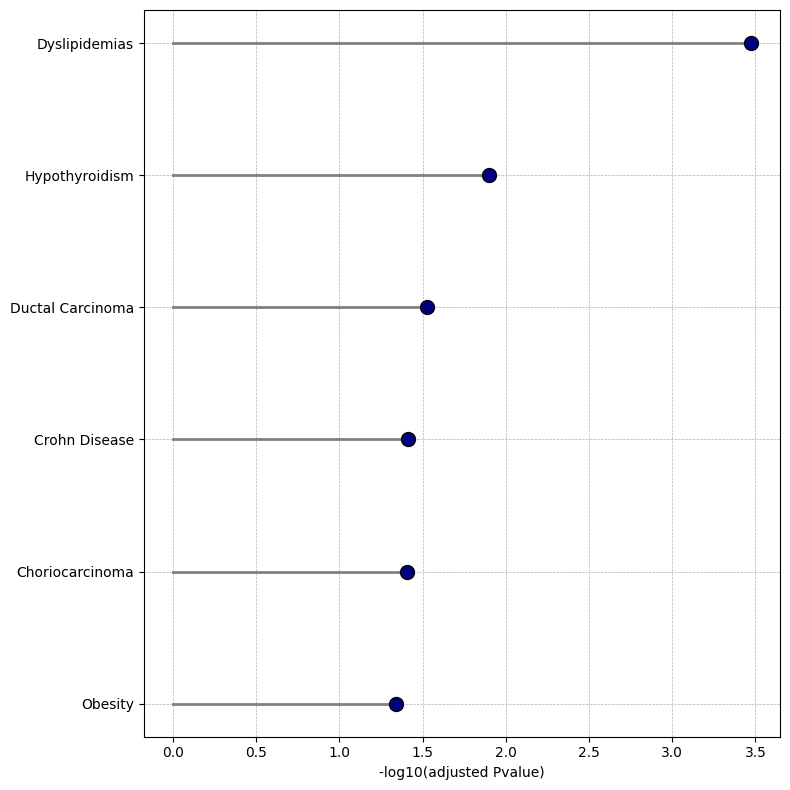

In [85]:
import gseapy as gp
import numpy as np
import matplotlib.pyplot as plt

enr = gp.enrichr(gene_list=list(DN_genes),
                 gene_sets=['DisGeNET'],
                 #gene_sets=['GO_Biological_Process_2023', 'GO_Cellular_Component_2023', 'GO_Molecular_Function_2023'],
                 organism='human',
                 background=uniprot_to_symbol_df['SYMBOL'].values.tolist()
                )

enr_res = enr.results.sort_values(by='P-value', ascending=True) 

# Count occurrences of ';' in the column
enr_res['n_overlap_genes'] = enr_res['Genes'].str.count(';')

enr_res = enr_res[(enr_res['n_overlap_genes'] > 10) & (enr_res['n_overlap_genes'] < 500)]

top10 = enr_res[enr_res['Adjusted P-value'] <= 0.05]
top10 = top10.iloc[0:20, :]
top10['-log10(P-value)'] = -np.log10(top10['Adjusted P-value'])
top10 = top10.sort_values('-log10(P-value)', ascending=True)
#top10['Term'] = top10['Term'].str.replace(r' R-HSA-\d+$', '', regex=True)
top10['Term'] = top10['Term'].apply(split_long_sentences)

# Plotting
plt.figure(figsize=(8, 8))

for i in range(len(top10)):
    plt.plot([0, top10['-log10(P-value)'].iloc[i]], [top10['Term'].iloc[i], top10['Term'].iloc[i]], color='gray', linestyle='-', linewidth=2)  # Line part of lollipop
    plt.scatter(top10['-log10(P-value)'].iloc[i], top10['Term'].iloc[i], color='navy', s=100, edgecolor='black', zorder=5)  # Dot part of lollipop

plt.xlabel('-log10(adjusted Pvalue)')
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()

plt.savefig('../res/plots/DN_pathways_disgenet.png', format='png', dpi=300)
plt.show()

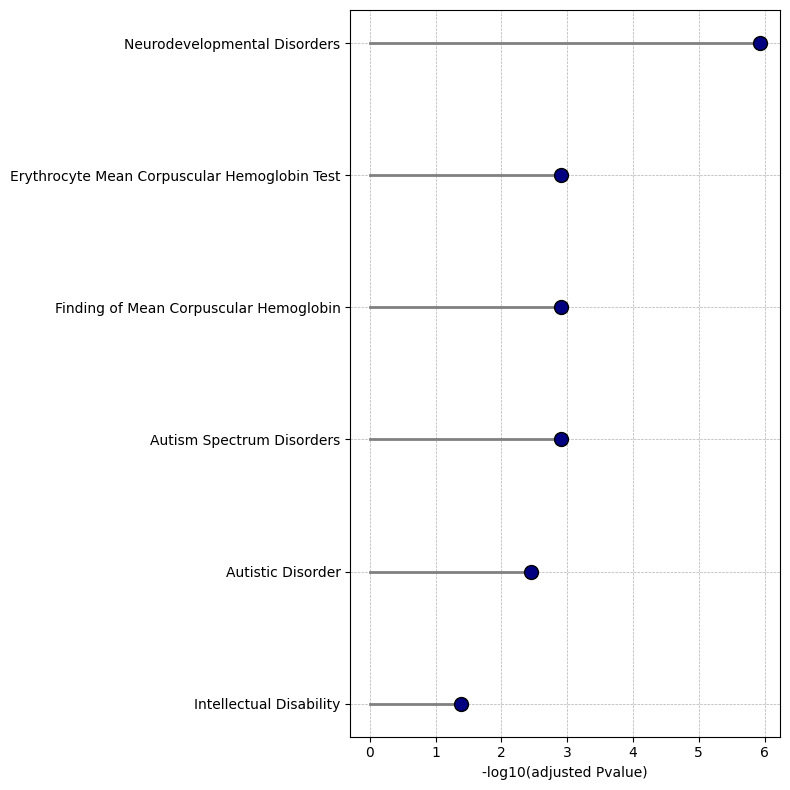

In [86]:
import gseapy as gp
import matplotlib.pyplot as plt

enr = gp.enrichr(gene_list=list(LOF_genes),
                 gene_sets=['DisGeNET'],
                 #gene_sets=['GO_Biological_Process_2023', 'GO_Cellular_Component_2023', 'GO_Molecular_Function_2023'],
                 organism='human',
                 background=uniprot_to_symbol_df['SYMBOL'].values.tolist()
                )

enr_res = enr.results.sort_values(by='P-value', ascending=True) 

# Count occurrences of ';' in the column
enr_res['n_overlap_genes'] = enr_res['Genes'].str.count(';')

enr_res = enr_res[(enr_res['n_overlap_genes'] > 10) & (enr_res['n_overlap_genes'] < 500)]

top10 = enr_res[enr_res['Adjusted P-value'] <= 0.05]
top10 = top10.iloc[0:20, :]
top10['-log10(P-value)'] = -np.log10(top10['Adjusted P-value'])
top10 = top10.sort_values('-log10(P-value)', ascending=True)
#top10['Term'] = top10['Term'].str.replace(r' R-HSA-\d+$', '', regex=True)
top10['Term'] = top10['Term'].apply(split_long_sentences)

# Plotting
plt.figure(figsize=(8, 8))

for i in range(len(top10)):
    plt.plot([0, top10['-log10(P-value)'].iloc[i]], [top10['Term'].iloc[i], top10['Term'].iloc[i]], color='gray', linestyle='-', linewidth=2)  # Line part of lollipop
    plt.scatter(top10['-log10(P-value)'].iloc[i], top10['Term'].iloc[i], color='navy', s=100, edgecolor='black', zorder=5)  # Dot part of lollipop

plt.xlabel('-log10(adjusted Pvalue)')
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()

plt.savefig('../res/plots/LOF_pathways_disgenet.png', format='png', dpi=300)
plt.show()

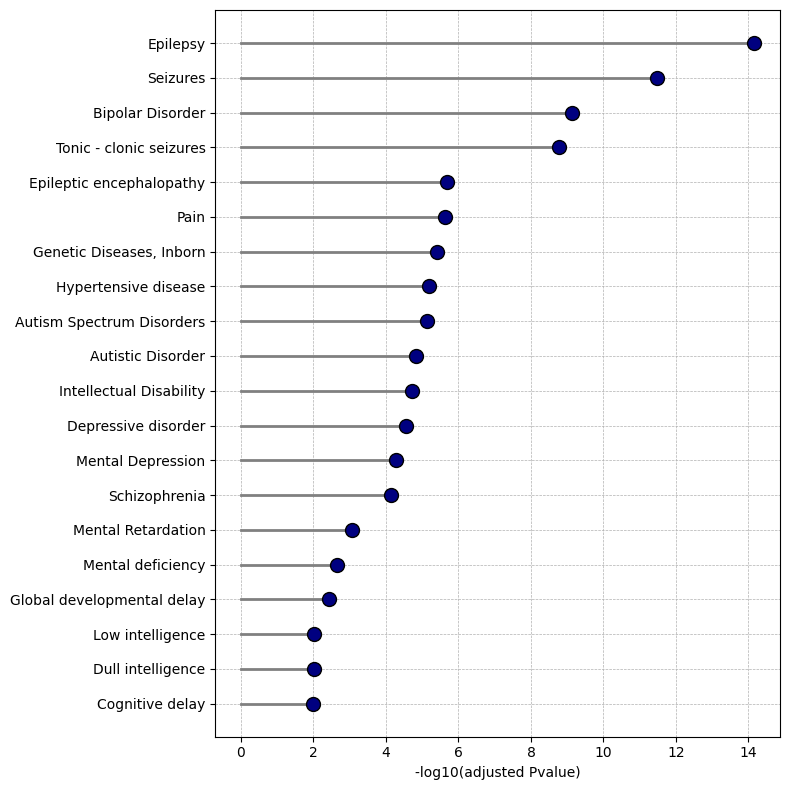

In [87]:
import gseapy as gp
import matplotlib.pyplot as plt

enr = gp.enrichr(gene_list=list(GOF_genes),
                 gene_sets=['DisGeNET'],
                 #gene_sets=['GO_Biological_Process_2023', 'GO_Cellular_Component_2023', 'GO_Molecular_Function_2023'],
                 organism='human',
                 background=uniprot_to_symbol_df['SYMBOL'].values.tolist()
                )

enr_res = enr.results.sort_values(by='P-value', ascending=True) 

# Count occurrences of ';' in the column
enr_res['n_overlap_genes'] = enr_res['Genes'].str.count(';')

enr_res = enr_res[(enr_res['n_overlap_genes'] > 10) & (enr_res['n_overlap_genes'] < 500)]

top10 = enr_res[enr_res['Adjusted P-value'] <= 0.05]
top10 = top10.iloc[0:20, :]
top10['-log10(P-value)'] = -np.log10(top10['Adjusted P-value'])
top10 = top10.sort_values('-log10(P-value)', ascending=True)
#top10['Term'] = top10['Term'].str.replace(r' R-HSA-\d+$', '', regex=True)
top10['Term'] = top10['Term'].apply(split_long_sentences)

# Plotting
plt.figure(figsize=(8, 8))

for i in range(len(top10)):
    plt.plot([0, top10['-log10(P-value)'].iloc[i]], [top10['Term'].iloc[i], top10['Term'].iloc[i]], color='gray', linestyle='-', linewidth=2)  # Line part of lollipop
    plt.scatter(top10['-log10(P-value)'].iloc[i], top10['Term'].iloc[i], color='navy', s=100, edgecolor='black', zorder=5)  # Dot part of lollipop

plt.xlabel('-log10(adjusted Pvalue)')
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()

plt.savefig('../res/plots/GOF_pathways_disgenet.png', format='png', dpi=300)
plt.show()

### DN LOG GOF paper

In [88]:
import pandas as pd

dn_test = pd.read_csv('../data/dn_lof_gof_paper_preds/dn_test.tsv', sep='\t')
dn_test

,HGNC,DN,LOF,GOF,UniprotEntry,pDN,pLOF,pGOF
0,ABCA1,1,0,0,O95477,0.736565,0.221686,0.739441
1,ACD,1,0,0,Q96AP0,0.466564,0.430666,0.471895
2,ACTG2,1,0,0,P63267,0.818326,0.322723,0.595397
3,ACVRL1,1,1,0,P37023,0.721519,0.308363,0.768425
4,ALDH2,1,0,0,P05091,0.724277,0.313175,0.593552
...,...,...,...,...,...,...,...,...
233,TRIP12,0,1,0,Q14669,0.221881,0.842314,0.245642
234,USP7,0,1,0,Q93009,0.287996,0.733662,0.318948
235,VCAN,0,1,0,P13611,0.399576,0.608089,0.381598
236,YWHAG,0,1,0,P61981,0.498144,0.581440,0.433492


In [89]:
lof_test = pd.read_csv('../data/dn_lof_gof_paper_preds/lof_test.tsv', sep='\t')
lof_test

,HGNC,DN,LOF,GOF,UniprotEntry,pDN,pLOF,pGOF
0,ACD,1,0,0,Q96AP0,0.466564,0.430666,0.471895
1,ACTB,1,1,1,P60709,0.469502,0.790348,0.629776
2,AIRE,1,0,0,O43918,0.456676,0.428207,0.571170
3,ALPL,1,0,0,P05186,0.742372,0.227024,0.599129
4,APC,1,1,1,P25054,0.381510,0.809377,0.357596
...,...,...,...,...,...,...,...,...
292,VHL,0,1,0,P40337,0.590310,0.287167,0.638798
293,VPS16,0,1,0,Q9H269,0.568392,0.336540,0.446936
294,WDR11,0,1,0,Q9BZH6,0.537091,0.458350,0.388037
295,ZMYM2,0,1,0,Q9UBW7,0.315224,0.669265,0.304458


In [90]:
gof_test = pd.read_csv('../data/dn_lof_gof_paper_preds/gof_test.tsv', sep='\t')
gof_test

,HGNC,DN,LOF,GOF,UniprotEntry,pDN,pLOF,pGOF
0,APC,1,1,1,P25054,0.381510,0.809377,0.357596
1,AVP,1,0,1,P01185,0.661381,0.268188,0.582000
2,BEST1,1,1,1,O76090,0.755346,0.280428,0.815669
3,CARD11,1,0,1,Q9BXL7,0.425253,0.633593,0.475054
4,CDK19,1,1,0,Q9BWU1,0.375200,0.788006,0.399530
...,...,...,...,...,...,...,...,...
234,ZBTB18,0,1,0,Q99592,0.279702,0.819731,0.303700
235,ZCCHC8,0,1,0,Q6NZY4,0.336094,0.744083,0.338054
236,ZFPM2,0,1,0,Q8WW38,0.256403,0.832164,0.186271
237,ZIC2,0,1,0,O95409,0.476844,0.911081,0.254840


In [91]:
concatenated_df = pd.concat([dn_test, lof_test, gof_test])

# Drop duplicates to keep only unique rows
df = concatenated_df.drop_duplicates()
df

,HGNC,DN,LOF,GOF,UniprotEntry,pDN,pLOF,pGOF
0,ABCA1,1,0,0,O95477,0.736565,0.221686,0.739441
1,ACD,1,0,0,Q96AP0,0.466564,0.430666,0.471895
2,ACTG2,1,0,0,P63267,0.818326,0.322723,0.595397
3,ACVRL1,1,1,0,P37023,0.721519,0.308363,0.768425
4,ALDH2,1,0,0,P05091,0.724277,0.313175,0.593552
...,...,...,...,...,...,...,...,...
231,WDFY3,0,1,0,Q8IZQ1,0.248778,0.748374,0.278178
233,WDR26,0,1,0,Q9H7D7,0.254355,0.832978,0.347487
234,ZBTB18,0,1,0,Q99592,0.279702,0.819731,0.303700
235,ZCCHC8,0,1,0,Q6NZY4,0.336094,0.744083,0.338054


In [92]:
from sklearn.metrics import precision_recall_fscore_support

# thresholds come from the paper
df['pred_DN'] = (df['pDN'] >= 0.61).astype(int)
df['pred_LOF'] = (df['pLOF'] >= 0.64).astype(int)
df['pred_GOF'] = (df['pGOF'] >= 0.63).astype(int)

# Calculate precision, recall, and F1 score per class
y_true = df[['DN', 'LOF', 'GOF']].values
y_pred = df[['pred_DN', 'pred_LOF', 'pred_GOF']].values

# Calculate metrics
precision, recall, f1, _ = precision_recall_fscore_support(y_true, y_pred, average=None)
precision_macro, recall_macro, f1_macro, _ = precision_recall_fscore_support(y_true, y_pred, average='macro')

# Create a results dataframe to show metrics per class
results = pd.DataFrame({
    'Class': ['DN', 'LOF', 'GOF'],
    'Precision': precision,
    'Recall': recall,
    'F1 Score': f1
})

# Add macro averages to the results
macro_results = pd.DataFrame({
    'Class': ['Macro Average'],
    'Precision': [precision_macro],
    'Recall': [recall_macro],
    'F1 Score': [f1_macro]
})

results = pd.concat([results, macro_results], ignore_index=True)
results

,Class,Precision,Recall,F1 Score
0,DN,0.573840,0.511278,0.540755
1,LOF,0.822835,0.575758,0.677472
2,GOF,0.611374,0.518072,0.560870
3,Macro Average,0.669350,0.535036,0.593032


In [93]:
precision_macro, recall_macro, f1_macro

(0.6693495718998289, 0.5350360201343081, 0.5930322231224029)

### Explore

In [292]:
df = pd.read_csv("../data/DN_LOF_GOF_truth.tsv", sep="\t")
dn_prots = df[(df['DN'] == 1) & (df['LOF'] == 0) & (df['GOF'] == 0)].UniprotEntry.tolist()
lof_prots = df[(df['DN'] == 0) & (df['LOF'] == 1) & (df['GOF'] == 0)].UniprotEntry.tolist()
gof_prots = df[(df['DN'] == 0) & (df['LOF'] == 0) & (df['GOF'] == 1)].UniprotEntry.tolist()

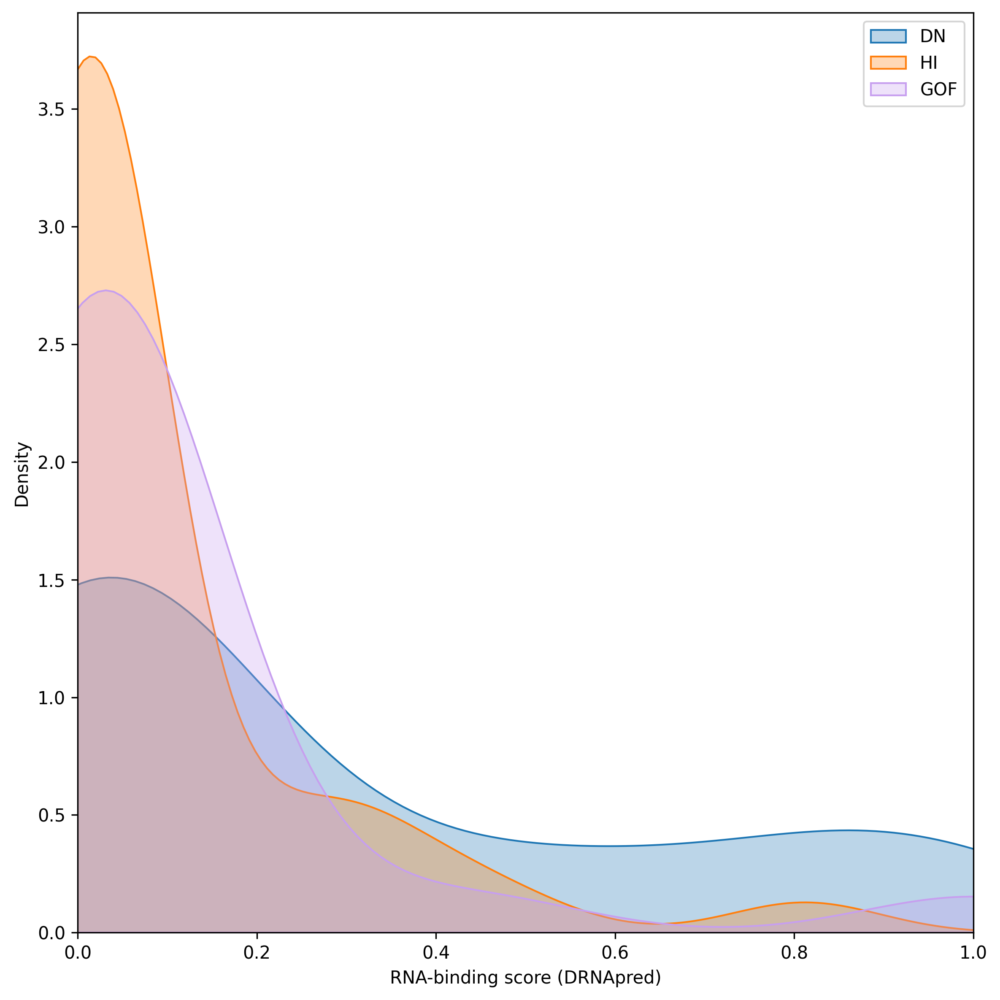

In [326]:
feature = "DRNApred_RNA"

dn_scores = []
lof_scores = []
gof_scores = []

for prot in dn_prots:
    if prot in merged_features.index.tolist():
        if merged_features.loc[prot][feature] != 0:
            dn_scores.append( merged_features.loc[prot][feature] )

for prot in lof_prots:
    if prot in merged_features.index.tolist():
        if merged_features.loc[prot][feature] != 0:
            lof_scores.append( merged_features.loc[prot][feature] )

for prot in gof_prots:
    if prot in merged_features.index.tolist():
        if merged_features.loc[prot][feature] != 0:
            gof_scores.append( merged_features.loc[prot][feature] )

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Set up figure for density plot
plt.figure(figsize=(8, 8), dpi=300)

# Plot density for DN
sns.kdeplot(dn_scores, label='DN', color='#1f77b4', fill=True, alpha=0.3) #,

# Plot density for HI
sns.kdeplot(lof_scores, label='HI', color='#ff7f0e', fill=True, alpha=0.3) #, 

# Plot density for GOF
sns.kdeplot(gof_scores, label='GOF', color='#C79FEF', fill=True, alpha=0.3) #, 

# Set x-axis limits to 0 and 1
plt.xlim(0, 1)

# Add labels and title
plt.xlabel('RNA-binding score (DRNApred)')
plt.ylabel('Density')

# Show legend
plt.legend()

# Save the plot as high quality for publication
plt.tight_layout()
plt.savefig('../res/plots/DN_LOF_GOF_RNAbindScore.png', format='png', bbox_inches='tight')

# Show the plot
plt.show()

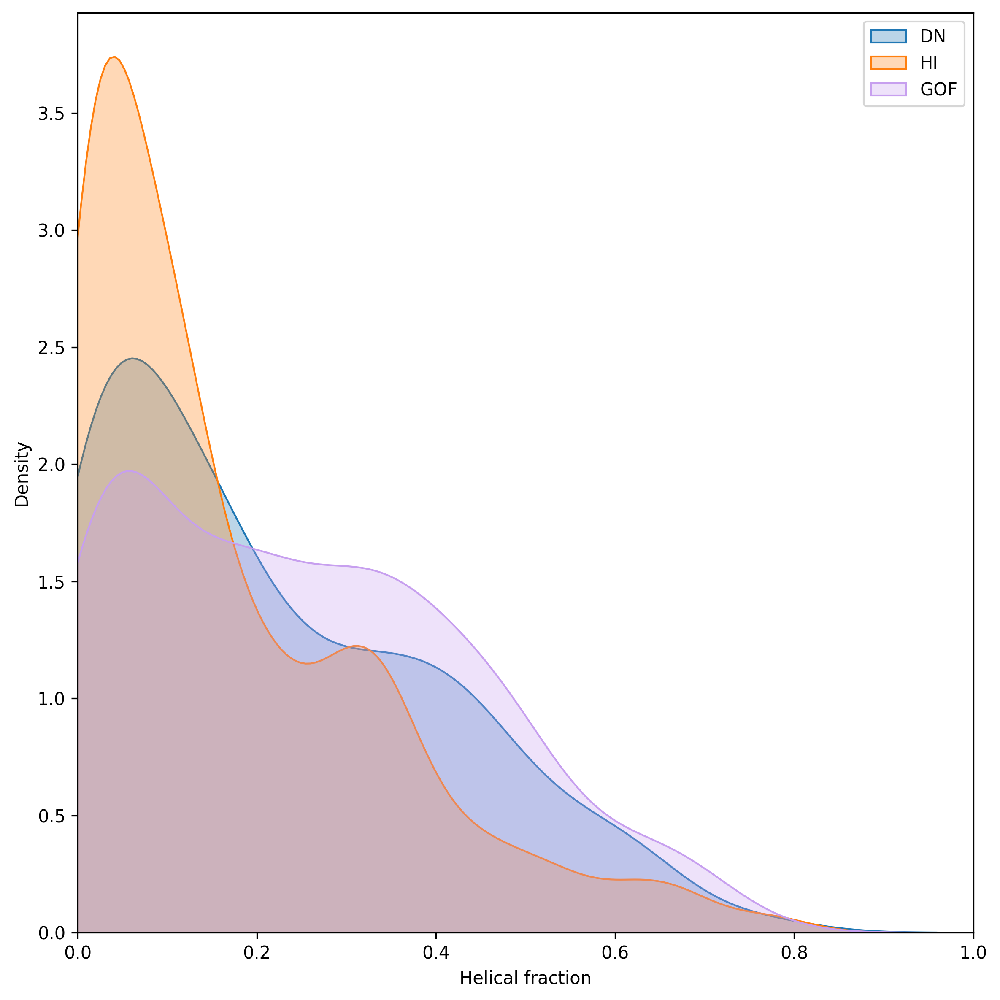

In [336]:
feature = "HELIX"

dn_scores = []
lof_score = []
gof_scores = []

for prot in dn_prots:
    temp_feature = uniprot_clean[uniprot_clean["Entry"] == prot][feature].values
    
    if len(temp_feature) > 0:
        dn_scores.append(temp_feature[0].count('1') / len(temp_feature[0]))

for prot in lof_prots:
    temp_feature = uniprot_clean[uniprot_clean["Entry"] == prot][feature].values
    
    if len(temp_feature) > 0:
        lof_scores.append(temp_feature[0].count('1') / len(temp_feature[0]))

for prot in gof_prots:
    temp_feature = uniprot_clean[uniprot_clean["Entry"] == prot][feature].values
    
    if len(temp_feature) > 0:
        gof_scores.append(temp_feature[0].count('1') / len(temp_feature[0]))

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Set up figure for density plot
plt.figure(figsize=(8, 8), dpi=300)

# Plot density for DN
sns.kdeplot(dn_scores, label='DN', color='#1f77b4', fill=True, alpha=0.3) #,

# Plot density for HI
sns.kdeplot(lof_scores, label='HI', color='#ff7f0e', fill=True, alpha=0.3) #, 

# Plot density for GOF
sns.kdeplot(gof_scores, label='GOF', color='#C79FEF', fill=True, alpha=0.3) #, 

# Set x-axis limits to 0 and 1
plt.xlim(0, 1)

# Add labels and title
plt.xlabel('Helical fraction')
plt.ylabel('Density')

# Show legend
plt.legend()

# Save the plot as high quality for publication
plt.tight_layout()
plt.savefig('../res/plots/DN_LOF_GOF_helix.png', format='png', bbox_inches='tight')

# Show the plot
plt.show()

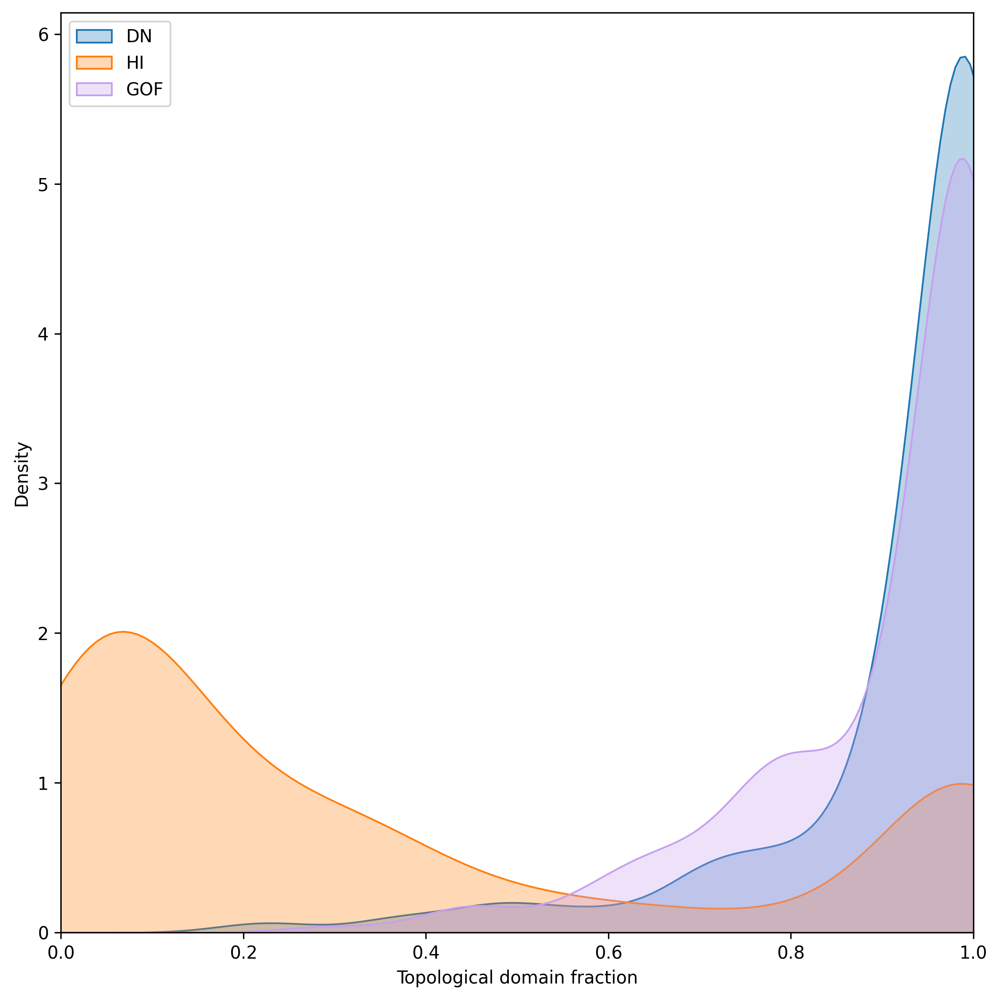

In [342]:
feature = "TOPO_DOM"

dn_scores = []
lof_score = []
gof_scores = []

for prot in dn_prots:
    temp_feature = uniprot_clean[uniprot_clean["Entry"] == prot][feature].values
    
    if len(temp_feature) > 0:
        dn_scores.append(temp_feature[0].count('1') / len(temp_feature[0]))

for prot in lof_prots:
    temp_feature = uniprot_clean[uniprot_clean["Entry"] == prot][feature].values
    
    if len(temp_feature) > 0:
        lof_scores.append(temp_feature[0].count('1') / len(temp_feature[0]))

for prot in gof_prots:
    temp_feature = uniprot_clean[uniprot_clean["Entry"] == prot][feature].values
    
    if len(temp_feature) > 0:
        gof_scores.append(temp_feature[0].count('1') / len(temp_feature[0]))

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Set up figure for density plot
plt.figure(figsize=(8, 8), dpi=300)

# Plot density for DN
sns.kdeplot(dn_scores, label='DN', color='#1f77b4', fill=True, alpha=0.3) #,

# Plot density for HI
sns.kdeplot(lof_scores, label='HI', color='#ff7f0e', fill=True, alpha=0.3) #, 

# Plot density for GOF
sns.kdeplot(gof_scores, label='GOF', color='#C79FEF', fill=True, alpha=0.3) #, 

# Set x-axis limits to 0 and 1
plt.xlim(0, 1)

# Add labels and title
plt.xlabel('Topological domain fraction')
plt.ylabel('Density')

# Show legend
plt.legend()

# Save the plot as high quality for publication
plt.tight_layout()
plt.savefig('../res/plots/DN_LOF_GOF_topodom.png', format='png', bbox_inches='tight')

# Show the plot
plt.show()